In [2]:
import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

In [3]:
# visualization function
def show(tensor, ch=1, size=(28, 28), num=16):
    # tensor: 128 x 784
    data = tensor.detach().cpu().view(-1, ch, *size)  # 128 x 1 x 28 x 28
    grid = make_grid(data[:num], nrow=4).permute(
        1, 2, 0
    )  # 1 x 28 x 28  = 28 x 28 x 1
    plt.imshow(grid)
    plt.show()

In [4]:
# setup of the main parameters and hyperparameters
epochs = 500
cur_step = 0
info_step = 300
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64
lr = 0.00001
loss_func = nn.BCEWithLogitsLoss()

bs = 128
device = "cuda"

dataloader = DataLoader(
    MNIST(".", download=True, transform=transforms.ToTensor()),
    shuffle=True,
    batch_size=bs,
)

# number of steps = 60000 / 128 = 468.75

100%|██████████| 9912422/9912422 [00:03<00:00, 2523816.27it/s]


Extracting .\MNIST\raw\train-images-idx3-ubyte.gz to .\MNIST\raw



100%|██████████| 28881/28881 [00:00<00:00, 4205808.41it/s]


Extracting .\MNIST\raw\train-labels-idx1-ubyte.gz to .\MNIST\raw



100%|██████████| 1648877/1648877 [00:00<00:00, 1915371.01it/s]


Extracting .\MNIST\raw\t10k-images-idx3-ubyte.gz to .\MNIST\raw



100%|██████████| 4542/4542 [00:00<00:00, 7954291.76it/s]

Extracting .\MNIST\raw\t10k-labels-idx1-ubyte.gz to .\MNIST\raw



In [5]:
# declare our models


# Generator
def genBlock(inp, out):
    return nn.Sequential(
        nn.Linear(inp, out), nn.BatchNorm1d(out), nn.ReLU(inplace=True)
    )


class Generator(nn.Module):
    def __init__(self, z_dim=64, i_dim=784, h_dim=128):
        super().__init__()
        self.gen = nn.Sequential(
            genBlock(z_dim, h_dim),  # 64, 128
            genBlock(h_dim, h_dim * 2),  # 128, 256
            genBlock(h_dim * 2, h_dim * 4),  # 256 x 512
            genBlock(h_dim * 4, h_dim * 8),  # 512, 1024
            nn.Linear(h_dim * 8, i_dim),  # 1024, 784 (28x28)
            nn.Sigmoid(),
        )

    def forward(self, noise):
        return self.gen(noise)


def gen_noise(number, z_dim):
    return torch.randn(number, z_dim).to(device)


## Discriminator
def discBlock(inp, out):
    return nn.Sequential(nn.Linear(inp, out), nn.LeakyReLU(0.2))


class Discriminator(nn.Module):
    def __init__(self, i_dim=784, h_dim=256):
        super().__init__()
        self.disc = nn.Sequential(
            discBlock(i_dim, h_dim * 4),  # 784, 1024
            discBlock(h_dim * 4, h_dim * 2),  # 1024, 512
            discBlock(h_dim * 2, h_dim),  # 512, 256
            nn.Linear(h_dim, 1),  # 256, 1
        )

    def forward(self, image):
        return self.disc(image)

In [6]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

In [7]:
gen

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=64, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

In [8]:
disc

Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Linear(in_features=784, out_features=1024, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (1): Sequential(
      (0): Linear(in_features=1024, out_features=512, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (2): Sequential(
      (0): Linear(in_features=512, out_features=256, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (3): Linear(in_features=256, out_features=1, bias=True)
  )
)

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([4, 0, 4, 4, 4, 8, 0, 3, 1, 5])


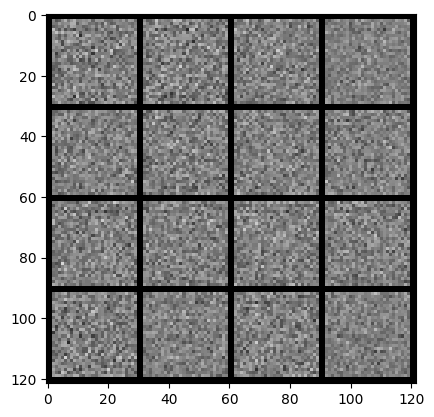

In [9]:
x, y = next(iter(dataloader))
print(x.shape, y.shape)
print(y[:10])

noise = gen_noise(bs, z_dim)
fake = gen(noise)
show(fake)

In [10]:
# calculating the loss



# generator loss

def calc_gen_loss(loss_func, gen, disc, number, z_dim):

    noise = gen_noise(number, z_dim)
    fake = gen(noise)

    pred = disc(fake)

    targets = torch.ones_like(pred)

    gen_loss = loss_func(pred, targets)

    return gen_loss



def calc_disc_loss(loss_func, gen, disc, number, real, z_dim):

    noise = gen_noise(number, z_dim)
    fake = gen(noise)

    disc_fake = disc(fake.detach())

    disc_fake_targets = torch.zeros_like(disc_fake)
    disc_fake_loss = loss_func(disc_fake, disc_fake_targets)

    disc_real = disc(real)

    disc_real_targets = torch.ones_like(disc_real)
    disc_real_loss = loss_func(disc_real, disc_real_targets)


    disc_loss = (disc_fake_loss + disc_real_loss) / 2

    return disc_loss

 64%|██████▎   | 298/469 [00:07<00:04, 40.93it/s]

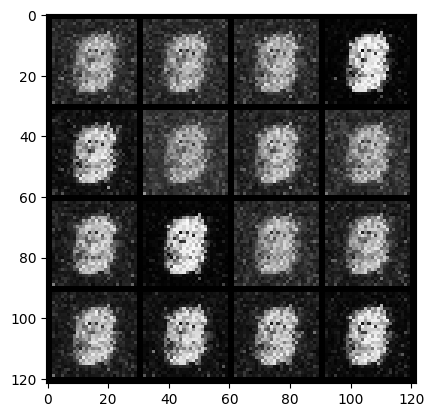

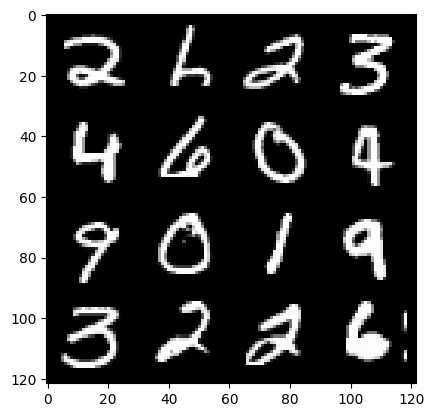

 65%|██████▌   | 307/469 [00:07<00:05, 27.29it/s]

0: step 300 / Gen loss: 2.0026070165634158 / disc_loss: 0.33739975216488033


 27%|██▋       | 128/469 [00:02<00:07, 44.77it/s]

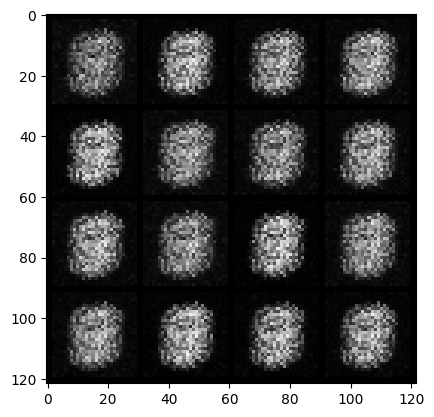

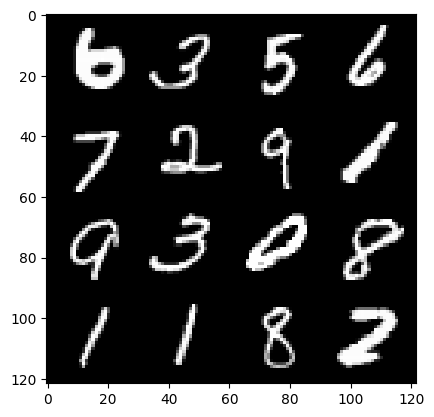

 29%|██▉       | 137/469 [00:03<00:11, 29.80it/s]

1: step 600 / Gen loss: 3.5814228264490757 / disc_loss: 0.1173555226624012


 92%|█████████▏| 430/469 [00:10<00:00, 46.60it/s]

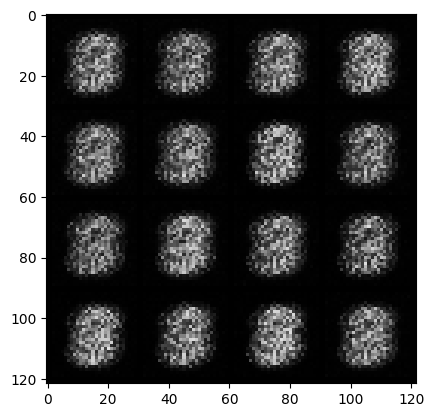

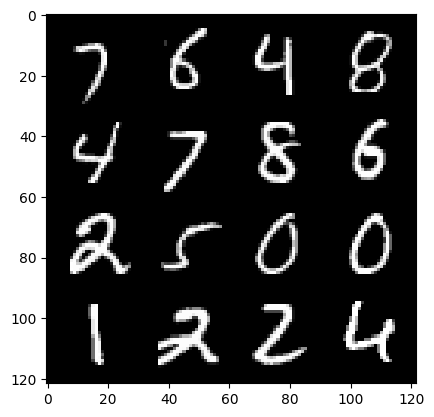

 94%|█████████▍| 441/469 [00:10<00:00, 32.88it/s]

1: step 900 / Gen loss: 3.485369582970939 / disc_loss: 0.05289875359584884


 56%|█████▌    | 262/469 [00:06<00:04, 42.57it/s]

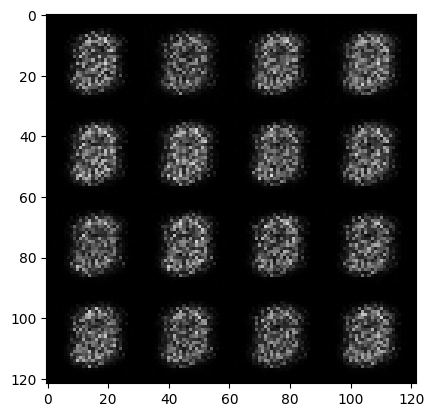

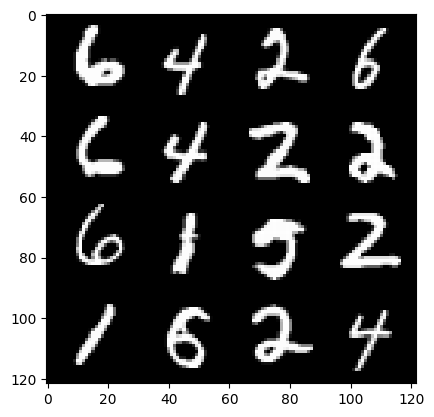

 57%|█████▋    | 267/469 [00:06<00:07, 26.06it/s]

2: step 1200 / Gen loss: 3.504514334996544 / disc_loss: 0.037197806021819484


 19%|█▉        | 91/469 [00:02<00:08, 44.85it/s]

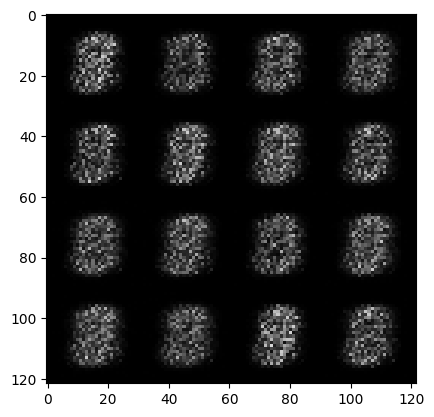

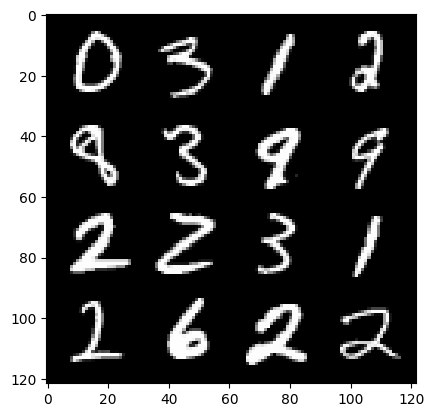

 22%|██▏       | 101/469 [00:02<00:12, 29.83it/s]

3: step 1500 / Gen loss: 3.4349167124430338 / disc_loss: 0.03831807958583036


 83%|████████▎ | 390/469 [00:09<00:01, 41.86it/s]

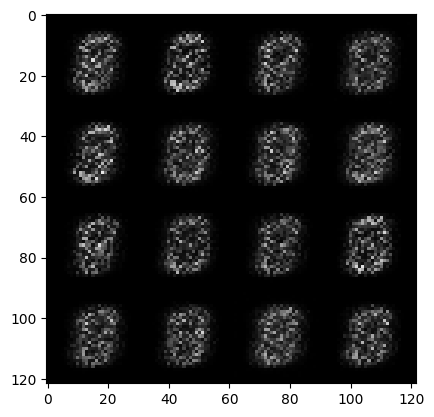

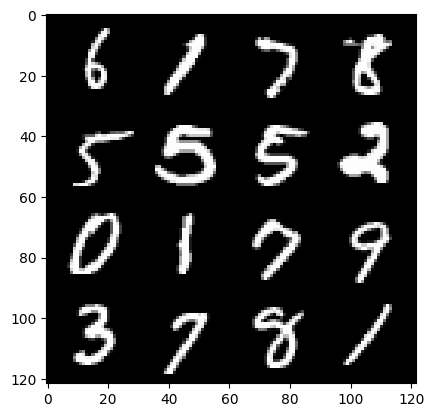

 85%|████████▌ | 400/469 [00:09<00:02, 30.51it/s]

3: step 1800 / Gen loss: 3.4027293491363535 / disc_loss: 0.044592975278695435


 47%|████▋     | 220/469 [00:05<00:05, 44.77it/s]

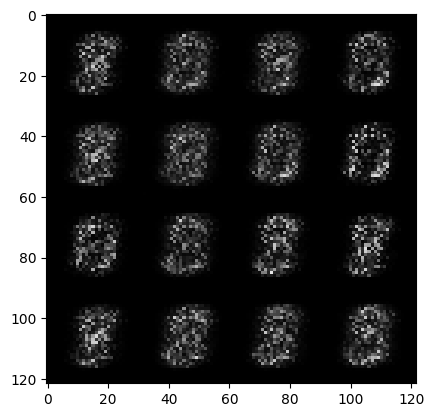

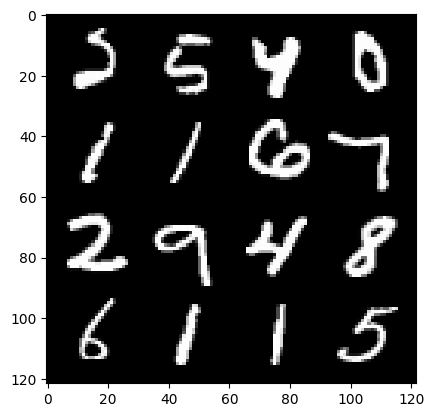

 49%|████▉     | 230/469 [00:05<00:07, 31.04it/s]

4: step 2100 / Gen loss: 3.5528710738817852 / disc_loss: 0.04272221333036821


 11%|█         | 52/469 [00:01<00:09, 42.36it/s]

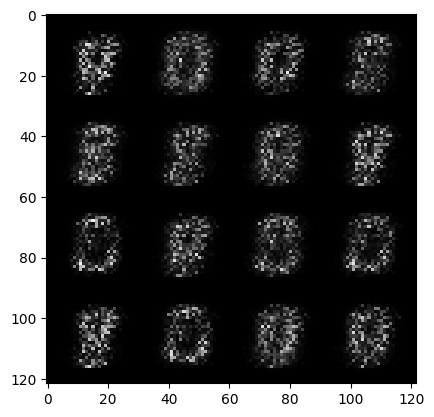

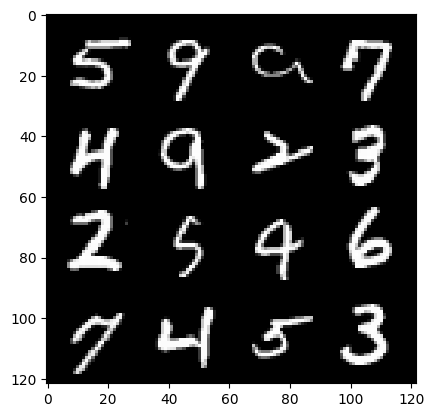

 13%|█▎        | 61/469 [00:01<00:13, 30.64it/s]

5: step 2400 / Gen loss: 3.99719518105189 / disc_loss: 0.03575253984580439


 75%|███████▍  | 350/469 [00:08<00:02, 44.80it/s]

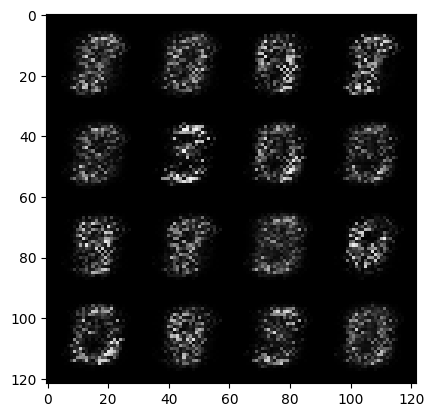

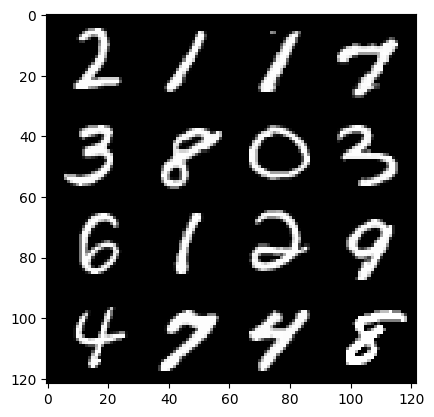

 77%|███████▋  | 361/469 [00:08<00:03, 33.60it/s]

5: step 2700 / Gen loss: 4.453639305432638 / disc_loss: 0.02972975345328451


 39%|███▉      | 182/469 [00:03<00:04, 67.44it/s]

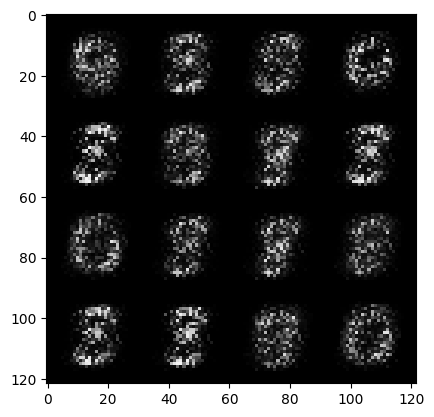

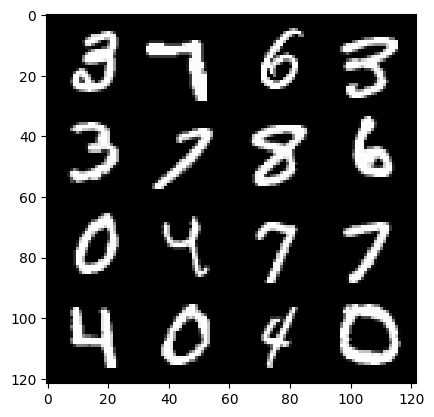

 42%|████▏     | 196/469 [00:04<00:05, 52.09it/s]

6: step 3000 / Gen loss: 4.508065772056581 / disc_loss: 0.026698637831335255


  3%|▎         | 15/469 [00:00<00:06, 72.05it/s]

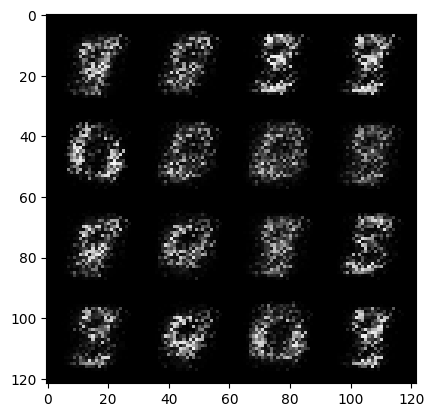

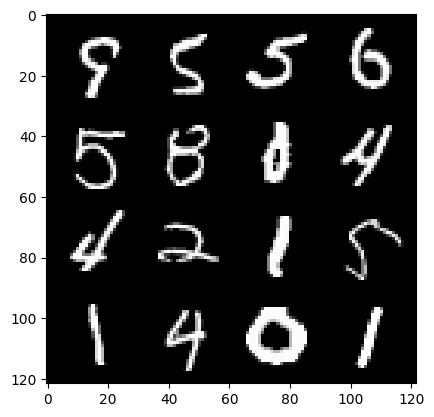

  7%|▋         | 31/469 [00:00<00:09, 45.72it/s]

7: step 3300 / Gen loss: 5.142443896929424 / disc_loss: 0.02197572826718289


 67%|██████▋   | 316/469 [00:04<00:02, 72.93it/s]

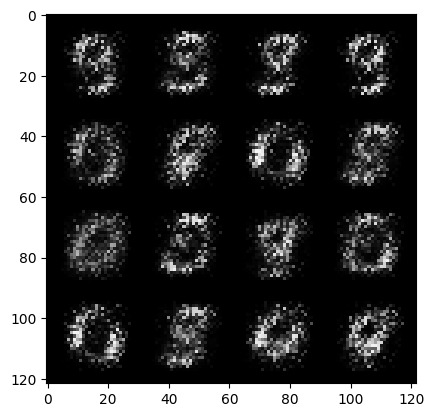

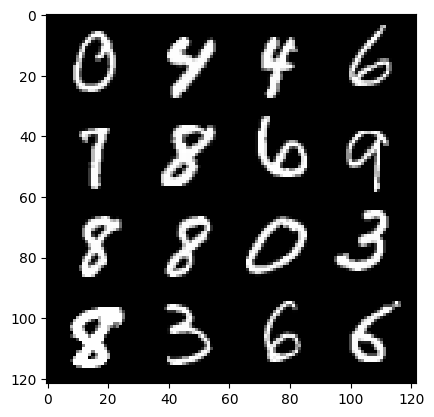

 71%|███████   | 332/469 [00:05<00:02, 56.07it/s]

7: step 3600 / Gen loss: 5.383952689170841 / disc_loss: 0.023258888917043804


 32%|███▏      | 148/469 [00:02<00:04, 70.73it/s]

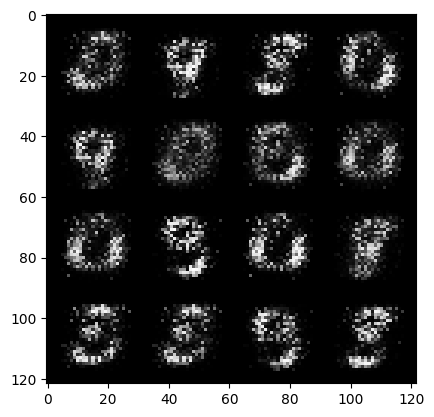

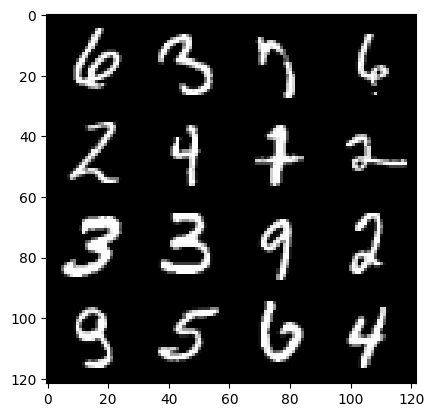

 35%|███▍      | 162/469 [00:02<00:05, 52.20it/s]

8: step 3900 / Gen loss: 5.489546729723608 / disc_loss: 0.022480335030704717


 94%|█████████▍| 441/469 [00:06<00:00, 70.91it/s]

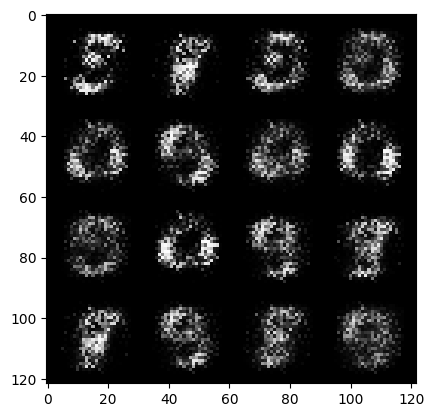

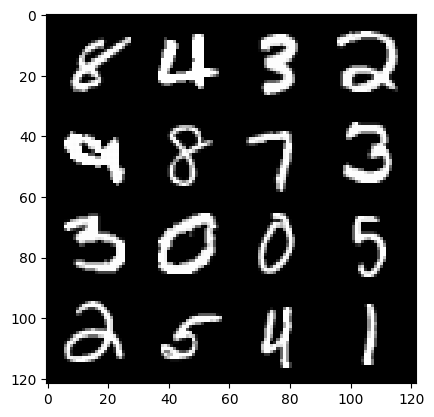

 97%|█████████▋| 457/469 [00:06<00:00, 53.97it/s]

8: step 4200 / Gen loss: 5.527819925944006 / disc_loss: 0.02053270053118466


 59%|█████▉    | 277/469 [00:06<00:04, 40.63it/s]

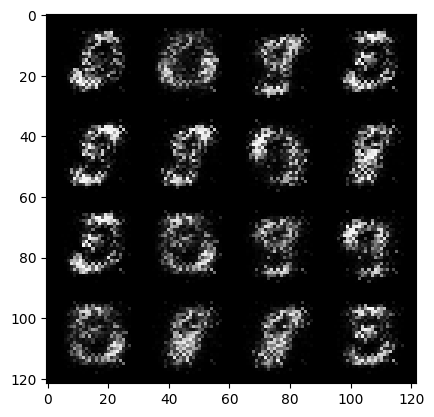

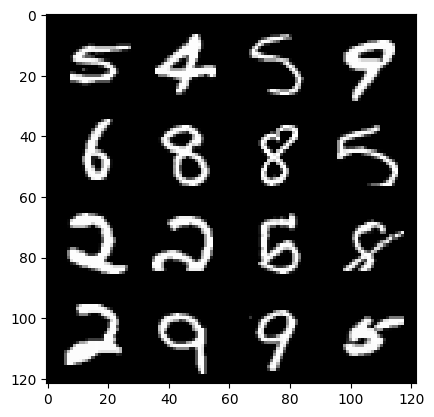

 61%|██████    | 286/469 [00:07<00:06, 26.55it/s]

9: step 4500 / Gen loss: 5.755663218498228 / disc_loss: 0.022266869302839033


 23%|██▎       | 107/469 [00:02<00:09, 38.36it/s]

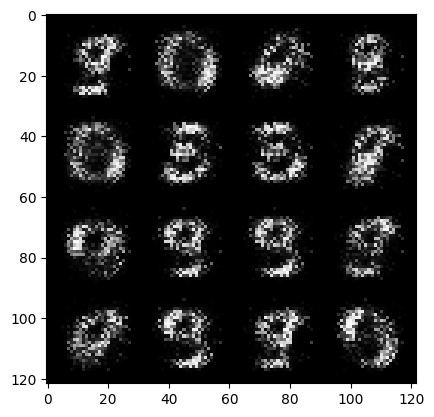

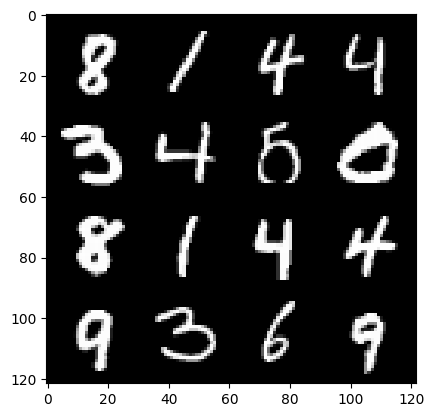

 25%|██▍       | 115/469 [00:03<00:13, 26.29it/s]

10: step 4800 / Gen loss: 5.885211944580079 / disc_loss: 0.02101439484395086


 87%|████████▋ | 408/469 [00:10<00:01, 37.43it/s]

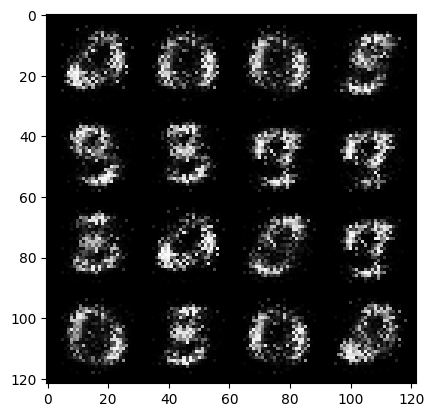

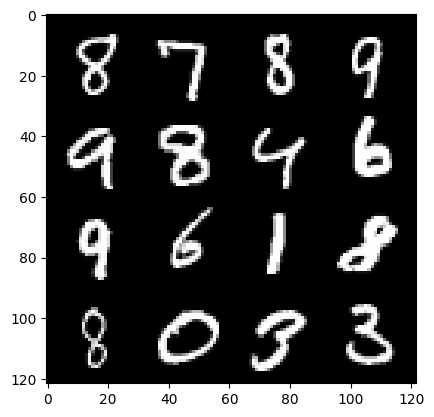

 89%|████████▉ | 417/469 [00:11<00:01, 27.26it/s]

10: step 5100 / Gen loss: 6.09179048697153 / disc_loss: 0.017323104461344583


 51%|█████     | 239/469 [00:06<00:05, 38.66it/s]

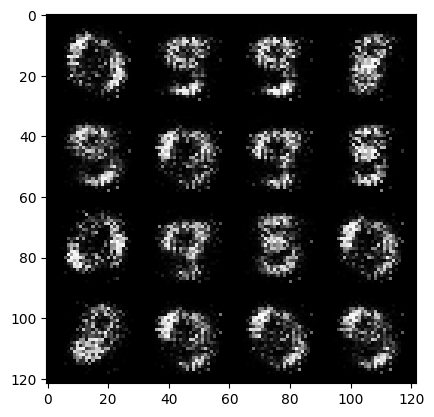

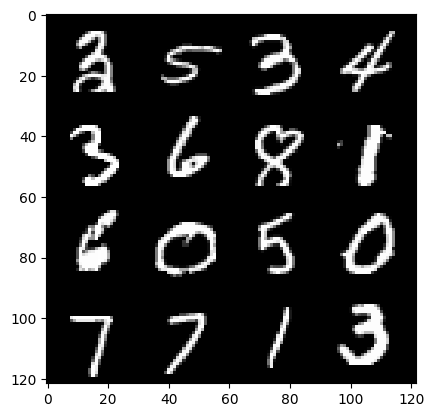

 53%|█████▎    | 248/469 [00:06<00:08, 27.05it/s]

11: step 5400 / Gen loss: 6.265993523597716 / disc_loss: 0.01733331189801296


 15%|█▍        | 70/469 [00:01<00:10, 38.41it/s]

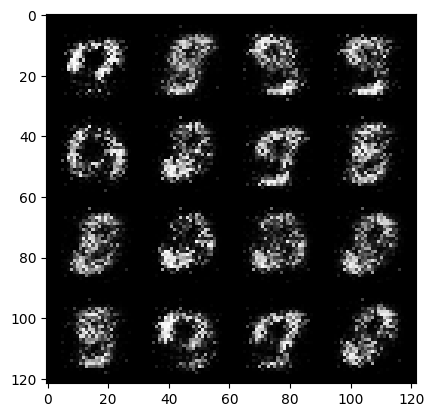

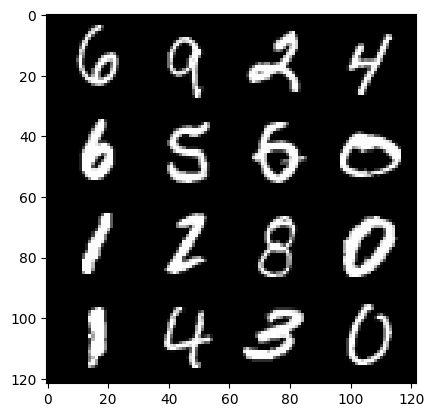

 17%|█▋        | 78/469 [00:02<00:14, 26.62it/s]

12: step 5700 / Gen loss: 6.417711836496988 / disc_loss: 0.01519322238707294


 79%|███████▉  | 371/469 [00:10<00:02, 39.17it/s]

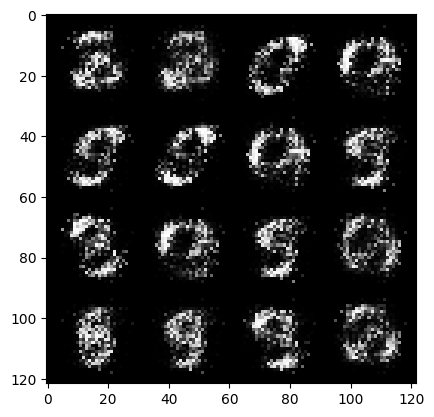

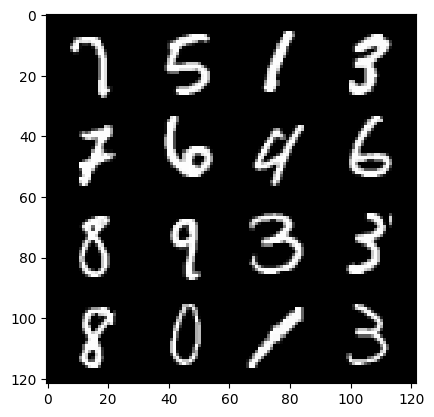

 81%|████████  | 379/469 [00:10<00:03, 26.59it/s]

12: step 6000 / Gen loss: 6.680860978762307 / disc_loss: 0.013546256086168178


 43%|████▎     | 201/469 [00:05<00:08, 32.00it/s]

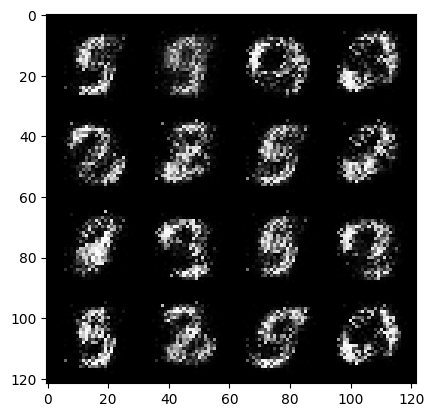

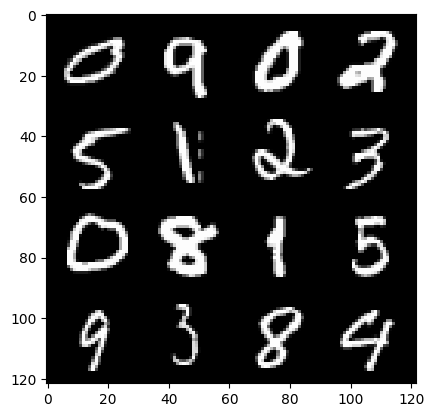

 45%|████▍     | 209/469 [00:05<00:12, 21.01it/s]

13: step 6300 / Gen loss: 6.698813665707902 / disc_loss: 0.012838728690985594


  7%|▋         | 31/469 [00:00<00:12, 36.25it/s]

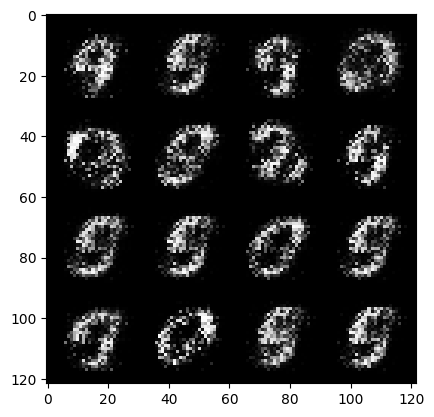

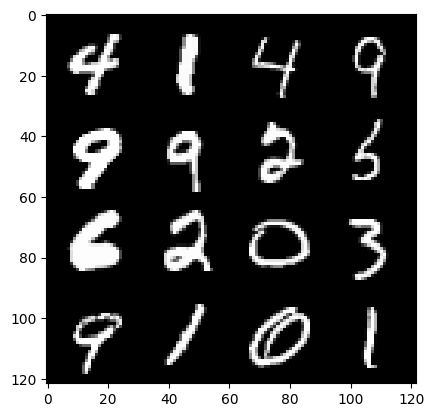

  9%|▉         | 42/469 [00:01<00:16, 26.26it/s]

14: step 6600 / Gen loss: 6.647704871495571 / disc_loss: 0.012354972089330353


 71%|███████   | 334/469 [00:08<00:03, 40.59it/s]

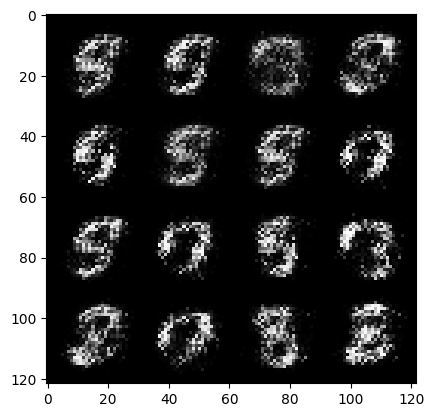

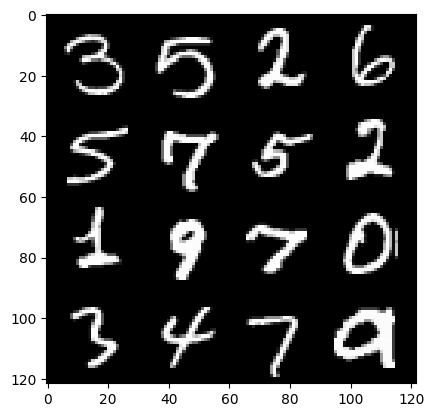

 72%|███████▏  | 339/469 [00:09<00:04, 26.36it/s]

14: step 6900 / Gen loss: 6.637877872784935 / disc_loss: 0.009346368385789304


 35%|███▍      | 164/469 [00:04<00:07, 39.76it/s]

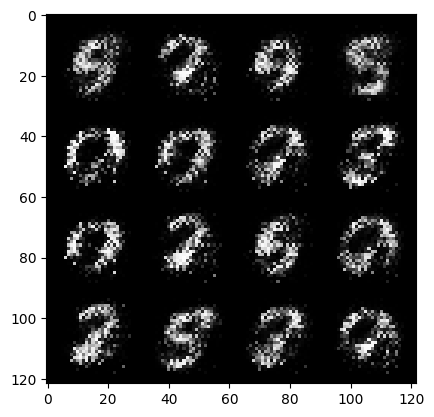

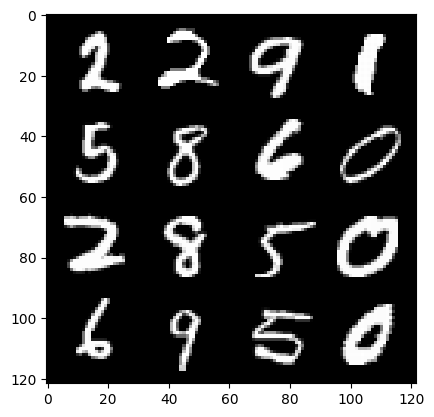

 37%|███▋      | 172/469 [00:04<00:11, 25.36it/s]

15: step 7200 / Gen loss: 6.918814633687345 / disc_loss: 0.008626644965261217


 98%|█████████▊| 461/469 [00:12<00:00, 36.27it/s]

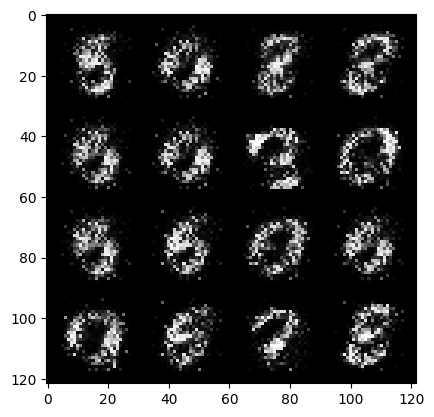

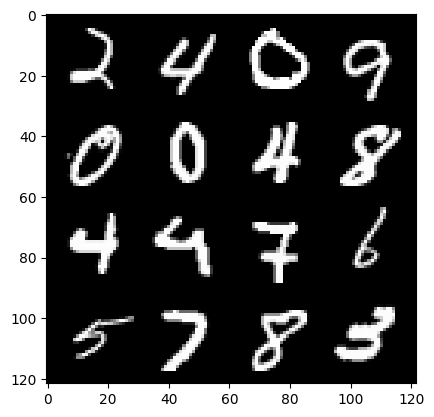

100%|██████████| 469/469 [00:12<00:00, 37.50it/s]


15: step 7500 / Gen loss: 7.09017351945241 / disc_loss: 0.008133342913351946


 62%|██████▏   | 293/469 [00:07<00:04, 40.86it/s]

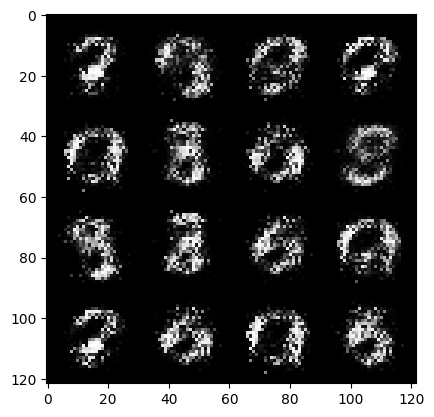

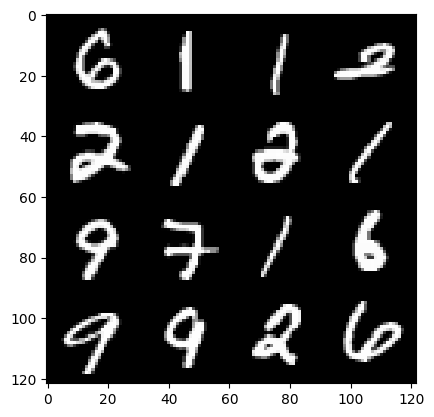

 64%|██████▍   | 302/469 [00:07<00:06, 26.28it/s]

16: step 7800 / Gen loss: 7.052993135452277 / disc_loss: 0.008325184749749798


 27%|██▋       | 126/469 [00:03<00:08, 39.59it/s]

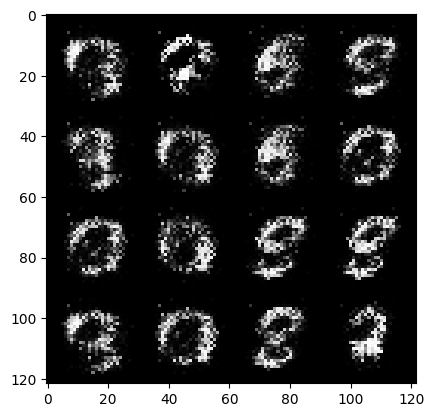

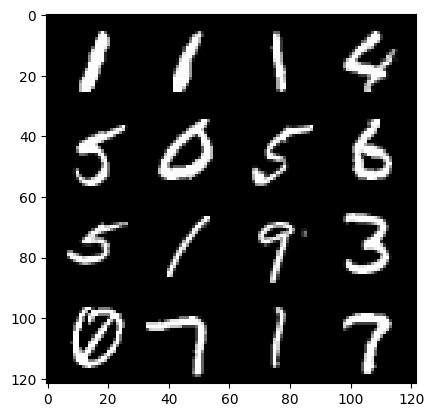

 29%|██▊       | 134/469 [00:03<00:12, 27.67it/s]

17: step 8100 / Gen loss: 7.188368075688682 / disc_loss: 0.008908485957266142


 90%|█████████ | 424/469 [00:11<00:01, 40.05it/s]

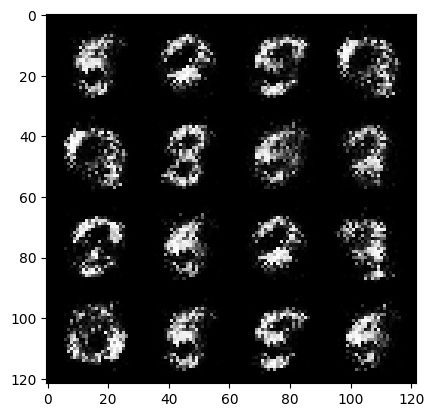

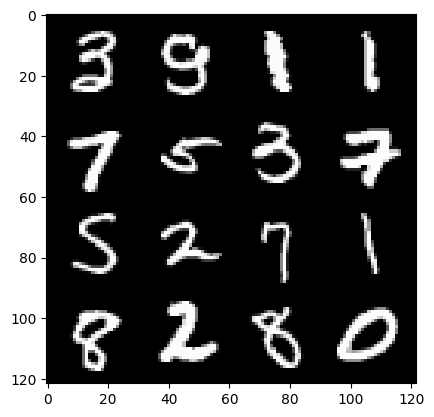

 92%|█████████▏| 433/469 [00:12<00:01, 27.31it/s]

17: step 8400 / Gen loss: 7.108401619593302 / disc_loss: 0.009330334772821514


 55%|█████▍    | 257/469 [00:07<00:07, 30.19it/s]

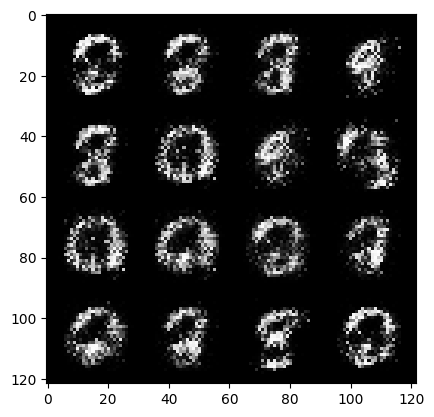

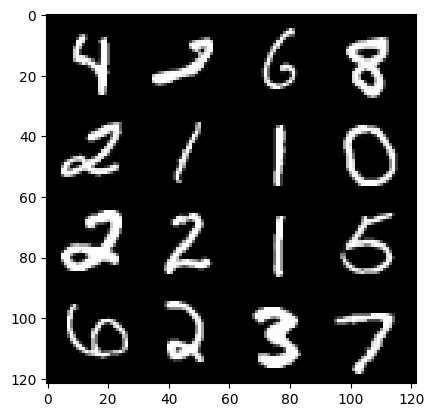

 57%|█████▋    | 265/469 [00:07<00:11, 18.04it/s]

18: step 8700 / Gen loss: 6.9590447680155405 / disc_loss: 0.010881646926670036


 19%|█▊        | 87/469 [00:02<00:10, 38.14it/s]

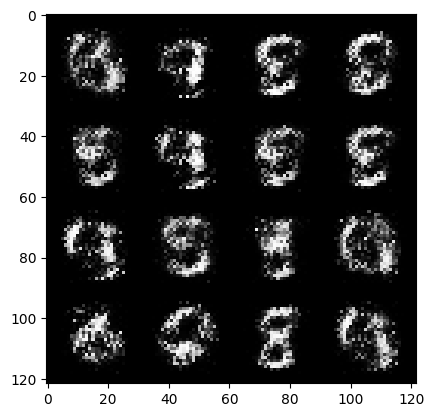

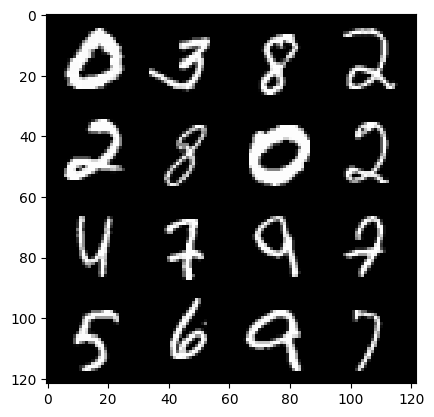

 20%|██        | 95/469 [00:03<00:14, 25.59it/s]

19: step 9000 / Gen loss: 6.902570352554319 / disc_loss: 0.01255887706686432


 83%|████████▎ | 388/469 [00:10<00:01, 44.35it/s]

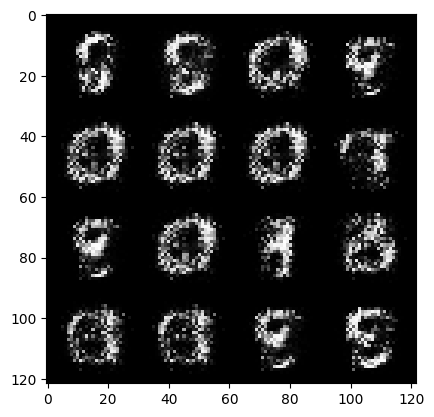

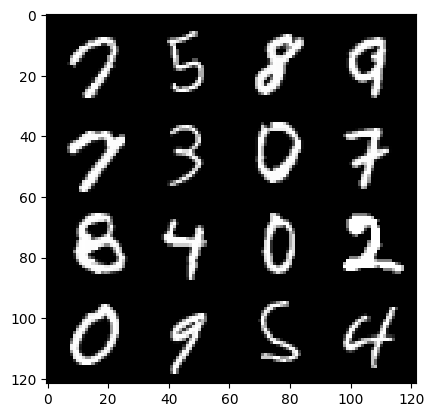

 84%|████████▍ | 393/469 [00:11<00:02, 28.77it/s]

19: step 9300 / Gen loss: 6.58580615997314 / disc_loss: 0.014820990942729007


 47%|████▋     | 219/469 [00:05<00:05, 47.46it/s]

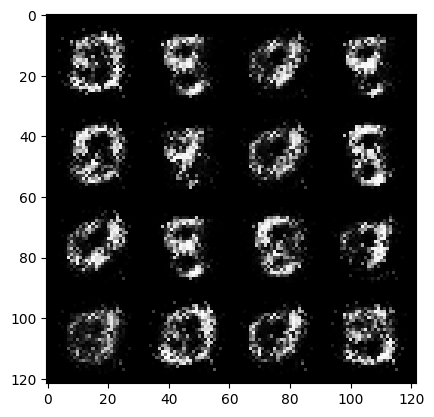

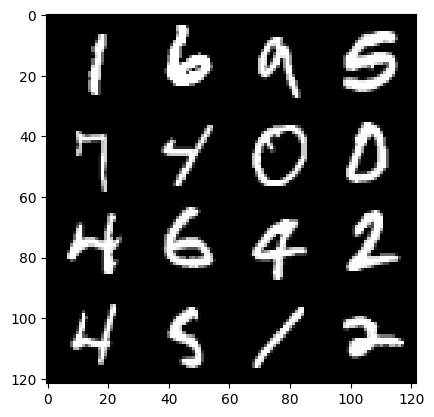

 49%|████▊     | 228/469 [00:06<00:07, 30.91it/s]

20: step 9600 / Gen loss: 6.9228561909993545 / disc_loss: 0.014020323108416055


 10%|▉         | 46/469 [00:00<00:06, 68.46it/s]

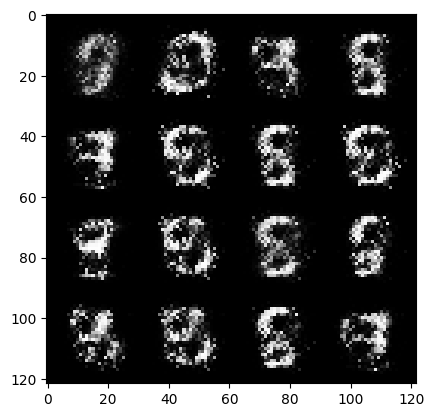

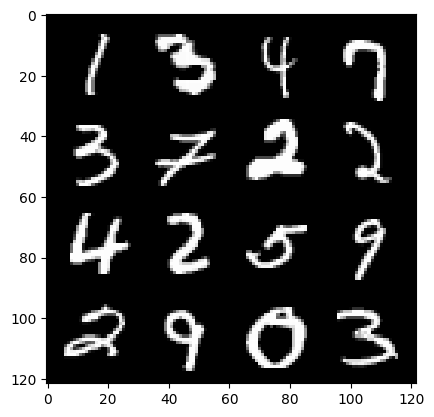

 13%|█▎        | 60/469 [00:01<00:08, 50.47it/s]

21: step 9900 / Gen loss: 6.783214375178022 / disc_loss: 0.014434627043083306


 74%|███████▍  | 347/469 [00:05<00:02, 56.60it/s]

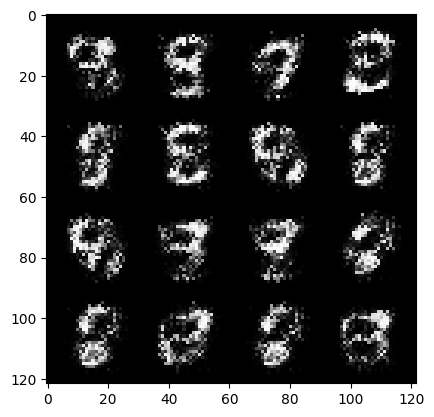

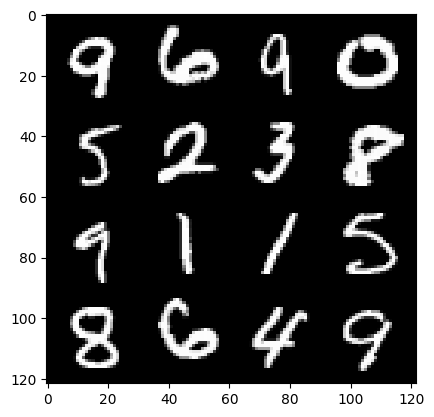

 77%|███████▋  | 359/469 [00:05<00:02, 41.45it/s]

21: step 10200 / Gen loss: 7.0316455936431925 / disc_loss: 0.011250614557260029


 38%|███▊      | 178/469 [00:02<00:04, 68.44it/s]

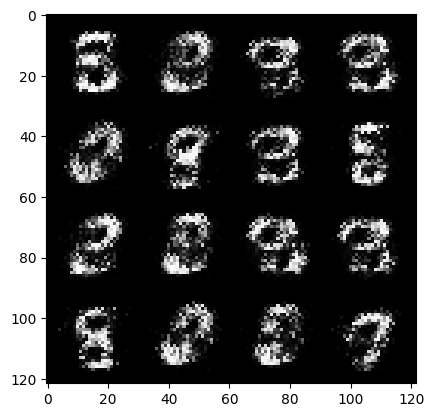

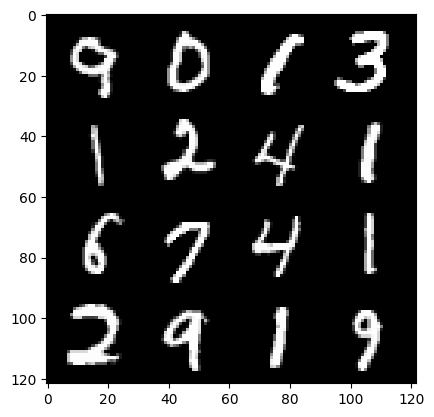

 41%|████      | 192/469 [00:02<00:05, 52.39it/s]

22: step 10500 / Gen loss: 7.02651598294576 / disc_loss: 0.011661020377650858


  1%|▏         | 7/469 [00:00<00:06, 68.12it/s]

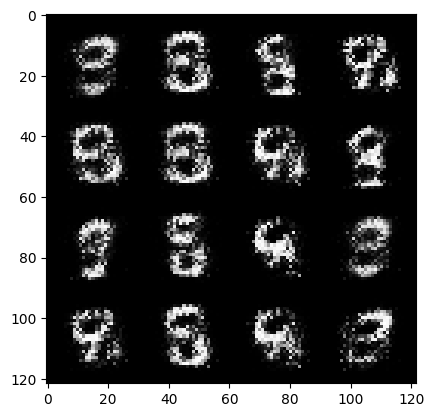

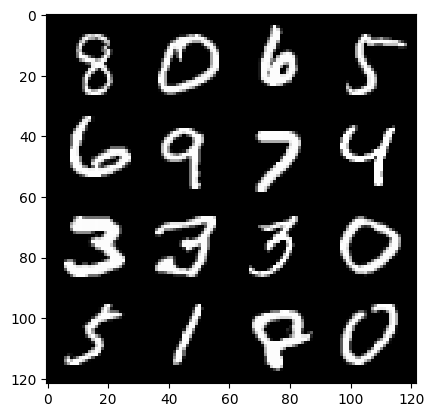

  4%|▍         | 21/469 [00:00<00:09, 46.21it/s]

23: step 10800 / Gen loss: 6.630129035313923 / disc_loss: 0.013144870531590032


 67%|██████▋   | 312/469 [00:06<00:03, 45.35it/s]

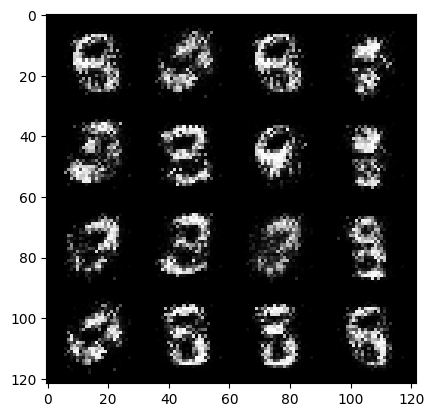

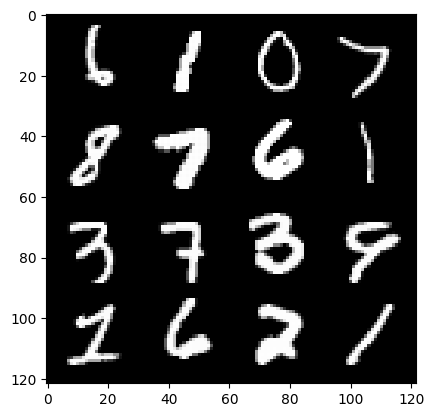

 68%|██████▊   | 321/469 [00:06<00:04, 30.75it/s]

23: step 11100 / Gen loss: 6.488009568850199 / disc_loss: 0.013778415857038151


 30%|███       | 142/469 [00:03<00:08, 39.85it/s]

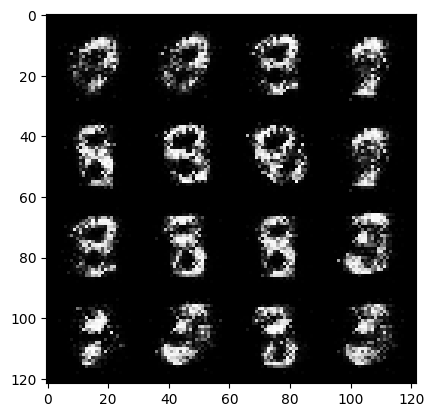

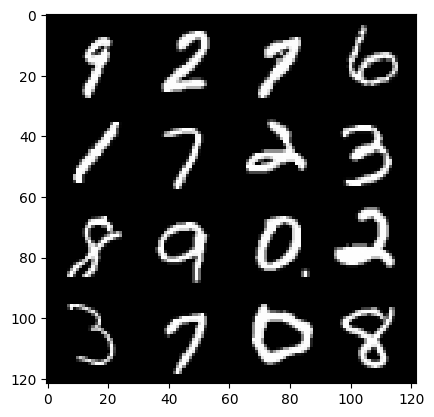

 32%|███▏      | 152/469 [00:03<00:12, 26.28it/s]

24: step 11400 / Gen loss: 6.624029253323879 / disc_loss: 0.014167847214266656


 94%|█████████▍| 441/469 [00:09<00:00, 57.38it/s]

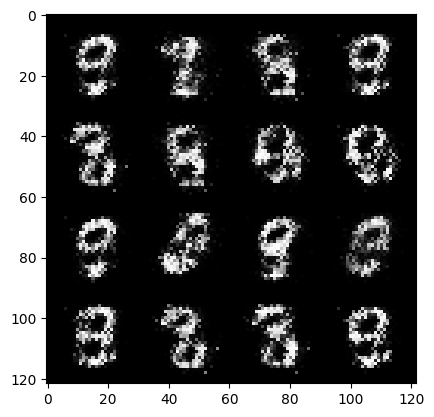

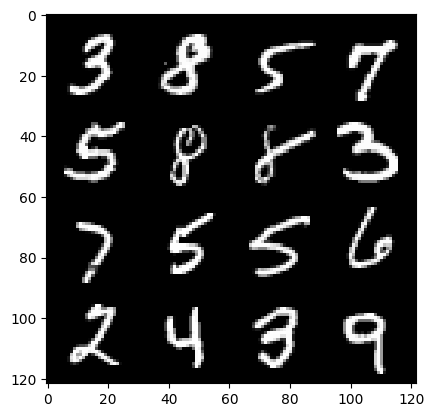

 96%|█████████▋| 452/469 [00:10<00:00, 40.01it/s]

24: step 11700 / Gen loss: 6.753991880416868 / disc_loss: 0.014016682275105259


 58%|█████▊    | 271/469 [00:05<00:03, 57.17it/s]

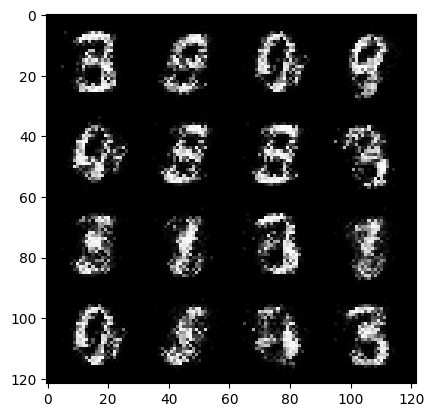

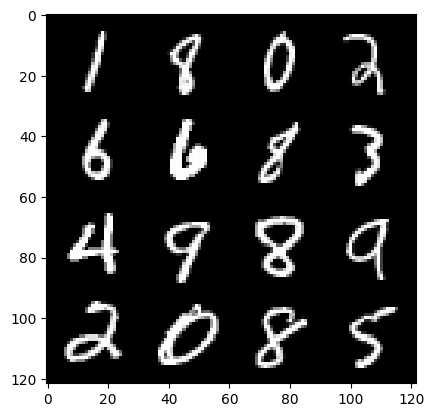

 60%|██████    | 282/469 [00:05<00:05, 34.40it/s]

25: step 12000 / Gen loss: 6.773477940559389 / disc_loss: 0.015328692421317102


 22%|██▏       | 102/469 [00:01<00:07, 52.30it/s]

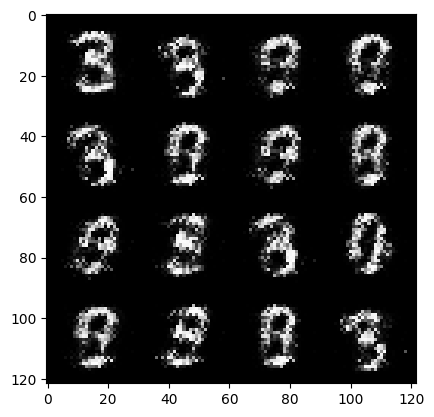

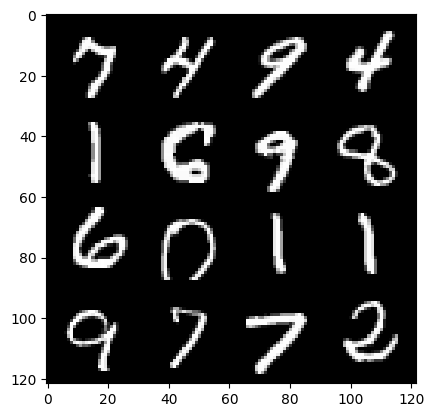

 24%|██▍       | 113/469 [00:02<00:10, 35.17it/s]

26: step 12300 / Gen loss: 6.2013889567057285 / disc_loss: 0.018122919589901948


 86%|████████▌ | 403/469 [00:08<00:01, 46.10it/s]

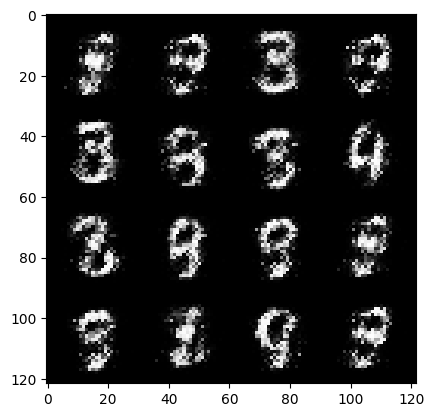

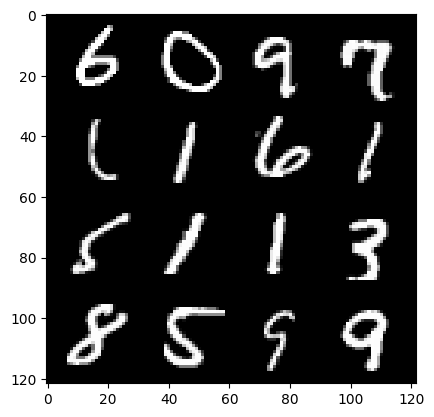

 88%|████████▊ | 412/469 [00:08<00:02, 27.78it/s]

26: step 12600 / Gen loss: 6.437572360038756 / disc_loss: 0.015468348601522549


 50%|█████     | 235/469 [00:05<00:05, 42.49it/s]

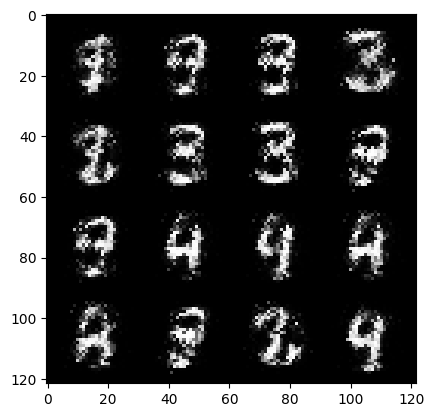

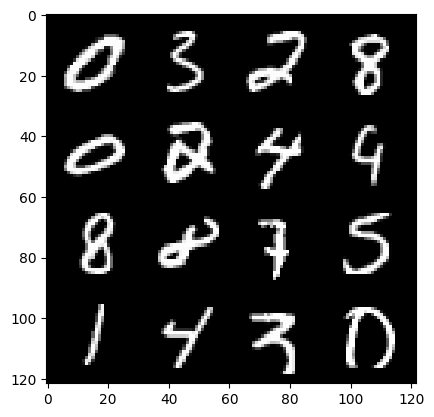

 52%|█████▏    | 244/469 [00:05<00:08, 26.34it/s]

27: step 12900 / Gen loss: 6.553444541295366 / disc_loss: 0.016206872625431662


 14%|█▍        | 68/469 [00:01<00:13, 28.86it/s]

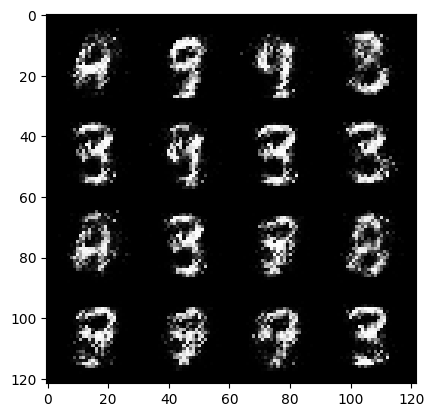

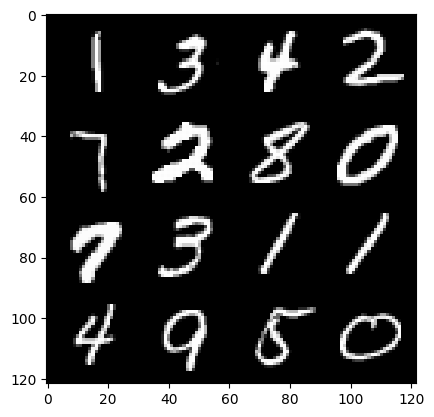

 15%|█▌        | 72/469 [00:02<00:19, 20.07it/s]

28: step 13200 / Gen loss: 6.591694358189903 / disc_loss: 0.015016246390684202


 78%|███████▊  | 367/469 [00:08<00:01, 69.91it/s]

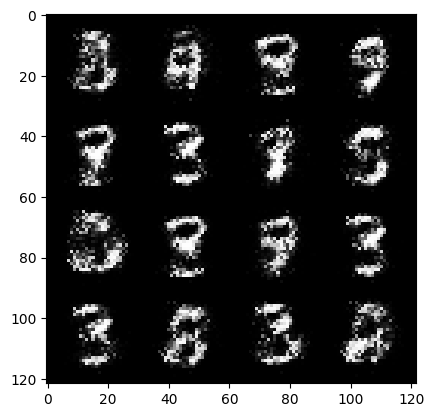

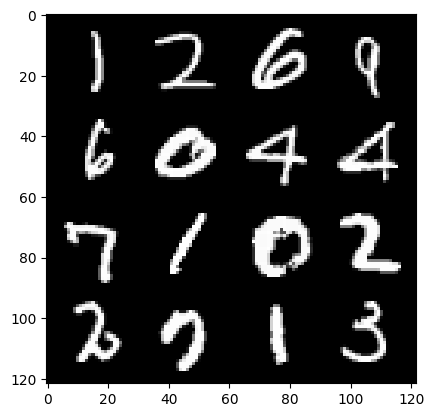

 81%|████████  | 380/469 [00:08<00:01, 51.72it/s]

28: step 13500 / Gen loss: 6.737359642982482 / disc_loss: 0.019330869860326252


 41%|████▏     | 194/469 [00:02<00:03, 70.63it/s]

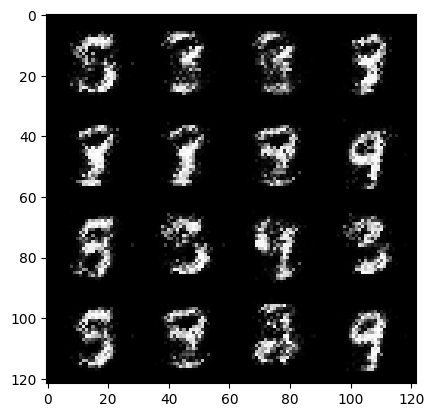

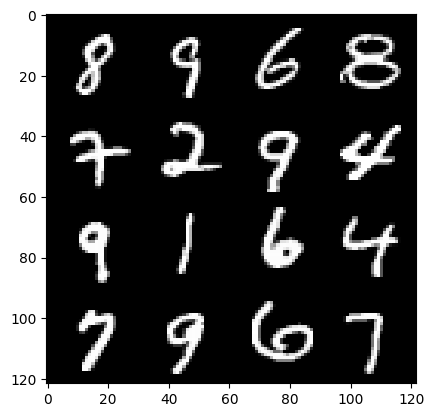

 45%|████▍     | 209/469 [00:03<00:04, 53.73it/s]

29: step 13800 / Gen loss: 6.30028010527293 / disc_loss: 0.021613371092826128


  6%|▌         | 28/469 [00:00<00:06, 63.73it/s]

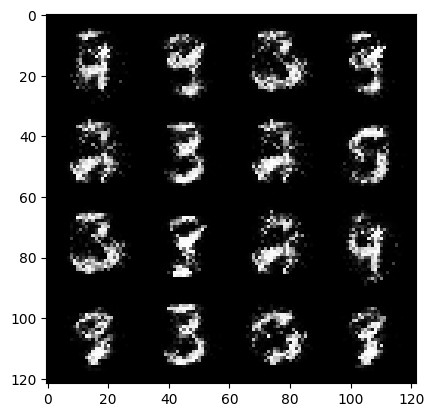

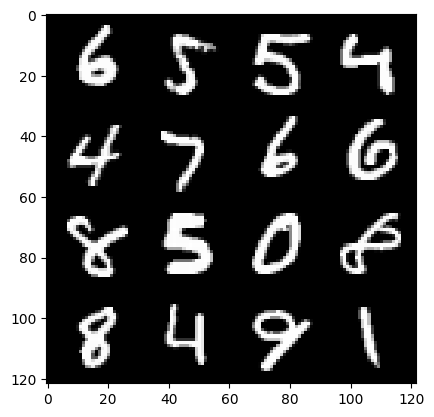

  9%|▉         | 42/469 [00:00<00:10, 40.55it/s]

30: step 14100 / Gen loss: 6.341721377372742 / disc_loss: 0.018134019443920502


 69%|██████▉   | 323/469 [00:04<00:02, 69.98it/s]

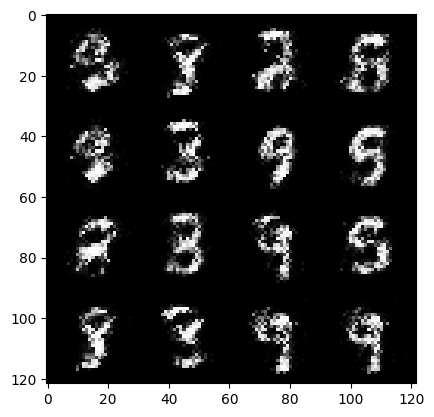

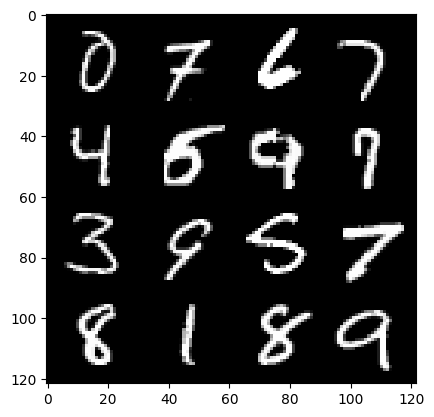

 72%|███████▏  | 338/469 [00:05<00:02, 53.31it/s]

30: step 14400 / Gen loss: 6.354369343121844 / disc_loss: 0.01689612713409588


 34%|███▍      | 160/469 [00:02<00:04, 72.32it/s]

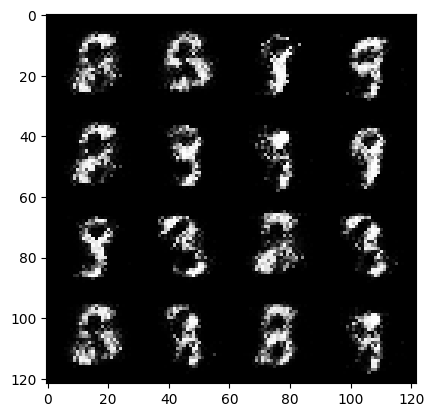

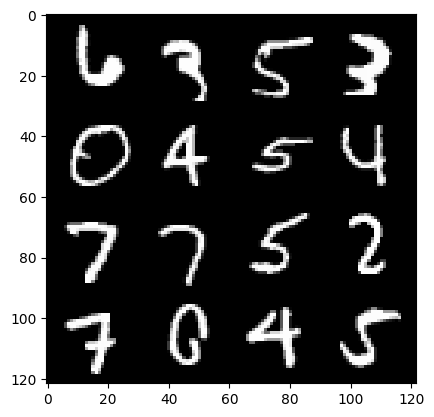

 37%|███▋      | 175/469 [00:02<00:05, 53.63it/s]

31: step 14700 / Gen loss: 6.419960784912109 / disc_loss: 0.020624455812697597


 97%|█████████▋| 455/469 [00:06<00:00, 73.07it/s]

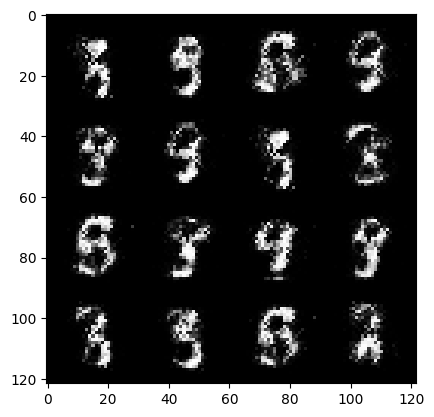

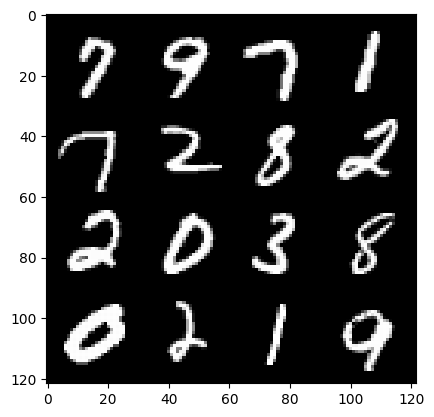

100%|██████████| 469/469 [00:06<00:00, 68.86it/s]


31: step 15000 / Gen loss: 6.2248901494344135 / disc_loss: 0.022401290019042796


 61%|██████    | 287/469 [00:03<00:02, 71.84it/s]

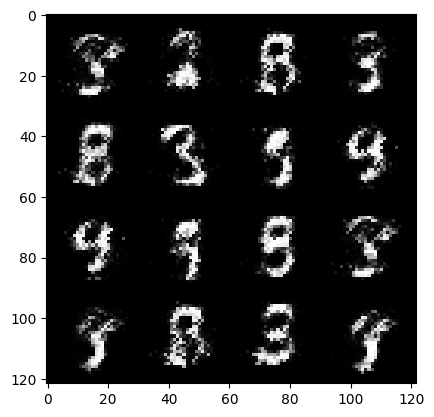

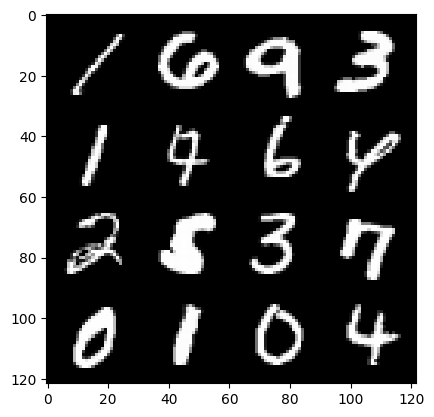

 64%|██████▍   | 302/469 [00:04<00:03, 55.30it/s]

32: step 15300 / Gen loss: 6.13044449329376 / disc_loss: 0.02071238510310651


 25%|██▍       | 117/469 [00:01<00:05, 65.94it/s]

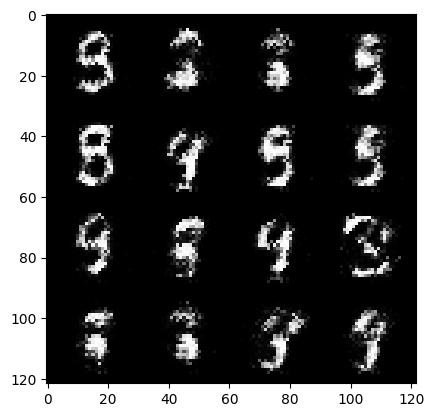

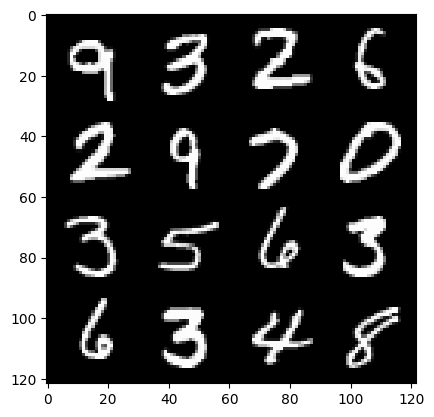

 28%|██▊       | 131/469 [00:02<00:06, 50.53it/s]

33: step 15600 / Gen loss: 6.102499190966285 / disc_loss: 0.023247964760133386


 89%|████████▊ | 416/469 [00:06<00:00, 74.28it/s]

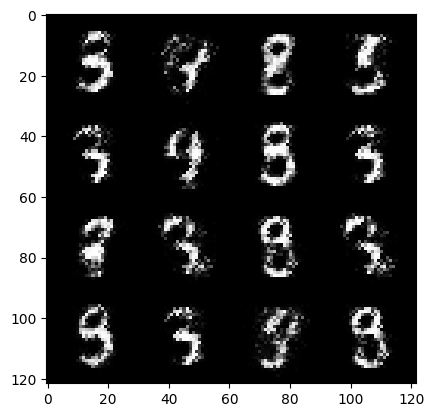

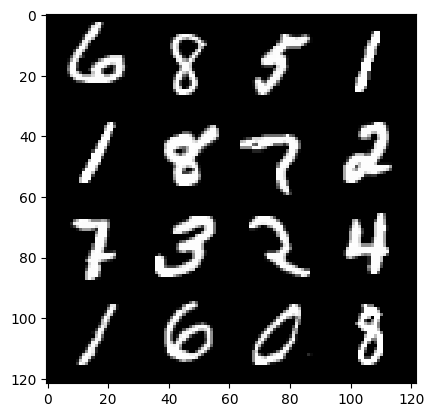

 93%|█████████▎| 438/469 [00:06<00:00, 60.11it/s]

33: step 15900 / Gen loss: 6.208607101440429 / disc_loss: 0.023595603631498933


 54%|█████▎    | 252/469 [00:03<00:03, 71.55it/s]

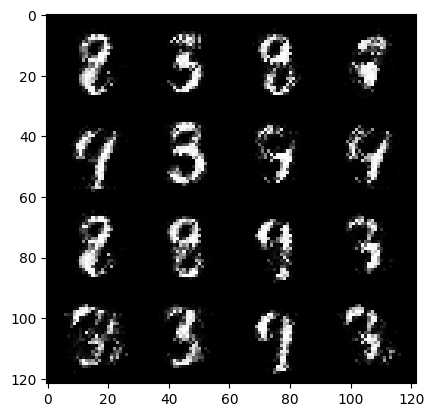

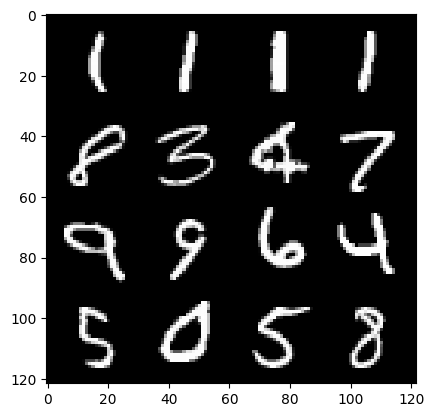

 57%|█████▋    | 267/469 [00:03<00:03, 53.63it/s]

34: step 16200 / Gen loss: 6.00832681655884 / disc_loss: 0.025927327062624194


 17%|█▋        | 80/469 [00:01<00:05, 73.98it/s]

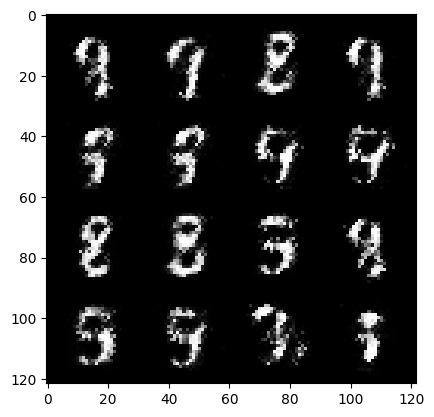

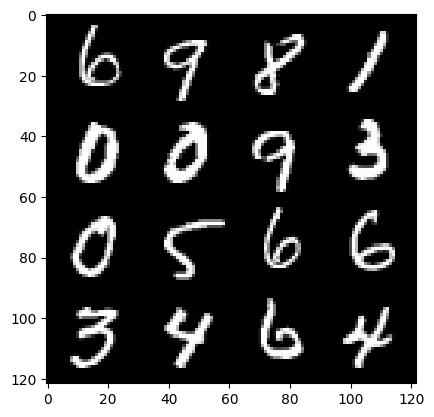

 20%|██        | 95/469 [00:01<00:06, 53.57it/s]

35: step 16500 / Gen loss: 5.968492501576739 / disc_loss: 0.030560720182644836


 81%|████████  | 381/469 [00:05<00:01, 76.40it/s]

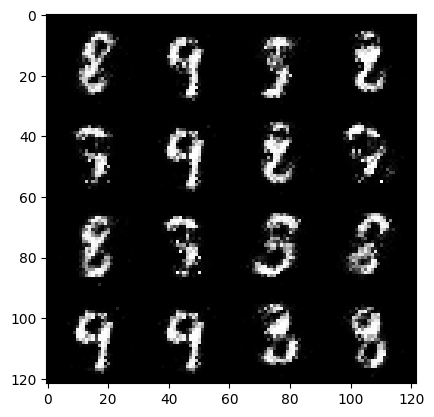

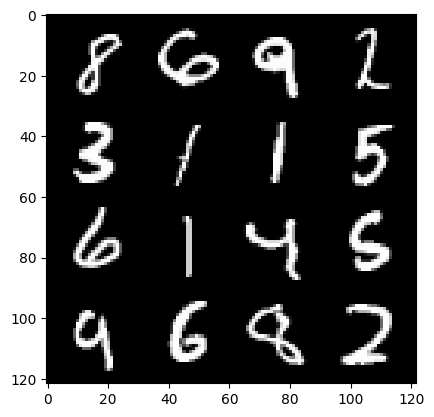

 85%|████████▍ | 397/469 [00:05<00:01, 58.86it/s]

35: step 16800 / Gen loss: 5.673309017817183 / disc_loss: 0.03493982322824497


 46%|████▌     | 216/469 [00:03<00:03, 71.01it/s]

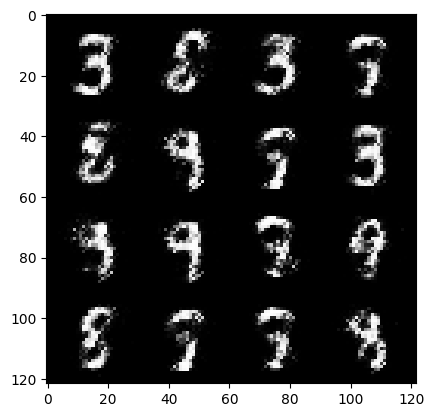

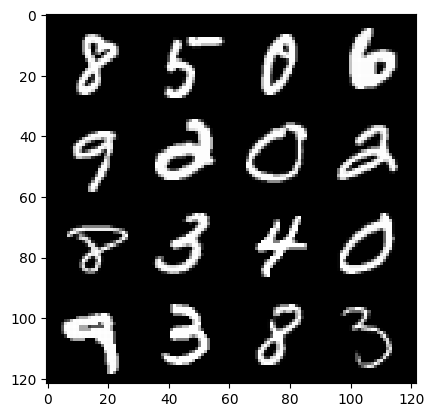

 48%|████▊     | 224/469 [00:03<00:04, 51.91it/s]

36: step 17100 / Gen loss: 5.522006862958273 / disc_loss: 0.03406073121353984


  9%|▊         | 40/469 [00:00<00:05, 73.73it/s]

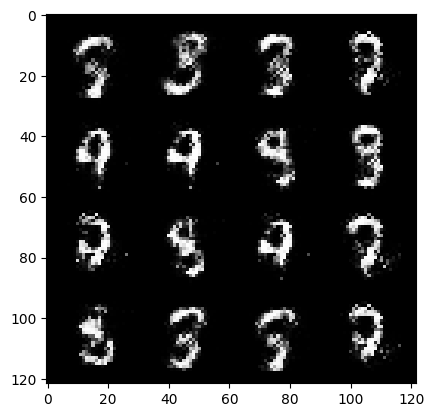

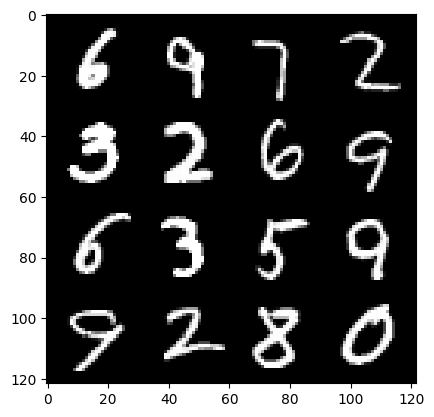

 12%|█▏        | 56/469 [00:00<00:07, 56.48it/s]

37: step 17400 / Gen loss: 5.54205410798391 / disc_loss: 0.03374796586111189


 73%|███████▎  | 342/469 [00:05<00:01, 70.07it/s]

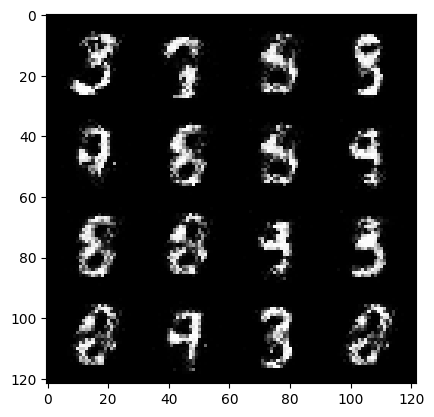

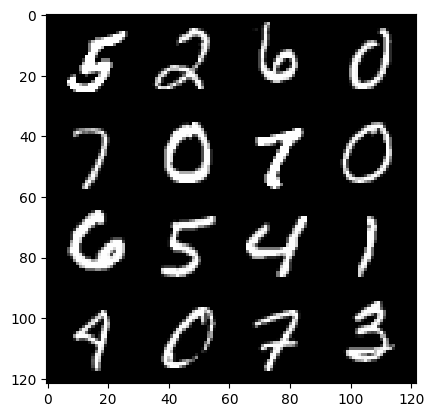

 76%|███████▌  | 357/469 [00:05<00:02, 52.31it/s]

37: step 17700 / Gen loss: 5.424247636795044 / disc_loss: 0.038374605877324934


 38%|███▊      | 177/469 [00:04<00:07, 39.55it/s]

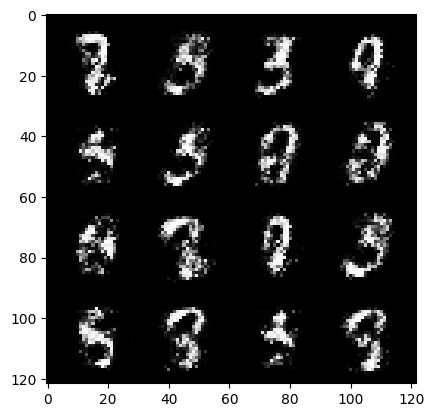

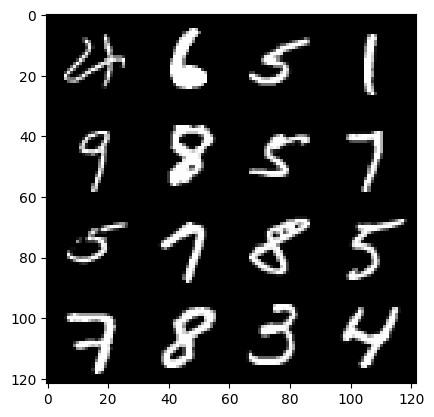

 39%|███▉      | 182/469 [00:04<00:12, 23.03it/s]

38: step 18000 / Gen loss: 5.691138310432436 / disc_loss: 0.03895696598726017


  2%|▏         | 8/469 [00:00<00:13, 35.04it/s]

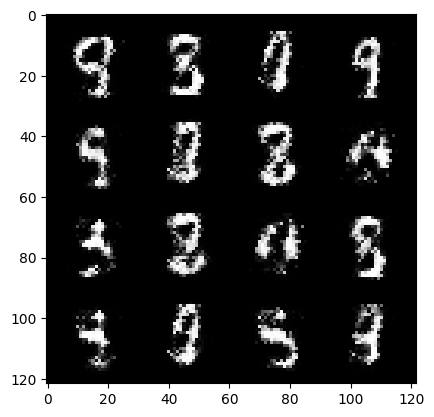

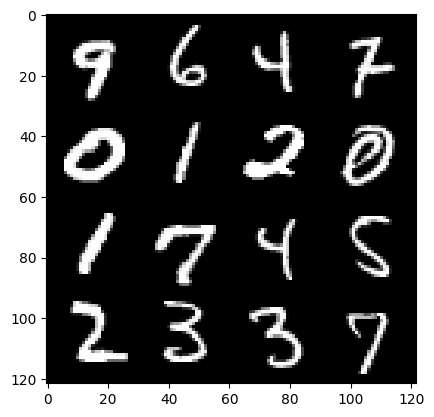

  3%|▎         | 16/469 [00:00<00:22, 20.13it/s]

39: step 18300 / Gen loss: 5.452726490497587 / disc_loss: 0.04057997495556869


 66%|██████▌   | 309/469 [00:08<00:04, 32.33it/s]

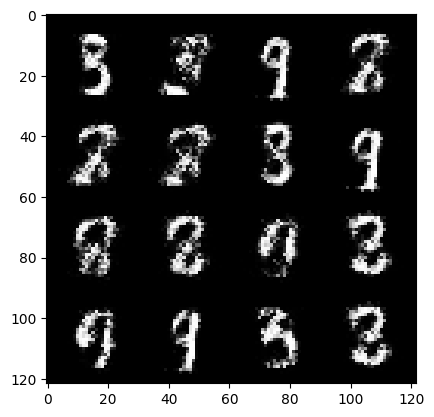

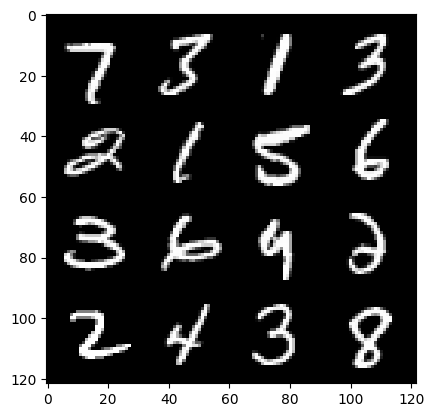

 68%|██████▊   | 317/469 [00:08<00:06, 24.40it/s]

39: step 18600 / Gen loss: 5.316699539820357 / disc_loss: 0.03786431837206086


 29%|██▉       | 137/469 [00:03<00:07, 45.42it/s]

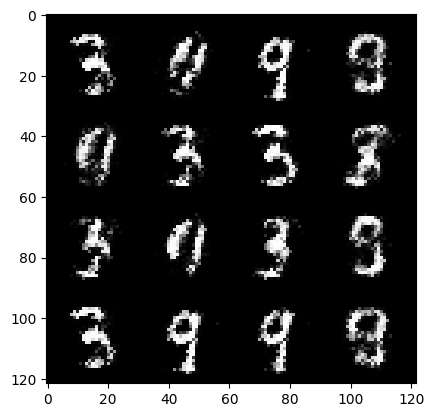

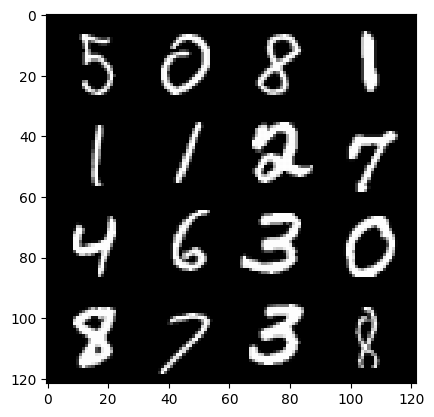

 31%|███       | 146/469 [00:03<00:12, 25.90it/s]

40: step 18900 / Gen loss: 5.449699498812364 / disc_loss: 0.038593570465842914


 93%|█████████▎| 437/469 [00:10<00:00, 61.24it/s]

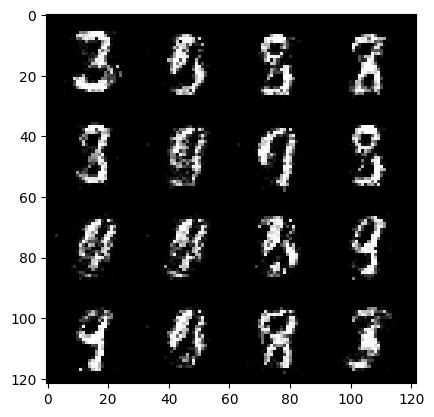

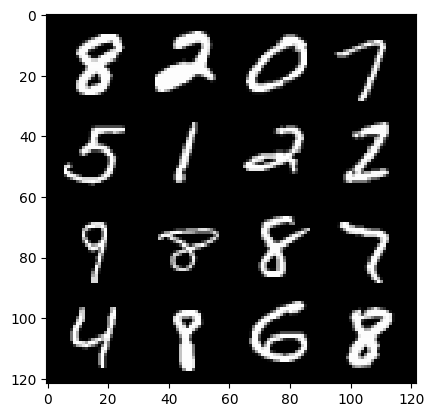

 96%|█████████▌| 449/469 [00:10<00:00, 40.42it/s]

40: step 19200 / Gen loss: 5.4545397631327335 / disc_loss: 0.0400664706714451


 57%|█████▋    | 269/469 [00:05<00:05, 34.56it/s]

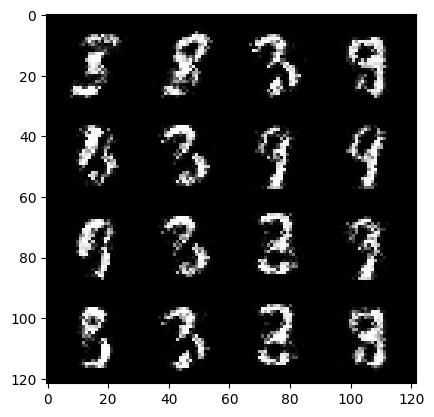

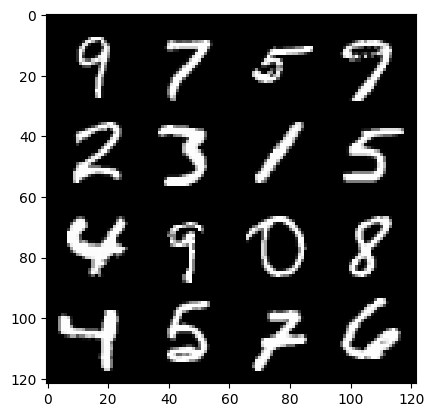

 59%|█████▉    | 278/469 [00:06<00:07, 23.97it/s]

41: step 19500 / Gen loss: 5.556471276283266 / disc_loss: 0.03813970272274066


 21%|██        | 97/469 [00:01<00:06, 53.38it/s]

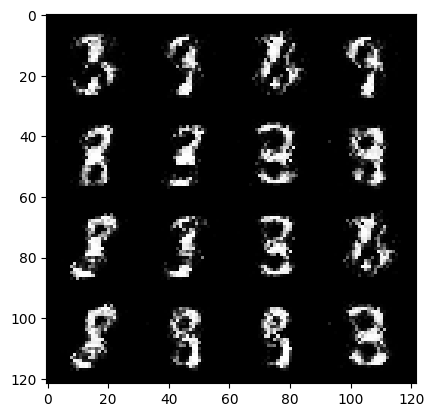

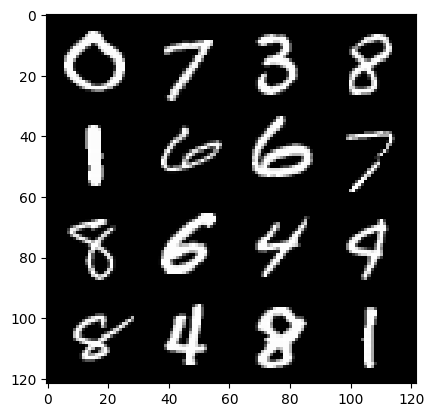

 23%|██▎       | 108/469 [00:02<00:09, 39.11it/s]

42: step 19800 / Gen loss: 5.473728466033938 / disc_loss: 0.04201356112025675


 85%|████████▌ | 399/469 [00:09<00:02, 32.40it/s]

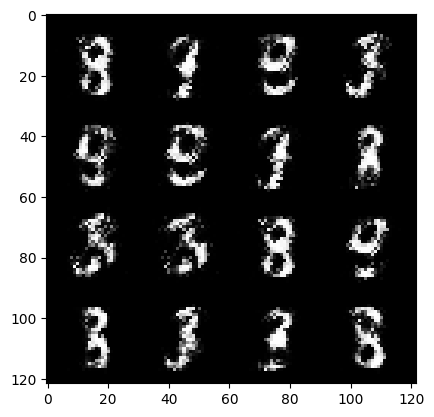

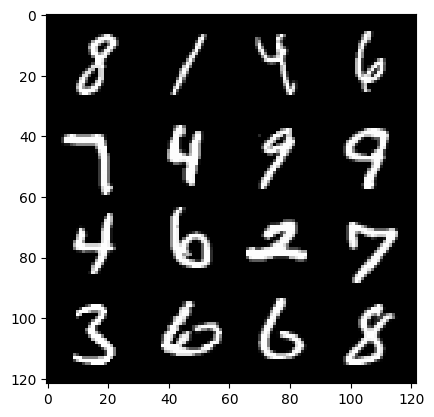

 87%|████████▋ | 406/469 [00:09<00:02, 22.25it/s]

42: step 20100 / Gen loss: 5.465643938382468 / disc_loss: 0.03966037555597722


 50%|████▉     | 233/469 [00:05<00:04, 48.39it/s]

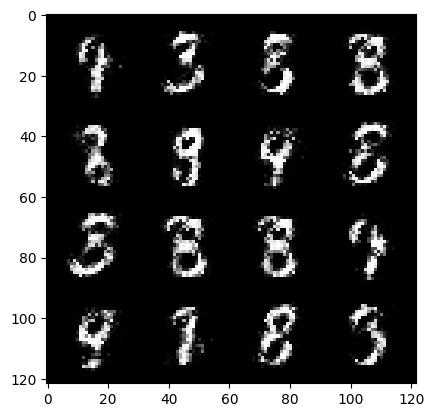

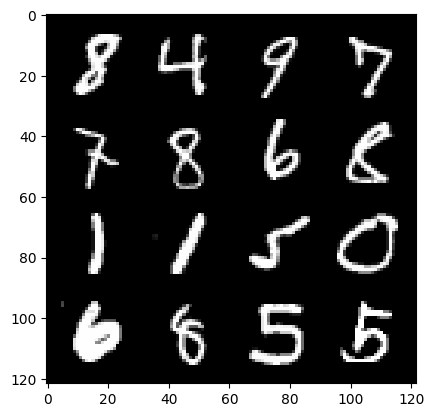

 52%|█████▏    | 242/469 [00:05<00:06, 34.43it/s]

43: step 20400 / Gen loss: 5.59826481501262 / disc_loss: 0.04247867319112023


 13%|█▎        | 59/469 [00:01<00:07, 56.10it/s]

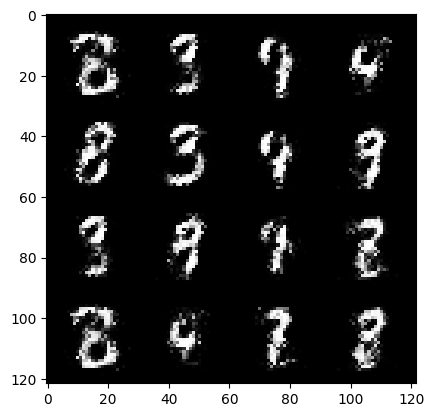

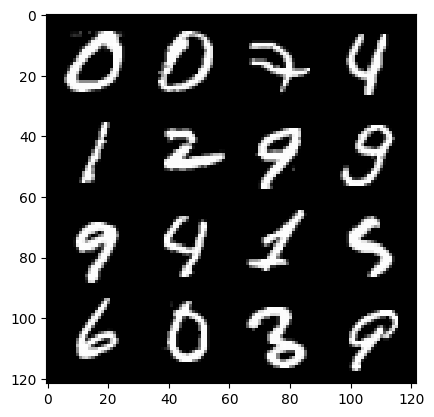

 15%|█▍        | 70/469 [00:01<00:11, 34.49it/s]

44: step 20700 / Gen loss: 5.759282787640892 / disc_loss: 0.044269836653644846


 77%|███████▋  | 359/469 [00:07<00:02, 52.66it/s]

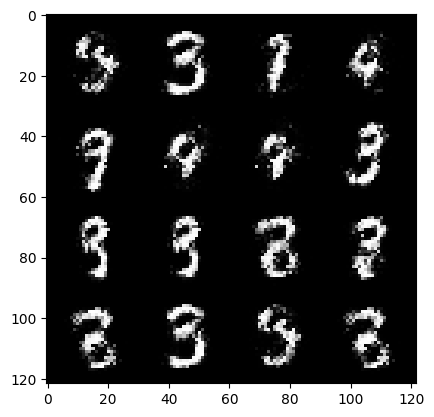

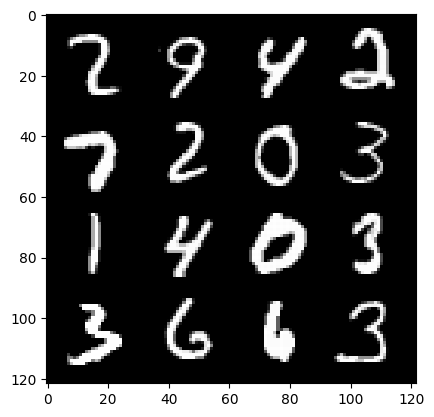

 79%|███████▉  | 371/469 [00:07<00:02, 38.10it/s]

44: step 21000 / Gen loss: 5.446761946678162 / disc_loss: 0.04438602644329268


 42%|████▏     | 195/469 [00:03<00:05, 52.70it/s]

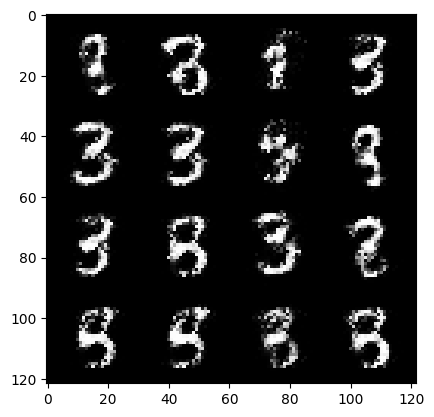

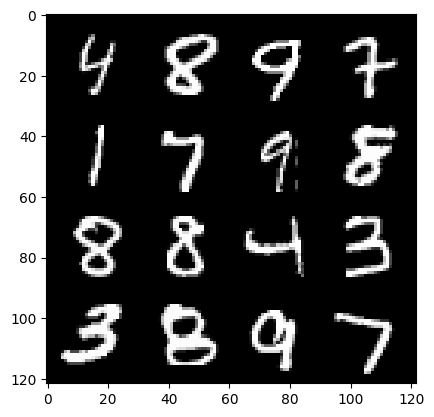

 43%|████▎     | 201/469 [00:03<00:08, 32.96it/s]

45: step 21300 / Gen loss: 5.525829693476359 / disc_loss: 0.04320948343724014


  5%|▌         | 24/469 [00:00<00:08, 50.15it/s]

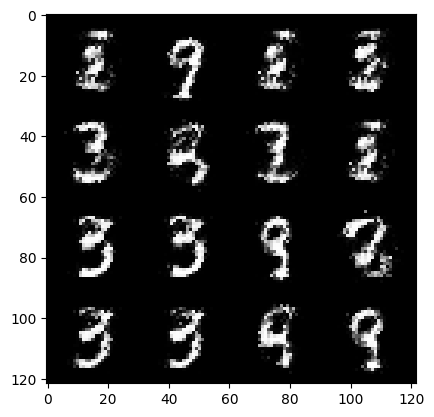

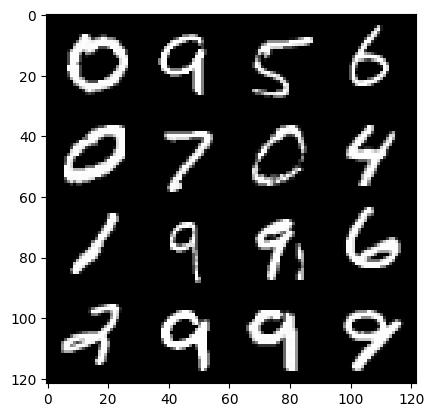

  7%|▋         | 34/469 [00:00<00:14, 30.85it/s]

46: step 21600 / Gen loss: 5.441792821884154 / disc_loss: 0.0460048141361525


 69%|██████▉   | 325/469 [00:06<00:02, 55.51it/s]

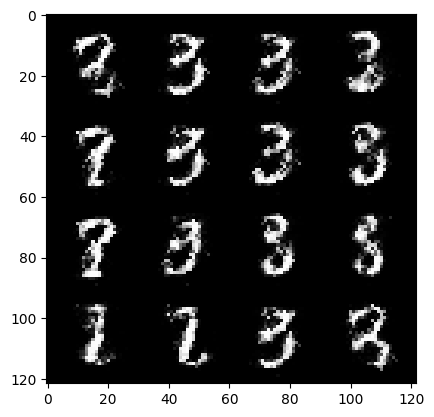

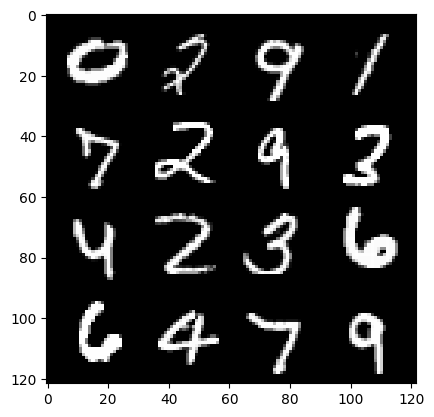

 71%|███████   | 331/469 [00:06<00:03, 36.17it/s]

46: step 21900 / Gen loss: 5.381592961947122 / disc_loss: 0.04398618959511318


 33%|███▎      | 155/469 [00:03<00:07, 44.41it/s]

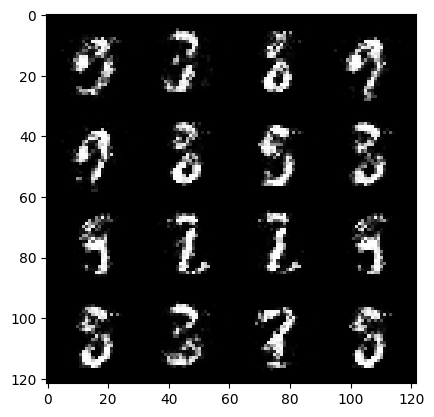

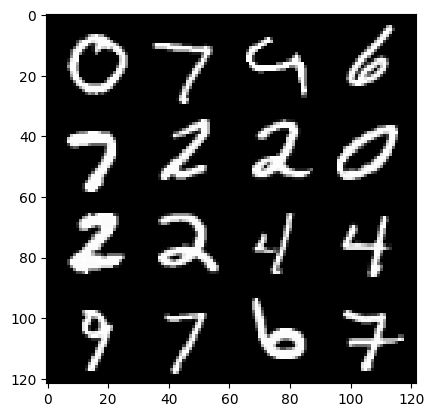

 35%|███▍      | 164/469 [00:03<00:10, 30.20it/s]

47: step 22200 / Gen loss: 5.36696746349335 / disc_loss: 0.04070504186985394


 97%|█████████▋| 457/469 [00:10<00:00, 51.87it/s]

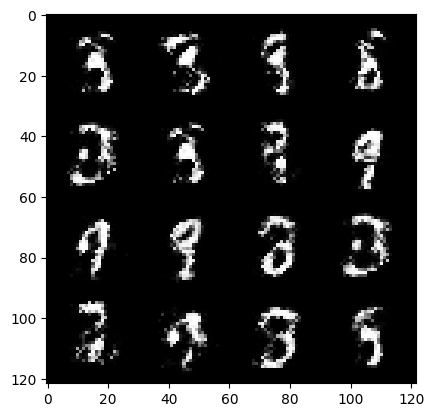

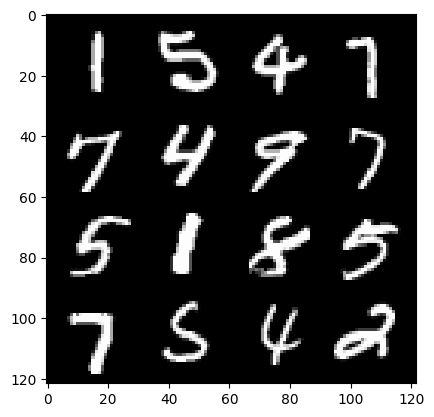

 99%|█████████▊| 463/469 [00:10<00:00, 32.11it/s]

47: step 22500 / Gen loss: 5.691817452112828 / disc_loss: 0.055375971635803586


 61%|██████    | 284/469 [00:06<00:05, 34.40it/s]

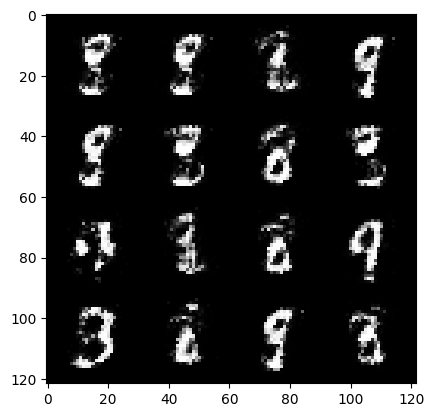

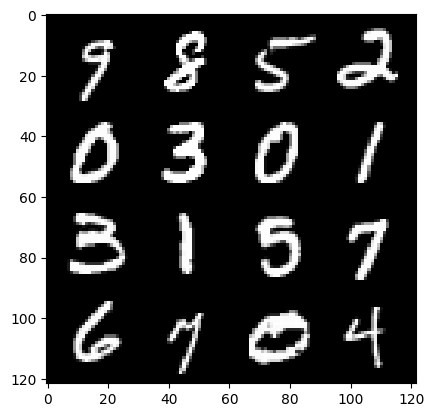

 64%|██████▍   | 300/469 [00:07<00:04, 37.83it/s]

48: step 22800 / Gen loss: 5.4849481232961 / disc_loss: 0.050428070252140335


 25%|██▌       | 119/469 [00:01<00:04, 71.57it/s]

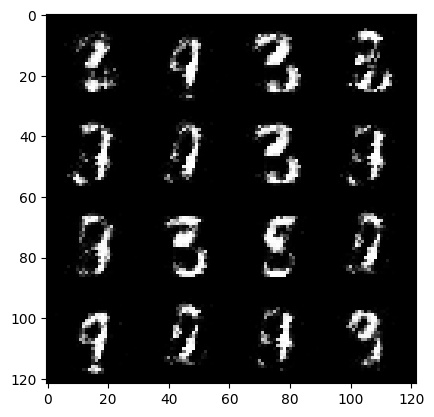

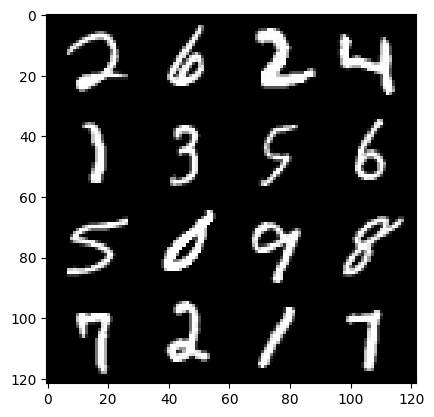

 29%|██▊       | 134/469 [00:02<00:06, 55.48it/s]

49: step 23100 / Gen loss: 5.1777113731702205 / disc_loss: 0.05627209895911314


 89%|████████▉ | 419/469 [00:06<00:00, 69.94it/s]

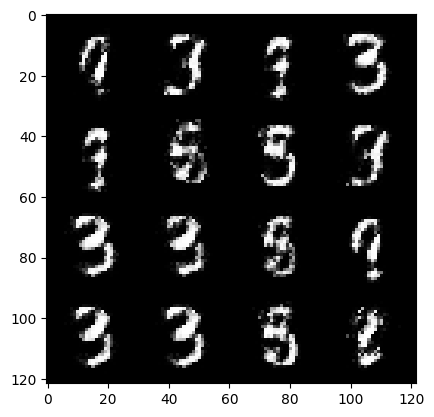

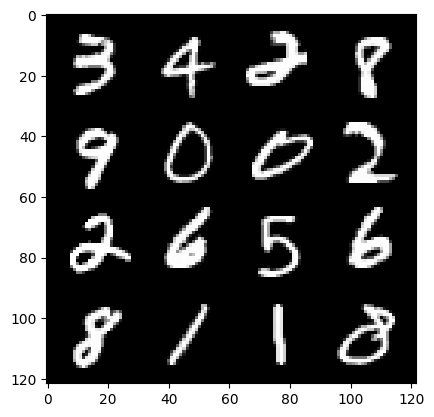

 92%|█████████▏| 433/469 [00:06<00:00, 54.67it/s]

49: step 23400 / Gen loss: 5.338950034777321 / disc_loss: 0.05951381136973691


 53%|█████▎    | 248/469 [00:03<00:03, 71.75it/s]

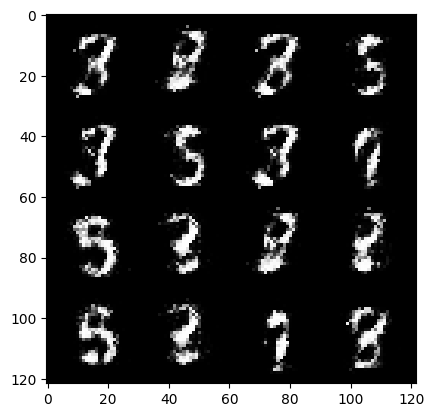

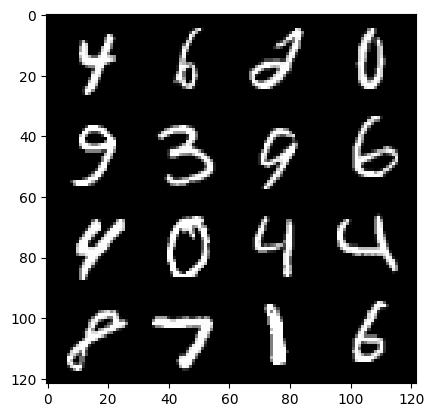

 56%|█████▋    | 264/469 [00:03<00:03, 55.50it/s]

50: step 23700 / Gen loss: 5.159062906901042 / disc_loss: 0.05912190598435696


 16%|█▌        | 75/469 [00:01<00:05, 69.67it/s]

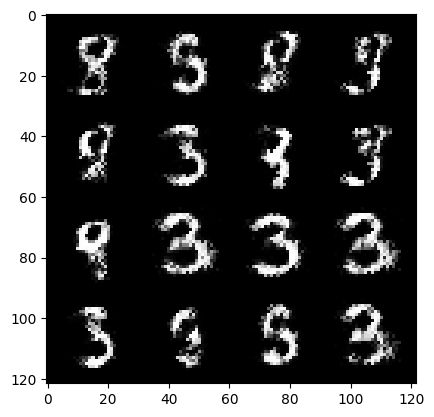

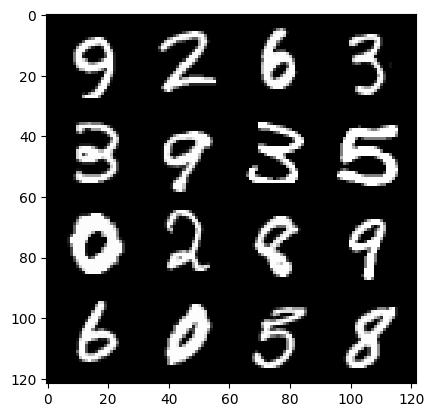

 19%|█▉        | 90/469 [00:01<00:07, 53.88it/s]

51: step 24000 / Gen loss: 5.250658707618713 / disc_loss: 0.055600821559006974


 80%|████████  | 377/469 [00:05<00:01, 72.10it/s]

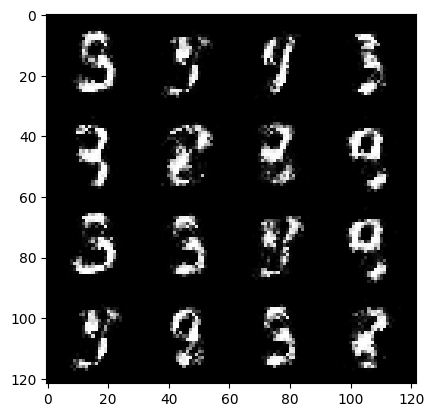

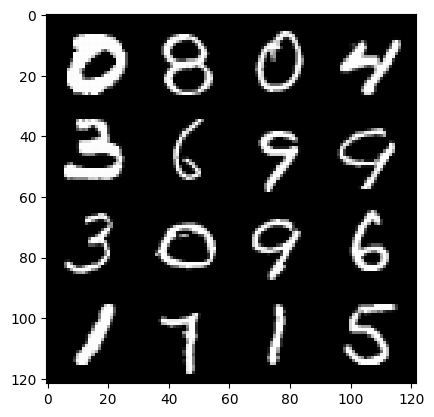

 84%|████████▎ | 392/469 [00:05<00:01, 55.26it/s]

51: step 24300 / Gen loss: 5.486288507779435 / disc_loss: 0.056475136820226896


 44%|████▍     | 208/469 [00:02<00:03, 70.34it/s]

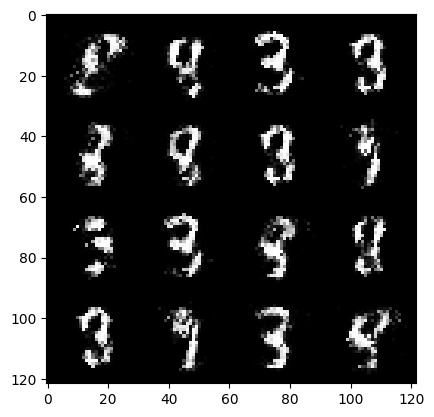

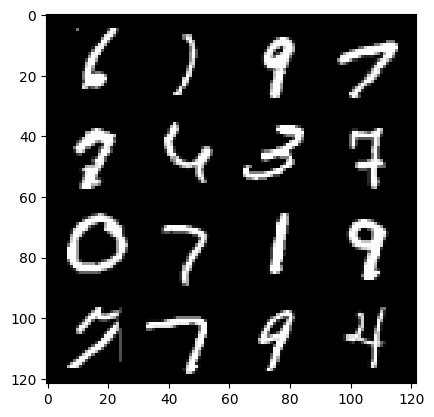

 48%|████▊     | 223/469 [00:03<00:04, 54.67it/s]

52: step 24600 / Gen loss: 5.713914213180542 / disc_loss: 0.05056839571023977


  8%|▊         | 39/469 [00:00<00:06, 68.60it/s]

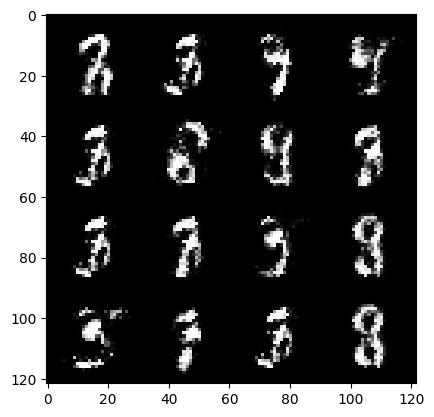

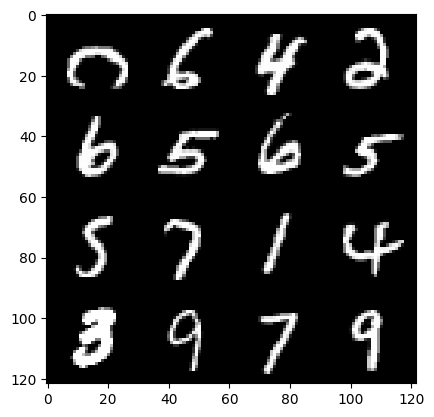

 11%|█▏        | 53/469 [00:01<00:09, 45.76it/s]

53: step 24900 / Gen loss: 5.212666639486948 / disc_loss: 0.05668067644971112


 72%|███████▏  | 338/469 [00:04<00:01, 72.05it/s]

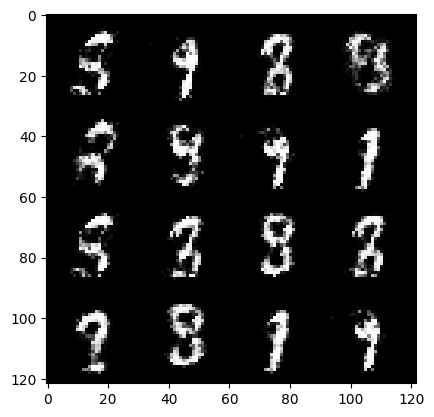

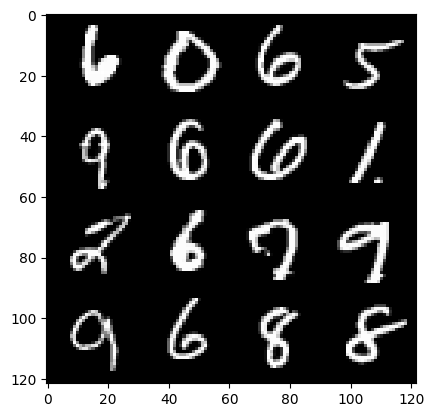

 75%|███████▌  | 353/469 [00:05<00:02, 55.89it/s]

53: step 25200 / Gen loss: 4.922243271668748 / disc_loss: 0.07882751385681327


 37%|███▋      | 172/469 [00:02<00:04, 71.26it/s]

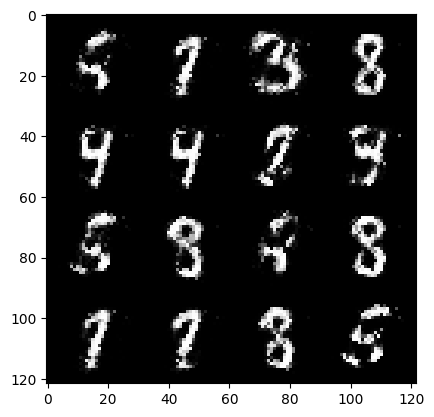

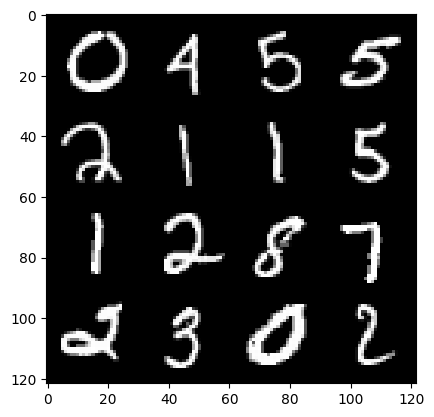

 40%|████      | 188/469 [00:02<00:04, 56.52it/s]

54: step 25500 / Gen loss: 5.178164029121399 / disc_loss: 0.07577952612812325


  0%|          | 0/469 [00:00<?, ?it/s]

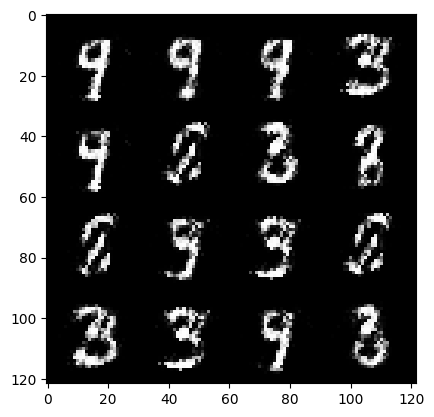

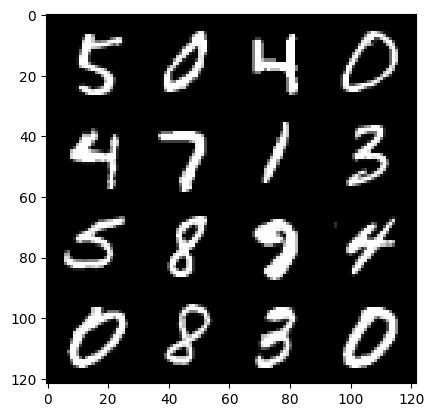

  3%|▎         | 13/469 [00:00<00:10, 42.46it/s]

55: step 25800 / Gen loss: 5.004681351979568 / disc_loss: 0.06160108956818777


 64%|██████▍   | 300/469 [00:04<00:02, 69.85it/s]

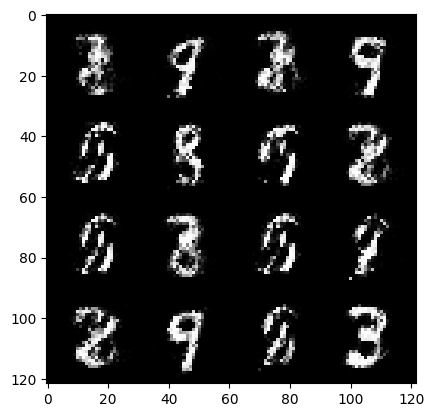

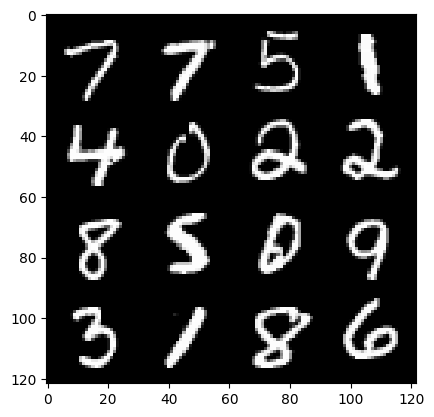

 68%|██████▊   | 321/469 [00:04<00:02, 57.53it/s]

55: step 26100 / Gen loss: 4.930093245506287 / disc_loss: 0.06288374273106458


 29%|██▉       | 135/469 [00:01<00:04, 71.08it/s]

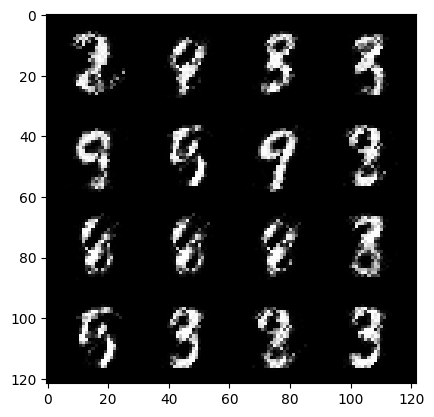

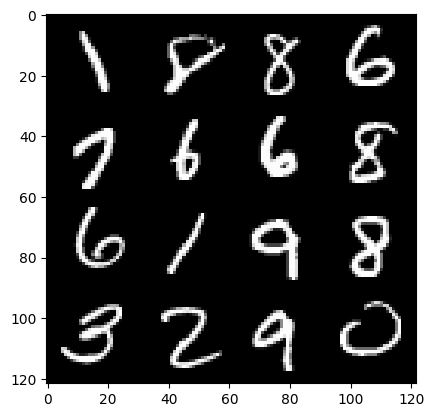

 32%|███▏      | 151/469 [00:02<00:05, 55.45it/s]

56: step 26400 / Gen loss: 5.150101423263548 / disc_loss: 0.05988834597170353


 93%|█████████▎| 436/469 [00:06<00:00, 75.13it/s]

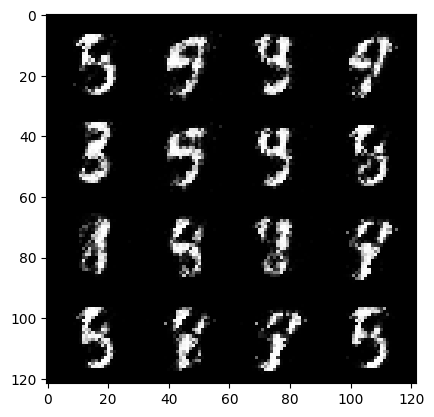

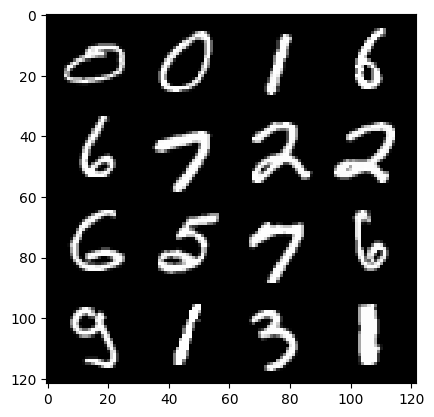

 96%|█████████▋| 452/469 [00:06<00:00, 59.34it/s]

56: step 26700 / Gen loss: 4.791335851351418 / disc_loss: 0.08060525601729747


 56%|█████▌    | 262/469 [00:03<00:02, 70.96it/s]

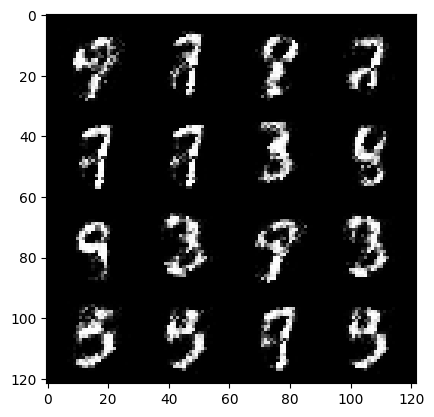

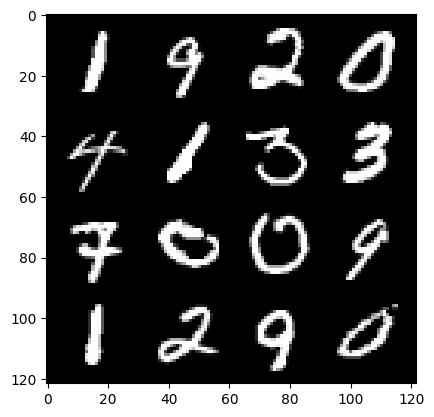

 59%|█████▉    | 277/469 [00:03<00:03, 54.09it/s]

57: step 27000 / Gen loss: 4.853772575060526 / disc_loss: 0.08048289237543943


 20%|██        | 96/469 [00:01<00:05, 72.65it/s]

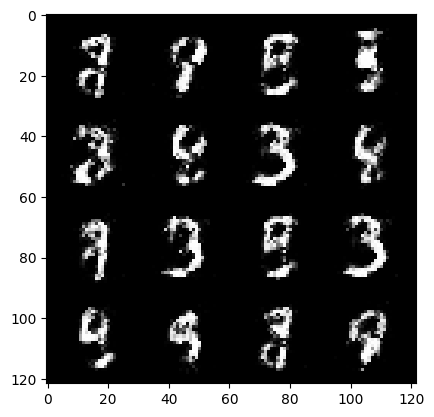

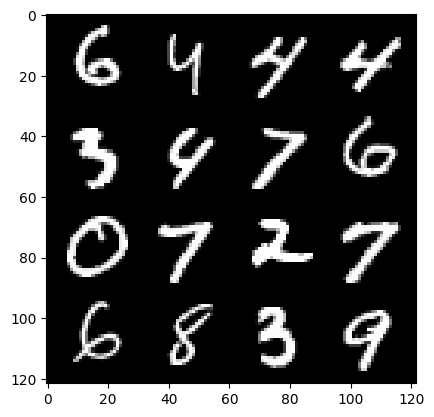

 24%|██▍       | 112/469 [00:01<00:06, 57.77it/s]

58: step 27300 / Gen loss: 4.932891596158342 / disc_loss: 0.07910868884374701


 84%|████████▍ | 393/469 [00:05<00:01, 70.60it/s]

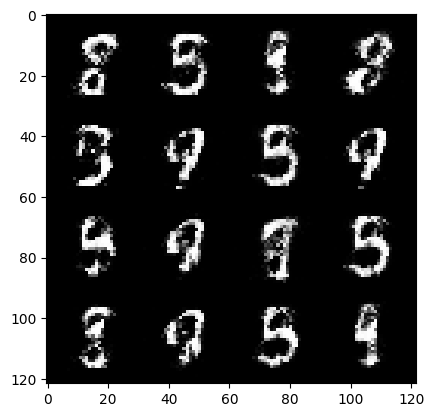

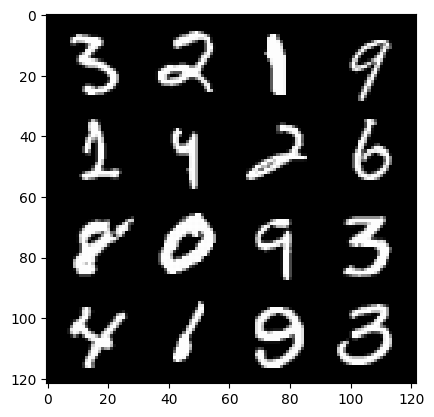

 87%|████████▋ | 408/469 [00:06<00:01, 55.43it/s]

58: step 27600 / Gen loss: 5.089260389010108 / disc_loss: 0.08061709118386107


 48%|████▊     | 224/469 [00:03<00:03, 69.59it/s]

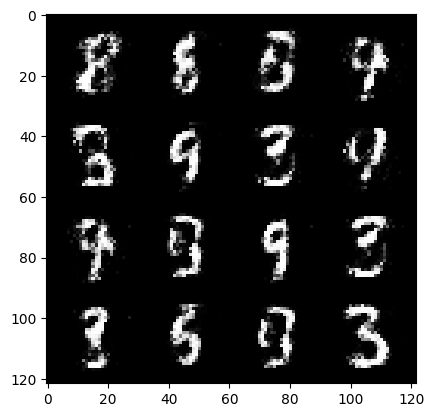

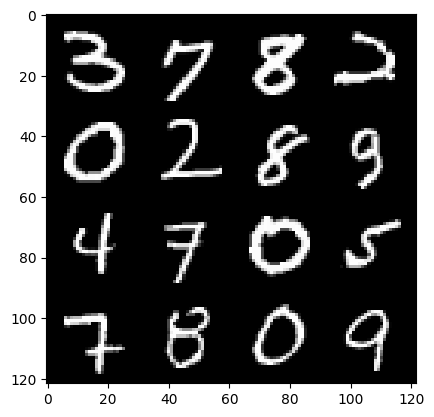

 51%|█████     | 239/469 [00:03<00:04, 54.75it/s]

59: step 27900 / Gen loss: 4.6900102066993705 / disc_loss: 0.09291340326269468


 12%|█▏        | 56/469 [00:00<00:05, 69.77it/s]

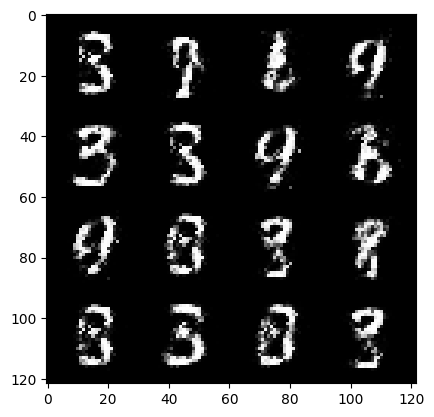

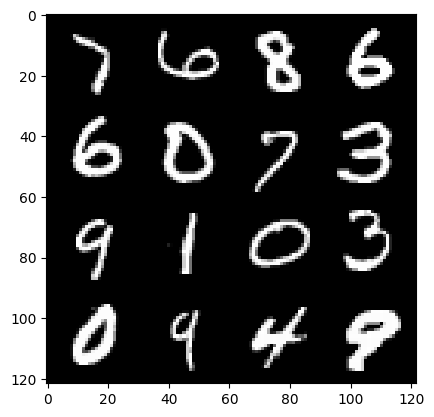

 15%|█▍        | 70/469 [00:01<00:07, 53.26it/s]

60: step 28200 / Gen loss: 4.384661562442779 / disc_loss: 0.09175283941129847


 77%|███████▋  | 360/469 [00:04<00:01, 75.92it/s]

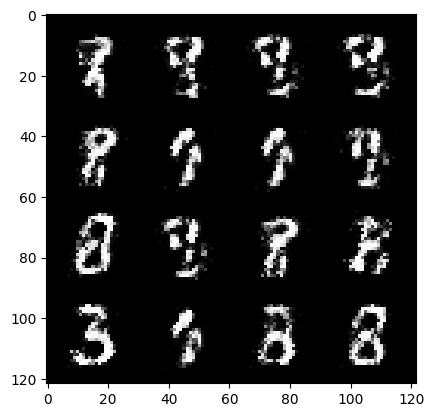

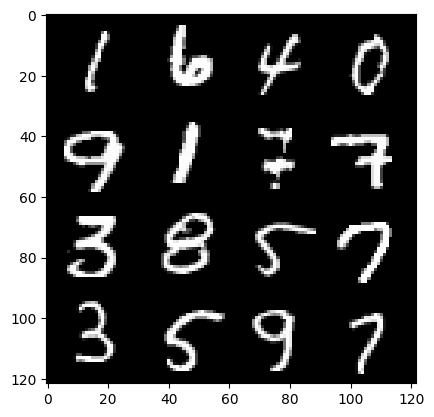

 80%|████████  | 376/469 [00:05<00:01, 58.75it/s]

60: step 28500 / Gen loss: 4.536635340054832 / disc_loss: 0.08052088048929973


 39%|███▉      | 184/469 [00:02<00:03, 75.33it/s]

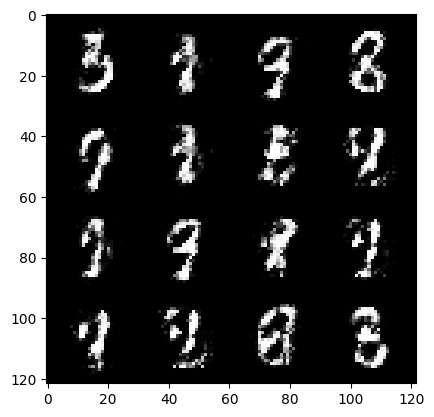

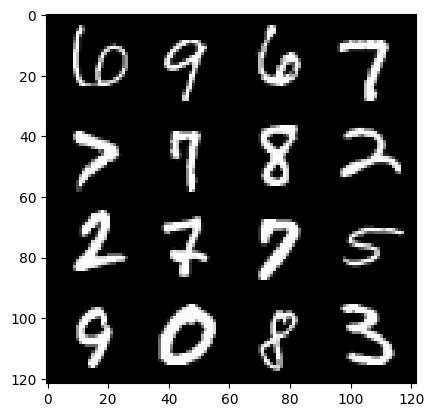

 42%|████▏     | 199/469 [00:02<00:04, 57.02it/s]

61: step 28800 / Gen loss: 4.557276806036637 / disc_loss: 0.07381461863095563


  3%|▎         | 16/469 [00:00<00:05, 78.38it/s]

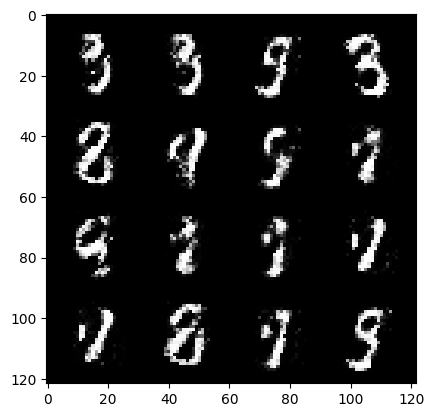

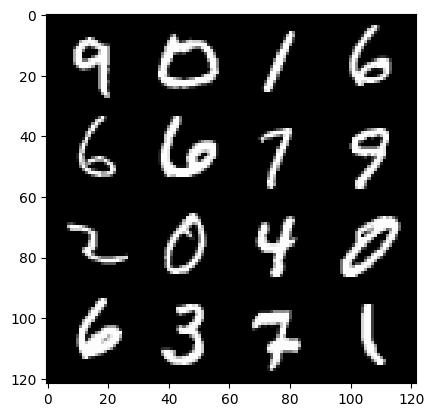

  7%|▋         | 31/469 [00:00<00:08, 52.43it/s]

62: step 29100 / Gen loss: 4.617437896728512 / disc_loss: 0.07771859038621183


 68%|██████▊   | 319/469 [00:04<00:02, 72.63it/s]

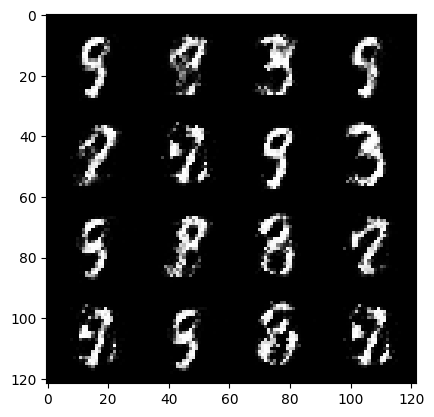

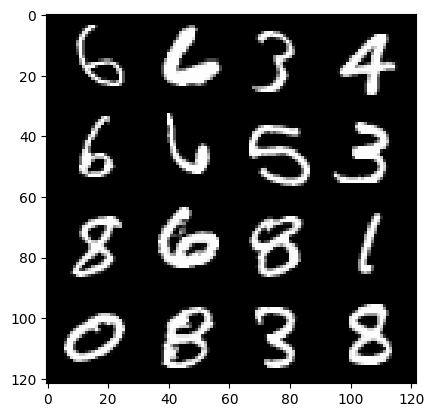

 71%|███████▏  | 335/469 [00:04<00:02, 56.92it/s]

62: step 29400 / Gen loss: 4.786975822448734 / disc_loss: 0.0678591580192248


 32%|███▏      | 152/469 [00:02<00:04, 76.77it/s]

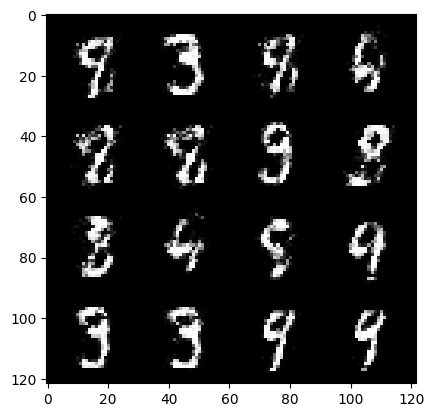

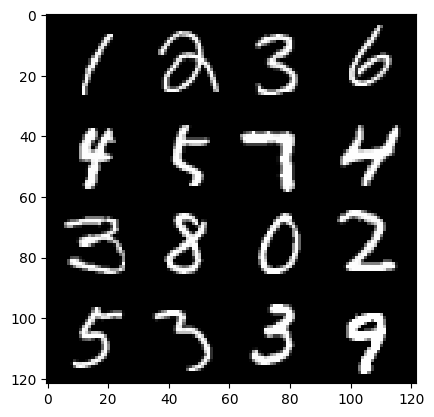

 36%|███▌      | 168/469 [00:02<00:05, 58.83it/s]

63: step 29700 / Gen loss: 4.8464742533365905 / disc_loss: 0.07769167557358748


 95%|█████████▌| 447/469 [00:06<00:00, 75.05it/s]

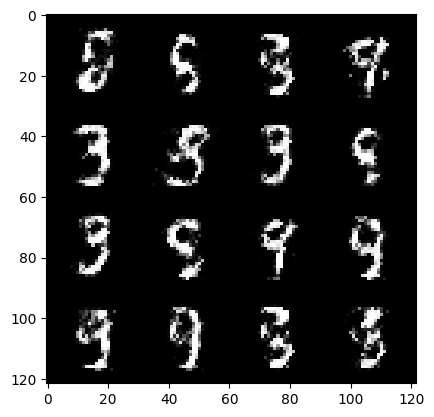

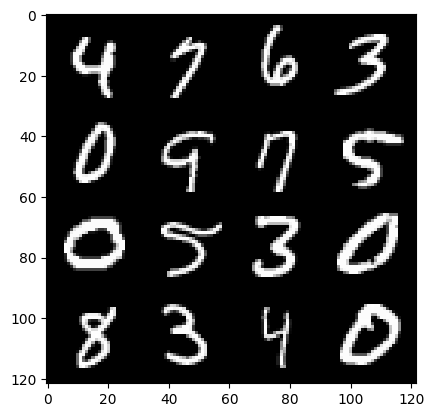

 99%|█████████▊| 462/469 [00:06<00:00, 56.27it/s]

63: step 30000 / Gen loss: 4.516352926095324 / disc_loss: 0.08488620646918811


 59%|█████▉    | 278/469 [00:03<00:02, 69.19it/s]

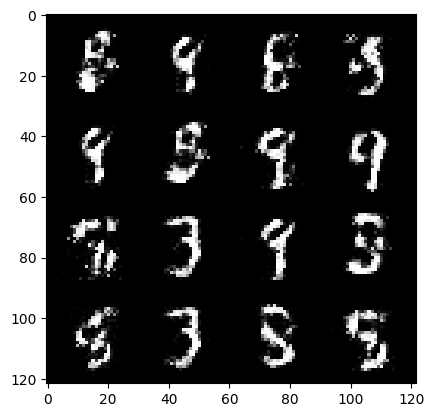

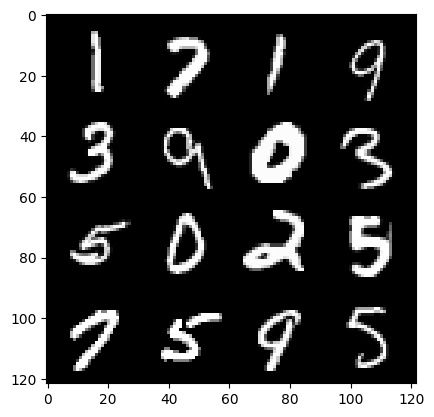

 62%|██████▏   | 292/469 [00:04<00:04, 43.40it/s]

64: step 30300 / Gen loss: 4.63901242256165 / disc_loss: 0.07001092616468671


 24%|██▍       | 112/469 [00:01<00:04, 75.01it/s]

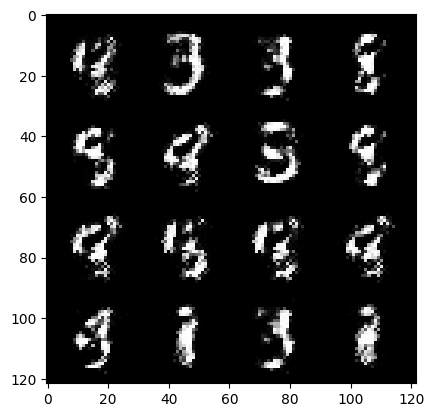

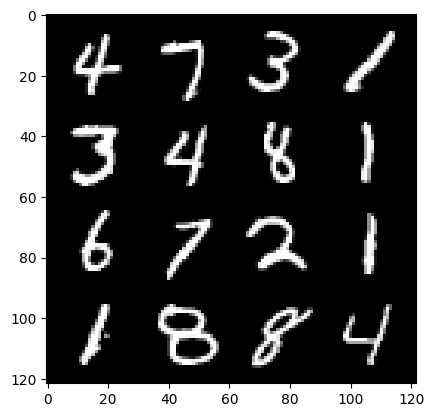

 27%|██▋       | 128/469 [00:01<00:05, 58.59it/s]

65: step 30600 / Gen loss: 4.882226045926415 / disc_loss: 0.07255624239643414


 87%|████████▋ | 409/469 [00:05<00:00, 76.98it/s]

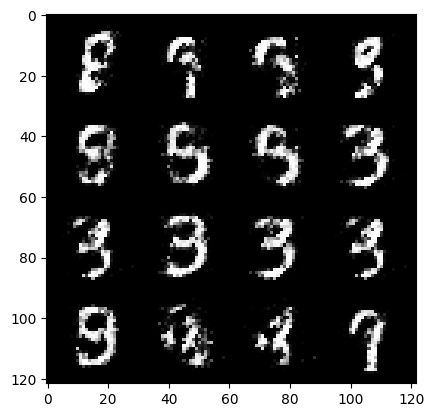

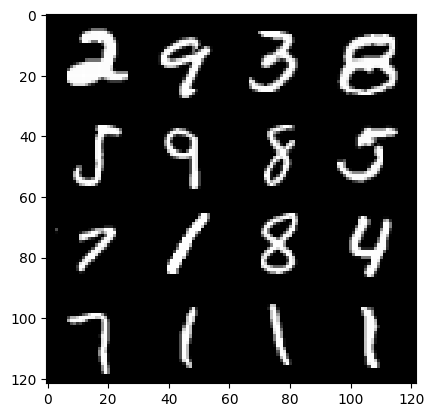

 90%|█████████ | 424/469 [00:06<00:00, 50.30it/s]

65: step 30900 / Gen loss: 4.549128704865775 / disc_loss: 0.09340659925714132


 51%|█████▏    | 241/469 [00:04<00:04, 56.07it/s]

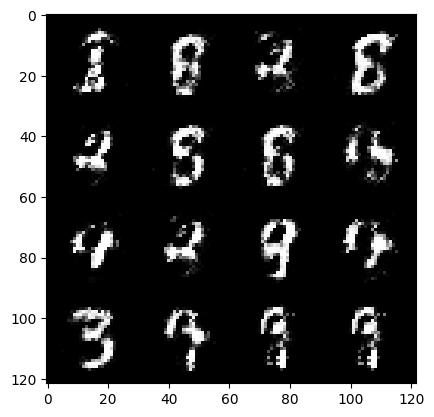

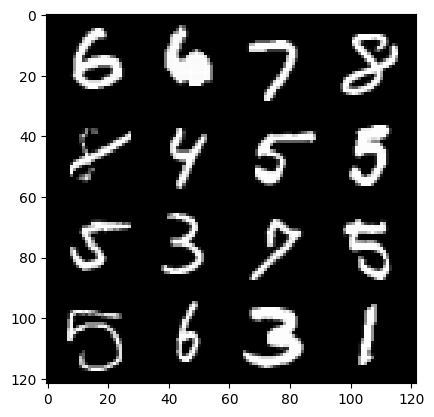

 54%|█████▎    | 252/469 [00:04<00:05, 39.52it/s]

66: step 31200 / Gen loss: 4.5128964519500725 / disc_loss: 0.0868547197679679


 16%|█▌        | 75/469 [00:01<00:06, 58.84it/s]

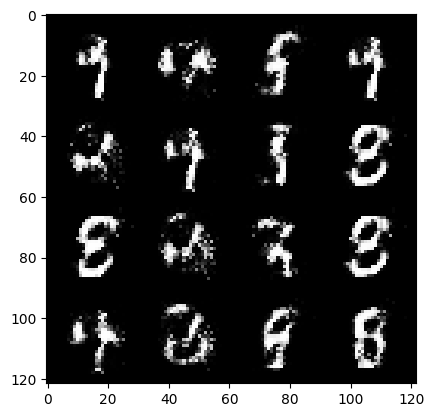

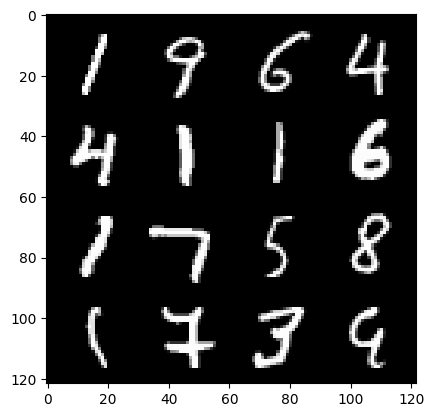

 18%|█▊        | 86/469 [00:01<00:09, 41.63it/s]

67: step 31500 / Gen loss: 4.800204466183979 / disc_loss: 0.0822586974377433


 80%|███████▉  | 375/469 [00:06<00:01, 59.60it/s]

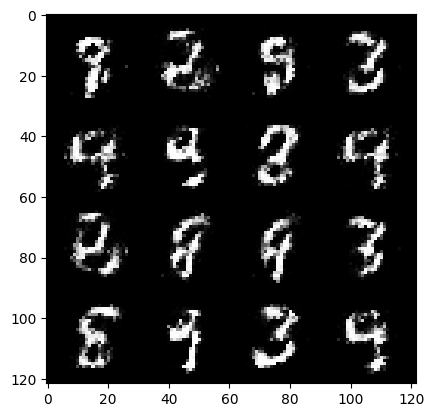

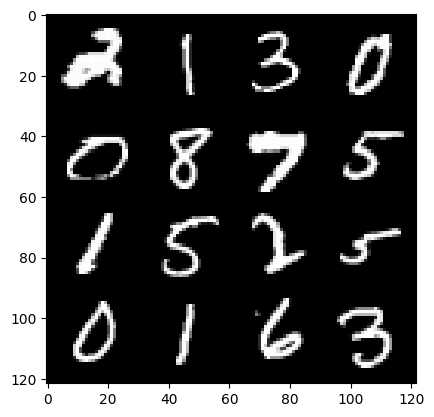

 82%|████████▏ | 386/469 [00:07<00:02, 36.80it/s]

67: step 31800 / Gen loss: 4.355500716368358 / disc_loss: 0.11007603568335374


 43%|████▎     | 204/469 [00:03<00:04, 61.87it/s]

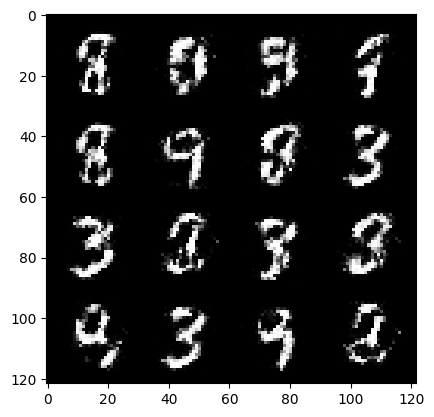

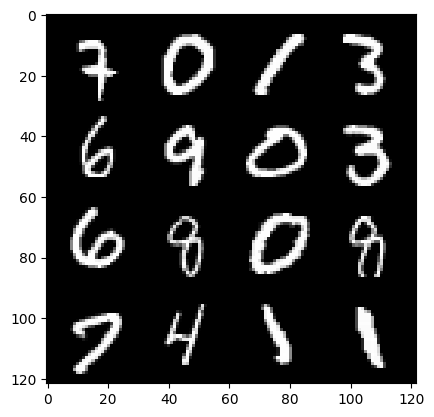

 46%|████▋     | 217/469 [00:03<00:05, 43.30it/s]

68: step 32100 / Gen loss: 4.418153119087217 / disc_loss: 0.08481322010979055


  8%|▊         | 39/469 [00:00<00:06, 66.72it/s]

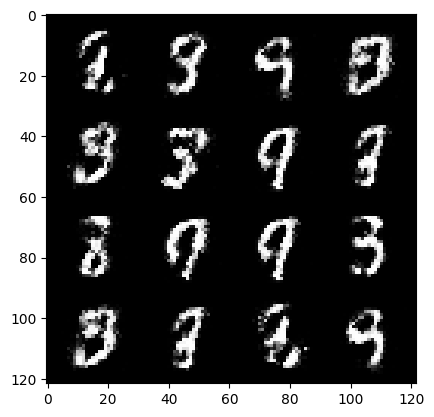

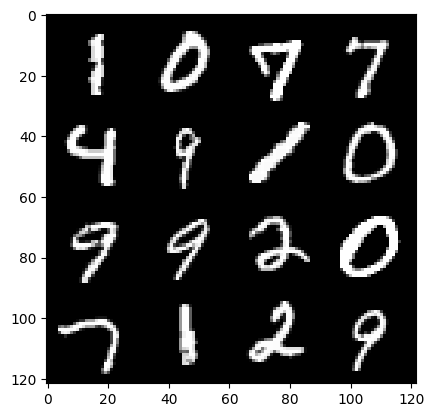

 10%|▉         | 46/469 [00:00<00:10, 40.08it/s]

69: step 32400 / Gen loss: 4.695954201221468 / disc_loss: 0.08046196349586042


 72%|███████▏  | 337/469 [00:05<00:02, 57.14it/s]

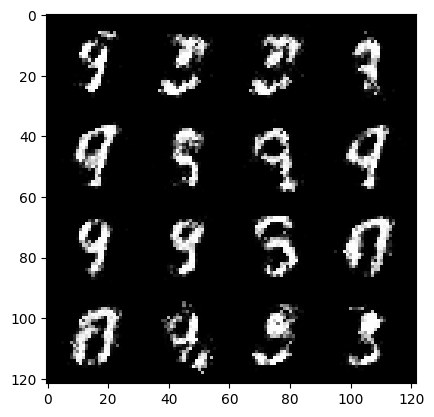

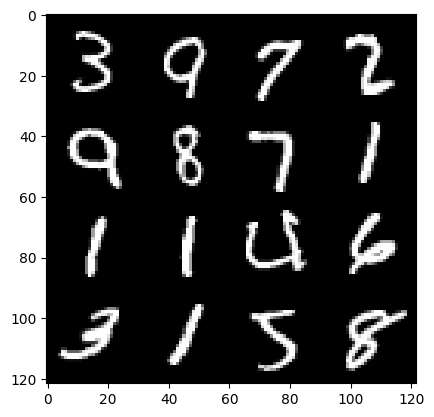

 74%|███████▍  | 348/469 [00:06<00:03, 36.85it/s]

69: step 32700 / Gen loss: 4.282512644926708 / disc_loss: 0.10209659251073988


 36%|███▌      | 167/469 [00:02<00:04, 62.55it/s]

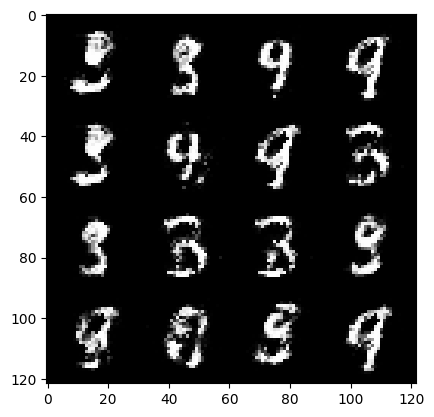

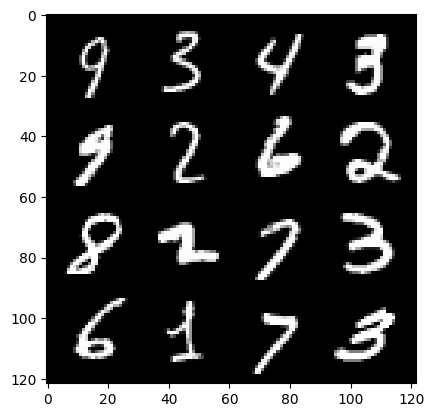

 38%|███▊      | 180/469 [00:03<00:07, 41.14it/s]

70: step 33000 / Gen loss: 4.410864389737445 / disc_loss: 0.10091969719777504


  0%|          | 0/469 [00:00<?, ?it/s]

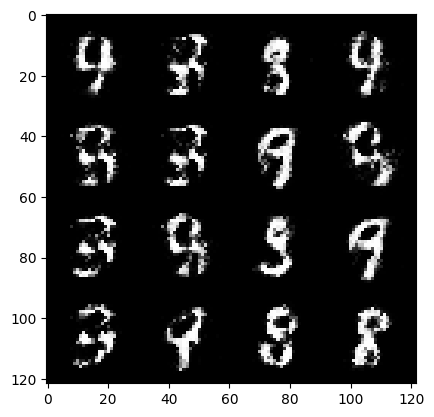

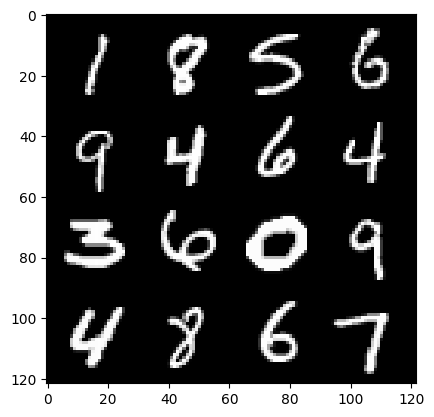

  2%|▏         | 9/469 [00:00<00:15, 29.44it/s]

71: step 33300 / Gen loss: 4.227167037328084 / disc_loss: 0.09473824360718329


 64%|██████▍   | 301/469 [00:05<00:02, 61.82it/s]

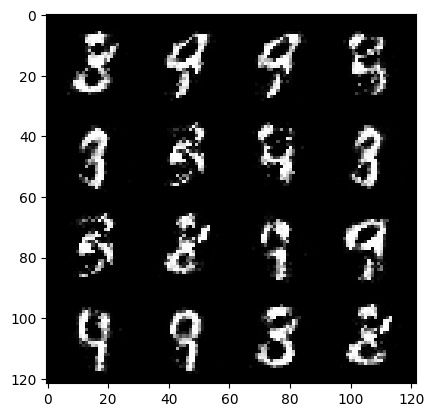

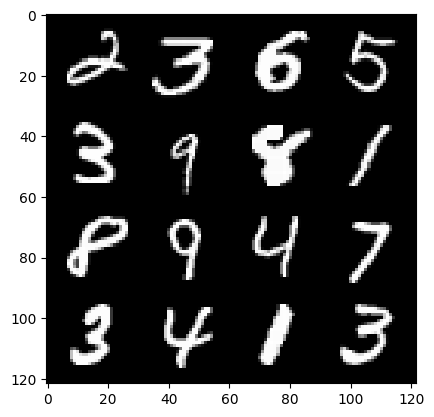

 66%|██████▌   | 308/469 [00:05<00:03, 40.69it/s]

71: step 33600 / Gen loss: 4.338307847976686 / disc_loss: 0.09221941886469724


 28%|██▊       | 132/469 [00:02<00:06, 54.83it/s]

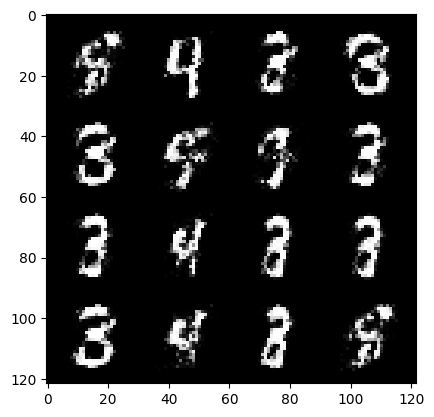

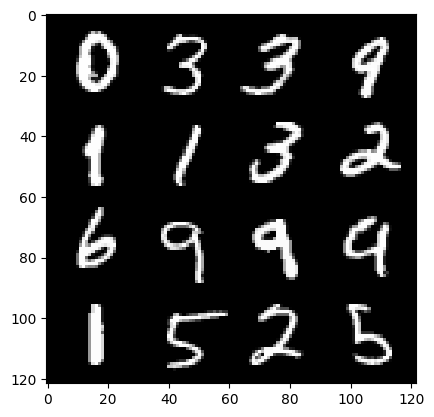

 29%|██▉       | 138/469 [00:02<00:10, 32.99it/s]

72: step 33900 / Gen loss: 4.374144539833067 / disc_loss: 0.11062831416726117


 91%|█████████ | 427/469 [00:07<00:00, 54.46it/s]

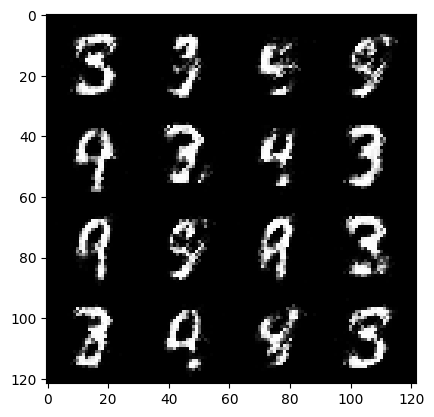

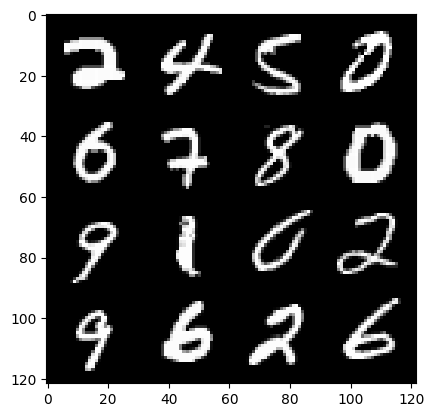

 94%|█████████▍| 443/469 [00:07<00:00, 42.65it/s]

72: step 34200 / Gen loss: 4.496643979549407 / disc_loss: 0.10097667797779049


 55%|█████▌    | 260/469 [00:04<00:03, 62.46it/s]

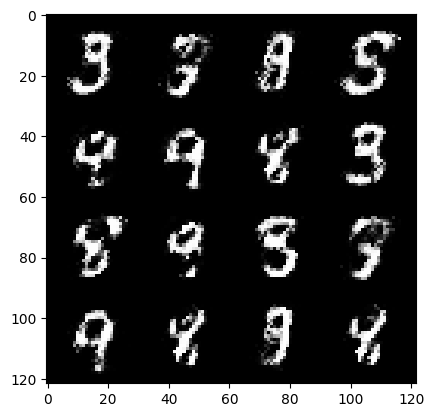

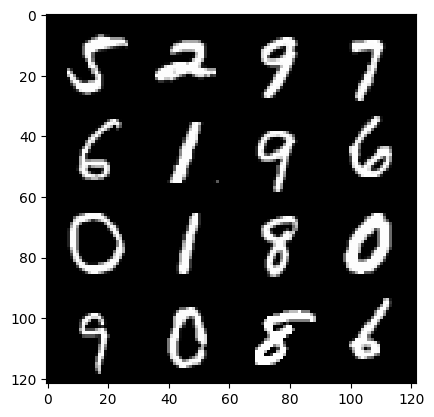

 58%|█████▊    | 273/469 [00:04<00:05, 38.77it/s]

73: step 34500 / Gen loss: 4.385477191607156 / disc_loss: 0.09560853326072302


 19%|█▉        | 91/469 [00:01<00:06, 59.50it/s]

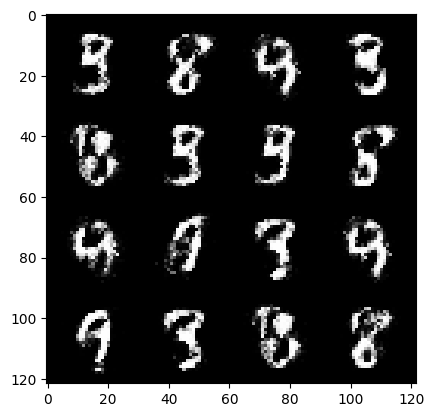

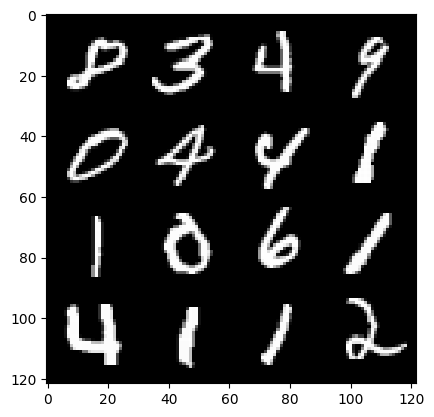

 22%|██▏       | 104/469 [00:01<00:08, 41.78it/s]

74: step 34800 / Gen loss: 4.131509860356649 / disc_loss: 0.10391996204853057


 84%|████████▍ | 393/469 [00:06<00:01, 55.41it/s]

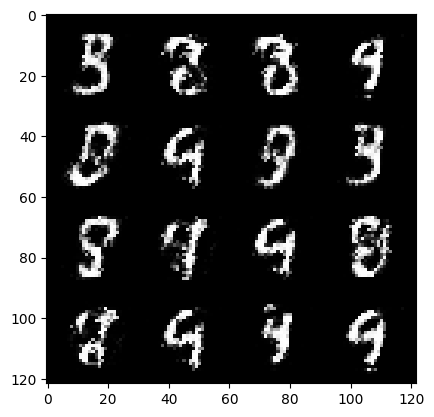

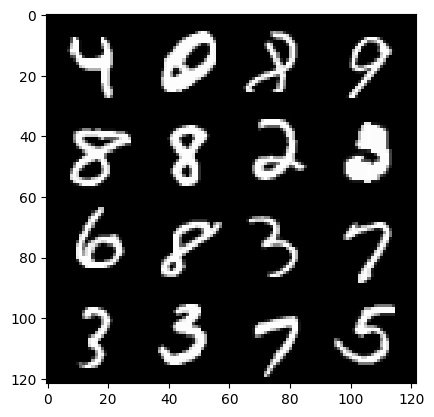

 85%|████████▌ | 399/469 [00:07<00:02, 33.97it/s]

74: step 35100 / Gen loss: 4.271758478482567 / disc_loss: 0.09505379039794204


 47%|████▋     | 219/469 [00:03<00:04, 61.61it/s]

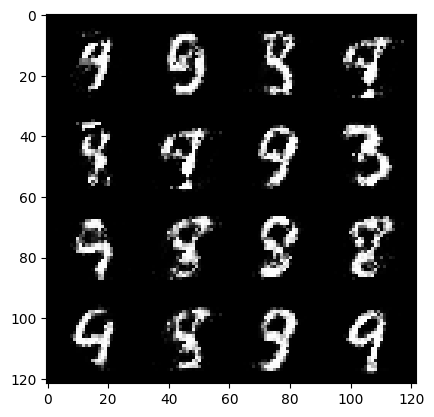

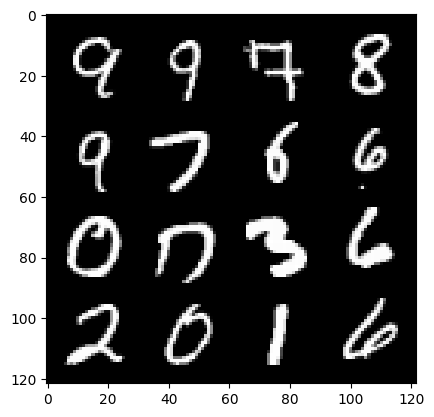

 49%|████▉     | 232/469 [00:04<00:05, 41.26it/s]

75: step 35400 / Gen loss: 4.506409742832184 / disc_loss: 0.08281893437728287


 11%|█         | 51/469 [00:00<00:07, 55.15it/s]

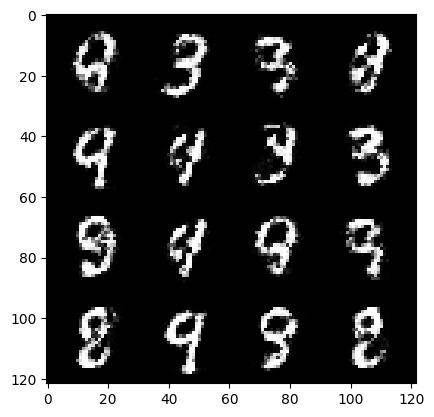

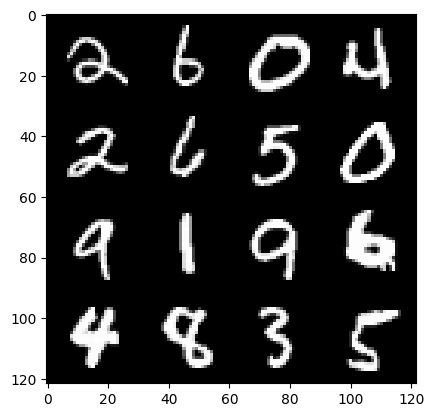

 13%|█▎        | 62/469 [00:01<00:11, 33.96it/s]

76: step 35700 / Gen loss: 4.322525589466094 / disc_loss: 0.10637596938759084


 75%|███████▌  | 354/469 [00:06<00:01, 63.57it/s]

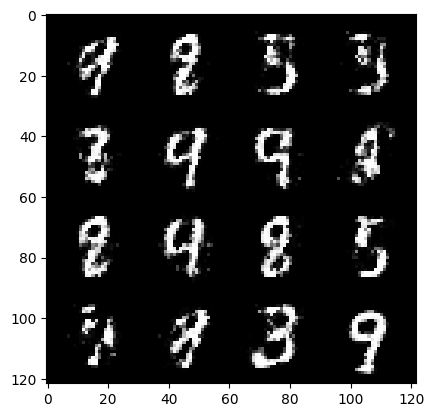

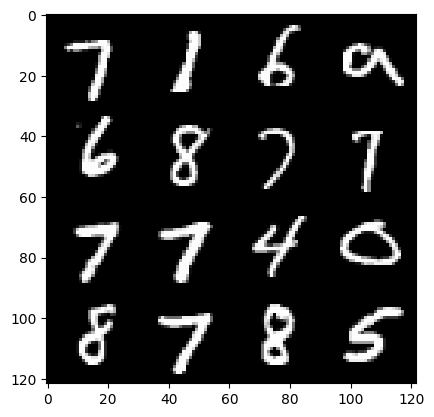

 78%|███████▊  | 367/469 [00:06<00:02, 44.28it/s]

76: step 36000 / Gen loss: 3.9738977964719147 / disc_loss: 0.12110658373683698


 39%|███▉      | 183/469 [00:03<00:05, 51.80it/s]

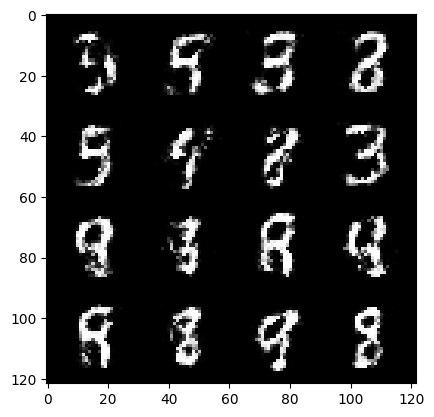

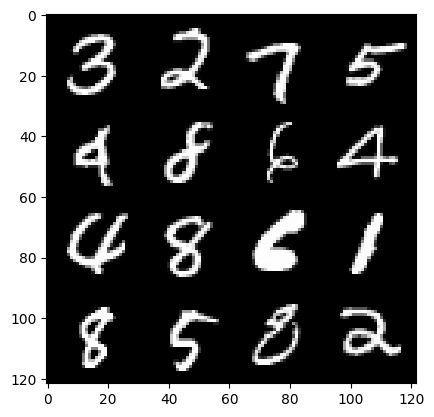

 41%|████▏     | 194/469 [00:03<00:07, 35.58it/s]

77: step 36300 / Gen loss: 4.1347825455665586 / disc_loss: 0.11545436701426902


  3%|▎         | 14/469 [00:00<00:08, 55.98it/s]

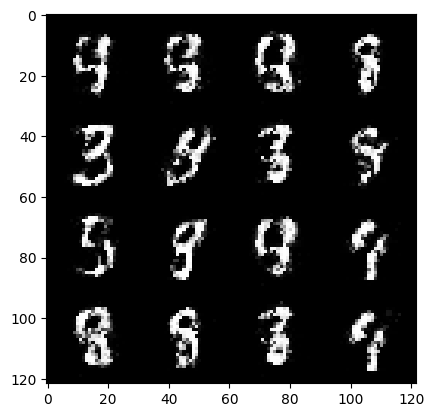

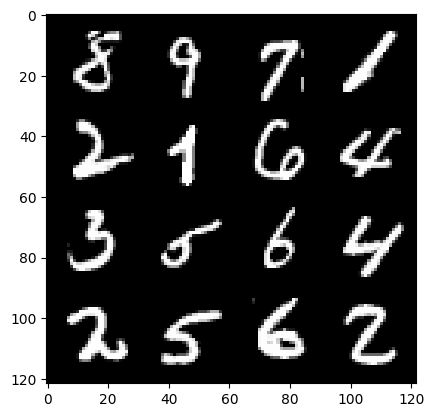

  5%|▌         | 24/469 [00:00<00:13, 31.93it/s]

78: step 36600 / Gen loss: 3.949060009320575 / disc_loss: 0.12607620112597945


 67%|██████▋   | 314/469 [00:05<00:02, 56.42it/s]

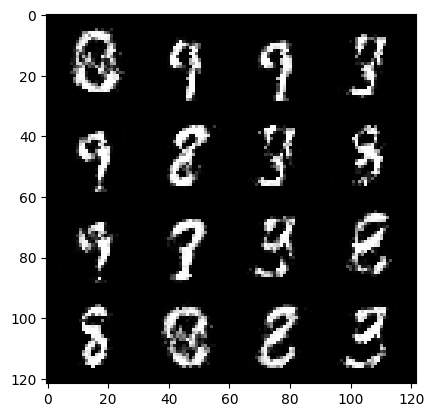

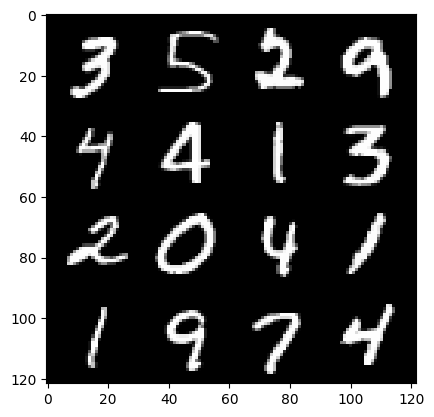

 69%|██████▉   | 325/469 [00:06<00:03, 36.31it/s]

78: step 36900 / Gen loss: 4.061049475669858 / disc_loss: 0.10777118284255272


 32%|███▏      | 148/469 [00:02<00:05, 60.96it/s]

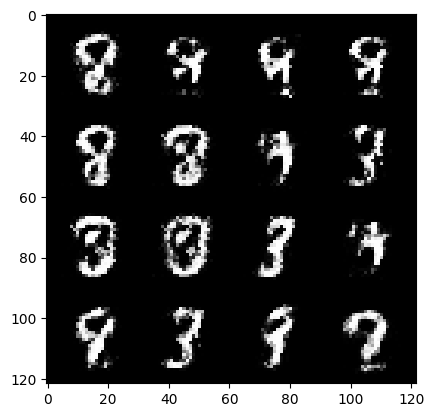

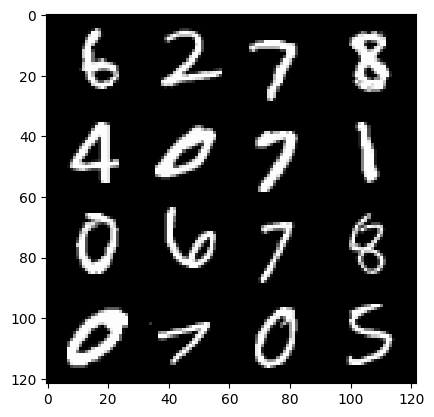

 33%|███▎      | 155/469 [00:02<00:08, 36.62it/s]

79: step 37200 / Gen loss: 3.973313963413238 / disc_loss: 0.13478727132081986


 95%|█████████▍| 444/469 [00:07<00:00, 60.82it/s]

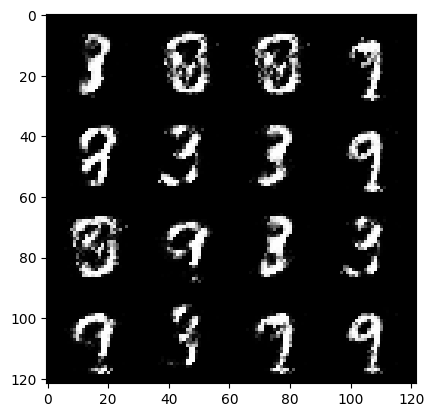

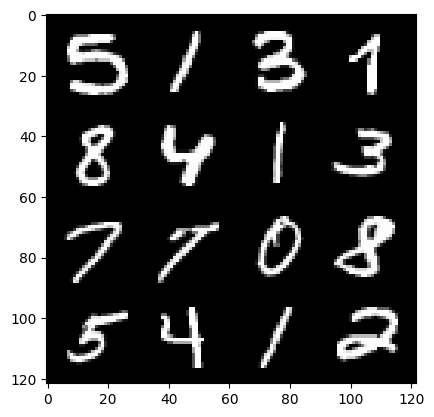

 97%|█████████▋| 456/469 [00:08<00:00, 37.65it/s]

79: step 37500 / Gen loss: 4.030458687146505 / disc_loss: 0.11354871145139143


 60%|█████▉    | 280/469 [00:04<00:02, 64.38it/s]

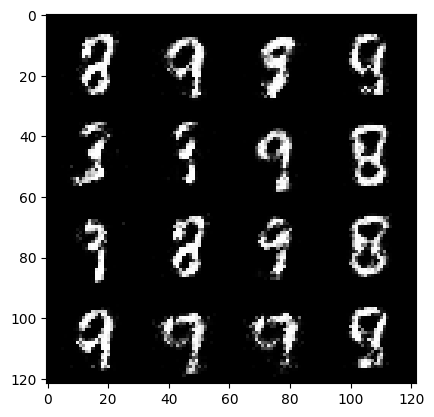

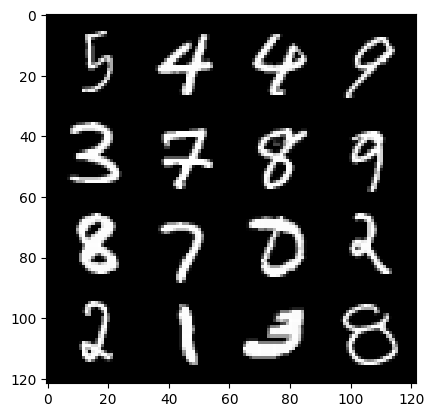

 61%|██████    | 287/469 [00:04<00:04, 38.32it/s]

80: step 37800 / Gen loss: 4.265185506343841 / disc_loss: 0.1001900054638584


 24%|██▎       | 111/469 [00:02<00:06, 53.28it/s]

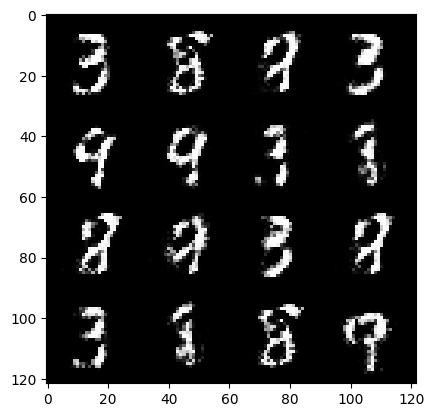

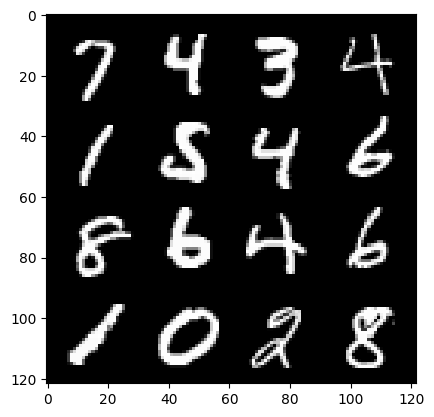

 25%|██▍       | 117/469 [00:02<00:09, 37.25it/s]

81: step 38100 / Gen loss: 4.05775721549988 / disc_loss: 0.11040743390719081


 87%|████████▋ | 408/469 [00:07<00:01, 56.14it/s]

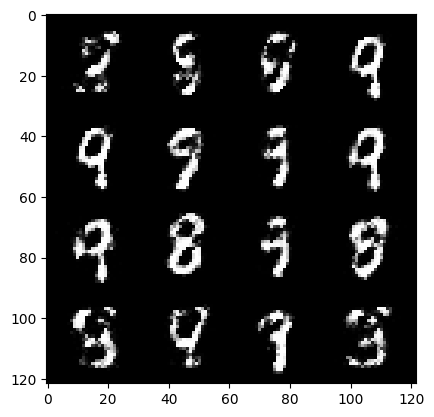

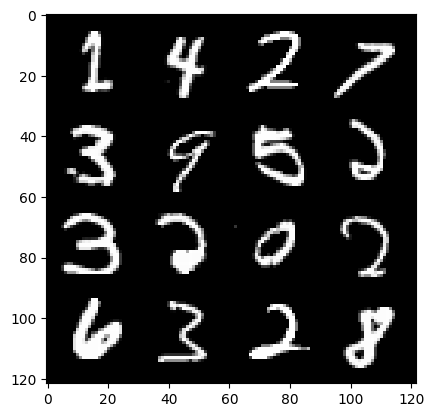

 89%|████████▉ | 419/469 [00:07<00:01, 36.56it/s]

81: step 38400 / Gen loss: 4.161199607054392 / disc_loss: 0.11489681512117382


 51%|█████     | 240/469 [00:04<00:03, 58.35it/s]

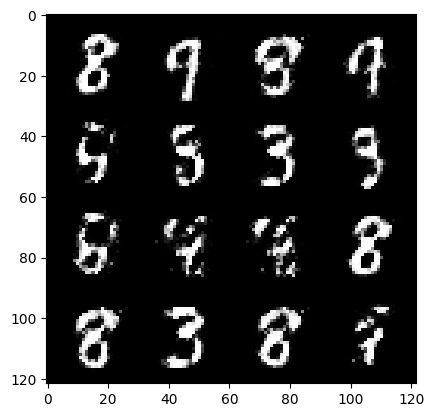

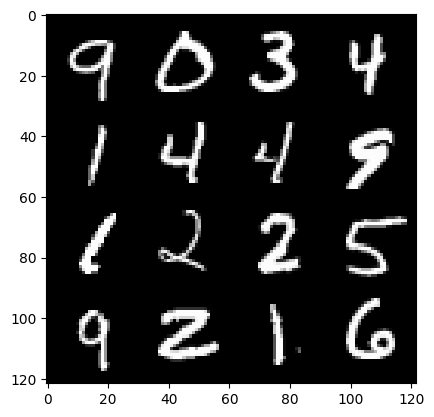

 53%|█████▎    | 247/469 [00:04<00:05, 40.55it/s]

82: step 38700 / Gen loss: 3.8559059317906677 / disc_loss: 0.13444506775587797


 16%|█▌        | 73/469 [00:01<00:06, 56.82it/s]

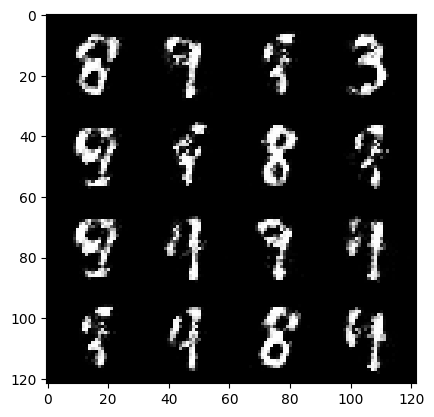

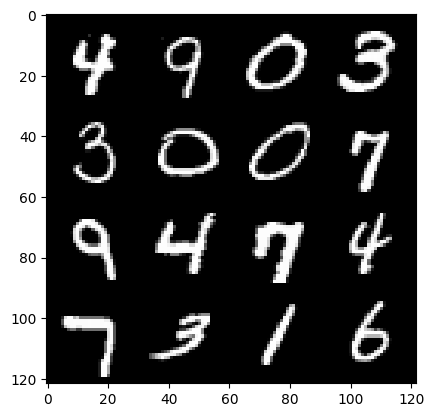

 17%|█▋        | 79/469 [00:01<00:10, 35.62it/s]

83: step 39000 / Gen loss: 3.809191087881722 / disc_loss: 0.12599659570803237


 79%|███████▊  | 369/469 [00:06<00:01, 51.55it/s]

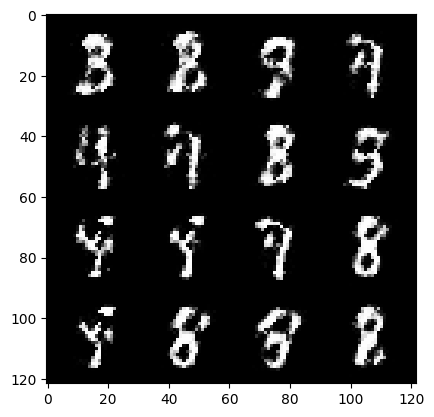

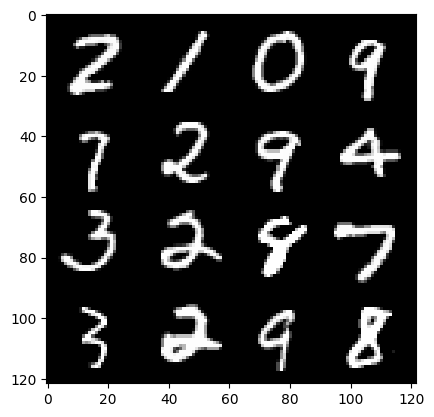

 81%|████████  | 380/469 [00:07<00:02, 38.18it/s]

83: step 39300 / Gen loss: 3.7847600793838505 / disc_loss: 0.128090238943696


 43%|████▎     | 204/469 [00:03<00:04, 63.73it/s]

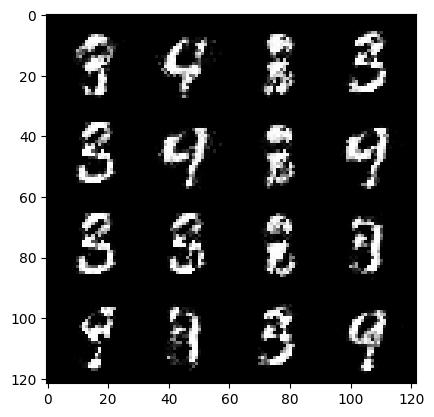

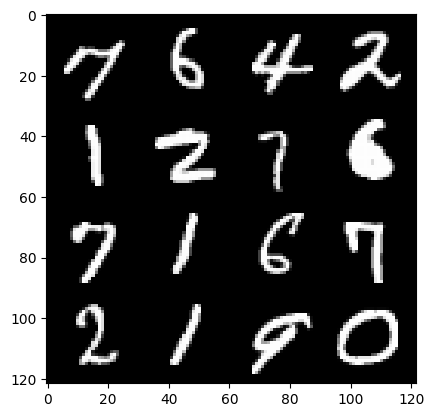

 45%|████▍     | 211/469 [00:03<00:06, 37.63it/s]

84: step 39600 / Gen loss: 3.8858549777666727 / disc_loss: 0.13316731043159963


  7%|▋         | 34/469 [00:00<00:06, 64.17it/s]

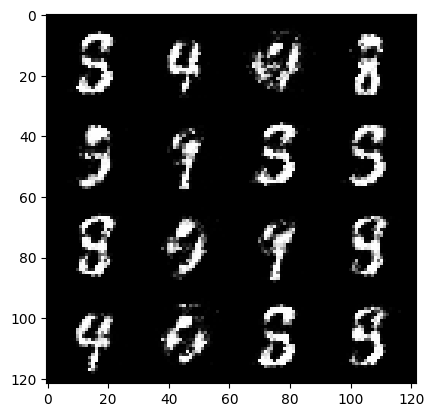

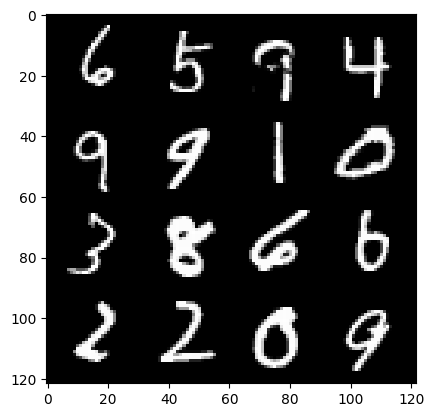

 10%|█         | 48/469 [00:01<00:09, 43.04it/s]

85: step 39900 / Gen loss: 3.778607181708019 / disc_loss: 0.13135496048877635


 71%|███████   | 331/469 [00:06<00:02, 53.68it/s]

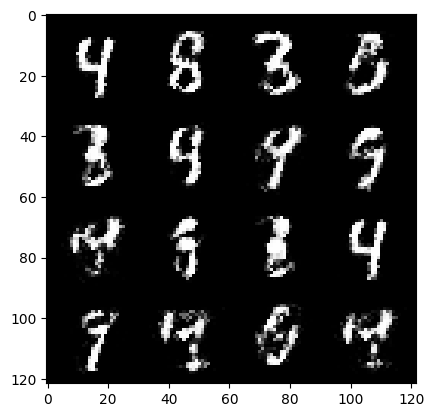

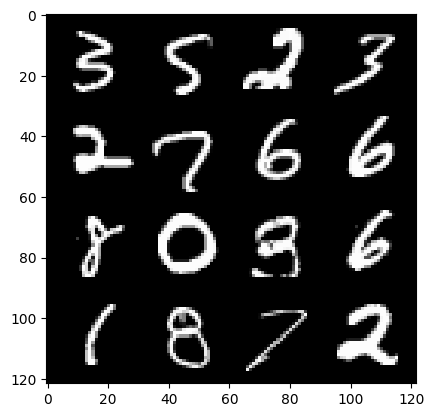

 73%|███████▎  | 342/469 [00:06<00:03, 36.98it/s]

85: step 40200 / Gen loss: 3.9300819555918376 / disc_loss: 0.13298964766164628


 35%|███▍      | 163/469 [00:02<00:05, 60.90it/s]

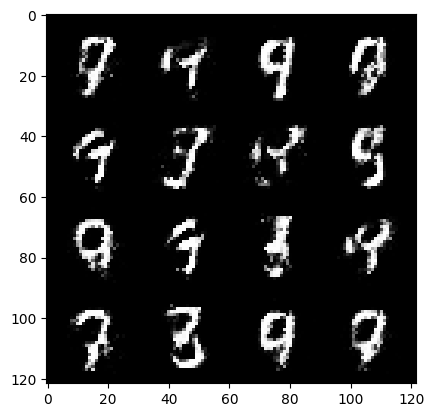

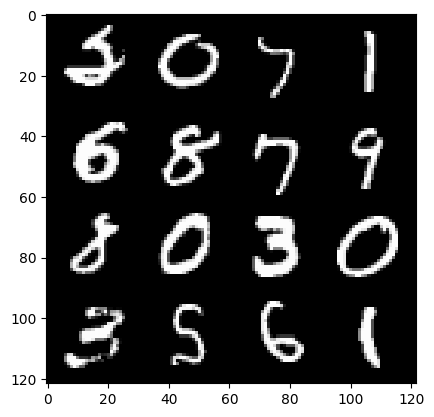

 38%|███▊      | 176/469 [00:03<00:06, 42.55it/s]

86: step 40500 / Gen loss: 3.713516035874688 / disc_loss: 0.1451902621984481


 99%|█████████▉| 465/469 [00:08<00:00, 57.87it/s]

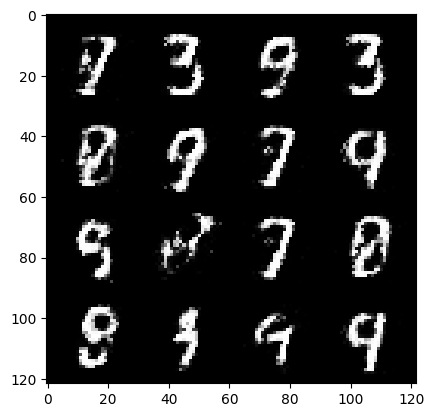

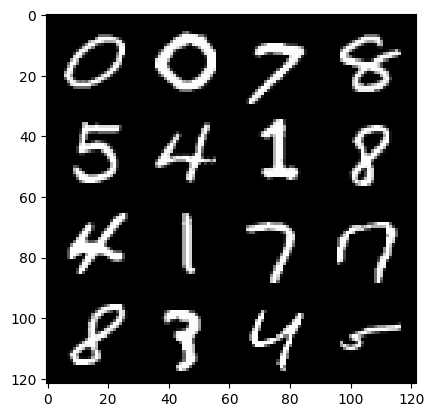

100%|██████████| 469/469 [00:08<00:00, 55.69it/s]


86: step 40800 / Gen loss: 3.9315383346875508 / disc_loss: 0.13483251705765723


 63%|██████▎   | 297/469 [00:05<00:02, 62.27it/s]

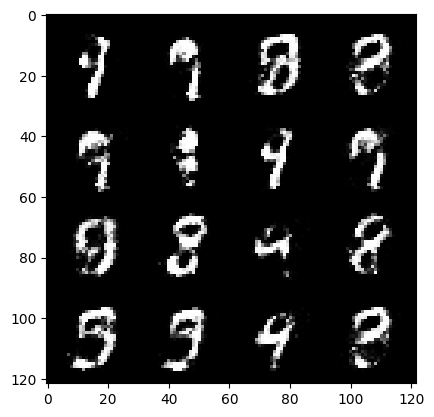

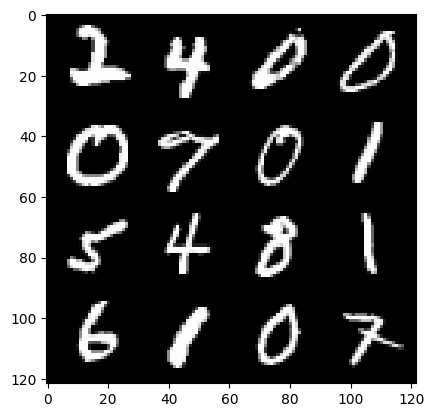

 65%|██████▍   | 304/469 [00:05<00:05, 30.72it/s]

87: step 41100 / Gen loss: 3.977180061340332 / disc_loss: 0.14116762513915693


 26%|██▌       | 122/469 [00:02<00:05, 62.33it/s]

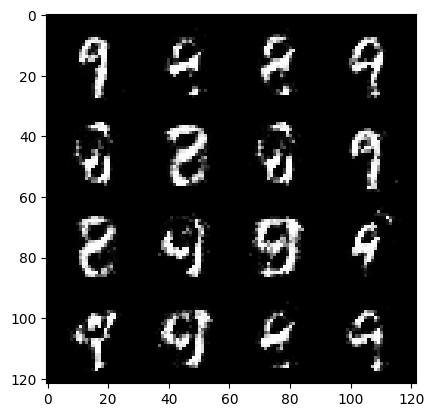

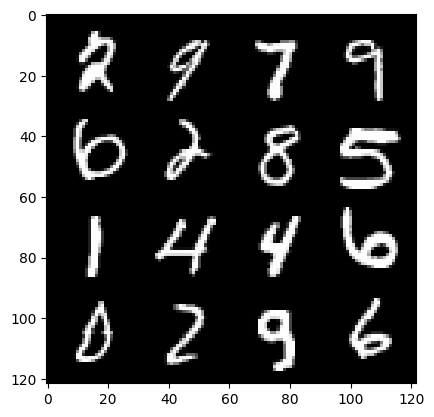

 29%|██▉       | 135/469 [00:02<00:08, 40.50it/s]

88: step 41400 / Gen loss: 3.6930621751149473 / disc_loss: 0.15241749259332796


 91%|█████████ | 426/469 [00:07<00:00, 57.56it/s]

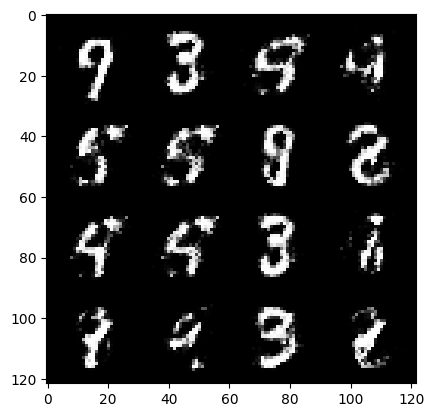

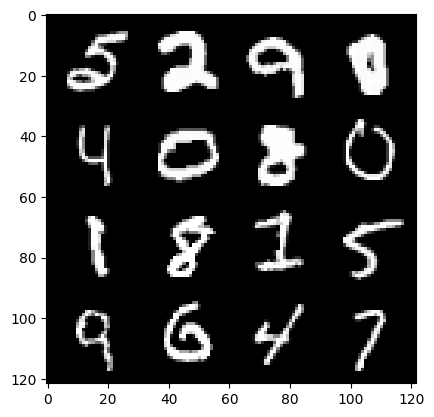

 93%|█████████▎| 437/469 [00:07<00:00, 39.74it/s]

88: step 41700 / Gen loss: 3.755255215168 / disc_loss: 0.1542503710587819


 55%|█████▍    | 256/469 [00:04<00:03, 65.20it/s]

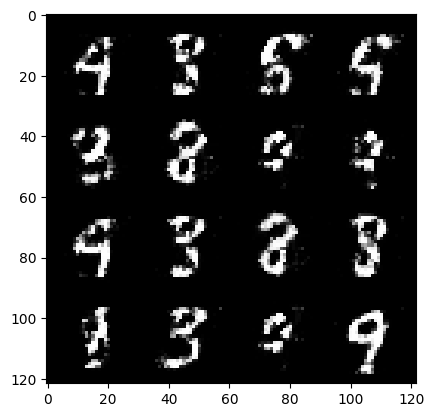

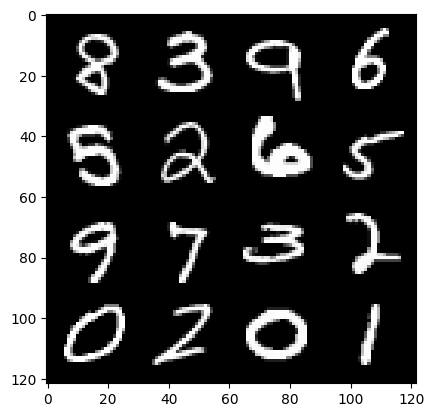

 57%|█████▋    | 269/469 [00:04<00:04, 45.68it/s]

89: step 42000 / Gen loss: 3.7971539950370783 / disc_loss: 0.12049752213060858


 19%|█▉        | 88/469 [00:01<00:06, 57.31it/s]

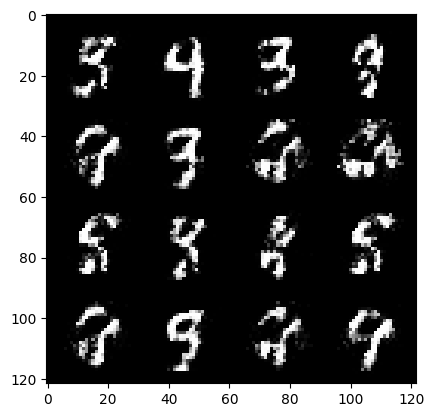

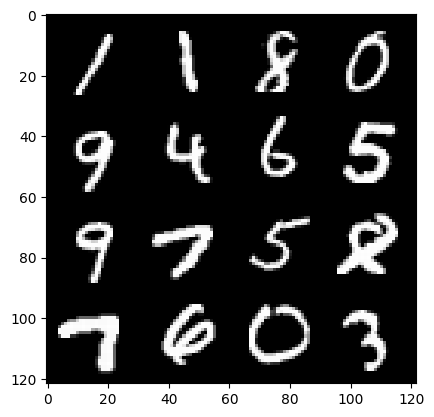

 21%|██▏       | 100/469 [00:01<00:09, 40.35it/s]

90: step 42300 / Gen loss: 3.9881481051445005 / disc_loss: 0.12041152156889438


 83%|████████▎ | 387/469 [00:06<00:01, 62.88it/s]

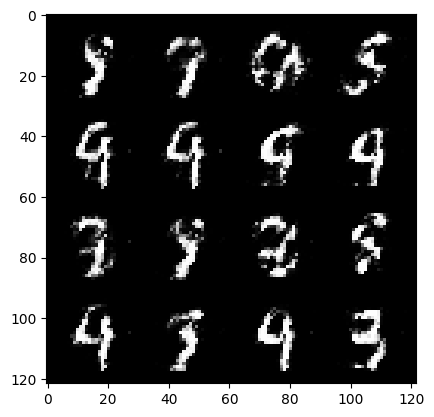

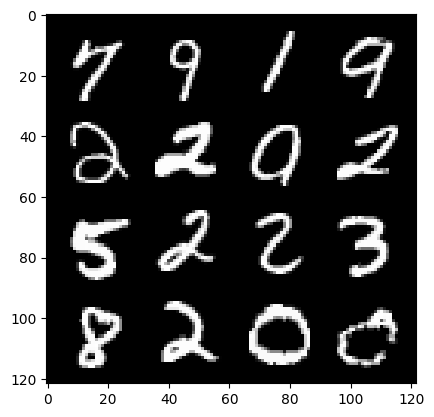

 85%|████████▌ | 400/469 [00:07<00:01, 40.95it/s]

90: step 42600 / Gen loss: 3.8150968599319453 / disc_loss: 0.11519273887077973


 46%|████▌     | 216/469 [00:03<00:04, 62.48it/s]

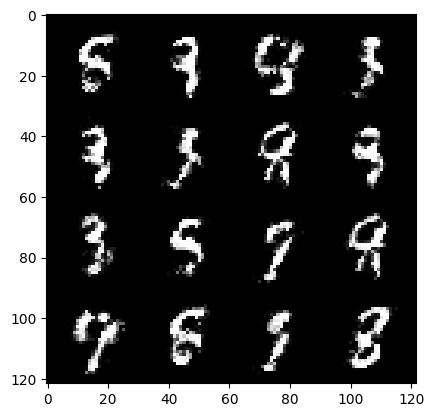

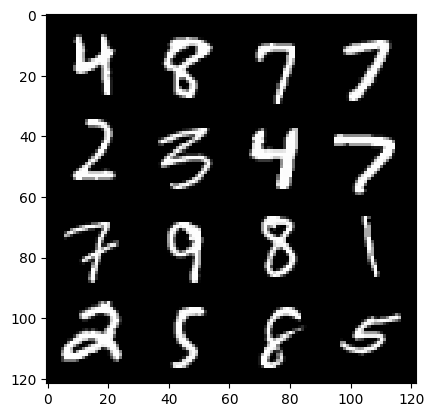

 49%|████▊     | 228/469 [00:04<00:06, 35.81it/s]

91: step 42900 / Gen loss: 3.6741471846898395 / disc_loss: 0.14062373942385117


 10%|█         | 49/469 [00:00<00:06, 62.35it/s]

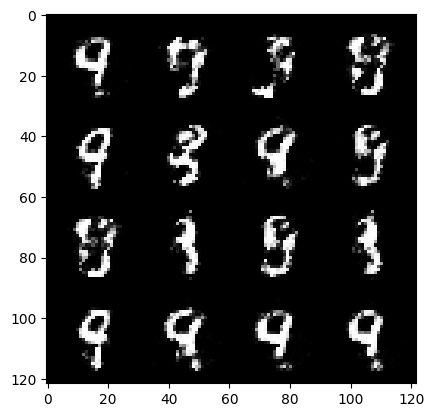

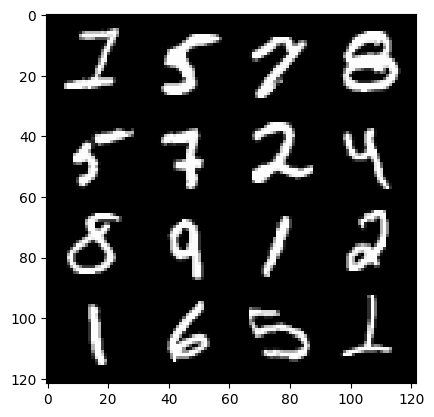

 12%|█▏        | 56/469 [00:01<00:10, 38.41it/s]

92: step 43200 / Gen loss: 3.633708889484405 / disc_loss: 0.14521823691825073


 75%|███████▌  | 352/469 [00:06<00:01, 66.07it/s]

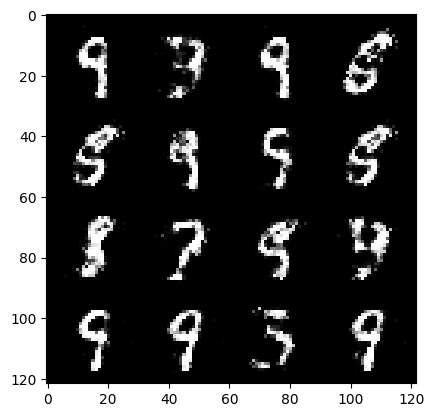

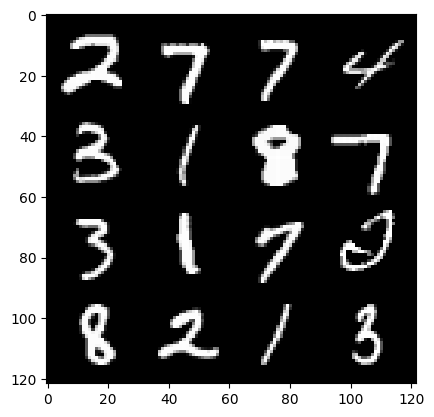

 77%|███████▋  | 359/469 [00:06<00:02, 43.60it/s]

92: step 43500 / Gen loss: 3.8042185290654493 / disc_loss: 0.1371869725733995


 39%|███▊      | 181/469 [00:02<00:04, 62.72it/s]

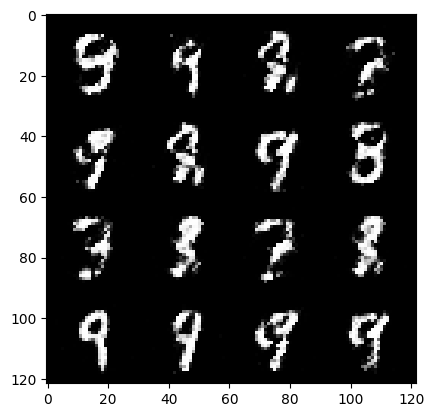

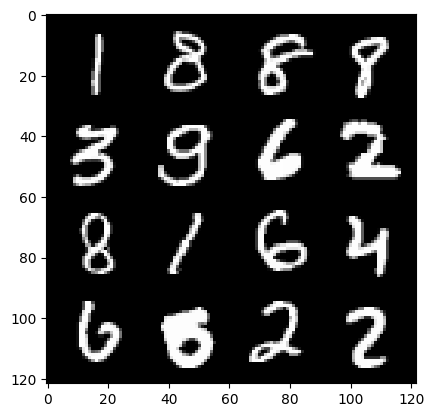

 40%|████      | 188/469 [00:03<00:07, 39.53it/s]

93: step 43800 / Gen loss: 3.6740396094322234 / disc_loss: 0.12821144793182618


  3%|▎         | 12/469 [00:00<00:08, 55.21it/s]

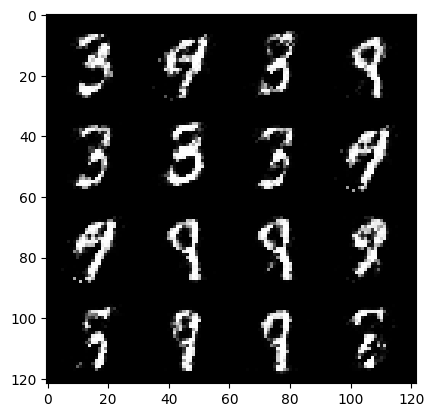

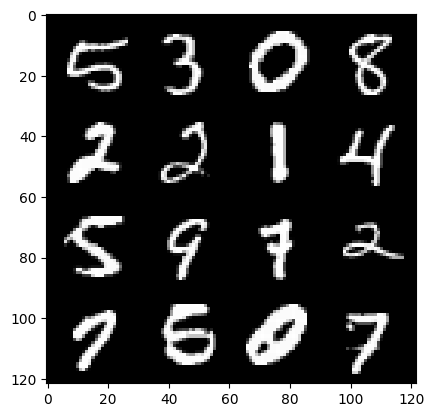

  5%|▍         | 23/469 [00:00<00:14, 30.66it/s]

94: step 44100 / Gen loss: 3.761100517114003 / disc_loss: 0.11496559565265968


 67%|██████▋   | 313/469 [00:05<00:02, 61.32it/s]

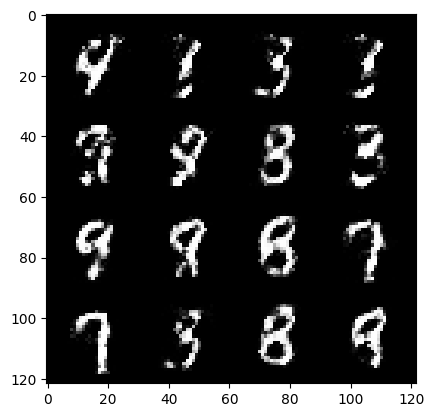

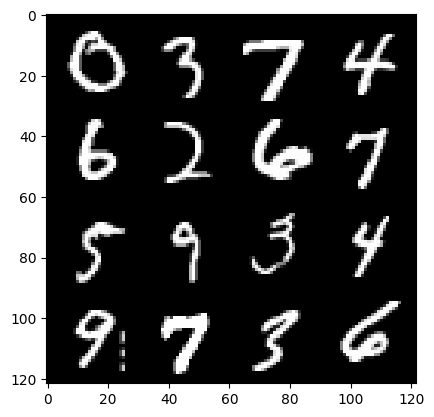

 68%|██████▊   | 320/469 [00:05<00:03, 41.36it/s]

94: step 44400 / Gen loss: 3.621259462038673 / disc_loss: 0.1460068391263485


 30%|███       | 142/469 [00:02<00:05, 60.13it/s]

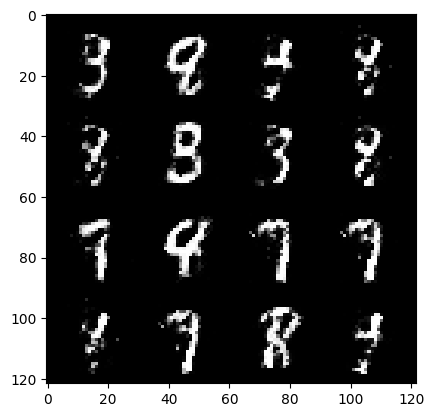

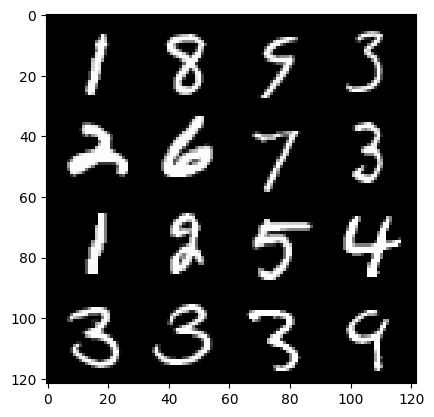

 33%|███▎      | 155/469 [00:02<00:07, 40.74it/s]

95: step 44700 / Gen loss: 3.6649599019686376 / disc_loss: 0.1228230308492979


 94%|█████████▍| 440/469 [00:07<00:00, 60.24it/s]

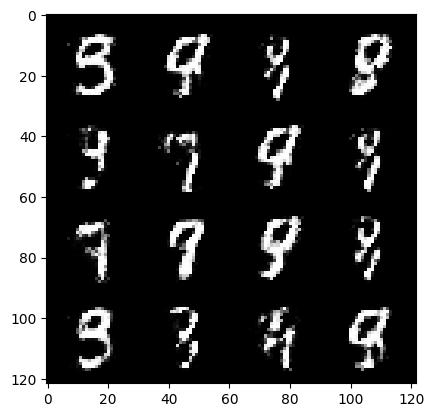

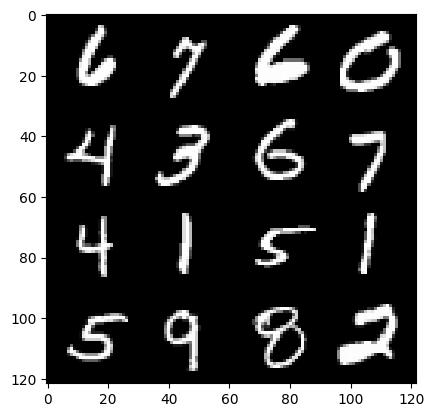

 96%|█████████▋| 452/469 [00:08<00:00, 41.44it/s]

95: step 45000 / Gen loss: 3.762484827836353 / disc_loss: 0.11902734986195954


 58%|█████▊    | 273/469 [00:04<00:03, 63.49it/s]

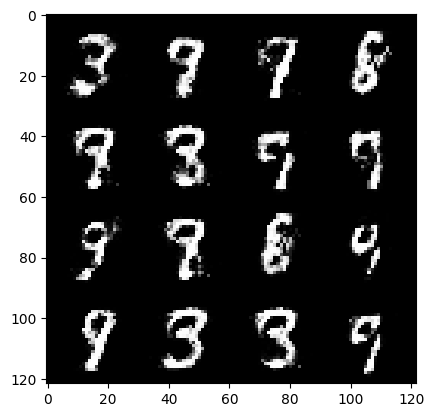

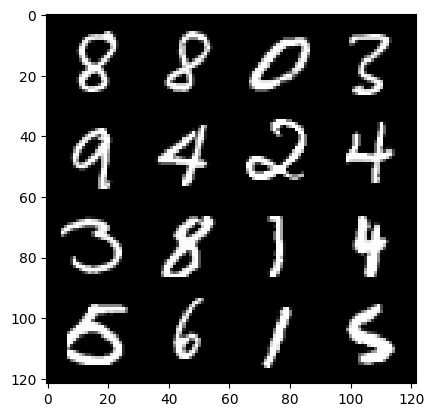

 61%|██████    | 286/469 [00:04<00:04, 41.00it/s]

96: step 45300 / Gen loss: 3.8539467271169023 / disc_loss: 0.12122607195128993


 22%|██▏       | 101/469 [00:01<00:05, 63.90it/s]

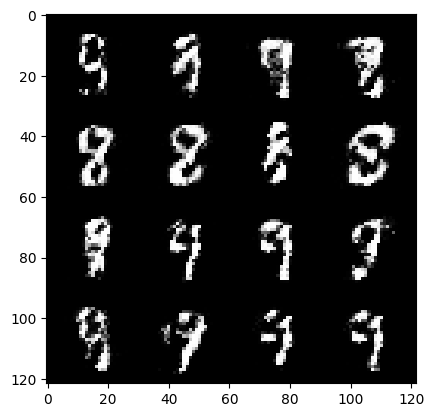

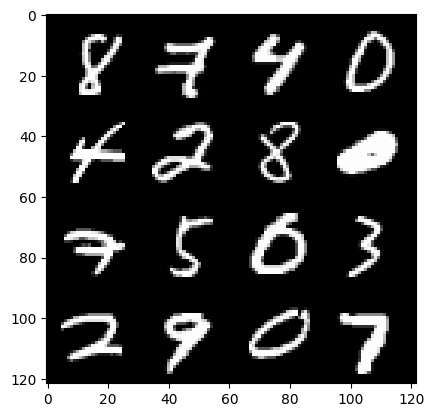

 24%|██▍       | 114/469 [00:01<00:08, 44.00it/s]

97: step 45600 / Gen loss: 3.5205471889177944 / disc_loss: 0.14241599269211286


 87%|████████▋ | 407/469 [00:06<00:01, 56.39it/s]

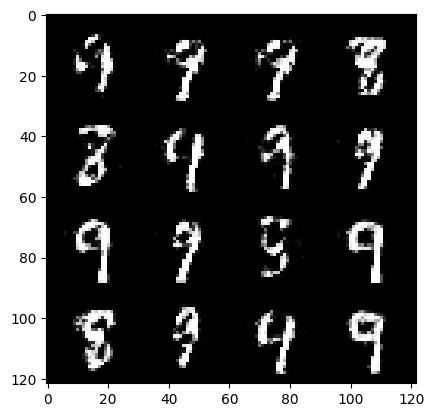

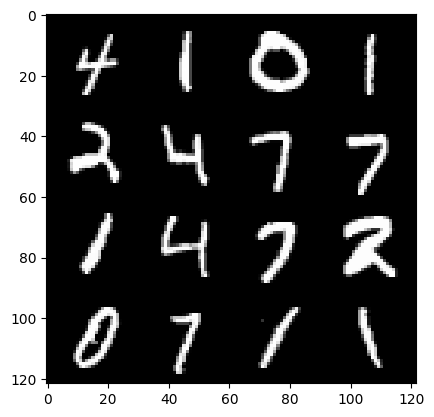

 89%|████████▉ | 418/469 [00:07<00:01, 40.23it/s]

97: step 45900 / Gen loss: 3.579414650599161 / disc_loss: 0.138900164179504


 50%|████▉     | 234/469 [00:03<00:03, 60.32it/s]

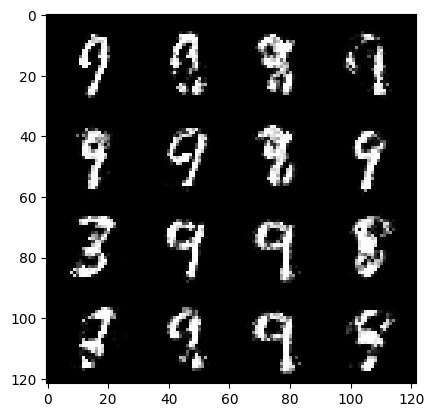

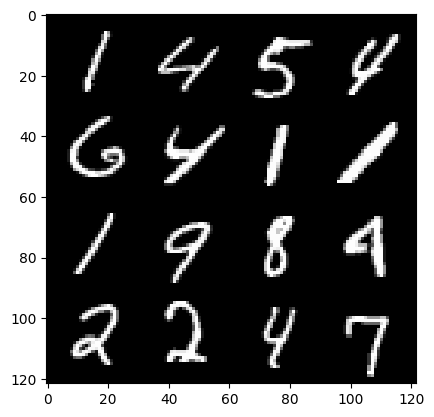

 52%|█████▏    | 246/469 [00:04<00:06, 36.31it/s]

98: step 46200 / Gen loss: 3.501570296287537 / disc_loss: 0.15670357597370937


 14%|█▍        | 67/469 [00:01<00:06, 60.33it/s]

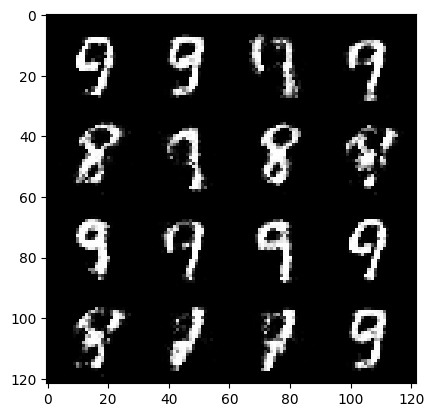

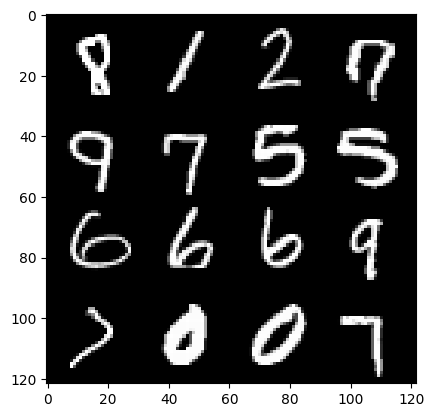

 16%|█▌        | 74/469 [00:01<00:10, 36.57it/s]

99: step 46500 / Gen loss: 3.619009002844493 / disc_loss: 0.1493688386927049


 79%|███████▊  | 369/469 [00:06<00:01, 61.24it/s]

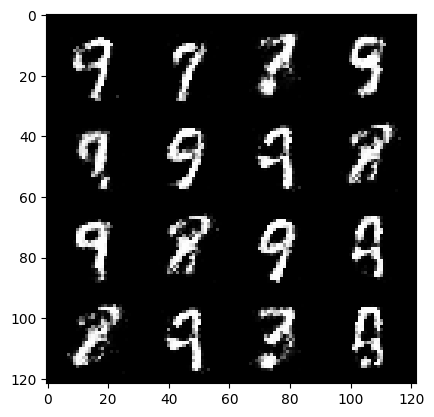

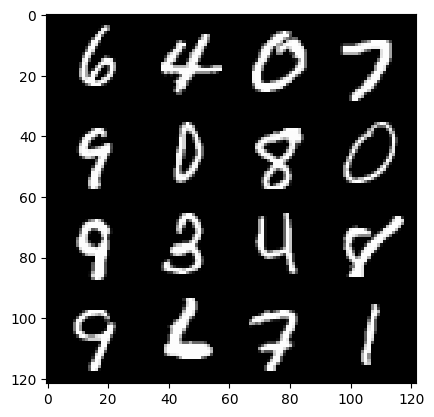

 80%|████████  | 376/469 [00:06<00:02, 35.00it/s]

99: step 46800 / Gen loss: 3.3616390792528774 / disc_loss: 0.15083220311750972


 43%|████▎     | 200/469 [00:03<00:04, 62.43it/s]

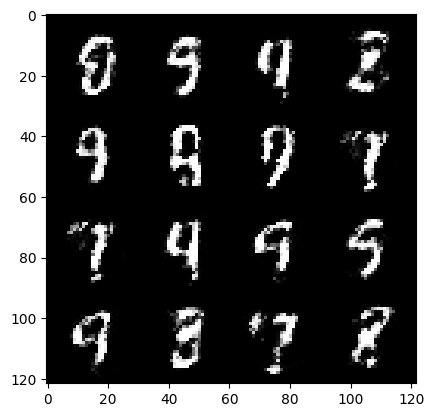

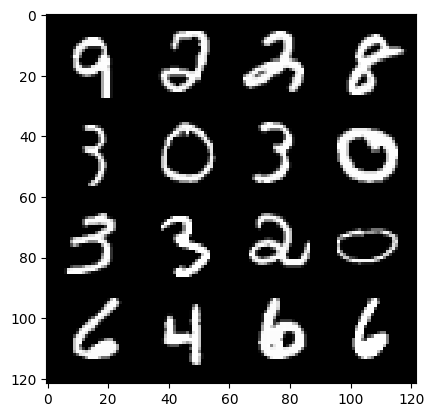

 44%|████▍     | 207/469 [00:03<00:07, 35.30it/s]

100: step 47100 / Gen loss: 3.4989790113767003 / disc_loss: 0.1343693272148569


  7%|▋         | 31/469 [00:00<00:09, 48.24it/s]

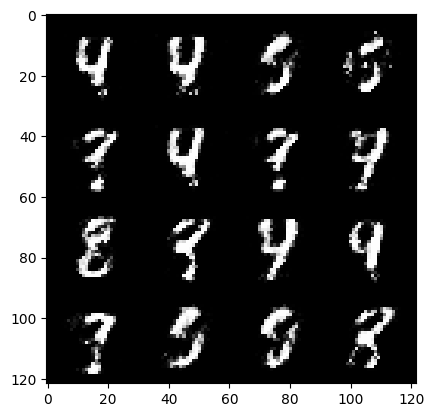

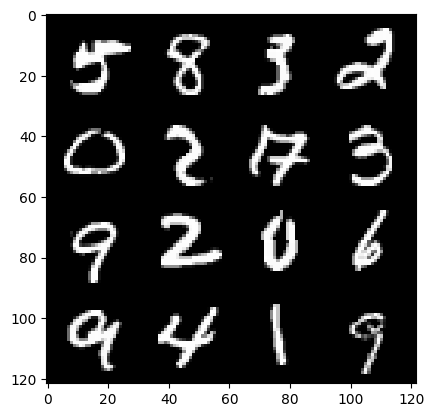

  9%|▉         | 42/469 [00:01<00:11, 37.32it/s]

101: step 47400 / Gen loss: 3.261453097661334 / disc_loss: 0.1694601575036844


 69%|██████▉   | 325/469 [00:05<00:02, 65.45it/s]

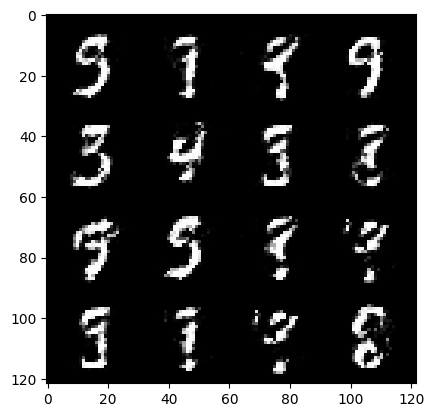

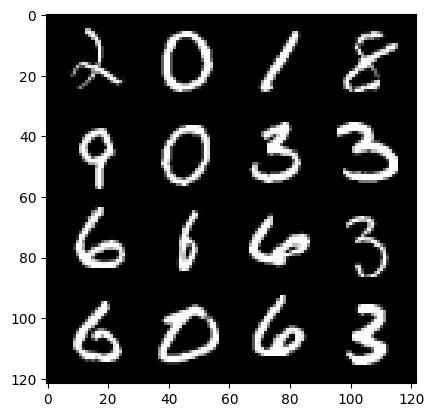

 72%|███████▏  | 338/469 [00:06<00:02, 44.17it/s]

101: step 47700 / Gen loss: 3.3949276645978306 / disc_loss: 0.13883878087004028


 35%|███▍      | 162/469 [00:03<00:05, 51.69it/s]

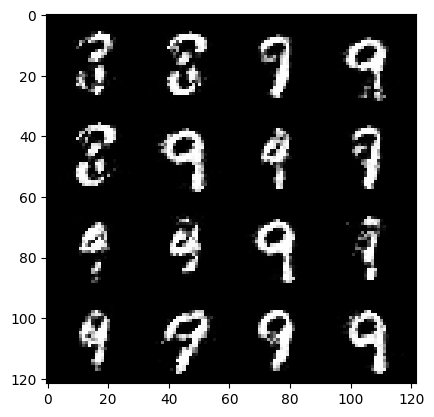

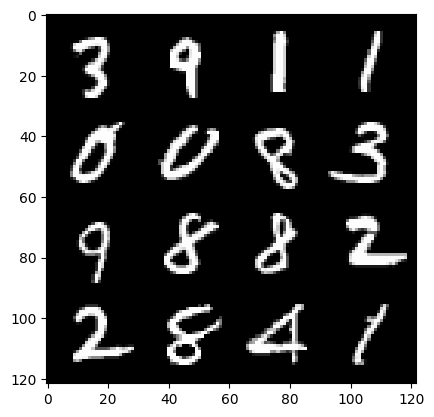

 36%|███▌      | 168/469 [00:03<00:09, 32.74it/s]

102: step 48000 / Gen loss: 3.4724621025721234 / disc_loss: 0.14733877462645364


 98%|█████████▊| 460/469 [00:08<00:00, 66.32it/s]

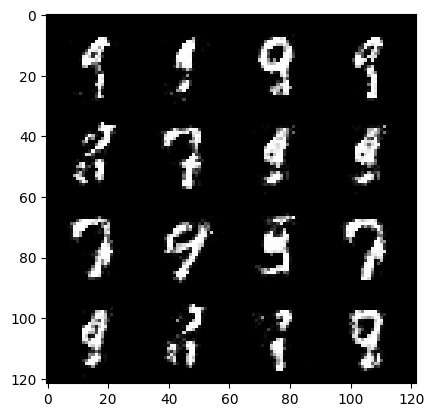

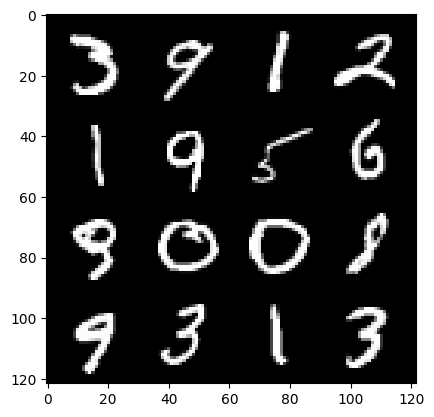

100%|██████████| 469/469 [00:08<00:00, 53.00it/s]


102: step 48300 / Gen loss: 3.441996441682181 / disc_loss: 0.137724112868309


 62%|██████▏   | 290/469 [00:04<00:03, 58.01it/s]

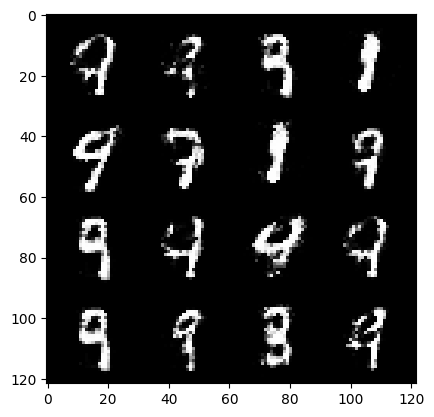

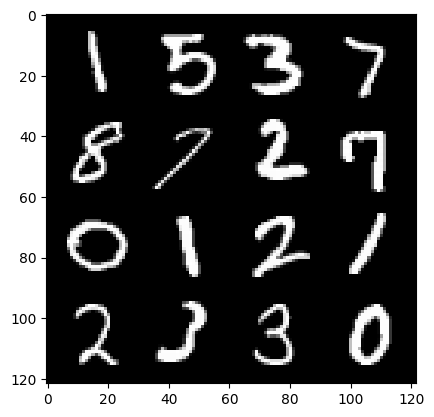

 64%|██████▍   | 301/469 [00:05<00:04, 37.88it/s]

103: step 48600 / Gen loss: 3.4949025472005224 / disc_loss: 0.14531732310851417


 26%|██▌       | 121/469 [00:01<00:05, 64.27it/s]

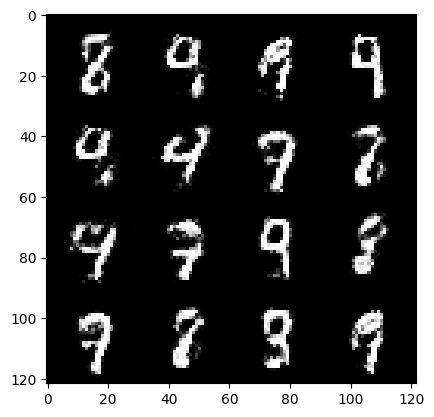

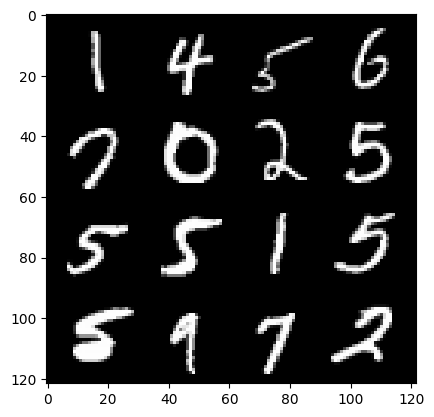

 29%|██▊       | 134/469 [00:02<00:08, 40.09it/s]

104: step 48900 / Gen loss: 3.450965904394785 / disc_loss: 0.1407604717463255


 89%|████████▉ | 418/469 [00:07<00:00, 59.69it/s]

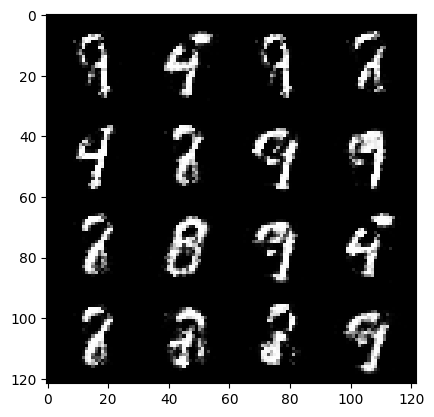

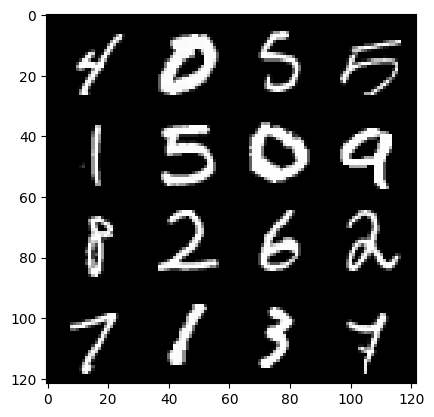

 92%|█████████▏| 430/469 [00:07<00:00, 41.82it/s]

104: step 49200 / Gen loss: 3.3098228867848714 / disc_loss: 0.16833989205459754


 54%|█████▎    | 252/469 [00:04<00:03, 62.38it/s]

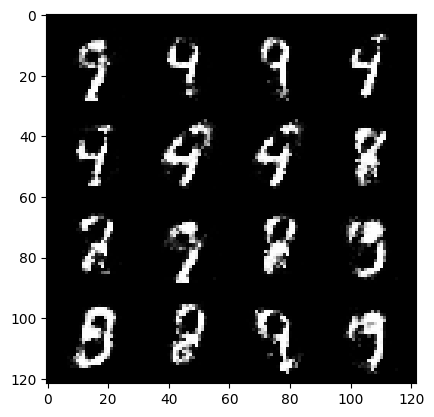

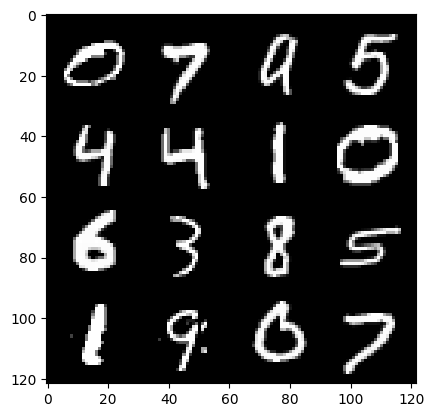

 57%|█████▋    | 265/469 [00:04<00:04, 45.71it/s]

105: step 49500 / Gen loss: 3.3217675209045403 / disc_loss: 0.1489133591204882


 18%|█▊        | 86/469 [00:01<00:06, 63.75it/s]

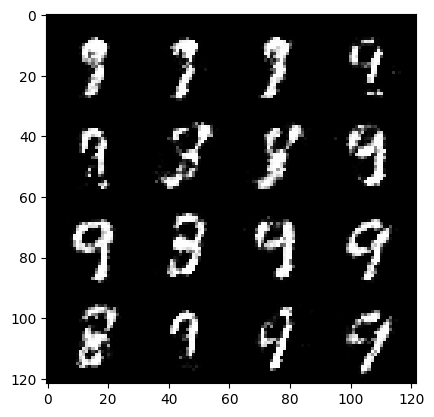

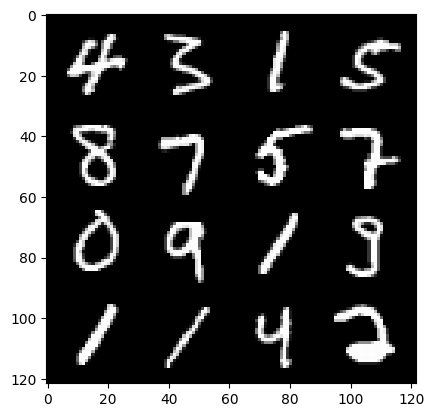

 20%|█▉        | 93/469 [00:01<00:10, 37.05it/s]

106: step 49800 / Gen loss: 3.4192395782470713 / disc_loss: 0.1390497886389494


 82%|████████▏ | 383/469 [00:06<00:01, 58.26it/s]

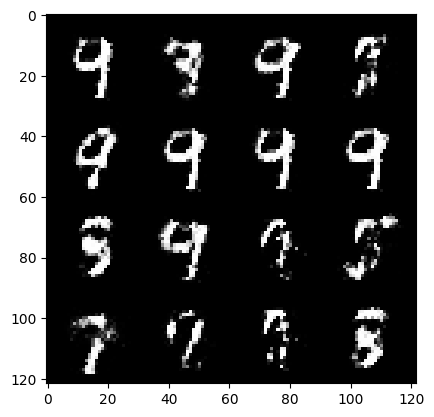

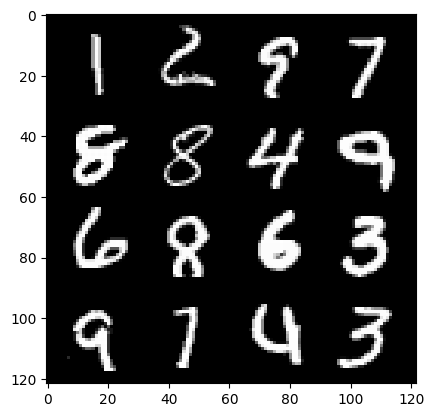

 84%|████████▍ | 394/469 [00:07<00:01, 39.48it/s]

106: step 50100 / Gen loss: 3.2804725599288926 / disc_loss: 0.16196969461937746


 46%|████▌     | 215/469 [00:03<00:04, 56.94it/s]

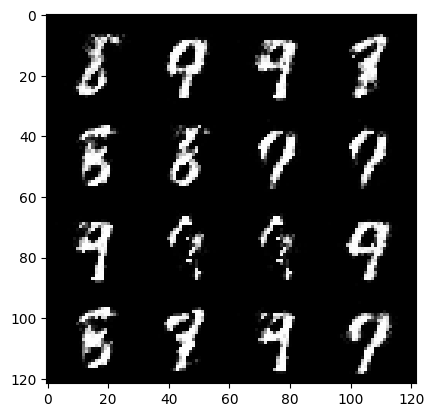

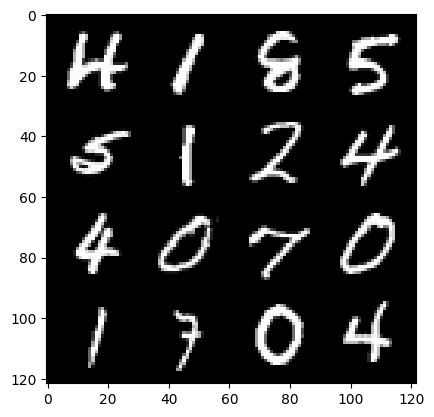

 48%|████▊     | 226/469 [00:04<00:06, 35.96it/s]

107: step 50400 / Gen loss: 3.249694103399914 / disc_loss: 0.158717714274923


 10%|█         | 47/469 [00:00<00:07, 54.09it/s]

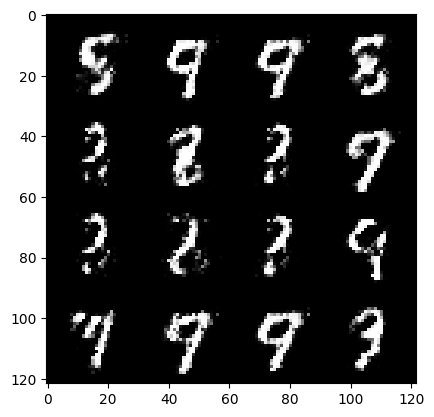

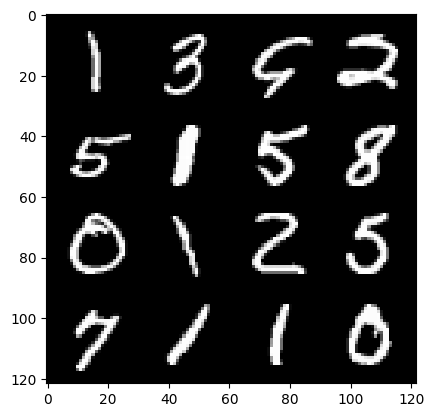

 13%|█▎        | 59/469 [00:01<00:10, 37.83it/s]

108: step 50700 / Gen loss: 3.283503397305807 / disc_loss: 0.16865226037800318


 73%|███████▎  | 342/469 [00:06<00:02, 60.89it/s]

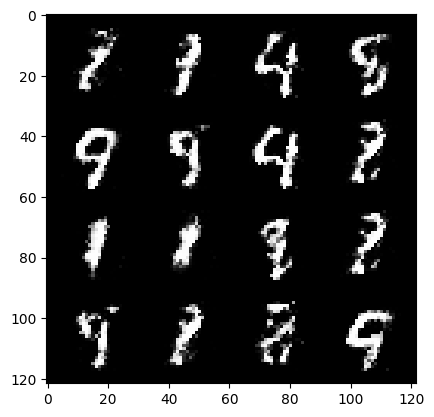

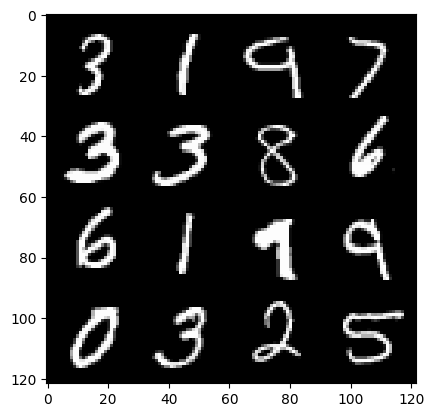

 76%|███████▌  | 355/469 [00:06<00:02, 40.97it/s]

108: step 51000 / Gen loss: 3.339446768760682 / disc_loss: 0.15267997644841677


 37%|███▋      | 173/469 [00:03<00:05, 58.52it/s]

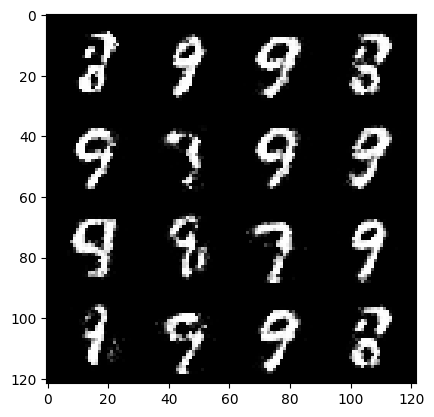

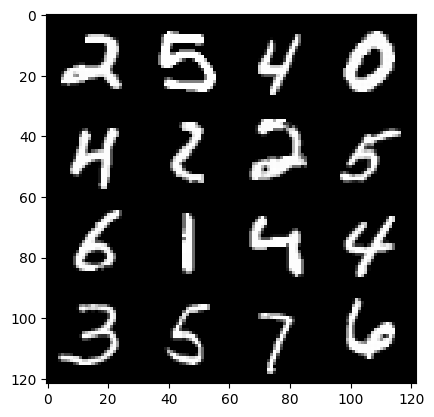

 41%|████      | 193/469 [00:03<00:05, 46.48it/s]

109: step 51300 / Gen loss: 3.3701712433497133 / disc_loss: 0.14070705428719507


  1%|▏         | 7/469 [00:00<00:06, 67.30it/s]

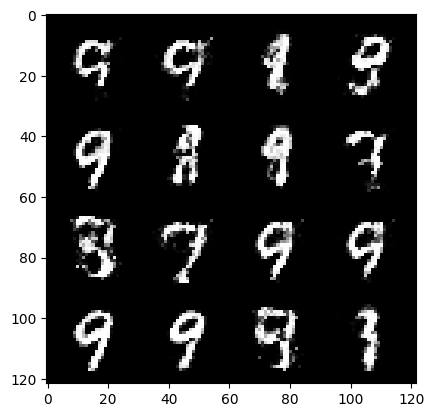

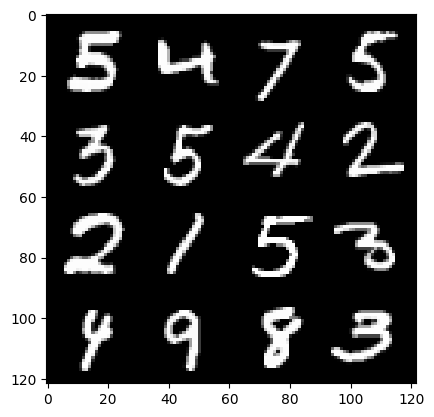

  4%|▍         | 19/469 [00:00<00:13, 32.95it/s]

110: step 51600 / Gen loss: 3.394743181069693 / disc_loss: 0.15919183698793246


 65%|██████▌   | 305/469 [00:05<00:02, 60.57it/s]

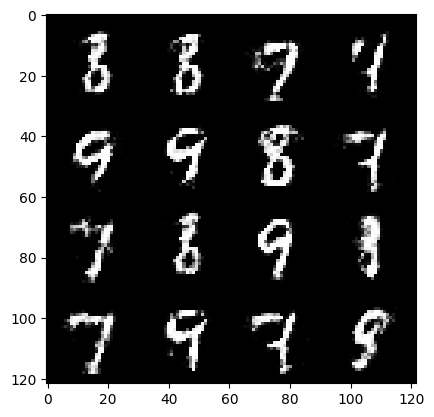

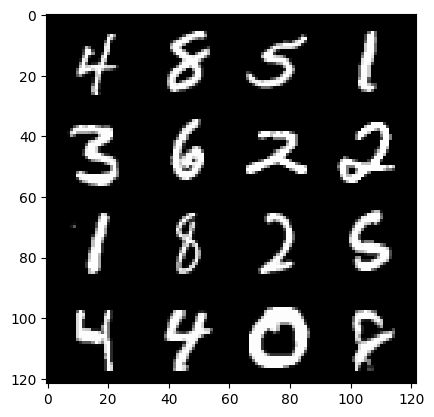

 68%|██████▊   | 319/469 [00:05<00:03, 39.04it/s]

110: step 51900 / Gen loss: 3.2697999382018996 / disc_loss: 0.15914538594583666


 29%|██▉       | 136/469 [00:02<00:05, 60.20it/s]

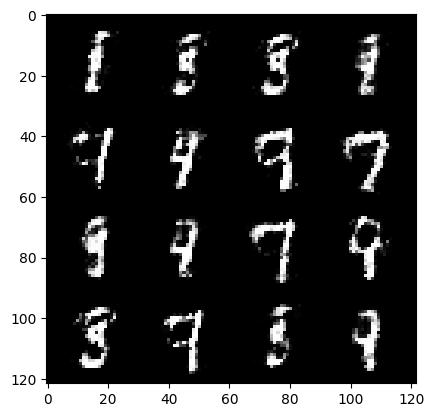

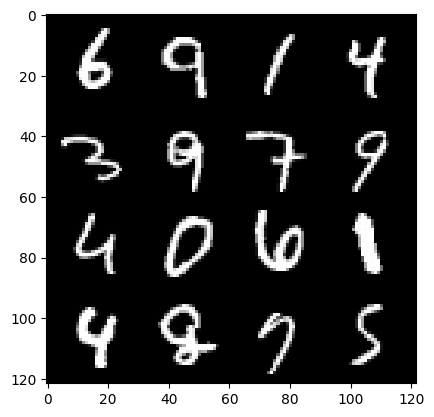

 32%|███▏      | 148/469 [00:02<00:07, 42.30it/s]

111: step 52200 / Gen loss: 3.10536265850067 / disc_loss: 0.17905151066680744


 93%|█████████▎| 436/469 [00:07<00:00, 60.90it/s]

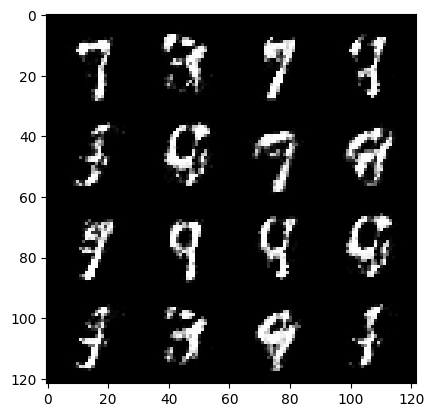

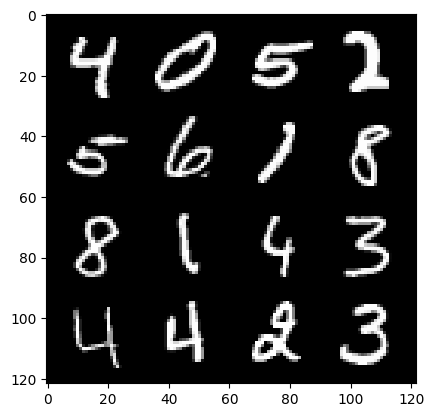

 96%|█████████▌| 448/469 [00:08<00:00, 40.89it/s]

111: step 52500 / Gen loss: 3.2218243551254275 / disc_loss: 0.15543588918944212


 58%|█████▊    | 270/469 [00:04<00:03, 60.43it/s]

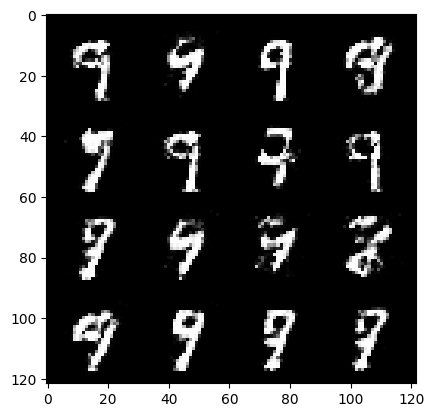

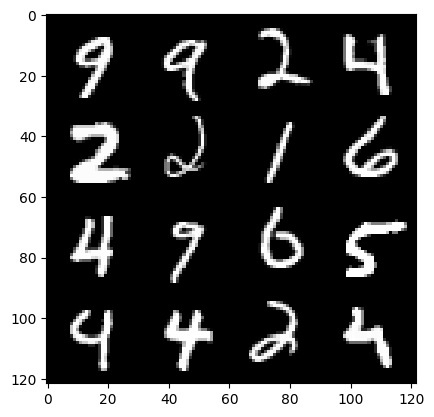

 60%|██████    | 282/469 [00:05<00:04, 39.08it/s]

112: step 52800 / Gen loss: 3.3480529872576428 / disc_loss: 0.15523360947767892


 21%|██        | 98/469 [00:01<00:07, 52.11it/s]

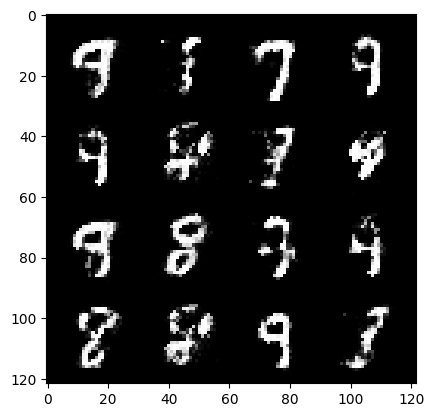

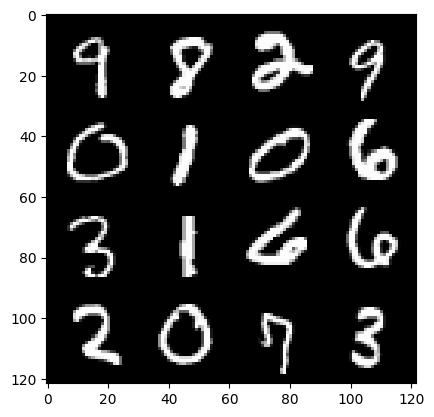

 23%|██▎       | 109/469 [00:02<00:09, 37.95it/s]

113: step 53100 / Gen loss: 3.2685527578989624 / disc_loss: 0.151016788283984


 86%|████████▌ | 403/469 [00:07<00:01, 56.27it/s]

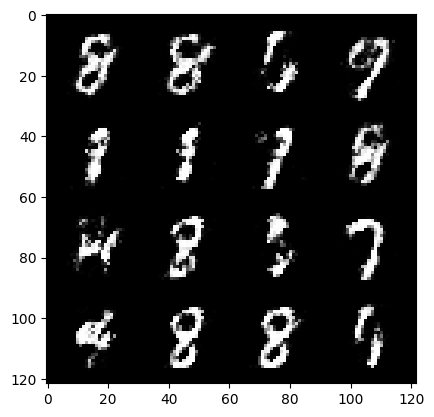

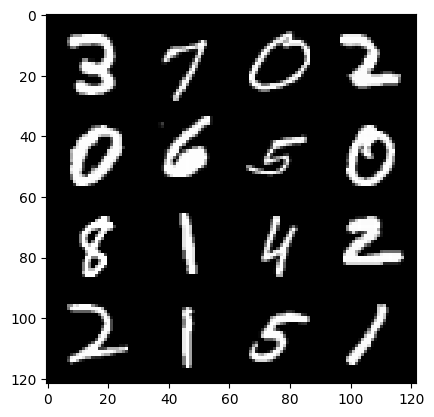

 87%|████████▋ | 409/469 [00:07<00:01, 33.43it/s]

113: step 53400 / Gen loss: 3.148848175207776 / disc_loss: 0.1939340479920309


 49%|████▊     | 228/469 [00:03<00:03, 62.45it/s]

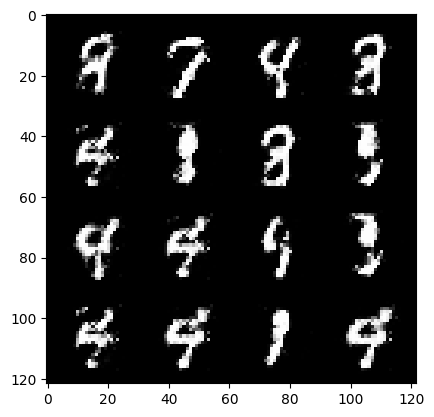

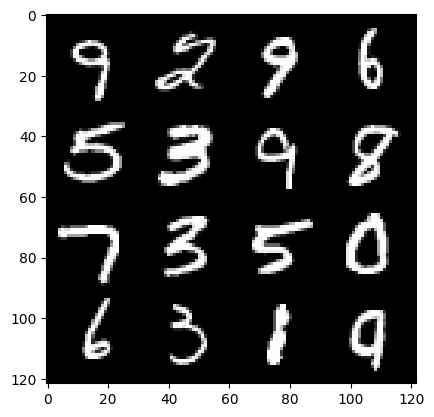

 51%|█████▏    | 241/469 [00:04<00:05, 41.57it/s]

114: step 53700 / Gen loss: 2.9260790014266944 / disc_loss: 0.1948429652055104


 13%|█▎        | 60/469 [00:01<00:07, 56.07it/s]

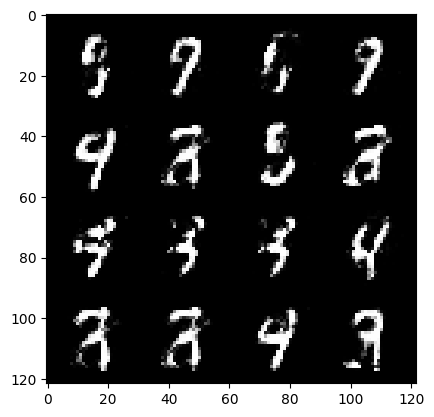

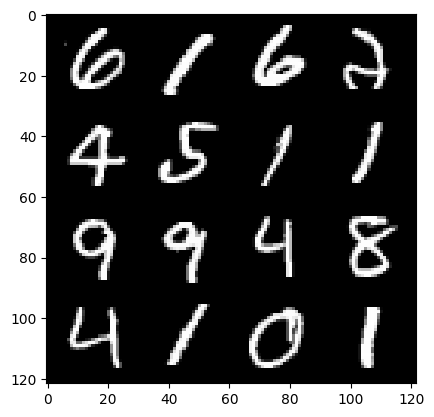

 15%|█▌        | 72/469 [00:01<00:10, 38.60it/s]

115: step 54000 / Gen loss: 3.2380002164840715 / disc_loss: 0.1459640416006247


 77%|███████▋  | 359/469 [00:06<00:01, 61.16it/s]

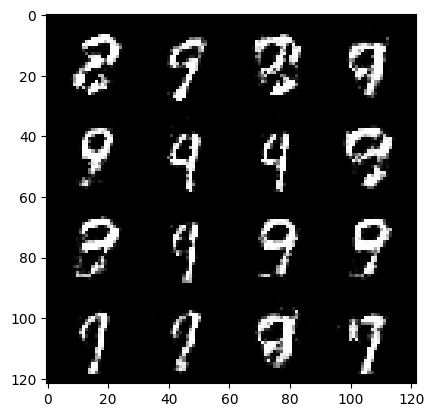

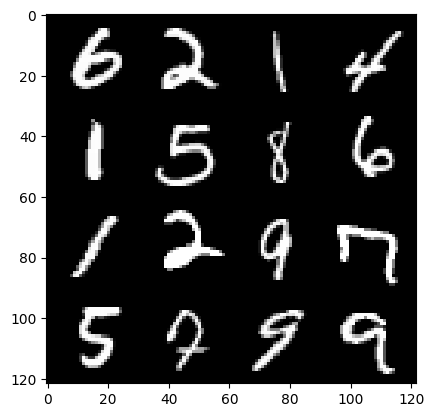

 79%|███████▉  | 372/469 [00:06<00:02, 43.90it/s]

115: step 54300 / Gen loss: 3.2331013925870264 / disc_loss: 0.15976929066081846


 41%|████▏     | 194/469 [00:03<00:04, 59.55it/s]

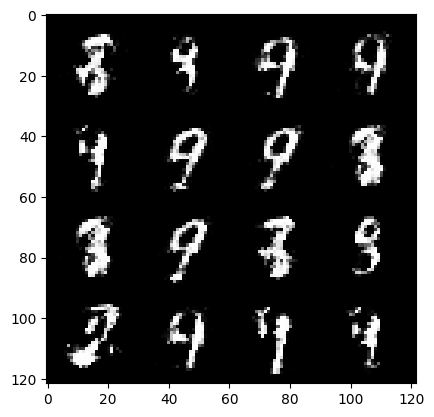

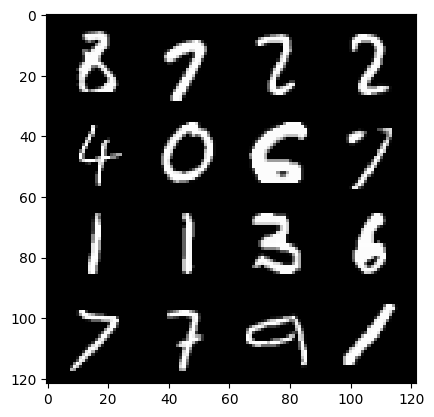

 43%|████▎     | 201/469 [00:03<00:06, 39.74it/s]

116: step 54600 / Gen loss: 3.005110175609591 / disc_loss: 0.2141669536133608


  4%|▍         | 21/469 [00:00<00:07, 61.98it/s]

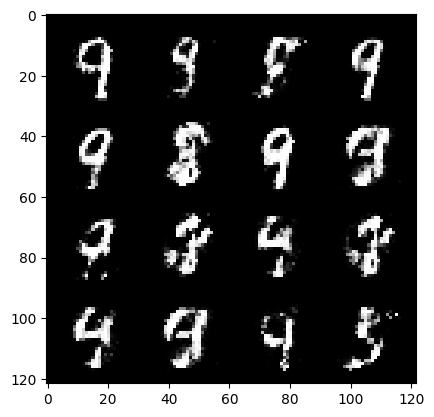

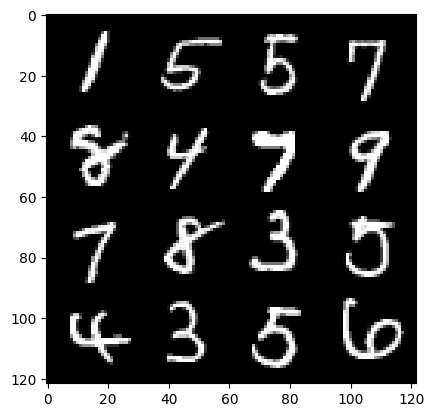

  7%|▋         | 33/469 [00:00<00:11, 37.23it/s]

117: step 54900 / Gen loss: 3.0734516207377136 / disc_loss: 0.18401116987069438


 68%|██████▊   | 321/469 [00:06<00:03, 46.58it/s]

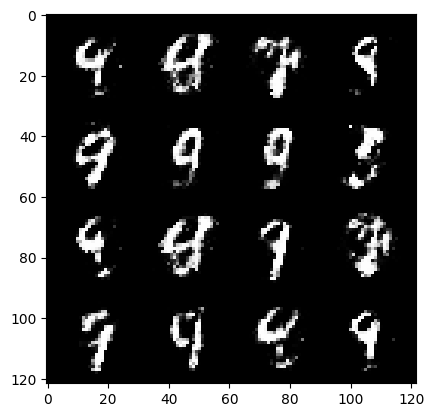

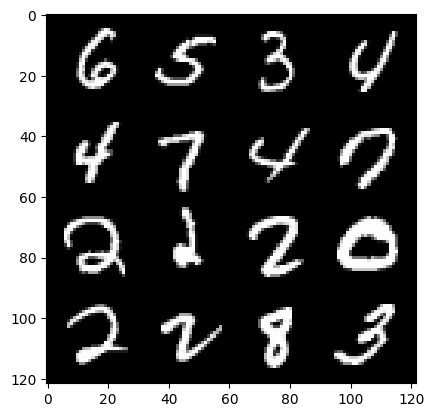

 72%|███████▏  | 339/469 [00:06<00:03, 41.03it/s]

117: step 55200 / Gen loss: 3.169267299175263 / disc_loss: 0.16566247763733088


 33%|███▎      | 153/469 [00:02<00:04, 63.93it/s]

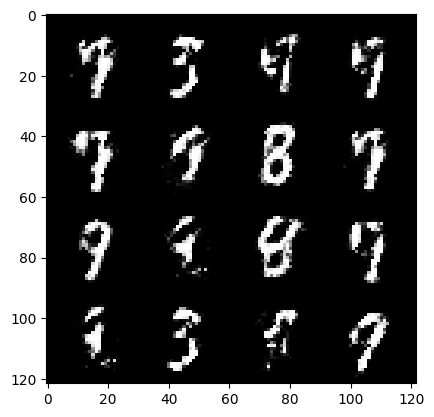

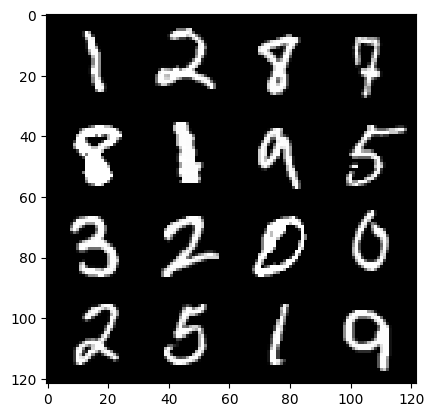

 35%|███▌      | 166/469 [00:02<00:07, 39.40it/s]

118: step 55500 / Gen loss: 3.1692306057612107 / disc_loss: 0.16212735307713338


 97%|█████████▋| 456/469 [00:08<00:00, 62.16it/s]

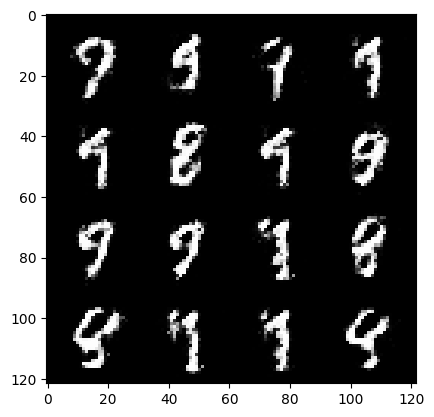

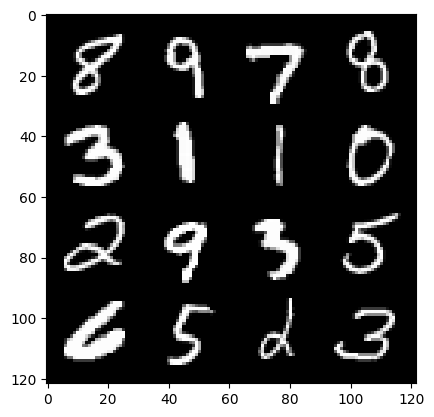

 99%|█████████▊| 463/469 [00:08<00:00, 39.08it/s]

118: step 55800 / Gen loss: 3.100929470062256 / disc_loss: 0.17424362207452468


 61%|██████▏   | 288/469 [00:04<00:02, 65.11it/s]

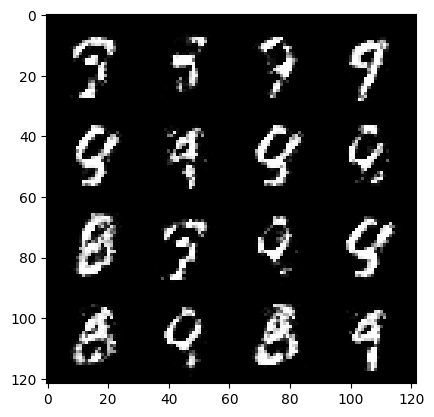

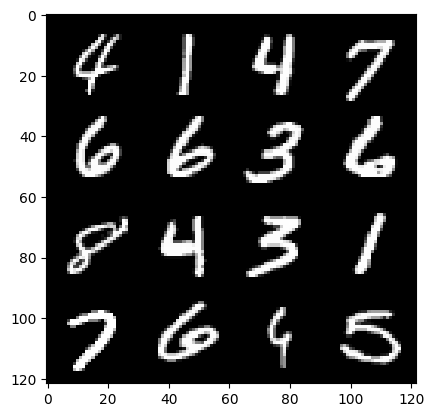

 63%|██████▎   | 295/469 [00:04<00:04, 43.35it/s]

119: step 56100 / Gen loss: 3.0227480506896973 / disc_loss: 0.17264104674259811


 24%|██▍       | 114/469 [00:01<00:05, 65.23it/s]

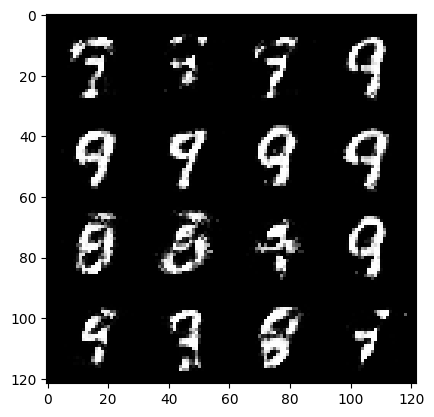

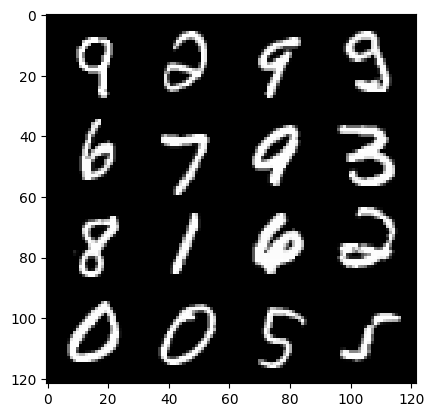

 27%|██▋       | 127/469 [00:02<00:07, 43.83it/s]

120: step 56400 / Gen loss: 3.2415171392758655 / disc_loss: 0.15955662190914155


 89%|████████▉ | 419/469 [00:06<00:00, 56.11it/s]

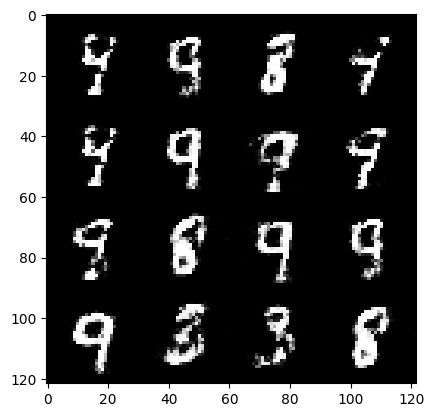

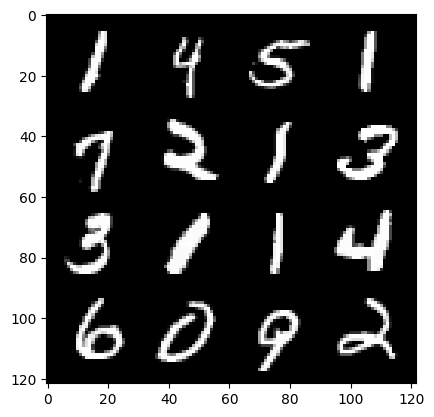

 92%|█████████▏| 430/469 [00:07<00:00, 39.18it/s]

120: step 56700 / Gen loss: 3.273114792505897 / disc_loss: 0.15341401318709064


 54%|█████▎    | 251/469 [00:04<00:03, 61.66it/s]

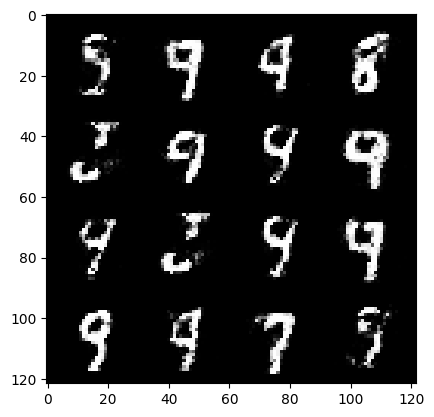

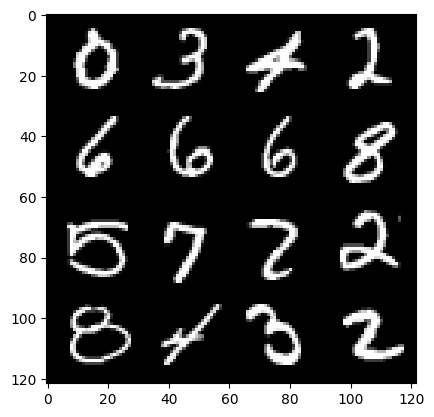

 55%|█████▌    | 258/469 [00:04<00:05, 39.05it/s]

121: step 57000 / Gen loss: 3.097640582720437 / disc_loss: 0.16325654454529298


 16%|█▋        | 77/469 [00:01<00:06, 61.63it/s]

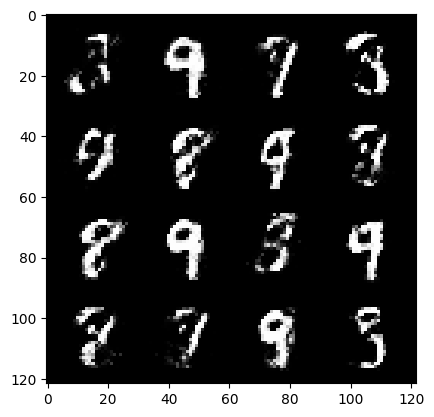

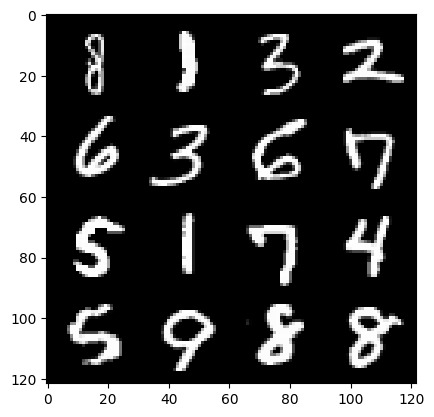

 19%|█▉        | 89/469 [00:01<00:10, 36.13it/s]

122: step 57300 / Gen loss: 3.127705088456472 / disc_loss: 0.16531803568204237


 81%|████████▏ | 382/469 [00:06<00:01, 62.83it/s]

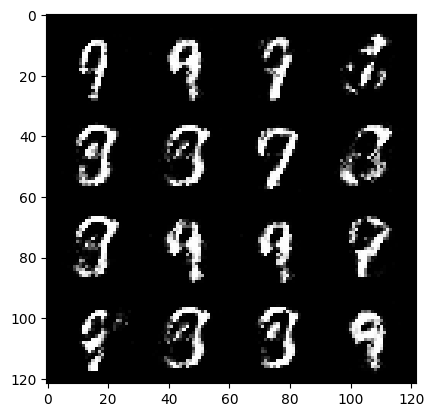

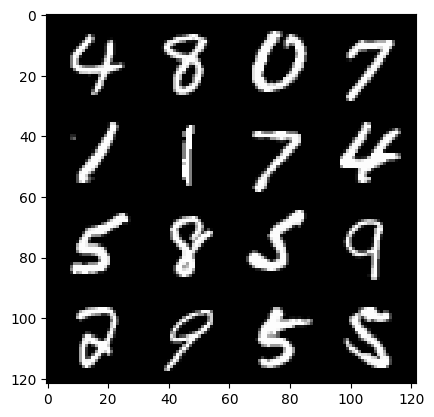

 83%|████████▎ | 389/469 [00:06<00:02, 33.80it/s]

122: step 57600 / Gen loss: 2.9884402203559883 / disc_loss: 0.1960088071972132


 45%|████▌     | 212/469 [00:03<00:03, 65.97it/s]

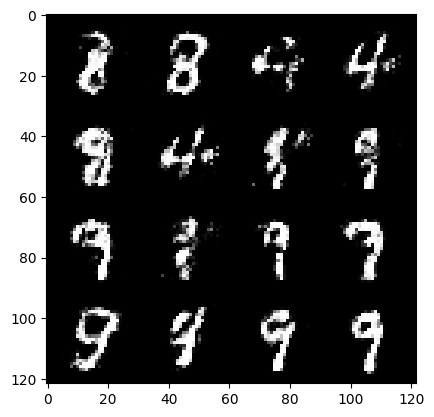

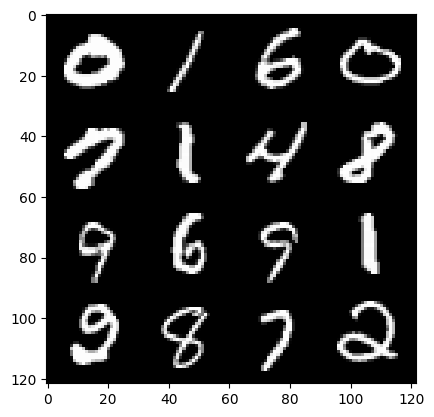

 47%|████▋     | 219/469 [00:03<00:05, 43.52it/s]

123: step 57900 / Gen loss: 2.968245899677277 / disc_loss: 0.21103677759567904


  9%|▊         | 41/469 [00:00<00:07, 59.50it/s]

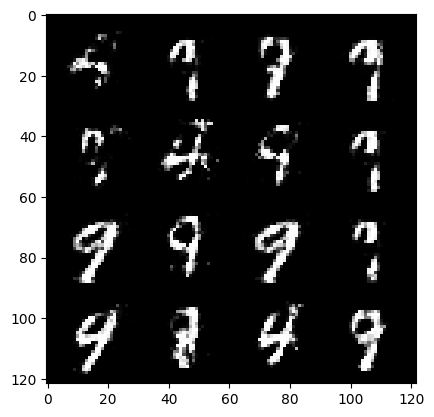

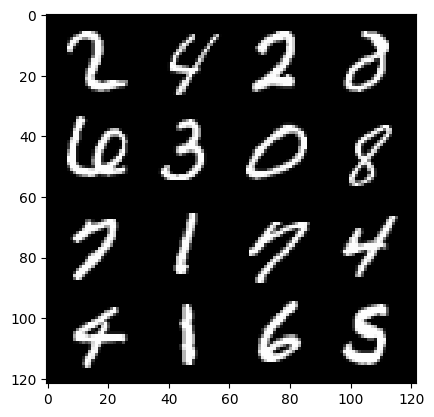

 11%|█▏        | 53/469 [00:01<00:10, 39.51it/s]

124: step 58200 / Gen loss: 3.0546716125806177 / disc_loss: 0.17779780343174922


 72%|███████▏  | 340/469 [00:05<00:01, 66.45it/s]

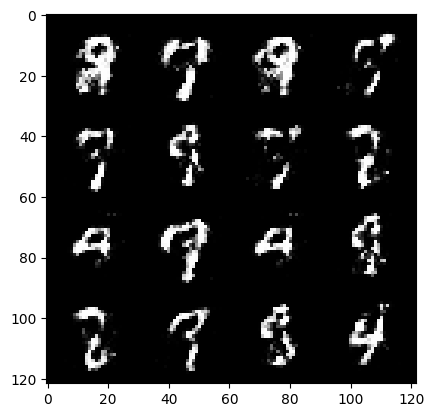

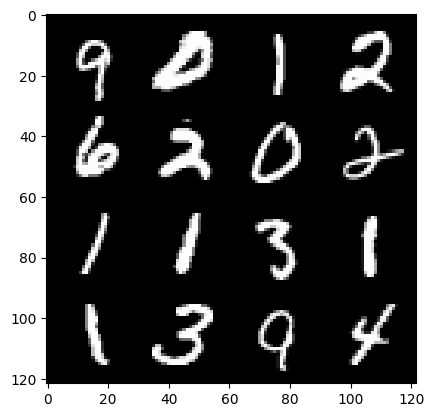

 75%|███████▌  | 353/469 [00:06<00:02, 42.15it/s]

124: step 58500 / Gen loss: 2.8412622745831815 / disc_loss: 0.19918229016164934


 37%|███▋      | 175/469 [00:02<00:05, 56.95it/s]

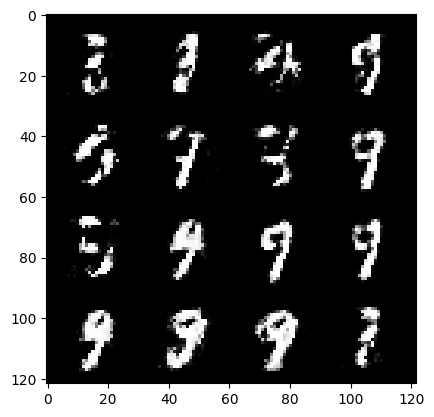

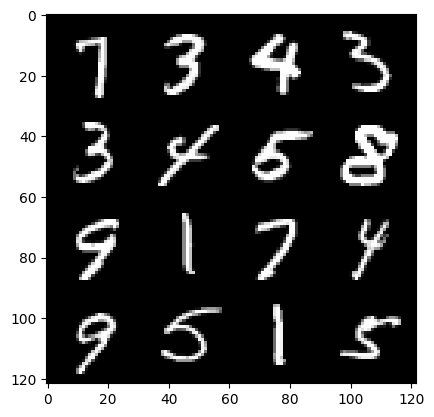

 40%|███▉      | 187/469 [00:03<00:06, 40.34it/s]

125: step 58800 / Gen loss: 2.8662920713424715 / disc_loss: 0.1854357538868984


  0%|          | 0/469 [00:00<?, ?it/s]

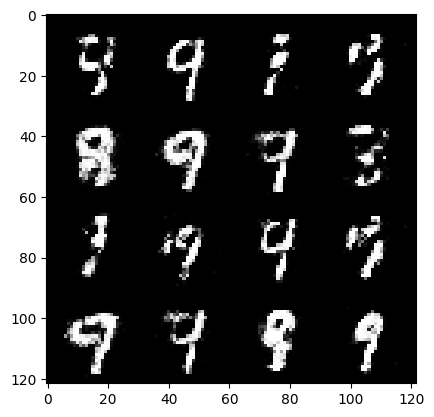

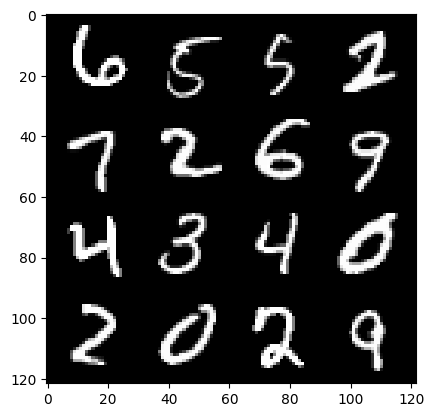

  3%|▎         | 12/469 [00:00<00:15, 29.22it/s]

126: step 59100 / Gen loss: 2.9993485983212778 / disc_loss: 0.16892431380848097


 64%|██████▍   | 301/469 [00:05<00:03, 52.15it/s]

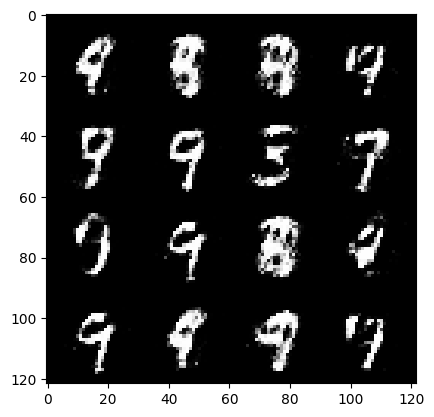

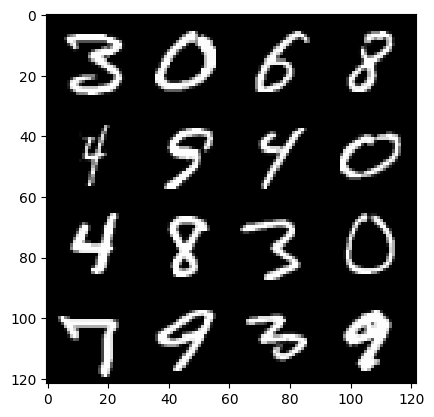

 67%|██████▋   | 312/469 [00:05<00:04, 36.78it/s]

126: step 59400 / Gen loss: 2.9127468069394453 / disc_loss: 0.184476333707571


 28%|██▊       | 132/469 [00:02<00:05, 63.64it/s]

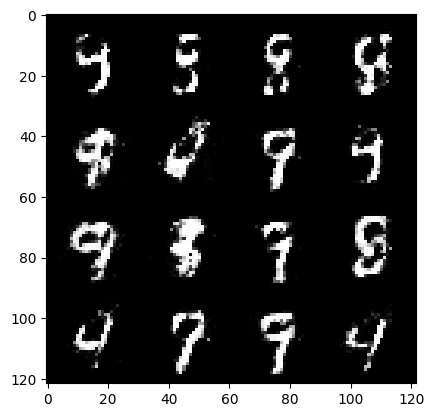

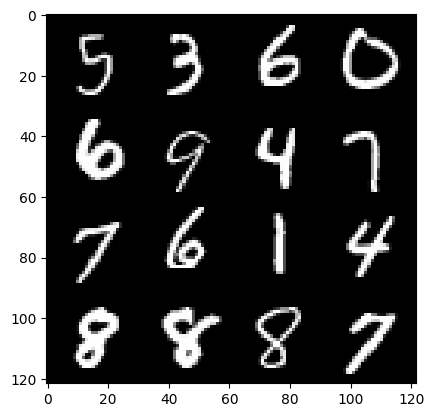

 31%|███       | 145/469 [00:02<00:07, 41.42it/s]

127: step 59700 / Gen loss: 2.756567001342775 / disc_loss: 0.21261372049649552


 92%|█████████▏| 431/469 [00:07<00:00, 63.57it/s]

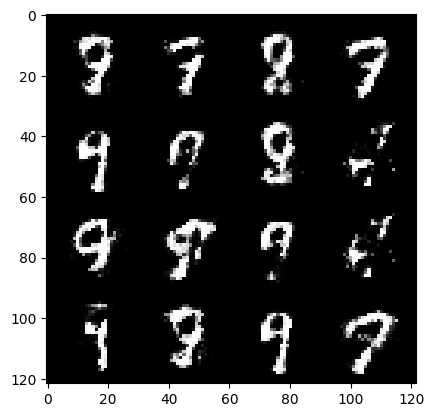

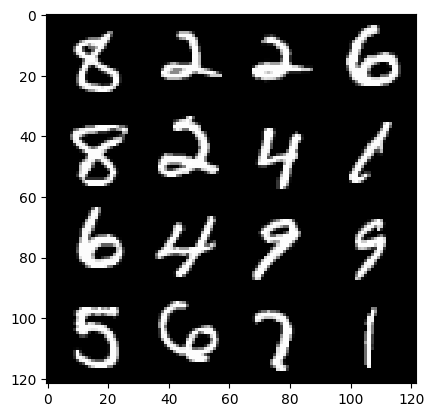

 95%|█████████▍| 444/469 [00:07<00:00, 42.48it/s]

127: step 60000 / Gen loss: 2.711011368433633 / disc_loss: 0.2002944170931975


 57%|█████▋    | 266/469 [00:04<00:03, 60.67it/s]

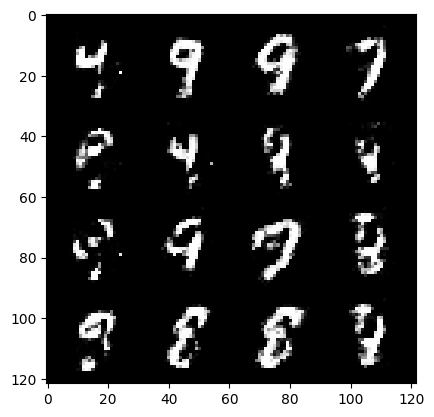

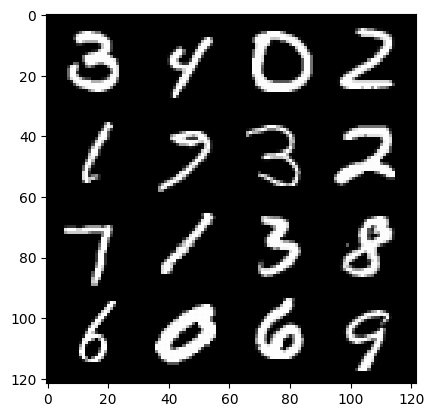

 58%|█████▊    | 273/469 [00:04<00:05, 38.07it/s]

128: step 60300 / Gen loss: 2.8564688372611995 / disc_loss: 0.19164171760280924


 21%|██        | 99/469 [00:01<00:05, 65.71it/s]

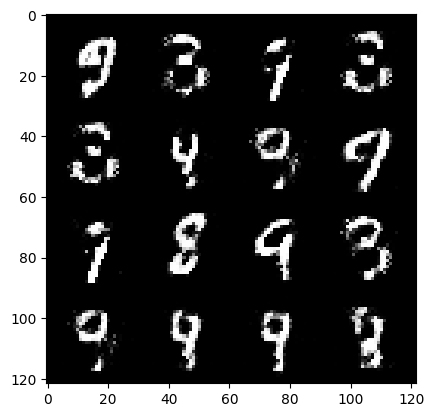

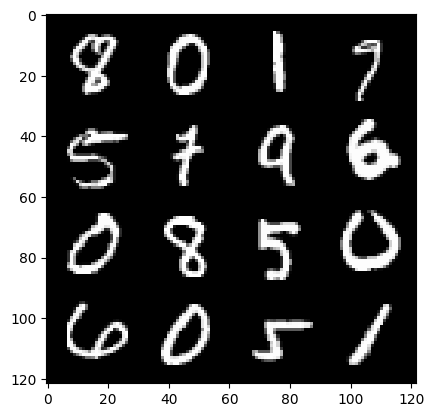

 23%|██▎       | 106/469 [00:01<00:09, 40.29it/s]

129: step 60600 / Gen loss: 2.8348701477050784 / disc_loss: 0.1951872886220613


 84%|████████▍ | 396/469 [00:06<00:01, 54.37it/s]

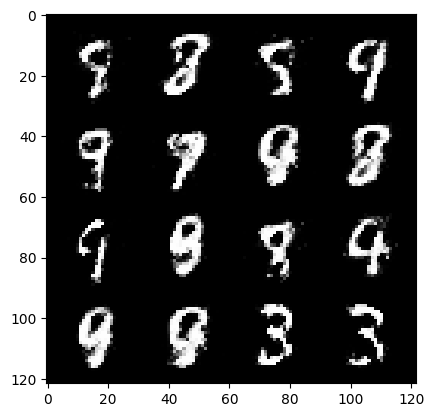

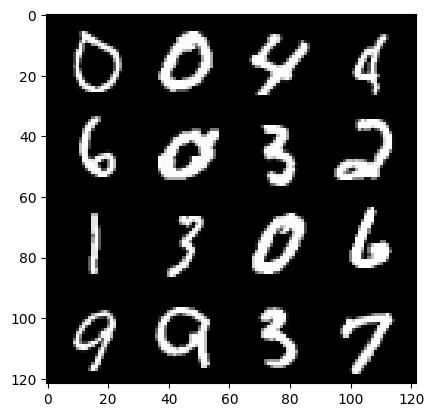

 87%|████████▋ | 407/469 [00:07<00:01, 36.29it/s]

129: step 60900 / Gen loss: 2.921374744574228 / disc_loss: 0.18466670108338196


 49%|████▊     | 228/469 [00:03<00:03, 63.19it/s]

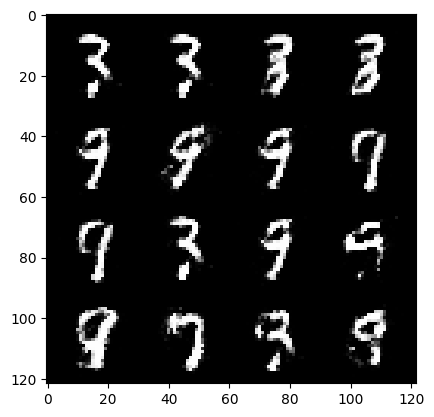

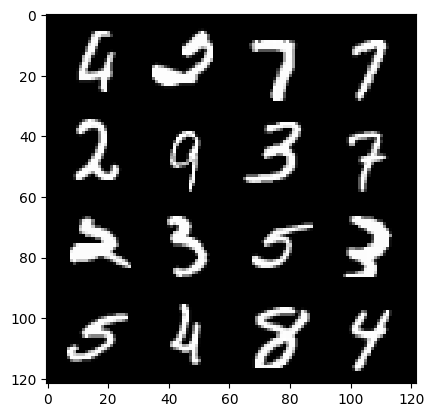

 50%|█████     | 235/469 [00:03<00:05, 40.89it/s]

130: step 61200 / Gen loss: 2.873926849365233 / disc_loss: 0.1832678554455439


 12%|█▏        | 57/469 [00:01<00:07, 57.95it/s]

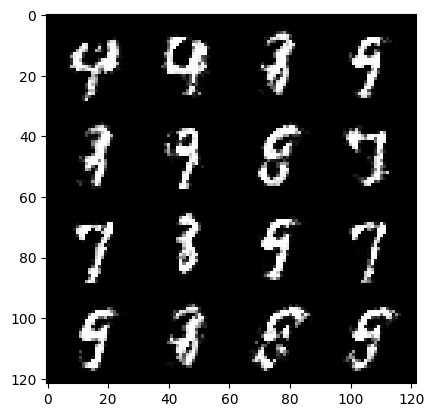

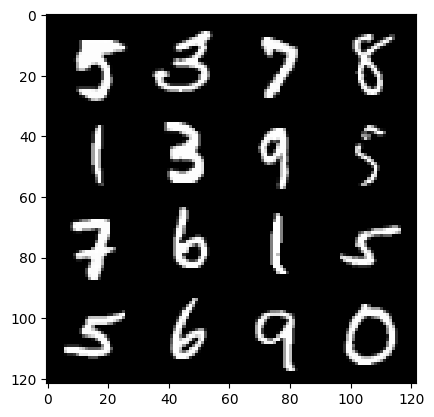

 14%|█▍        | 68/469 [00:01<00:11, 34.15it/s]

131: step 61500 / Gen loss: 2.8581631620724997 / disc_loss: 0.20105692476034165


 76%|███████▌  | 356/469 [00:06<00:01, 58.67it/s]

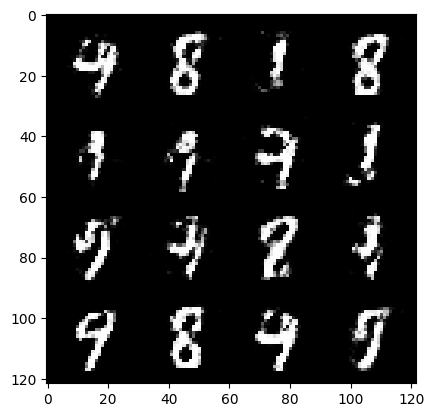

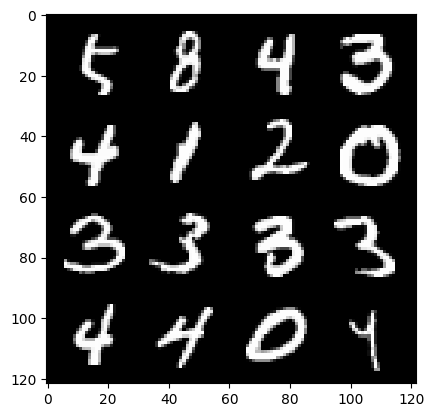

 78%|███████▊  | 367/469 [00:06<00:02, 40.65it/s]

131: step 61800 / Gen loss: 2.718815353711446 / disc_loss: 0.19884421837826569


 40%|███▉      | 187/469 [00:03<00:04, 62.35it/s]

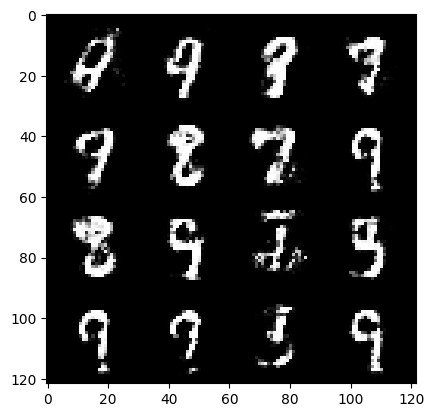

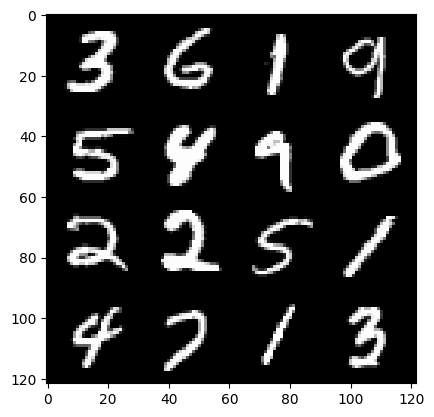

 43%|████▎     | 200/469 [00:03<00:06, 40.31it/s]

132: step 62100 / Gen loss: 2.819832779169083 / disc_loss: 0.20085912230114142


  3%|▎         | 16/469 [00:00<00:09, 47.87it/s]

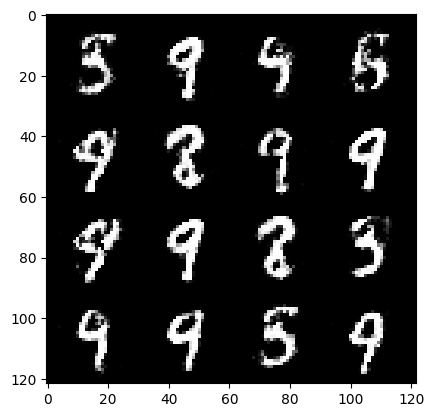

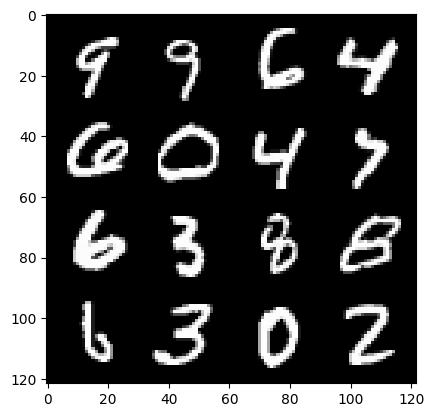

  7%|▋         | 34/469 [00:00<00:11, 36.79it/s]

133: step 62400 / Gen loss: 2.8401243631045032 / disc_loss: 0.1930651956796646


 69%|██████▉   | 323/469 [00:05<00:02, 67.13it/s]

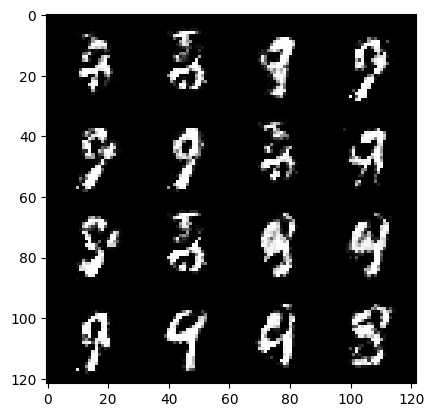

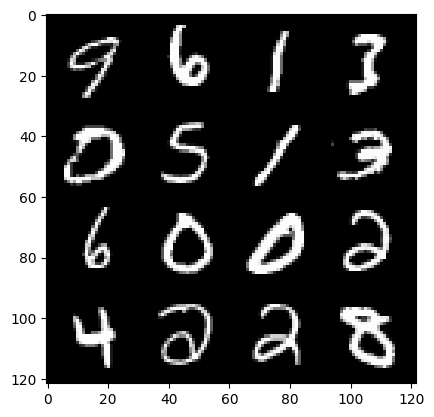

 70%|███████   | 330/469 [00:06<00:03, 40.29it/s]

133: step 62700 / Gen loss: 2.653360711733499 / disc_loss: 0.21572762851913765


 32%|███▏      | 149/469 [00:02<00:05, 58.96it/s]

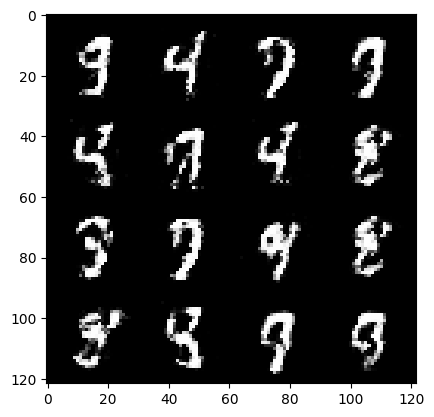

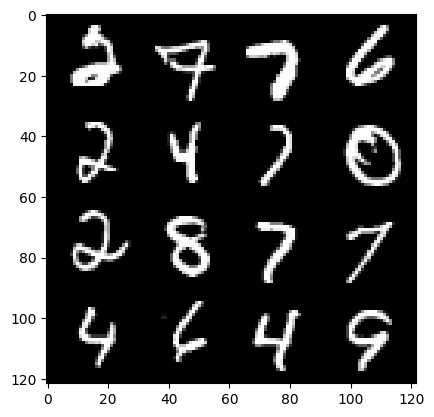

 34%|███▍      | 161/469 [00:03<00:08, 35.79it/s]

134: step 63000 / Gen loss: 2.9276468094189956 / disc_loss: 0.17585923922558613


 96%|█████████▋| 452/469 [00:08<00:00, 57.76it/s]

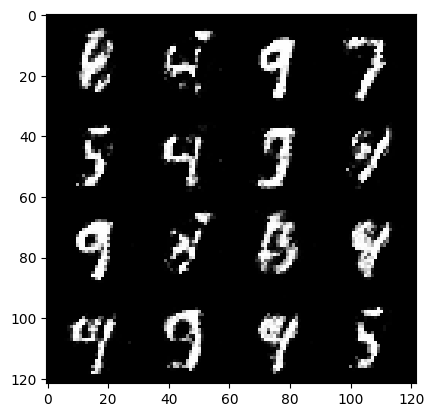

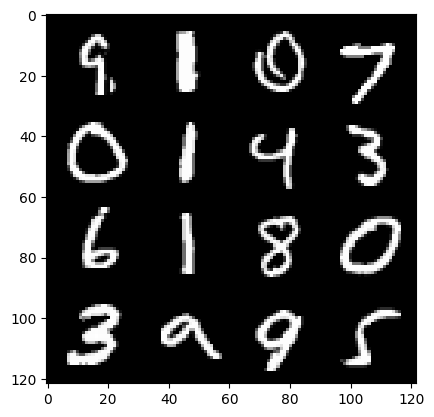

 99%|█████████▊| 463/469 [00:08<00:00, 35.53it/s]

134: step 63300 / Gen loss: 3.0255877772967033 / disc_loss: 0.17232057078431054


 61%|██████    | 284/469 [00:04<00:02, 61.80it/s]

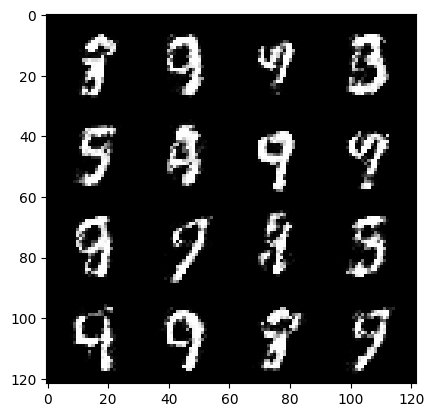

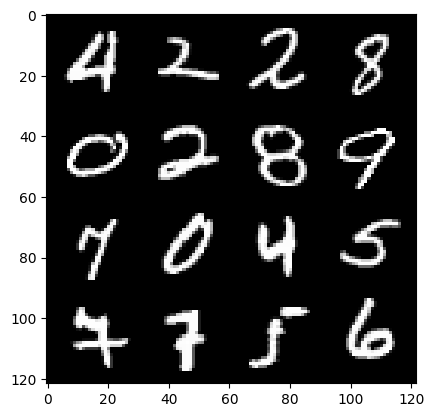

 62%|██████▏   | 291/469 [00:05<00:05, 35.46it/s]

135: step 63600 / Gen loss: 2.8274540789922087 / disc_loss: 0.19823575099309287


 24%|██▍       | 114/469 [00:02<00:06, 56.87it/s]

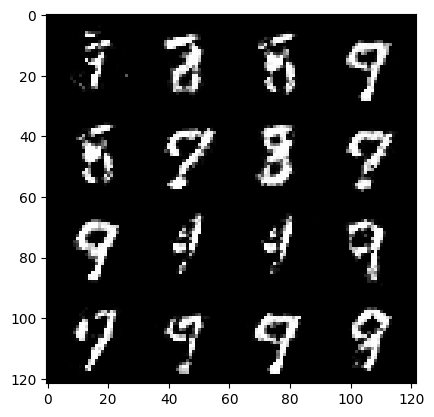

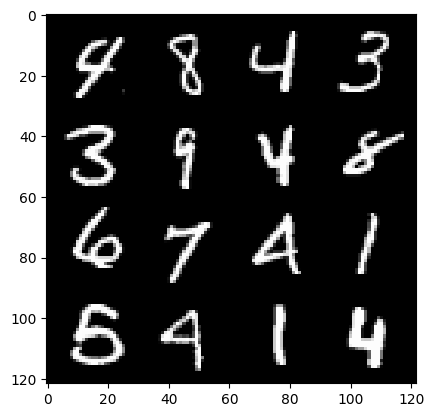

 27%|██▋       | 125/469 [00:02<00:09, 37.38it/s]

136: step 63900 / Gen loss: 2.898890376885733 / disc_loss: 0.18593707730372752


 88%|████████▊ | 412/469 [00:07<00:00, 62.21it/s]

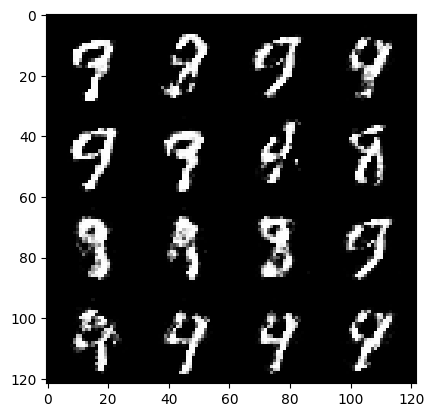

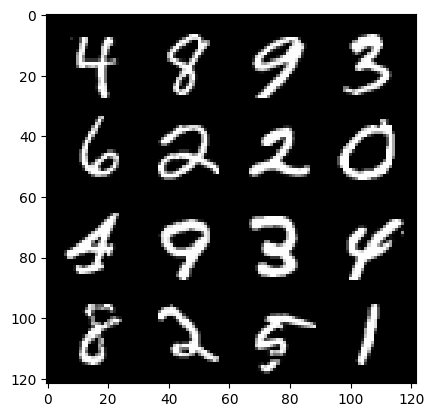

 91%|█████████ | 425/469 [00:07<00:01, 39.95it/s]

136: step 64200 / Gen loss: 2.745022486050922 / disc_loss: 0.20986547484993937


 52%|█████▏    | 245/469 [00:04<00:03, 61.02it/s]

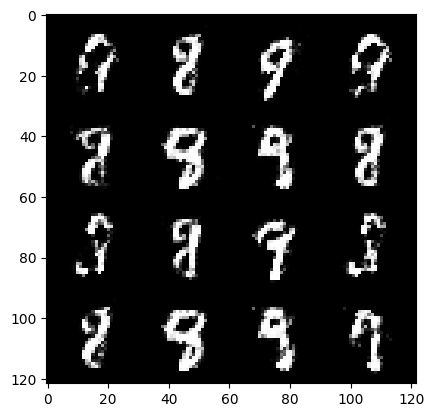

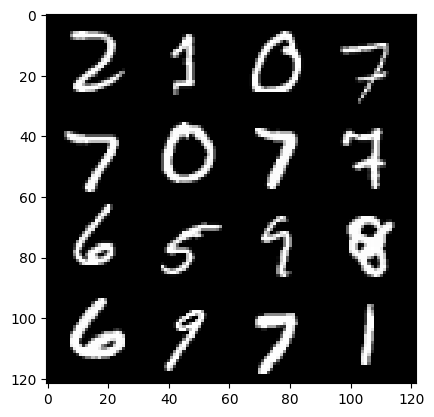

 54%|█████▎    | 252/469 [00:04<00:06, 34.77it/s]

137: step 64500 / Gen loss: 2.721496272087097 / disc_loss: 0.20962506202360007


 15%|█▌        | 72/469 [00:01<00:06, 57.57it/s]

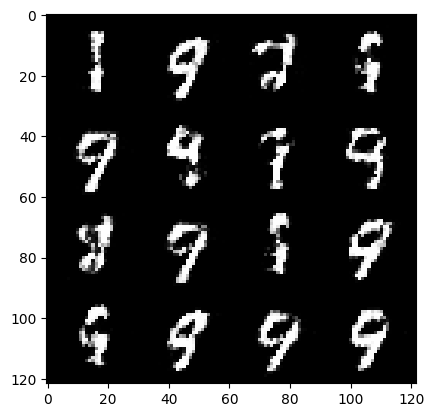

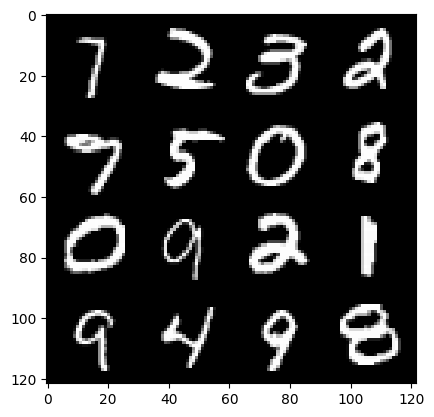

 18%|█▊        | 84/469 [00:01<00:09, 39.91it/s]

138: step 64800 / Gen loss: 2.74126844485601 / disc_loss: 0.19623845068116977


 79%|███████▉  | 372/469 [00:06<00:01, 65.52it/s]

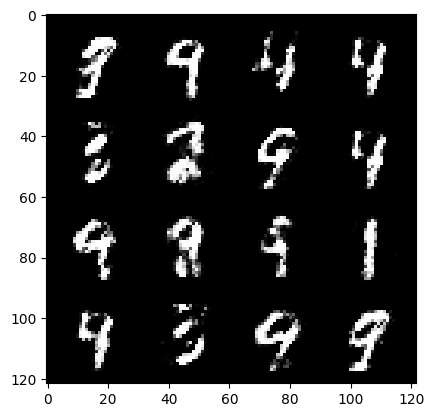

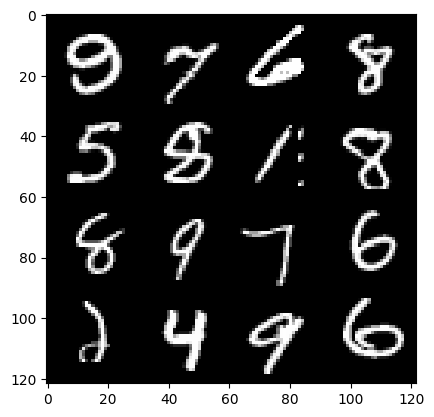

 82%|████████▏ | 385/469 [00:07<00:02, 39.31it/s]

138: step 65100 / Gen loss: 2.8690073641141227 / disc_loss: 0.18418568350374703


 43%|████▎     | 204/469 [00:03<00:04, 59.25it/s]

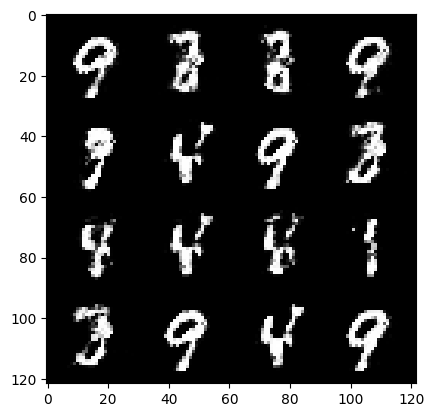

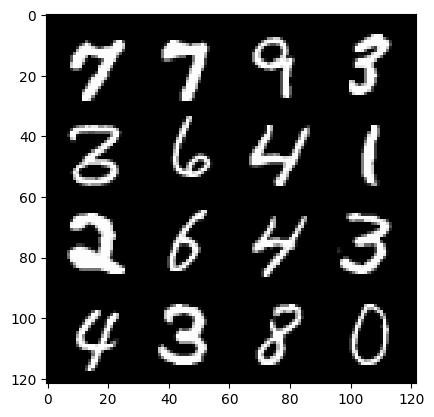

 47%|████▋     | 220/469 [00:03<00:06, 40.66it/s]

139: step 65400 / Gen loss: 2.770941469669343 / disc_loss: 0.1990376083552838


  7%|▋         | 35/469 [00:00<00:07, 57.98it/s]

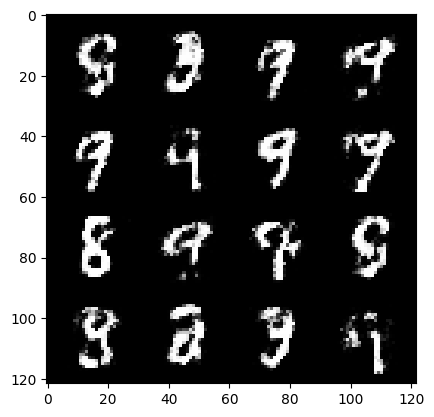

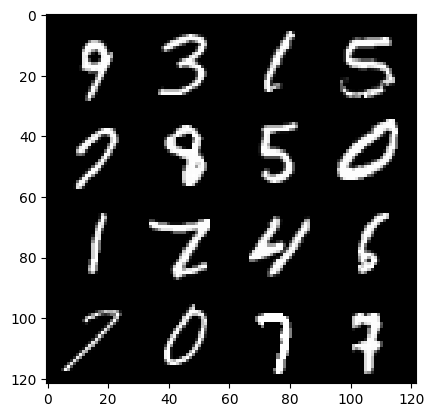

 10%|▉         | 46/469 [00:01<00:11, 36.51it/s]

140: step 65700 / Gen loss: 2.883084360758464 / disc_loss: 0.18070564786593124


 72%|███████▏  | 337/469 [00:06<00:02, 56.12it/s]

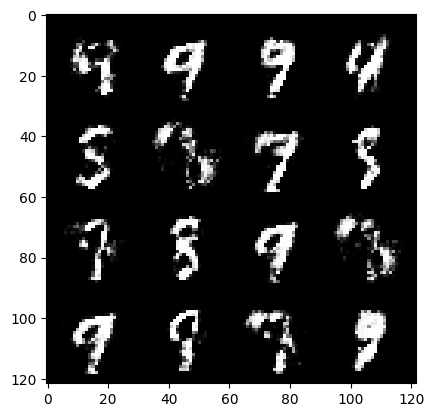

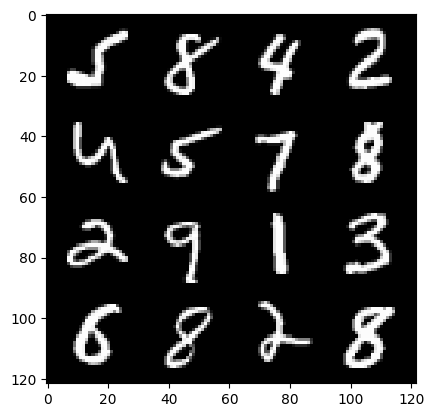

 74%|███████▍  | 348/469 [00:06<00:03, 38.71it/s]

140: step 66000 / Gen loss: 3.0448139246304837 / disc_loss: 0.18842112205922595


 36%|███▋      | 171/469 [00:02<00:05, 57.84it/s]

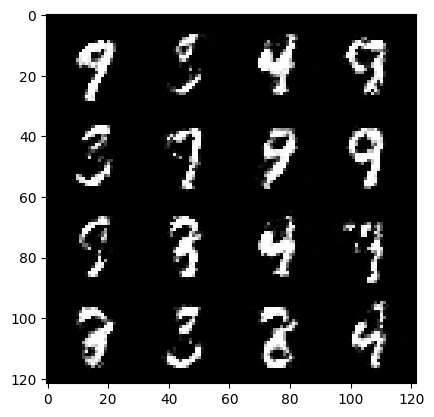

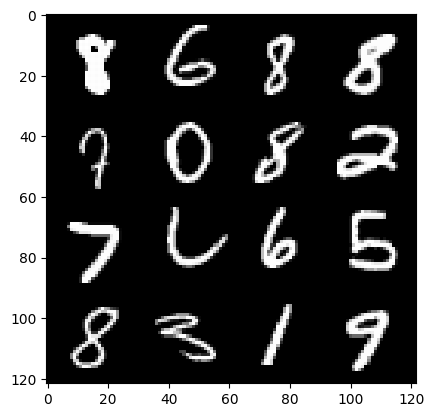

 38%|███▊      | 177/469 [00:03<00:08, 35.79it/s]

141: step 66300 / Gen loss: 2.726217269102733 / disc_loss: 0.19788044008115915


  0%|          | 0/469 [00:00<?, ?it/s]

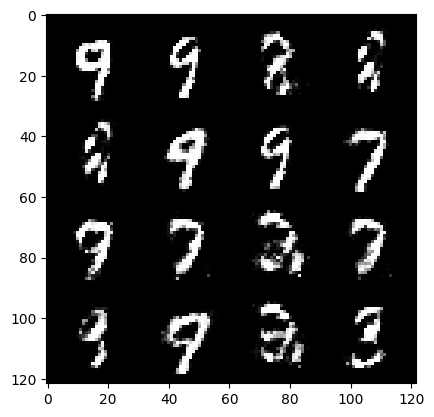

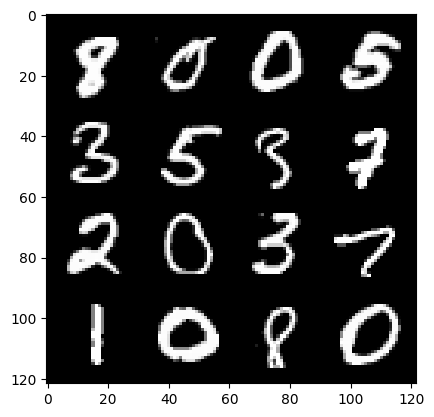

  2%|▏         | 8/469 [00:00<00:17, 26.40it/s]

142: step 66600 / Gen loss: 2.699216784636179 / disc_loss: 0.20094010531902295


 64%|██████▍   | 302/469 [00:05<00:02, 56.99it/s]

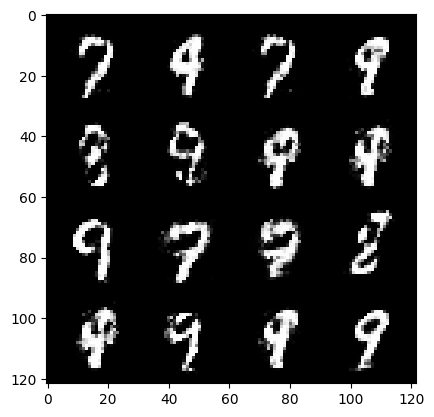

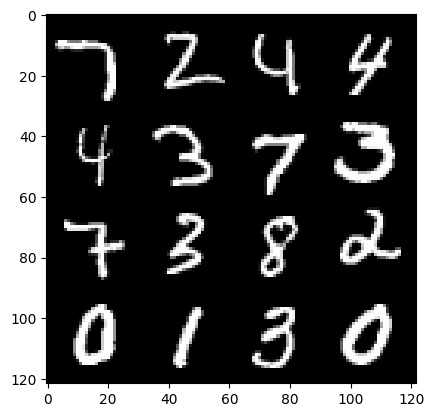

 66%|██████▌   | 308/469 [00:05<00:04, 34.85it/s]

142: step 66900 / Gen loss: 2.556298840840657 / disc_loss: 0.21594403033455215


 28%|██▊       | 131/469 [00:02<00:06, 56.13it/s]

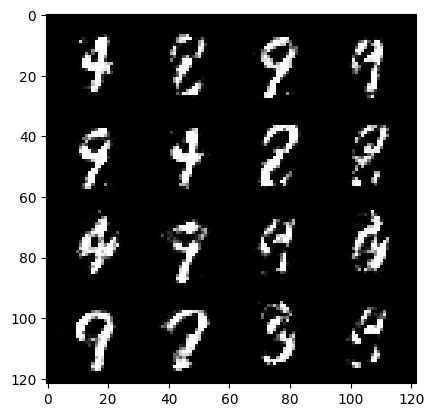

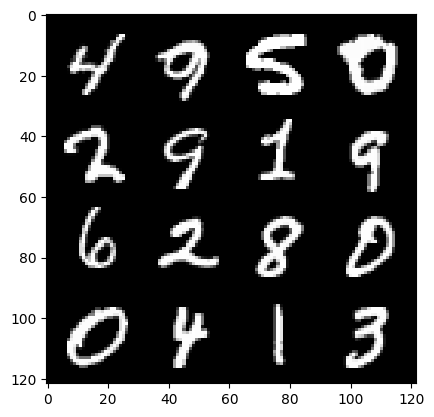

 30%|███       | 142/469 [00:02<00:08, 37.13it/s]

143: step 67200 / Gen loss: 2.741674191157023 / disc_loss: 0.18408865951001646


 92%|█████████▏| 430/469 [00:07<00:00, 56.25it/s]

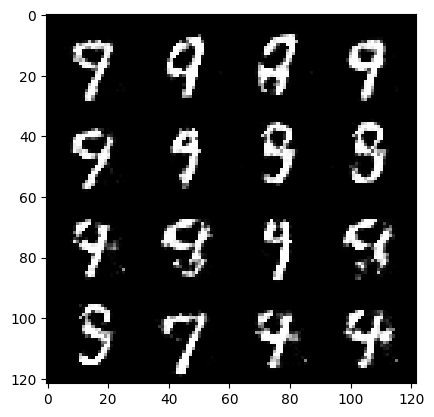

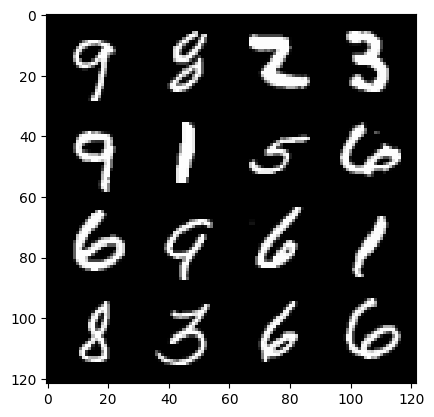

 94%|█████████▍| 441/469 [00:08<00:00, 35.04it/s]

143: step 67500 / Gen loss: 2.9306995908419293 / disc_loss: 0.1674819736927748


 55%|█████▌    | 260/469 [00:04<00:03, 59.31it/s]

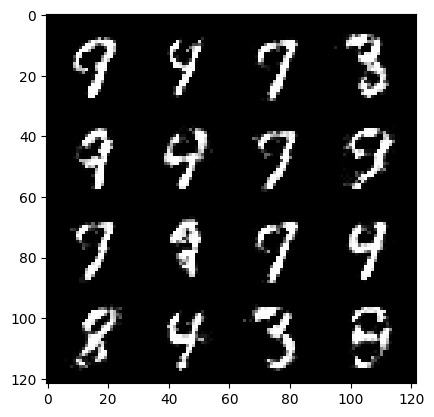

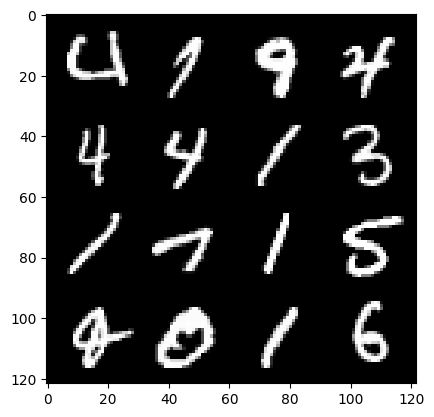

 58%|█████▊    | 271/469 [00:05<00:05, 35.00it/s]

144: step 67800 / Gen loss: 2.8844987146059675 / disc_loss: 0.18819178298115727


 20%|██        | 94/469 [00:01<00:06, 55.43it/s]

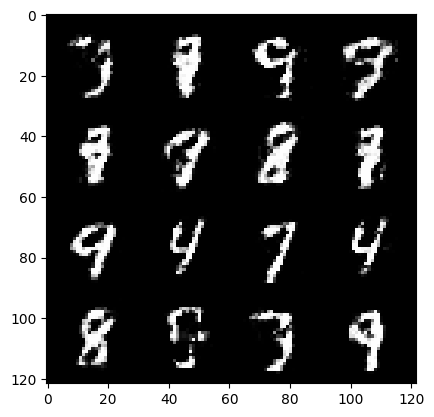

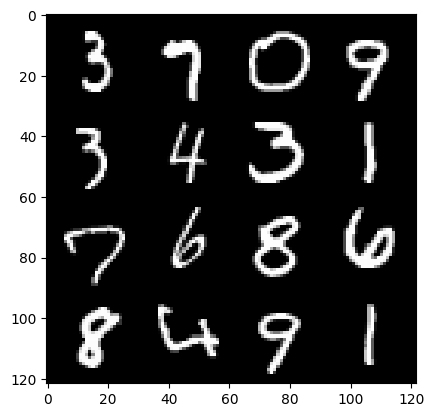

 21%|██▏       | 100/469 [00:01<00:10, 36.76it/s]

145: step 68100 / Gen loss: 2.78332762638728 / disc_loss: 0.17810938368240994


 84%|████████▍ | 393/469 [00:06<00:01, 66.88it/s]

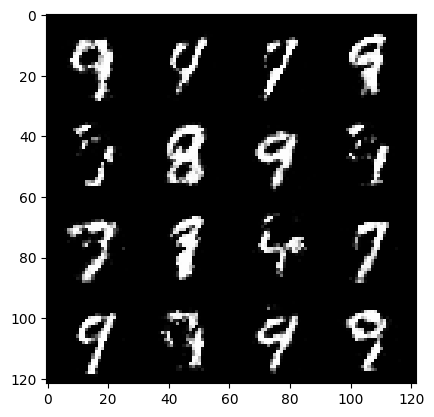

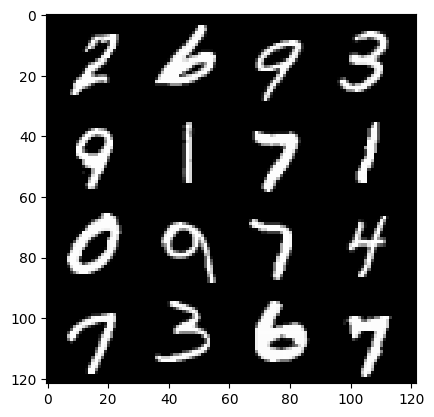

 85%|████████▌ | 400/469 [00:07<00:01, 38.30it/s]

145: step 68400 / Gen loss: 2.6014615321159376 / disc_loss: 0.22188112542033195


 48%|████▊     | 223/469 [00:03<00:04, 58.34it/s]

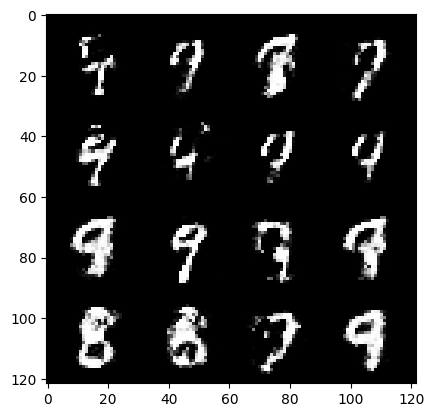

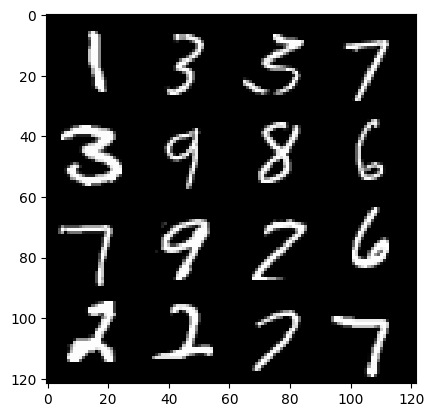

 50%|████▉     | 234/469 [00:04<00:06, 37.04it/s]

146: step 68700 / Gen loss: 2.6615455993016575 / disc_loss: 0.2030176066358884


 12%|█▏        | 55/469 [00:00<00:06, 61.36it/s]

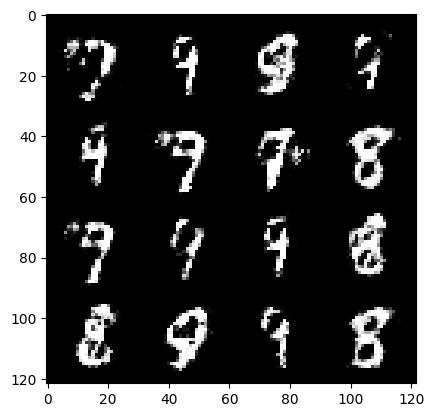

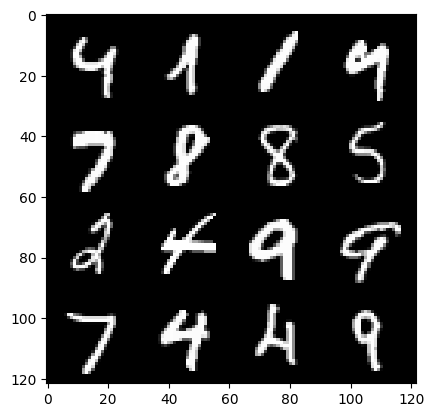

 13%|█▎        | 62/469 [00:01<00:10, 38.68it/s]

147: step 69000 / Gen loss: 2.652314181327819 / disc_loss: 0.19534839006761714


 75%|███████▌  | 352/469 [00:06<00:01, 65.66it/s]

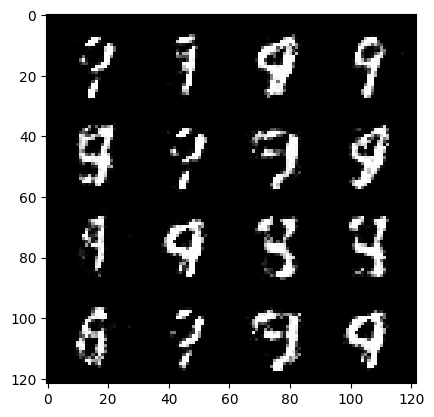

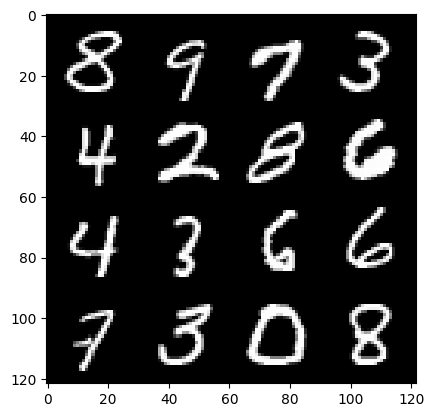

 78%|███████▊  | 365/469 [00:06<00:02, 42.80it/s]

147: step 69300 / Gen loss: 2.7790653626124073 / disc_loss: 0.18621865237752602


 39%|███▉      | 184/469 [00:03<00:04, 64.73it/s]

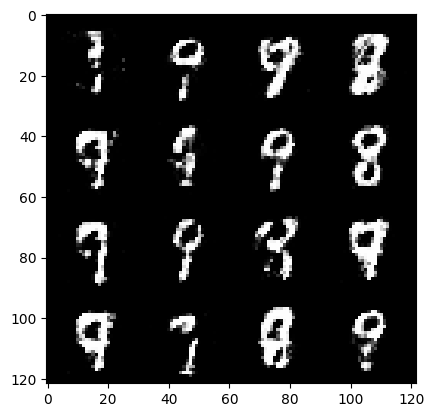

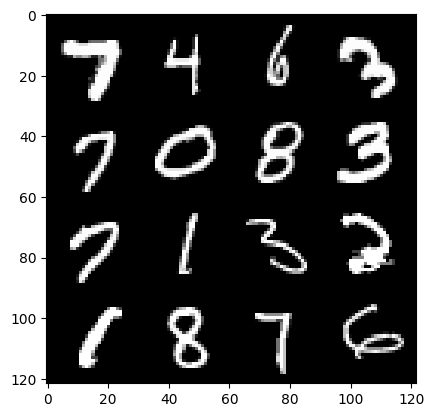

 42%|████▏     | 197/469 [00:03<00:06, 40.33it/s]

148: step 69600 / Gen loss: 2.797217382589976 / disc_loss: 0.173519021992882


  3%|▎         | 13/469 [00:00<00:07, 62.46it/s]

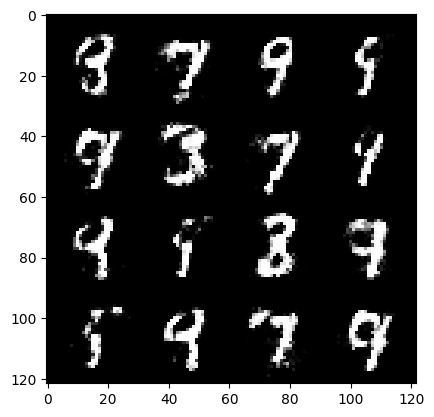

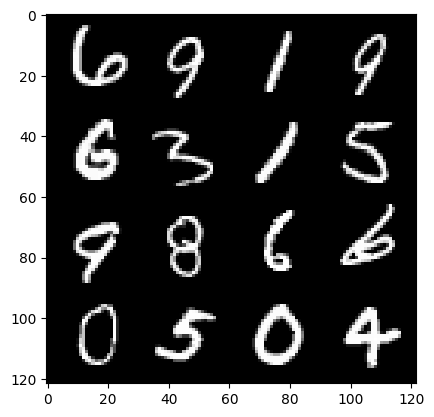

  5%|▌         | 25/469 [00:00<00:12, 34.48it/s]

149: step 69900 / Gen loss: 2.772833038965859 / disc_loss: 0.1968877756347258


 68%|██████▊   | 318/469 [00:05<00:02, 56.15it/s]

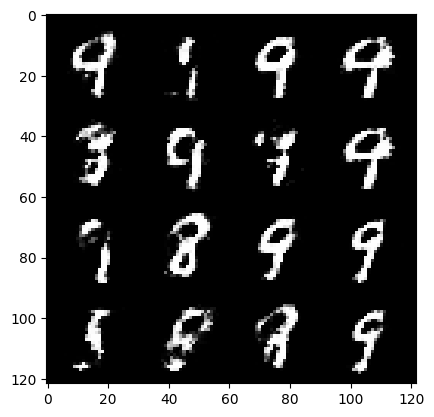

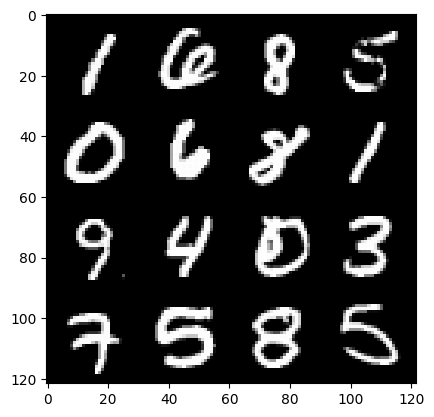

 69%|██████▉   | 324/469 [00:06<00:04, 35.62it/s]

149: step 70200 / Gen loss: 2.695328256686528 / disc_loss: 0.20073574202756078


 32%|███▏      | 150/469 [00:02<00:04, 66.13it/s]

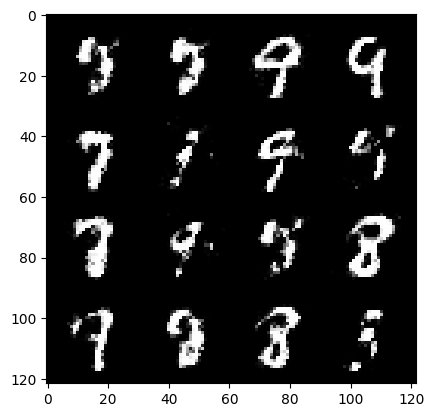

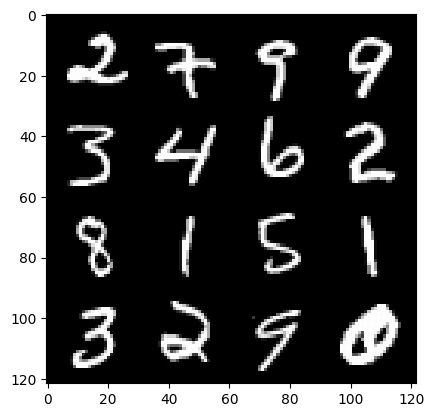

 33%|███▎      | 157/469 [00:02<00:07, 40.60it/s]

150: step 70500 / Gen loss: 2.7541208545366938 / disc_loss: 0.19525145026544732


 95%|█████████▌| 447/469 [00:07<00:00, 60.10it/s]

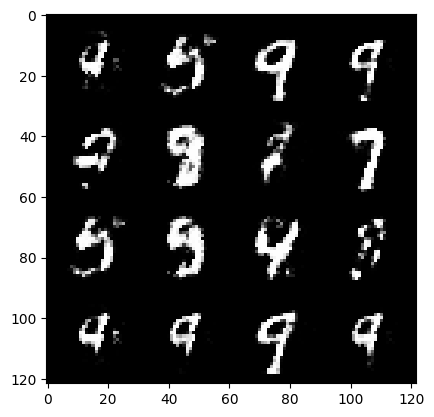

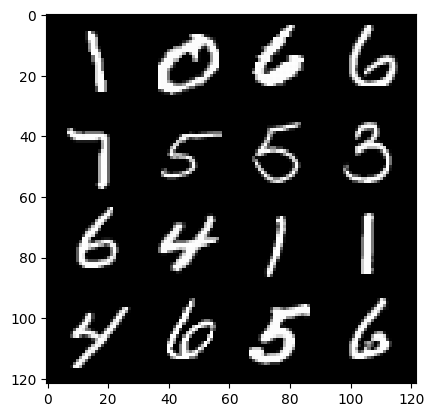

 97%|█████████▋| 454/469 [00:08<00:00, 36.49it/s]

150: step 70800 / Gen loss: 2.68583341439565 / disc_loss: 0.1961210975795983


 59%|█████▉    | 279/469 [00:04<00:02, 65.92it/s]

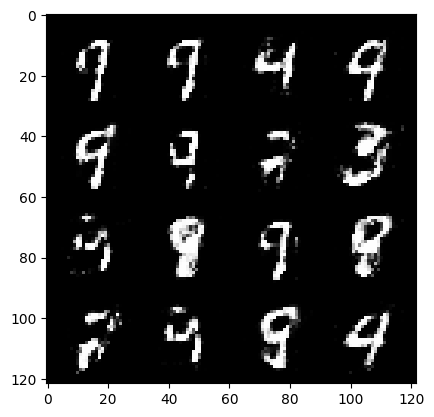

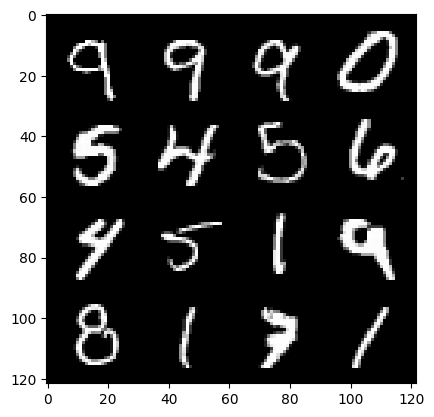

 61%|██████    | 286/469 [00:04<00:04, 42.27it/s]

151: step 71100 / Gen loss: 2.573479201793669 / disc_loss: 0.2162142359217006


 23%|██▎       | 109/469 [00:01<00:06, 53.41it/s]

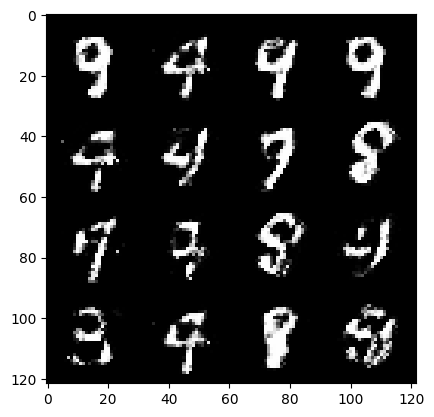

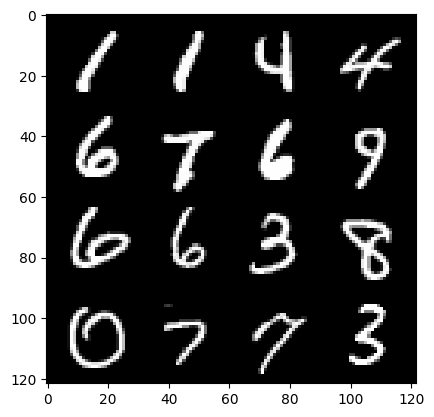

 26%|██▌       | 120/469 [00:02<00:09, 36.68it/s]

152: step 71400 / Gen loss: 2.543444851239522 / disc_loss: 0.21223561103145272


 86%|████████▋ | 405/469 [00:06<00:00, 64.64it/s]

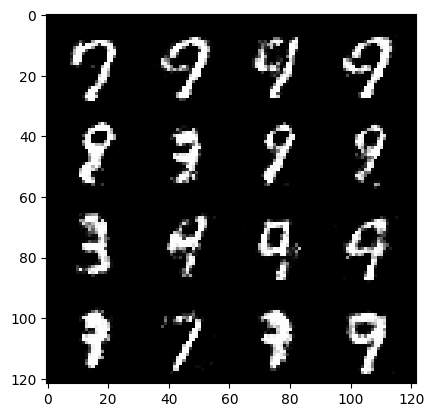

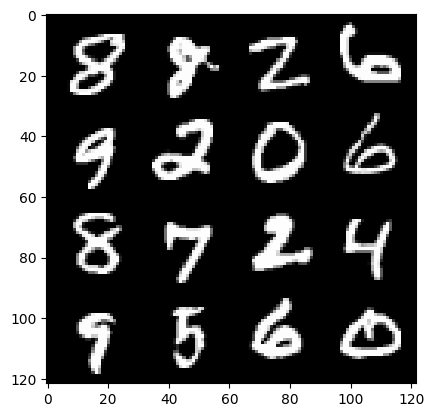

 89%|████████▉ | 419/469 [00:07<00:01, 44.58it/s]

152: step 71700 / Gen loss: 2.689768773714702 / disc_loss: 0.19584788136184222


 51%|█████     | 240/469 [00:04<00:03, 57.97it/s]

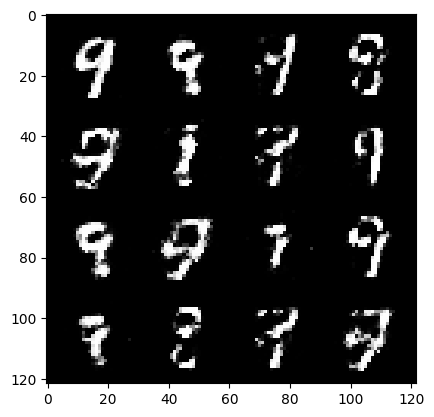

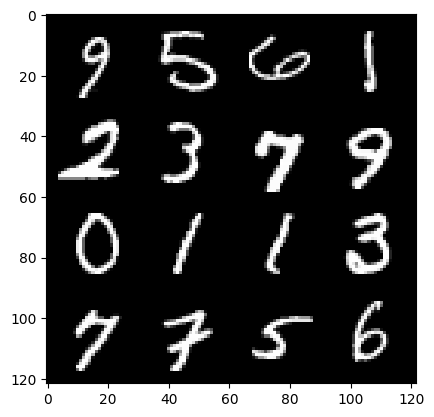

 54%|█████▎    | 251/469 [00:04<00:05, 36.93it/s]

153: step 72000 / Gen loss: 2.7857645114262892 / disc_loss: 0.18506730151673156


 16%|█▌        | 73/469 [00:01<00:06, 62.35it/s]

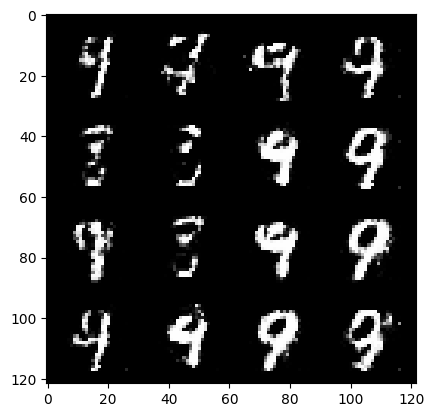

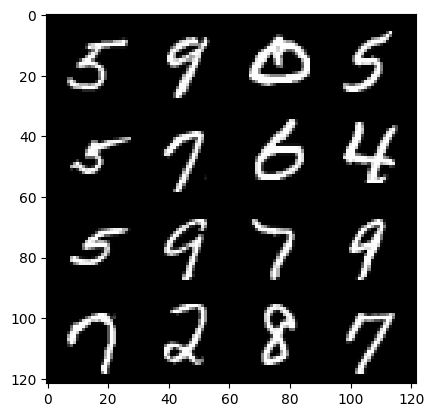

 17%|█▋        | 80/469 [00:01<00:10, 36.92it/s]

154: step 72300 / Gen loss: 2.7279128781954456 / disc_loss: 0.20416687272489076


 79%|███████▉  | 371/469 [00:06<00:01, 58.62it/s]

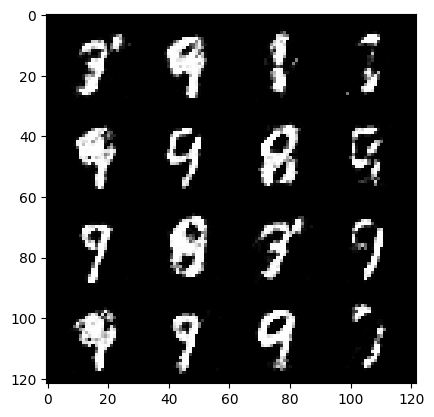

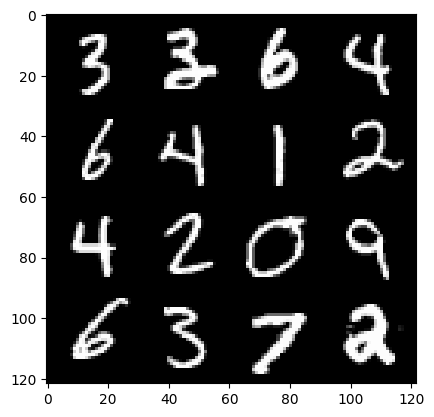

 81%|████████▏ | 382/469 [00:07<00:02, 38.97it/s]

154: step 72600 / Gen loss: 2.689790660540263 / disc_loss: 0.2020645584911108


 43%|████▎     | 203/469 [00:03<00:04, 60.40it/s]

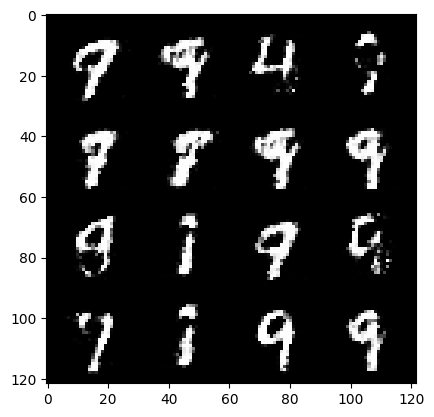

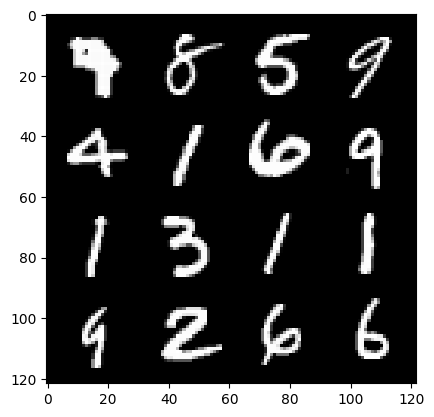

 45%|████▍     | 210/469 [00:03<00:06, 40.11it/s]

155: step 72900 / Gen loss: 2.6742691588401812 / disc_loss: 0.19707253570357955


  7%|▋         | 35/469 [00:00<00:06, 62.91it/s]

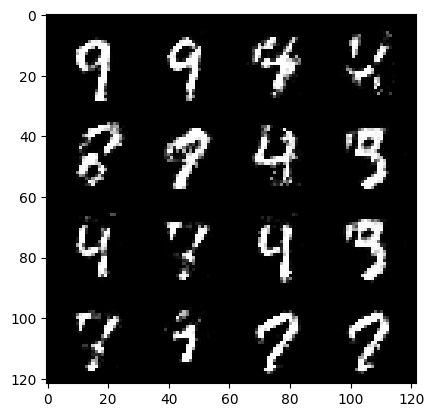

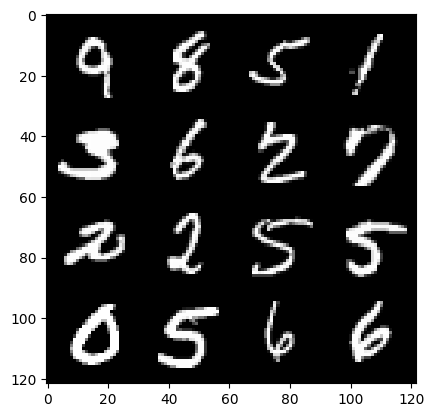

  9%|▉         | 42/469 [00:00<00:11, 36.53it/s]

156: step 73200 / Gen loss: 2.8883575932184855 / disc_loss: 0.17416025181611375


 71%|███████   | 332/469 [00:05<00:02, 66.44it/s]

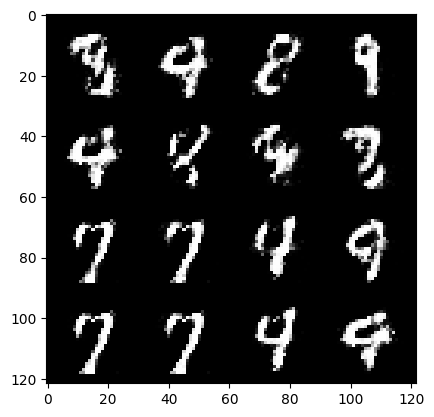

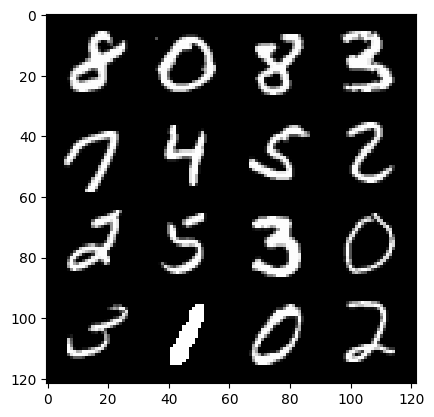

 72%|███████▏  | 339/469 [00:05<00:03, 40.86it/s]

156: step 73500 / Gen loss: 2.695932460625967 / disc_loss: 0.20950218146045996


 34%|███▍      | 160/469 [00:02<00:05, 58.05it/s]

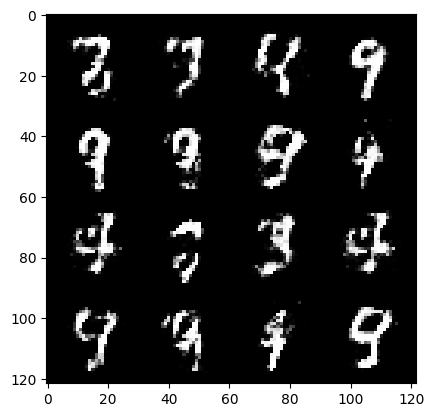

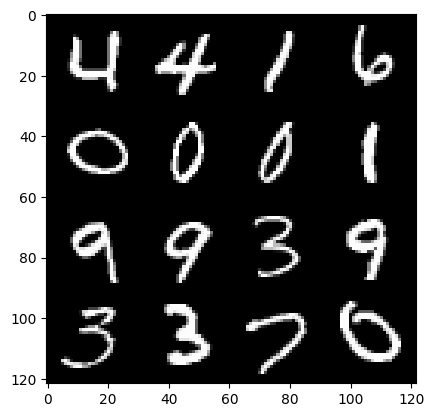

 37%|███▋      | 173/469 [00:03<00:07, 39.11it/s]

157: step 73800 / Gen loss: 2.687563338279722 / disc_loss: 0.20558531309167538


 98%|█████████▊| 460/469 [00:07<00:00, 69.58it/s]

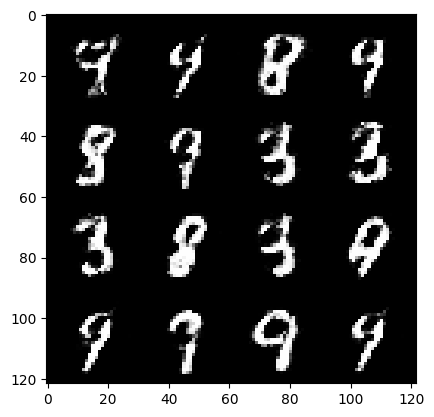

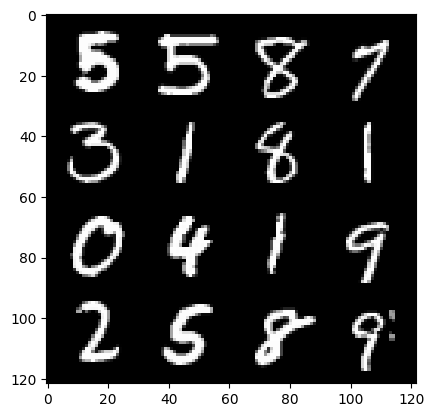

100%|██████████| 469/469 [00:08<00:00, 58.48it/s]


157: step 74100 / Gen loss: 2.67555776834488 / disc_loss: 0.2077506866306067


 63%|██████▎   | 295/469 [00:04<00:02, 71.19it/s]

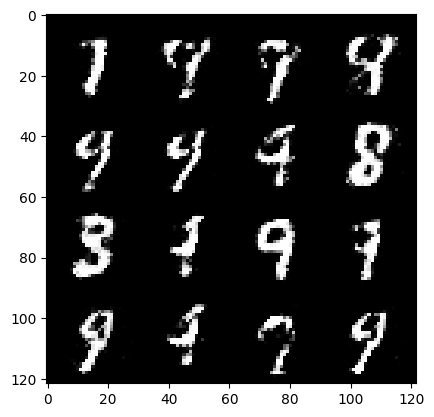

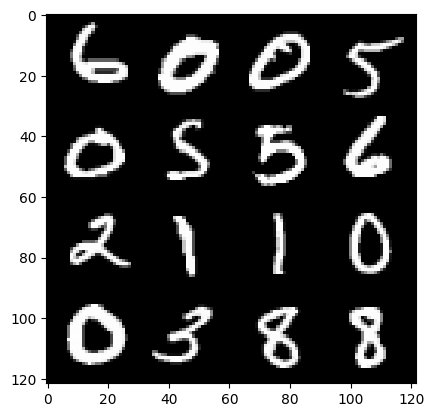

 65%|██████▍   | 303/469 [00:05<00:04, 36.99it/s]

158: step 74400 / Gen loss: 2.676618375778197 / disc_loss: 0.19491923925777283


 27%|██▋       | 127/469 [00:02<00:05, 63.13it/s]

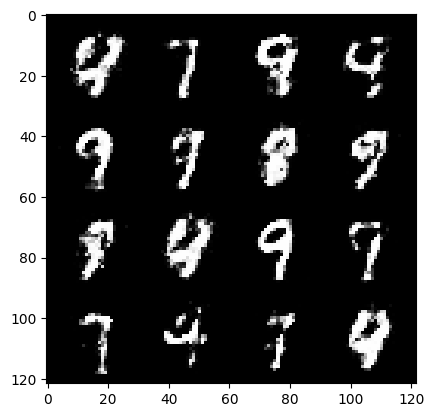

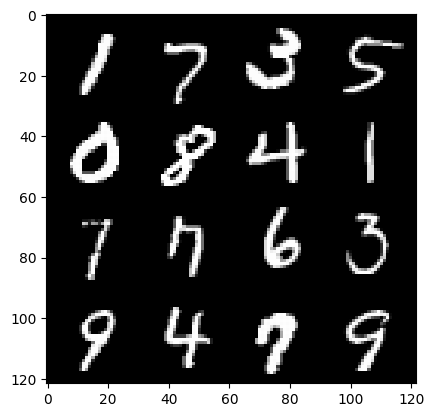

 29%|██▊       | 134/469 [00:02<00:08, 40.31it/s]

159: step 74700 / Gen loss: 2.5519421784083063 / disc_loss: 0.21296921240786712


 91%|█████████ | 426/469 [00:07<00:00, 55.41it/s]

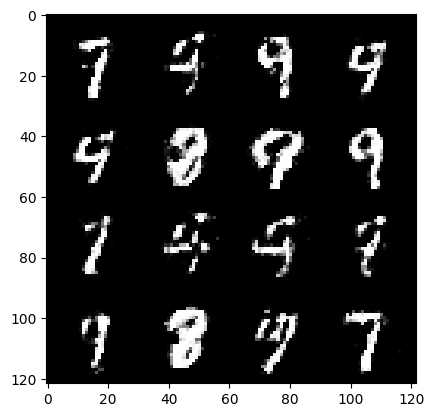

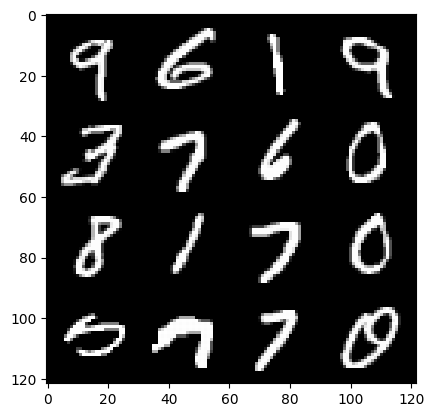

 93%|█████████▎| 437/469 [00:07<00:00, 38.15it/s]

159: step 75000 / Gen loss: 2.431091931660971 / disc_loss: 0.22412411550680797


 55%|█████▍    | 256/469 [00:04<00:03, 56.78it/s]

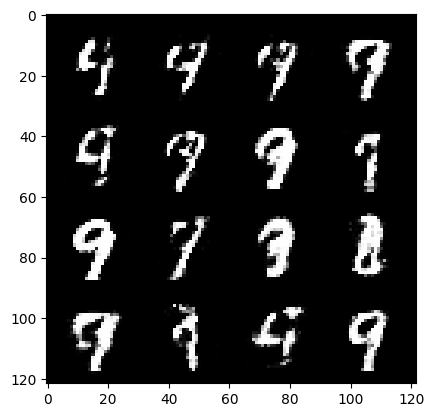

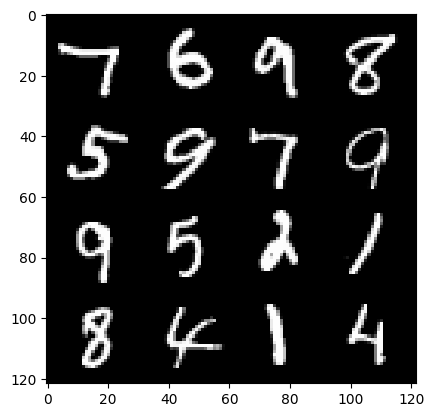

 57%|█████▋    | 267/469 [00:04<00:05, 38.84it/s]

160: step 75300 / Gen loss: 2.459352744420367 / disc_loss: 0.23546812420090035


 19%|█▉        | 91/469 [00:01<00:06, 58.60it/s]

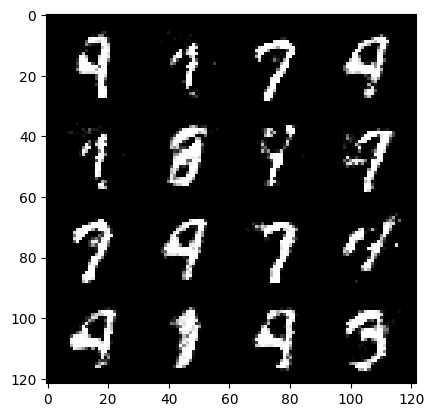

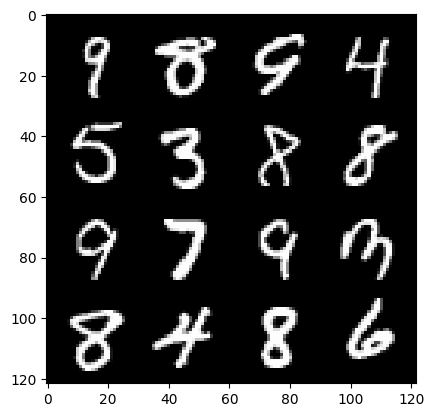

 21%|██        | 97/469 [00:01<00:10, 36.79it/s]

161: step 75600 / Gen loss: 2.5060461652278896 / disc_loss: 0.20171029344201072


 83%|████████▎ | 388/469 [00:06<00:01, 61.75it/s]

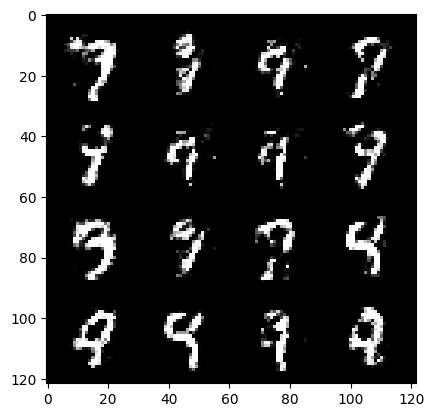

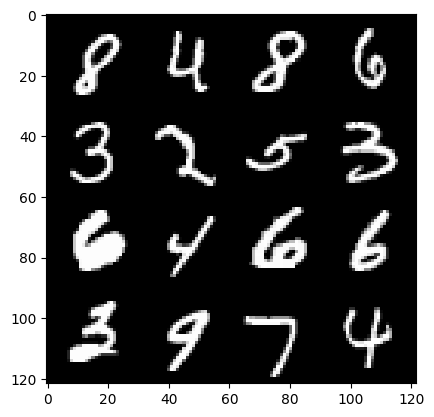

 85%|████████▌ | 400/469 [00:07<00:01, 40.03it/s]

161: step 75900 / Gen loss: 2.5498561930656436 / disc_loss: 0.21270765081048026


 47%|████▋     | 219/469 [00:03<00:04, 55.07it/s]

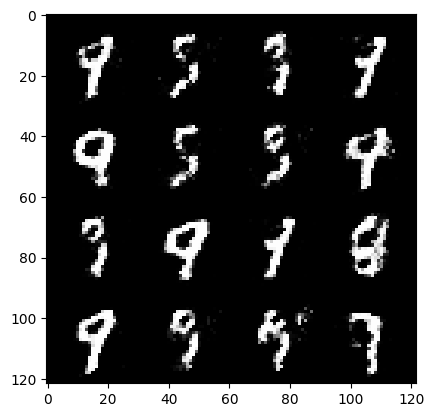

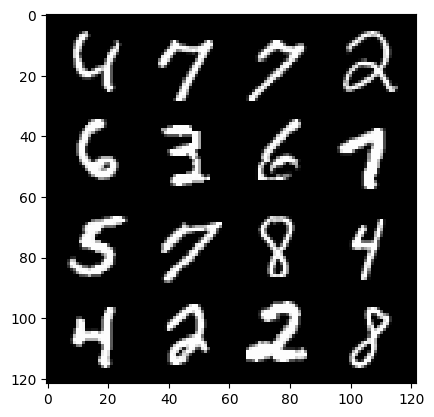

 49%|████▉     | 230/469 [00:04<00:06, 34.41it/s]

162: step 76200 / Gen loss: 2.549449152151743 / disc_loss: 0.2195809405048689


 11%|█         | 52/469 [00:00<00:06, 67.24it/s]

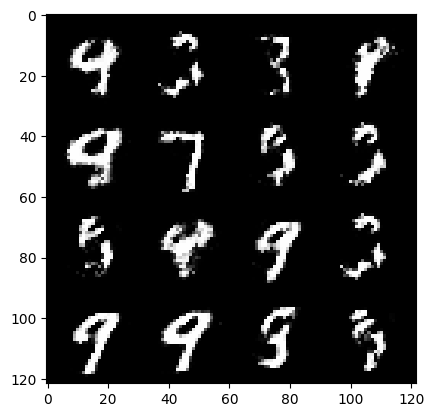

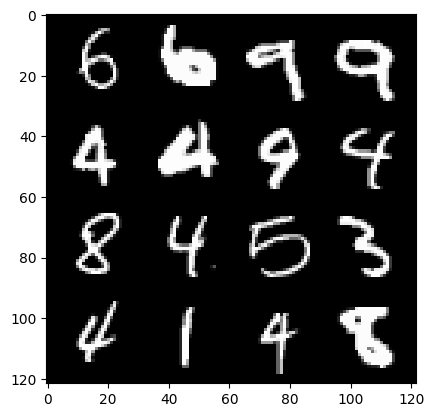

 13%|█▎        | 59/469 [00:01<00:10, 38.25it/s]

163: step 76500 / Gen loss: 2.4463036493460346 / disc_loss: 0.22970627422134088


 75%|███████▌  | 353/469 [00:06<00:01, 64.16it/s]

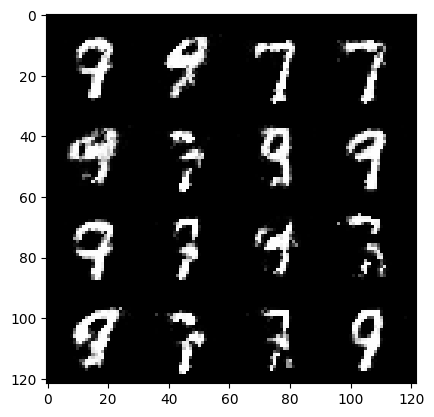

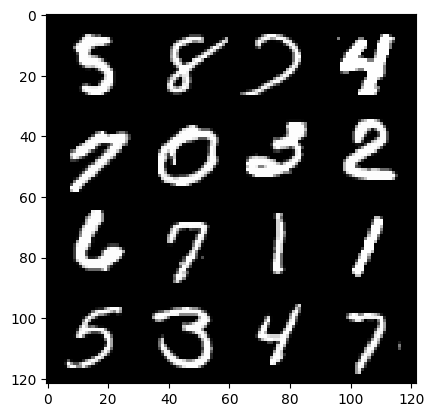

 77%|███████▋  | 360/469 [00:06<00:02, 37.18it/s]

163: step 76800 / Gen loss: 2.675584216912587 / disc_loss: 0.19433654087285204


 39%|███▉      | 182/469 [00:02<00:04, 59.79it/s]

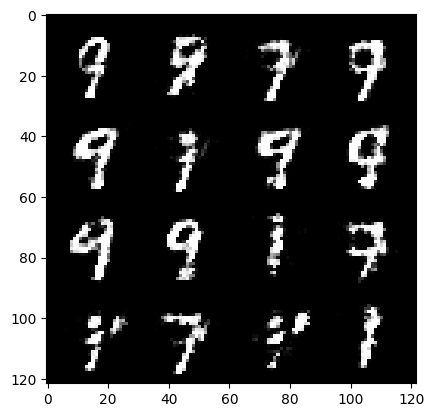

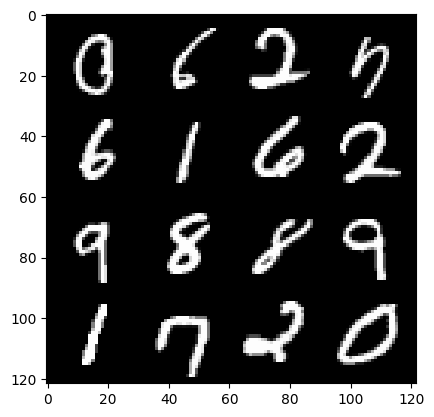

 40%|████      | 189/469 [00:03<00:07, 37.13it/s]

164: step 77100 / Gen loss: 2.673740743796031 / disc_loss: 0.20520729189117762


  3%|▎         | 13/469 [00:00<00:07, 59.74it/s]

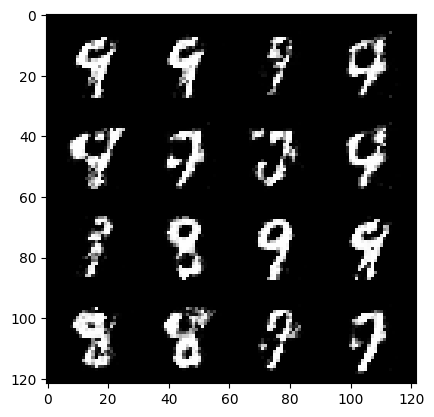

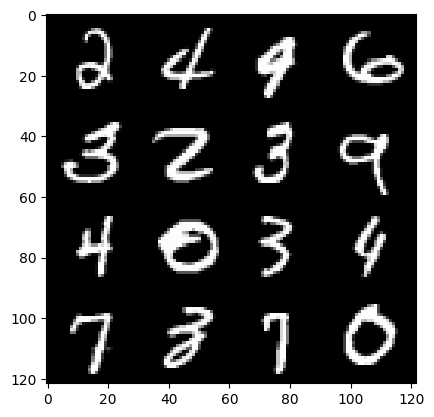

  4%|▍         | 19/469 [00:00<00:14, 30.38it/s]

165: step 77400 / Gen loss: 2.5022363559404988 / disc_loss: 0.22170686043798915


 66%|██████▌   | 309/469 [00:05<00:02, 55.91it/s]

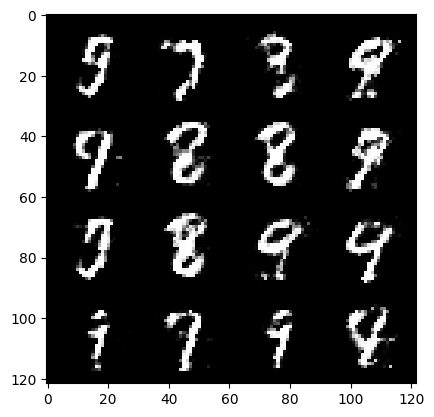

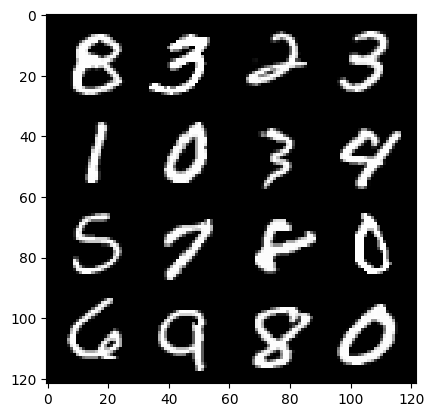

 68%|██████▊   | 321/469 [00:05<00:03, 42.39it/s]

165: step 77700 / Gen loss: 2.575285360018412 / disc_loss: 0.20985863710443184


 30%|███       | 141/469 [00:02<00:06, 54.34it/s]

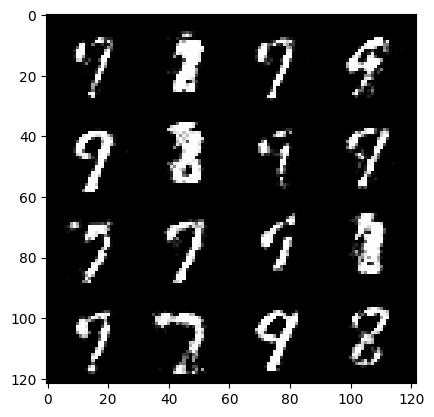

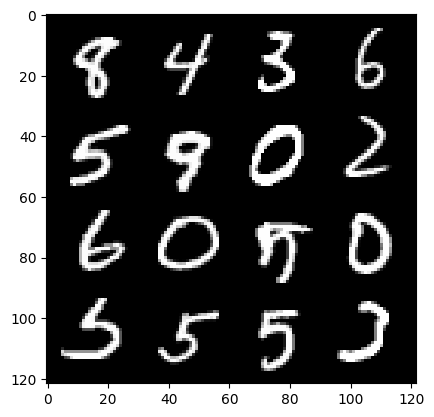

 32%|███▏      | 152/469 [00:02<00:07, 40.65it/s]

166: step 78000 / Gen loss: 2.5229588007926953 / disc_loss: 0.21964740167061478


 94%|█████████▍| 441/469 [00:08<00:00, 55.21it/s]

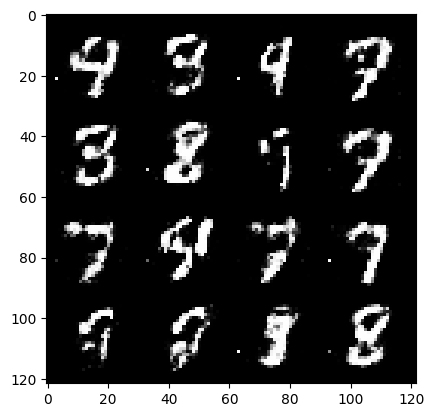

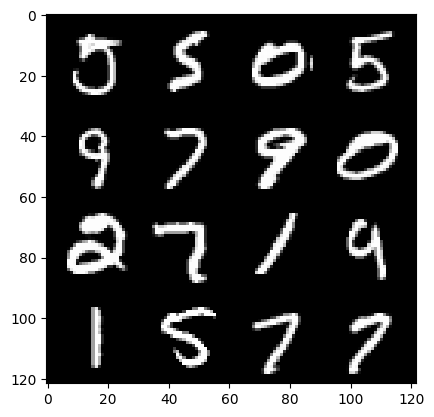

 96%|█████████▋| 452/469 [00:08<00:00, 37.41it/s]

166: step 78300 / Gen loss: 2.3514622223377226 / disc_loss: 0.29007090618213005


 59%|█████▉    | 277/469 [00:04<00:03, 62.95it/s]

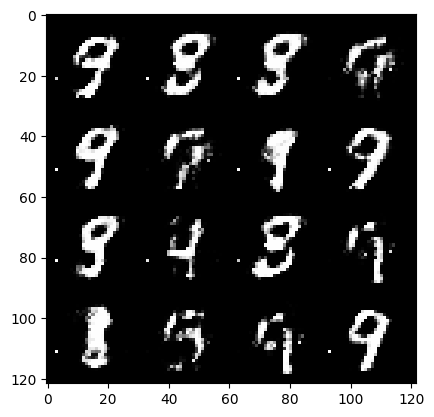

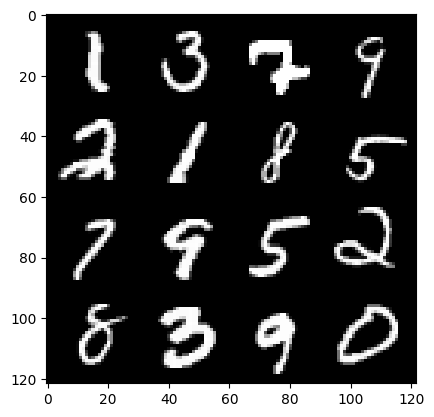

 61%|██████    | 284/469 [00:05<00:04, 41.06it/s]

167: step 78600 / Gen loss: 2.1640158597628276 / disc_loss: 0.2822695836176476


 23%|██▎       | 107/469 [00:02<00:06, 54.94it/s]

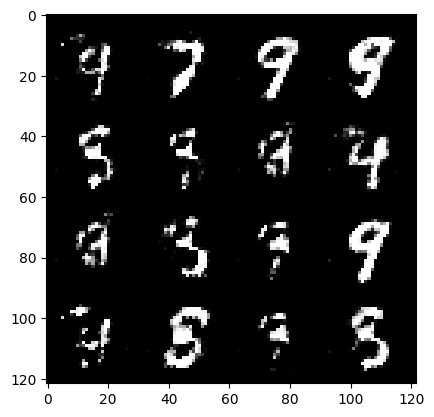

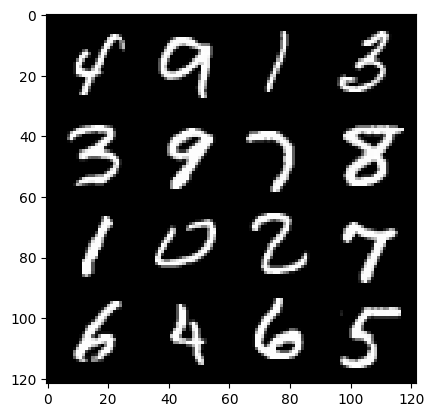

 24%|██▍       | 113/469 [00:02<00:10, 35.05it/s]

168: step 78900 / Gen loss: 2.7896348492304504 / disc_loss: 0.1664785105983418


 86%|████████▋ | 405/469 [00:07<00:00, 64.54it/s]

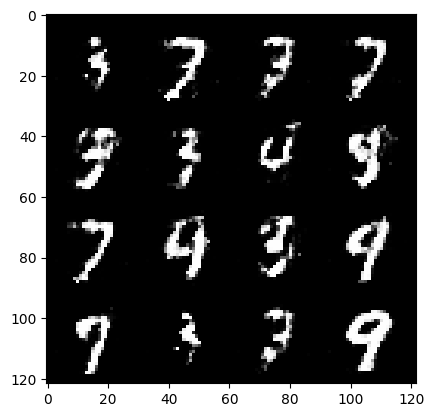

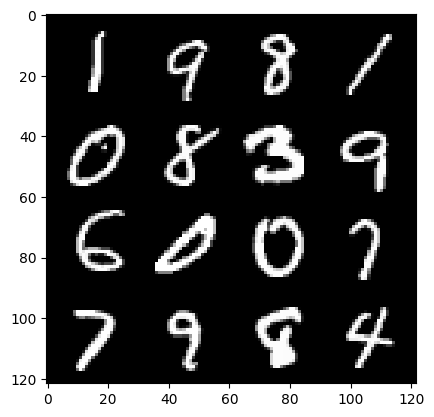

 88%|████████▊ | 412/469 [00:07<00:01, 37.84it/s]

168: step 79200 / Gen loss: 2.695612637996672 / disc_loss: 0.1865389572083951


 51%|█████     | 237/469 [00:04<00:04, 56.84it/s]

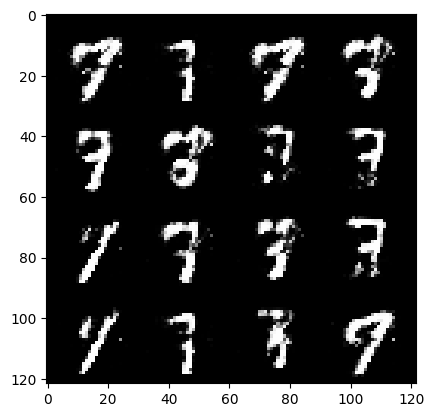

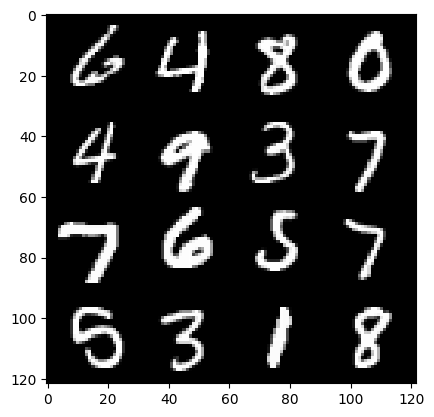

 52%|█████▏    | 243/469 [00:04<00:07, 30.41it/s]

169: step 79500 / Gen loss: 2.5611175092061353 / disc_loss: 0.21863703638315185


 14%|█▍        | 68/469 [00:01<00:06, 61.02it/s]

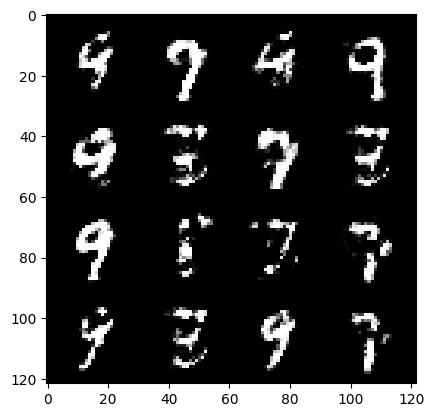

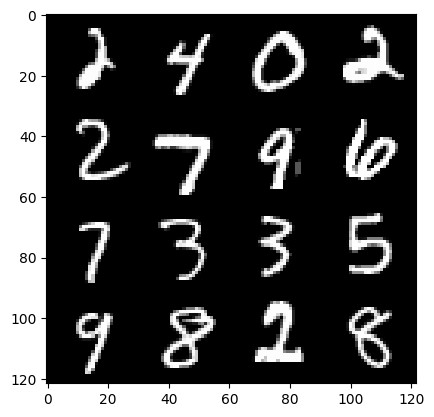

 16%|█▌        | 75/469 [00:01<00:10, 36.21it/s]

170: step 79800 / Gen loss: 2.4474365766843174 / disc_loss: 0.22287657419840493


 78%|███████▊  | 368/469 [00:06<00:01, 56.90it/s]

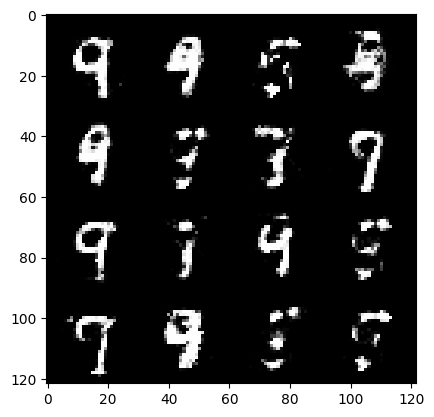

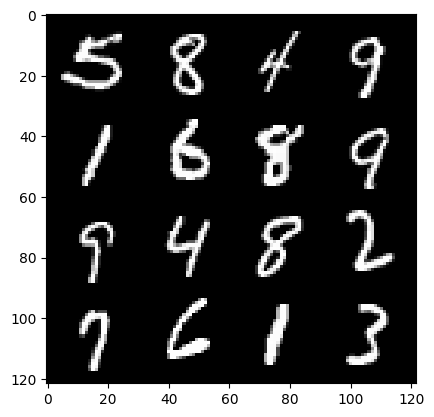

 81%|████████  | 379/469 [00:07<00:02, 40.22it/s]

170: step 80100 / Gen loss: 2.5314866371949485 / disc_loss: 0.21521834462881076


 42%|████▏     | 198/469 [00:03<00:04, 54.65it/s]

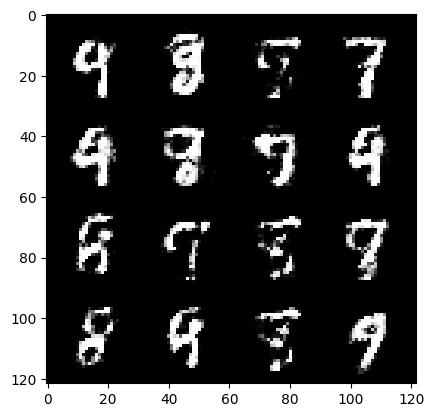

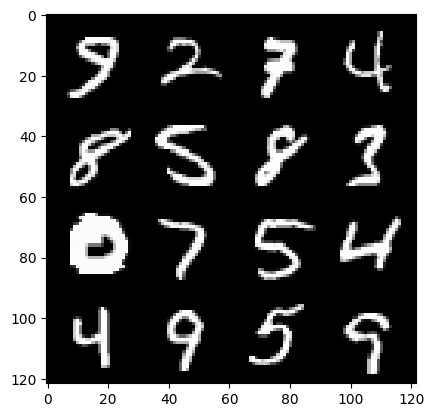

 45%|████▍     | 209/469 [00:03<00:07, 35.63it/s]

171: step 80400 / Gen loss: 2.3414126018683104 / disc_loss: 0.23272481503586


  7%|▋         | 31/469 [00:00<00:06, 66.01it/s]

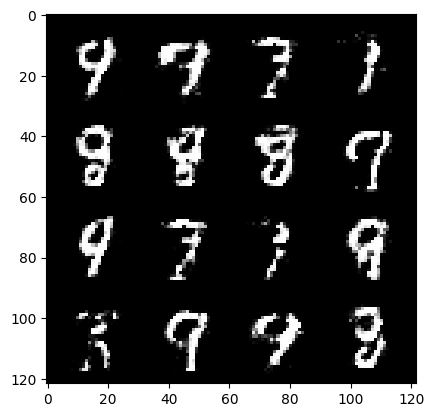

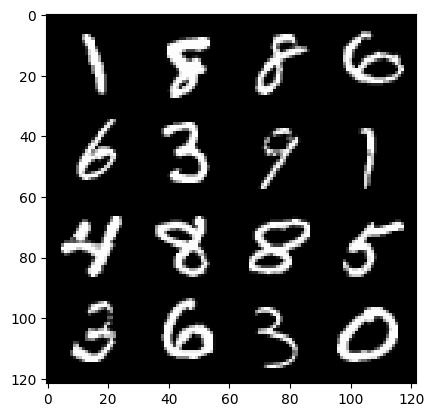

  8%|▊         | 38/469 [00:00<00:10, 42.42it/s]

172: step 80700 / Gen loss: 2.4740992720921837 / disc_loss: 0.2077204208324353


 70%|███████   | 330/469 [00:05<00:02, 58.28it/s]

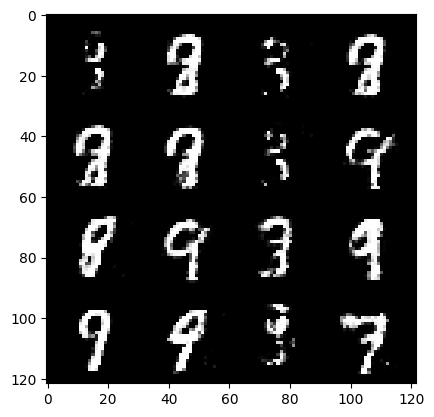

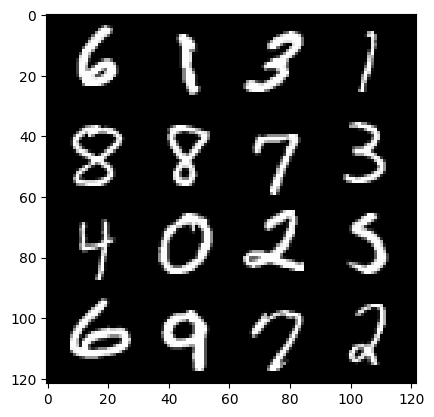

 72%|███████▏  | 336/469 [00:06<00:03, 35.34it/s]

172: step 81000 / Gen loss: 2.5702795759836823 / disc_loss: 0.20757880161205952


 33%|███▎      | 157/469 [00:02<00:04, 65.49it/s]

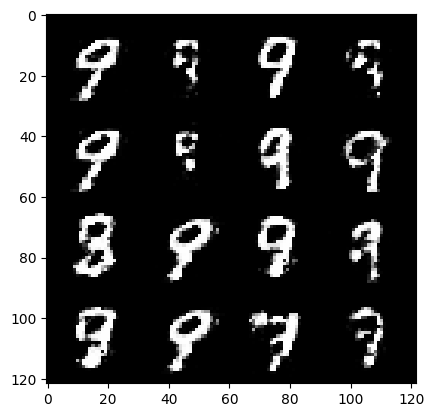

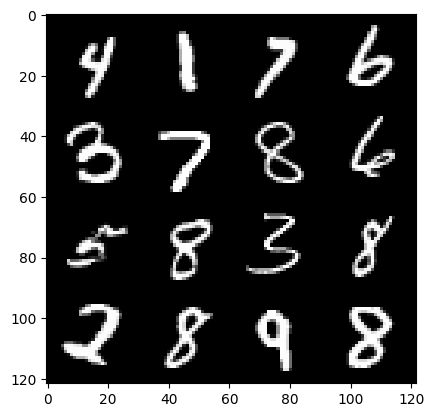

 36%|███▌      | 170/469 [00:02<00:06, 45.40it/s]

173: step 81300 / Gen loss: 2.483888518015544 / disc_loss: 0.210636683156093


 97%|█████████▋| 457/469 [00:06<00:00, 68.16it/s]

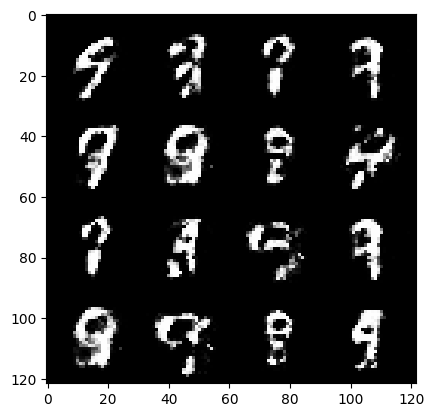

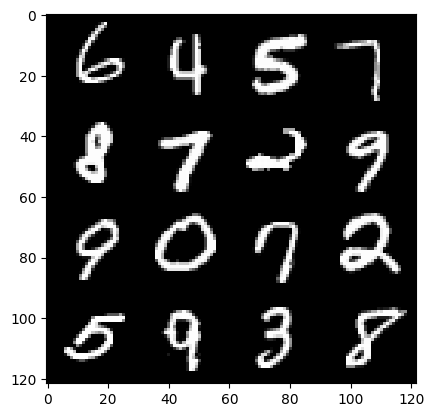

100%|██████████| 469/469 [00:07<00:00, 63.13it/s]


173: step 81600 / Gen loss: 2.3835820817947395 / disc_loss: 0.22972609688838322


 61%|██████▏   | 288/469 [00:04<00:03, 57.92it/s]

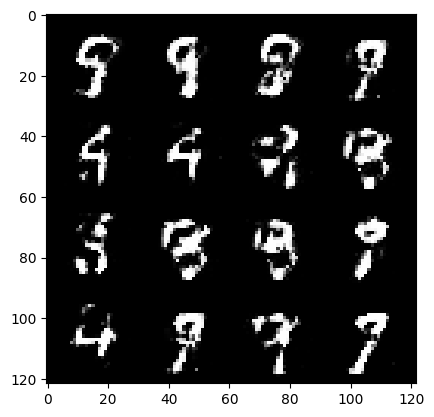

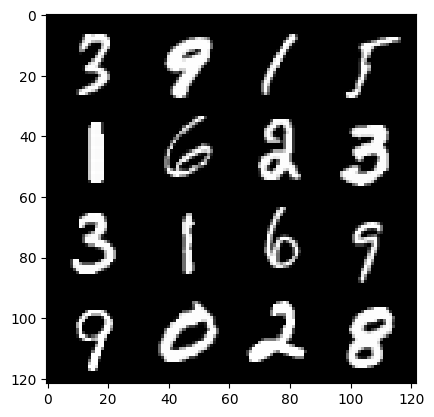

 64%|██████▍   | 300/469 [00:05<00:04, 41.17it/s]

174: step 81900 / Gen loss: 2.439525299469628 / disc_loss: 0.22283911143740015


 25%|██▌       | 119/469 [00:01<00:05, 66.50it/s]

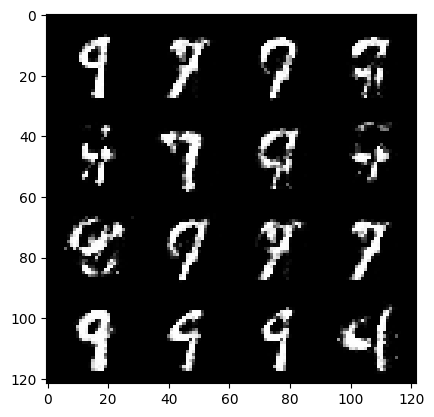

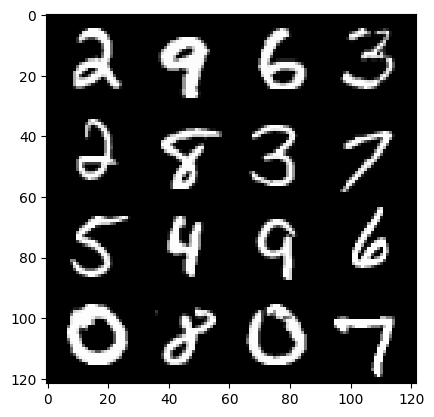

 28%|██▊       | 132/469 [00:02<00:08, 40.55it/s]

175: step 82200 / Gen loss: 2.556365123589835 / disc_loss: 0.21055279458562523


 89%|████████▉ | 419/469 [00:07<00:00, 57.64it/s]

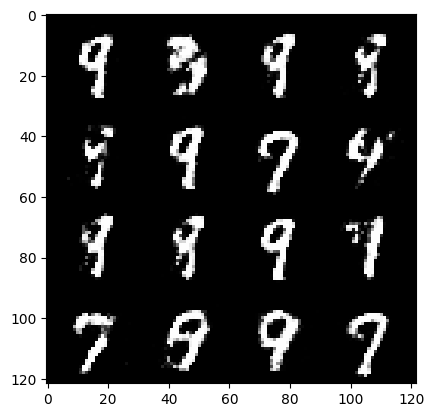

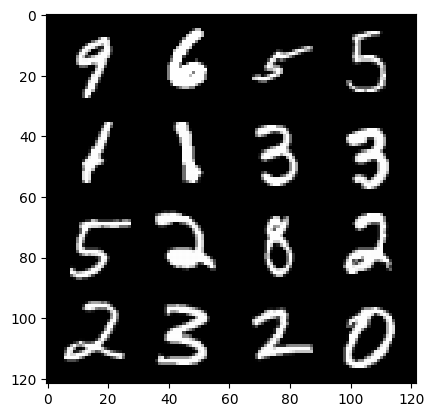

 92%|█████████▏| 432/469 [00:07<00:00, 42.30it/s]

175: step 82500 / Gen loss: 2.5655320239067074 / disc_loss: 0.21638889327645294


 54%|█████▎    | 251/469 [00:03<00:03, 60.37it/s]

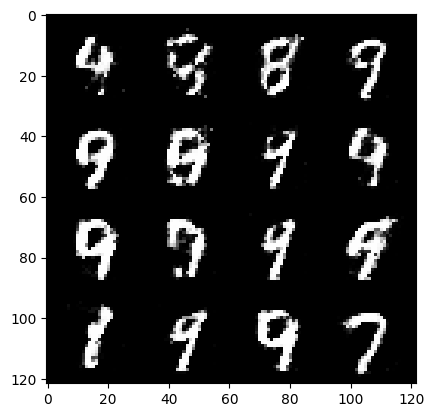

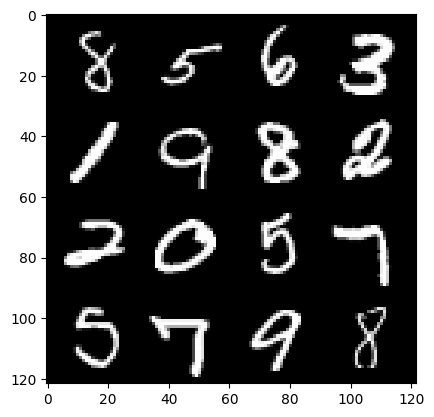

 56%|█████▋    | 264/469 [00:04<00:04, 44.59it/s]

176: step 82800 / Gen loss: 2.4618176472187017 / disc_loss: 0.22546437884370493


 19%|█▊        | 87/469 [00:01<00:05, 72.66it/s]

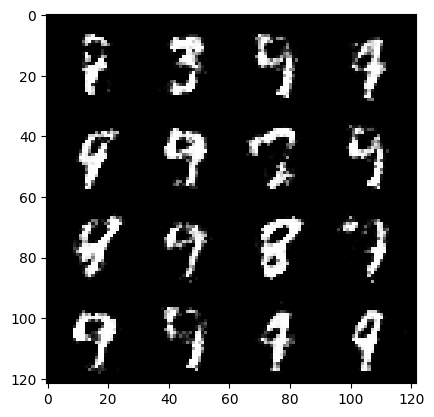

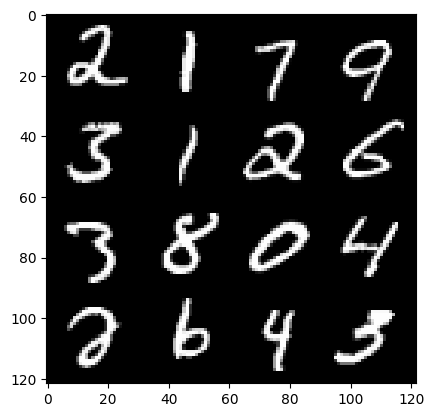

 20%|██        | 95/469 [00:01<00:07, 48.02it/s]

177: step 83100 / Gen loss: 2.3453418632348386 / disc_loss: 0.2536749582489331


 82%|████████▏ | 383/469 [00:06<00:01, 65.36it/s]

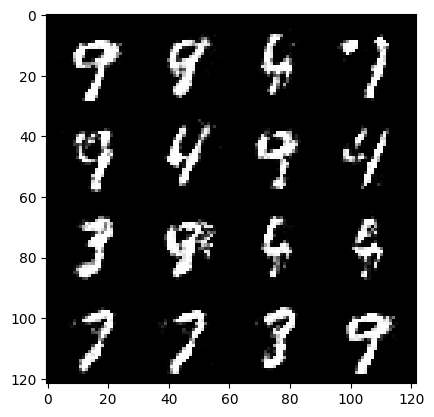

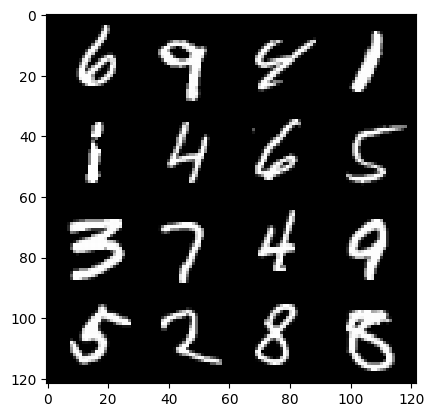

 84%|████████▍ | 396/469 [00:06<00:01, 43.78it/s]

177: step 83400 / Gen loss: 2.2725002113978077 / disc_loss: 0.246062745054563


 46%|████▋     | 218/469 [00:03<00:03, 63.98it/s]

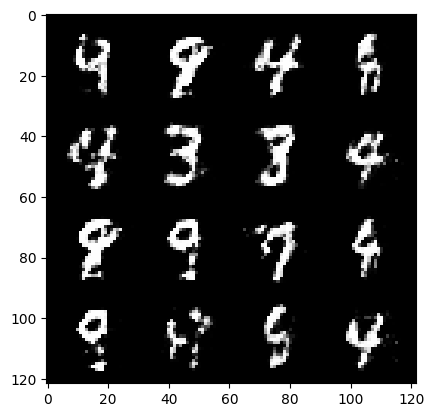

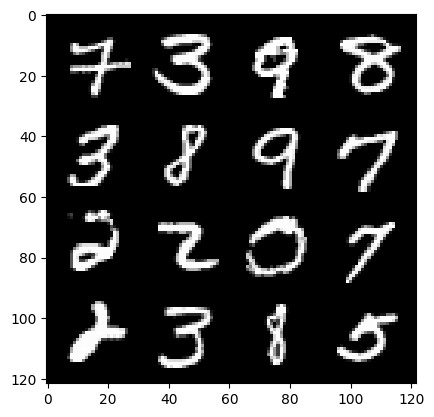

 48%|████▊     | 225/469 [00:03<00:05, 43.15it/s]

178: step 83700 / Gen loss: 2.3116111874580385 / disc_loss: 0.2479884898662567


 10%|▉         | 46/469 [00:00<00:05, 72.76it/s]

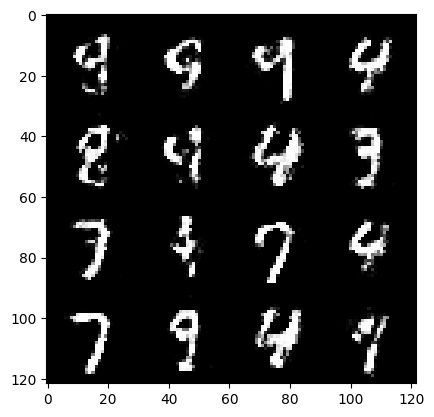

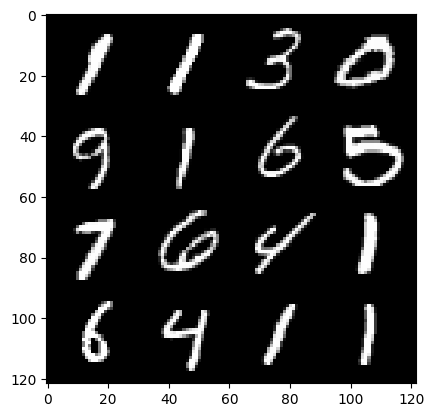

 12%|█▏        | 54/469 [00:00<00:09, 42.59it/s]

179: step 84000 / Gen loss: 2.2256032907962795 / disc_loss: 0.2604279444615046


 73%|███████▎  | 344/469 [00:05<00:01, 63.23it/s]

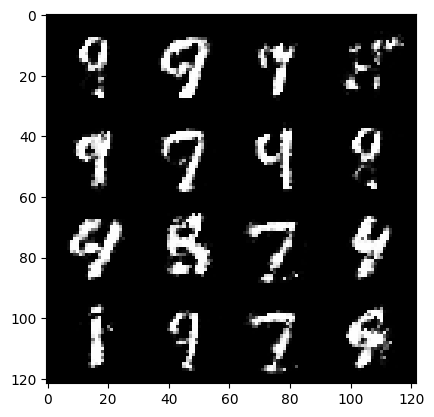

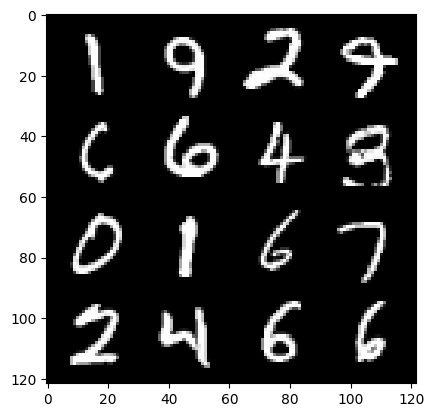

 76%|███████▌  | 357/469 [00:06<00:02, 43.51it/s]

179: step 84300 / Gen loss: 2.3513601696491238 / disc_loss: 0.2402190314233302


 38%|███▊      | 176/469 [00:02<00:04, 66.99it/s]

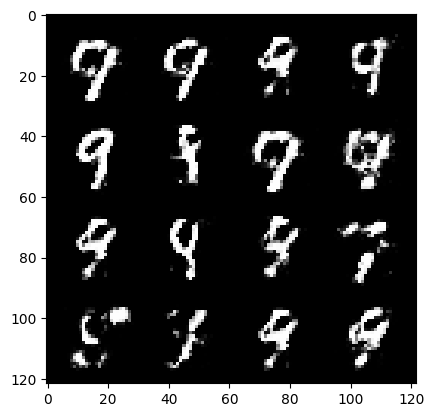

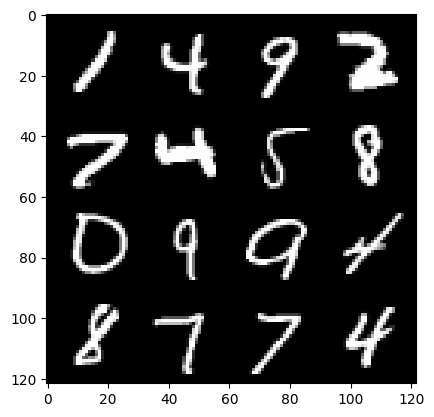

 39%|███▉      | 183/469 [00:03<00:06, 46.93it/s]

180: step 84600 / Gen loss: 2.180911210775375 / disc_loss: 0.27040368298689527


  1%|▏         | 6/469 [00:00<00:08, 55.63it/s]

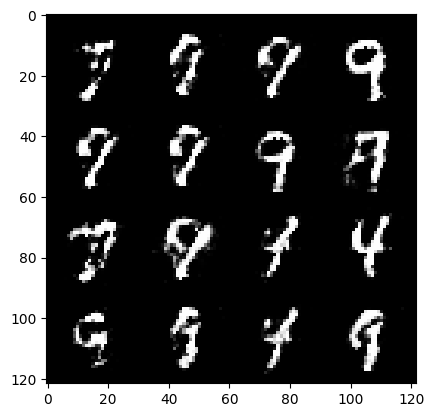

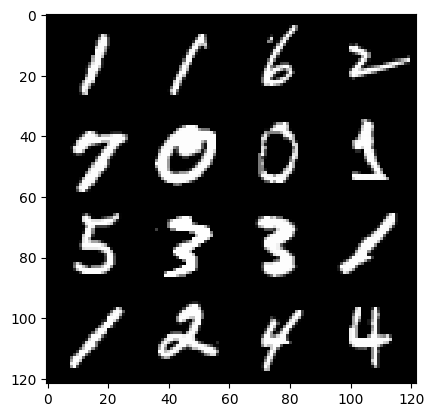

  4%|▍         | 18/469 [00:00<00:11, 37.73it/s]

181: step 84900 / Gen loss: 2.302520346641539 / disc_loss: 0.23302013819416376


 65%|██████▌   | 306/469 [00:04<00:02, 59.96it/s]

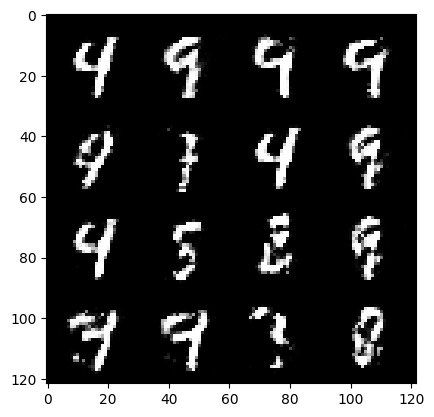

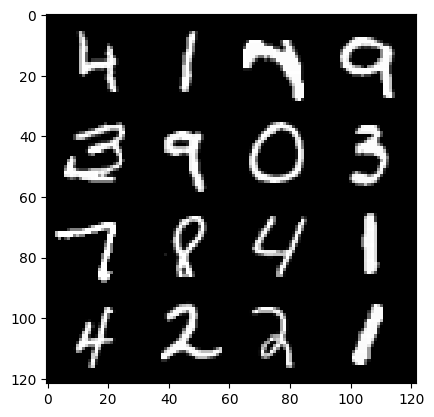

 68%|██████▊   | 318/469 [00:05<00:04, 34.21it/s]

181: step 85200 / Gen loss: 2.3268394279479985 / disc_loss: 0.24071930989623075


 30%|███       | 142/469 [00:02<00:05, 59.12it/s]

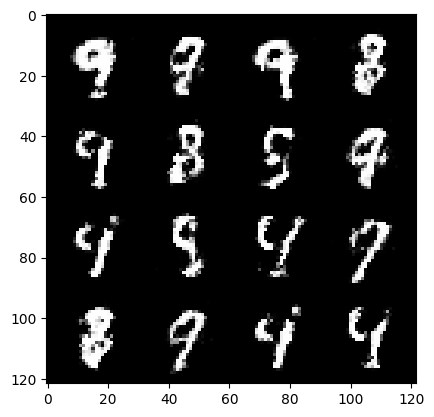

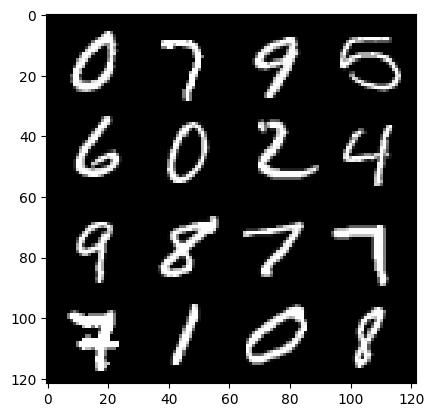

 32%|███▏      | 148/469 [00:02<00:08, 36.60it/s]

182: step 85500 / Gen loss: 2.409459838867187 / disc_loss: 0.22415434608856832


 93%|█████████▎| 436/469 [00:07<00:00, 66.19it/s]

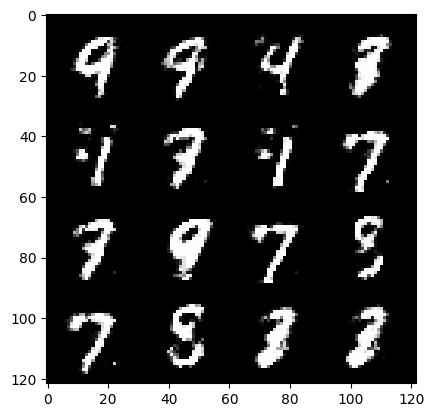

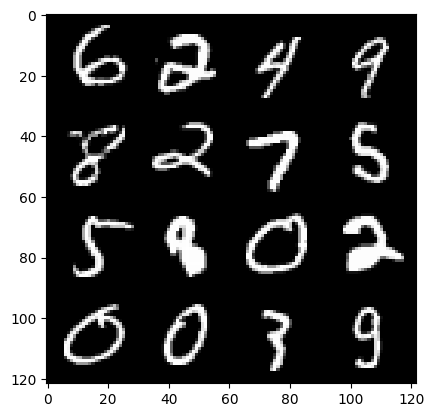

 96%|█████████▌| 449/469 [00:07<00:00, 45.72it/s]

182: step 85800 / Gen loss: 2.284759351809821 / disc_loss: 0.24553781583905226


 58%|█████▊    | 272/469 [00:04<00:02, 68.69it/s]

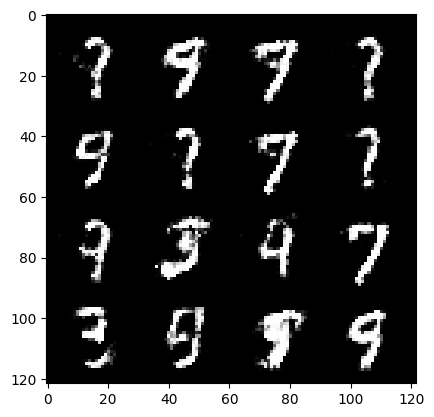

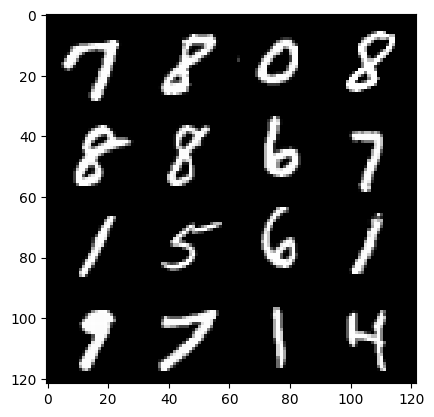

 59%|█████▉    | 279/469 [00:04<00:04, 40.57it/s]

183: step 86100 / Gen loss: 2.2934237865606923 / disc_loss: 0.23573612039287897


 22%|██▏       | 102/469 [00:01<00:05, 66.64it/s]

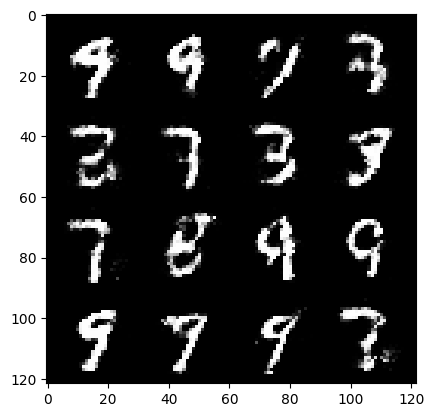

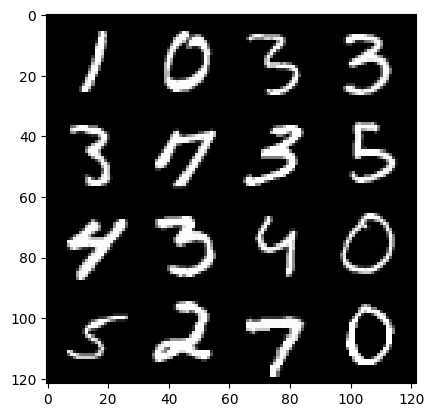

 23%|██▎       | 109/469 [00:01<00:08, 40.77it/s]

184: step 86400 / Gen loss: 2.3257415680090596 / disc_loss: 0.2307346745828787


 86%|████████▌ | 403/469 [00:08<00:01, 48.57it/s]

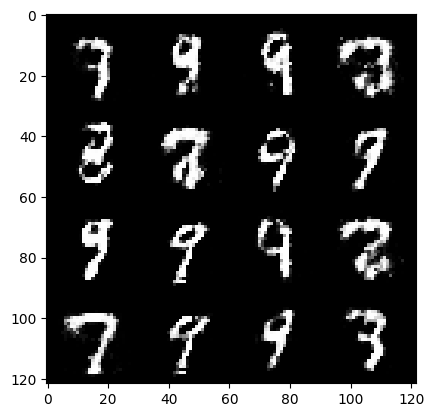

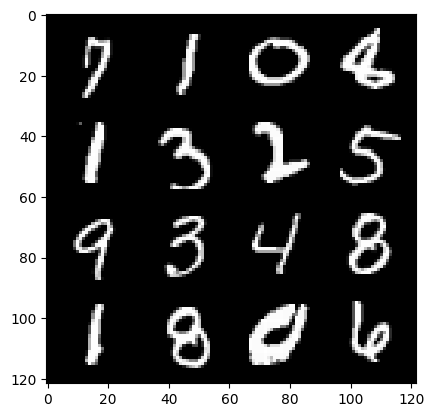

 87%|████████▋ | 408/469 [00:08<00:02, 25.01it/s]

184: step 86700 / Gen loss: 2.459701788425445 / disc_loss: 0.22081072623531017


 49%|████▉     | 231/469 [00:03<00:03, 68.47it/s]

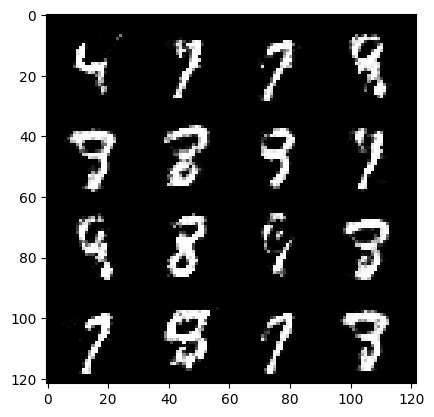

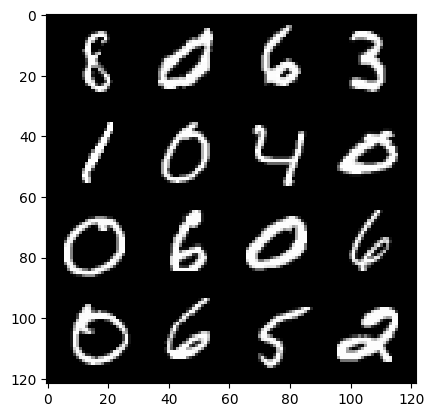

 51%|█████     | 238/469 [00:03<00:05, 44.08it/s]

185: step 87000 / Gen loss: 2.331683270136517 / disc_loss: 0.2403079981108506


 13%|█▎        | 62/469 [00:00<00:05, 70.84it/s]

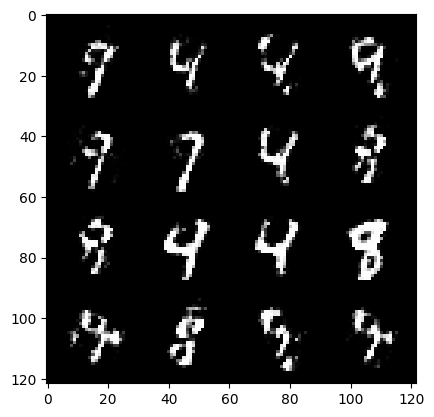

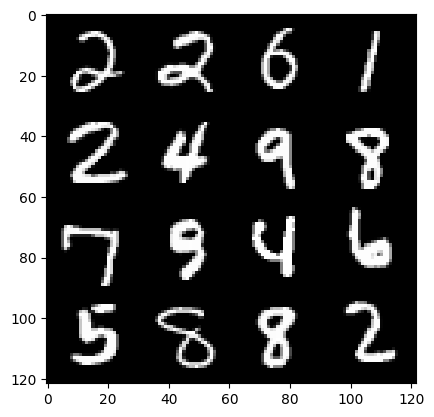

 16%|█▌        | 76/469 [00:01<00:08, 45.78it/s]

186: step 87300 / Gen loss: 2.3929055198033646 / disc_loss: 0.2249060147504013


 78%|███████▊  | 364/469 [00:05<00:01, 61.74it/s]

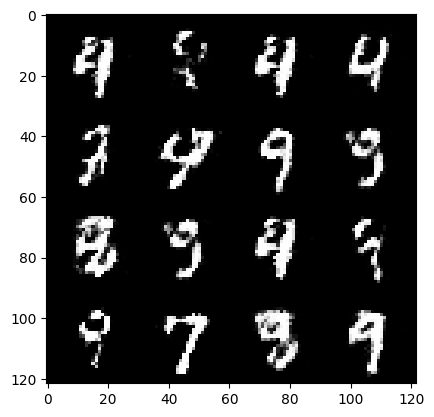

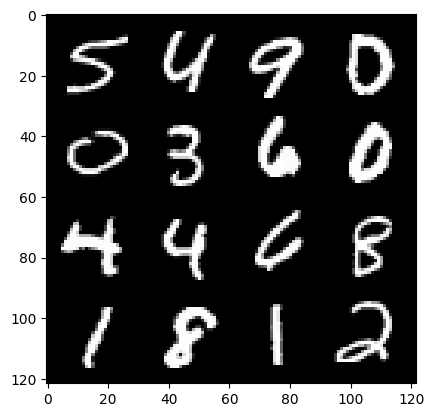

 79%|███████▉  | 371/469 [00:06<00:02, 38.97it/s]

186: step 87600 / Gen loss: 2.3098720574378957 / disc_loss: 0.2447546061873434


 41%|████▏     | 194/469 [00:03<00:04, 61.17it/s]

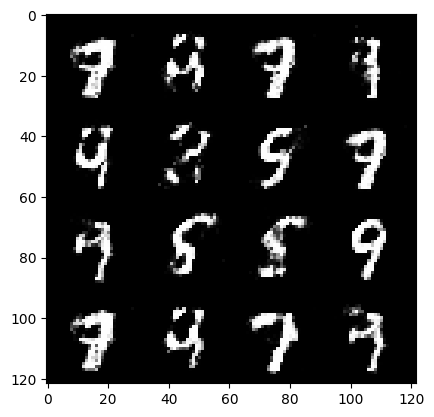

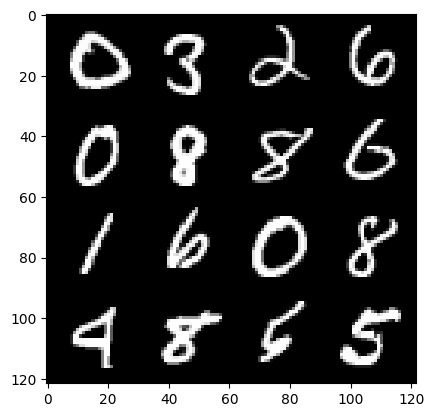

 44%|████▍     | 206/469 [00:03<00:06, 41.23it/s]

187: step 87900 / Gen loss: 2.193669932285945 / disc_loss: 0.2630171060562135


  6%|▌         | 28/469 [00:00<00:06, 64.80it/s]

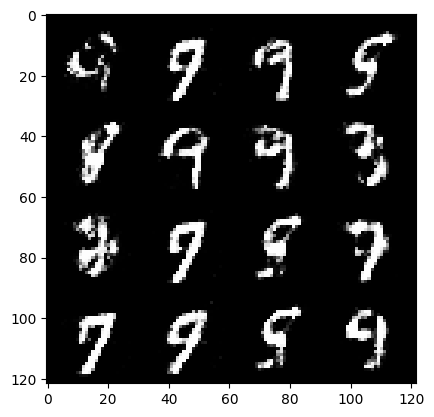

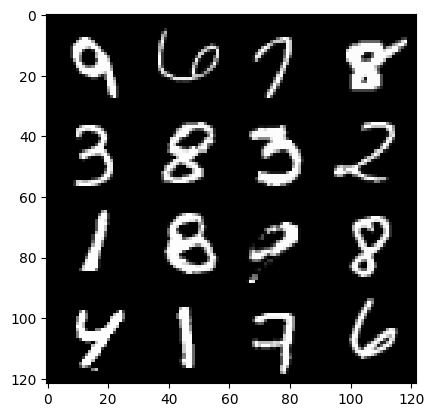

  7%|▋         | 35/469 [00:00<00:12, 34.79it/s]

188: step 88200 / Gen loss: 2.292421569426855 / disc_loss: 0.24553222060203542


 69%|██████▉   | 323/469 [00:05<00:02, 62.23it/s]

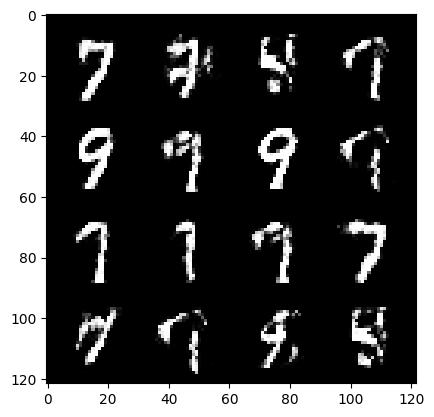

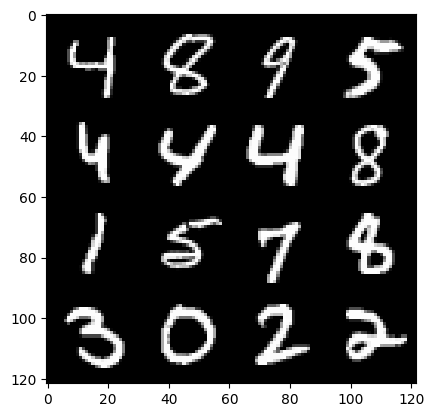

 72%|███████▏  | 336/469 [00:06<00:03, 39.33it/s]

188: step 88500 / Gen loss: 2.3706434182325986 / disc_loss: 0.2311920830607414


 33%|███▎      | 156/469 [00:02<00:04, 69.78it/s]

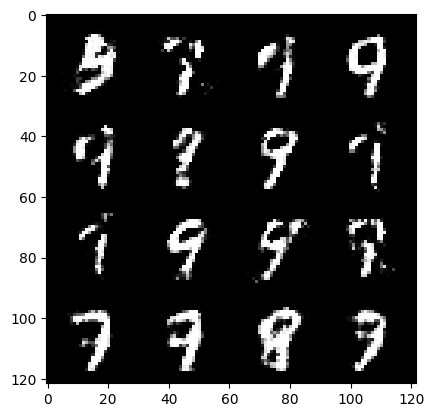

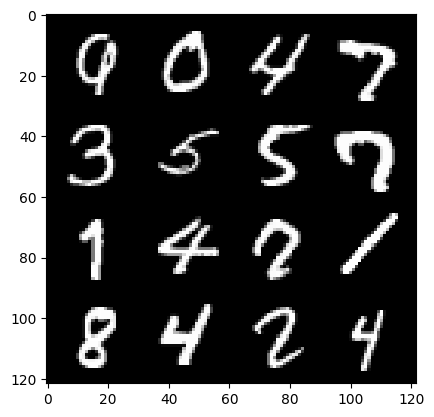

 35%|███▍      | 163/469 [00:02<00:06, 46.39it/s]

189: step 88800 / Gen loss: 2.105873889923096 / disc_loss: 0.27222540135184925


 97%|█████████▋| 457/469 [00:07<00:00, 57.53it/s]

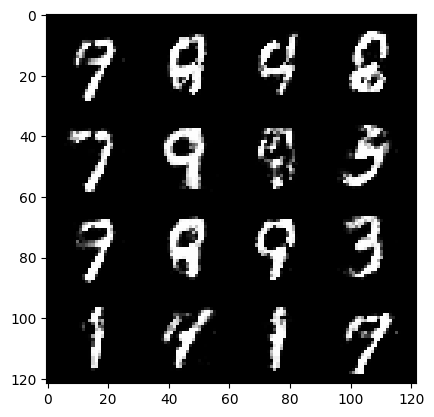

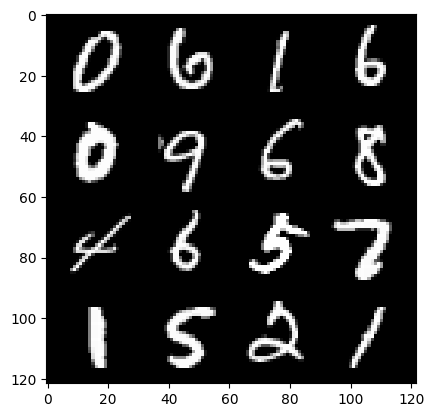

 99%|█████████▊| 463/469 [00:08<00:00, 37.67it/s]

189: step 89100 / Gen loss: 2.1480669935544316 / disc_loss: 0.2600531233350437


 61%|██████    | 287/469 [00:04<00:02, 63.25it/s]

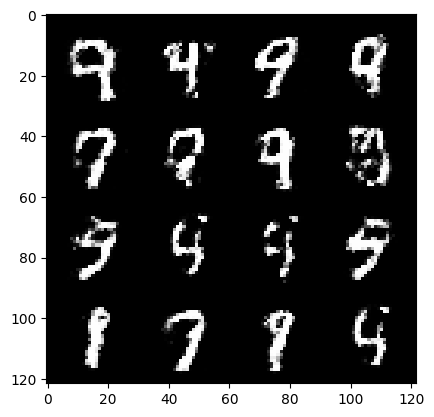

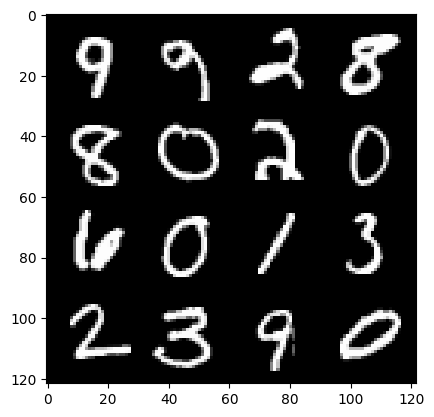

 64%|██████▍   | 300/469 [00:04<00:03, 47.67it/s]

190: step 89400 / Gen loss: 2.1511928510665896 / disc_loss: 0.2614466565350692


 25%|██▍       | 115/469 [00:02<00:05, 61.04it/s]

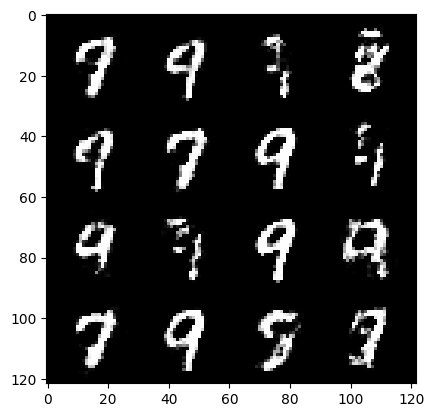

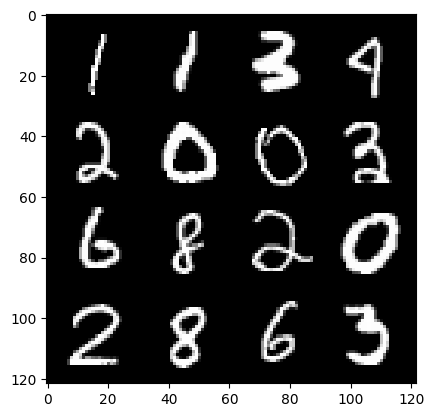

 27%|██▋       | 128/469 [00:02<00:08, 40.98it/s]

191: step 89700 / Gen loss: 2.160295881032944 / disc_loss: 0.26156294266382846


 88%|████████▊ | 415/469 [00:07<00:00, 62.06it/s]

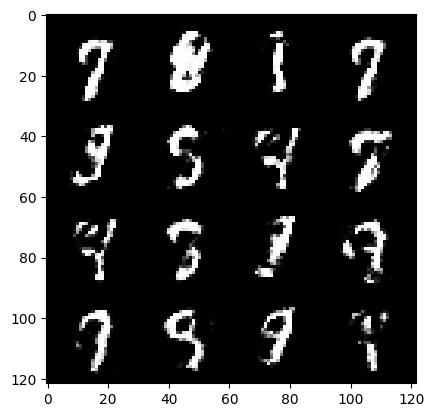

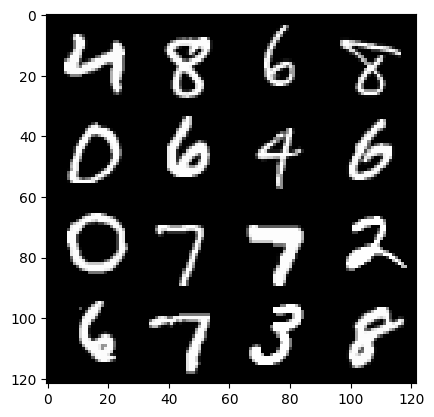

 91%|█████████▏| 428/469 [00:07<00:00, 44.67it/s]

191: step 90000 / Gen loss: 2.223999129931133 / disc_loss: 0.2533531412978968


 52%|█████▏    | 245/469 [00:03<00:03, 70.23it/s]

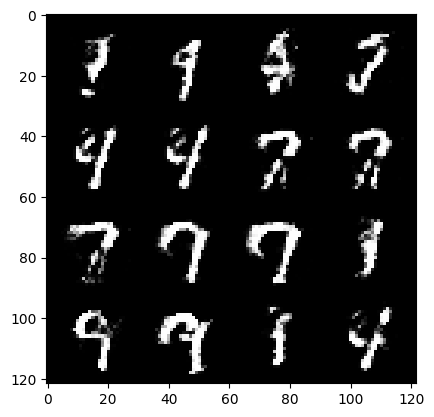

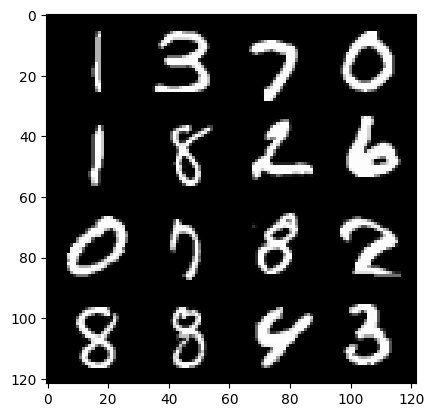

 55%|█████▌    | 259/469 [00:04<00:04, 47.47it/s]

192: step 90300 / Gen loss: 2.2891834878921506 / disc_loss: 0.24030818149447428


 17%|█▋        | 78/469 [00:01<00:06, 63.52it/s]

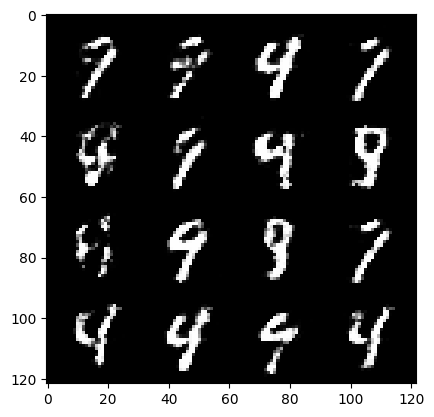

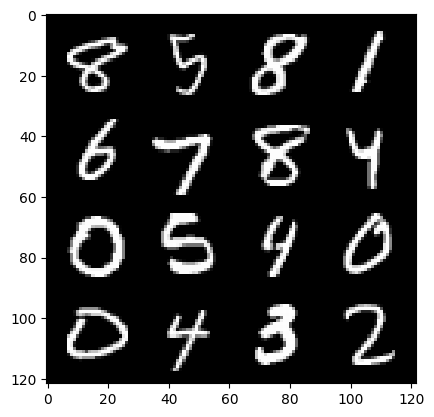

 19%|█▉        | 91/469 [00:01<00:08, 42.37it/s]

193: step 90600 / Gen loss: 2.225193549791971 / disc_loss: 0.25048946311076475


 81%|████████  | 381/469 [00:06<00:01, 66.19it/s]

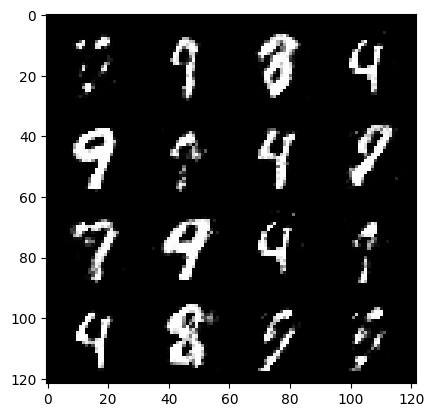

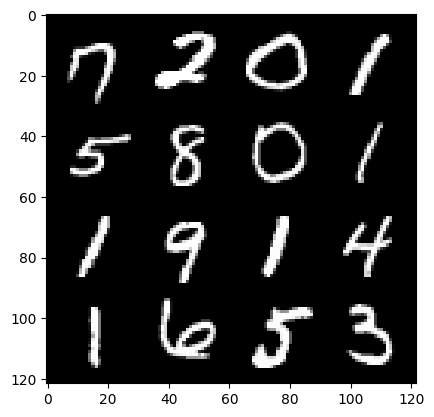

 83%|████████▎ | 388/469 [00:06<00:02, 35.88it/s]

193: step 90900 / Gen loss: 2.13083489259084 / disc_loss: 0.2699210136135418


 45%|████▌     | 212/469 [00:03<00:03, 67.04it/s]

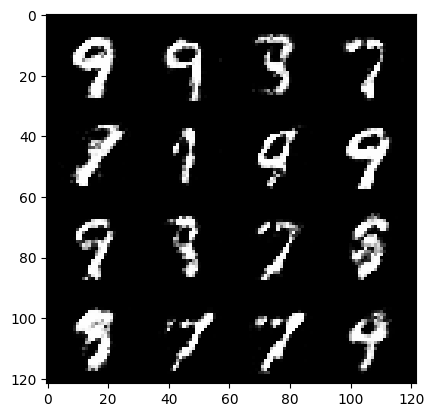

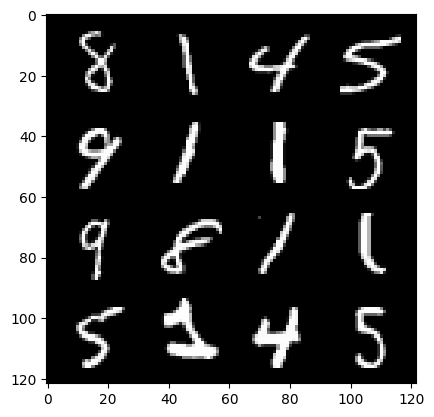

 47%|████▋     | 219/469 [00:03<00:05, 42.09it/s]

194: step 91200 / Gen loss: 2.1852958019574484 / disc_loss: 0.2583444572488467


  9%|▉         | 44/469 [00:00<00:06, 60.82it/s]

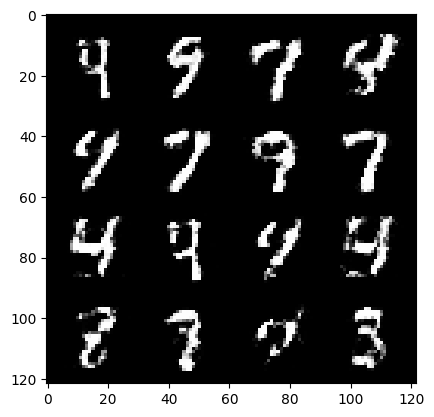

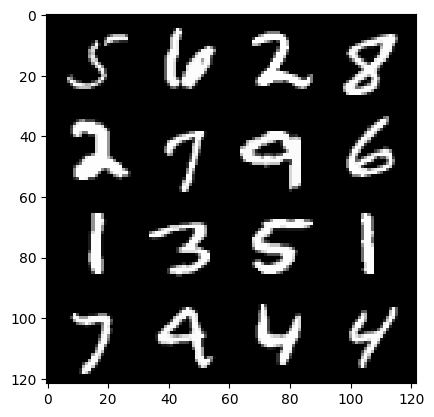

 11%|█         | 51/469 [00:01<00:10, 41.43it/s]

195: step 91500 / Gen loss: 2.101296507914862 / disc_loss: 0.2712294160823028


 73%|███████▎  | 342/469 [00:05<00:01, 66.48it/s]

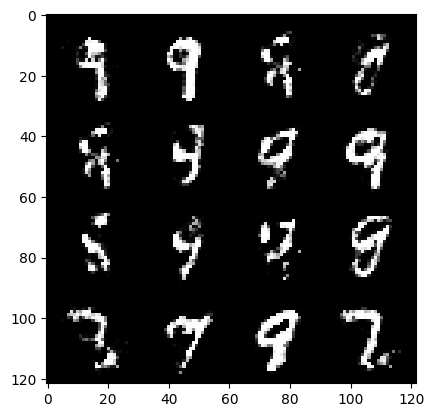

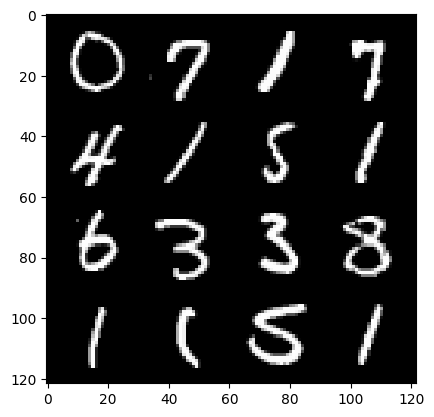

 74%|███████▍  | 349/469 [00:05<00:02, 45.70it/s]

195: step 91800 / Gen loss: 2.1006326882044477 / disc_loss: 0.269240584621827


 36%|███▌      | 170/469 [00:02<00:04, 70.32it/s]

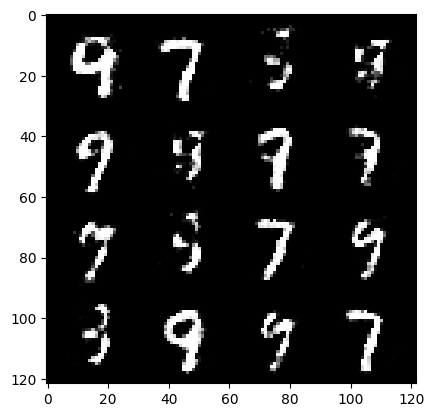

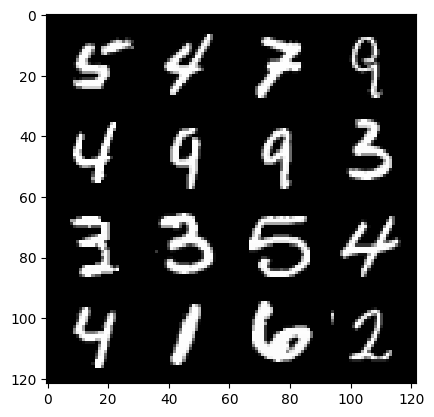

 39%|███▉      | 184/469 [00:02<00:06, 45.87it/s]

196: step 92100 / Gen loss: 2.120978919665018 / disc_loss: 0.2565346444149813


  1%|▏         | 7/469 [00:00<00:08, 57.60it/s]

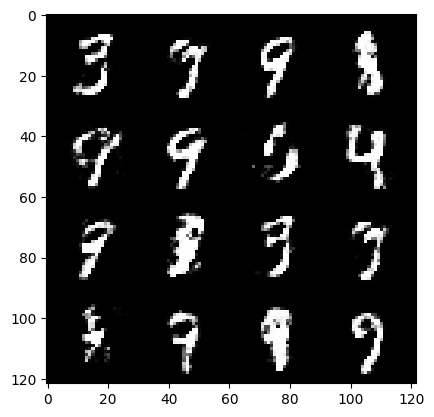

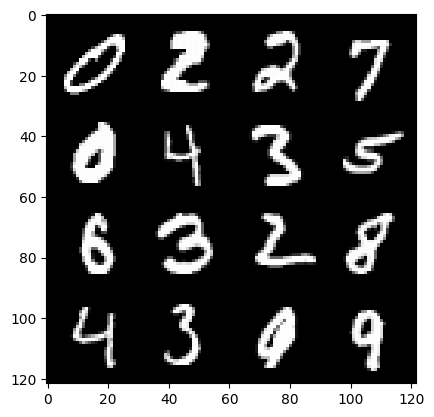

  3%|▎         | 13/469 [00:00<00:19, 23.02it/s]

197: step 92400 / Gen loss: 2.2339876437187214 / disc_loss: 0.25425234362483023


 64%|██████▍   | 300/469 [00:05<00:02, 62.49it/s]

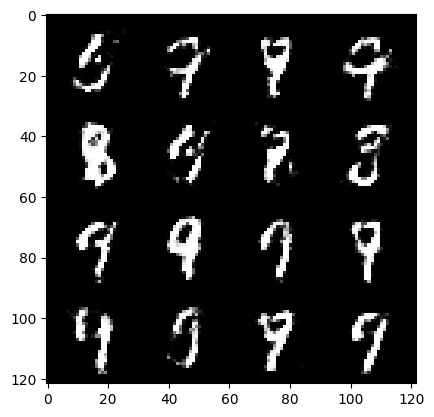

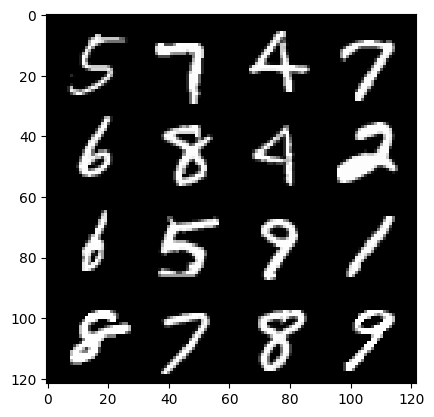

 67%|██████▋   | 314/469 [00:05<00:03, 46.90it/s]

197: step 92700 / Gen loss: 2.0229577072461447 / disc_loss: 0.2948580861588321


 29%|██▉       | 138/469 [00:02<00:04, 70.35it/s]

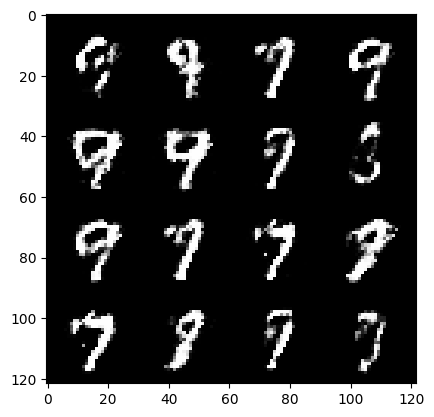

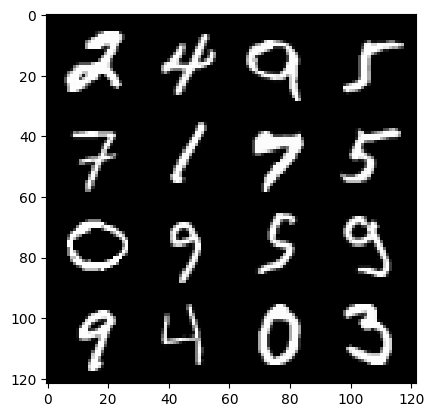

 31%|███       | 146/469 [00:02<00:08, 38.70it/s]

198: step 93000 / Gen loss: 2.081216493050258 / disc_loss: 0.27057113264997806


 93%|█████████▎| 438/469 [00:07<00:00, 62.02it/s]

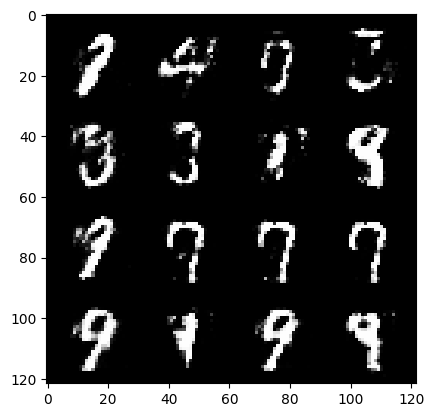

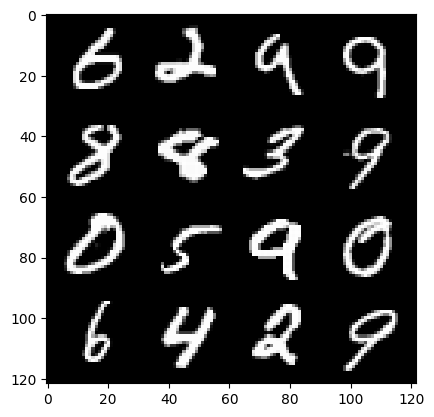

 95%|█████████▍| 445/469 [00:07<00:00, 40.35it/s]

198: step 93300 / Gen loss: 2.068650261163711 / disc_loss: 0.27597597941756236


 57%|█████▋    | 265/469 [00:04<00:03, 63.37it/s]

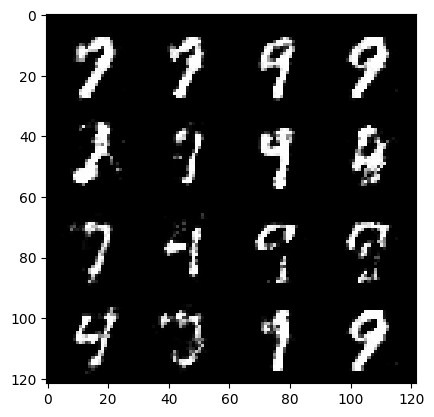

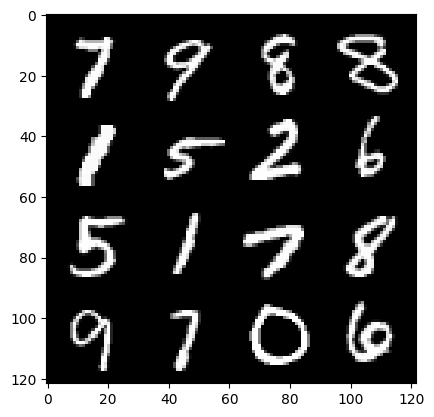

 59%|█████▉    | 278/469 [00:04<00:04, 43.92it/s]

199: step 93600 / Gen loss: 2.0600390203793846 / disc_loss: 0.26446416075030976


 21%|██        | 98/469 [00:01<00:05, 71.96it/s]

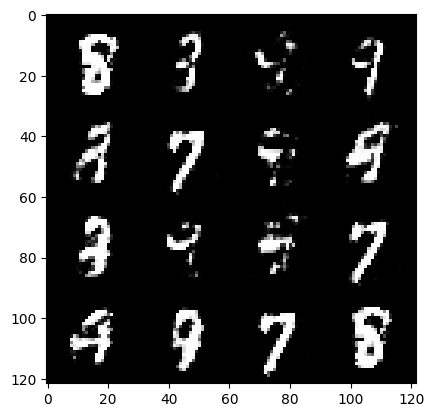

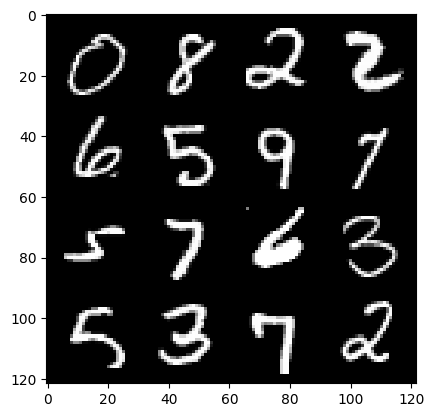

 23%|██▎       | 106/469 [00:01<00:08, 45.12it/s]

200: step 93900 / Gen loss: 2.114834263722103 / disc_loss: 0.2655641208092374


 85%|████████▌ | 399/469 [00:06<00:00, 71.55it/s]

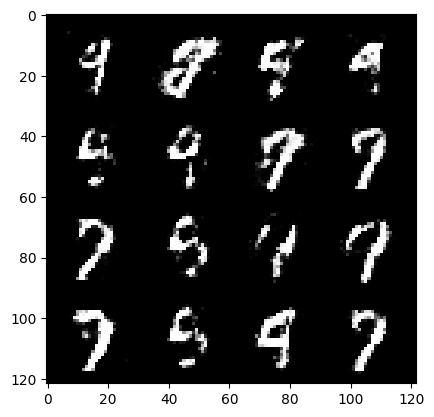

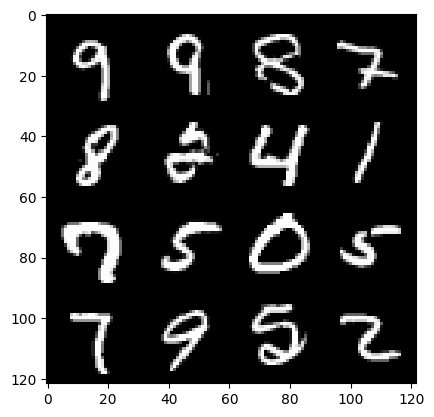

 87%|████████▋ | 407/469 [00:06<00:01, 43.18it/s]

200: step 94200 / Gen loss: 1.983659405708313 / disc_loss: 0.28901595657070456


 48%|████▊     | 224/469 [00:03<00:03, 71.86it/s]

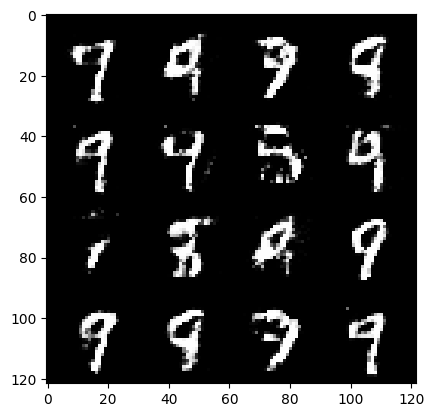

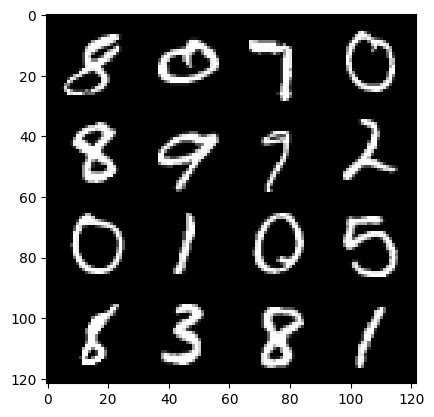

 51%|█████     | 238/469 [00:03<00:05, 44.00it/s]

201: step 94500 / Gen loss: 2.1219737243652355 / disc_loss: 0.2662774232029916


 13%|█▎        | 59/469 [00:00<00:06, 61.36it/s]

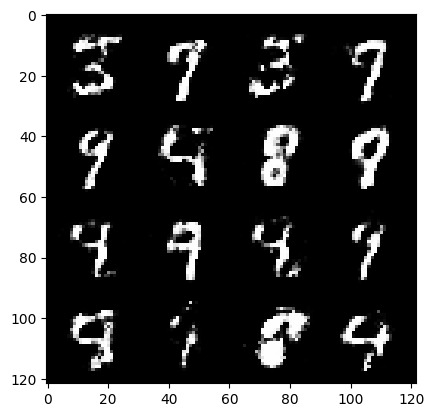

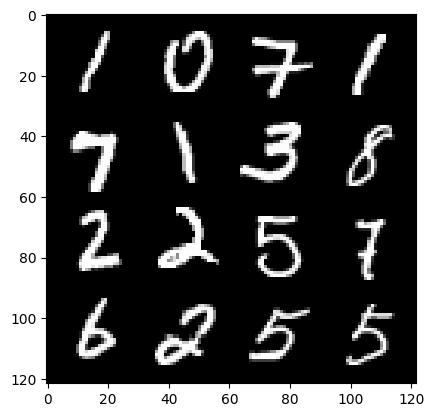

 15%|█▌        | 72/469 [00:01<00:09, 41.60it/s]

202: step 94800 / Gen loss: 2.1235341417789444 / disc_loss: 0.265843320985635


 76%|███████▌  | 357/469 [00:05<00:01, 69.32it/s]

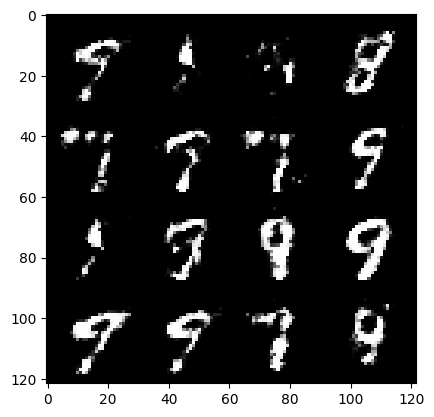

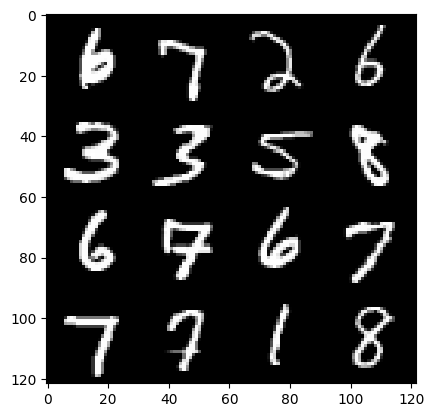

 79%|███████▉  | 370/469 [00:06<00:02, 42.62it/s]

202: step 95100 / Gen loss: 2.1708216075102484 / disc_loss: 0.26863477721810325


 41%|████      | 192/469 [00:02<00:04, 68.81it/s]

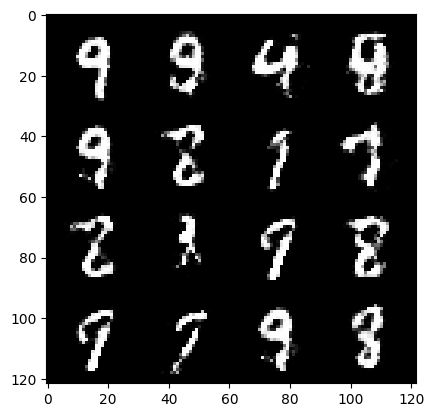

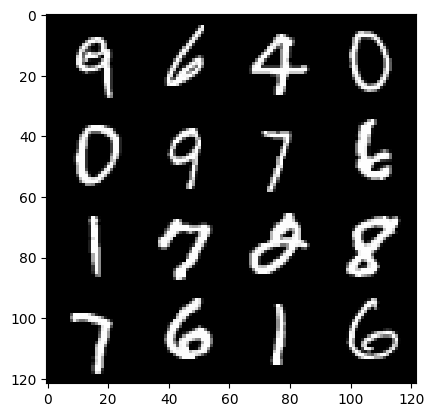

 42%|████▏     | 199/469 [00:03<00:06, 42.57it/s]

203: step 95400 / Gen loss: 1.9716405697663628 / disc_loss: 0.28608387673894553


  4%|▍         | 21/469 [00:00<00:07, 59.61it/s]

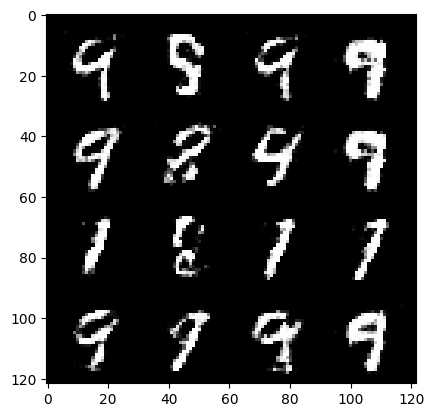

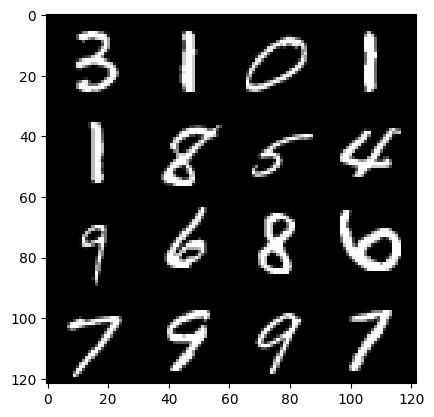

  7%|▋         | 33/469 [00:00<00:10, 39.65it/s]

204: step 95700 / Gen loss: 2.0844805065790806 / disc_loss: 0.28010355219244965


 69%|██████▉   | 323/469 [00:05<00:02, 65.41it/s]

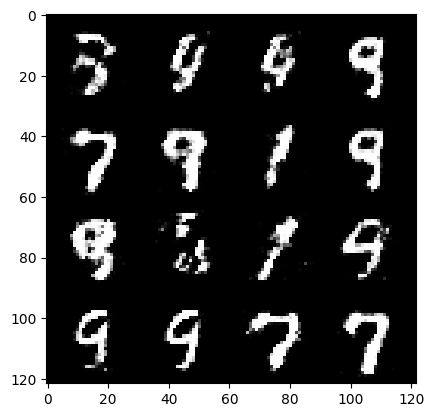

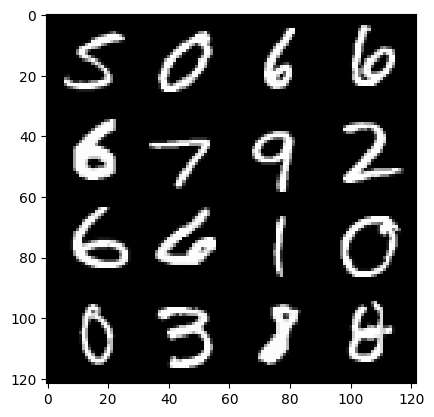

 70%|███████   | 330/469 [00:05<00:03, 41.90it/s]

204: step 96000 / Gen loss: 1.9546698196729027 / disc_loss: 0.30353639140725164


 33%|███▎      | 153/469 [00:03<00:06, 46.18it/s]

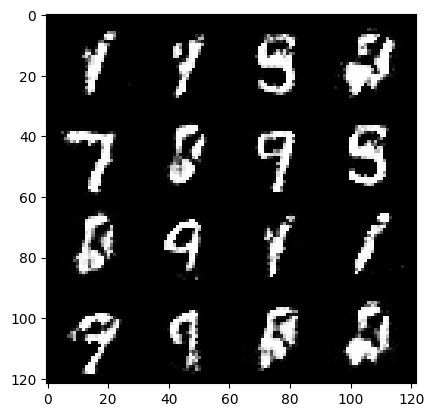

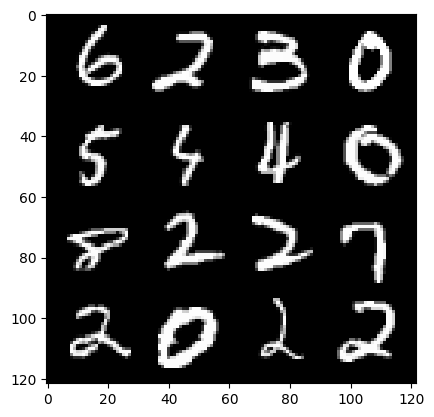

 35%|███▍      | 162/469 [00:04<00:11, 27.23it/s]

205: step 96300 / Gen loss: 1.874077829519908 / disc_loss: 0.3191722469031811


 97%|█████████▋| 453/469 [00:09<00:00, 58.86it/s]

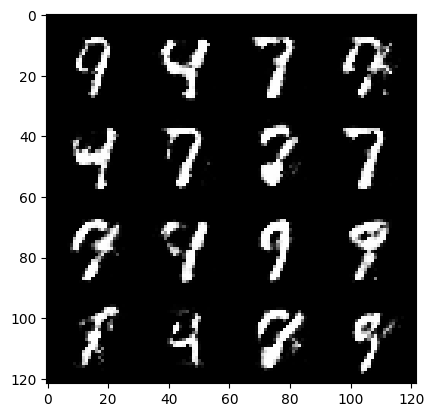

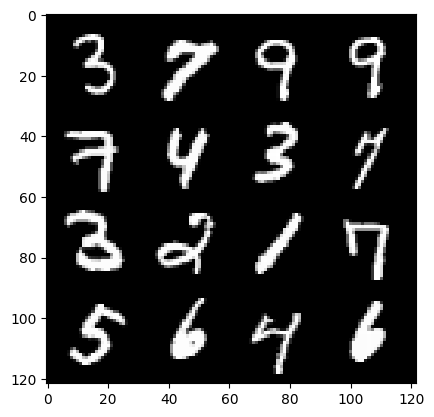

 99%|█████████▉| 466/469 [00:10<00:00, 44.11it/s]

205: step 96600 / Gen loss: 1.84549117565155 / disc_loss: 0.3274035073816775


 61%|██████    | 285/469 [00:04<00:02, 67.36it/s]

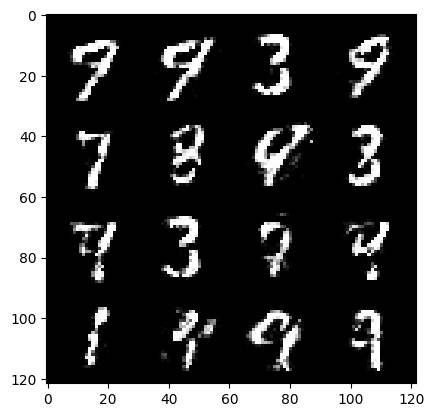

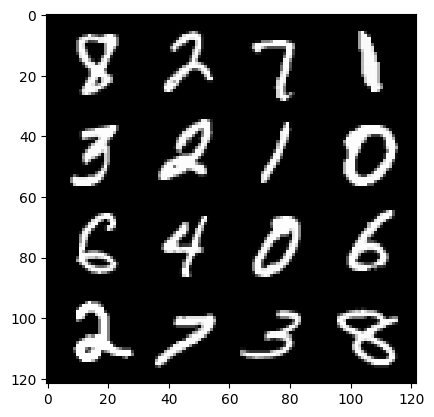

 62%|██████▏   | 292/469 [00:05<00:04, 40.58it/s]

206: step 96900 / Gen loss: 1.8780017987887074 / disc_loss: 0.3126442500452199


 24%|██▍       | 112/469 [00:01<00:04, 75.90it/s]

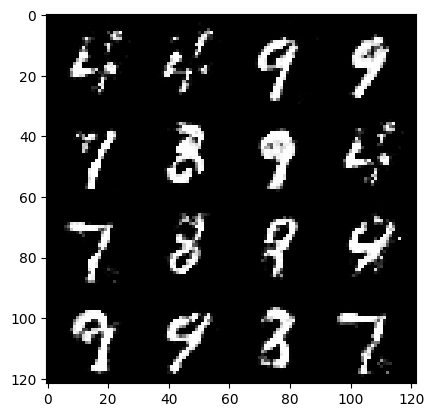

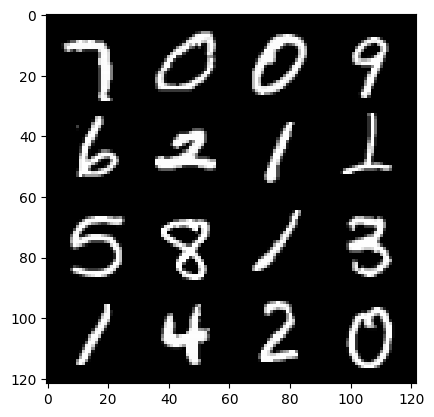

 27%|██▋       | 127/469 [00:02<00:07, 47.29it/s]

207: step 97200 / Gen loss: 1.9280300259590153 / disc_loss: 0.306972164809704


 88%|████████▊ | 412/469 [00:06<00:00, 73.96it/s]

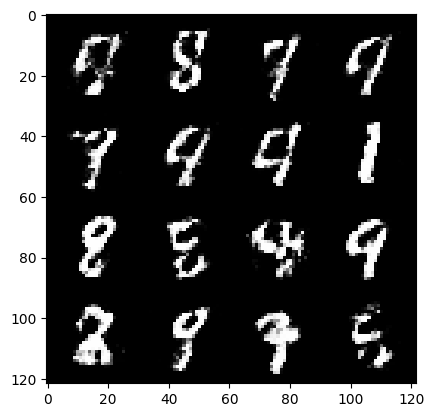

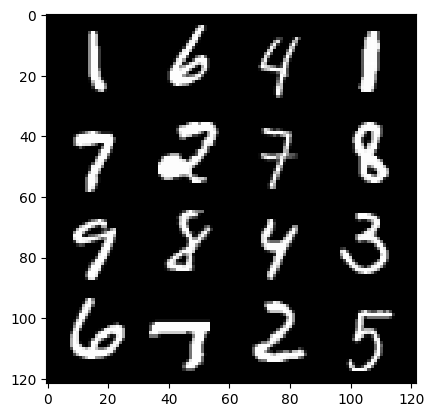

 91%|█████████ | 426/469 [00:06<00:00, 46.38it/s]

207: step 97500 / Gen loss: 1.9944951252142582 / disc_loss: 0.2925360876818498


 52%|█████▏    | 242/469 [00:03<00:03, 71.90it/s]

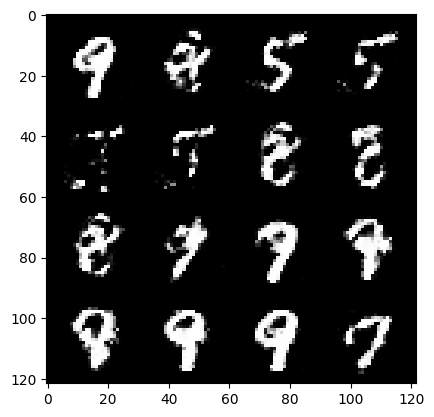

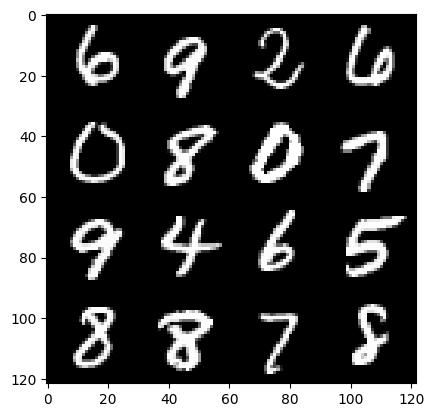

 55%|█████▍    | 256/469 [00:03<00:04, 46.27it/s]

208: step 97800 / Gen loss: 1.956426967382431 / disc_loss: 0.30530992185076083


 17%|█▋        | 78/469 [00:01<00:05, 70.66it/s]

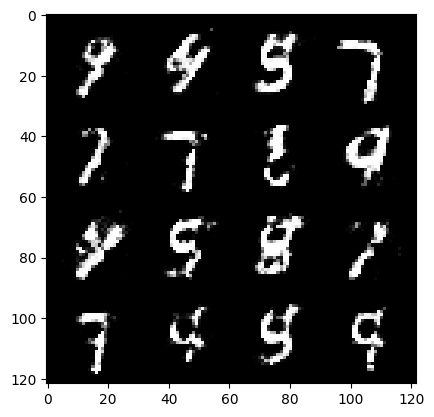

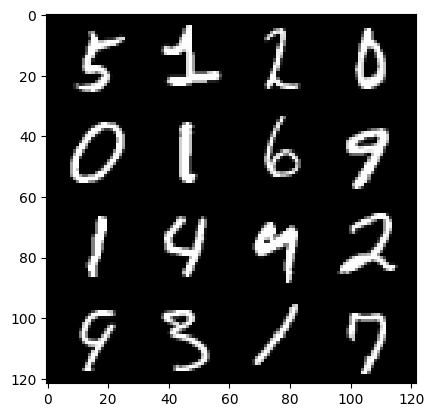

 18%|█▊        | 86/469 [00:01<00:08, 45.26it/s]

209: step 98100 / Gen loss: 1.8988356387615204 / disc_loss: 0.3143576213220758


 80%|████████  | 376/469 [00:05<00:01, 71.93it/s]

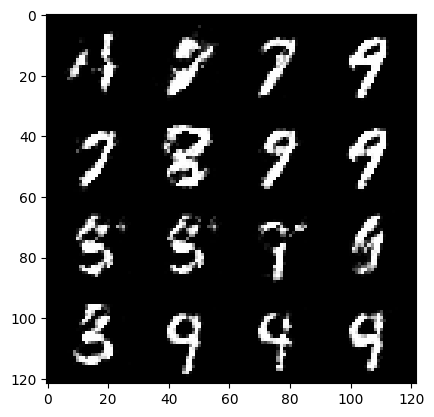

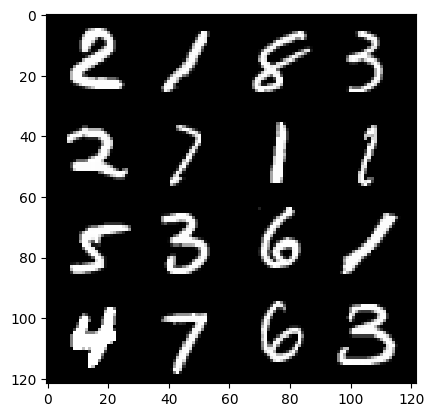

 83%|████████▎ | 390/469 [00:06<00:01, 48.16it/s]

209: step 98400 / Gen loss: 1.9302266641457873 / disc_loss: 0.30379846702019364


 44%|████▍     | 207/469 [00:02<00:03, 75.18it/s]

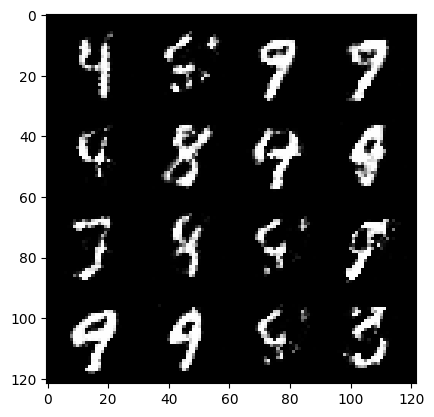

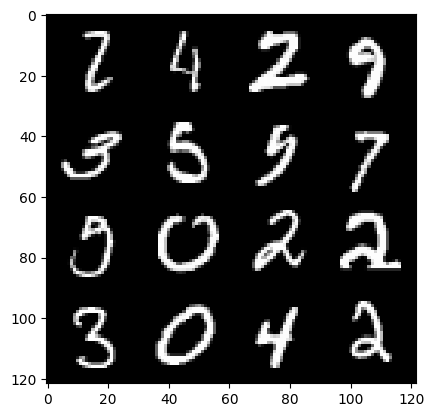

 46%|████▌     | 215/469 [00:03<00:05, 46.59it/s]

210: step 98700 / Gen loss: 1.9837319127718611 / disc_loss: 0.2827980553607146


  9%|▊         | 40/469 [00:00<00:05, 71.66it/s]

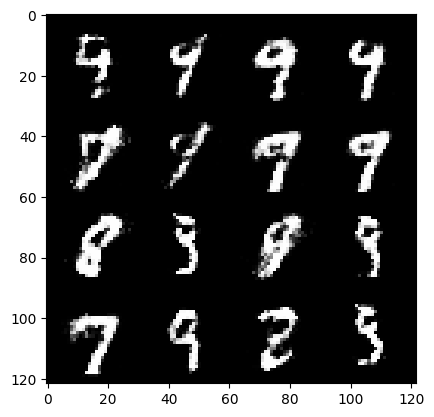

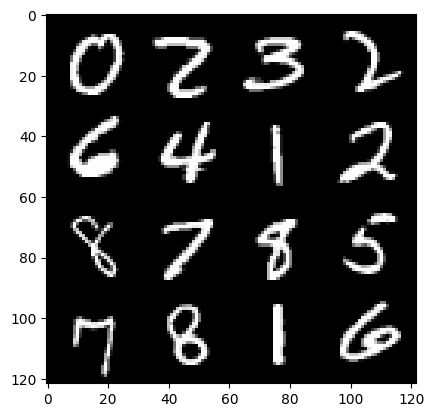

 10%|█         | 48/469 [00:00<00:10, 39.62it/s]

211: step 99000 / Gen loss: 1.968011361757915 / disc_loss: 0.3092364571491877


 71%|███████▏  | 335/469 [00:05<00:01, 69.81it/s]

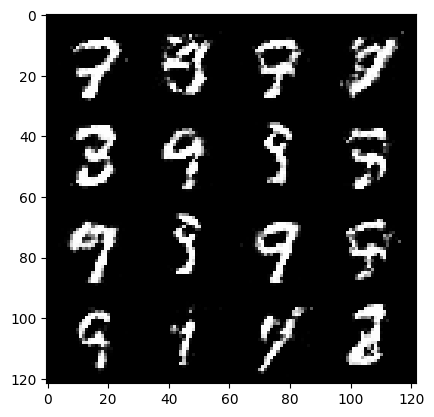

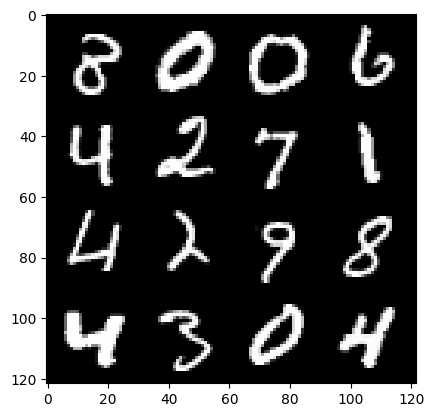

 74%|███████▍  | 349/469 [00:05<00:02, 49.00it/s]

211: step 99300 / Gen loss: 1.9773172783851622 / disc_loss: 0.2885641070206961


 37%|███▋      | 172/469 [00:02<00:04, 73.30it/s]

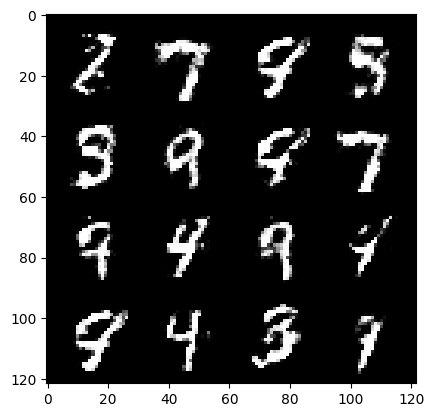

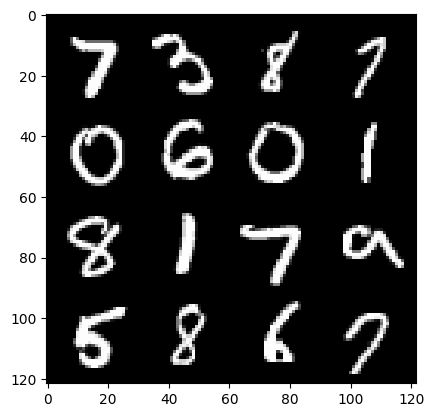

 38%|███▊      | 180/469 [00:02<00:06, 47.82it/s]

212: step 99600 / Gen loss: 1.9871065974235536 / disc_loss: 0.29831730430324865


  0%|          | 0/469 [00:00<?, ?it/s]

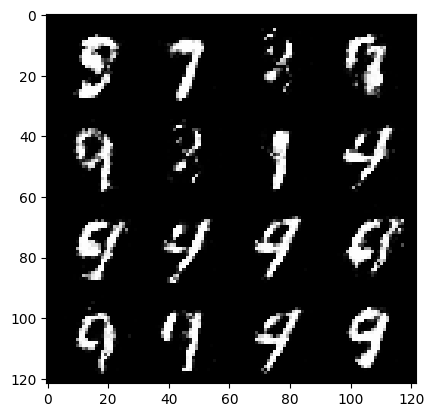

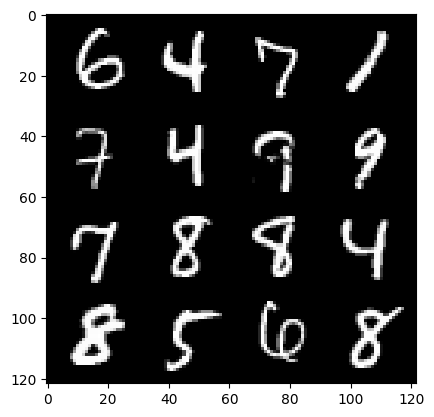

  2%|▏         | 8/469 [00:00<00:18, 25.54it/s]

213: step 99900 / Gen loss: 2.0197187312444034 / disc_loss: 0.27967247063914946


 64%|██████▍   | 302/469 [00:04<00:02, 73.33it/s]

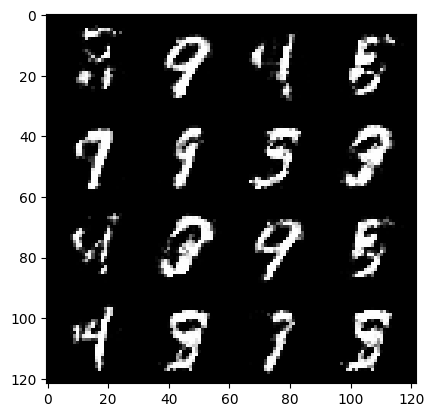

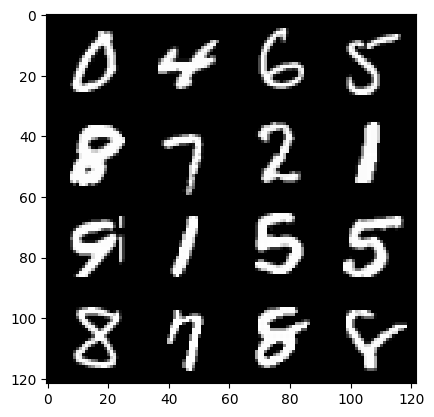

 66%|██████▌   | 310/469 [00:04<00:03, 41.37it/s]

213: step 100200 / Gen loss: 1.9911415946483626 / disc_loss: 0.2930205721656481


 27%|██▋       | 128/469 [00:01<00:04, 69.18it/s]

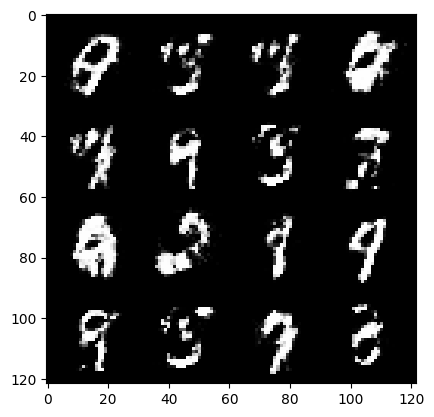

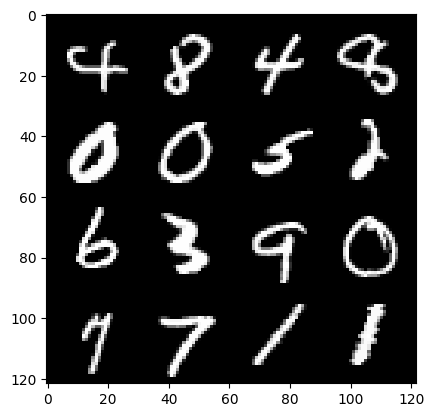

 30%|███       | 141/469 [00:02<00:06, 47.77it/s]

214: step 100500 / Gen loss: 1.9679874805609392 / disc_loss: 0.29189225167036054


 93%|█████████▎| 434/469 [00:06<00:00, 71.65it/s]

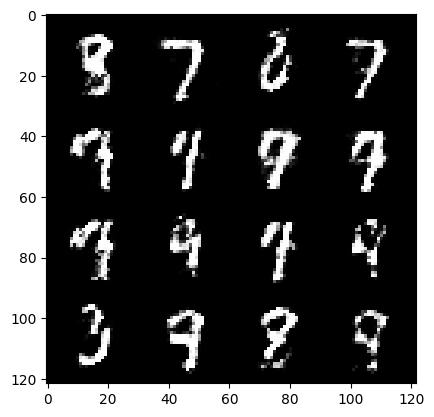

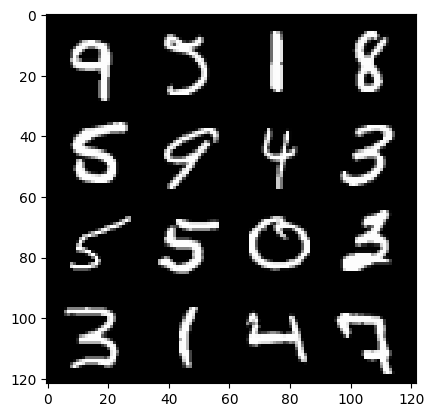

 94%|█████████▍| 442/469 [00:06<00:00, 42.69it/s]

214: step 100800 / Gen loss: 1.9814746646086372 / disc_loss: 0.29237526675065345


 56%|█████▌    | 261/469 [00:03<00:02, 71.79it/s]

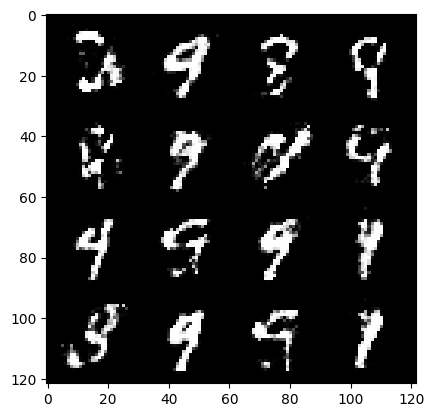

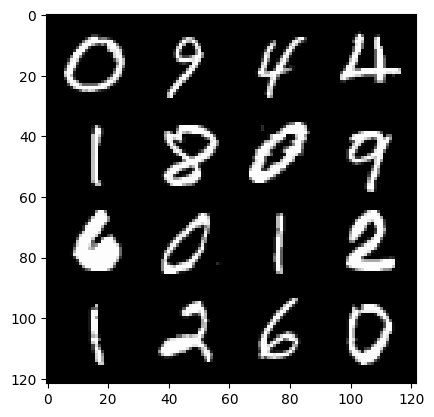

 59%|█████▉    | 276/469 [00:04<00:03, 51.66it/s]

215: step 101100 / Gen loss: 1.9060453593730922 / disc_loss: 0.30713017846147206


 19%|█▉        | 89/469 [00:01<00:05, 74.23it/s]

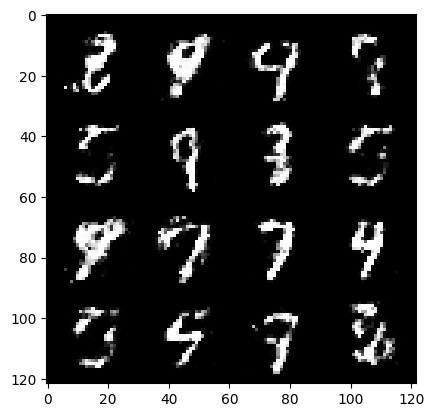

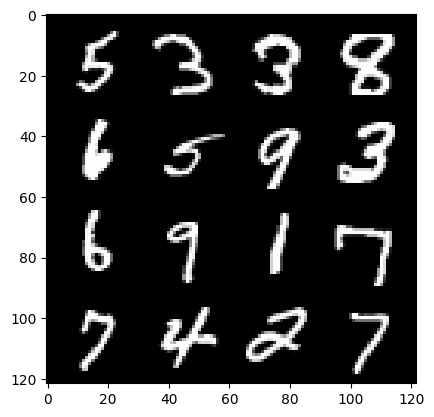

 22%|██▏       | 104/469 [00:01<00:07, 51.97it/s]

216: step 101400 / Gen loss: 1.8515876118342078 / disc_loss: 0.3170618178447087


 83%|████████▎ | 391/469 [00:05<00:01, 76.35it/s]

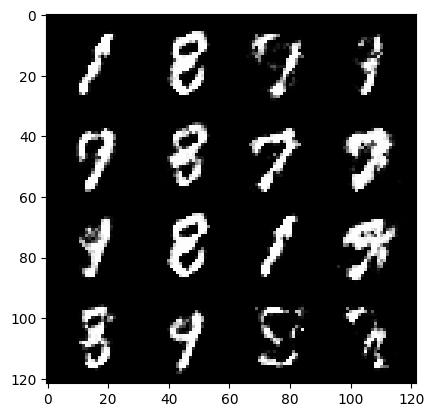

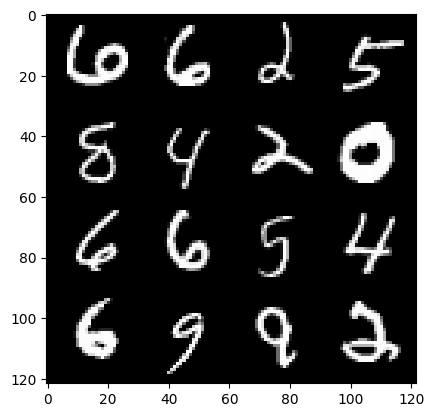

 85%|████████▌ | 399/469 [00:05<00:01, 51.88it/s]

216: step 101700 / Gen loss: 1.8867634721597024 / disc_loss: 0.3055146620670954


 48%|████▊     | 224/469 [00:03<00:03, 73.52it/s]

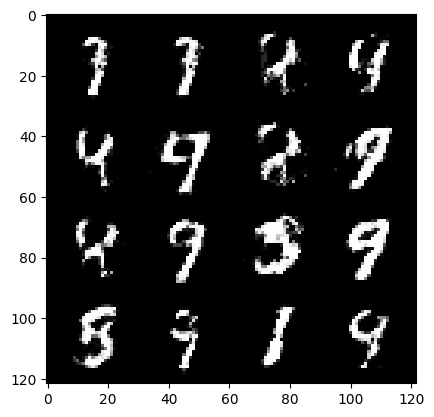

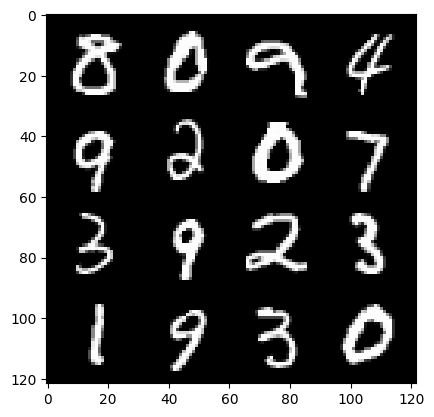

 51%|█████     | 239/469 [00:03<00:04, 50.97it/s]

217: step 102000 / Gen loss: 1.7950863051414505 / disc_loss: 0.3450857614477472


 12%|█▏        | 58/469 [00:00<00:05, 76.77it/s]

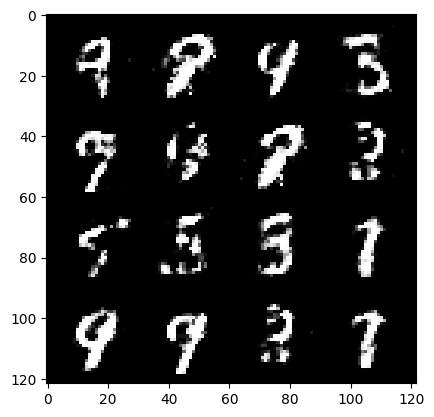

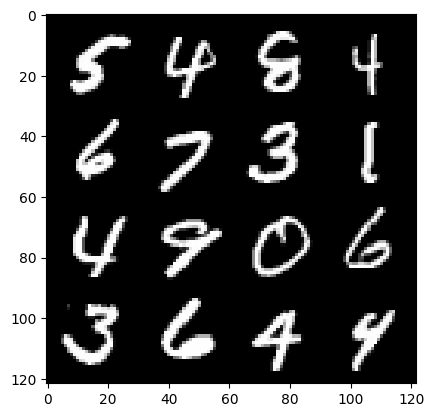

 14%|█▍        | 66/469 [00:01<00:10, 37.49it/s]

218: step 102300 / Gen loss: 1.886223137776056 / disc_loss: 0.3040866729120414


 75%|███████▍  | 351/469 [00:05<00:01, 74.00it/s]

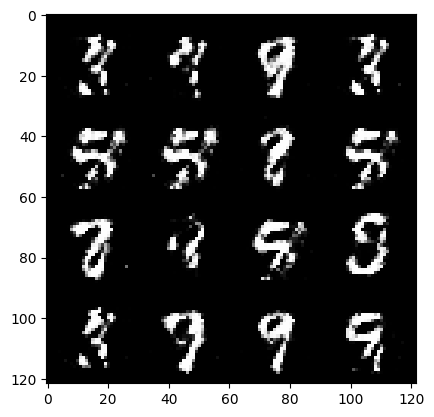

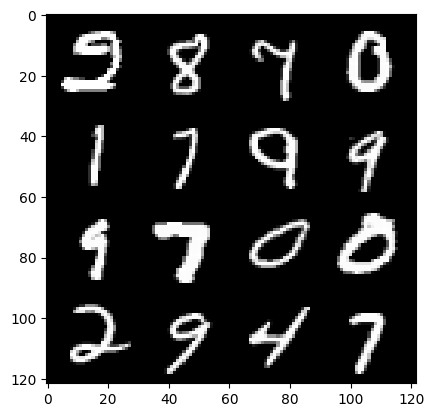

 78%|███████▊  | 366/469 [00:05<00:01, 52.50it/s]

218: step 102600 / Gen loss: 1.9079364295800532 / disc_loss: 0.3135238992174469


 39%|███▉      | 183/469 [00:02<00:03, 73.32it/s]

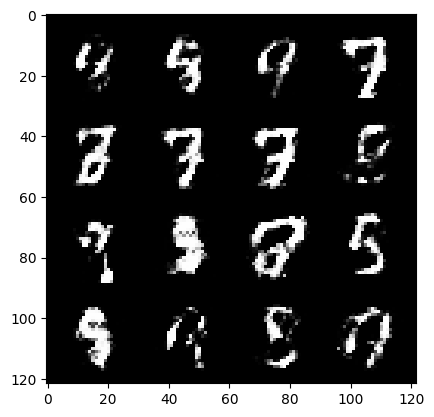

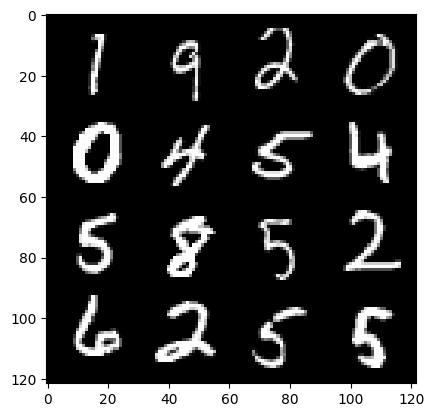

 42%|████▏     | 197/469 [00:03<00:05, 46.18it/s]

219: step 102900 / Gen loss: 1.9504951214790358 / disc_loss: 0.29092986275752397


  3%|▎         | 16/469 [00:00<00:05, 76.02it/s]

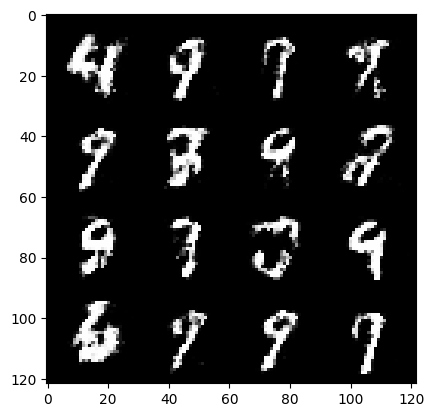

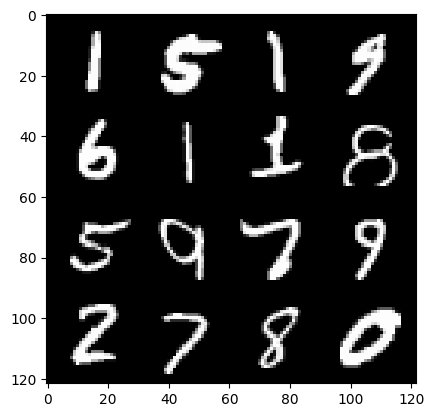

  6%|▋         | 30/469 [00:00<00:10, 42.67it/s]

220: step 103200 / Gen loss: 2.0461435139179223 / disc_loss: 0.2770628652473289


 68%|██████▊   | 317/469 [00:04<00:02, 69.68it/s]

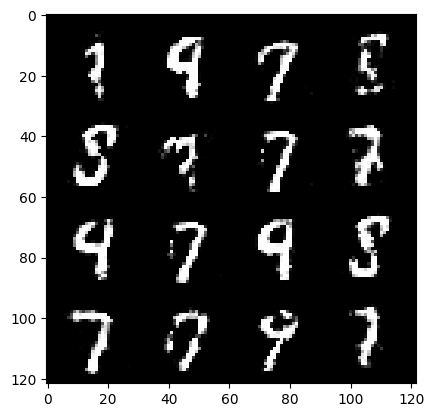

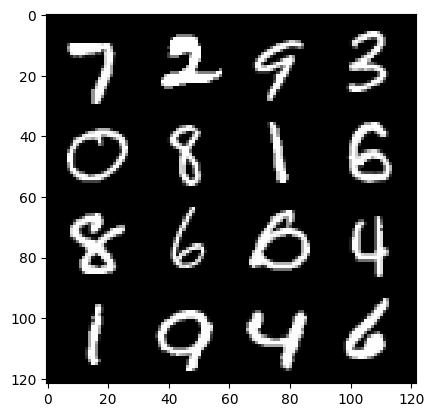

 69%|██████▉   | 325/469 [00:05<00:03, 44.49it/s]

220: step 103500 / Gen loss: 2.014121591250102 / disc_loss: 0.28057929625113803


 31%|███       | 145/469 [00:01<00:04, 69.05it/s]

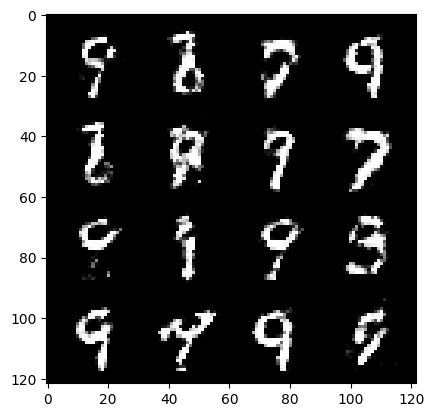

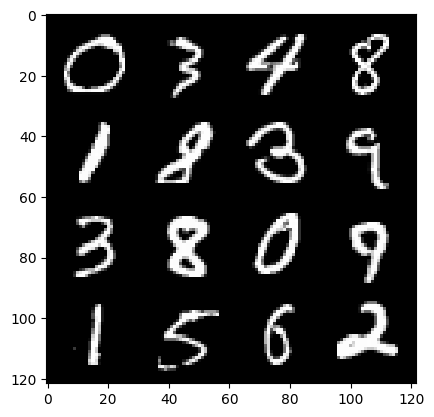

 34%|███▎      | 158/469 [00:02<00:06, 50.14it/s]

221: step 103800 / Gen loss: 1.9461547112464916 / disc_loss: 0.30559677292903276


 95%|█████████▌| 446/469 [00:06<00:00, 73.23it/s]

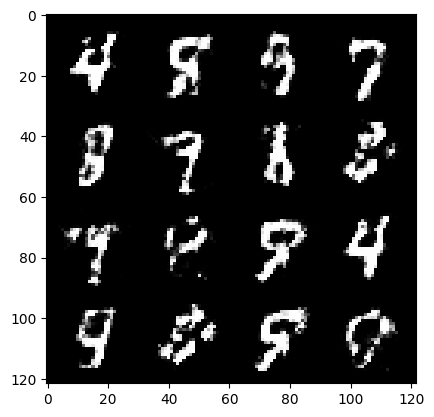

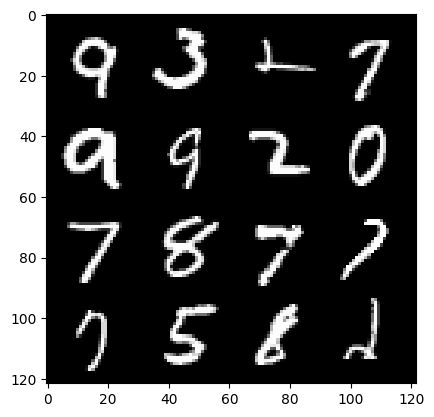

 98%|█████████▊| 461/469 [00:06<00:00, 52.36it/s]

221: step 104100 / Gen loss: 1.9821618254979454 / disc_loss: 0.2918569085995358


 59%|█████▉    | 277/469 [00:03<00:02, 73.36it/s]

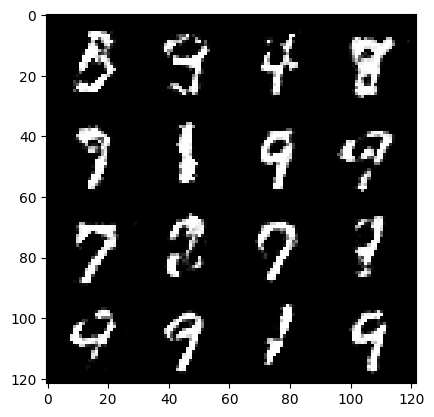

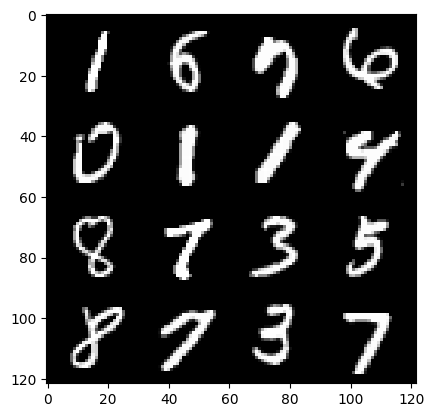

 62%|██████▏   | 292/469 [00:04<00:03, 50.25it/s]

222: step 104400 / Gen loss: 1.951718438069026 / disc_loss: 0.29347788160045934


 23%|██▎       | 107/469 [00:01<00:04, 76.41it/s]

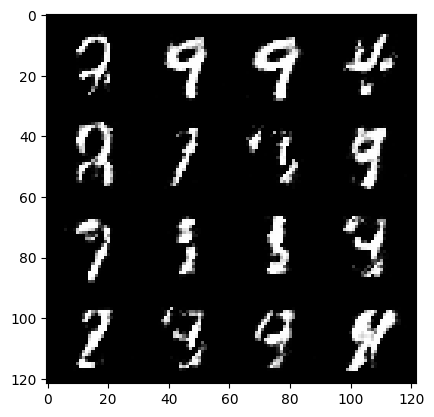

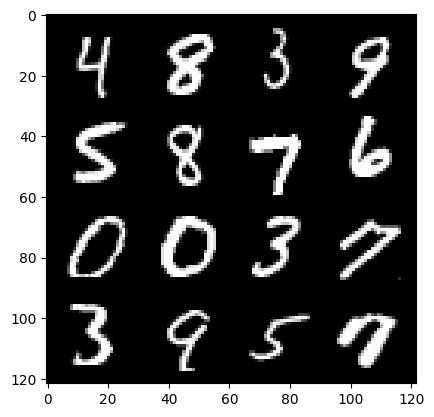

 26%|██▌       | 122/469 [00:01<00:06, 50.38it/s]

223: step 104700 / Gen loss: 1.8236593655745195 / disc_loss: 0.32703863471746447


 88%|████████▊ | 413/469 [00:06<00:00, 74.15it/s]

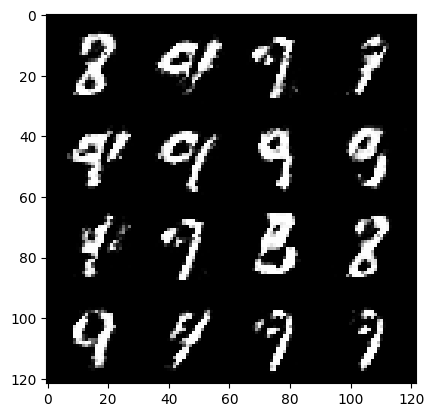

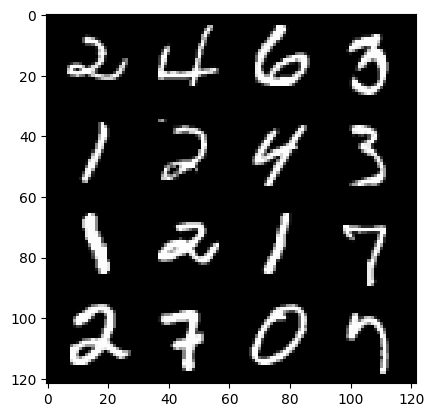

 90%|████████▉ | 421/469 [00:06<00:01, 44.42it/s]

223: step 105000 / Gen loss: 1.8462131281693779 / disc_loss: 0.3259136931598188


 52%|█████▏    | 244/469 [00:03<00:03, 72.68it/s]

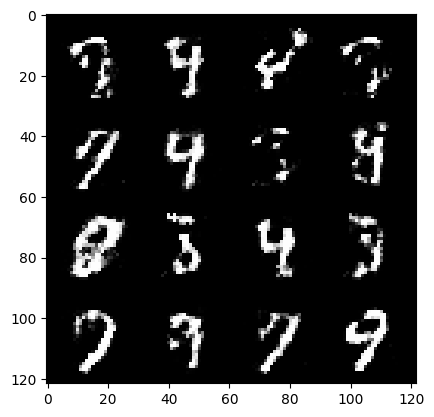

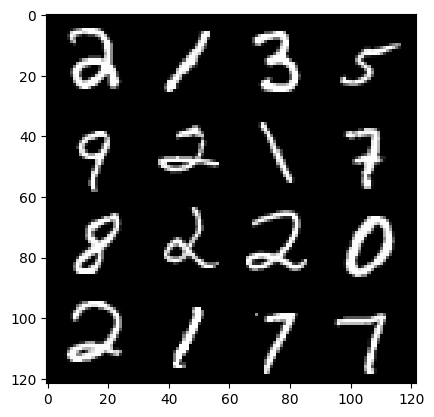

 54%|█████▎    | 252/469 [00:03<00:04, 47.60it/s]

224: step 105300 / Gen loss: 2.0103242774804437 / disc_loss: 0.2851904965937138


 15%|█▍        | 70/469 [00:00<00:05, 71.31it/s]

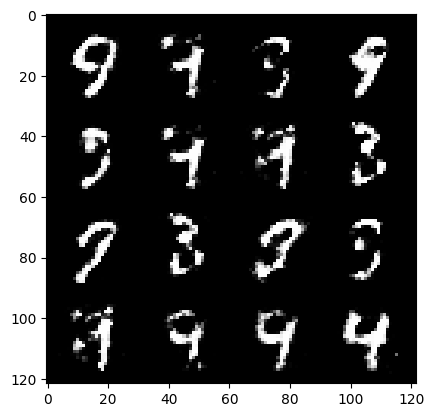

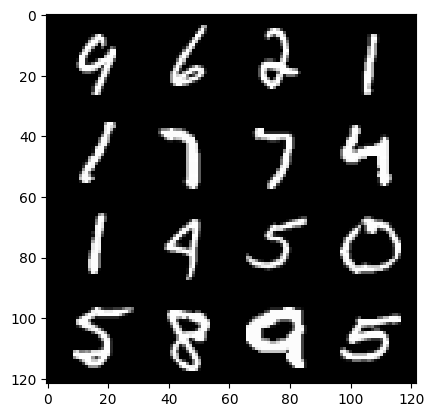

 18%|█▊        | 84/469 [00:01<00:08, 47.03it/s]

225: step 105600 / Gen loss: 1.9372428957621262 / disc_loss: 0.3074734452863534


 80%|███████▉  | 375/469 [00:05<00:01, 74.62it/s]

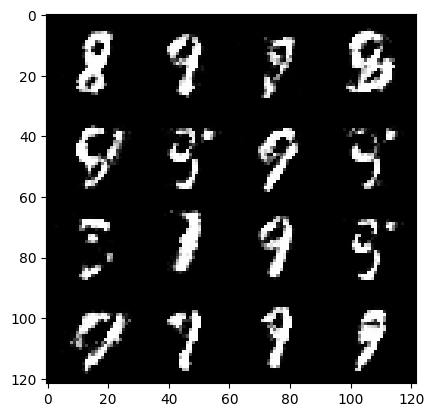

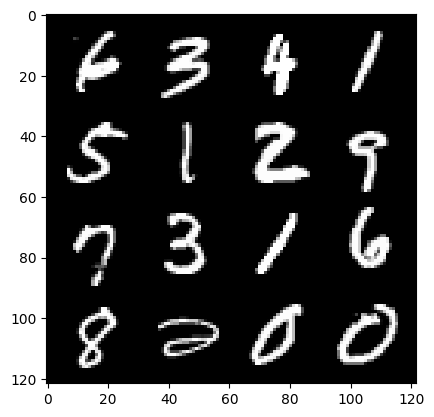

 82%|████████▏ | 383/469 [00:05<00:02, 41.77it/s]

225: step 105900 / Gen loss: 2.0109540196259807 / disc_loss: 0.27296108598510427


 43%|████▎     | 201/469 [00:02<00:04, 64.45it/s]

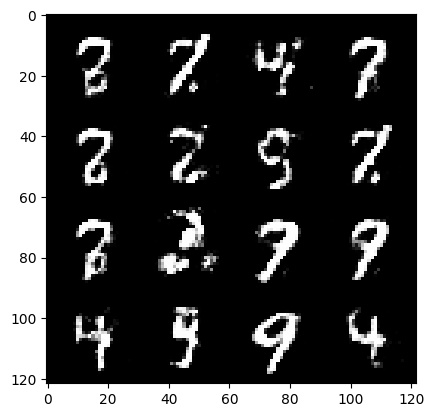

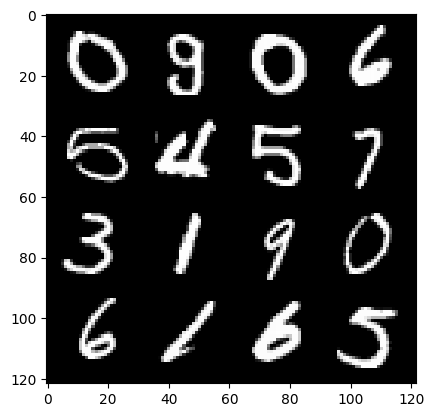

 46%|████▌     | 214/469 [00:03<00:05, 44.90it/s]

226: step 106200 / Gen loss: 2.1260714272658054 / disc_loss: 0.26203998789191224


  8%|▊         | 37/469 [00:00<00:06, 65.61it/s]

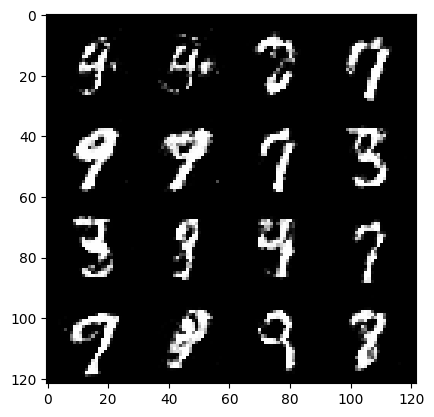

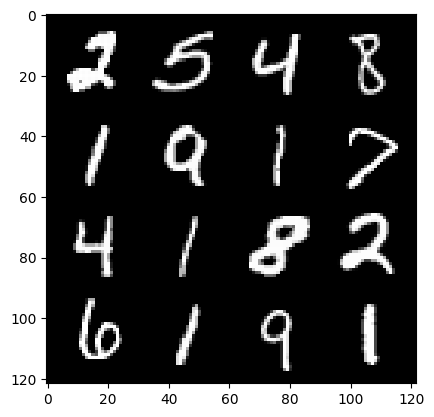

  9%|▉         | 44/469 [00:00<00:11, 36.86it/s]

227: step 106500 / Gen loss: 2.084410498539607 / disc_loss: 0.27643478160103163


 71%|███████   | 334/469 [00:05<00:02, 66.46it/s]

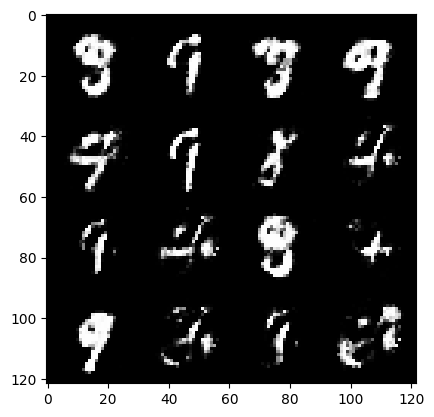

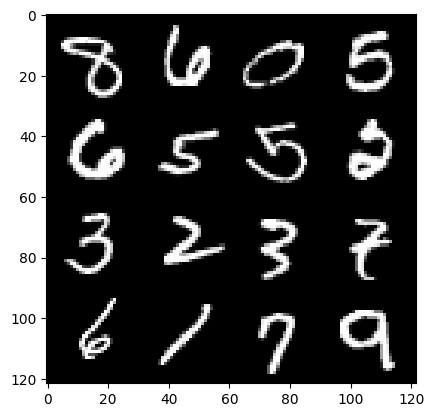

 74%|███████▍  | 347/469 [00:05<00:02, 46.66it/s]

227: step 106800 / Gen loss: 1.8851262191931382 / disc_loss: 0.3193455790479976


 35%|███▌      | 166/469 [00:02<00:04, 62.50it/s]

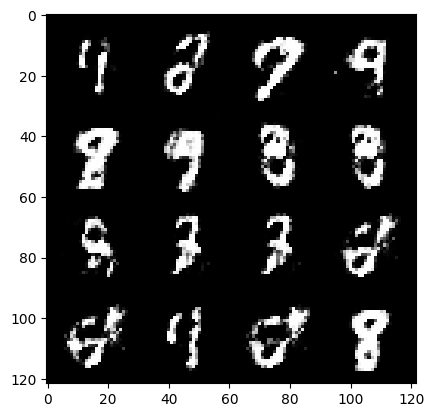

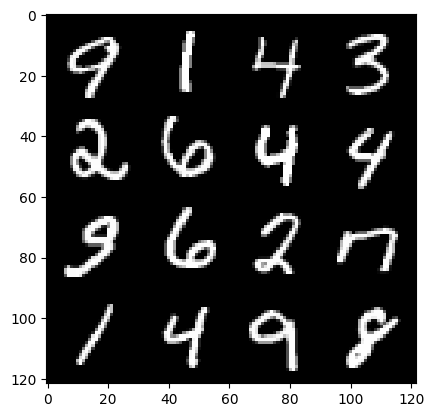

 37%|███▋      | 173/469 [00:02<00:07, 41.47it/s]

228: step 107100 / Gen loss: 1.9441975740591697 / disc_loss: 0.29355870415767077


 99%|█████████▊| 463/469 [00:07<00:00, 59.51it/s]

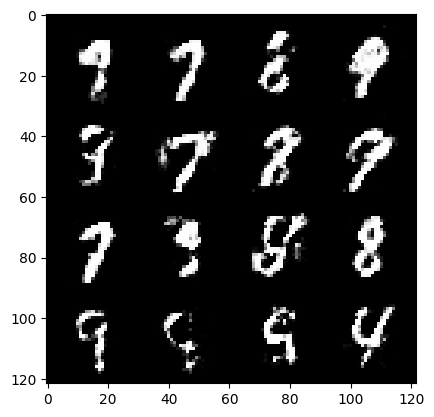

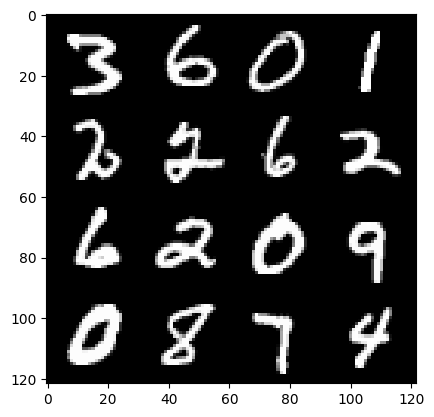

100%|██████████| 469/469 [00:07<00:00, 61.36it/s]


228: step 107400 / Gen loss: 1.9219937531153362 / disc_loss: 0.29283707211414967


 63%|██████▎   | 295/469 [00:04<00:02, 66.56it/s]

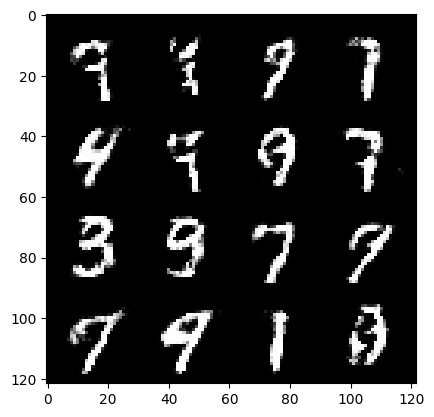

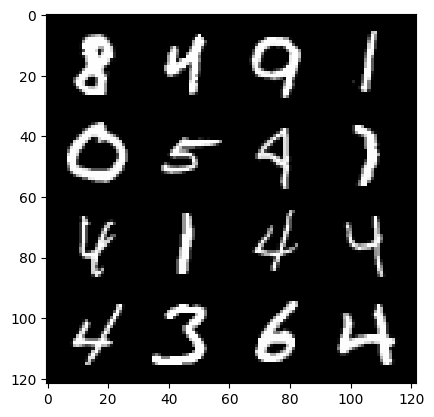

 66%|██████▌   | 308/469 [00:05<00:03, 43.52it/s]

229: step 107700 / Gen loss: 1.9409661511580159 / disc_loss: 0.3116989667713642


 27%|██▋       | 126/469 [00:02<00:05, 64.17it/s]

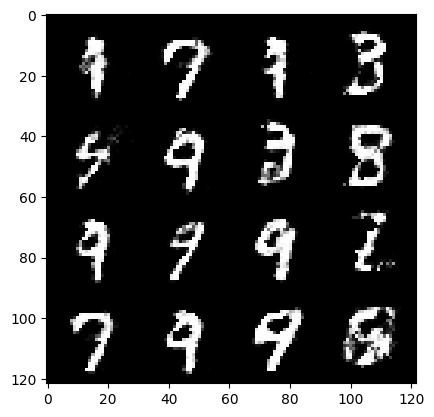

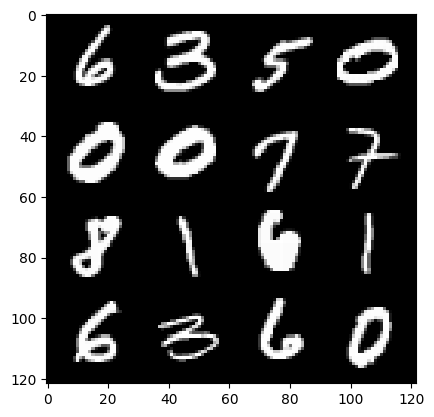

 28%|██▊       | 133/469 [00:02<00:08, 40.40it/s]

230: step 108000 / Gen loss: 1.820291639963785 / disc_loss: 0.34630992695689217


 91%|█████████ | 427/469 [00:07<00:00, 64.89it/s]

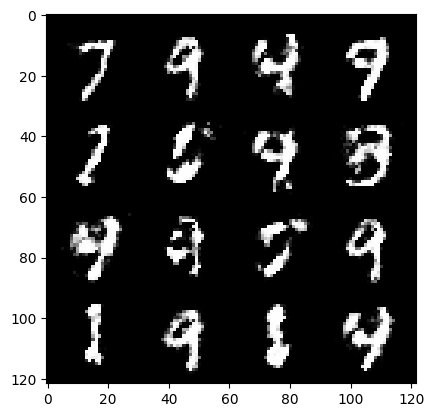

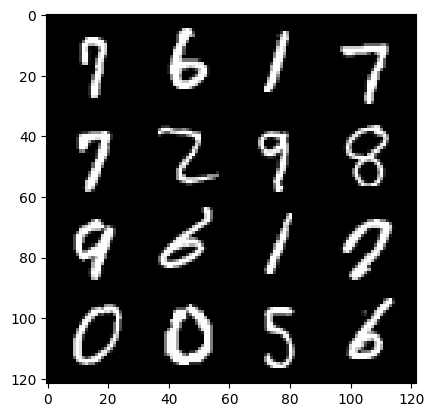

 94%|█████████▍| 440/469 [00:07<00:00, 46.08it/s]

230: step 108300 / Gen loss: 1.9300684269269301 / disc_loss: 0.3036268897851308


 55%|█████▍    | 256/469 [00:04<00:03, 63.66it/s]

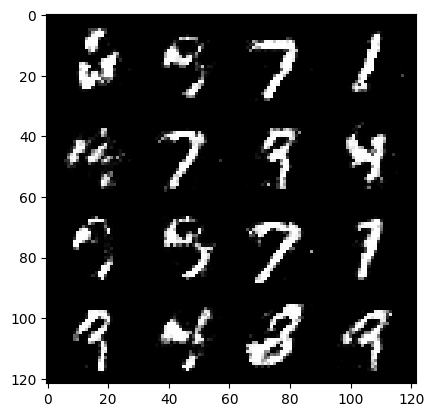

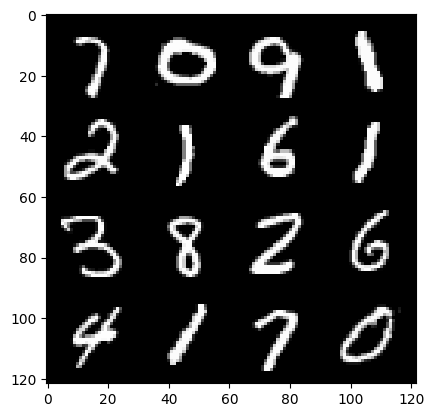

 57%|█████▋    | 269/469 [00:04<00:04, 43.16it/s]

231: step 108600 / Gen loss: 1.8079998747507746 / disc_loss: 0.3334786744912464


 18%|█▊        | 86/469 [00:01<00:06, 63.68it/s]

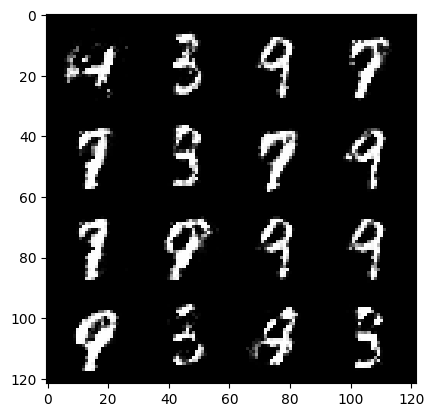

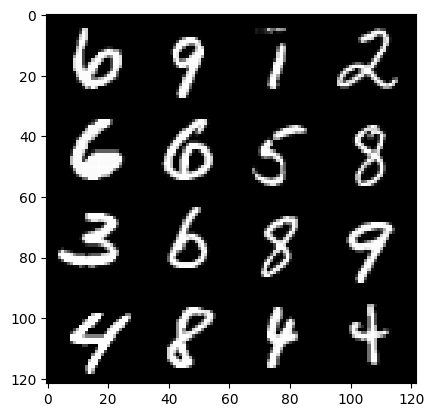

 21%|██        | 99/469 [00:01<00:08, 43.50it/s]

232: step 108900 / Gen loss: 1.9067184607187908 / disc_loss: 0.2976421828567983


 84%|████████▎ | 392/469 [00:06<00:01, 70.77it/s]

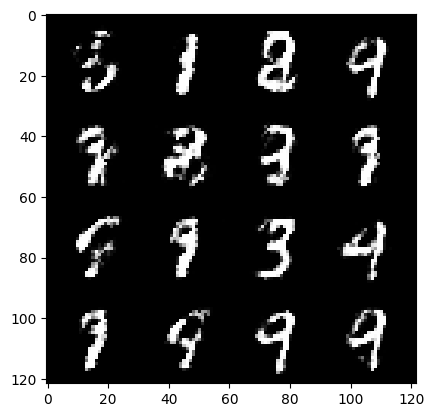

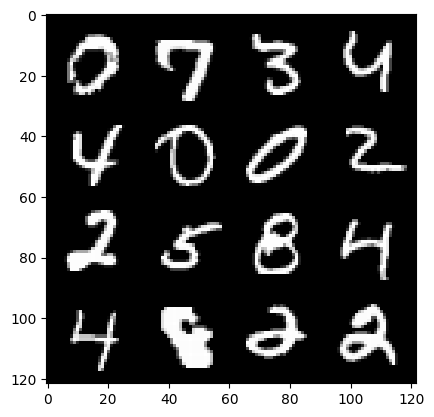

 85%|████████▌ | 400/469 [00:06<00:01, 43.82it/s]

232: step 109200 / Gen loss: 1.958017653226853 / disc_loss: 0.29700203493237476


 46%|████▋     | 218/469 [00:03<00:03, 63.92it/s]

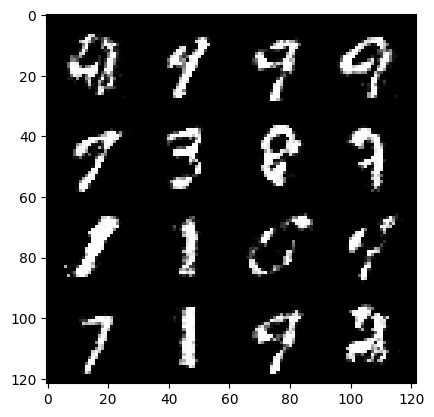

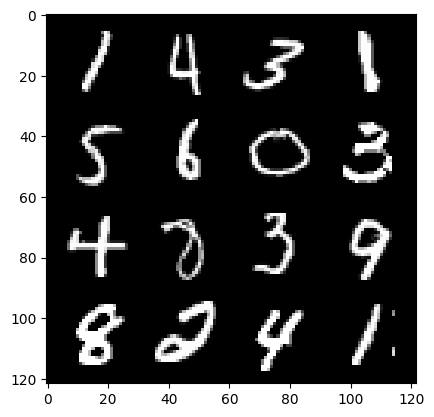

 49%|████▉     | 231/469 [00:03<00:05, 45.68it/s]

233: step 109500 / Gen loss: 1.9028459473450972 / disc_loss: 0.31968244885404906


 10%|█         | 49/469 [00:00<00:06, 64.19it/s]

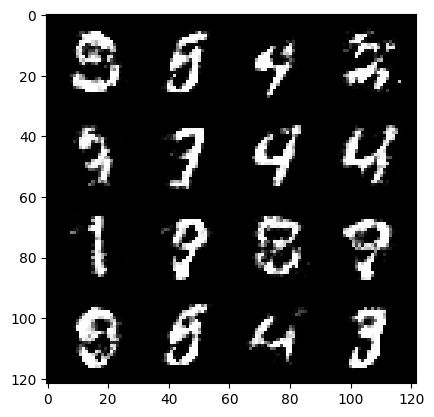

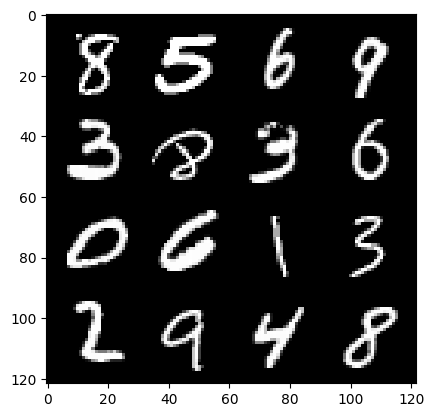

 13%|█▎        | 62/469 [00:01<00:09, 41.34it/s]

234: step 109800 / Gen loss: 1.834193099737167 / disc_loss: 0.3307969025274118


 75%|███████▌  | 353/469 [00:05<00:01, 68.07it/s]

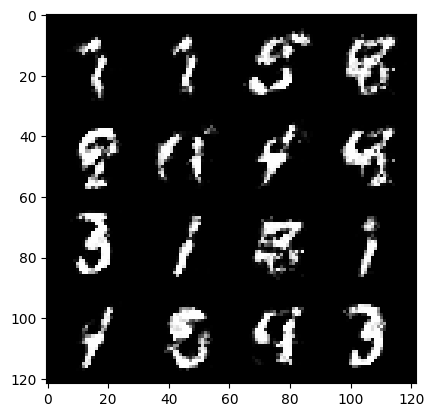

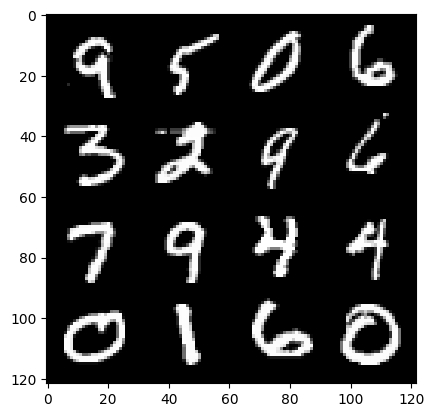

 78%|███████▊  | 366/469 [00:06<00:02, 47.56it/s]

234: step 110100 / Gen loss: 1.713181428909301 / disc_loss: 0.34959699640671393


 38%|███▊      | 180/469 [00:02<00:04, 68.17it/s]

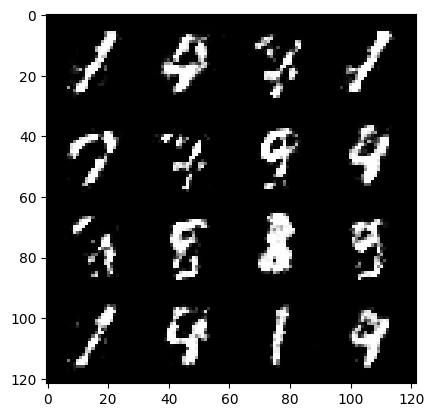

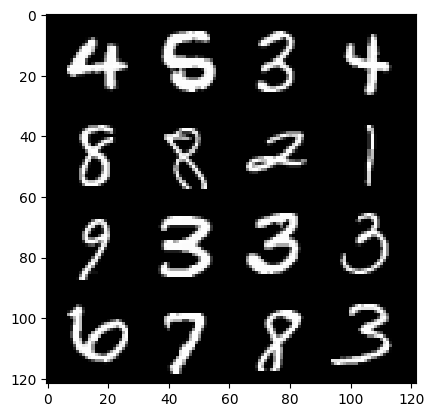

 41%|████      | 193/469 [00:03<00:06, 42.65it/s]

235: step 110400 / Gen loss: 1.8042074457804358 / disc_loss: 0.3296765975157419


  3%|▎         | 16/469 [00:00<00:06, 65.78it/s]

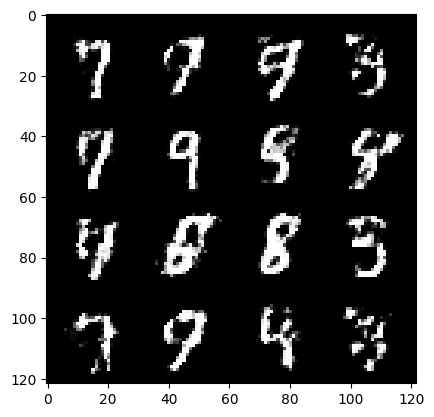

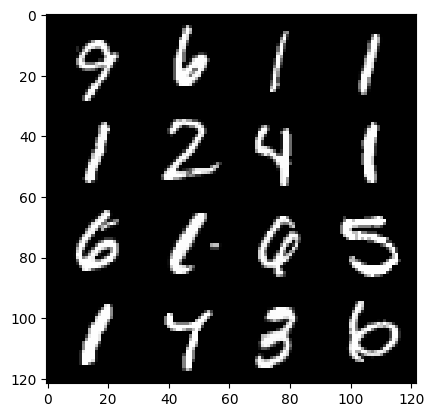

  5%|▍         | 23/469 [00:00<00:14, 31.04it/s]

236: step 110700 / Gen loss: 1.7320267411073038 / disc_loss: 0.3391586802899837


 66%|██████▌   | 309/469 [00:04<00:02, 67.62it/s]

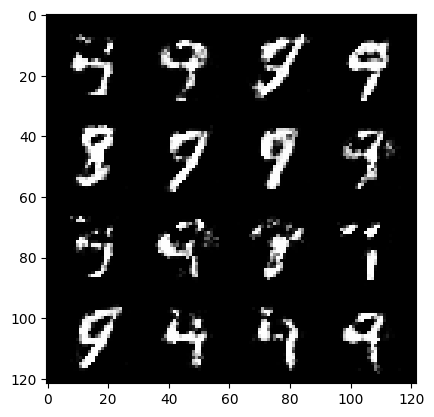

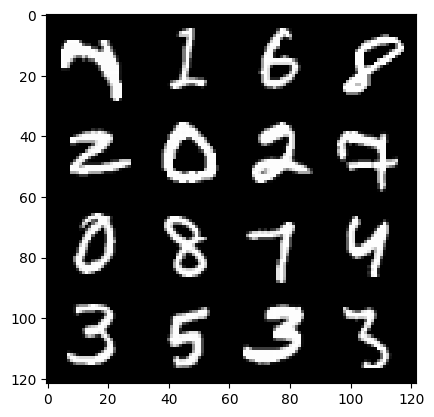

 69%|██████▉   | 324/469 [00:05<00:03, 46.95it/s]

236: step 111000 / Gen loss: 1.8596222114562988 / disc_loss: 0.31675451800227195


 30%|███       | 143/469 [00:02<00:04, 70.60it/s]

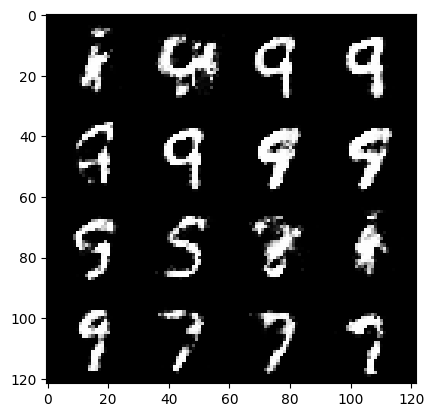

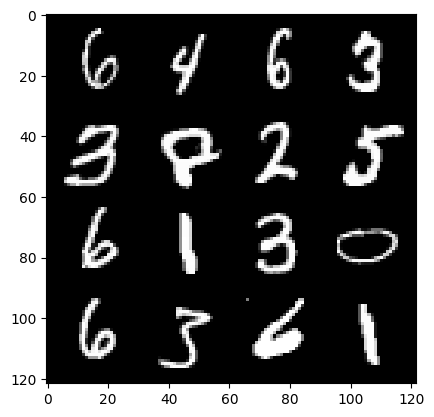

 32%|███▏      | 151/469 [00:02<00:07, 41.87it/s]

237: step 111300 / Gen loss: 1.6822625418504085 / disc_loss: 0.3629628009597462


 95%|█████████▌| 446/469 [00:06<00:00, 72.37it/s]

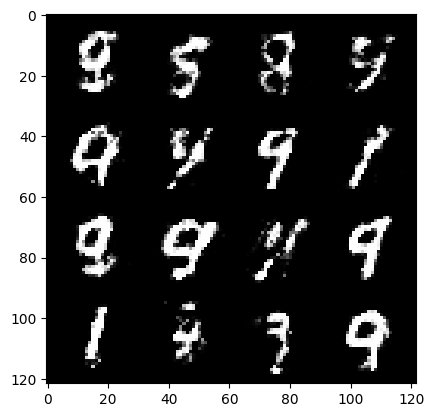

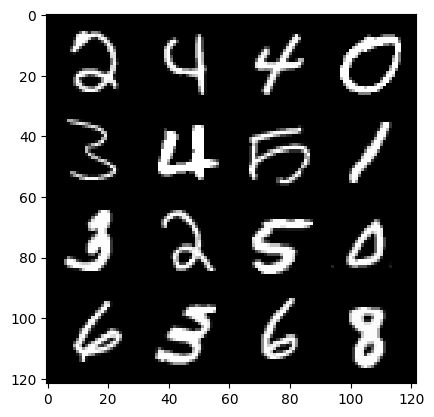

 97%|█████████▋| 454/469 [00:07<00:00, 46.15it/s]

237: step 111600 / Gen loss: 1.7388682949543 / disc_loss: 0.33130362729231516


 58%|█████▊    | 271/469 [00:03<00:02, 66.88it/s]

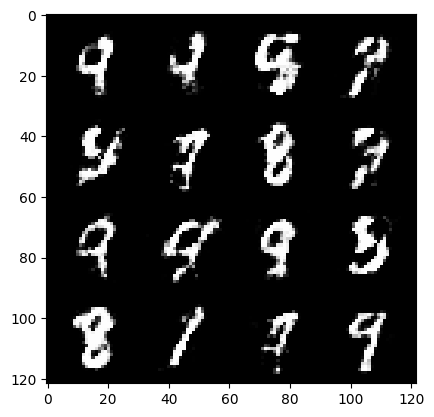

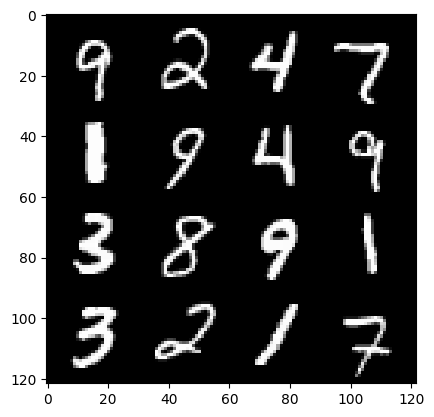

 61%|██████    | 285/469 [00:04<00:04, 42.30it/s]

238: step 111900 / Gen loss: 1.830083794991175 / disc_loss: 0.3238772942125796


 22%|██▏       | 104/469 [00:01<00:05, 61.56it/s]

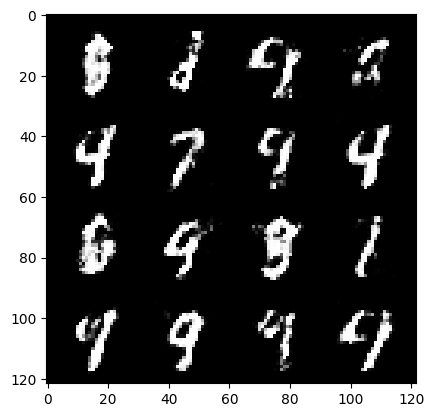

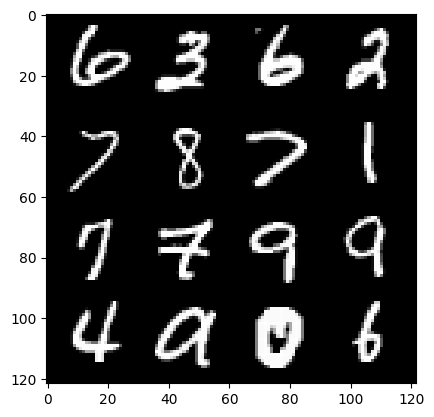

 25%|██▍       | 117/469 [00:02<00:08, 42.89it/s]

239: step 112200 / Gen loss: 1.7389258130391436 / disc_loss: 0.33380364363392195


 87%|████████▋ | 406/469 [00:06<00:00, 70.03it/s]

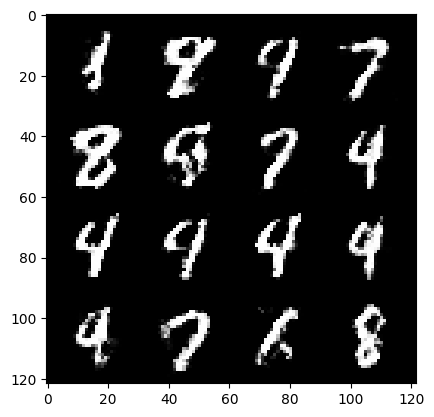

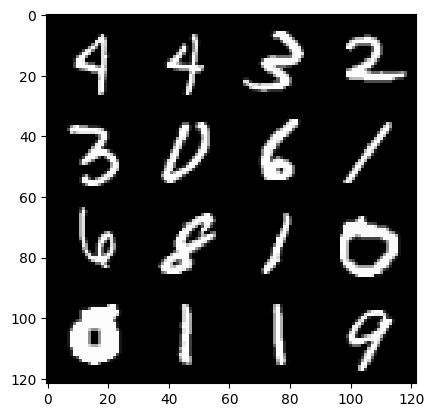

 88%|████████▊ | 414/469 [00:06<00:01, 42.16it/s]

239: step 112500 / Gen loss: 1.743925261100133 / disc_loss: 0.32360643391807864


 50%|█████     | 236/469 [00:03<00:03, 70.08it/s]

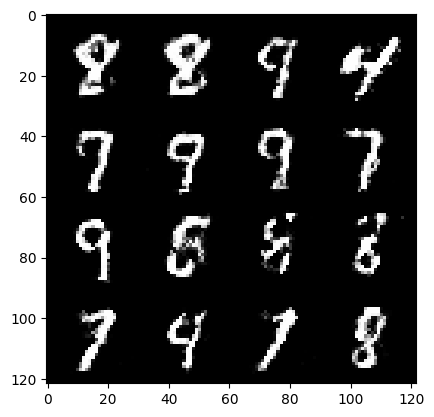

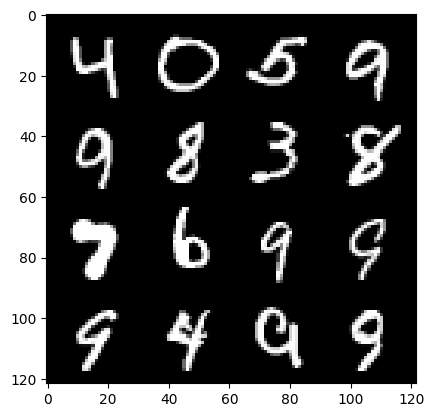

 53%|█████▎    | 250/469 [00:03<00:04, 47.25it/s]

240: step 112800 / Gen loss: 1.8087078436215718 / disc_loss: 0.3144735073049862


 14%|█▍        | 67/469 [00:00<00:06, 66.26it/s]

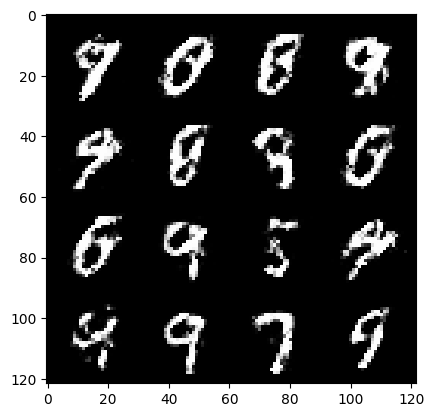

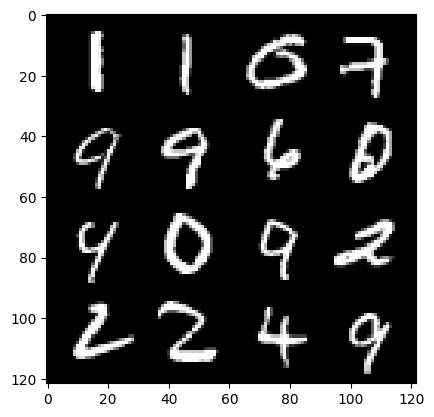

 17%|█▋        | 80/469 [00:01<00:10, 35.70it/s]

241: step 113100 / Gen loss: 1.8548910494645436 / disc_loss: 0.31525775810082746


 78%|███████▊  | 368/469 [00:05<00:01, 63.68it/s]

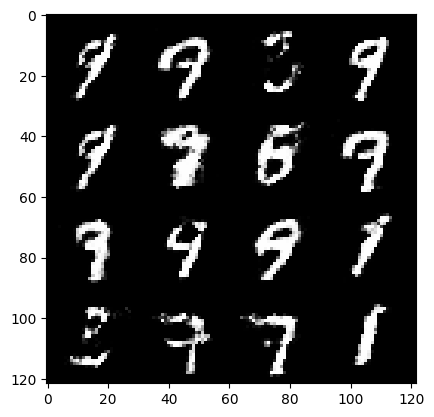

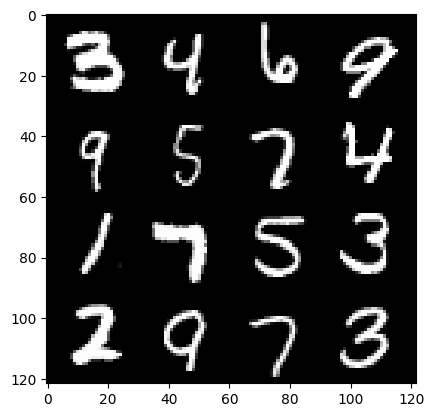

 80%|███████▉  | 375/469 [00:06<00:02, 45.12it/s]

241: step 113400 / Gen loss: 1.725171084801356 / disc_loss: 0.3530019273360568


 42%|████▏     | 196/469 [00:02<00:03, 69.32it/s]

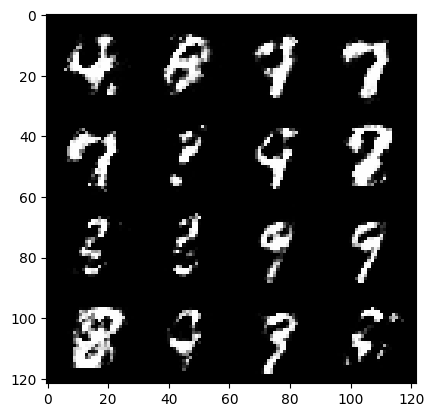

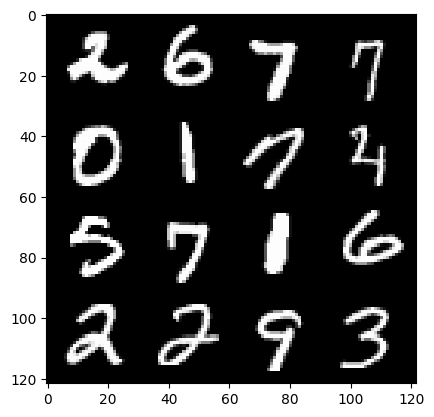

 45%|████▍     | 209/469 [00:03<00:05, 47.82it/s]

242: step 113700 / Gen loss: 1.7206274068355567 / disc_loss: 0.3381159546474615


  6%|▌         | 28/469 [00:00<00:06, 68.64it/s]

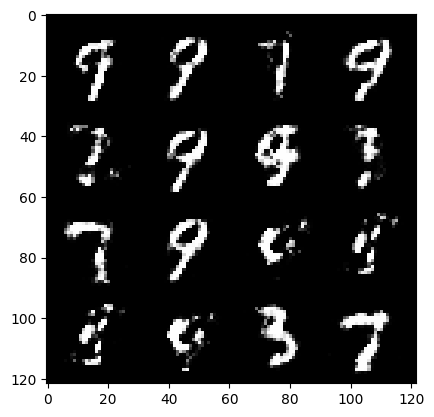

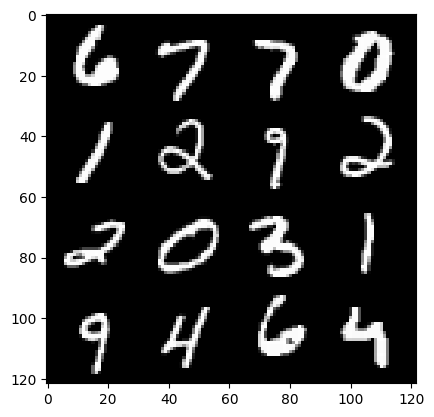

  7%|▋         | 35/469 [00:00<00:09, 44.09it/s]

243: step 114000 / Gen loss: 1.8948423727353418 / disc_loss: 0.29245796258250883


 70%|██████▉   | 326/469 [00:05<00:02, 69.86it/s]

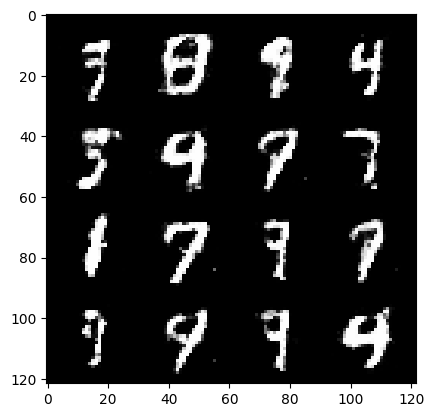

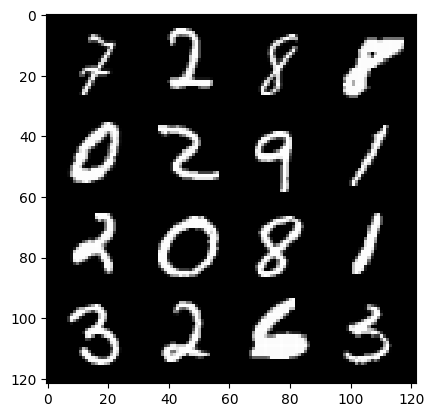

 72%|███████▏  | 340/469 [00:05<00:02, 47.92it/s]

243: step 114300 / Gen loss: 1.7709755516052246 / disc_loss: 0.3232009127239387


 35%|███▍      | 163/469 [00:02<00:04, 71.58it/s]

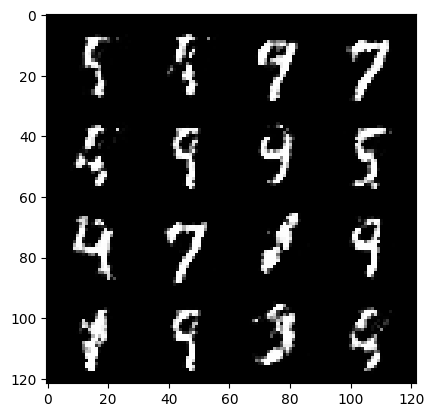

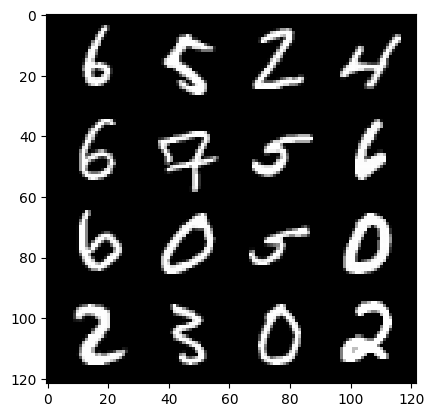

 36%|███▋      | 171/469 [00:02<00:06, 45.42it/s]

244: step 114600 / Gen loss: 1.9080652312437696 / disc_loss: 0.2884754980107149


 98%|█████████▊| 460/469 [00:07<00:00, 63.83it/s]

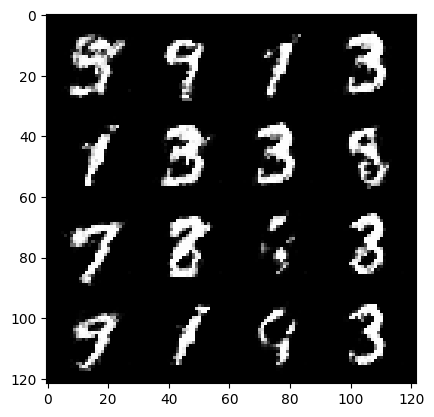

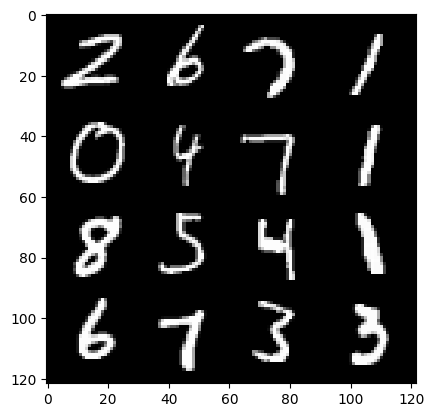

100%|██████████| 469/469 [00:07<00:00, 62.55it/s]


244: step 114900 / Gen loss: 2.0373130782445266 / disc_loss: 0.26667612145344416


 62%|██████▏   | 293/469 [00:04<00:02, 67.82it/s]

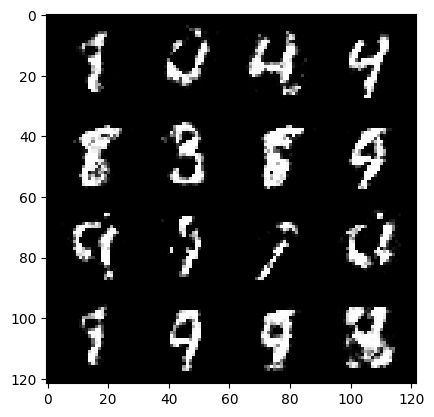

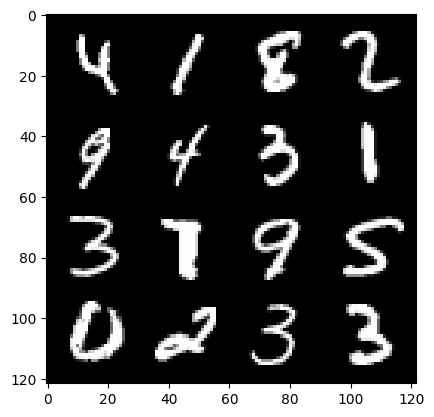

 64%|██████▍   | 300/469 [00:04<00:03, 42.47it/s]

245: step 115200 / Gen loss: 1.914514343341192 / disc_loss: 0.3091821660598119


 26%|██▌       | 121/469 [00:01<00:04, 69.93it/s]

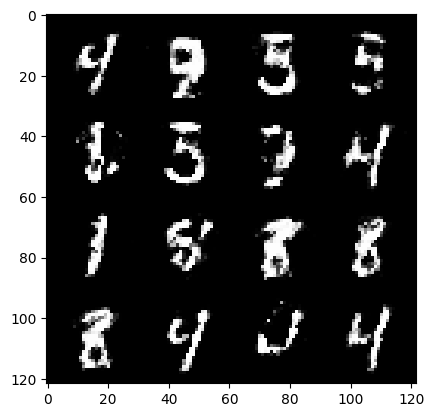

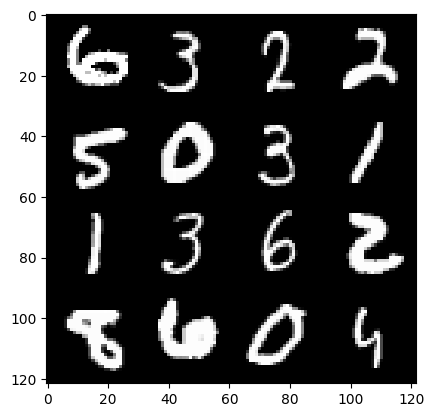

 29%|██▉       | 135/469 [00:02<00:07, 44.14it/s]

246: step 115500 / Gen loss: 1.789623902638753 / disc_loss: 0.33806170831123983


 90%|█████████ | 424/469 [00:06<00:00, 69.03it/s]

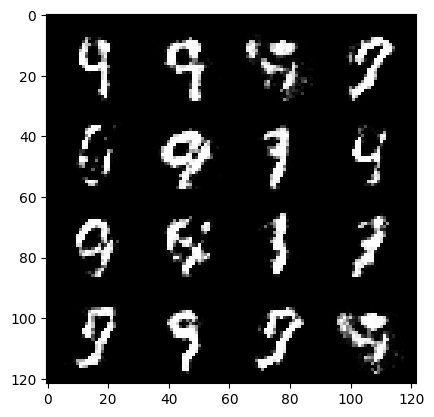

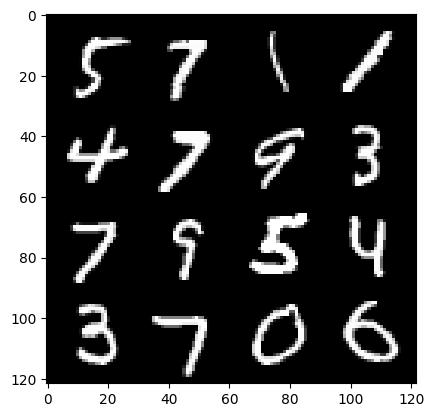

 92%|█████████▏| 431/469 [00:06<00:00, 46.31it/s]

246: step 115800 / Gen loss: 1.7122095370292651 / disc_loss: 0.34446725716193516


 53%|█████▎    | 250/469 [00:03<00:03, 58.40it/s]

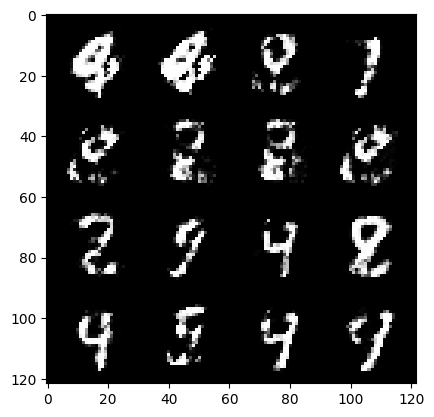

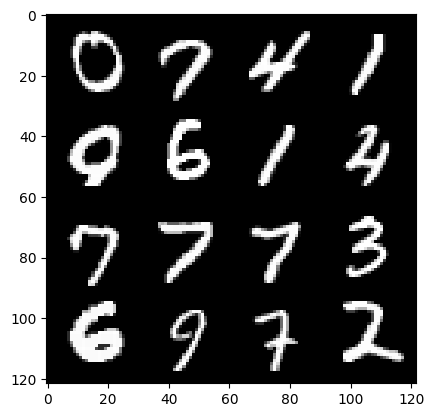

 56%|█████▌    | 263/469 [00:04<00:05, 39.10it/s]

247: step 116100 / Gen loss: 1.8200236002604162 / disc_loss: 0.3184263338148596


 19%|█▉        | 88/469 [00:01<00:05, 71.50it/s]

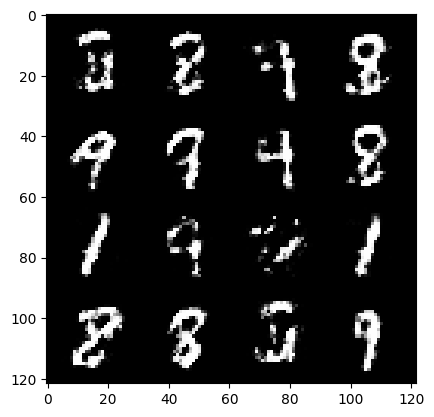

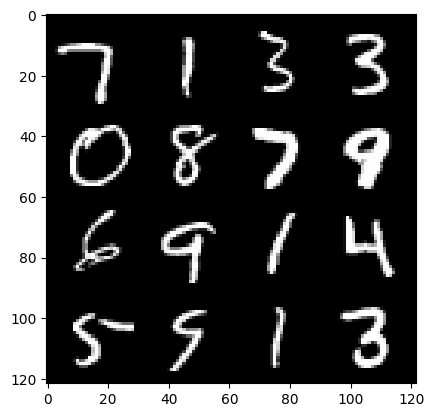

 20%|██        | 96/469 [00:01<00:09, 40.67it/s]

248: step 116400 / Gen loss: 1.8218283863862352 / disc_loss: 0.31889457081755


 83%|████████▎ | 387/469 [00:06<00:01, 73.30it/s]

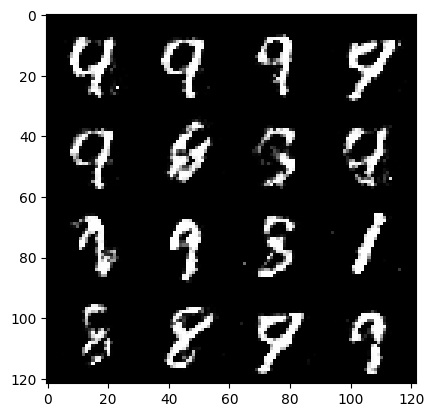

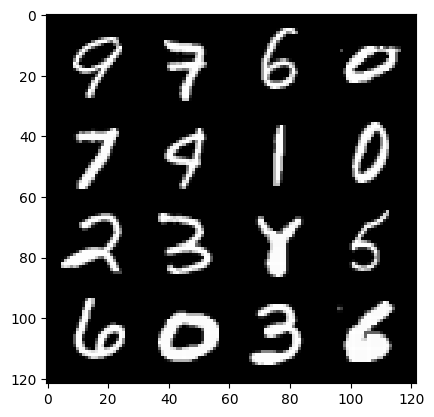

 84%|████████▍ | 395/469 [00:06<00:01, 44.72it/s]

248: step 116700 / Gen loss: 1.6762048387527475 / disc_loss: 0.35945470869541146


 45%|████▌     | 213/469 [00:03<00:03, 70.99it/s]

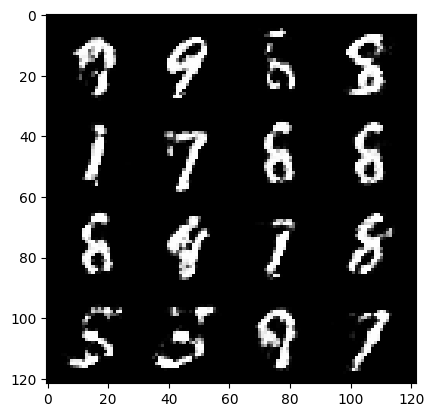

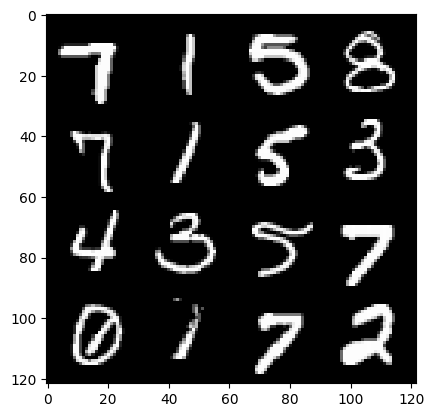

 48%|████▊     | 227/469 [00:03<00:05, 45.06it/s]

249: step 117000 / Gen loss: 1.6748711407184609 / disc_loss: 0.36345201482375433


 10%|▉         | 46/469 [00:00<00:06, 65.90it/s]

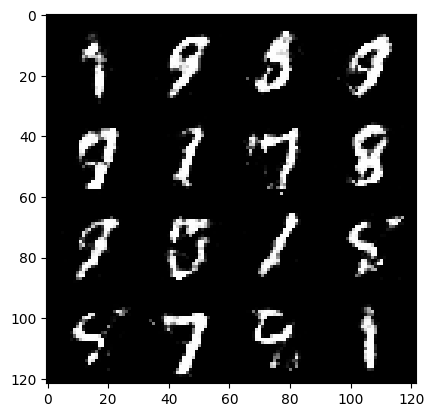

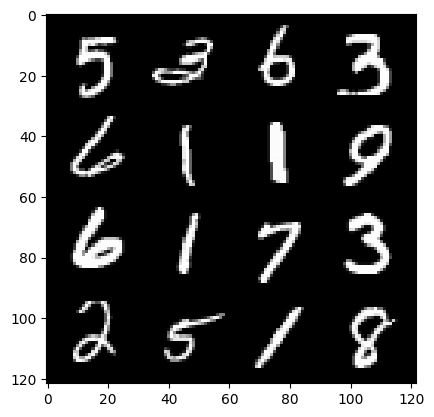

 13%|█▎        | 59/469 [00:01<00:08, 47.12it/s]

250: step 117300 / Gen loss: 1.7204978791872667 / disc_loss: 0.35119839638471584


 74%|███████▎  | 345/469 [00:05<00:01, 73.19it/s]

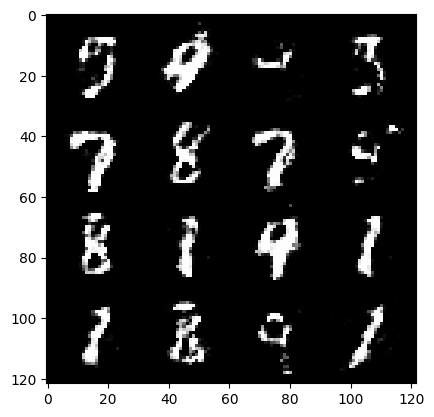

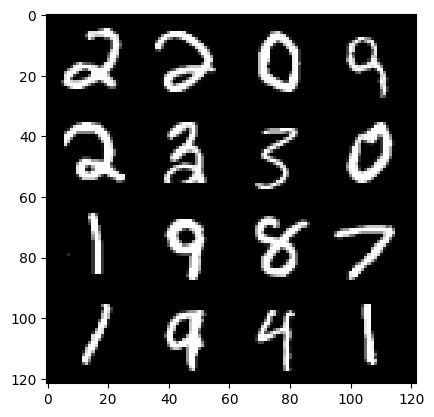

 77%|███████▋  | 360/469 [00:05<00:02, 51.13it/s]

250: step 117600 / Gen loss: 1.686130890448889 / disc_loss: 0.35432828267415384


 38%|███▊      | 178/469 [00:02<00:04, 65.58it/s]

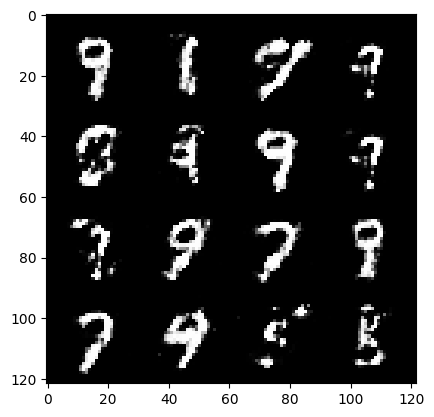

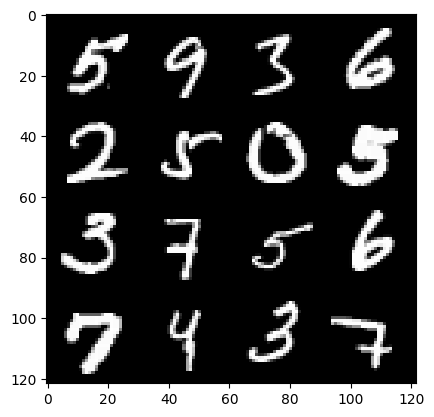

 39%|███▉      | 185/469 [00:02<00:06, 44.07it/s]

251: step 117900 / Gen loss: 1.663816864887873 / disc_loss: 0.34790977060794837


  2%|▏         | 8/469 [00:00<00:06, 70.54it/s]

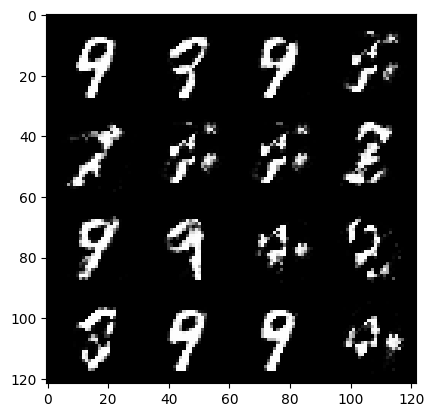

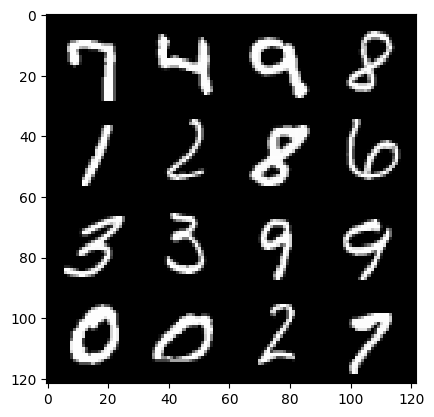

  5%|▍         | 22/469 [00:00<00:11, 38.46it/s]

252: step 118200 / Gen loss: 1.7042994272708896 / disc_loss: 0.34791907489299767


 66%|██████▌   | 310/469 [00:04<00:02, 70.01it/s]

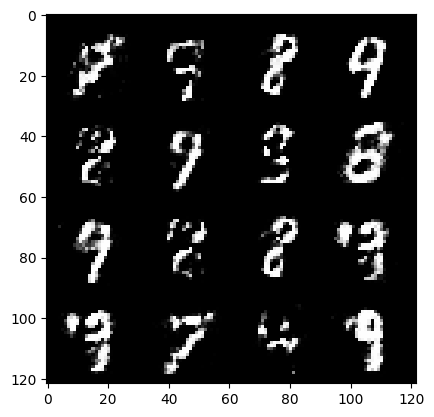

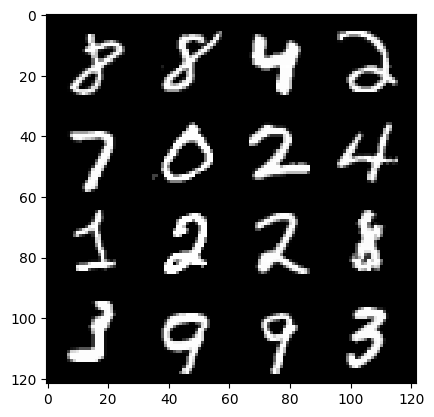

 68%|██████▊   | 318/469 [00:05<00:04, 34.61it/s]

252: step 118500 / Gen loss: 1.7967175201574959 / disc_loss: 0.3233245141307515


 29%|██▉       | 136/469 [00:01<00:05, 63.90it/s]

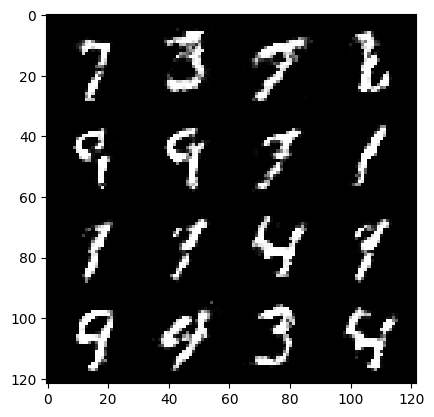

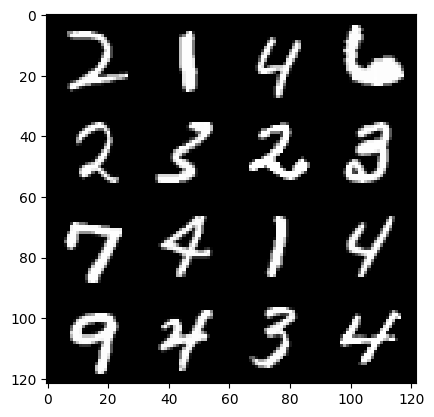

 32%|███▏      | 151/469 [00:02<00:06, 50.57it/s]

253: step 118800 / Gen loss: 1.7885794941584272 / disc_loss: 0.3401988543570041


 93%|█████████▎| 438/469 [00:06<00:00, 69.52it/s]

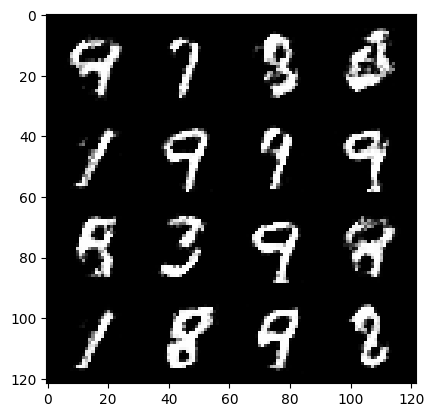

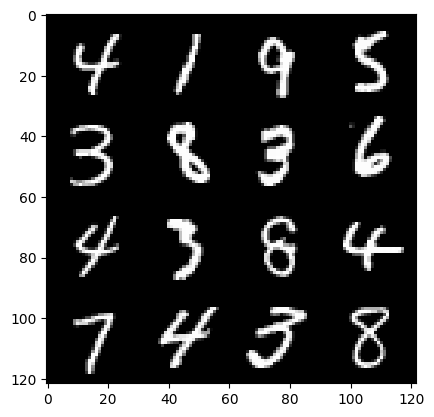

 96%|█████████▋| 452/469 [00:06<00:00, 48.74it/s]

253: step 119100 / Gen loss: 1.6573496957619993 / disc_loss: 0.3506992809971174


 57%|█████▋    | 269/469 [00:03<00:02, 70.54it/s]

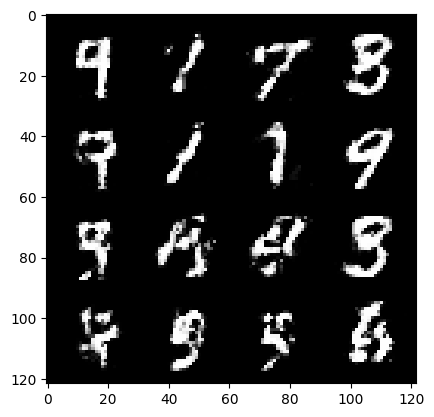

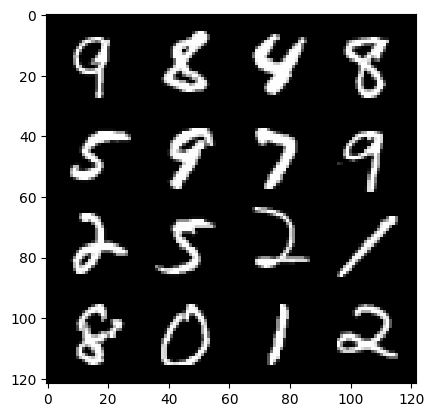

 60%|██████    | 283/469 [00:04<00:03, 47.74it/s]

254: step 119400 / Gen loss: 1.7372040879726407 / disc_loss: 0.34179122835397735


 21%|██▏       | 100/469 [00:01<00:05, 70.64it/s]

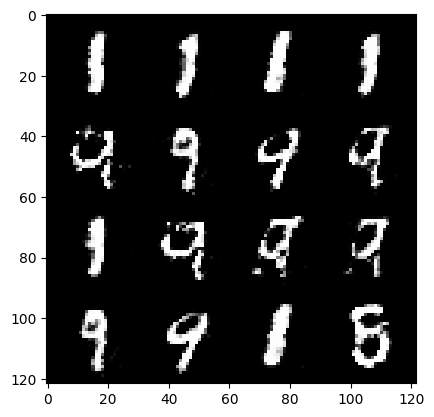

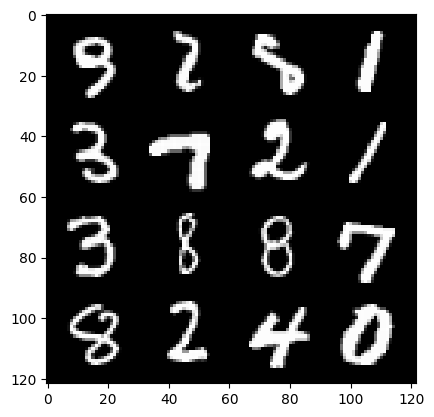

 23%|██▎       | 108/469 [00:01<00:07, 46.19it/s]

255: step 119700 / Gen loss: 1.6499094029267634 / disc_loss: 0.3732314131657284


 86%|████████▌ | 404/469 [00:06<00:01, 62.05it/s]

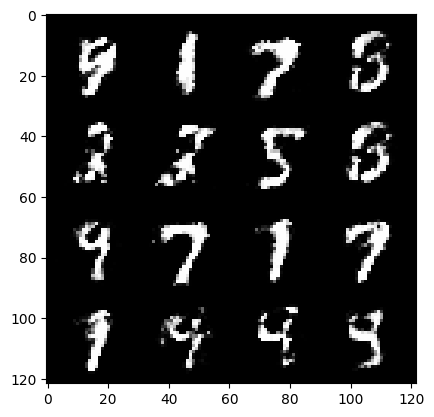

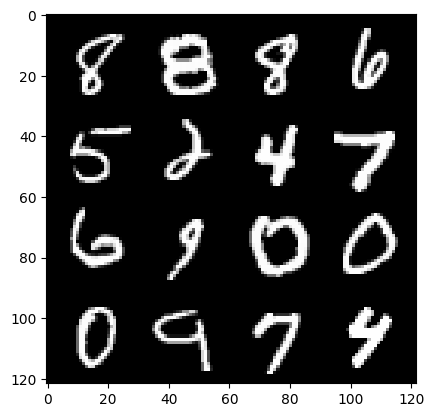

 88%|████████▊ | 411/469 [00:06<00:01, 39.97it/s]

255: step 120000 / Gen loss: 1.5859833892186475 / disc_loss: 0.37558924376964564


 49%|████▉     | 231/469 [00:03<00:03, 65.56it/s]

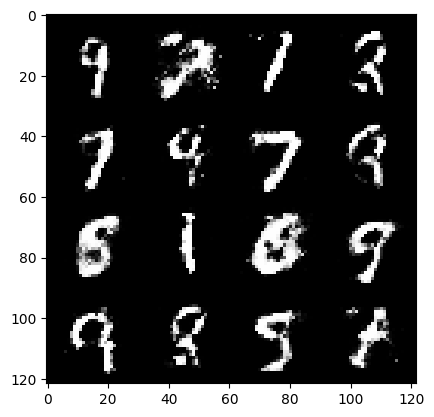

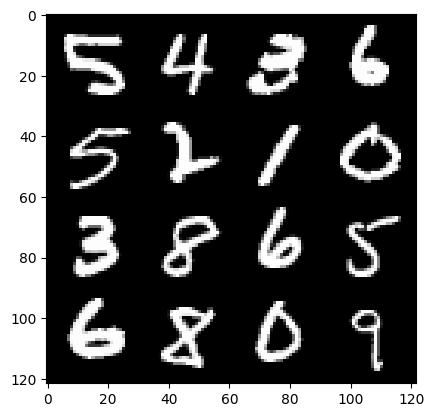

 52%|█████▏    | 244/469 [00:04<00:05, 41.27it/s]

256: step 120300 / Gen loss: 1.6744210108121234 / disc_loss: 0.36042079915603


 13%|█▎        | 61/469 [00:00<00:06, 67.67it/s]

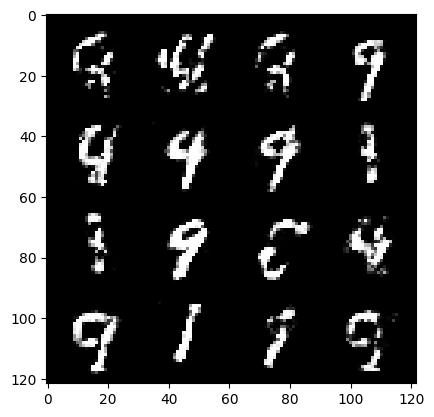

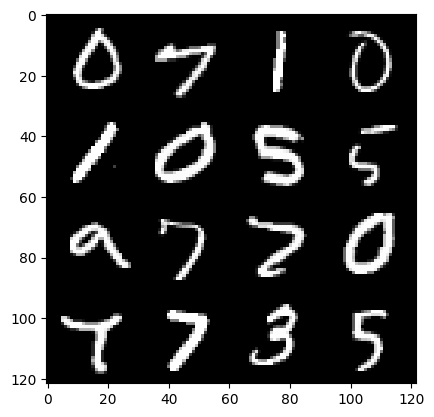

 16%|█▌        | 74/469 [00:01<00:09, 42.74it/s]

257: step 120600 / Gen loss: 1.5544658076763163 / disc_loss: 0.3917324943343797


 78%|███████▊  | 367/469 [00:05<00:01, 66.53it/s]

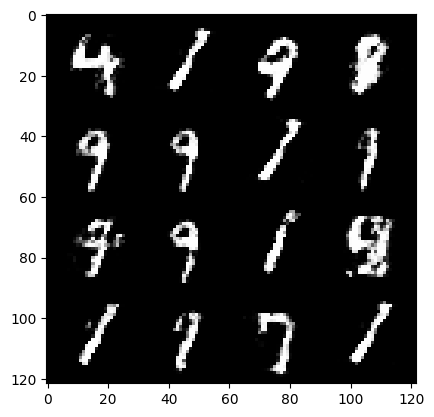

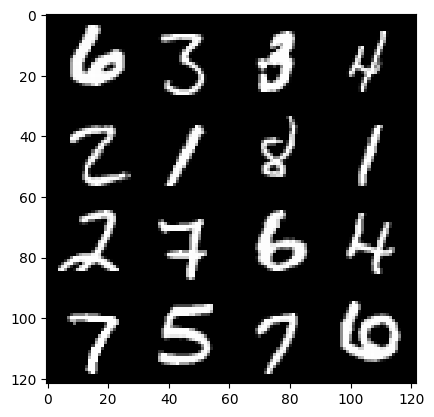

 80%|███████▉  | 374/469 [00:06<00:02, 40.82it/s]

257: step 120900 / Gen loss: 1.6107983950773876 / disc_loss: 0.37373117874066053


 41%|████      | 193/469 [00:02<00:04, 66.88it/s]

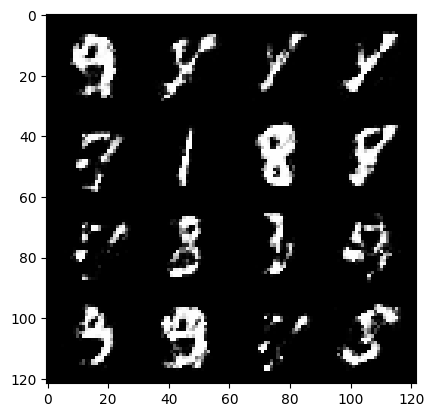

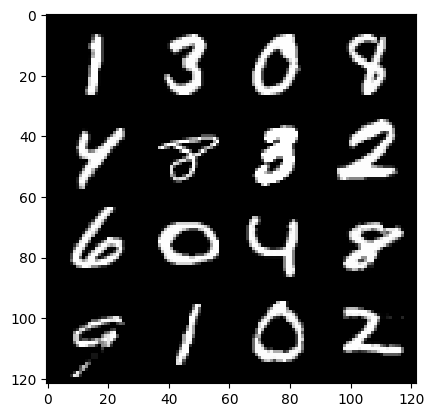

 44%|████▍     | 206/469 [00:03<00:06, 42.25it/s]

258: step 121200 / Gen loss: 1.5414646859963728 / disc_loss: 0.3847116696834564


  5%|▌         | 24/469 [00:00<00:07, 59.02it/s]

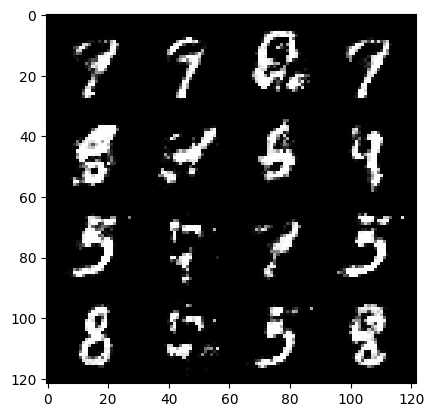

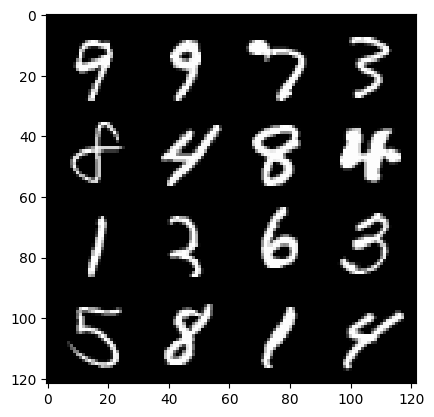

  7%|▋         | 35/469 [00:00<00:11, 39.03it/s]

259: step 121500 / Gen loss: 1.51785492181778 / disc_loss: 0.39634655445814143


 69%|██████▊   | 322/469 [00:05<00:02, 69.66it/s]

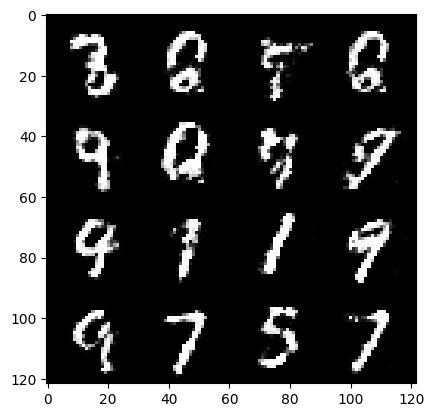

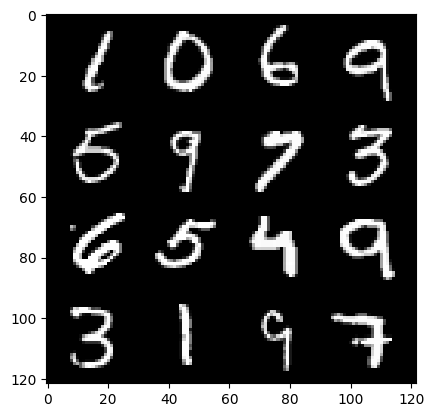

 72%|███████▏  | 336/469 [00:05<00:03, 42.51it/s]

259: step 121800 / Gen loss: 1.5267078069845832 / disc_loss: 0.3932346675793328


 34%|███▍      | 159/469 [00:02<00:04, 63.54it/s]

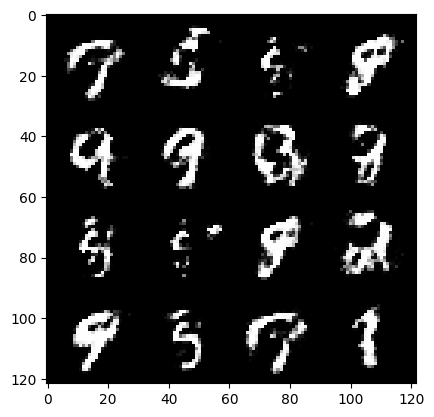

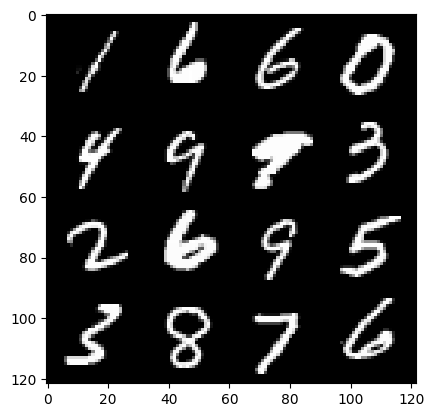

 35%|███▌      | 166/469 [00:02<00:08, 36.29it/s]

260: step 122100 / Gen loss: 1.4740123216311136 / disc_loss: 0.4202066295345622


 97%|█████████▋| 455/469 [00:07<00:00, 63.87it/s]

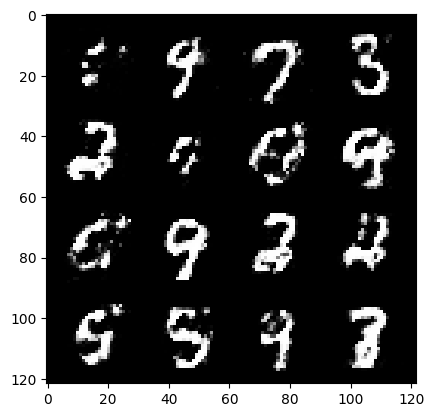

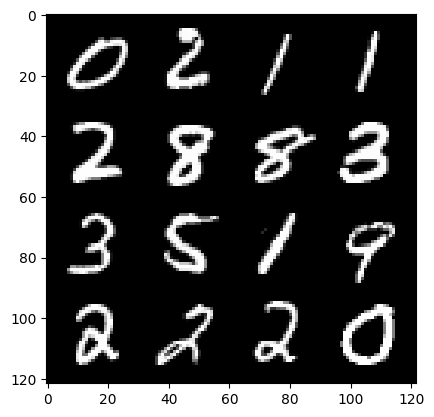

100%|██████████| 469/469 [00:08<00:00, 58.44it/s]


260: step 122400 / Gen loss: 1.5838247215747836 / disc_loss: 0.3950270450115204


 61%|██████    | 286/469 [00:04<00:02, 66.89it/s]

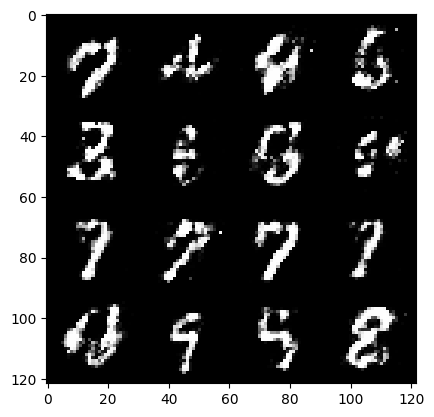

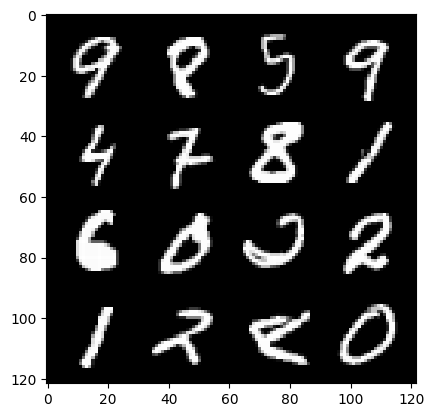

 64%|██████▍   | 299/469 [00:04<00:04, 41.59it/s]

261: step 122700 / Gen loss: 1.5228876948356622 / disc_loss: 0.41093293031056743


 25%|██▍       | 117/469 [00:01<00:05, 66.05it/s]

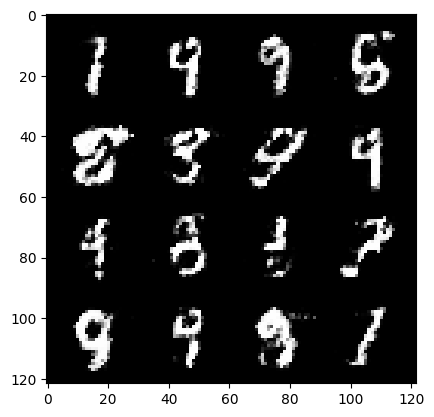

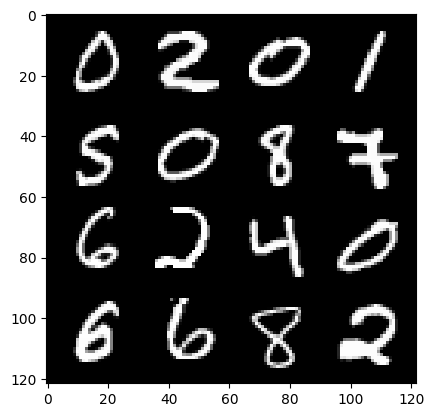

 28%|██▊       | 130/469 [00:02<00:07, 42.69it/s]

262: step 123000 / Gen loss: 1.4483711306254086 / disc_loss: 0.40652618487675984


 90%|████████▉ | 422/469 [00:06<00:00, 62.18it/s]

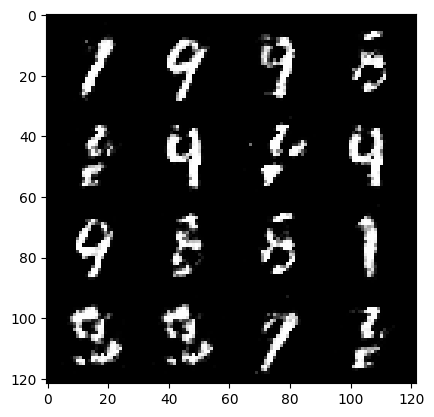

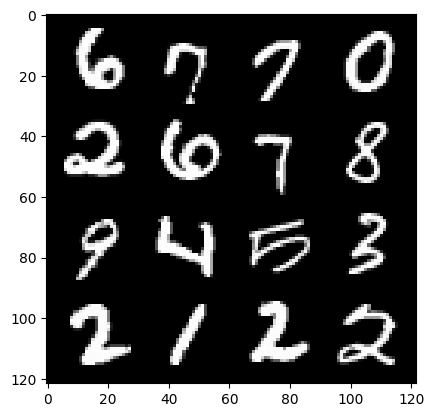

 91%|█████████▏| 429/469 [00:07<00:00, 42.17it/s]

262: step 123300 / Gen loss: 1.5369031079610191 / disc_loss: 0.39232394486665734


 53%|█████▎    | 249/469 [00:03<00:03, 70.08it/s]

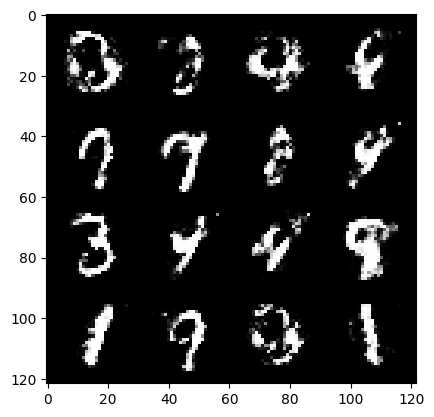

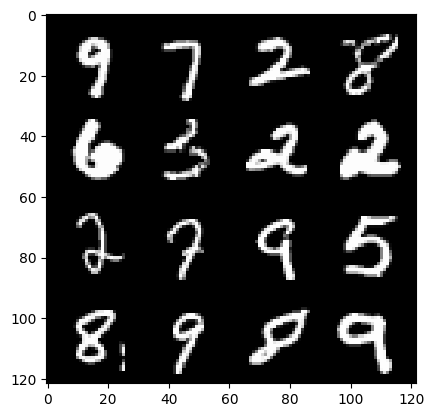

 55%|█████▍    | 257/469 [00:04<00:05, 41.84it/s]

263: step 123600 / Gen loss: 1.5731298947334293 / disc_loss: 0.38610508839289337


 17%|█▋        | 79/469 [00:01<00:05, 66.62it/s]

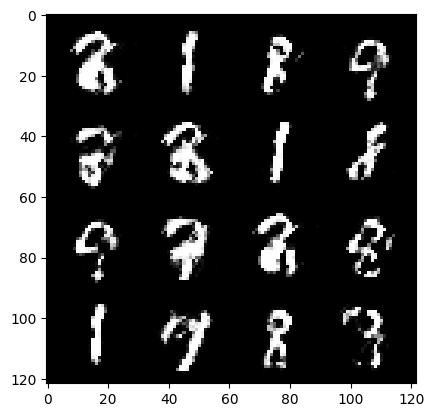

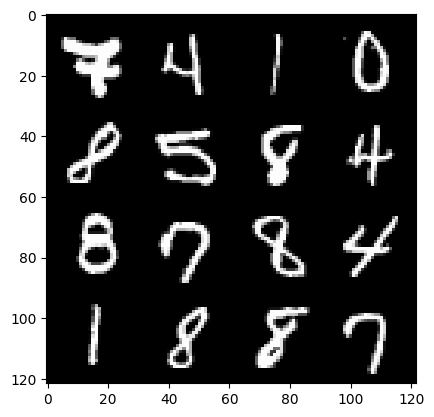

 20%|█▉        | 92/469 [00:01<00:08, 45.42it/s]

264: step 123900 / Gen loss: 1.5603077661991123 / disc_loss: 0.3892361843585971


 81%|████████▏ | 382/469 [00:06<00:01, 68.96it/s]

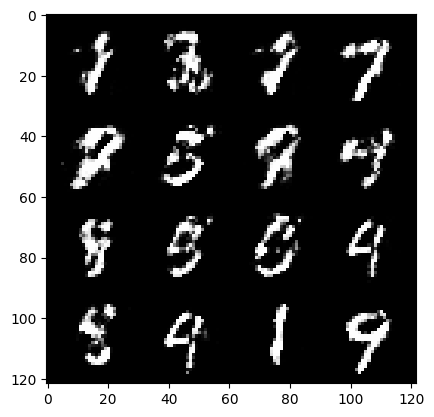

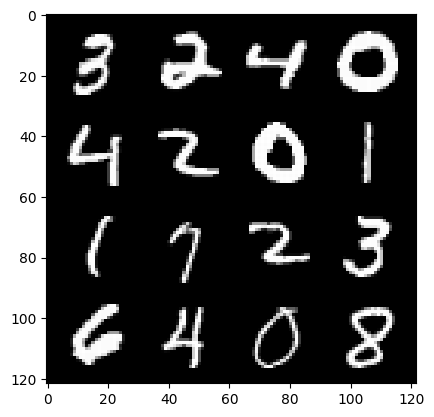

 83%|████████▎ | 389/469 [00:06<00:02, 38.41it/s]

264: step 124200 / Gen loss: 1.6157475090026856 / disc_loss: 0.3640788655479749


 45%|████▍     | 211/469 [00:03<00:03, 68.22it/s]

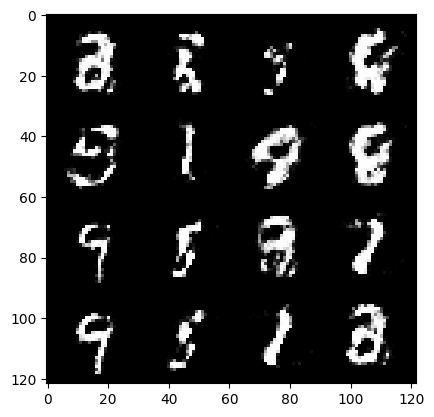

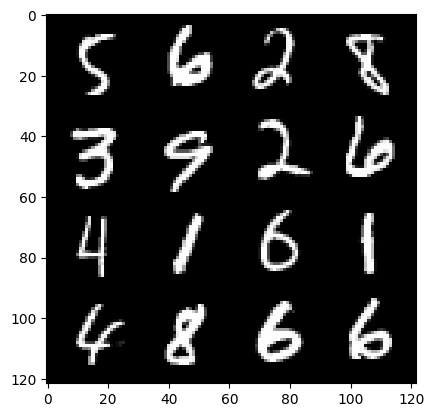

 46%|████▋     | 218/469 [00:03<00:05, 42.53it/s]

265: step 124500 / Gen loss: 1.6468483416239408 / disc_loss: 0.359882439871629


  8%|▊         | 39/469 [00:00<00:06, 67.94it/s]

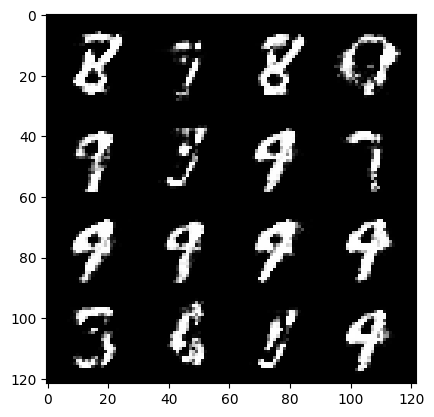

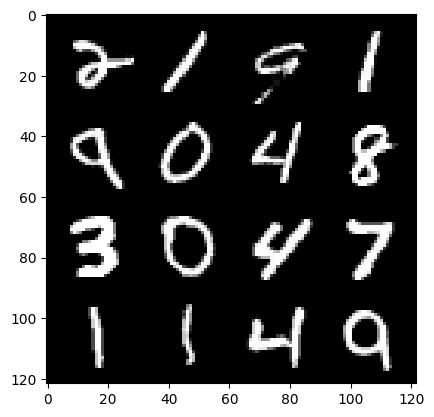

 11%|█▏        | 53/469 [00:00<00:08, 46.65it/s]

266: step 124800 / Gen loss: 1.5749969303607947 / disc_loss: 0.37315273940563226


 73%|███████▎  | 343/469 [00:05<00:01, 68.31it/s]

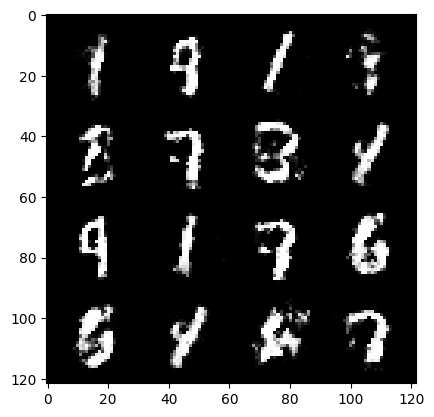

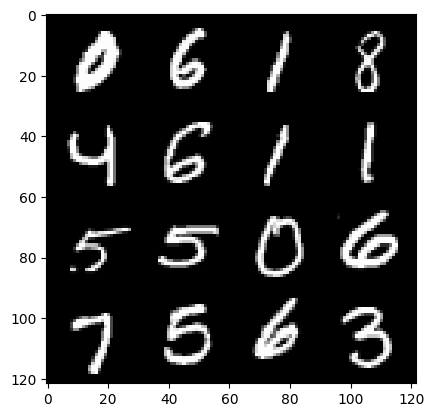

 75%|███████▍  | 350/469 [00:05<00:02, 42.06it/s]

266: step 125100 / Gen loss: 1.7171656028429652 / disc_loss: 0.3441987963517507


 37%|███▋      | 174/469 [00:02<00:04, 70.05it/s]

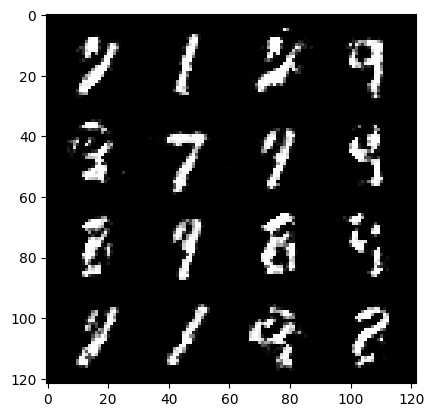

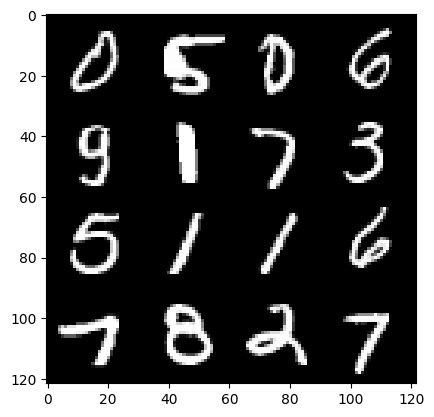

 39%|███▉      | 182/469 [00:02<00:06, 43.22it/s]

267: step 125400 / Gen loss: 1.6098046938578296 / disc_loss: 0.37934196362892797


  1%|▏         | 7/469 [00:00<00:07, 65.04it/s]

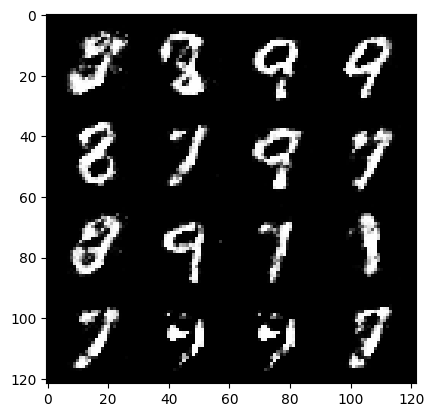

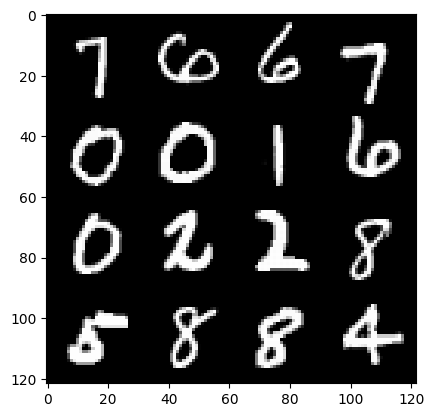

  3%|▎         | 14/469 [00:00<00:15, 29.88it/s]

268: step 125700 / Gen loss: 1.626139288345973 / disc_loss: 0.36764796763658514


 64%|██████▍   | 302/469 [00:04<00:02, 73.35it/s]

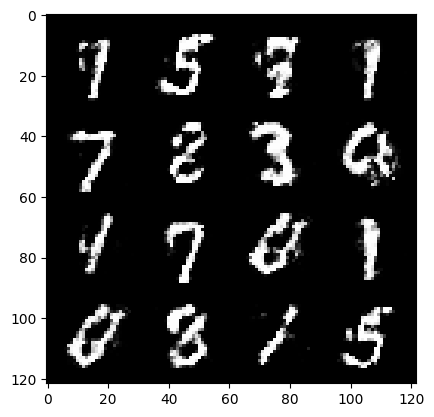

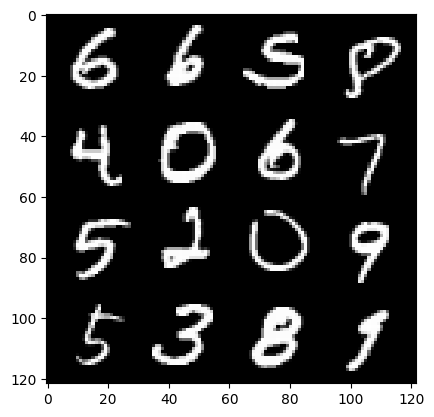

 68%|██████▊   | 317/469 [00:05<00:03, 47.27it/s]

268: step 126000 / Gen loss: 1.5543223305543263 / disc_loss: 0.38843161573012697


 28%|██▊       | 133/469 [00:01<00:05, 64.53it/s]

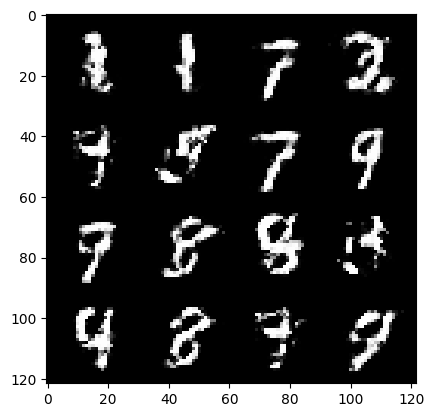

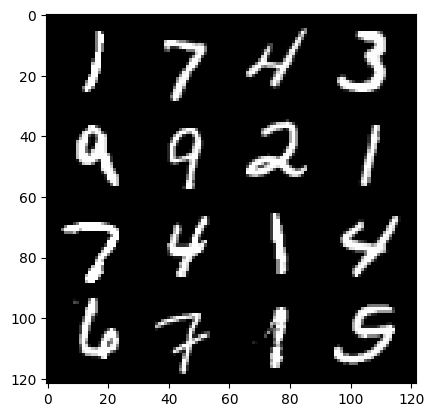

 31%|███       | 146/469 [00:02<00:08, 40.13it/s]

269: step 126300 / Gen loss: 1.5489802745978036 / disc_loss: 0.39891965627670284


 93%|█████████▎| 437/469 [00:07<00:00, 68.29it/s]

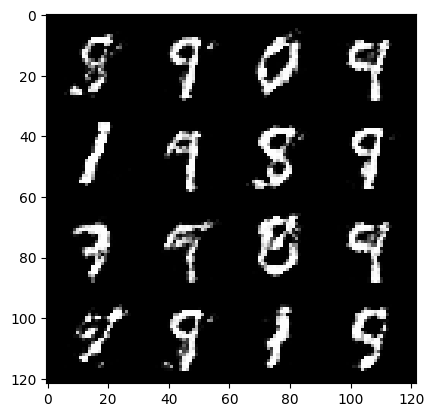

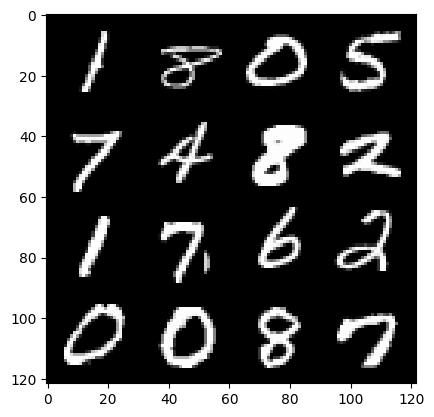

 95%|█████████▍| 444/469 [00:07<00:00, 43.18it/s]

269: step 126600 / Gen loss: 1.529096366961797 / disc_loss: 0.40005048026641216


 58%|█████▊    | 270/469 [00:03<00:02, 67.76it/s]

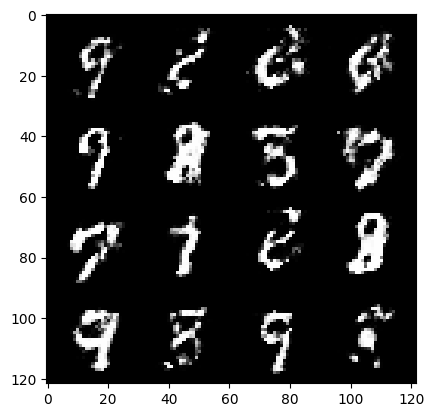

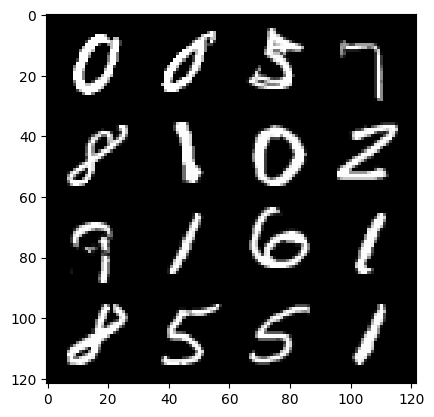

 59%|█████▉    | 277/469 [00:04<00:04, 39.43it/s]

270: step 126900 / Gen loss: 1.6224349176883701 / disc_loss: 0.364026838839054


 20%|██        | 94/469 [00:01<00:05, 71.59it/s]

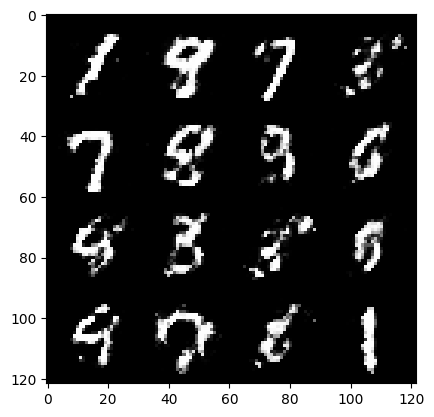

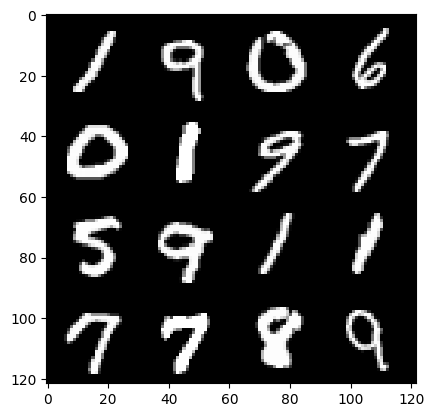

 23%|██▎       | 108/469 [00:01<00:07, 45.68it/s]

271: step 127200 / Gen loss: 1.5087885518868773 / disc_loss: 0.3944793872038526


 85%|████████▌ | 400/469 [00:06<00:01, 64.11it/s]

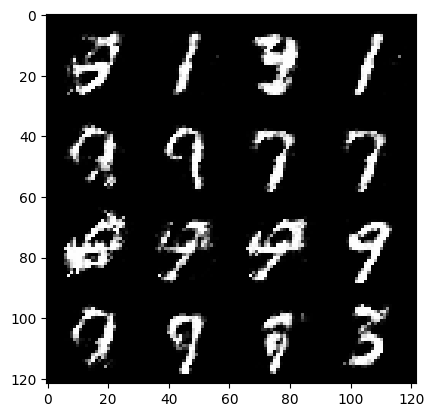

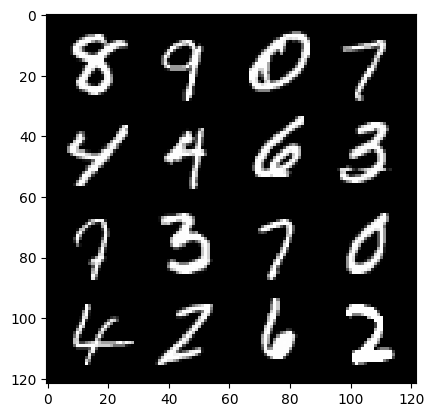

 87%|████████▋ | 407/469 [00:06<00:01, 39.43it/s]

271: step 127500 / Gen loss: 1.54701491355896 / disc_loss: 0.381341225107511


 49%|████▉     | 231/469 [00:03<00:03, 67.89it/s]

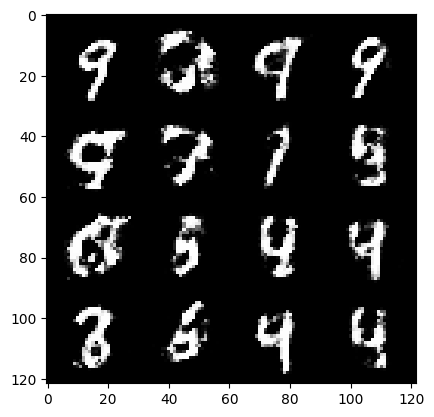

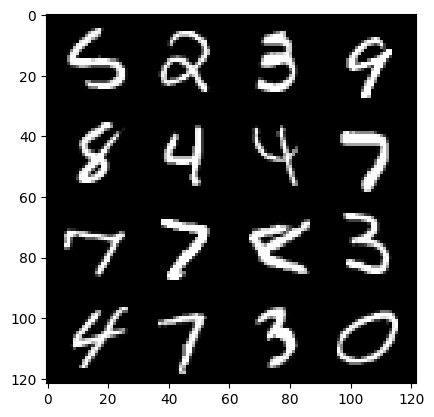

 51%|█████     | 238/469 [00:03<00:05, 41.31it/s]

272: step 127800 / Gen loss: 1.6439787093798317 / disc_loss: 0.376763194600741


 13%|█▎        | 62/469 [00:00<00:06, 63.88it/s]

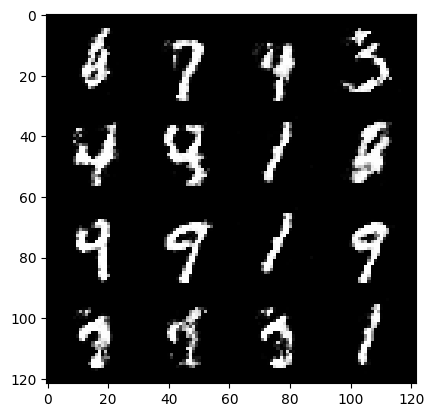

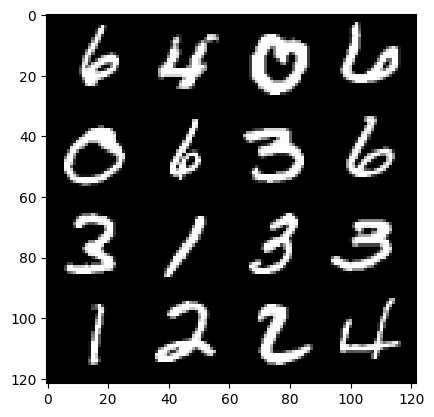

 15%|█▍        | 69/469 [00:01<00:09, 40.72it/s]

273: step 128100 / Gen loss: 1.578820704221726 / disc_loss: 0.38754305015007645


 76%|███████▌  | 356/469 [00:05<00:01, 73.13it/s]

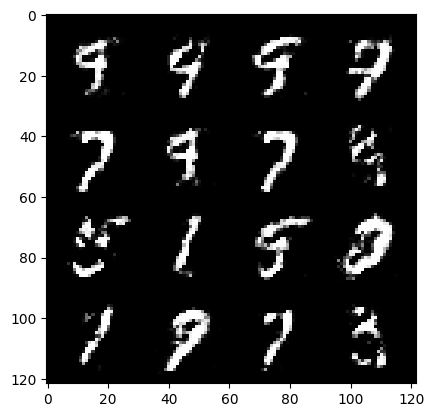

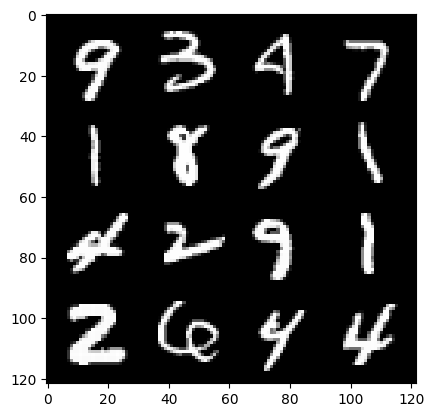

 79%|███████▉  | 370/469 [00:06<00:02, 46.60it/s]

273: step 128400 / Gen loss: 1.5107997155189532 / disc_loss: 0.3958194124698639


 40%|███▉      | 187/469 [00:02<00:04, 65.52it/s]

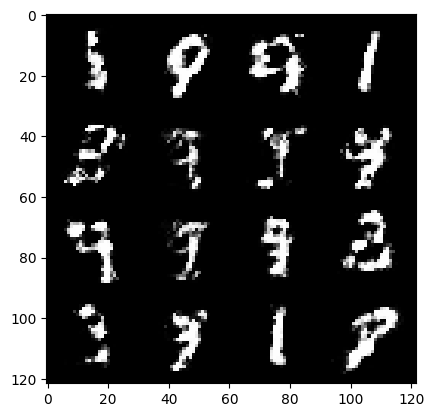

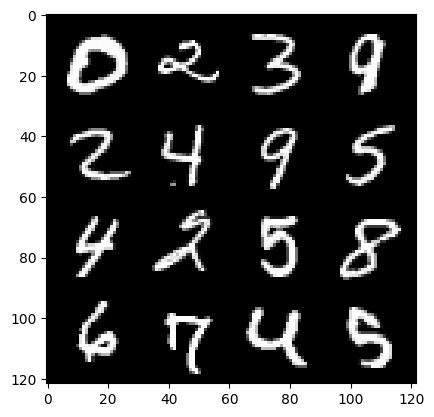

 43%|████▎     | 201/469 [00:03<00:05, 46.70it/s]

274: step 128700 / Gen loss: 1.4548868119716638 / disc_loss: 0.403250998953978


  4%|▍         | 21/469 [00:00<00:06, 66.90it/s]

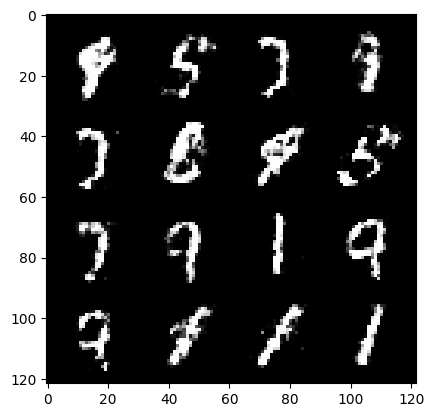

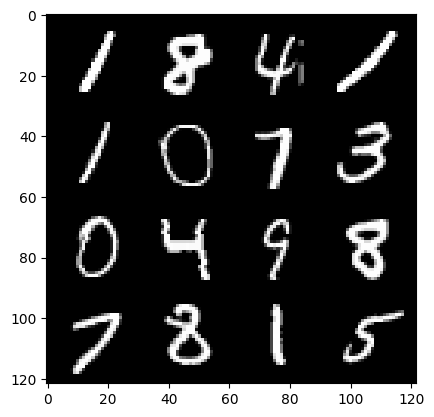

  6%|▌         | 28/469 [00:00<00:11, 39.99it/s]

275: step 129000 / Gen loss: 1.5281751366456349 / disc_loss: 0.38925663977861386


 68%|██████▊   | 320/469 [00:05<00:02, 68.97it/s]

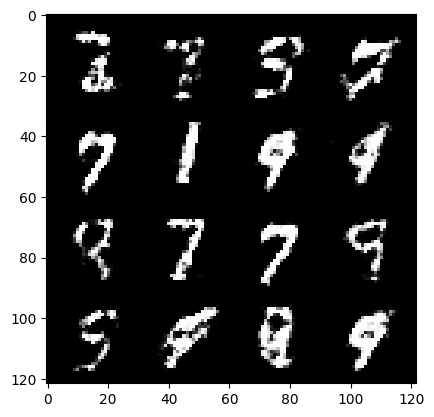

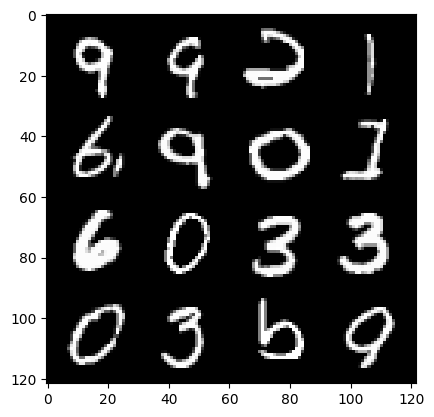

 71%|███████   | 333/469 [00:05<00:03, 43.20it/s]

275: step 129300 / Gen loss: 1.6113965249061581 / disc_loss: 0.3698532861471175


 32%|███▏      | 150/469 [00:02<00:04, 64.84it/s]

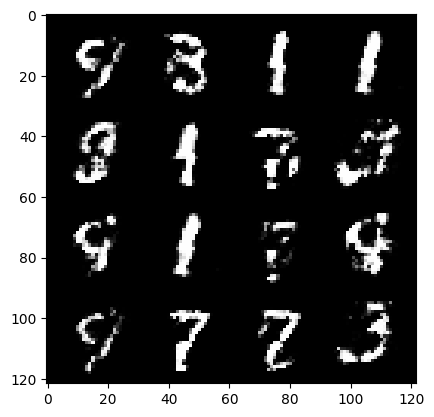

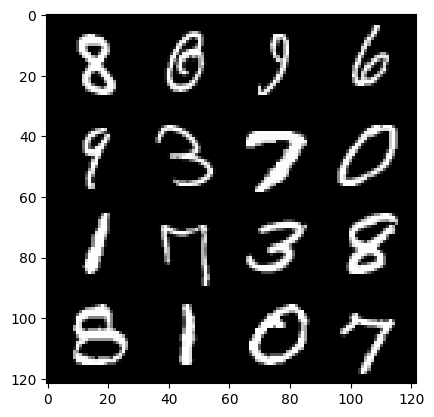

 35%|███▍      | 163/469 [00:02<00:07, 42.66it/s]

276: step 129600 / Gen loss: 1.5086820646127073 / disc_loss: 0.40119076510270446


 97%|█████████▋| 455/469 [00:07<00:00, 64.24it/s]

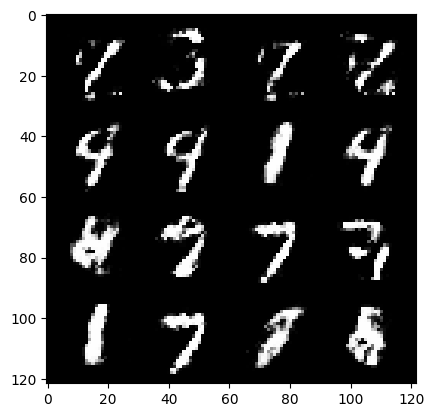

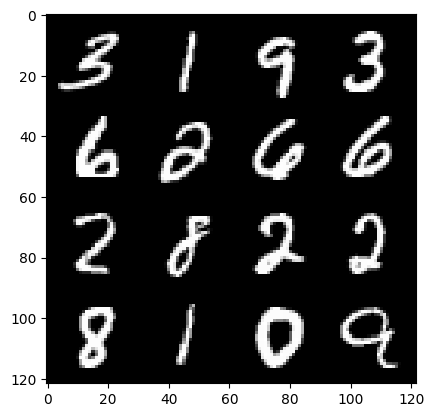

 99%|█████████▊| 462/469 [00:07<00:00, 35.45it/s]

276: step 129900 / Gen loss: 1.5378576842943832 / disc_loss: 0.3812287774682046


 60%|██████    | 283/469 [00:04<00:02, 65.88it/s]

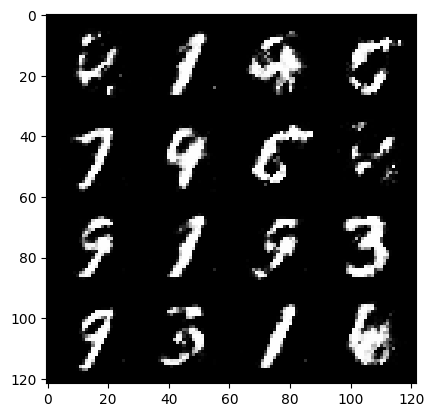

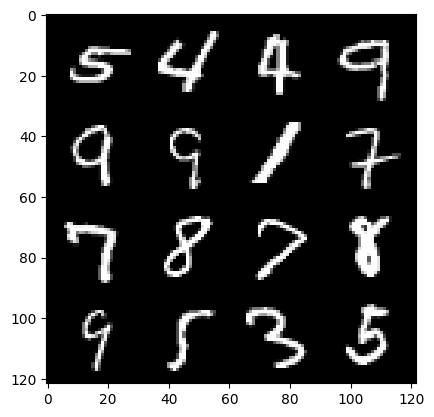

 62%|██████▏   | 290/469 [00:04<00:04, 42.20it/s]

277: step 130200 / Gen loss: 1.4598651687304187 / disc_loss: 0.4088584478696188


 24%|██▍       | 112/469 [00:01<00:05, 70.40it/s]

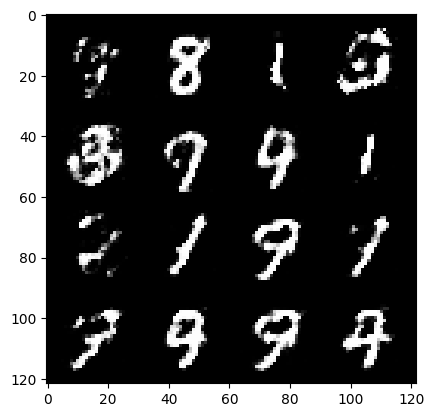

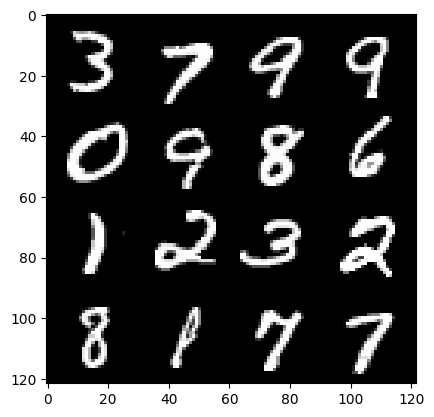

 27%|██▋       | 126/469 [00:02<00:08, 40.85it/s]

278: step 130500 / Gen loss: 1.4611494342486064 / disc_loss: 0.3991195964813232


 88%|████████▊ | 415/469 [00:06<00:00, 72.34it/s]

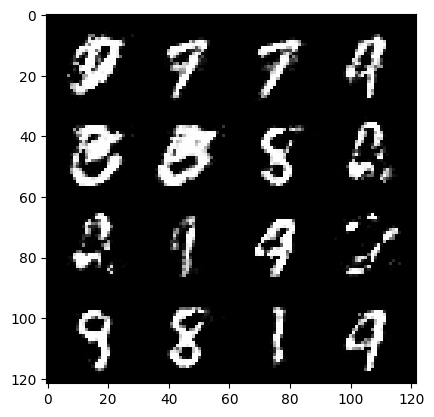

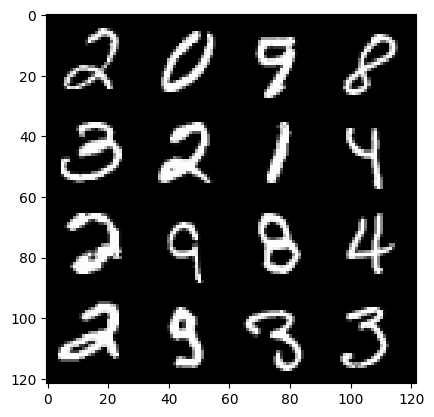

 90%|█████████ | 423/469 [00:06<00:01, 45.38it/s]

278: step 130800 / Gen loss: 1.347892693281174 / disc_loss: 0.42386035948991774


 52%|█████▏    | 242/469 [00:03<00:03, 68.52it/s]

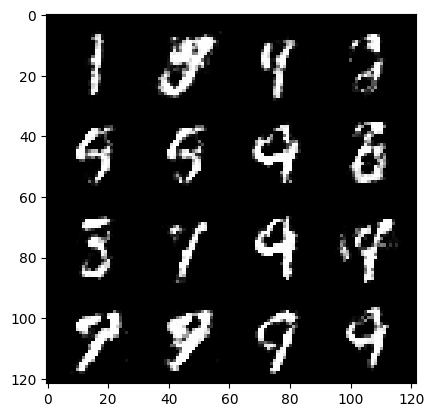

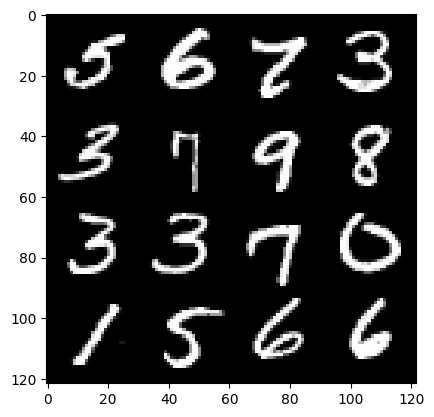

 55%|█████▍    | 256/469 [00:04<00:05, 41.74it/s]

279: step 131100 / Gen loss: 1.4271755448977155 / disc_loss: 0.39785877128442126


 17%|█▋        | 78/469 [00:01<00:05, 68.29it/s]

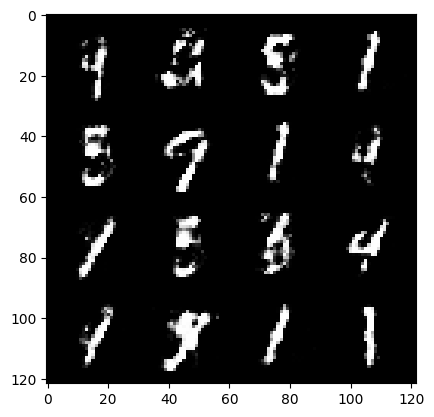

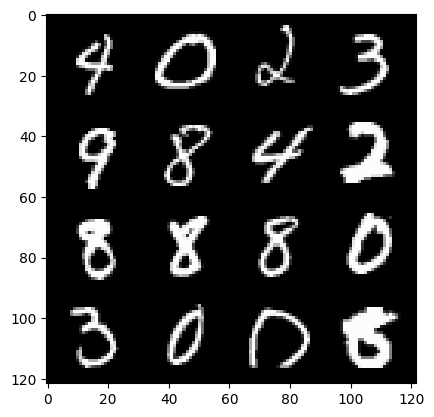

 19%|█▉        | 91/469 [00:01<00:08, 44.55it/s]

280: step 131400 / Gen loss: 1.4904102571805324 / disc_loss: 0.39792074700196567


 81%|████████  | 378/469 [00:05<00:01, 73.86it/s]

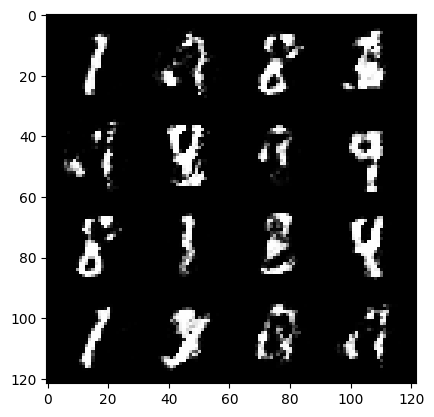

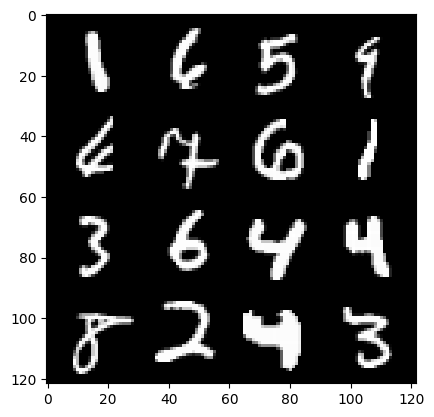

 82%|████████▏ | 386/469 [00:06<00:01, 46.05it/s]

280: step 131700 / Gen loss: 1.5038650095462793 / disc_loss: 0.38450148671865503


 44%|████▎     | 205/469 [00:02<00:03, 66.38it/s]

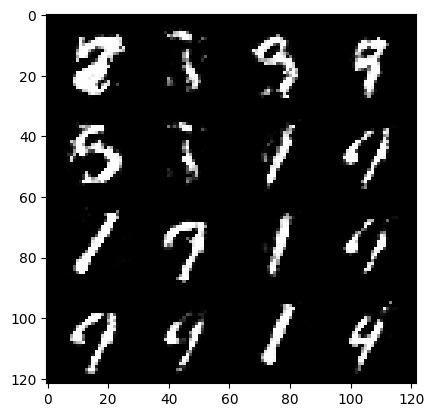

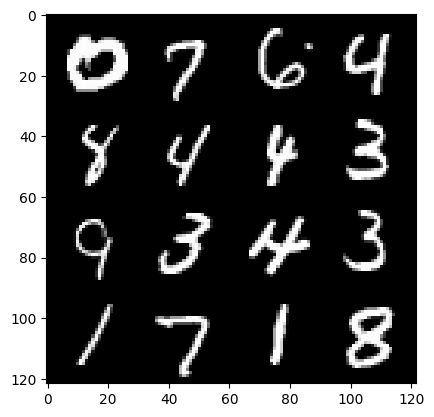

 46%|████▋     | 218/469 [00:03<00:05, 41.85it/s]

281: step 132000 / Gen loss: 1.474838776588441 / disc_loss: 0.3927015327413875


  8%|▊         | 37/469 [00:00<00:06, 68.57it/s]

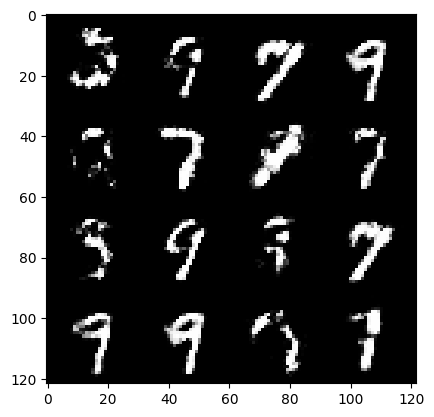

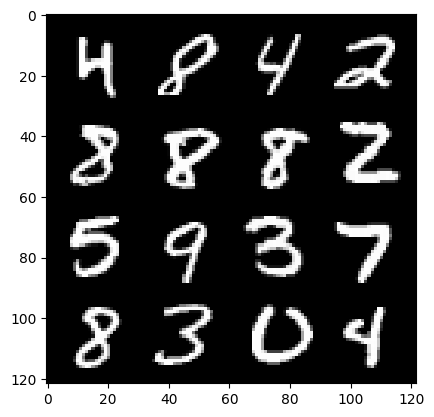

 11%|█         | 50/469 [00:00<00:09, 46.24it/s]

282: step 132300 / Gen loss: 1.4692991161346445 / disc_loss: 0.40340733269850415


 73%|███████▎  | 342/469 [00:05<00:01, 68.75it/s]

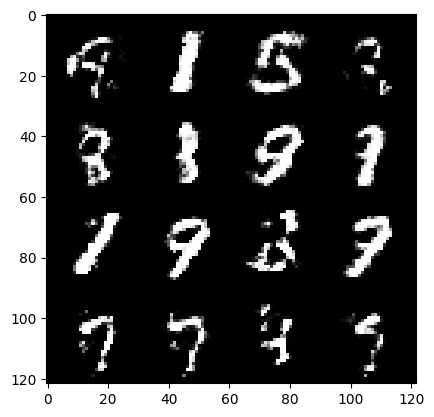

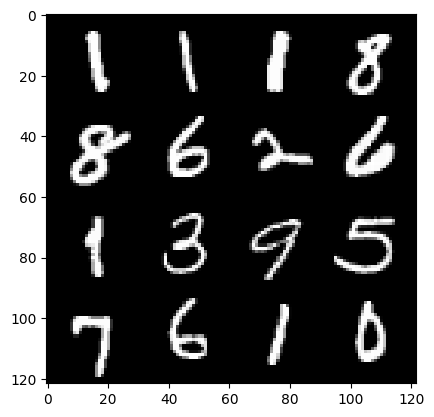

 74%|███████▍  | 349/469 [00:05<00:02, 43.52it/s]

282: step 132600 / Gen loss: 1.5046525665124253 / disc_loss: 0.3912064043680828


 37%|███▋      | 172/469 [00:02<00:04, 67.70it/s]

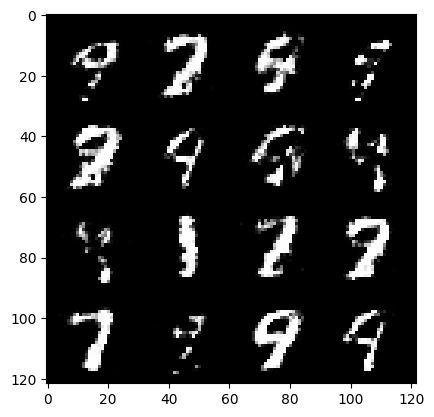

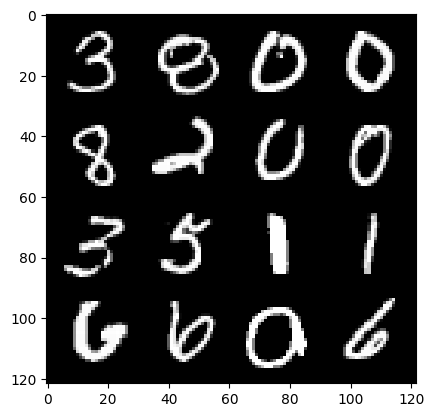

 38%|███▊      | 179/469 [00:02<00:06, 43.39it/s]

283: step 132900 / Gen loss: 1.6506029395262396 / disc_loss: 0.34119046310583734


  0%|          | 0/469 [00:00<?, ?it/s]

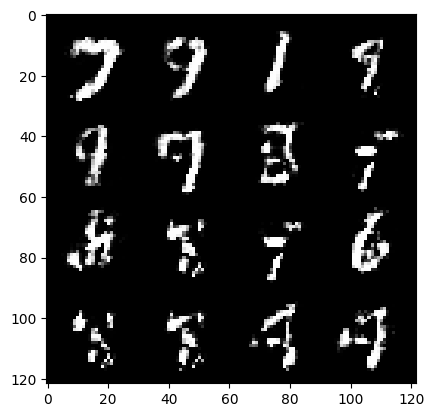

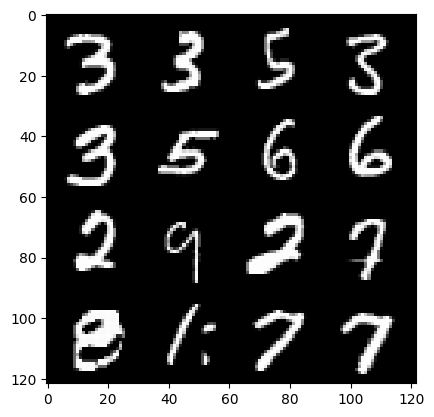

  2%|▏         | 10/469 [00:00<00:15, 29.72it/s]

284: step 133200 / Gen loss: 1.6963556651274363 / disc_loss: 0.3342434640725455


 64%|██████▍   | 301/469 [00:04<00:02, 70.32it/s]

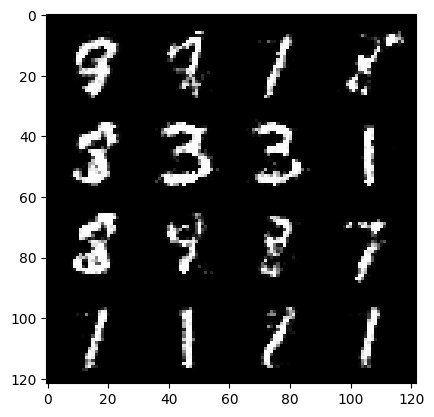

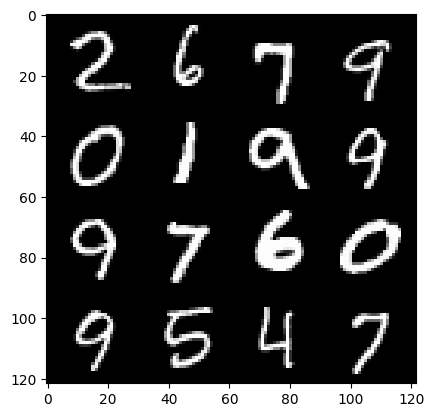

 66%|██████▌   | 309/469 [00:04<00:03, 43.32it/s]

284: step 133500 / Gen loss: 1.6028570059935257 / disc_loss: 0.36680728852748895


 28%|██▊       | 129/469 [00:01<00:05, 66.44it/s]

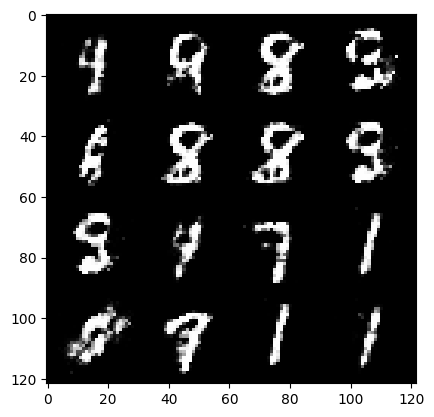

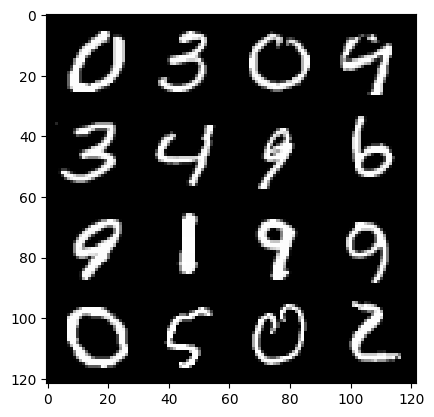

 30%|███       | 142/469 [00:02<00:07, 42.65it/s]

285: step 133800 / Gen loss: 1.5251052069663995 / disc_loss: 0.39061598499616


 91%|█████████▏| 429/469 [00:06<00:00, 67.35it/s]

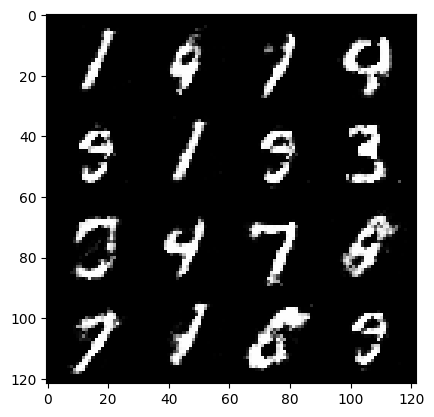

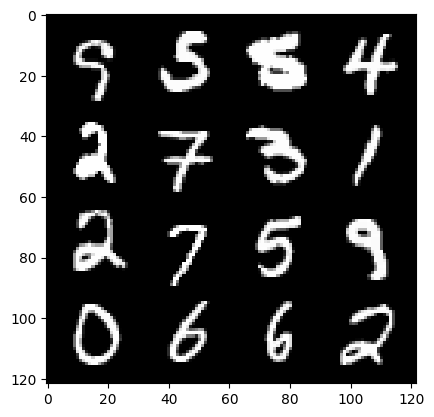

 94%|█████████▍| 442/469 [00:07<00:00, 45.86it/s]

285: step 134100 / Gen loss: 1.4261657476425167 / disc_loss: 0.42238989025354384


 56%|█████▌    | 262/469 [00:03<00:02, 72.12it/s]

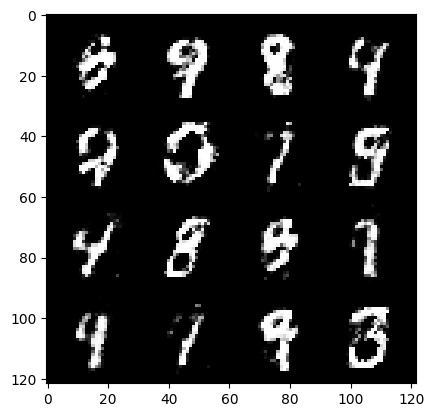

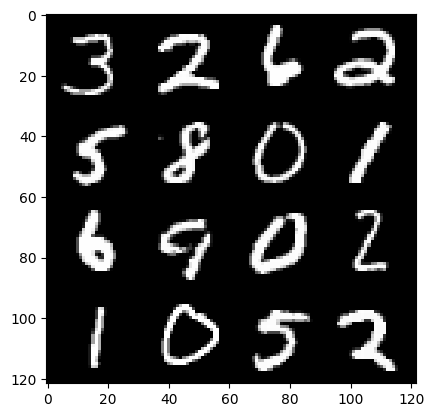

 58%|█████▊    | 270/469 [00:04<00:04, 41.38it/s]

286: step 134400 / Gen loss: 1.4628123160203297 / disc_loss: 0.4150784200429917


 20%|█▉        | 92/469 [00:01<00:05, 70.16it/s]

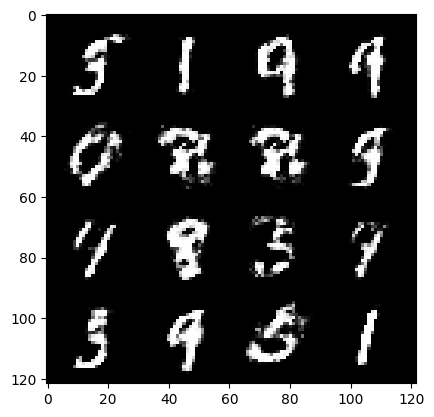

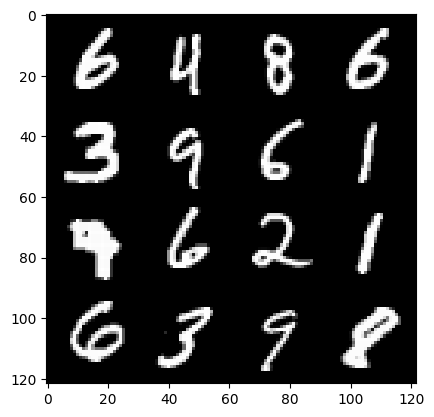

 23%|██▎       | 106/469 [00:01<00:08, 43.62it/s]

287: step 134700 / Gen loss: 1.380764551560084 / disc_loss: 0.4468578635652859


 84%|████████▎ | 392/469 [00:06<00:01, 66.46it/s]

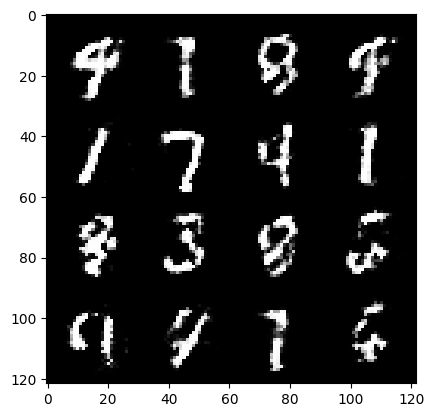

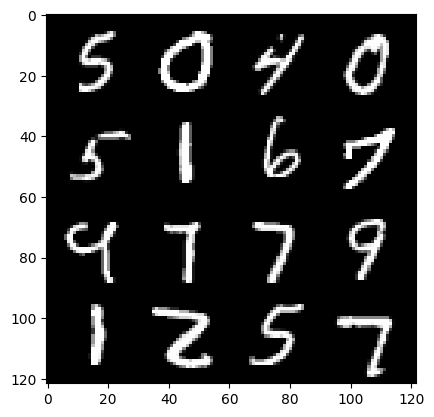

 86%|████████▋ | 405/469 [00:06<00:01, 39.24it/s]

287: step 135000 / Gen loss: 1.347383234500885 / disc_loss: 0.4341178071498872


 48%|████▊     | 225/469 [00:03<00:03, 62.83it/s]

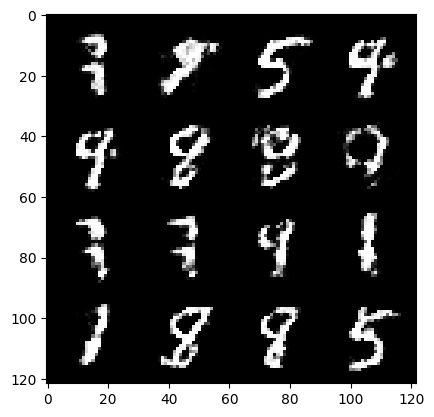

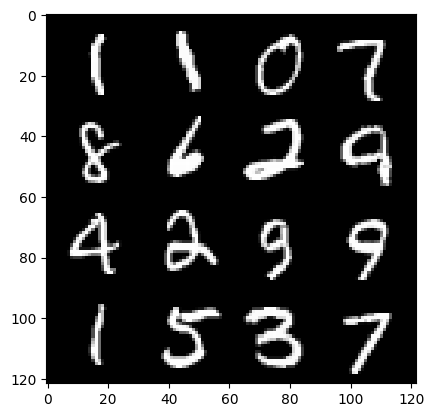

 49%|████▉     | 232/469 [00:03<00:05, 41.04it/s]

288: step 135300 / Gen loss: 1.411237856944401 / disc_loss: 0.41666713068882627


 12%|█▏        | 54/469 [00:00<00:06, 65.01it/s]

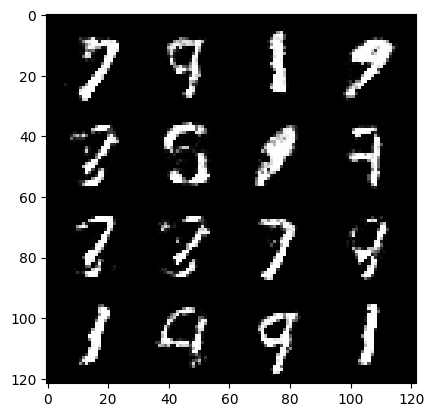

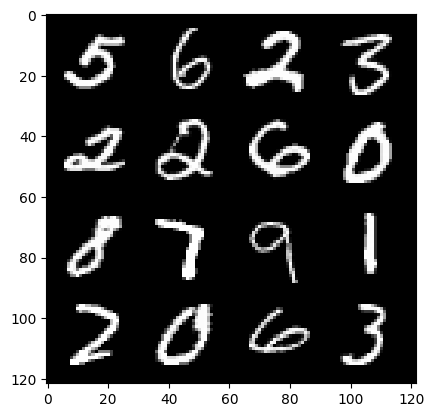

 14%|█▍        | 67/469 [00:01<00:10, 39.41it/s]

289: step 135600 / Gen loss: 1.3847135265668227 / disc_loss: 0.43220959583918295


 76%|███████▌  | 356/469 [00:05<00:01, 67.93it/s]

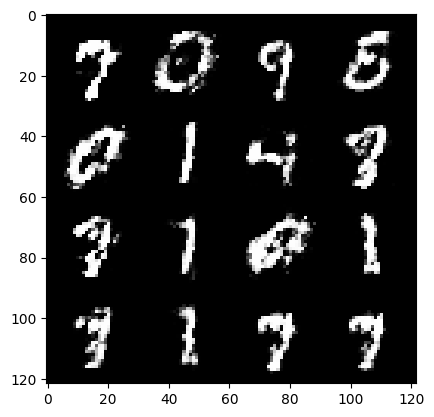

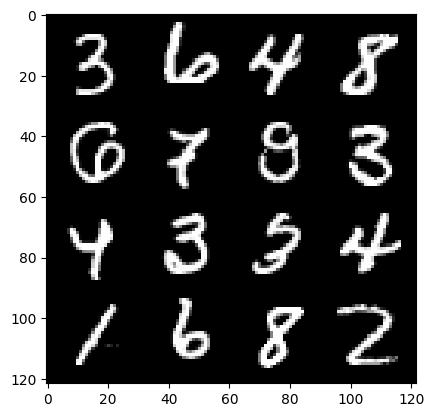

 77%|███████▋  | 363/469 [00:06<00:02, 39.94it/s]

289: step 135900 / Gen loss: 1.3435086170832318 / disc_loss: 0.43293148269255993


 39%|███▉      | 184/469 [00:03<00:04, 66.35it/s]

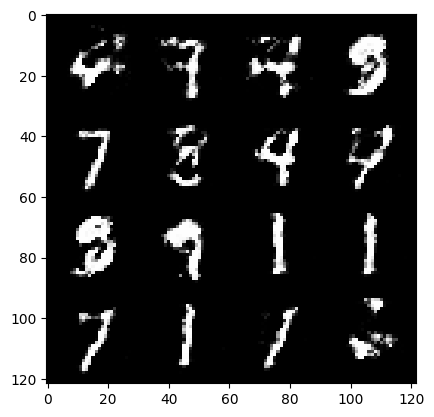

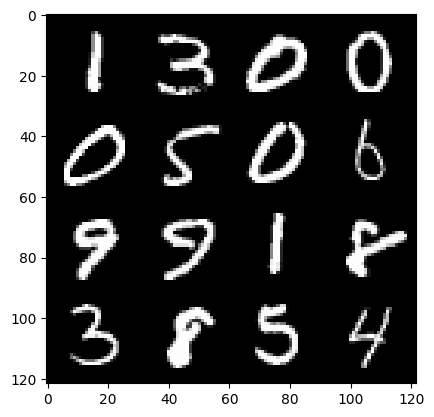

 42%|████▏     | 197/469 [00:03<00:06, 41.89it/s]

290: step 136200 / Gen loss: 1.3333691998322805 / disc_loss: 0.43748721291621556


  4%|▍         | 18/469 [00:00<00:07, 59.10it/s]

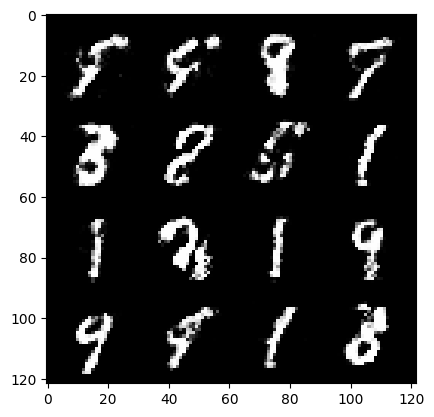

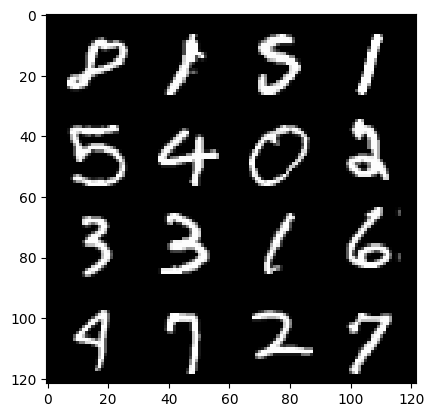

  6%|▌         | 29/469 [00:00<00:12, 34.55it/s]

291: step 136500 / Gen loss: 1.484766076008478 / disc_loss: 0.39591463814179145


 67%|██████▋   | 315/469 [00:05<00:02, 68.21it/s]

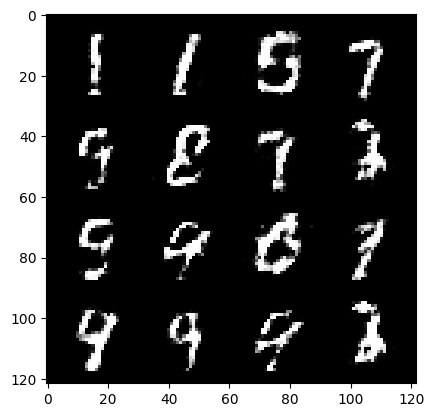

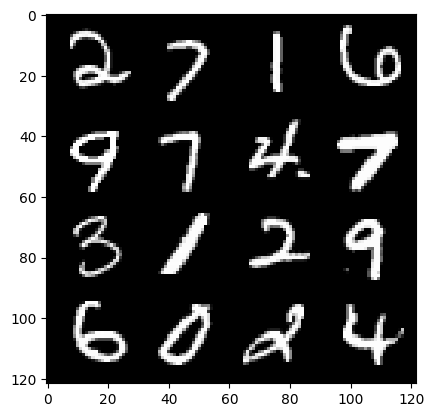

 70%|██████▉   | 328/469 [00:05<00:03, 43.65it/s]

291: step 136800 / Gen loss: 1.4854580624898275 / disc_loss: 0.39124822715918217


 32%|███▏      | 151/469 [00:02<00:05, 63.46it/s]

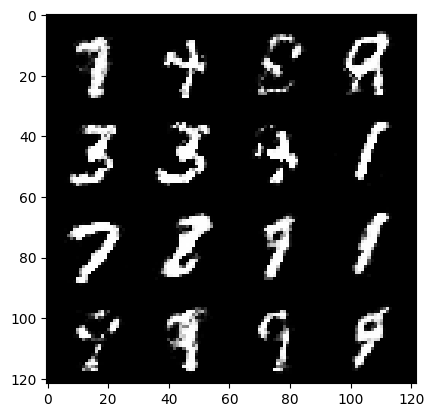

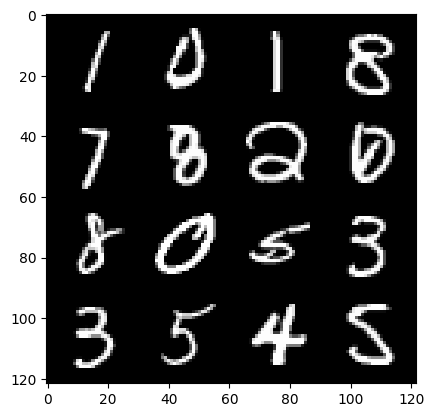

 34%|███▎      | 158/469 [00:02<00:07, 39.89it/s]

292: step 137100 / Gen loss: 1.6484709187348678 / disc_loss: 0.3607787214716277


 96%|█████████▌| 449/469 [00:07<00:00, 59.77it/s]

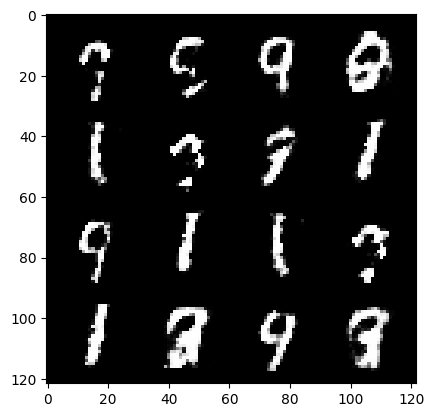

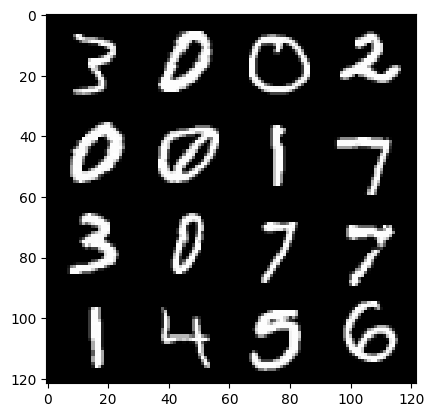

 98%|█████████▊| 461/469 [00:07<00:00, 40.24it/s]

292: step 137400 / Gen loss: 1.4895751055081692 / disc_loss: 0.40026512930790586


 60%|██████    | 282/469 [00:04<00:02, 71.49it/s]

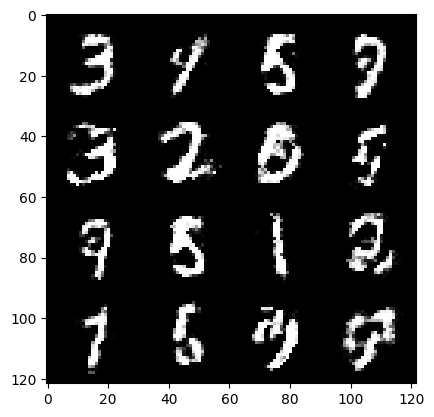

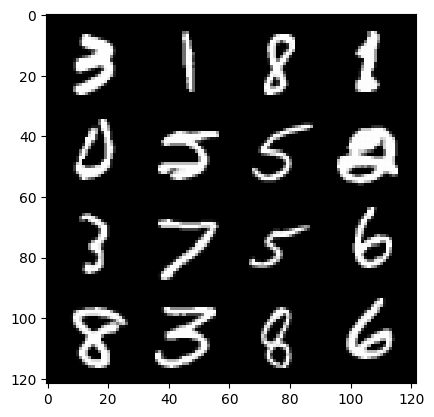

 62%|██████▏   | 290/469 [00:04<00:04, 42.50it/s]

293: step 137700 / Gen loss: 1.4753020886580146 / disc_loss: 0.3972226679325103


 23%|██▎       | 108/469 [00:01<00:05, 64.71it/s]

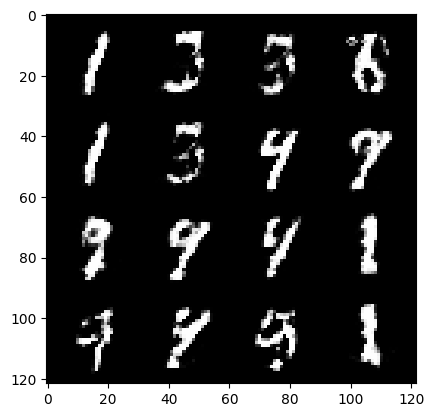

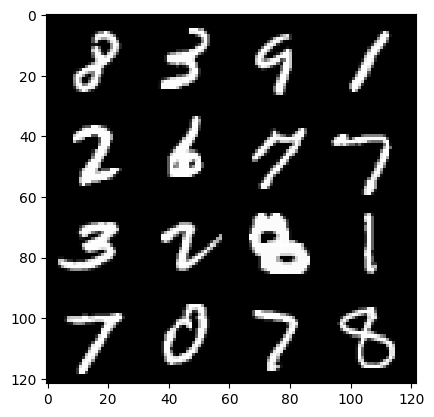

 26%|██▌       | 121/469 [00:02<00:08, 41.43it/s]

294: step 138000 / Gen loss: 1.6158122634887697 / disc_loss: 0.3772084160645801


 88%|████████▊ | 412/469 [00:06<00:00, 66.02it/s]

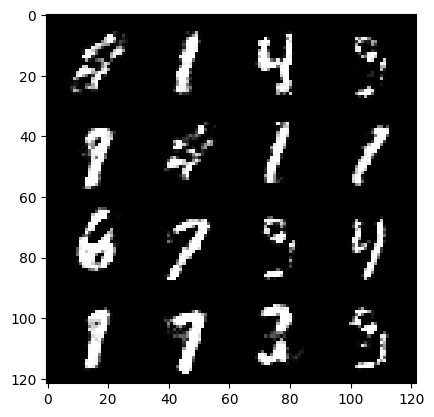

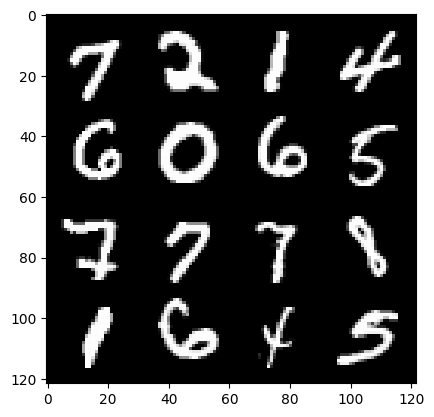

 89%|████████▉ | 419/469 [00:06<00:01, 40.08it/s]

294: step 138300 / Gen loss: 1.5436268806457518 / disc_loss: 0.3836953600247698


 52%|█████▏    | 244/469 [00:03<00:03, 67.03it/s]

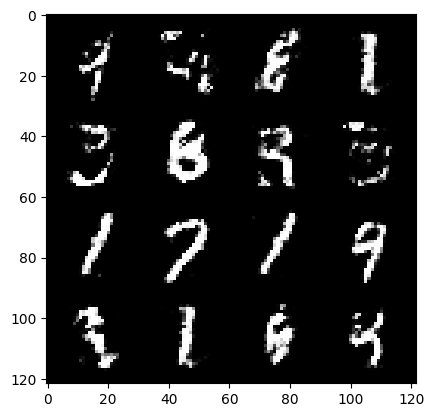

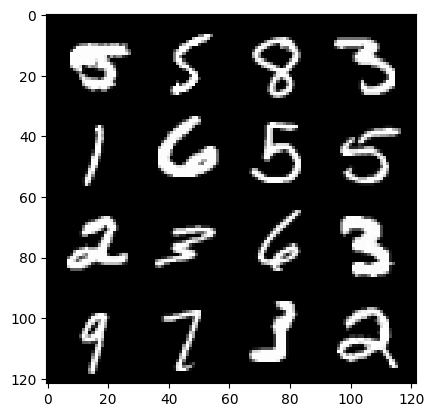

 54%|█████▎    | 251/469 [00:03<00:05, 42.57it/s]

295: step 138600 / Gen loss: 1.4237227288881937 / disc_loss: 0.4085584363341333


 15%|█▌        | 72/469 [00:01<00:06, 64.55it/s]

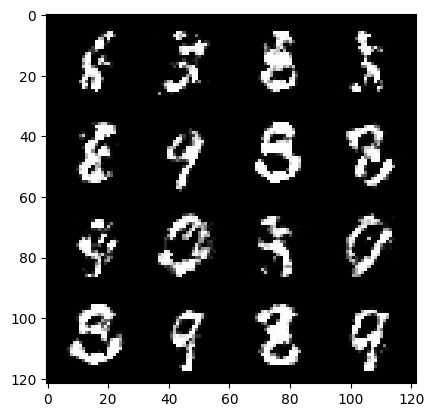

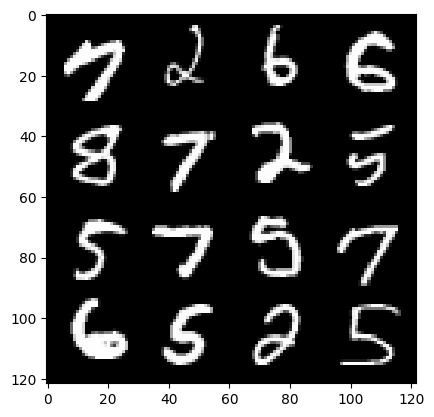

 18%|█▊        | 85/469 [00:01<00:09, 42.20it/s]

296: step 138900 / Gen loss: 1.4876357614994054 / disc_loss: 0.3798681076367697


 79%|███████▉  | 370/469 [00:06<00:01, 62.20it/s]

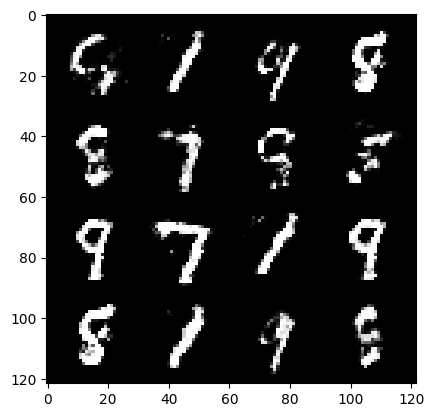

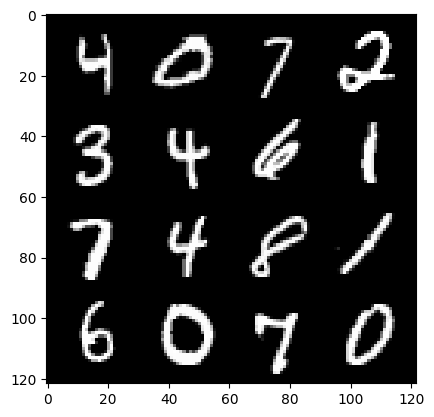

 82%|████████▏ | 383/469 [00:06<00:01, 44.56it/s]

296: step 139200 / Gen loss: 1.5796316055456792 / disc_loss: 0.37320598423481


 43%|████▎     | 202/469 [00:03<00:04, 64.73it/s]

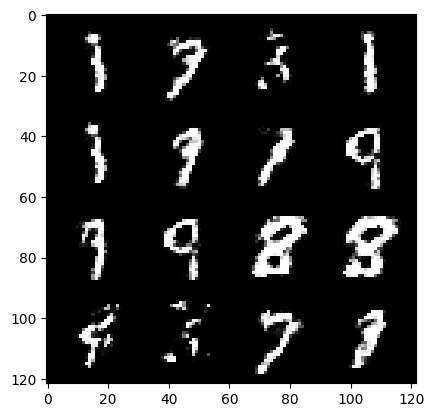

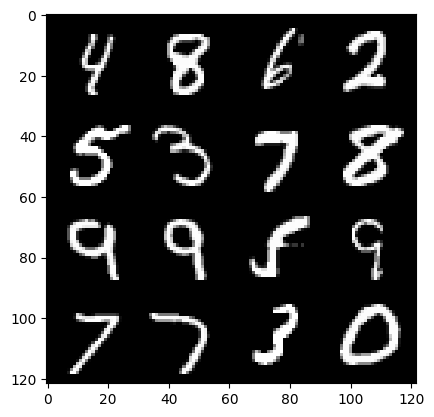

 46%|████▌     | 215/469 [00:03<00:05, 44.05it/s]

297: step 139500 / Gen loss: 1.5769054524103798 / disc_loss: 0.37947213033835103


  8%|▊         | 36/469 [00:00<00:06, 62.53it/s]

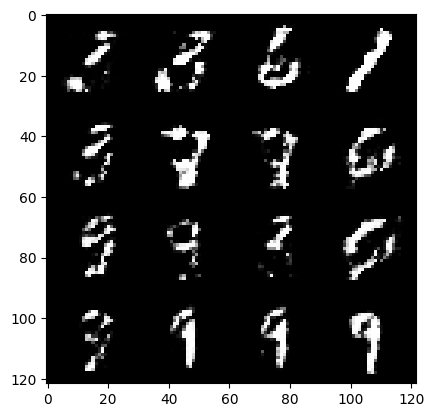

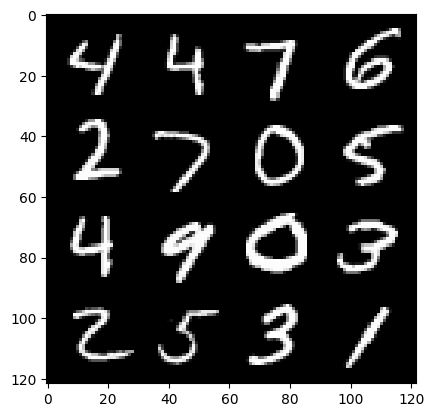

 10%|█         | 49/469 [00:01<00:10, 40.71it/s]

298: step 139800 / Gen loss: 1.5672092024485262 / disc_loss: 0.37667545914649964


 72%|███████▏  | 337/469 [00:05<00:01, 70.15it/s]

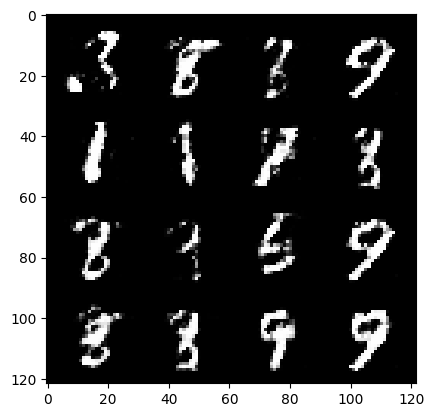

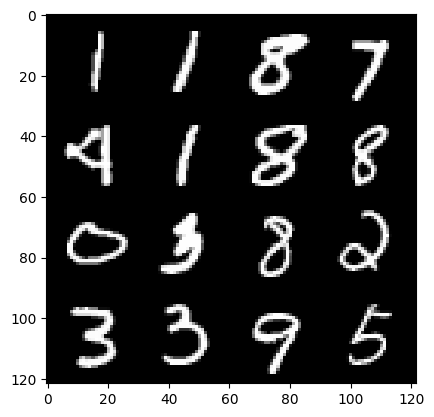

 74%|███████▎  | 345/469 [00:05<00:02, 41.78it/s]

298: step 140100 / Gen loss: 1.6051005534331007 / disc_loss: 0.36297607690095907


 35%|███▌      | 166/469 [00:02<00:05, 59.36it/s]

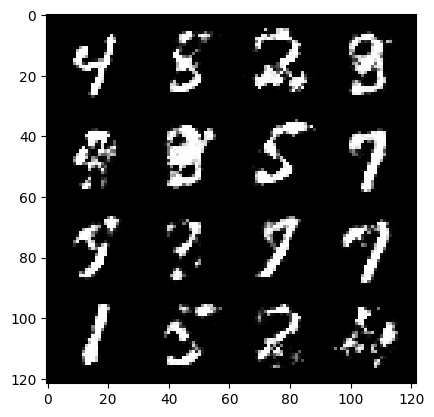

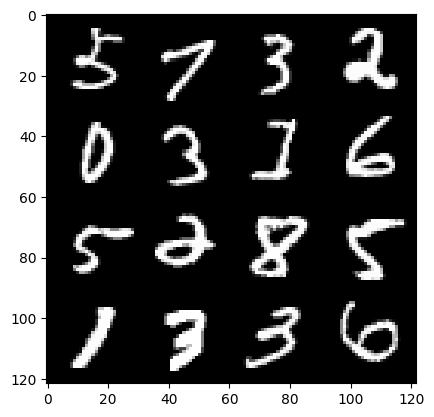

 38%|███▊      | 178/469 [00:02<00:06, 41.65it/s]

299: step 140400 / Gen loss: 1.7036260612805685 / disc_loss: 0.3452790253361067


  0%|          | 0/469 [00:00<?, ?it/s]

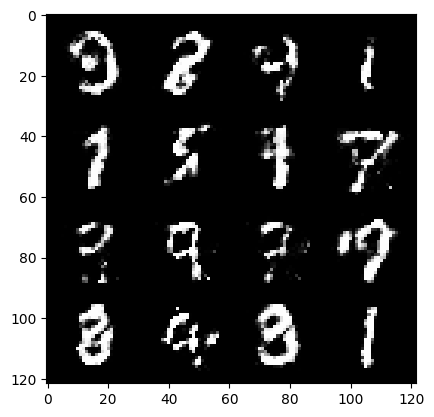

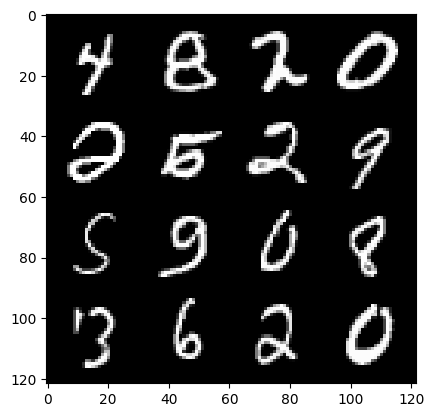

  1%|▏         | 7/469 [00:00<00:23, 19.57it/s]

300: step 140700 / Gen loss: 1.5066179585456865 / disc_loss: 0.39546582758426674


 63%|██████▎   | 295/469 [00:04<00:02, 69.28it/s]

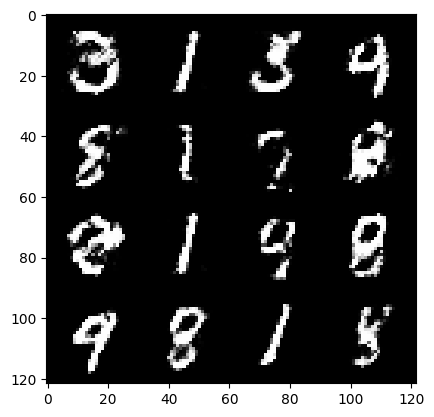

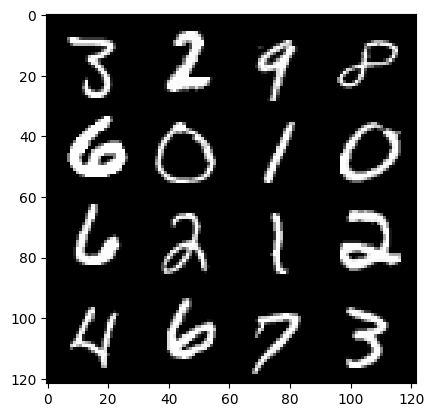

 66%|██████▌   | 308/469 [00:05<00:03, 46.38it/s]

300: step 141000 / Gen loss: 1.5147421387831375 / disc_loss: 0.38123142093420037


 27%|██▋       | 128/469 [00:01<00:04, 70.95it/s]

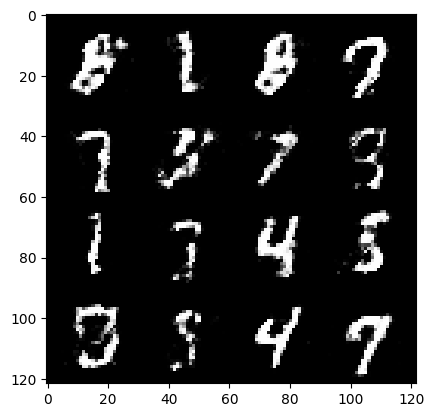

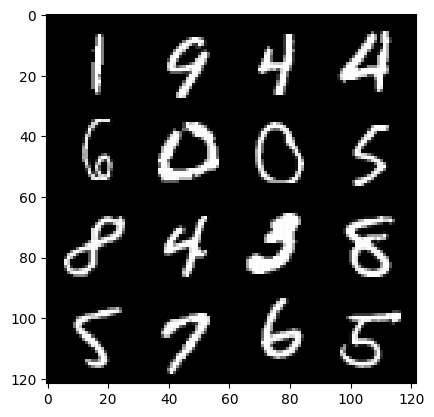

 29%|██▉       | 136/469 [00:02<00:07, 43.68it/s]

301: step 141300 / Gen loss: 1.541643330653509 / disc_loss: 0.3762690555055936


 92%|█████████▏| 431/469 [00:06<00:00, 65.89it/s]

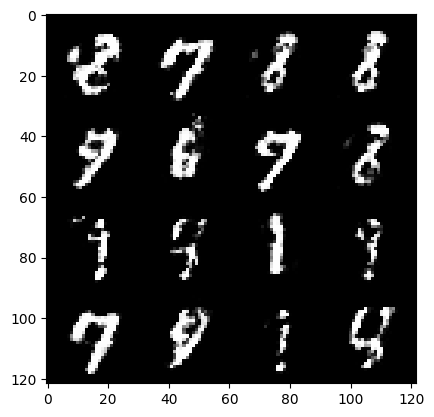

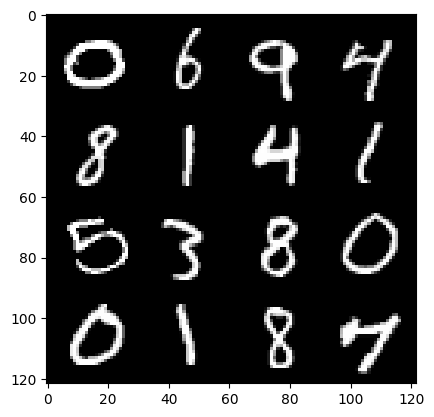

 93%|█████████▎| 438/469 [00:06<00:00, 42.06it/s]

301: step 141600 / Gen loss: 1.5325272250175468 / disc_loss: 0.38519301086664215


 55%|█████▍    | 256/469 [00:03<00:03, 66.08it/s]

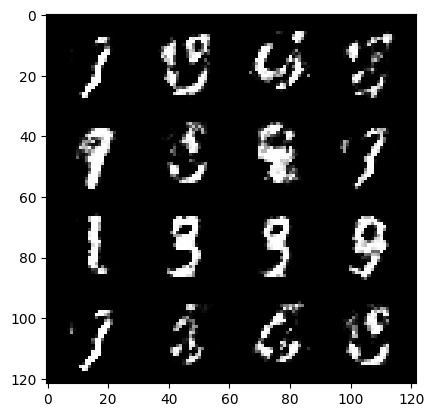

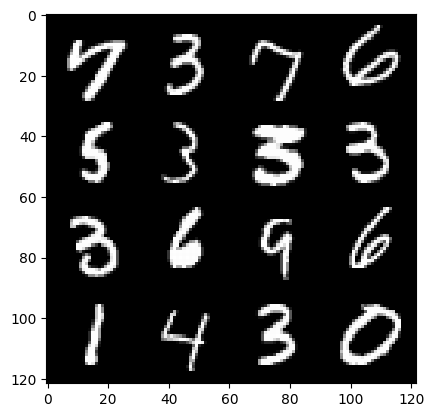

 57%|█████▋    | 269/469 [00:04<00:04, 45.10it/s]

302: step 141900 / Gen loss: 1.6080452827612557 / disc_loss: 0.3659955991804603


 19%|█▉        | 91/469 [00:01<00:05, 69.47it/s]

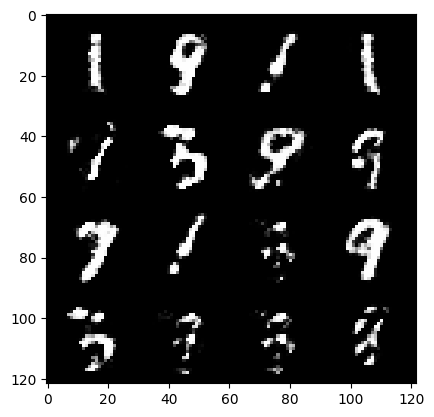

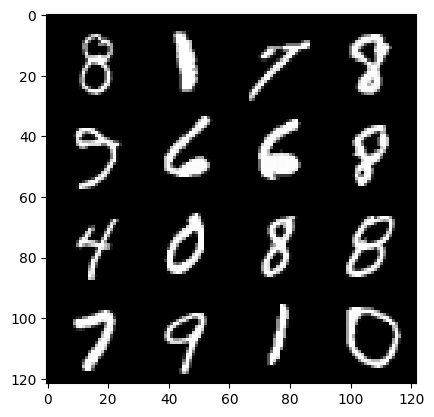

 21%|██        | 98/469 [00:01<00:08, 43.78it/s]

303: step 142200 / Gen loss: 1.4997071341673551 / disc_loss: 0.38282873938481027


 83%|████████▎ | 389/469 [00:06<00:01, 74.01it/s]

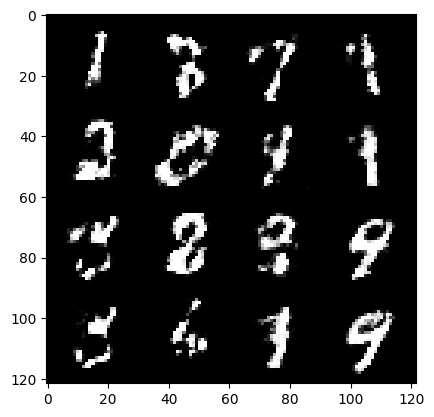

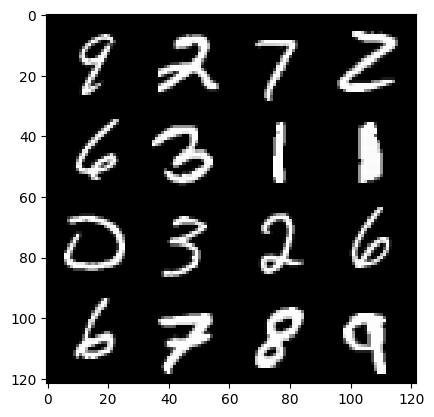

 85%|████████▍ | 397/469 [00:06<00:01, 44.54it/s]

303: step 142500 / Gen loss: 1.501875747442245 / disc_loss: 0.37539936651786143


 46%|████▋     | 218/469 [00:03<00:03, 67.13it/s]

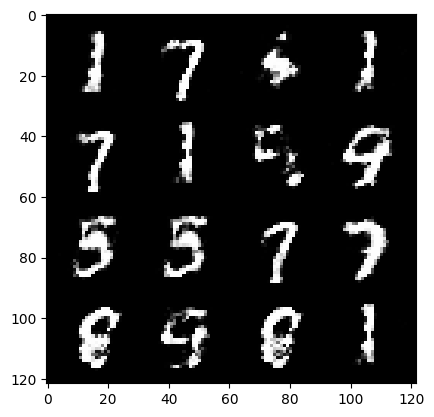

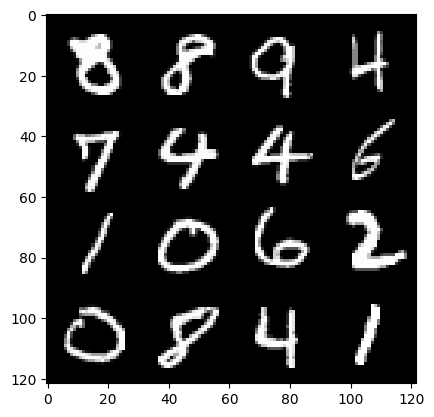

 49%|████▉     | 231/469 [00:03<00:05, 46.47it/s]

304: step 142800 / Gen loss: 1.62985373298327 / disc_loss: 0.3483779644966126


 11%|█         | 52/469 [00:00<00:05, 71.05it/s]

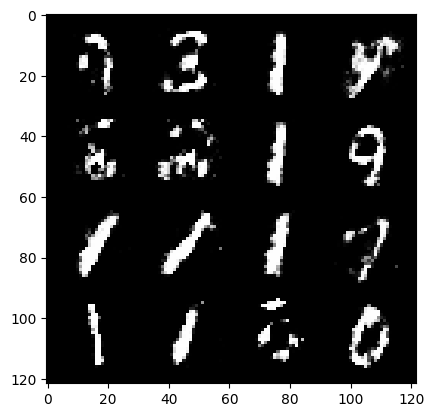

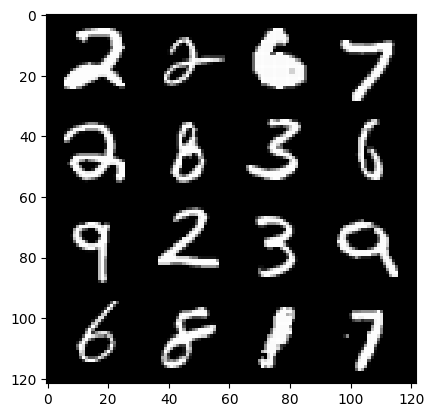

 13%|█▎        | 60/469 [00:01<00:10, 39.85it/s]

305: step 143100 / Gen loss: 1.6036975900332135 / disc_loss: 0.3743579797943434


 75%|███████▍  | 351/469 [00:05<00:01, 72.05it/s]

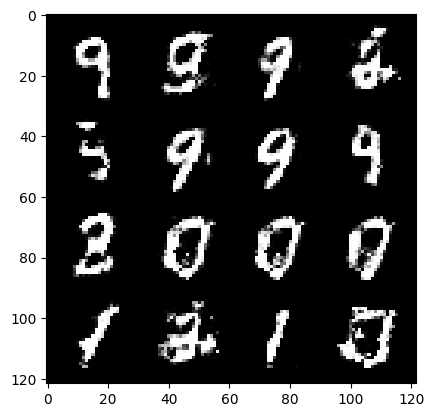

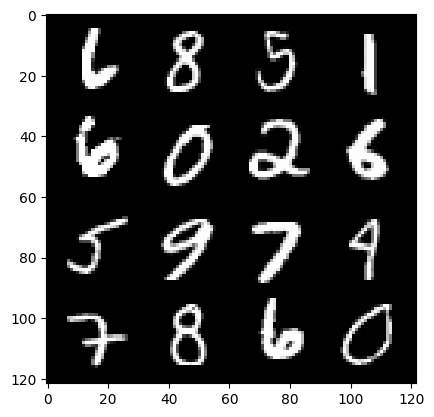

 77%|███████▋  | 359/469 [00:05<00:02, 48.24it/s]

305: step 143400 / Gen loss: 1.6216663527488704 / disc_loss: 0.3719369315107665


 39%|███▊      | 181/469 [00:02<00:04, 69.97it/s]

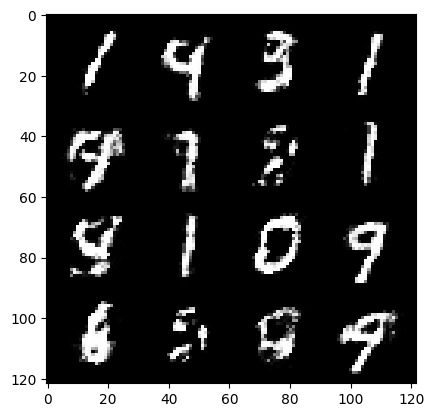

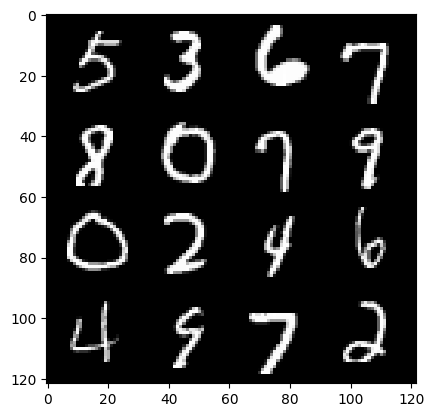

 40%|████      | 189/469 [00:02<00:06, 40.58it/s]

306: step 143700 / Gen loss: 1.470958788792291 / disc_loss: 0.40845942686001474


  3%|▎         | 16/469 [00:00<00:06, 69.85it/s]

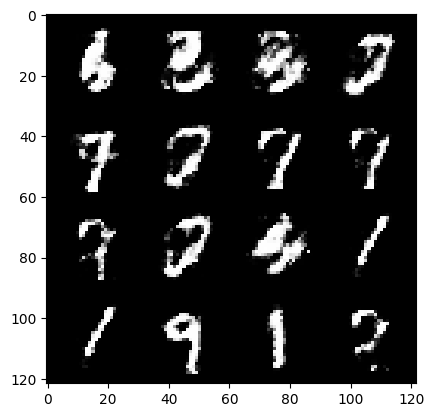

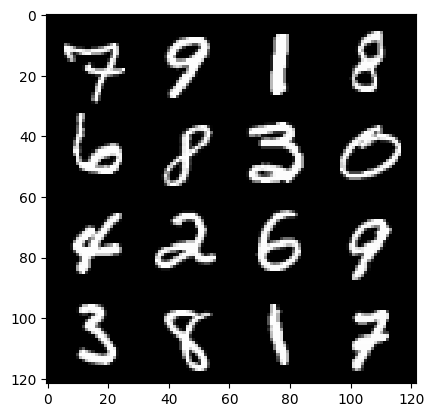

  5%|▍         | 23/469 [00:00<00:12, 36.81it/s]

307: step 144000 / Gen loss: 1.483288704951605 / disc_loss: 0.3922853207588194


 67%|██████▋   | 316/469 [00:04<00:02, 71.77it/s]

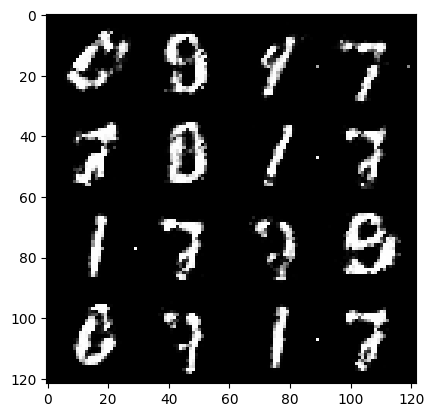

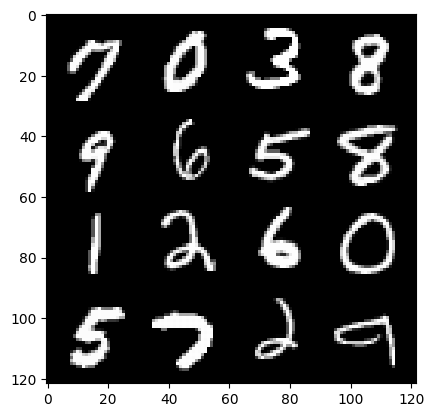

 69%|██████▉   | 324/469 [00:05<00:03, 44.75it/s]

307: step 144300 / Gen loss: 1.5806274533271787 / disc_loss: 0.40235430459181476


 32%|███▏      | 148/469 [00:02<00:04, 67.91it/s]

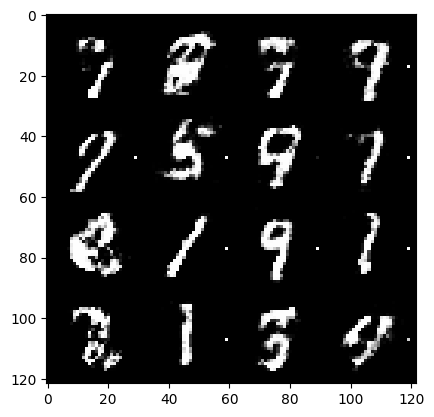

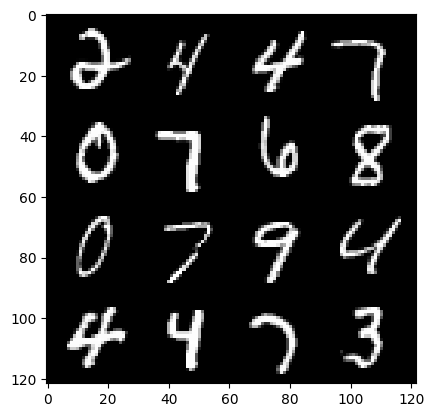

 33%|███▎      | 155/469 [00:02<00:07, 43.04it/s]

308: step 144600 / Gen loss: 1.0699003277222316 / disc_loss: 0.5642485465606056


 95%|█████████▌| 446/469 [00:07<00:00, 64.93it/s]

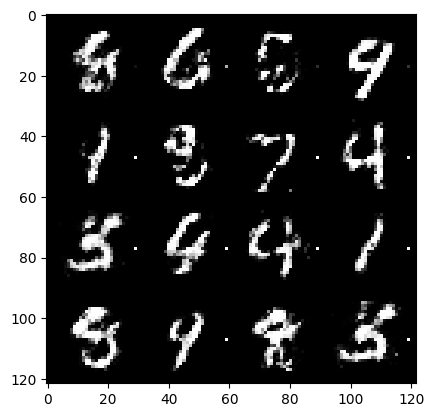

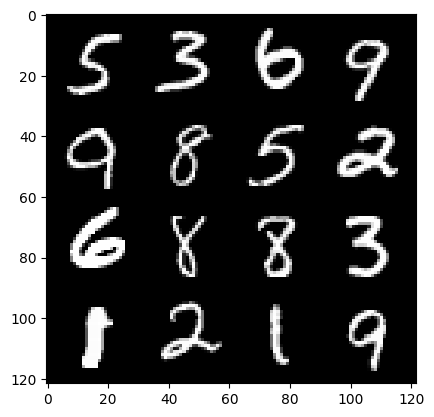

 97%|█████████▋| 453/469 [00:07<00:00, 43.72it/s]

308: step 144900 / Gen loss: 1.0544717210531234 / disc_loss: 0.5251731459299723


 59%|█████▉    | 277/469 [00:04<00:02, 70.80it/s]

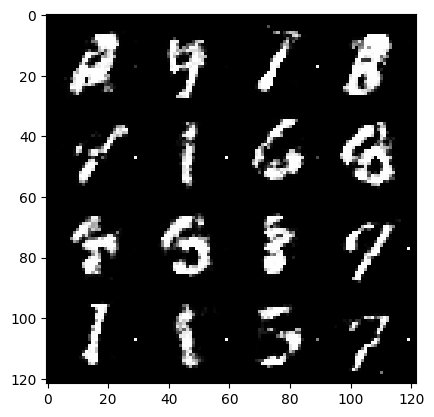

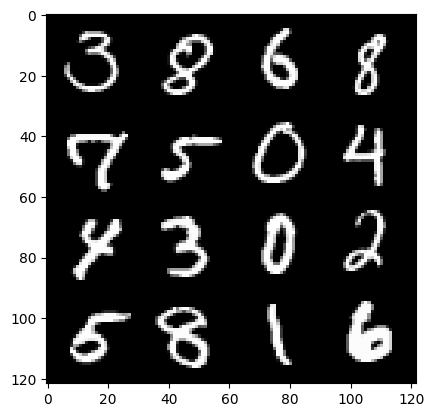

 61%|██████    | 285/469 [00:04<00:03, 47.74it/s]

309: step 145200 / Gen loss: 1.1257204667727152 / disc_loss: 0.4819916946689287


 23%|██▎       | 107/469 [00:01<00:05, 64.42it/s]

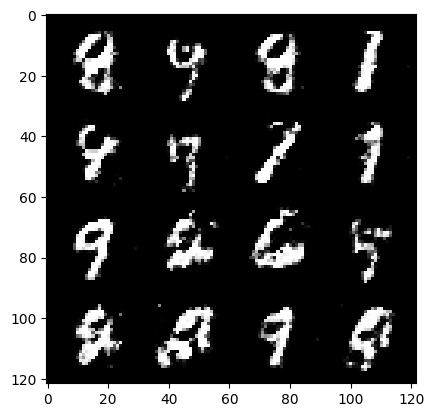

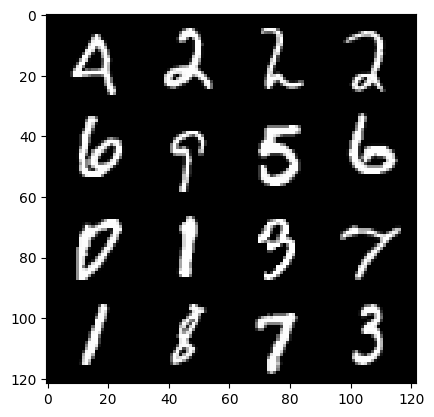

 26%|██▌       | 120/469 [00:02<00:08, 40.86it/s]

310: step 145500 / Gen loss: 1.3868512256940213 / disc_loss: 0.418737875521183


 86%|████████▋ | 405/469 [00:06<00:01, 62.68it/s]

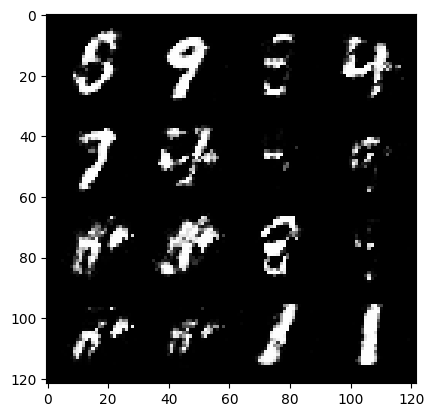

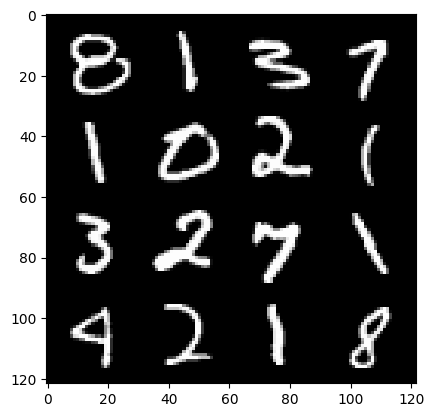

 89%|████████▉ | 418/469 [00:06<00:01, 47.02it/s]

310: step 145800 / Gen loss: 1.5013420589764903 / disc_loss: 0.40573201894760136


 51%|█████     | 237/469 [00:03<00:03, 73.19it/s]

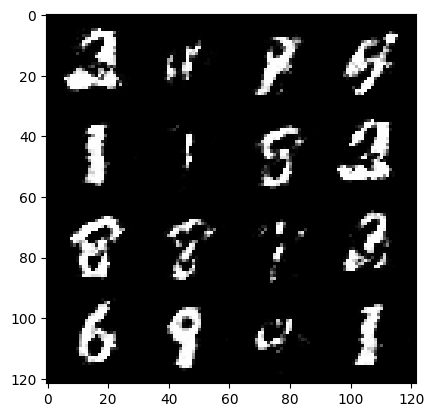

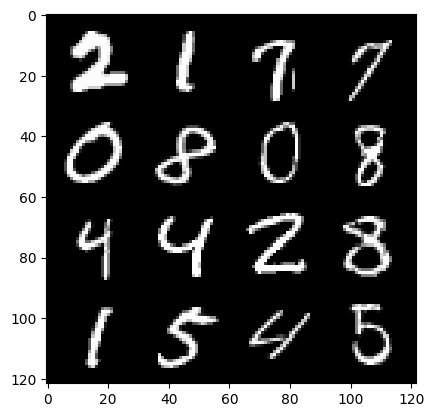

 52%|█████▏    | 245/469 [00:03<00:05, 38.74it/s]

311: step 146100 / Gen loss: 1.5590460685888914 / disc_loss: 0.36838090529044465


 15%|█▌        | 71/469 [00:00<00:05, 73.90it/s]

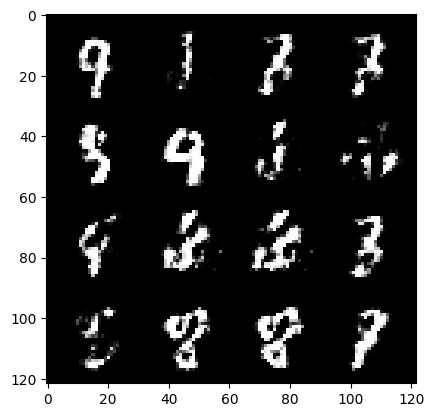

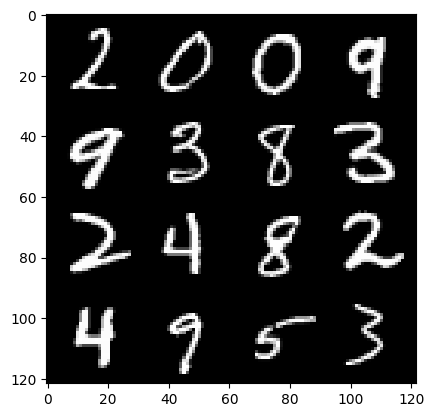

 17%|█▋        | 79/469 [00:01<00:08, 45.73it/s]

312: step 146400 / Gen loss: 1.671630229155223 / disc_loss: 0.3439865192770957


 78%|███████▊  | 367/469 [00:06<00:01, 69.21it/s]

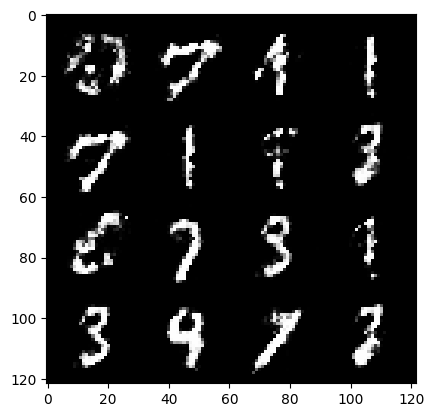

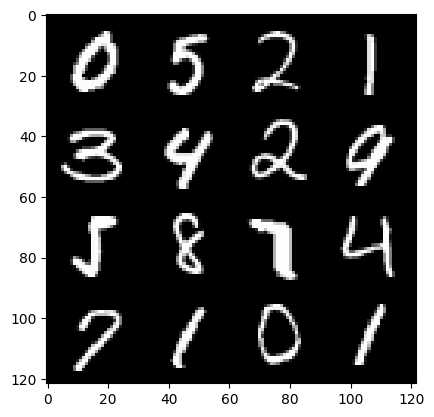

 81%|████████  | 380/469 [00:06<00:02, 42.07it/s]

312: step 146700 / Gen loss: 1.7561077543099741 / disc_loss: 0.3370300050079823


 43%|████▎     | 200/469 [00:03<00:04, 65.99it/s]

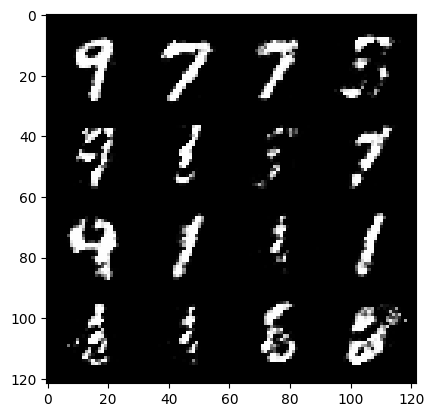

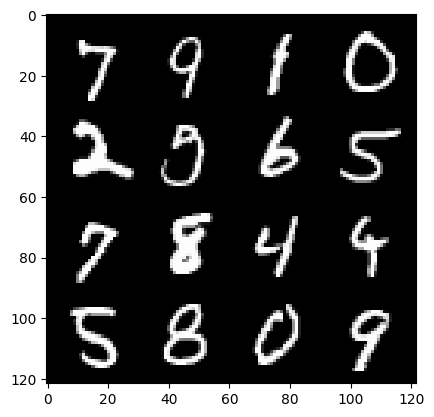

 44%|████▍     | 207/469 [00:03<00:05, 46.77it/s]

313: step 147000 / Gen loss: 1.795807755390803 / disc_loss: 0.31806043893098856


  7%|▋         | 31/469 [00:00<00:06, 70.13it/s]

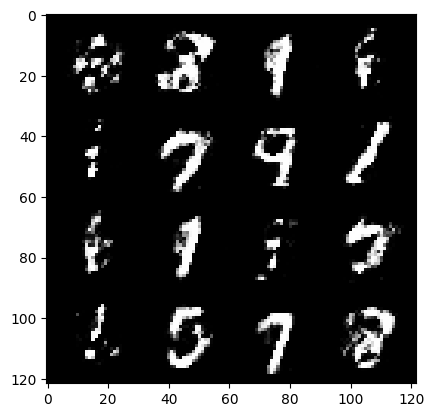

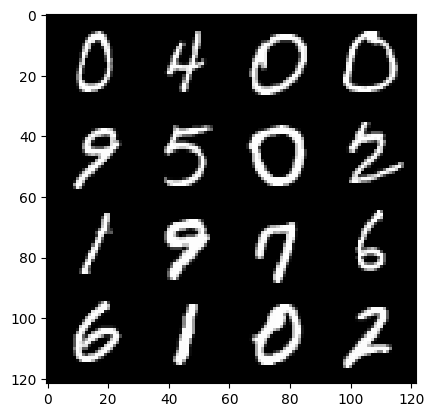

 10%|▉         | 45/469 [00:00<00:09, 43.84it/s]

314: step 147300 / Gen loss: 1.9139105737209323 / disc_loss: 0.2927143514653048


 70%|██████▉   | 328/469 [00:05<00:01, 70.85it/s]

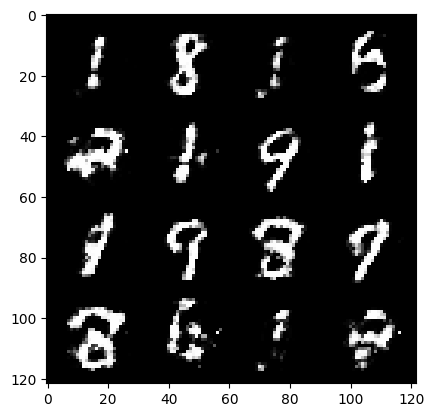

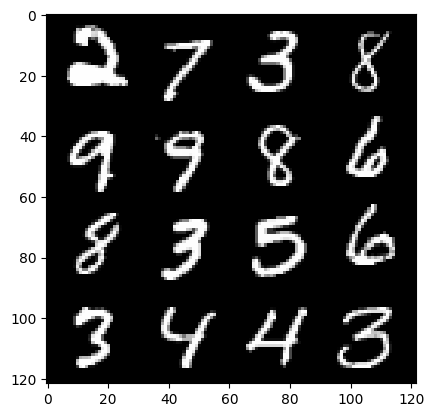

 73%|███████▎  | 342/469 [00:05<00:02, 45.72it/s]

314: step 147600 / Gen loss: 1.775426579316458 / disc_loss: 0.33337772503495244


 35%|███▌      | 165/469 [00:02<00:04, 70.10it/s]

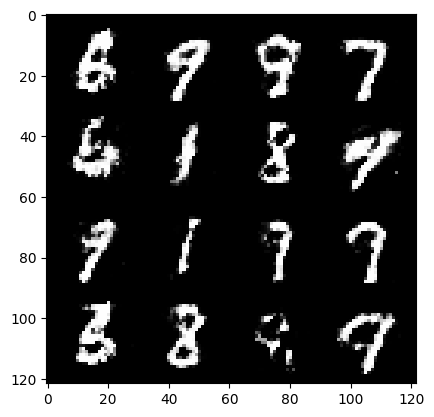

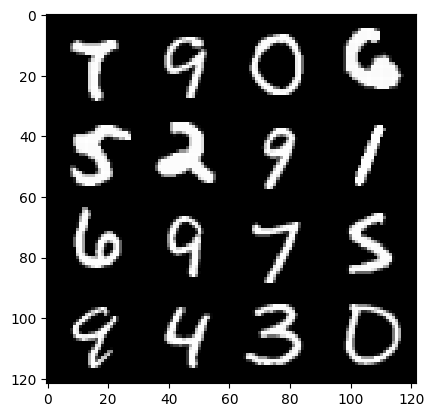

 37%|███▋      | 173/469 [00:02<00:07, 42.12it/s]

315: step 147900 / Gen loss: 1.74914321700732 / disc_loss: 0.34361522595087673


 98%|█████████▊| 460/469 [00:07<00:00, 63.51it/s]

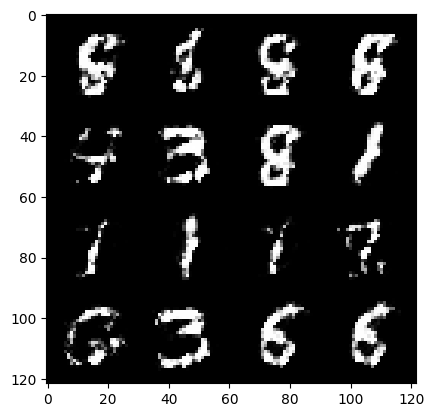

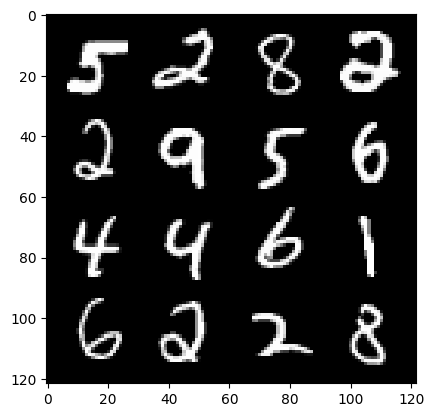

100%|██████████| 469/469 [00:07<00:00, 61.32it/s]


315: step 148200 / Gen loss: 1.7325745459397637 / disc_loss: 0.3491667099793751


 62%|██████▏   | 292/469 [00:04<00:02, 72.05it/s]

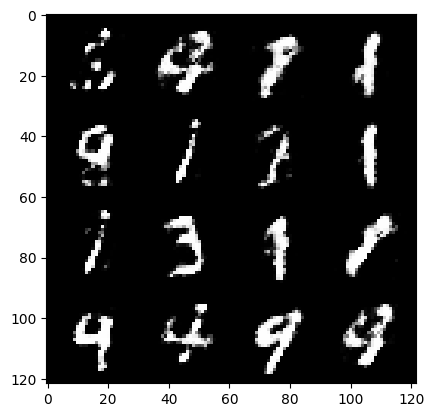

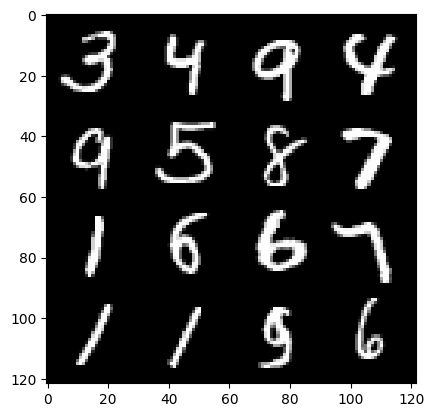

 64%|██████▍   | 300/469 [00:04<00:03, 46.83it/s]

316: step 148500 / Gen loss: 1.7140832666556043 / disc_loss: 0.3590621336301171


 26%|██▋       | 124/469 [00:01<00:04, 72.74it/s]

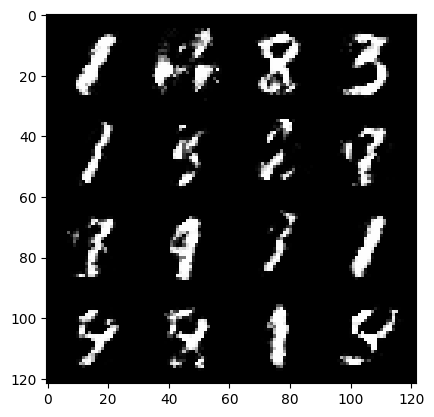

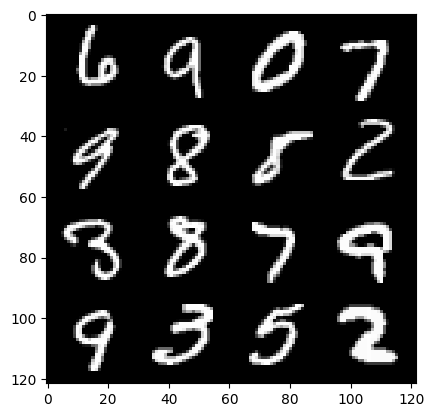

 28%|██▊       | 132/469 [00:02<00:07, 47.90it/s]

317: step 148800 / Gen loss: 1.61752015908559 / disc_loss: 0.3686379079023996


 90%|█████████ | 424/469 [00:06<00:00, 67.60it/s]

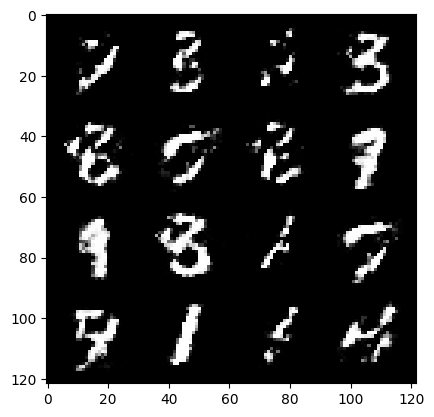

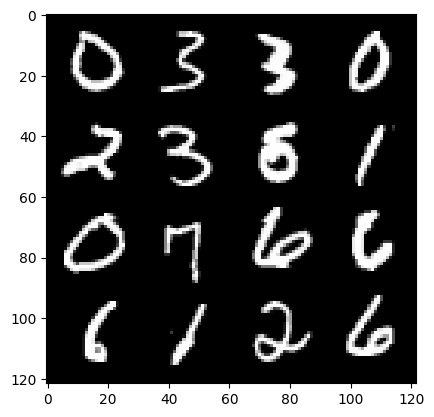

 92%|█████████▏| 431/469 [00:06<00:00, 44.19it/s]

317: step 149100 / Gen loss: 1.614663007259369 / disc_loss: 0.3640420266985892


 54%|█████▍    | 255/469 [00:03<00:03, 59.32it/s]

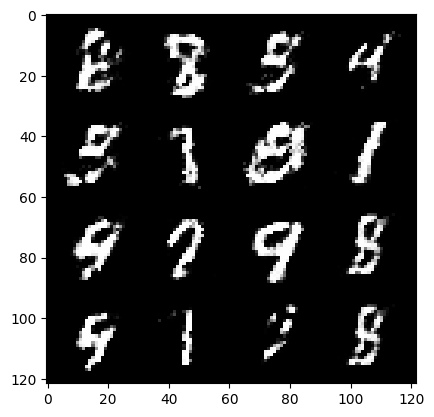

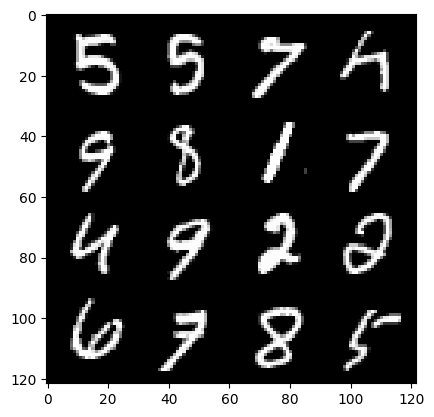

 57%|█████▋    | 267/469 [00:04<00:05, 39.43it/s]

318: step 149400 / Gen loss: 1.659444160064061 / disc_loss: 0.34411422034104683


 18%|█▊        | 83/469 [00:01<00:05, 66.35it/s]

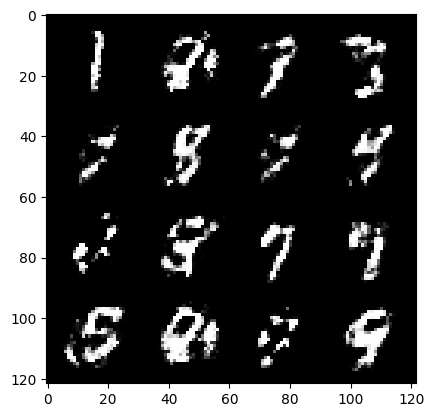

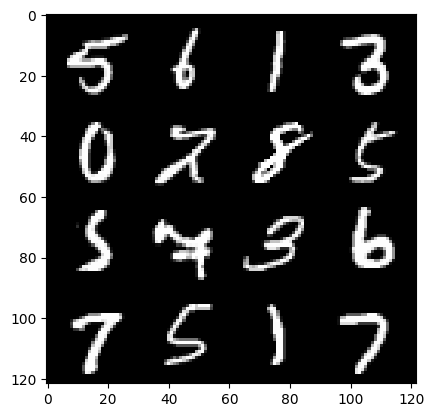

 20%|██        | 96/469 [00:01<00:08, 42.08it/s]

319: step 149700 / Gen loss: 1.7052739195028945 / disc_loss: 0.34587024519840875


 81%|████████▏ | 382/469 [00:06<00:01, 65.39it/s]

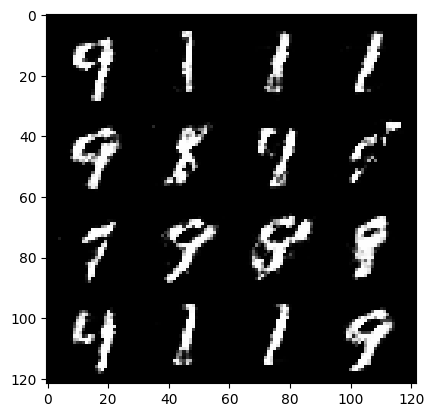

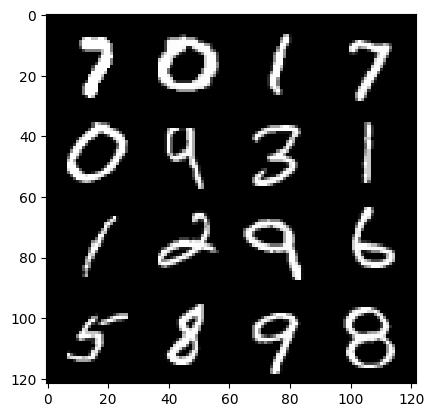

 84%|████████▍ | 396/469 [00:06<00:01, 46.65it/s]

319: step 150000 / Gen loss: 1.6156841893990828 / disc_loss: 0.3677982159455618


 46%|████▌     | 215/469 [00:03<00:03, 68.00it/s]

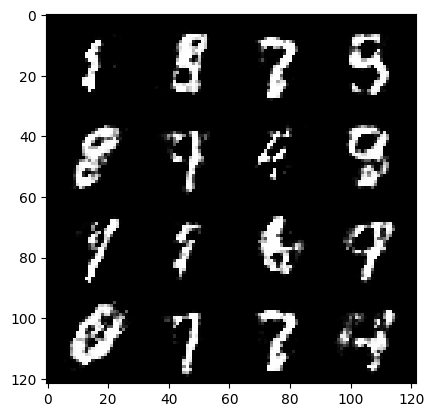

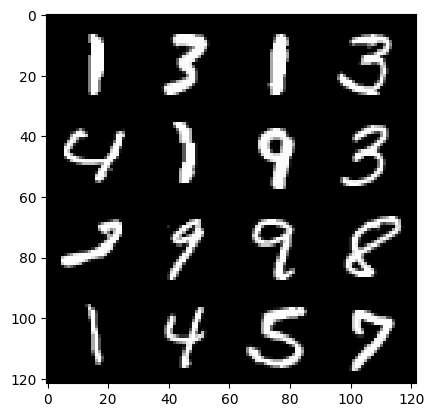

 49%|████▊     | 228/469 [00:03<00:05, 43.10it/s]

320: step 150300 / Gen loss: 1.6651719677448265 / disc_loss: 0.3672415713965894


 10%|█         | 49/469 [00:00<00:06, 67.83it/s]

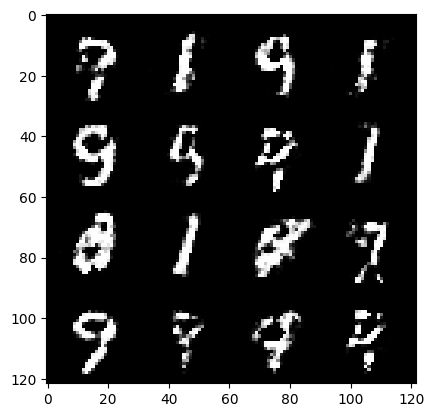

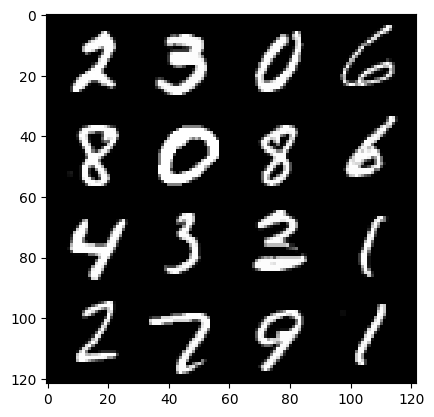

 12%|█▏        | 56/469 [00:01<00:09, 44.46it/s]

321: step 150600 / Gen loss: 1.6804945079485565 / disc_loss: 0.35740774393081626


 74%|███████▍  | 347/469 [00:05<00:01, 68.27it/s]

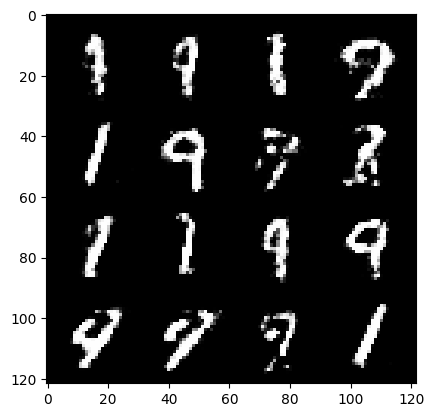

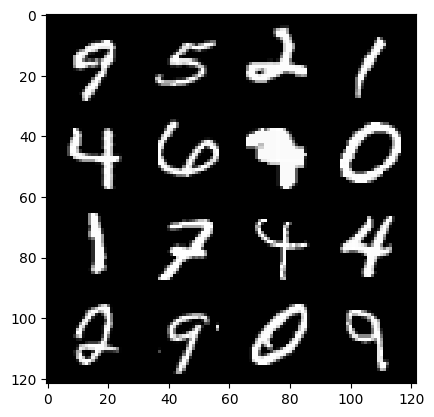

 77%|███████▋  | 360/469 [00:06<00:02, 43.23it/s]

321: step 150900 / Gen loss: 1.605648860931397 / disc_loss: 0.3714926759401956


 38%|███▊      | 177/469 [00:02<00:04, 65.71it/s]

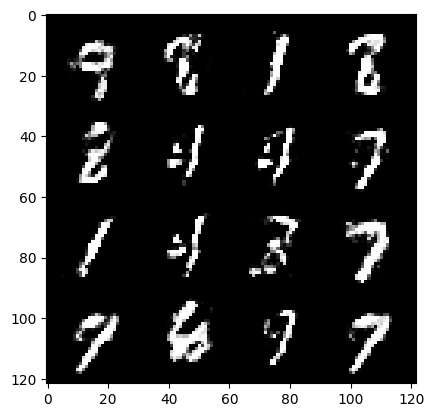

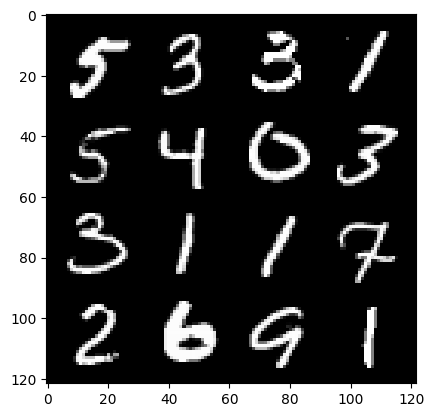

 41%|████      | 190/469 [00:03<00:07, 39.15it/s]

322: step 151200 / Gen loss: 1.6164999556541453 / disc_loss: 0.3714441731572153


  1%|▏         | 7/469 [00:00<00:07, 65.85it/s]

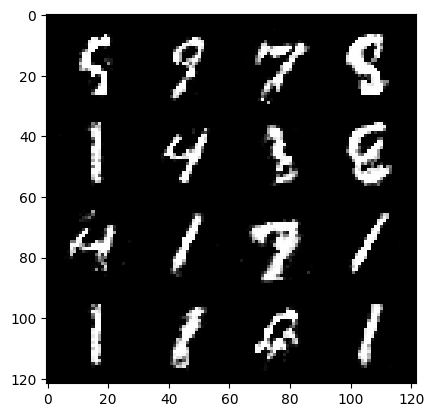

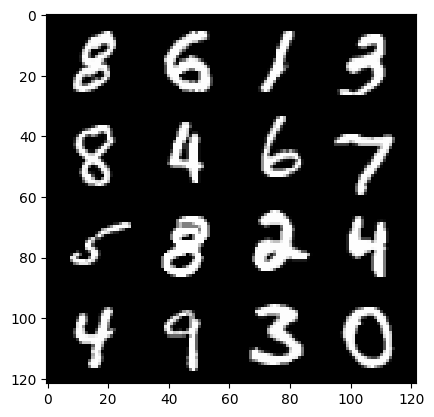

  4%|▍         | 19/469 [00:00<00:12, 36.44it/s]

323: step 151500 / Gen loss: 1.6819905285040546 / disc_loss: 0.36317995558182364


 67%|██████▋   | 312/469 [00:05<00:02, 68.14it/s]

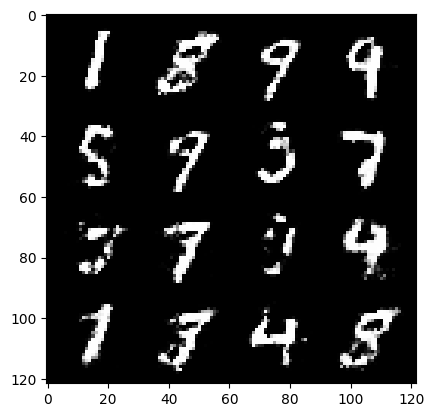

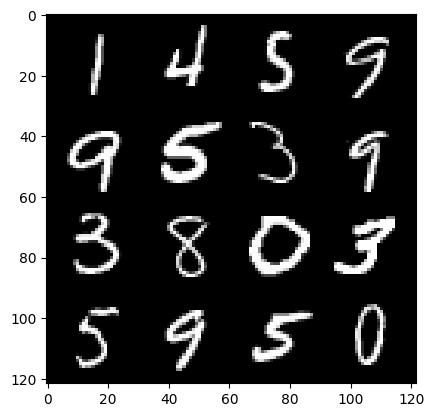

 68%|██████▊   | 319/469 [00:05<00:04, 37.06it/s]

323: step 151800 / Gen loss: 1.6992941061655686 / disc_loss: 0.3585402635733284


 30%|██▉       | 139/469 [00:02<00:04, 70.87it/s]

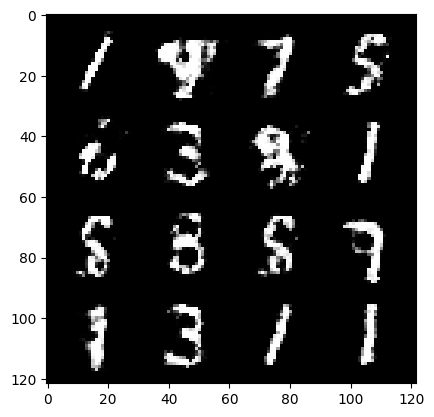

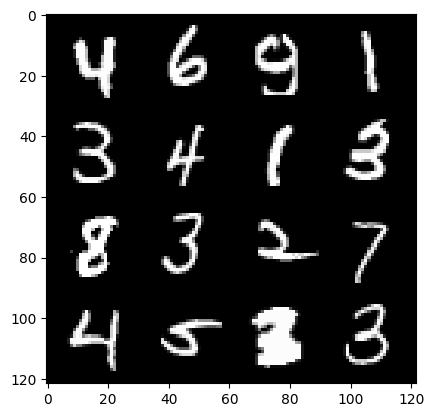

 33%|███▎      | 153/469 [00:02<00:07, 45.08it/s]

324: step 152100 / Gen loss: 1.5956504782040901 / disc_loss: 0.37480683137973175


 94%|█████████▎| 439/469 [00:06<00:00, 67.30it/s]

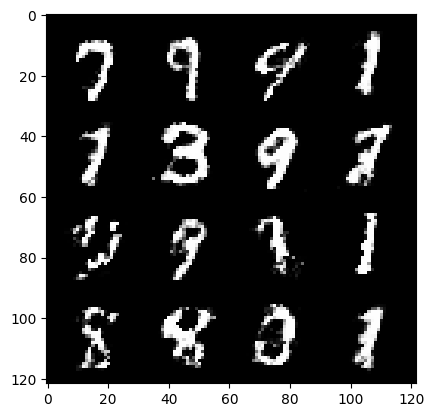

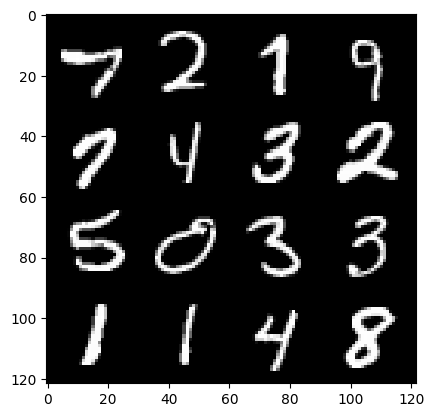

 96%|█████████▋| 452/469 [00:07<00:00, 44.52it/s]

324: step 152400 / Gen loss: 1.7290503561496733 / disc_loss: 0.36159938742717135


 58%|█████▊    | 271/469 [00:04<00:03, 64.14it/s]

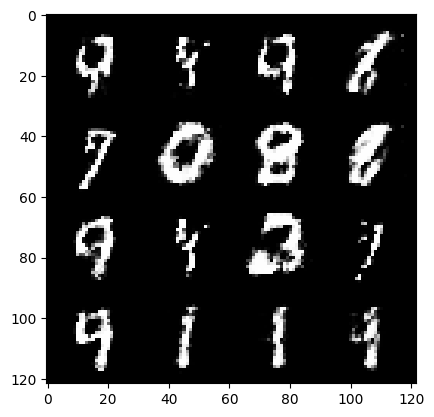

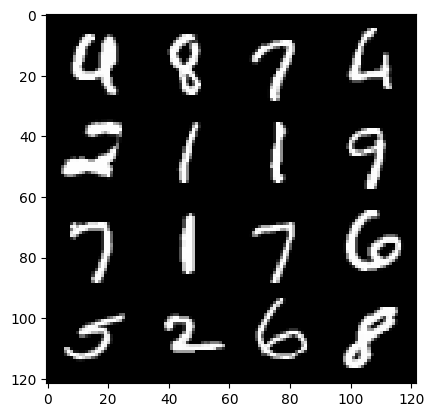

 61%|██████    | 284/469 [00:04<00:04, 42.60it/s]

325: step 152700 / Gen loss: 1.7348170296351122 / disc_loss: 0.33565299749374367


 22%|██▏       | 101/469 [00:01<00:05, 64.81it/s]

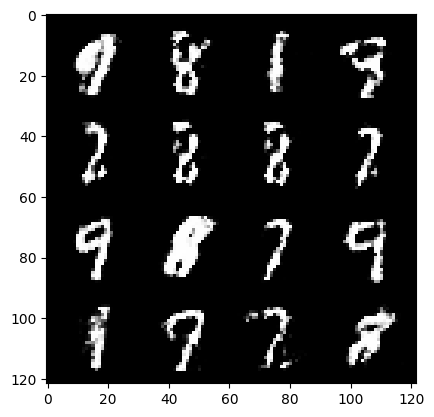

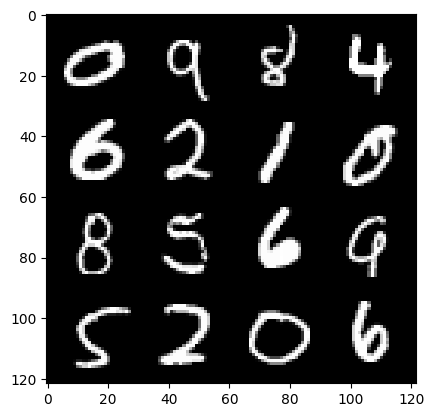

 24%|██▍       | 114/469 [00:02<00:08, 41.48it/s]

326: step 153000 / Gen loss: 1.7295240128040312 / disc_loss: 0.3422127479314803


 87%|████████▋ | 406/469 [00:06<00:00, 64.27it/s]

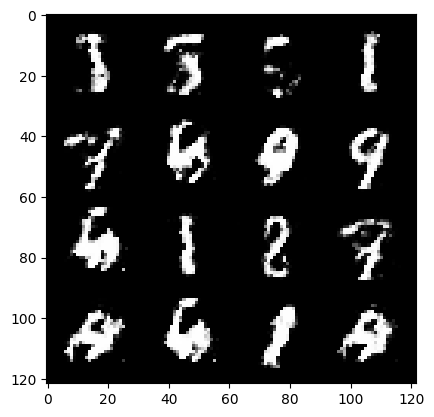

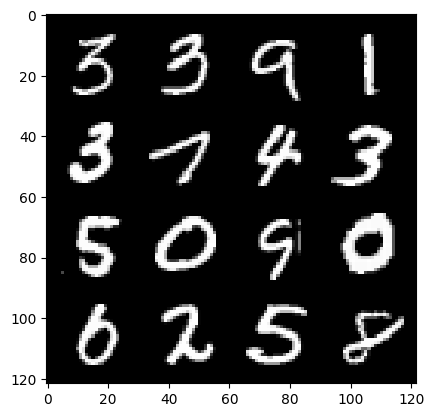

 88%|████████▊ | 413/469 [00:06<00:01, 40.08it/s]

326: step 153300 / Gen loss: 1.8470896395047511 / disc_loss: 0.3064456692834695


 50%|█████     | 236/469 [00:03<00:04, 58.17it/s]

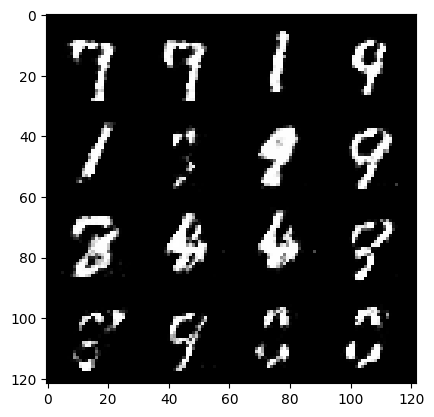

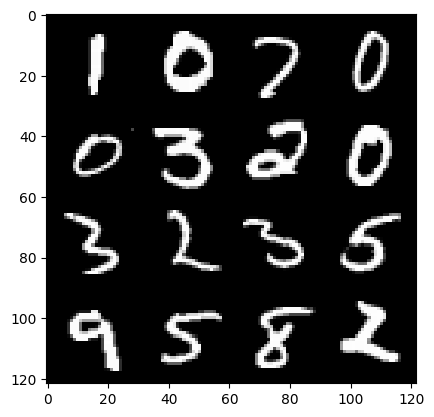

 52%|█████▏    | 242/469 [00:04<00:06, 35.48it/s]

327: step 153600 / Gen loss: 1.7325423161188742 / disc_loss: 0.3395469751954078


 13%|█▎        | 62/469 [00:00<00:06, 67.29it/s]

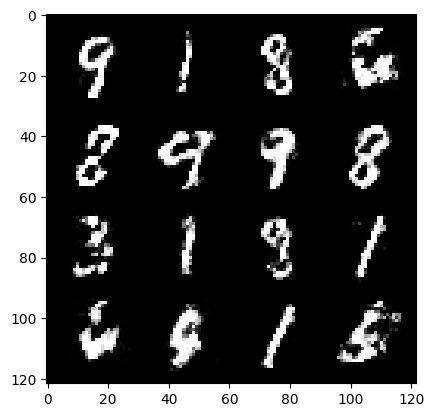

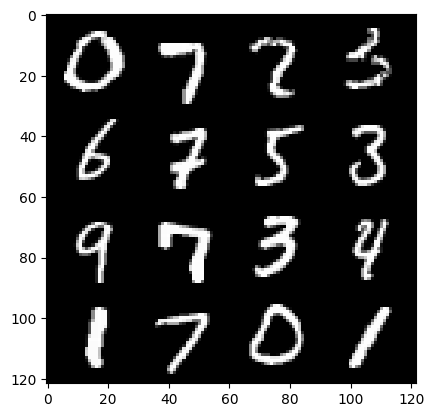

 16%|█▌        | 75/469 [00:01<00:09, 41.45it/s]

328: step 153900 / Gen loss: 1.7325332736969 / disc_loss: 0.351535496811072


 78%|███████▊  | 365/469 [00:05<00:01, 64.77it/s]

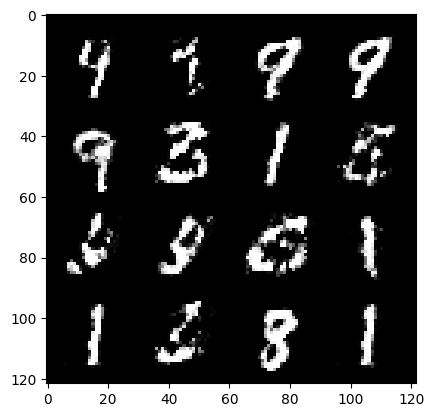

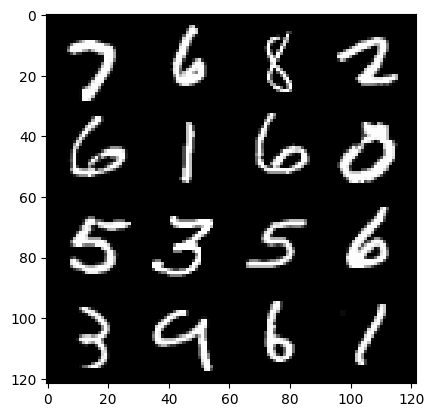

 79%|███████▉  | 372/469 [00:06<00:02, 40.38it/s]

328: step 154200 / Gen loss: 1.6221730426947283 / disc_loss: 0.36331925034523027


 41%|████▏     | 194/469 [00:03<00:04, 67.37it/s]

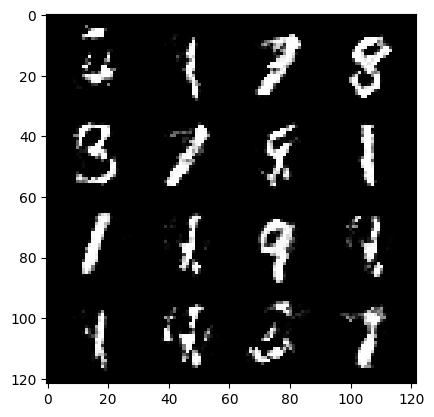

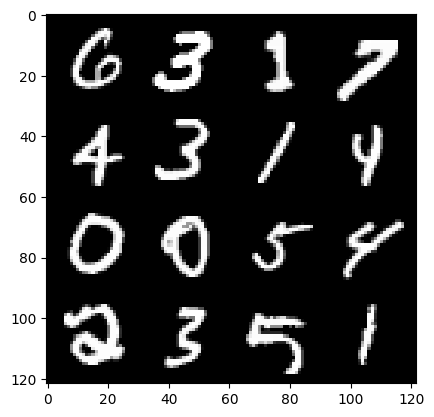

 44%|████▍     | 207/469 [00:03<00:05, 44.44it/s]

329: step 154500 / Gen loss: 1.6648496448993684 / disc_loss: 0.3606566014885904


  6%|▋         | 30/469 [00:00<00:06, 66.14it/s]

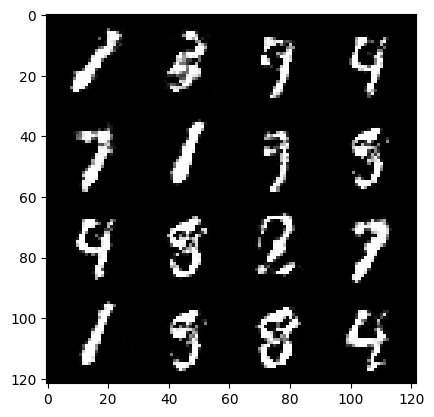

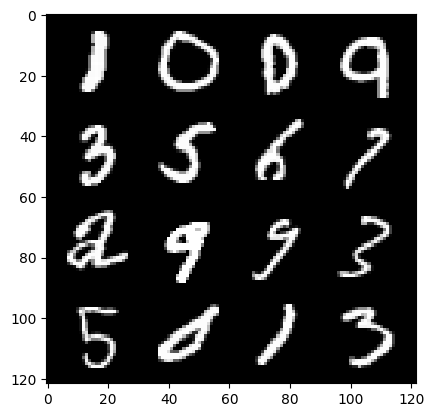

  8%|▊         | 37/469 [00:00<00:12, 35.59it/s]

330: step 154800 / Gen loss: 1.6492429459095 / disc_loss: 0.3661954132715859


 69%|██████▉   | 325/469 [00:05<00:02, 67.38it/s]

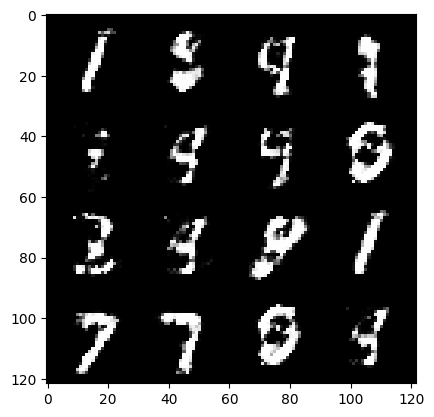

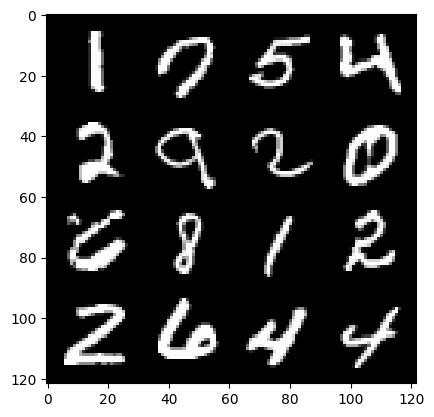

 72%|███████▏  | 338/469 [00:05<00:02, 46.15it/s]

330: step 155100 / Gen loss: 1.5961203885078425 / disc_loss: 0.37214608053366316


 34%|███▍      | 161/469 [00:02<00:04, 71.19it/s]

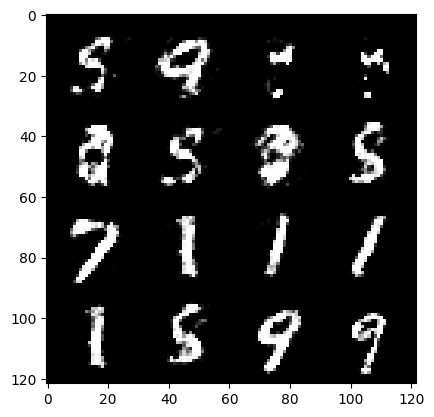

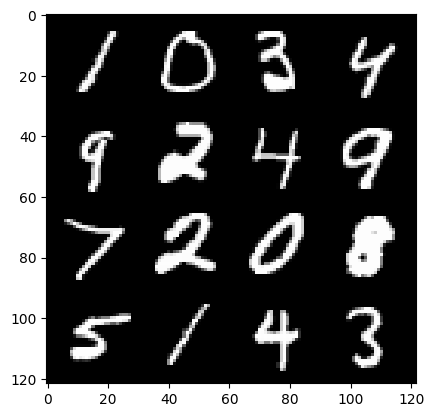

 36%|███▌      | 169/469 [00:02<00:06, 44.35it/s]

331: step 155400 / Gen loss: 1.666906121174494 / disc_loss: 0.35179109990596774


 97%|█████████▋| 454/469 [00:07<00:00, 66.26it/s]

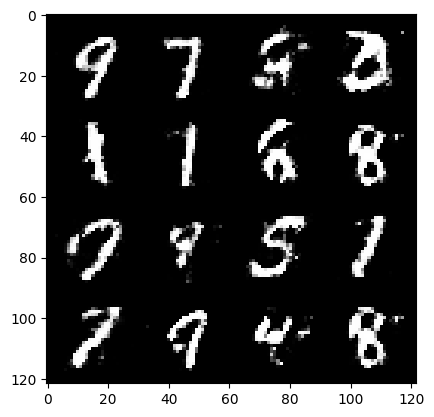

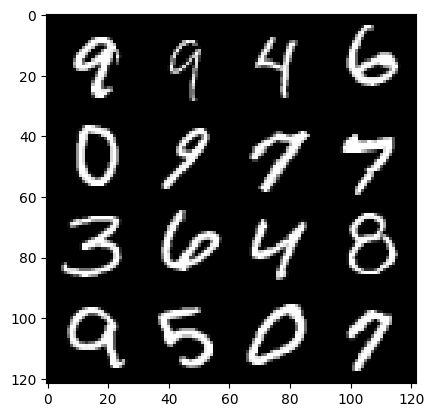

100%|██████████| 469/469 [00:07<00:00, 62.98it/s]


331: step 155700 / Gen loss: 1.604740103483202 / disc_loss: 0.3595185815294585


 62%|██████▏   | 292/469 [00:04<00:03, 51.95it/s]

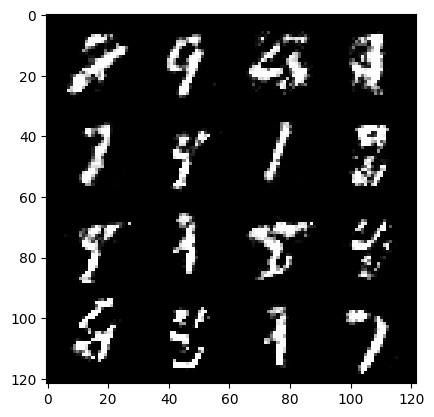

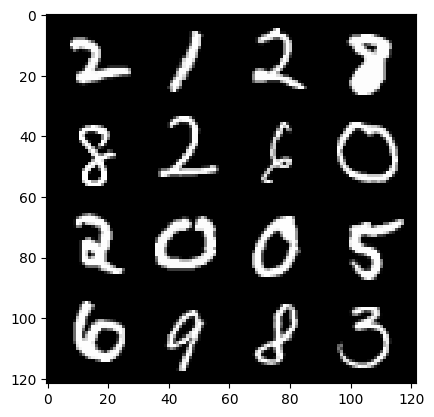

 64%|██████▎   | 298/469 [00:04<00:05, 31.86it/s]

332: step 156000 / Gen loss: 1.6002070192495976 / disc_loss: 0.36718514353036885


 26%|██▌       | 122/469 [00:01<00:05, 68.62it/s]

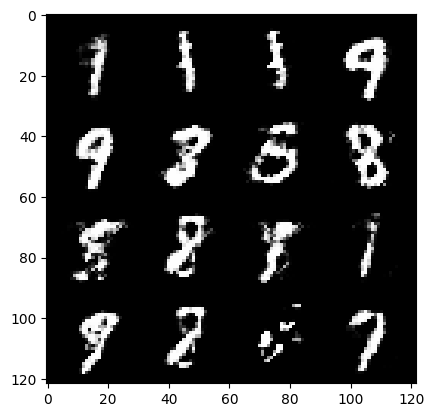

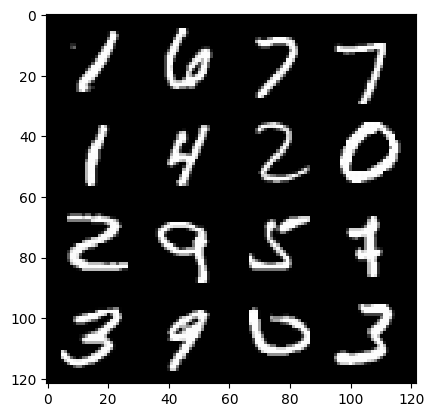

 28%|██▊       | 129/469 [00:02<00:08, 40.67it/s]

333: step 156300 / Gen loss: 1.6661826872825625 / disc_loss: 0.365453735391299


 90%|█████████ | 423/469 [00:06<00:00, 65.20it/s]

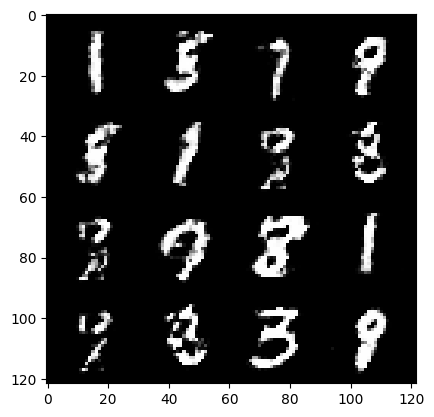

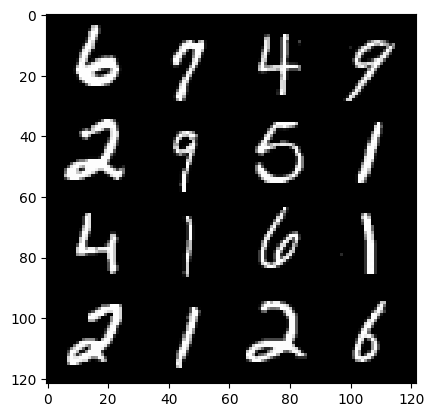

 92%|█████████▏| 430/469 [00:07<00:00, 40.41it/s]

333: step 156600 / Gen loss: 1.7166062486171734 / disc_loss: 0.34552069544792197


 53%|█████▎    | 248/469 [00:03<00:03, 71.20it/s]

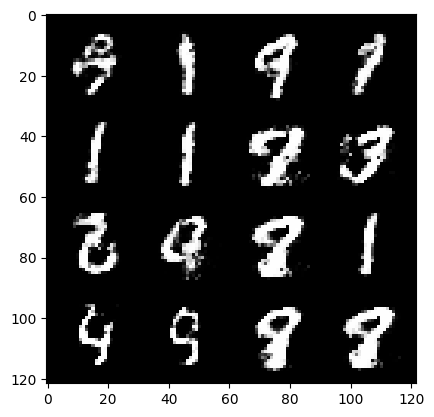

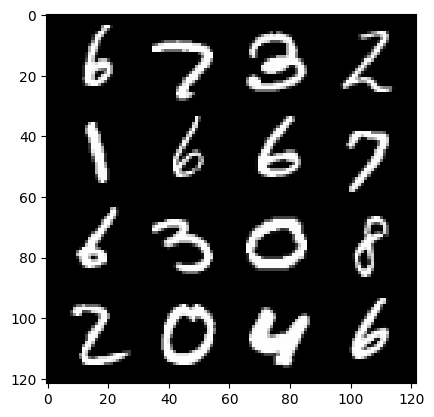

 56%|█████▌    | 262/469 [00:04<00:04, 46.85it/s]

334: step 156900 / Gen loss: 1.5698001897335052 / disc_loss: 0.37659435351689663


 17%|█▋        | 82/469 [00:01<00:05, 69.47it/s]

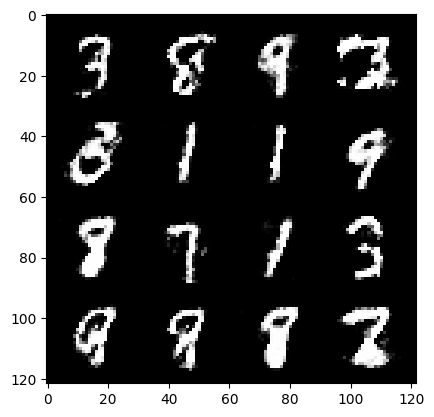

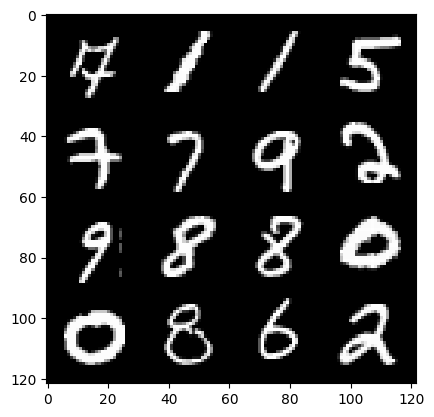

 20%|██        | 95/469 [00:01<00:08, 45.96it/s]

335: step 157200 / Gen loss: 1.5346948083241776 / disc_loss: 0.38017239242792156


 82%|████████▏ | 384/469 [00:06<00:01, 64.01it/s]

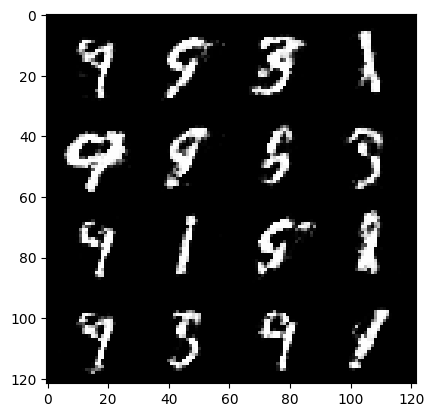

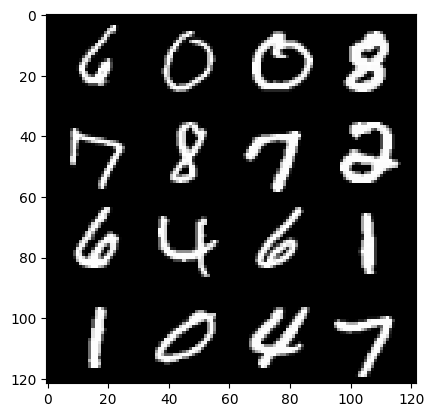

 85%|████████▍ | 397/469 [00:06<00:01, 42.30it/s]

335: step 157500 / Gen loss: 1.5637527406215672 / disc_loss: 0.3969905174771943


 45%|████▍     | 210/469 [00:03<00:03, 69.96it/s]

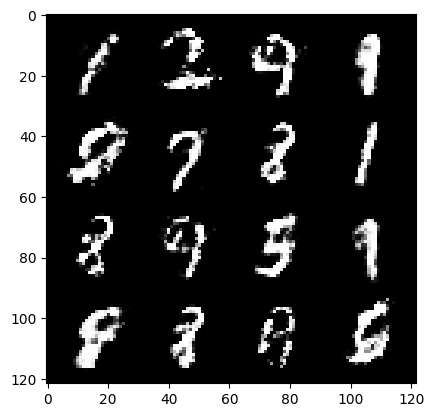

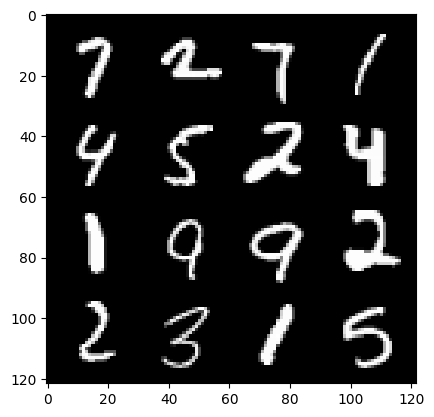

 48%|████▊     | 224/469 [00:03<00:05, 44.64it/s]

336: step 157800 / Gen loss: 1.5279971408843993 / disc_loss: 0.39378320078055057


 10%|█         | 47/469 [00:00<00:05, 71.31it/s]

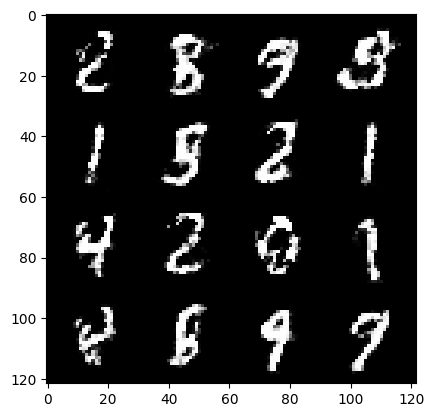

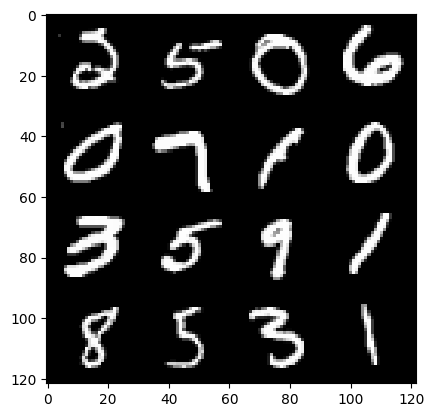

 12%|█▏        | 55/469 [00:01<00:10, 41.20it/s]

337: step 158100 / Gen loss: 1.5500963322321566 / disc_loss: 0.36238710522651696


 73%|███████▎  | 344/469 [00:05<00:01, 64.42it/s]

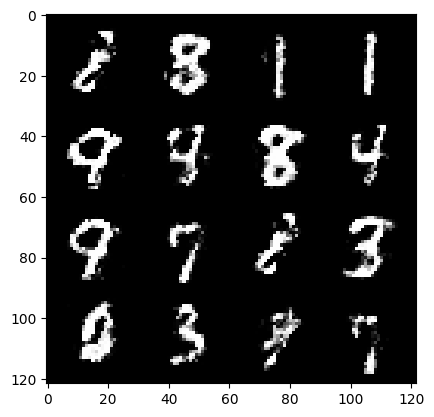

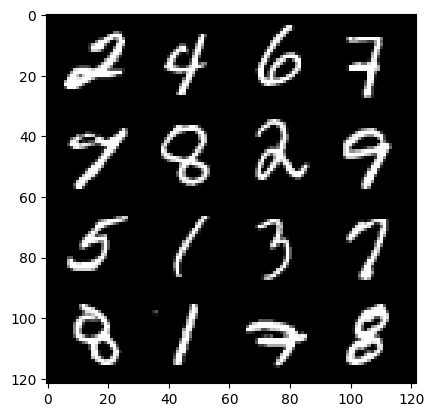

 75%|███████▍  | 351/469 [00:05<00:02, 41.07it/s]

337: step 158400 / Gen loss: 1.608091213703156 / disc_loss: 0.36630400240421285


 38%|███▊      | 177/469 [00:02<00:04, 62.74it/s]

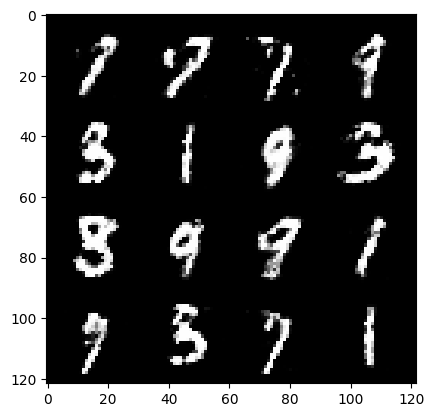

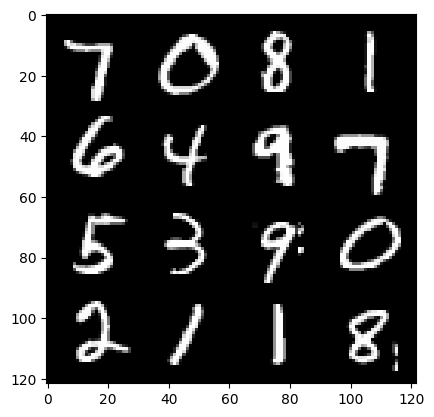

 39%|███▉      | 184/469 [00:02<00:07, 40.22it/s]

338: step 158700 / Gen loss: 1.5426773238182065 / disc_loss: 0.3787122906247778


  1%|▏         | 7/469 [00:00<00:07, 63.31it/s]

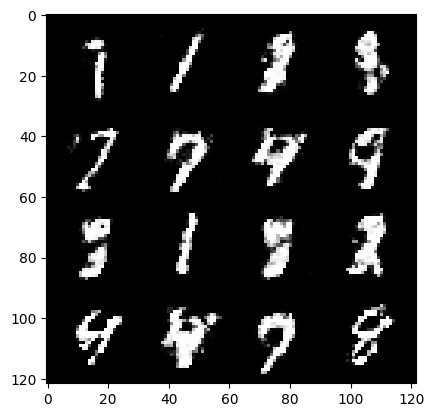

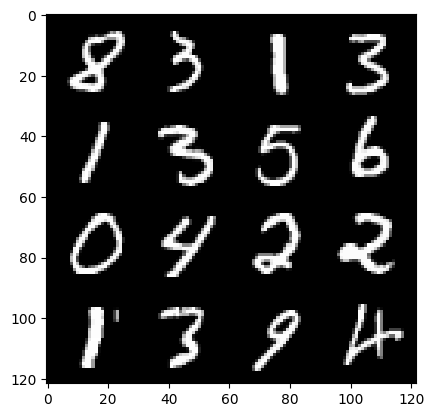

  3%|▎         | 14/469 [00:00<00:14, 30.89it/s]

339: step 159000 / Gen loss: 1.6989138182004302 / disc_loss: 0.3523778963088989


 66%|██████▌   | 308/469 [00:05<00:02, 69.15it/s]

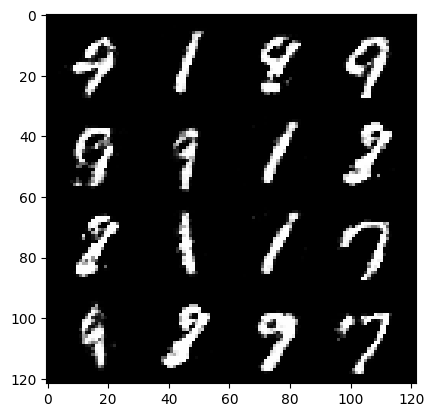

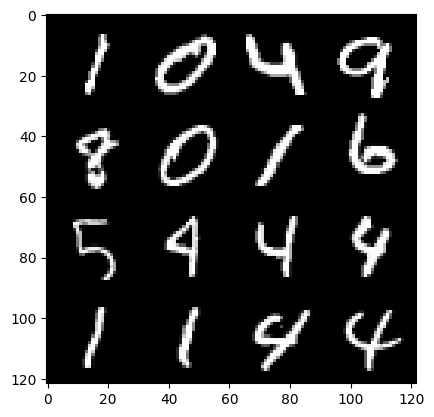

 67%|██████▋   | 315/469 [00:05<00:03, 40.50it/s]

339: step 159300 / Gen loss: 1.695671847263972 / disc_loss: 0.3606312721967697


 29%|██▉       | 138/469 [00:01<00:04, 68.89it/s]

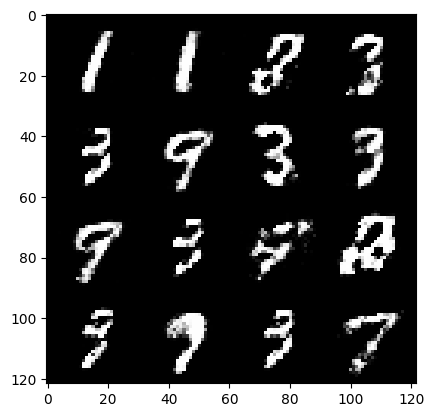

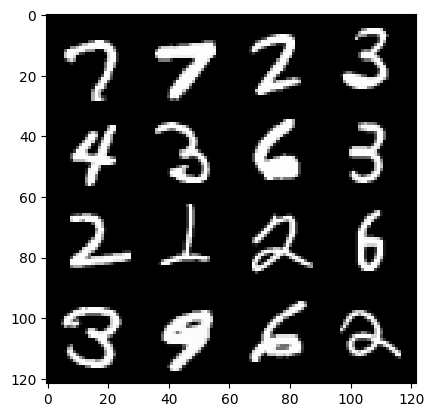

 31%|███       | 145/469 [00:02<00:06, 46.32it/s]

340: step 159600 / Gen loss: 1.6315050172805805 / disc_loss: 0.3711893299221996


 92%|█████████▏| 433/469 [00:06<00:00, 66.78it/s]

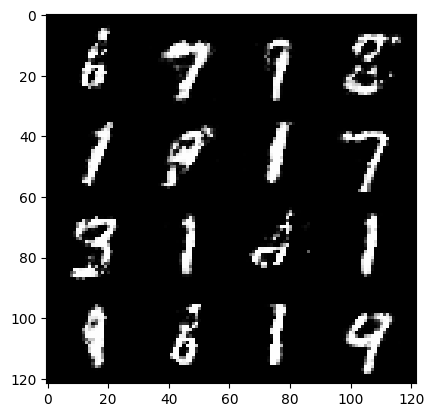

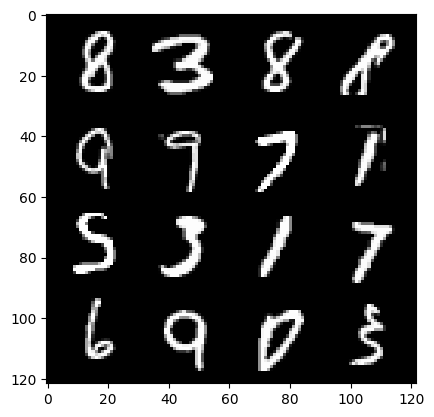

 95%|█████████▌| 447/469 [00:07<00:00, 45.40it/s]

340: step 159900 / Gen loss: 1.6245725591977433 / disc_loss: 0.3699032143751781


 56%|█████▋    | 264/469 [00:04<00:03, 59.63it/s]

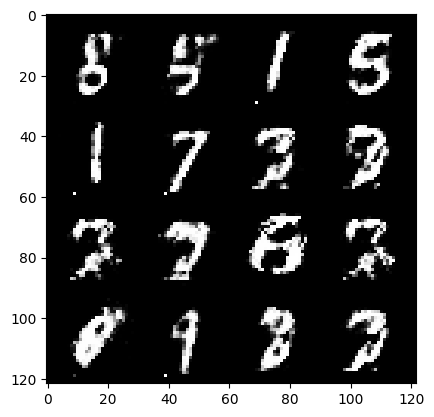

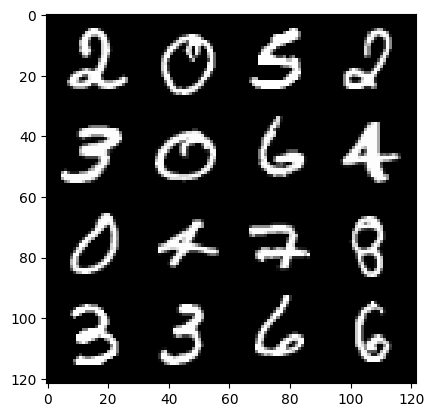

 59%|█████▉    | 279/469 [00:04<00:03, 48.23it/s]

341: step 160200 / Gen loss: 1.4974558655420935 / disc_loss: 0.41647086034218495


 21%|██        | 98/469 [00:01<00:05, 70.53it/s]

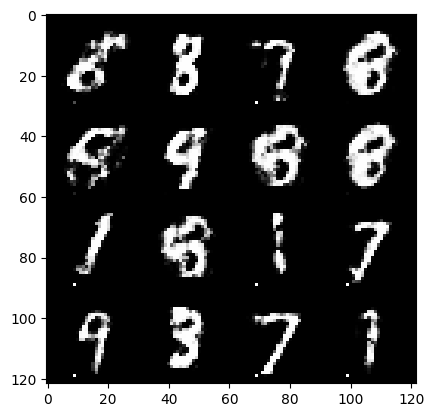

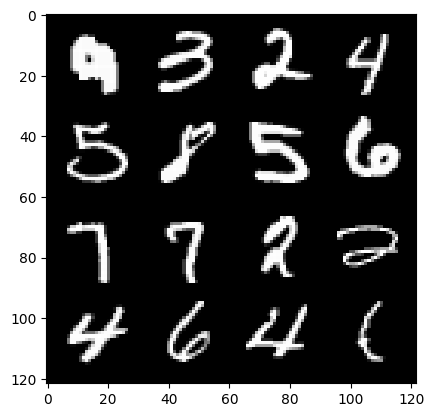

 23%|██▎       | 106/469 [00:01<00:07, 45.90it/s]

342: step 160500 / Gen loss: 1.1229897662003832 / disc_loss: 0.5015735260645546


 85%|████████▍ | 397/469 [00:06<00:00, 73.75it/s]

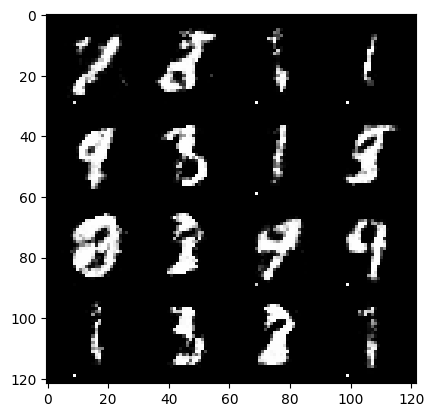

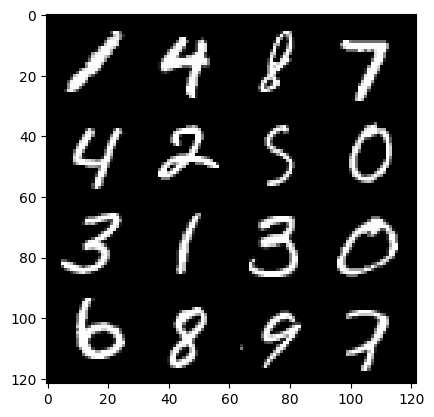

 86%|████████▋ | 405/469 [00:06<00:01, 46.92it/s]

342: step 160800 / Gen loss: 1.1653662872314456 / disc_loss: 0.46619102011124247


 48%|████▊     | 227/469 [00:03<00:03, 73.04it/s]

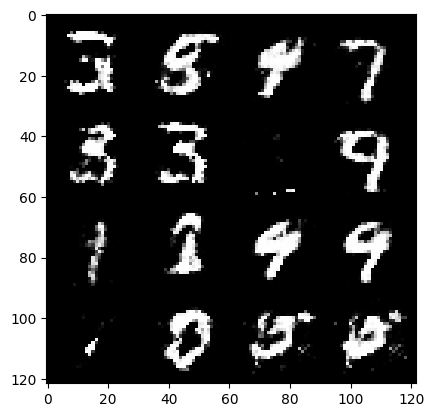

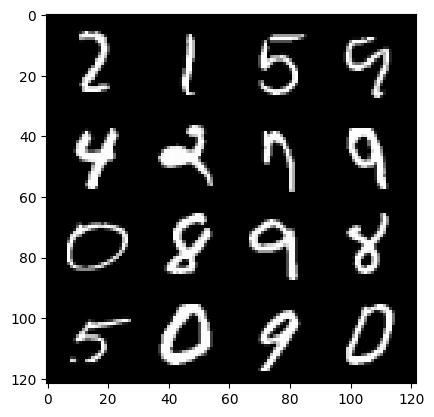

 51%|█████▏    | 241/469 [00:03<00:04, 46.67it/s]

343: step 161100 / Gen loss: 1.2863686144351958 / disc_loss: 0.41342249284187943


 14%|█▎        | 64/469 [00:00<00:06, 67.01it/s]

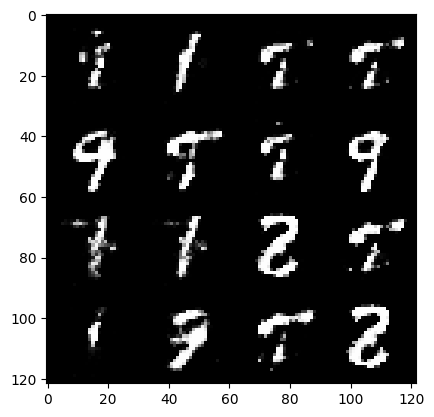

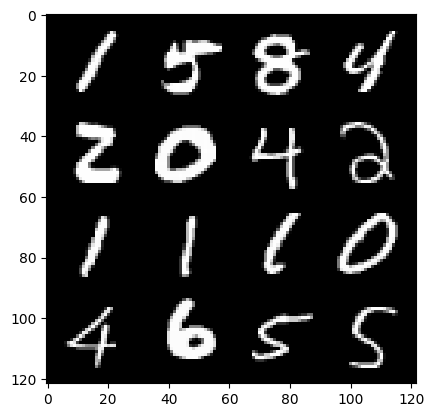

 15%|█▌        | 71/469 [00:01<00:10, 38.87it/s]

344: step 161400 / Gen loss: 1.3403992752234144 / disc_loss: 0.42350349118312214


 76%|███████▋  | 358/469 [00:05<00:01, 70.86it/s]

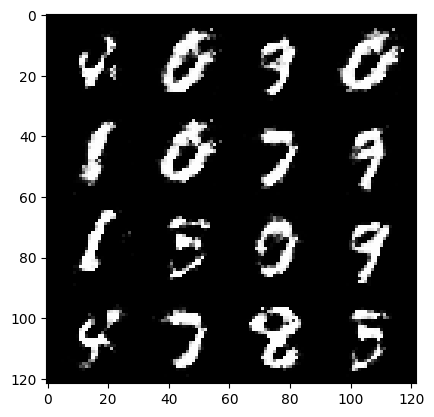

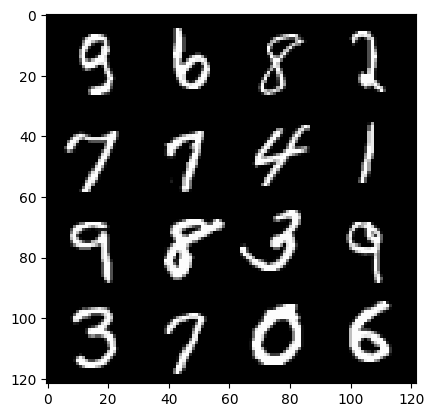

 78%|███████▊  | 366/469 [00:05<00:02, 48.57it/s]

344: step 161700 / Gen loss: 1.6961973603566494 / disc_loss: 0.35151232441266395


 41%|████      | 193/469 [00:02<00:03, 72.13it/s]

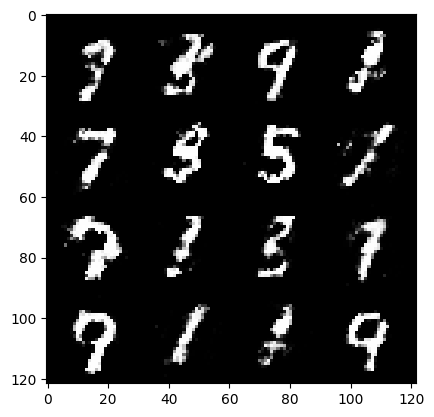

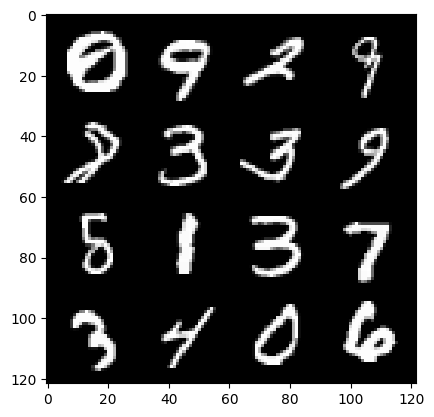

 43%|████▎     | 201/469 [00:02<00:05, 45.21it/s]

345: step 162000 / Gen loss: 1.7335023303826647 / disc_loss: 0.37562065710624054


  5%|▍         | 23/469 [00:00<00:06, 73.51it/s]

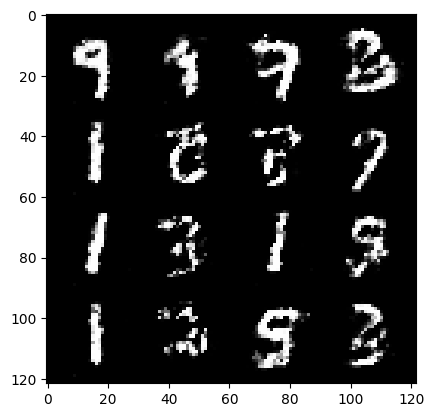

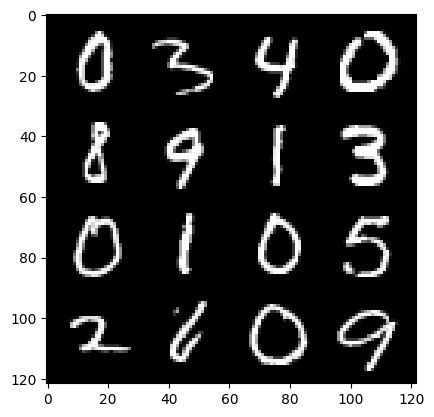

  7%|▋         | 31/469 [00:00<00:10, 42.60it/s]

346: step 162300 / Gen loss: 1.7798246041933707 / disc_loss: 0.35245400518178926


 69%|██████▊   | 322/469 [00:04<00:02, 67.43it/s]

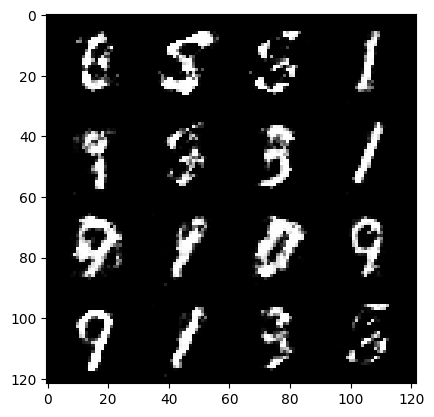

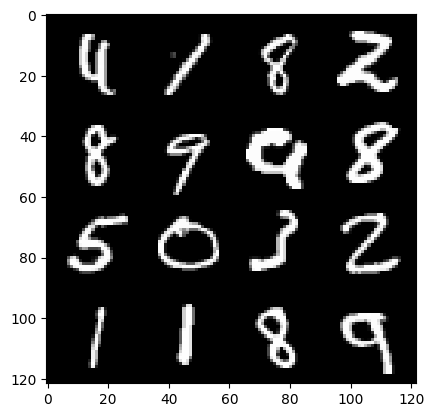

 71%|███████▏  | 335/469 [00:05<00:03, 39.83it/s]

346: step 162600 / Gen loss: 1.667796650330226 / disc_loss: 0.3593872387210529


 33%|███▎      | 157/469 [00:02<00:04, 65.72it/s]

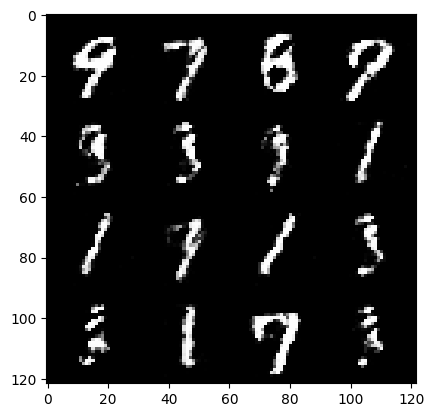

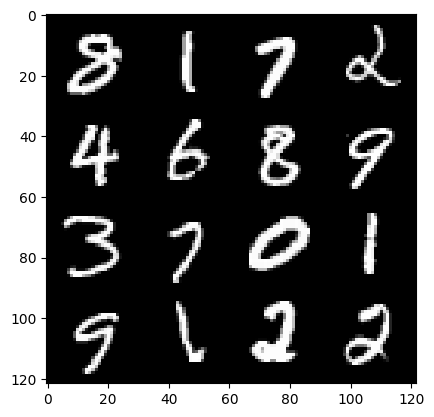

 35%|███▍      | 164/469 [00:02<00:07, 41.41it/s]

347: step 162900 / Gen loss: 1.7010560222466786 / disc_loss: 0.3505324942866964


 96%|█████████▌| 450/469 [00:06<00:00, 66.35it/s]

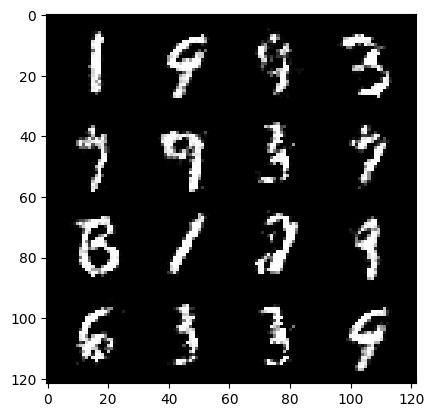

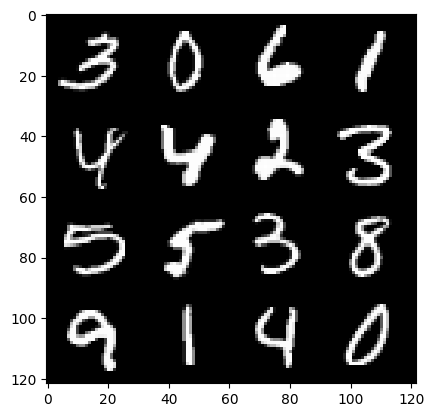

 99%|█████████▉| 464/469 [00:07<00:00, 45.91it/s]

347: step 163200 / Gen loss: 1.7007031377156576 / disc_loss: 0.3431071137885253


 60%|██████    | 283/469 [00:04<00:02, 65.95it/s]

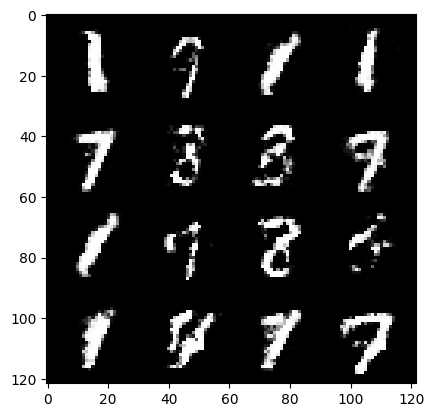

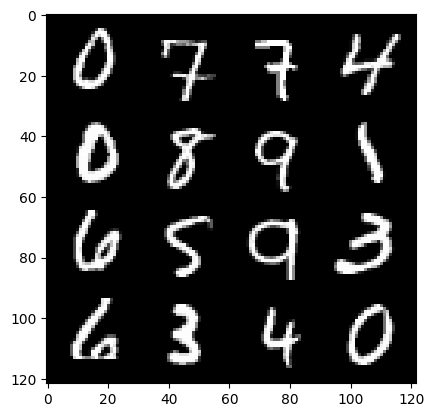

 63%|██████▎   | 296/469 [00:05<00:03, 44.21it/s]

348: step 163500 / Gen loss: 1.8394913617769884 / disc_loss: 0.3305056492487589


 24%|██▍       | 112/469 [00:01<00:04, 71.48it/s]

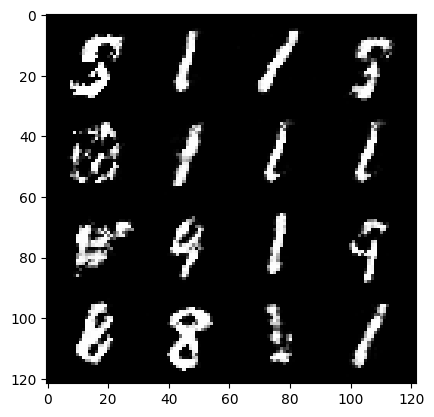

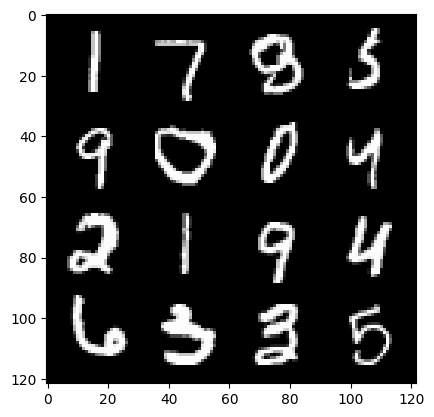

 27%|██▋       | 126/469 [00:02<00:07, 46.32it/s]

349: step 163800 / Gen loss: 1.7548420854409543 / disc_loss: 0.3481136782964071


 89%|████████▉ | 418/469 [00:06<00:00, 61.62it/s]

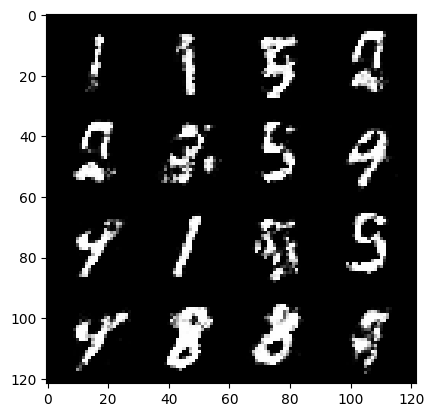

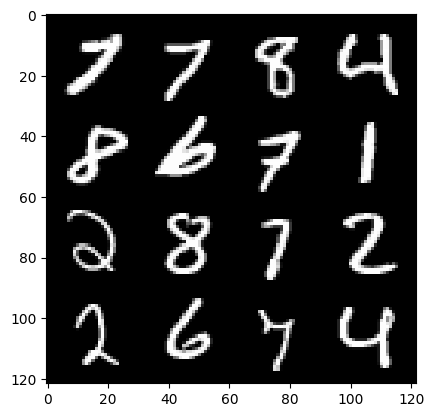

 91%|█████████ | 425/469 [00:06<00:01, 38.29it/s]

349: step 164100 / Gen loss: 1.7768481032053614 / disc_loss: 0.3511982423067093


 52%|█████▏    | 243/469 [00:03<00:03, 72.72it/s]

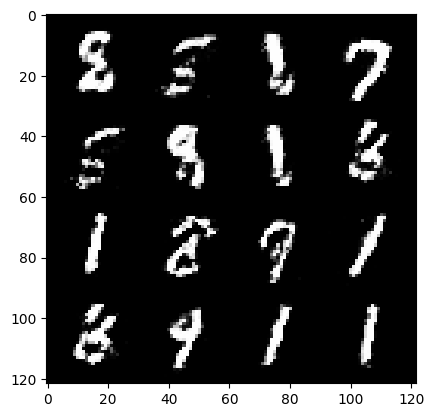

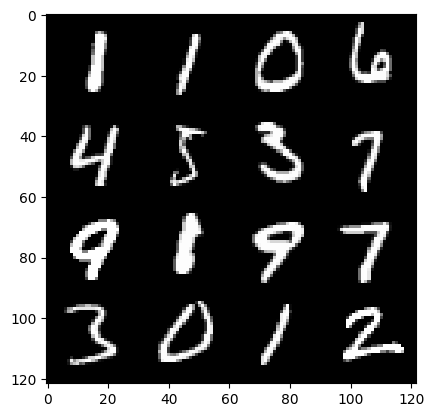

 55%|█████▍    | 257/469 [00:04<00:04, 45.68it/s]

350: step 164400 / Gen loss: 1.791391903162002 / disc_loss: 0.3547320261597631


 16%|█▋        | 77/469 [00:01<00:05, 70.32it/s]

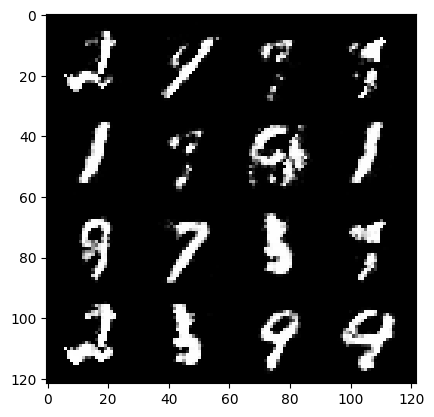

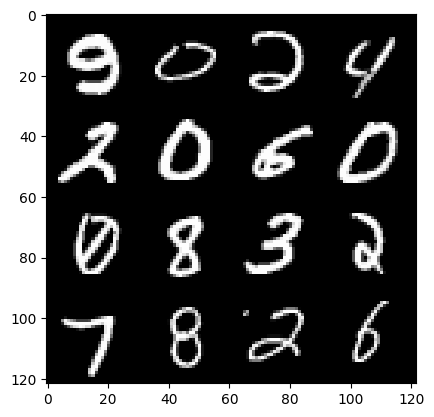

 18%|█▊        | 85/469 [00:01<00:08, 45.20it/s]

351: step 164700 / Gen loss: 1.8147141575813295 / disc_loss: 0.33394845202565193


 80%|███████▉  | 374/469 [00:05<00:01, 69.46it/s]

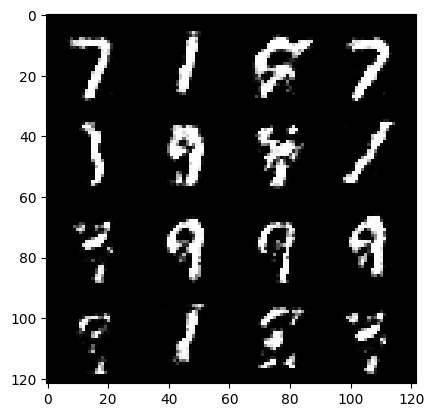

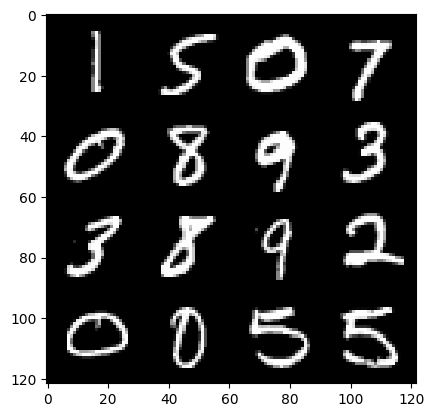

 83%|████████▎ | 388/469 [00:06<00:01, 47.24it/s]

351: step 165000 / Gen loss: 1.7870059418678284 / disc_loss: 0.3368358983099461


 44%|████▍     | 207/469 [00:03<00:04, 58.71it/s]

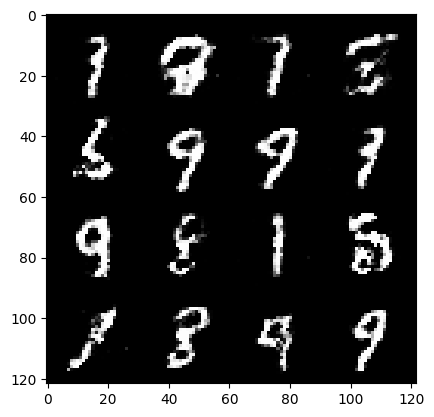

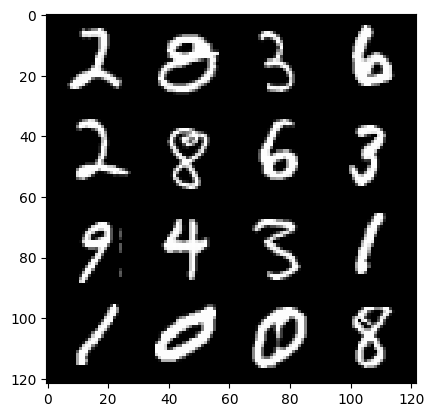

 46%|████▋     | 218/469 [00:03<00:06, 41.78it/s]

352: step 165300 / Gen loss: 1.740047428607941 / disc_loss: 0.34670049329598746


  9%|▉         | 43/469 [00:00<00:06, 66.60it/s]

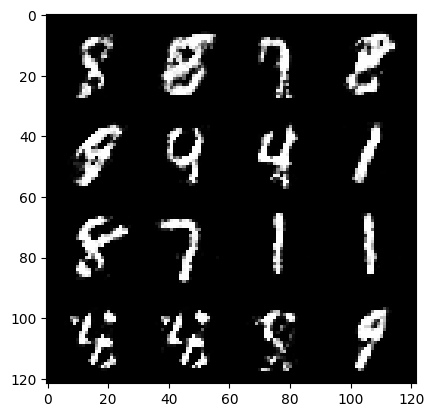

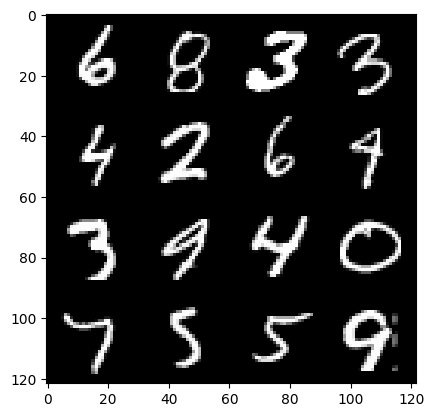

 11%|█         | 50/469 [00:00<00:10, 39.64it/s]

353: step 165600 / Gen loss: 1.7024856118361156 / disc_loss: 0.36770187278588634


 72%|███████▏  | 337/469 [00:05<00:02, 61.55it/s]

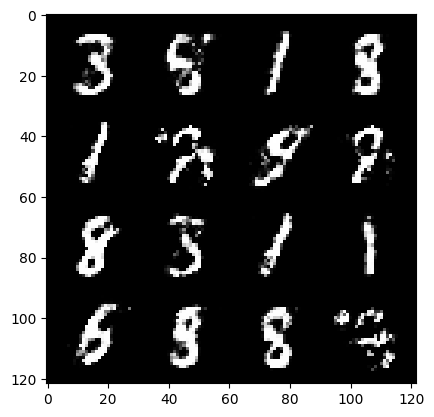

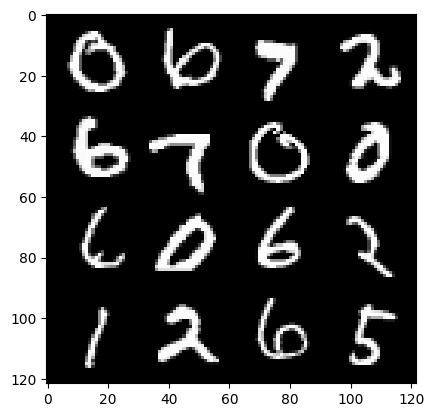

 75%|███████▍  | 350/469 [00:06<00:02, 41.53it/s]

353: step 165900 / Gen loss: 1.6773931165536244 / disc_loss: 0.3678830256064735


 36%|███▌      | 170/469 [00:02<00:04, 66.00it/s]

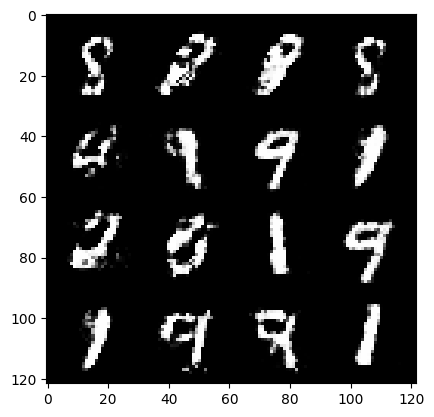

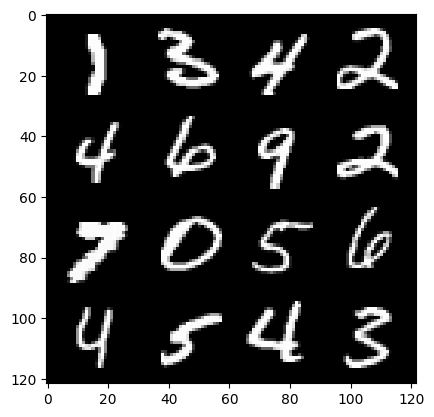

 39%|███▉      | 183/469 [00:02<00:06, 46.16it/s]

354: step 166200 / Gen loss: 1.773256114323935 / disc_loss: 0.3615442219376562


  0%|          | 0/469 [00:00<?, ?it/s]

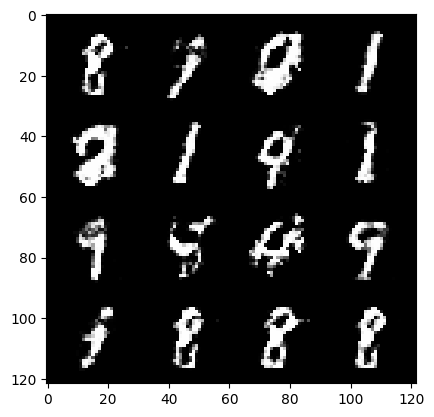

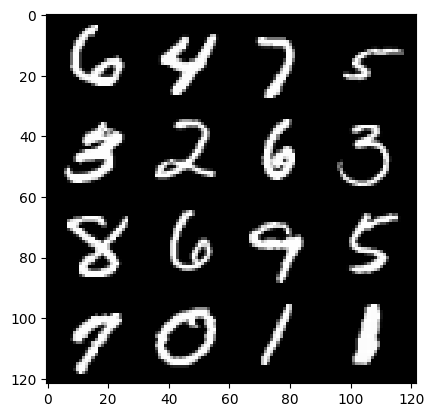

  2%|▏         | 10/469 [00:00<00:17, 26.03it/s]

355: step 166500 / Gen loss: 1.780818742911021 / disc_loss: 0.33876346011956543


 64%|██████▍   | 299/469 [00:05<00:02, 62.84it/s]

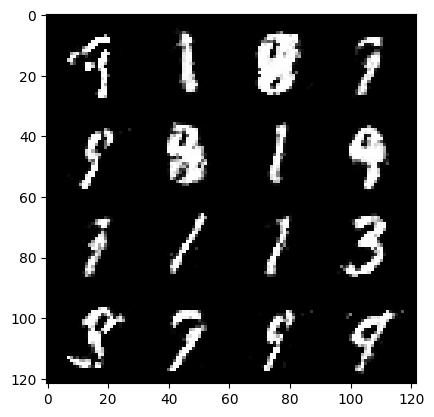

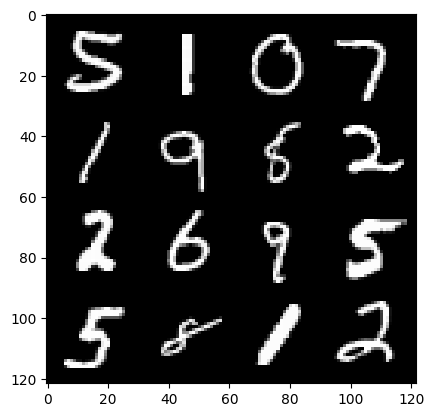

 67%|██████▋   | 312/469 [00:05<00:03, 40.47it/s]

355: step 166800 / Gen loss: 1.8163653043905883 / disc_loss: 0.3391647799809777


 28%|██▊       | 132/469 [00:02<00:05, 66.04it/s]

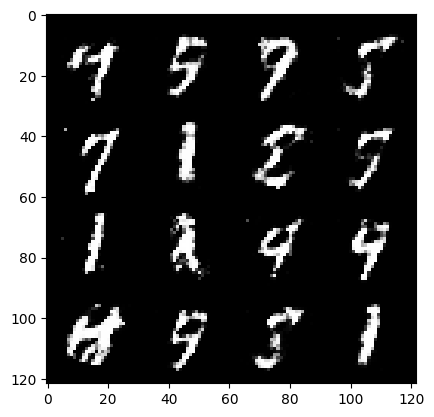

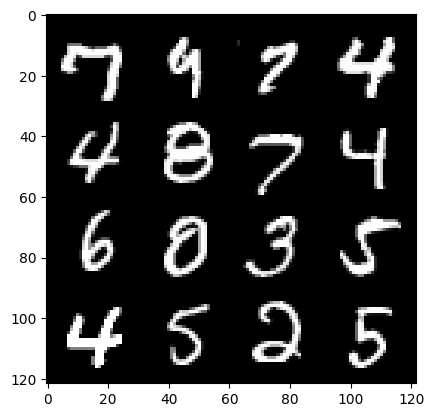

 30%|██▉       | 139/469 [00:02<00:06, 47.29it/s]

356: step 167100 / Gen loss: 1.8616696989536292 / disc_loss: 0.321494816193978


 92%|█████████▏| 432/469 [00:06<00:00, 68.98it/s]

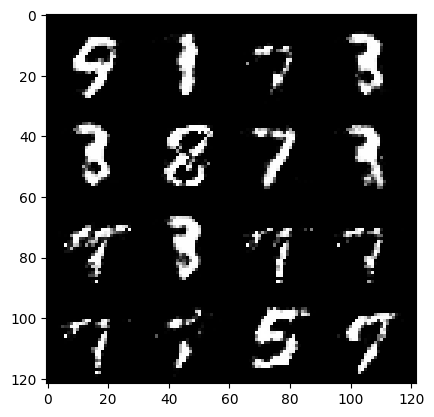

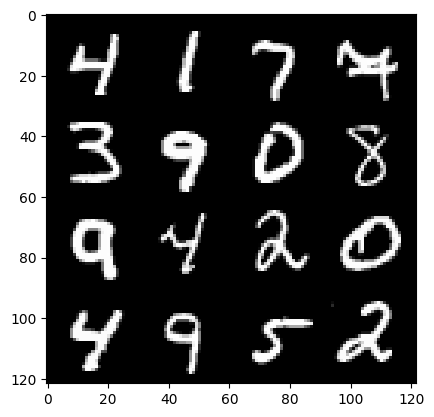

 95%|█████████▍| 445/469 [00:07<00:00, 42.73it/s]

356: step 167400 / Gen loss: 1.812299982309342 / disc_loss: 0.3421568058927852


 56%|█████▌    | 263/469 [00:04<00:03, 65.49it/s]

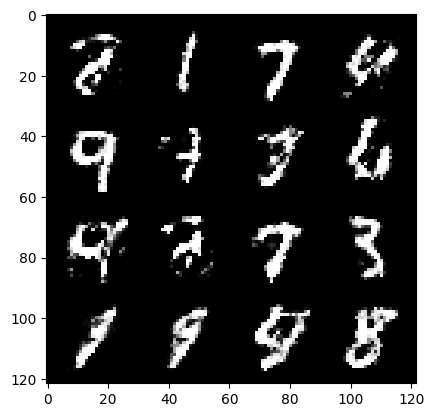

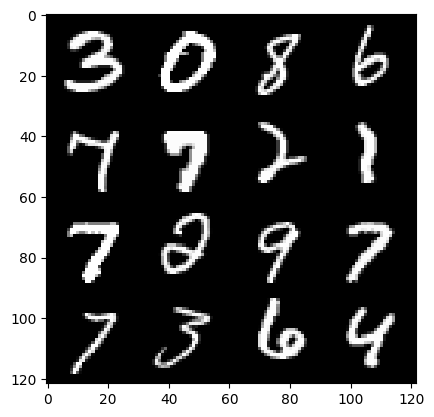

 59%|█████▉    | 276/469 [00:04<00:04, 43.95it/s]

357: step 167700 / Gen loss: 1.7002071221669517 / disc_loss: 0.35421033978462246


 20%|█▉        | 92/469 [00:01<00:05, 68.07it/s]

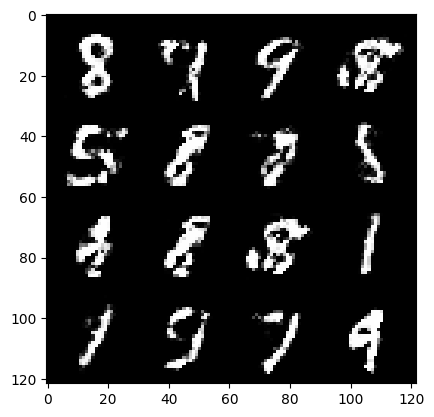

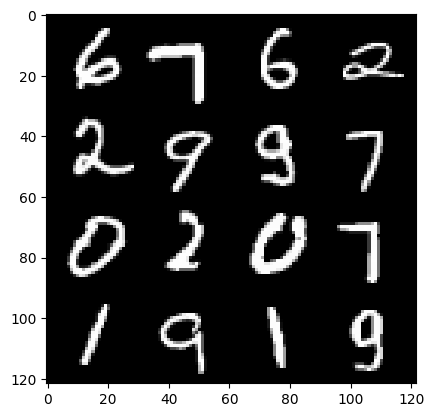

 22%|██▏       | 105/469 [00:01<00:08, 43.36it/s]

358: step 168000 / Gen loss: 1.6259977591037729 / disc_loss: 0.3697737417618433


 85%|████████▍ | 398/469 [00:06<00:01, 68.93it/s]

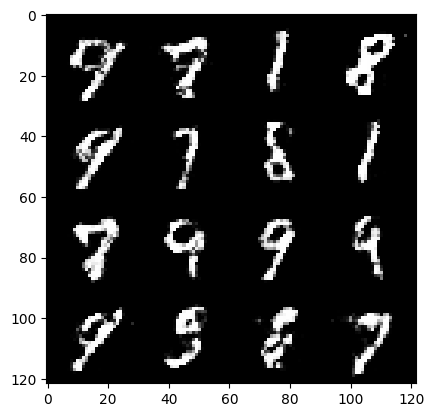

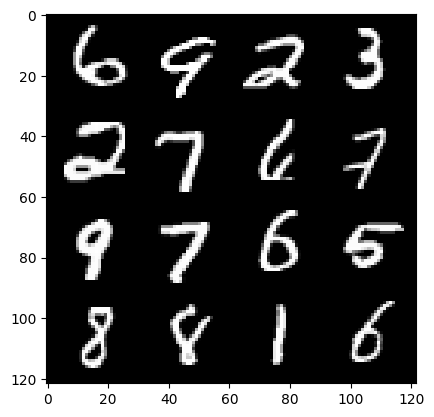

 86%|████████▋ | 405/469 [00:06<00:01, 36.25it/s]

358: step 168300 / Gen loss: 1.5318318569660196 / disc_loss: 0.38077328324317916


 49%|████▉     | 229/469 [00:03<00:03, 68.08it/s]

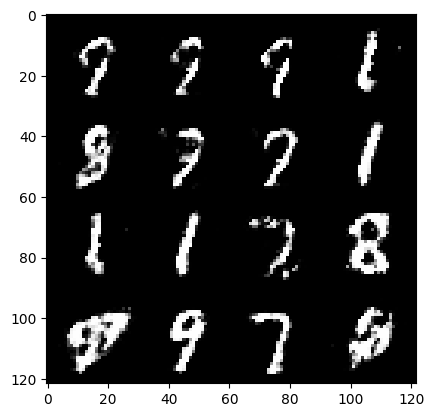

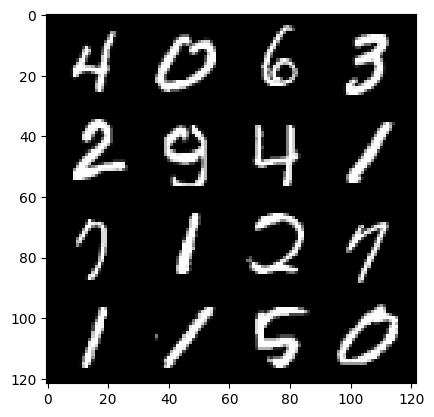

 50%|█████     | 236/469 [00:03<00:05, 42.23it/s]

359: step 168600 / Gen loss: 1.7585780052344009 / disc_loss: 0.3332658034563063


 13%|█▎        | 59/469 [00:00<00:06, 63.06it/s]

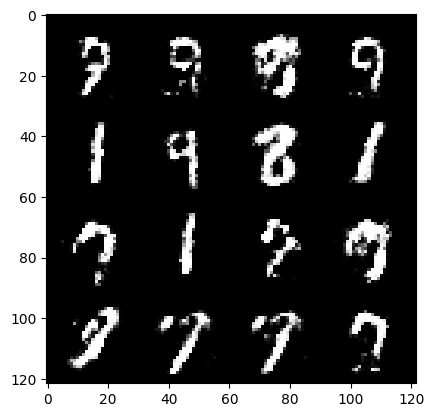

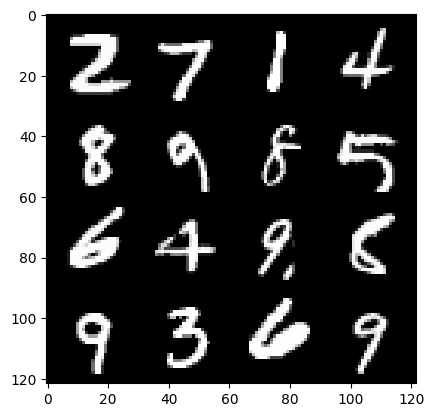

 14%|█▍        | 66/469 [00:01<00:09, 40.30it/s]

360: step 168900 / Gen loss: 1.7252345673243203 / disc_loss: 0.3641698224345842


 77%|███████▋  | 359/469 [00:05<00:01, 68.05it/s]

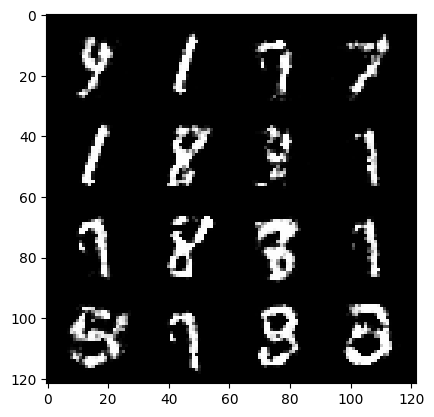

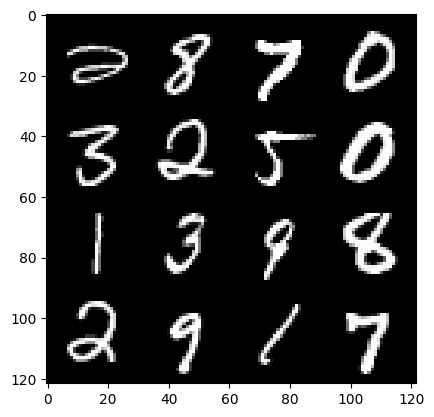

 79%|███████▉  | 372/469 [00:06<00:02, 47.03it/s]

360: step 169200 / Gen loss: 1.745384477376939 / disc_loss: 0.34351024821400633


 41%|████      | 190/469 [00:02<00:04, 65.78it/s]

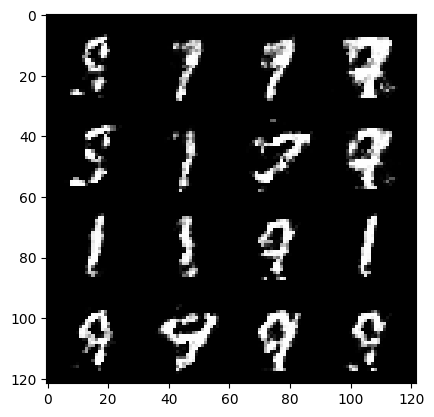

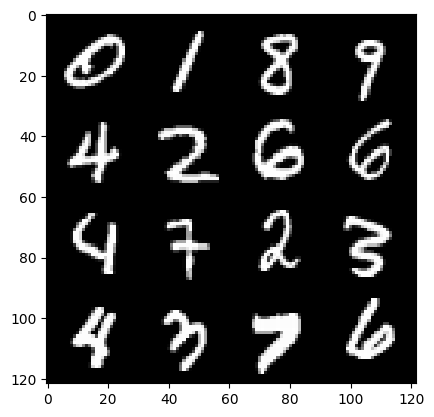

 42%|████▏     | 197/469 [00:03<00:06, 39.50it/s]

361: step 169500 / Gen loss: 1.683798650105795 / disc_loss: 0.34892351647218084


  3%|▎         | 16/469 [00:00<00:07, 60.11it/s]

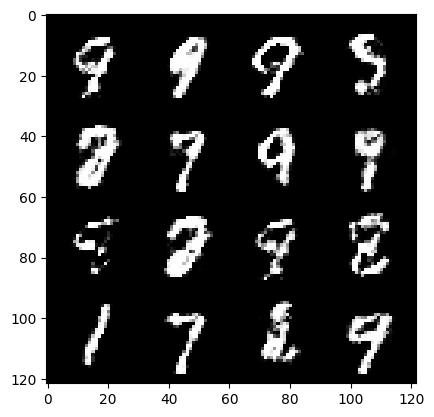

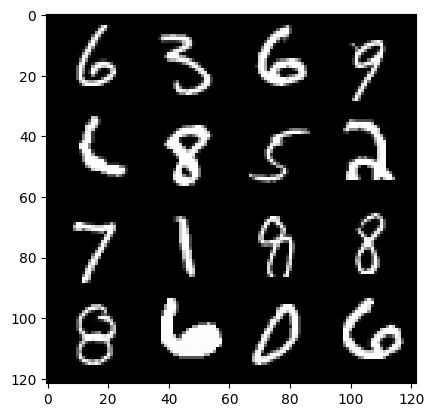

  6%|▌         | 28/469 [00:00<00:12, 36.23it/s]

362: step 169800 / Gen loss: 1.6832308717568714 / disc_loss: 0.356213134129842


 67%|██████▋   | 315/469 [00:05<00:02, 63.67it/s]

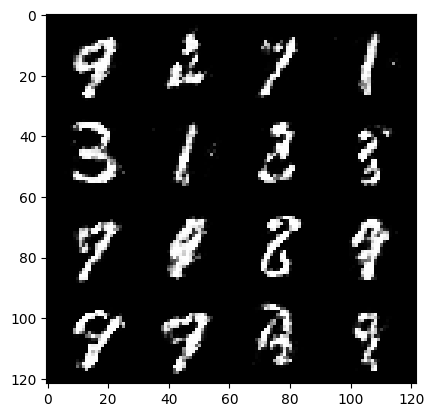

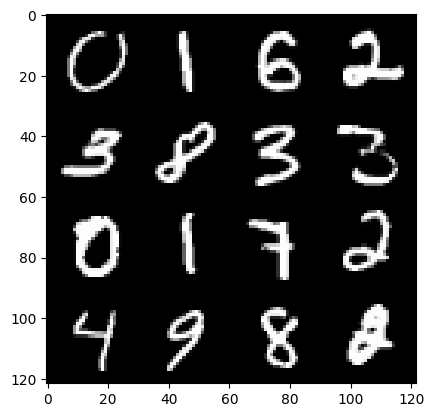

 70%|███████   | 329/469 [00:05<00:03, 44.76it/s]

362: step 170100 / Gen loss: 1.7117332418759674 / disc_loss: 0.33507652834057805


 32%|███▏      | 148/469 [00:02<00:04, 71.88it/s]

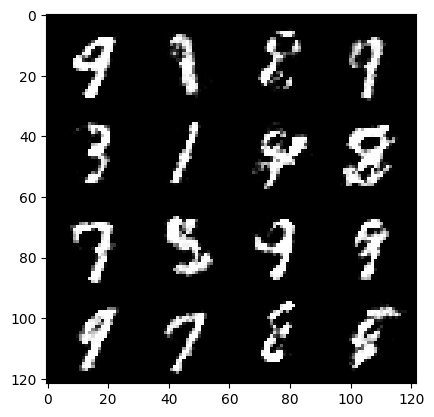

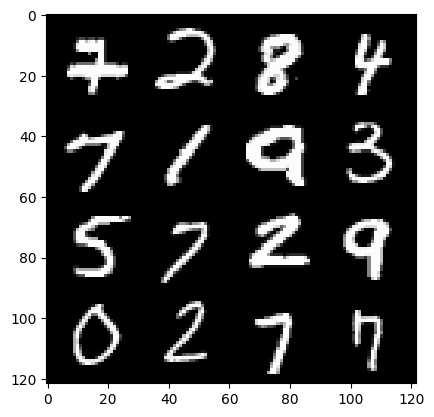

 35%|███▍      | 162/469 [00:02<00:06, 45.38it/s]

363: step 170400 / Gen loss: 1.6473628497123711 / disc_loss: 0.3595098484555882


 96%|█████████▌| 449/469 [00:06<00:00, 73.38it/s]

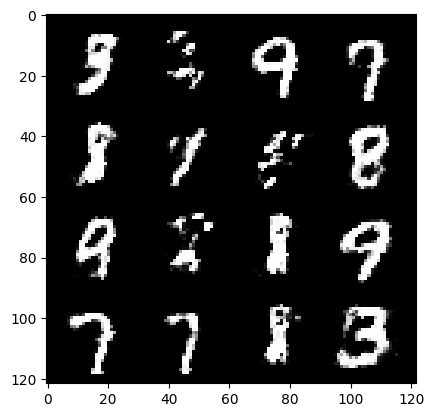

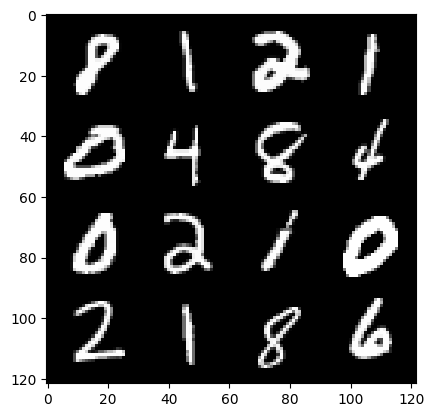

 99%|█████████▊| 463/469 [00:07<00:00, 45.14it/s]

363: step 170700 / Gen loss: 1.5685077293713883 / disc_loss: 0.3790615640083948


 60%|██████    | 283/469 [00:04<00:02, 66.45it/s]

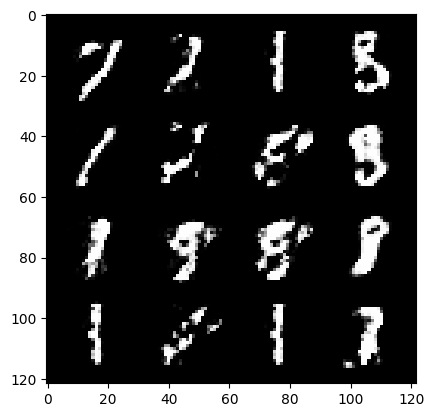

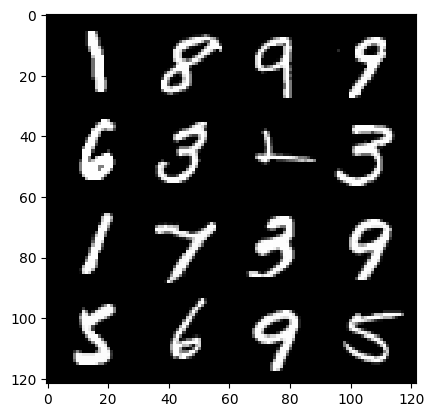

 62%|██████▏   | 290/469 [00:04<00:04, 41.88it/s]

364: step 171000 / Gen loss: 1.6247737924257908 / disc_loss: 0.3658657715717952


 23%|██▎       | 108/469 [00:01<00:05, 68.14it/s]

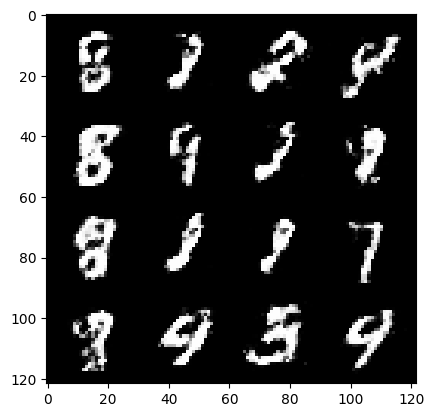

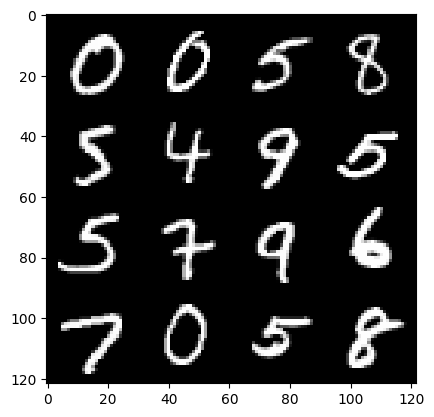

 26%|██▌       | 122/469 [00:02<00:07, 45.57it/s]

365: step 171300 / Gen loss: 1.665894745588301 / disc_loss: 0.3660614044467606


 88%|████████▊ | 411/469 [00:06<00:00, 66.92it/s]

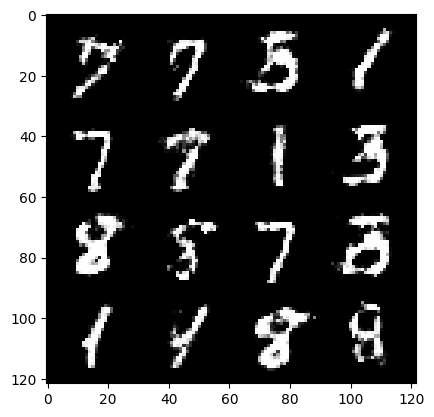

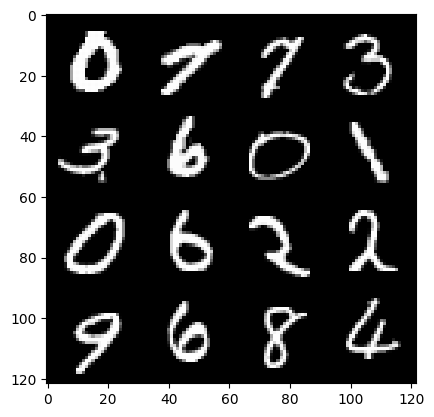

 90%|█████████ | 424/469 [00:06<00:01, 44.60it/s]

365: step 171600 / Gen loss: 1.6392969330151868 / disc_loss: 0.37641461094220474


 52%|█████▏    | 245/469 [00:03<00:03, 62.42it/s]

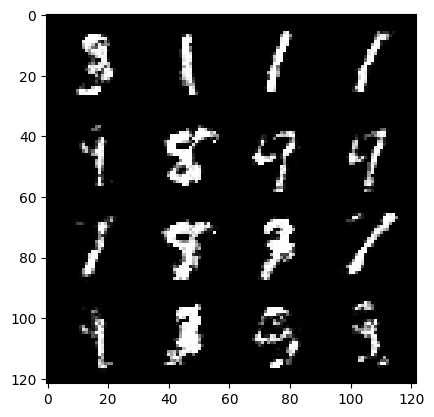

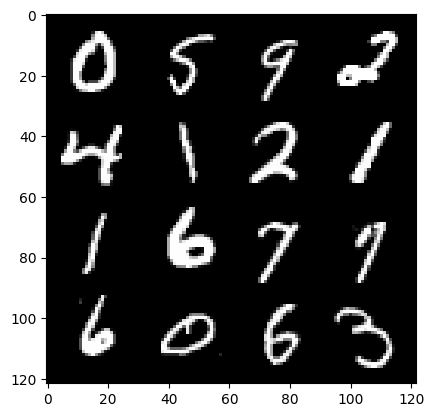

 54%|█████▎    | 252/469 [00:03<00:05, 41.94it/s]

366: step 171900 / Gen loss: 1.666095727682112 / disc_loss: 0.3709880599379538


 16%|█▌        | 74/469 [00:01<00:05, 67.49it/s]

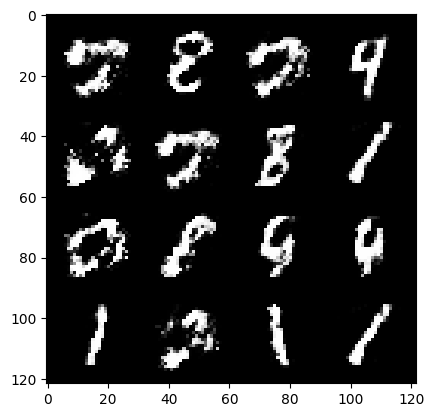

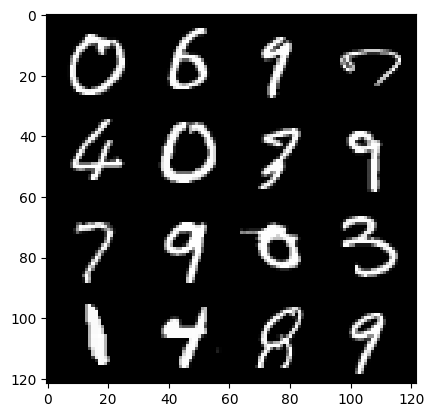

 19%|█▊        | 87/469 [00:01<00:08, 46.02it/s]

367: step 172200 / Gen loss: 1.688419620196023 / disc_loss: 0.3599452171723047


 79%|███████▉  | 372/469 [00:05<00:01, 72.01it/s]

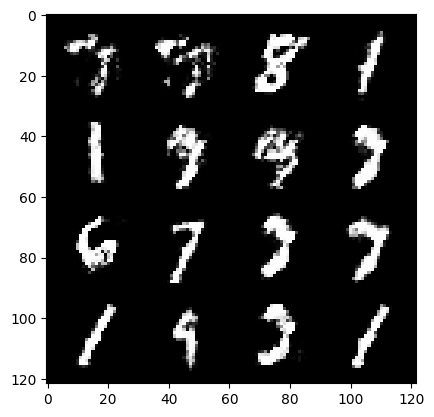

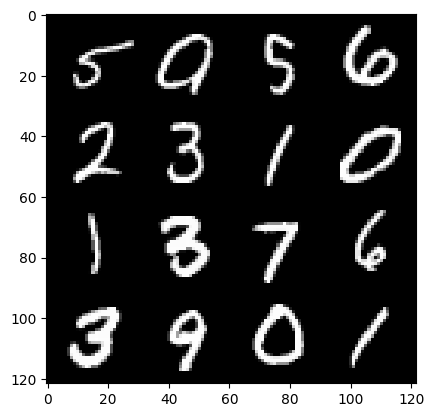

 82%|████████▏ | 386/469 [00:06<00:01, 46.74it/s]

367: step 172500 / Gen loss: 1.672253285249074 / disc_loss: 0.37876639922459937


 44%|████▍     | 207/469 [00:03<00:03, 68.52it/s]

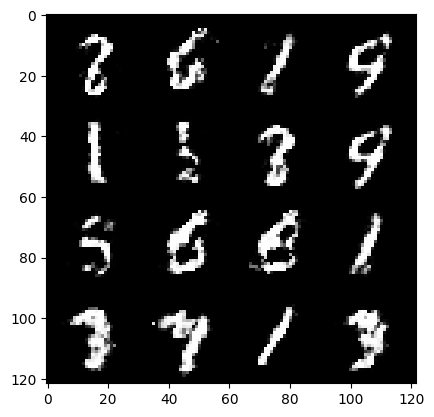

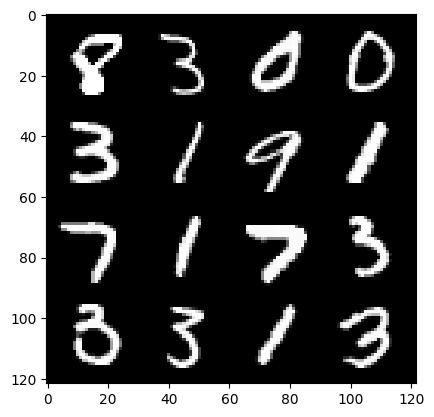

 46%|████▌     | 214/469 [00:03<00:06, 41.34it/s]

368: step 172800 / Gen loss: 1.6430009194215132 / disc_loss: 0.35818185249964396


  8%|▊         | 38/469 [00:00<00:06, 64.98it/s]

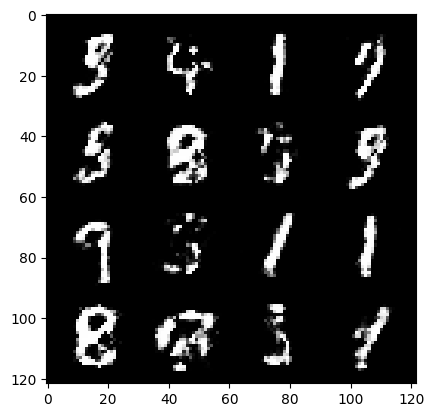

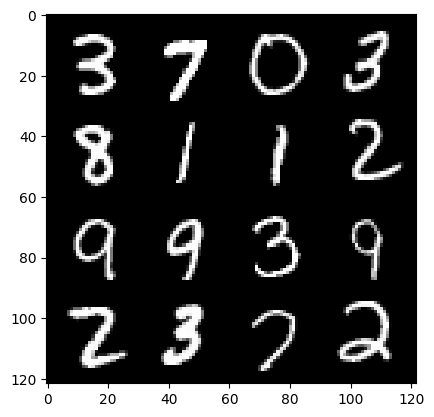

 10%|▉         | 45/469 [00:00<00:10, 40.41it/s]

369: step 173100 / Gen loss: 1.6912630347410849 / disc_loss: 0.35200063208738946


 71%|███████▏  | 335/469 [00:05<00:01, 70.49it/s]

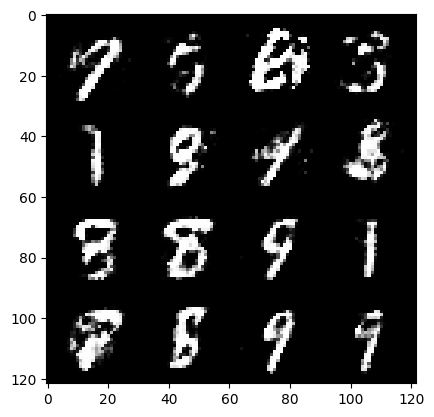

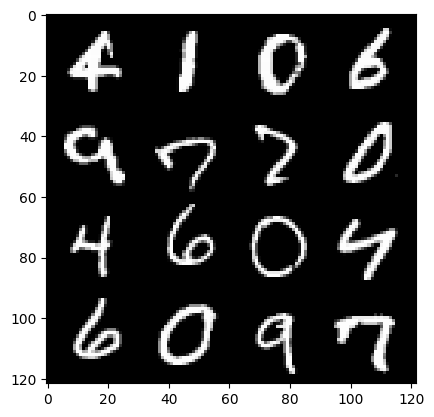

 74%|███████▍  | 349/469 [00:05<00:02, 46.95it/s]

369: step 173400 / Gen loss: 1.667455844481785 / disc_loss: 0.37121576160192526


 36%|███▌      | 169/469 [00:02<00:04, 71.35it/s]

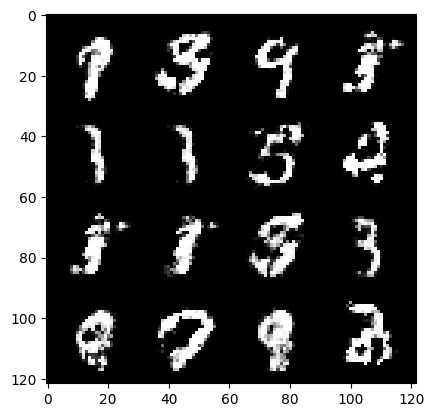

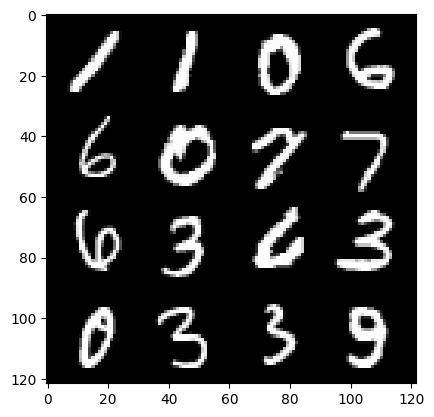

 38%|███▊      | 177/469 [00:03<00:07, 36.81it/s]

370: step 173700 / Gen loss: 1.6823418982823686 / disc_loss: 0.3597390019893645


  0%|          | 0/469 [00:00<?, ?it/s]

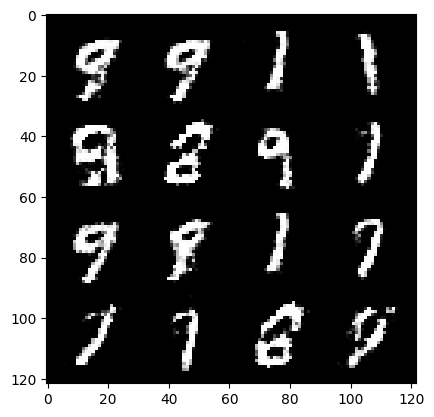

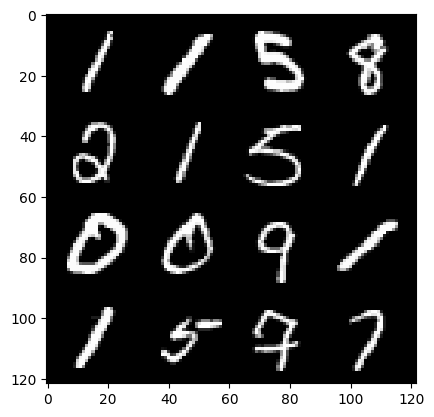

  1%|▏         | 7/469 [00:00<00:18, 24.74it/s]

371: step 174000 / Gen loss: 1.771376767158508 / disc_loss: 0.33969874938329037


 63%|██████▎   | 296/469 [00:04<00:02, 64.83it/s]

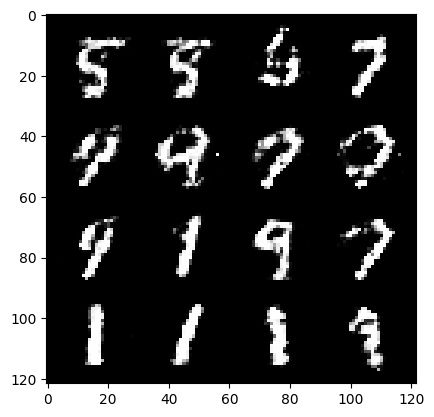

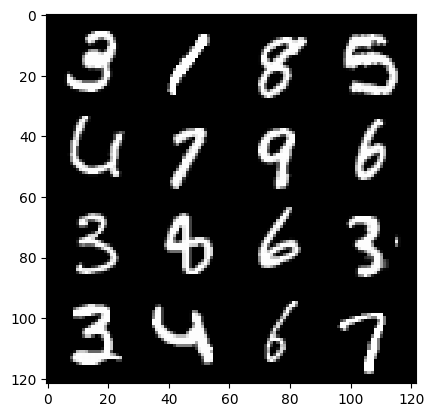

 65%|██████▍   | 303/469 [00:05<00:03, 43.66it/s]

371: step 174300 / Gen loss: 1.8111227790514641 / disc_loss: 0.3342395607630409


 28%|██▊       | 132/469 [00:02<00:04, 71.36it/s]

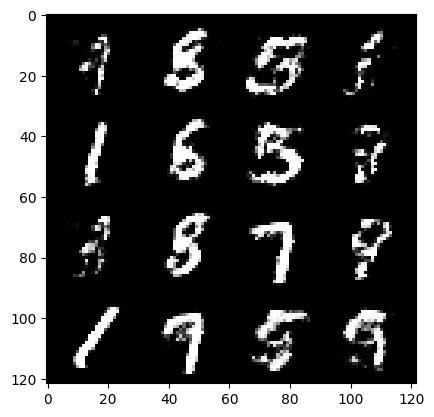

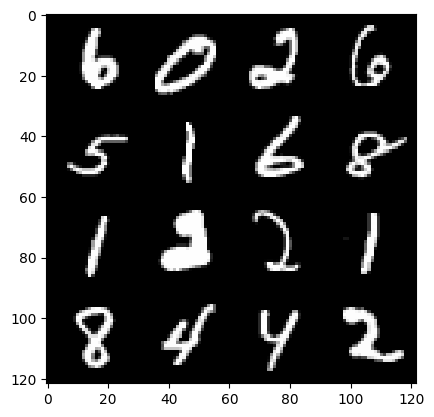

 30%|██▉       | 140/469 [00:02<00:08, 40.89it/s]

372: step 174600 / Gen loss: 1.7151882115999846 / disc_loss: 0.34117692848046594


 92%|█████████▏| 430/469 [00:06<00:00, 73.41it/s]

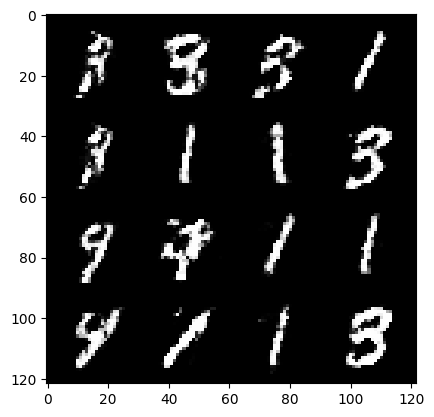

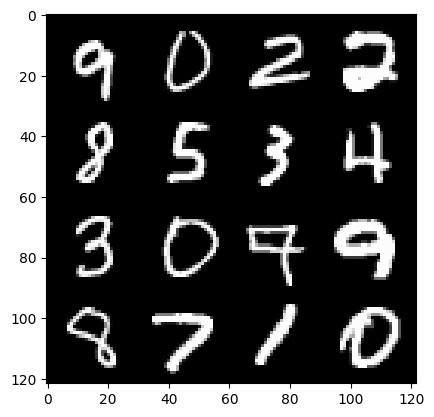

 93%|█████████▎| 438/469 [00:07<00:00, 42.37it/s]

372: step 174900 / Gen loss: 1.7070503369967152 / disc_loss: 0.345604290266832


 55%|█████▌    | 258/469 [00:03<00:03, 65.36it/s]

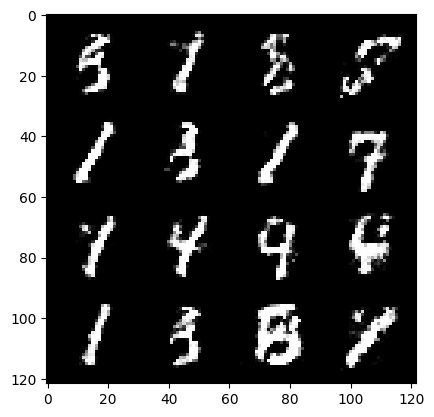

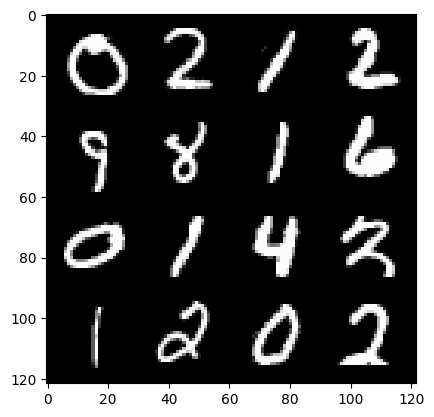

 58%|█████▊    | 272/469 [00:04<00:03, 51.11it/s]

373: step 175200 / Gen loss: 1.7639201629161836 / disc_loss: 0.345817370712757


 20%|█▉        | 92/469 [00:01<00:05, 72.20it/s]

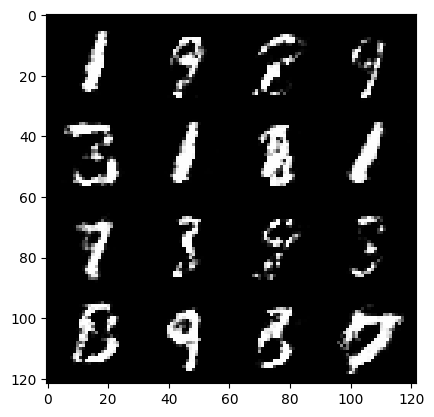

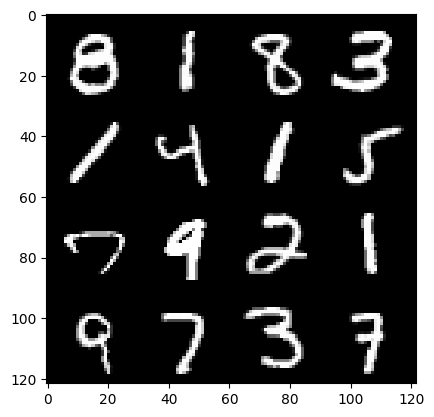

 21%|██▏       | 100/469 [00:01<00:07, 47.16it/s]

374: step 175500 / Gen loss: 1.7212261776129407 / disc_loss: 0.34775063574314097


 84%|████████▍ | 394/469 [00:06<00:01, 64.97it/s]

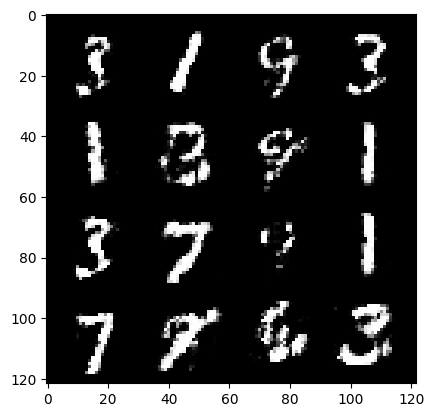

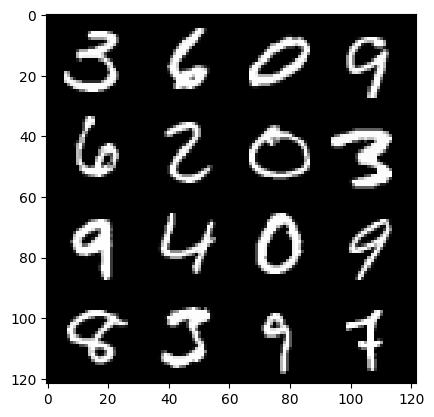

 86%|████████▌ | 401/469 [00:06<00:01, 41.53it/s]

374: step 175800 / Gen loss: 1.699385815064111 / disc_loss: 0.3365844040115674


 47%|████▋     | 220/469 [00:03<00:03, 69.23it/s]

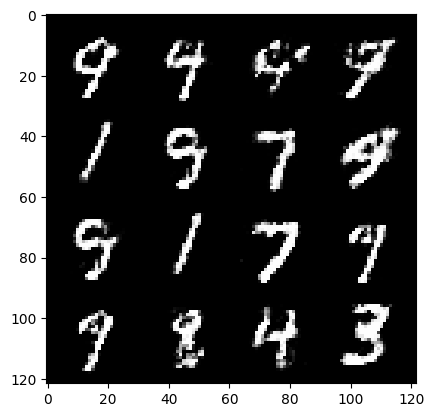

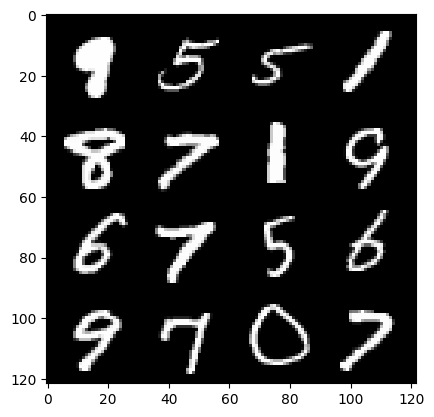

 50%|████▉     | 233/469 [00:03<00:05, 44.69it/s]

375: step 176100 / Gen loss: 1.6934604207674664 / disc_loss: 0.3501181532939271


 12%|█▏        | 55/469 [00:00<00:06, 62.44it/s]

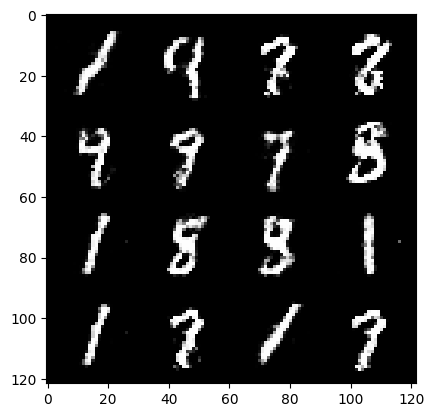

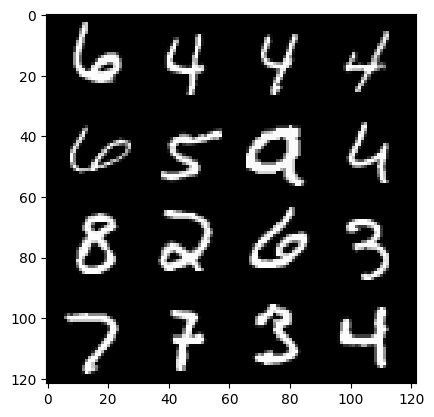

 13%|█▎        | 62/469 [00:01<00:09, 42.52it/s]

376: step 176400 / Gen loss: 1.6531315306822456 / disc_loss: 0.34748295366764076


 74%|███████▍  | 349/469 [00:05<00:01, 67.95it/s]

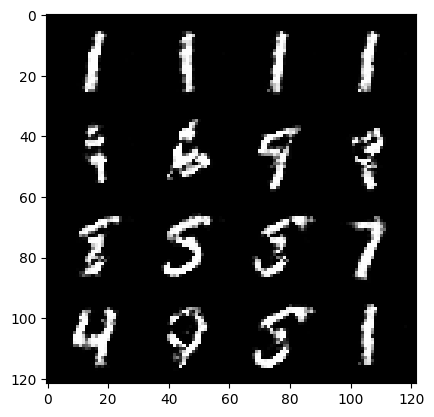

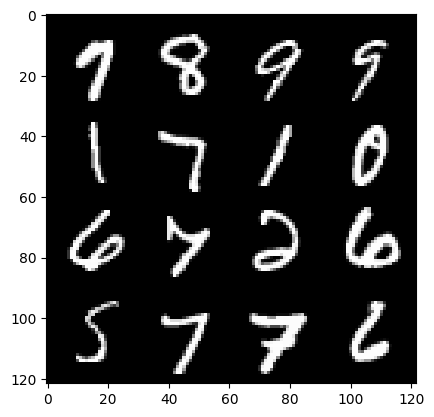

 77%|███████▋  | 363/469 [00:05<00:02, 43.90it/s]

376: step 176700 / Gen loss: 1.6594653014341985 / disc_loss: 0.350921248892943


 40%|███▉      | 187/469 [00:02<00:03, 70.96it/s]

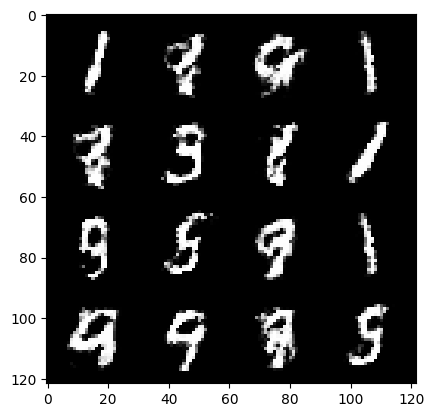

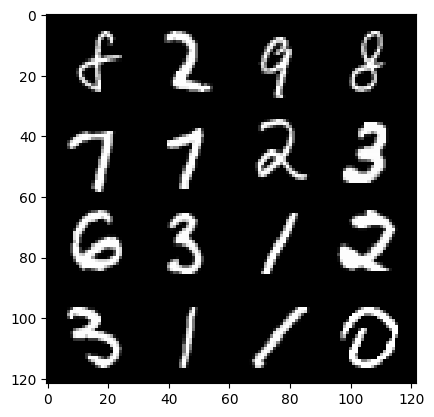

 42%|████▏     | 195/469 [00:03<00:06, 44.24it/s]

377: step 177000 / Gen loss: 1.553064291874567 / disc_loss: 0.38376174430052407


  3%|▎         | 16/469 [00:00<00:07, 62.38it/s]

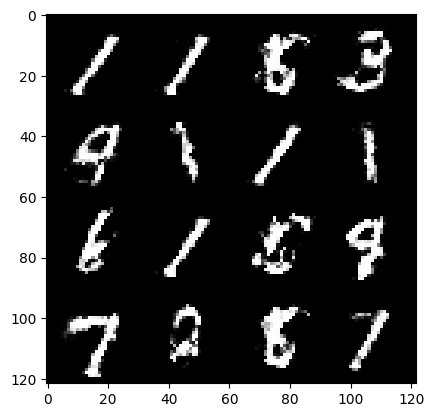

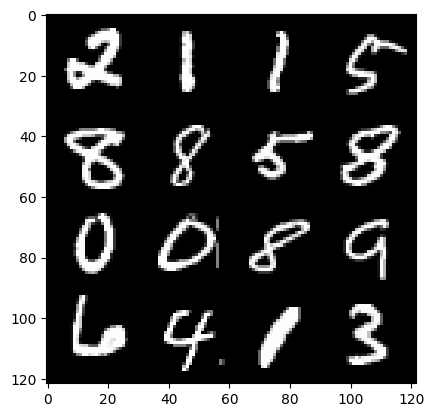

  5%|▍         | 23/469 [00:00<00:13, 32.50it/s]

378: step 177300 / Gen loss: 1.620551244417827 / disc_loss: 0.3743073294560113


 67%|██████▋   | 315/469 [00:05<00:02, 63.35it/s]

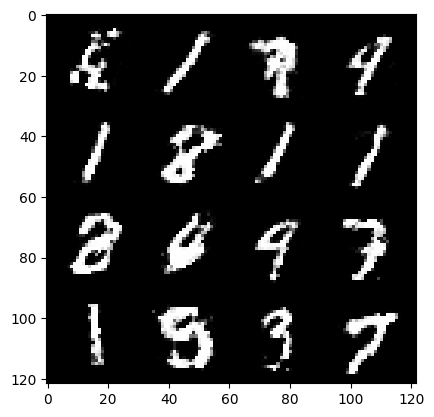

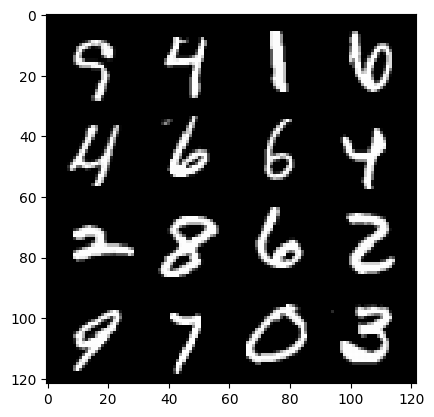

 69%|██████▊   | 322/469 [00:05<00:03, 40.04it/s]

378: step 177600 / Gen loss: 1.5701152952512099 / disc_loss: 0.3880945067604382


 32%|███▏      | 149/469 [00:02<00:04, 68.35it/s]

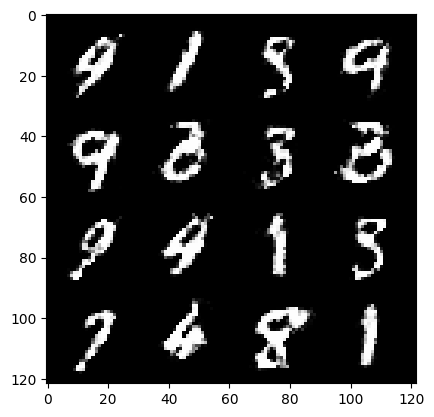

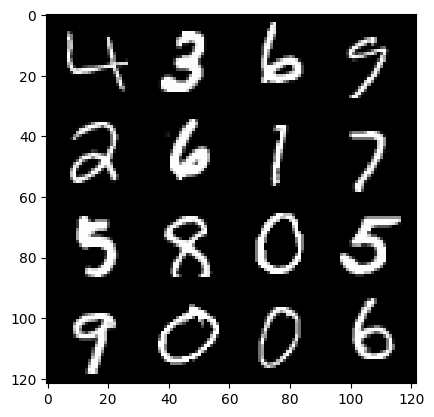

 33%|███▎      | 156/469 [00:02<00:07, 42.70it/s]

379: step 177900 / Gen loss: 1.5249367789427428 / disc_loss: 0.40360738664865475


 95%|█████████▍| 445/469 [00:06<00:00, 67.06it/s]

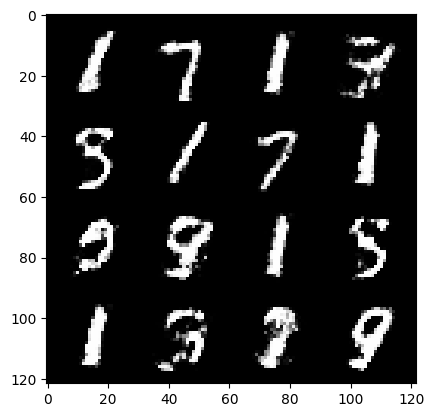

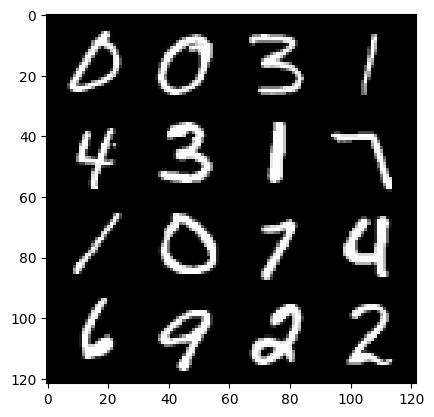

 98%|█████████▊| 458/469 [00:07<00:00, 43.65it/s]

379: step 178200 / Gen loss: 1.6463030191262564 / disc_loss: 0.3728731583555538


 58%|█████▊    | 273/469 [00:04<00:02, 70.45it/s]

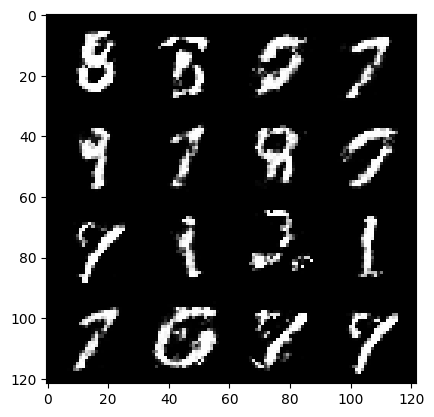

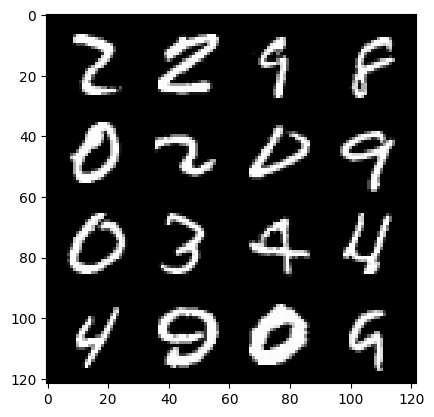

 61%|██████    | 287/469 [00:04<00:03, 48.99it/s]

380: step 178500 / Gen loss: 1.5168515400091809 / disc_loss: 0.3942278023560841


 23%|██▎       | 110/469 [00:01<00:05, 59.89it/s]

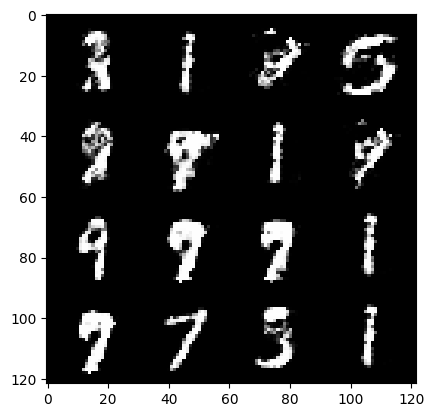

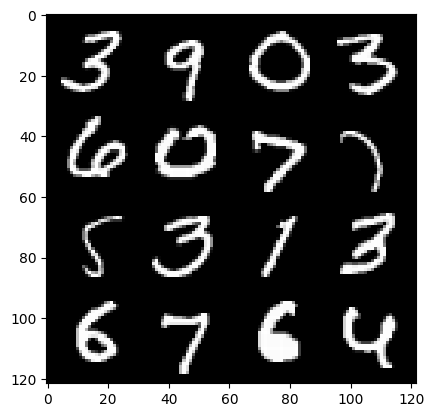

 25%|██▍       | 117/469 [00:02<00:08, 43.32it/s]

381: step 178800 / Gen loss: 1.5977012507120776 / disc_loss: 0.37128035406271653


 87%|████████▋ | 408/469 [00:06<00:00, 64.70it/s]

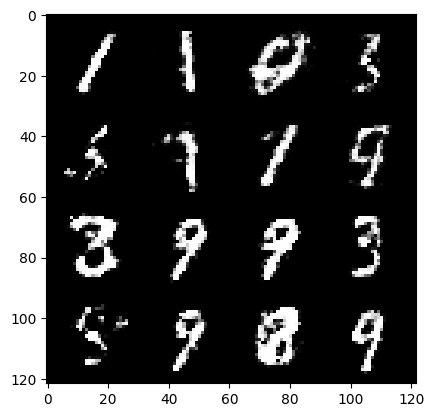

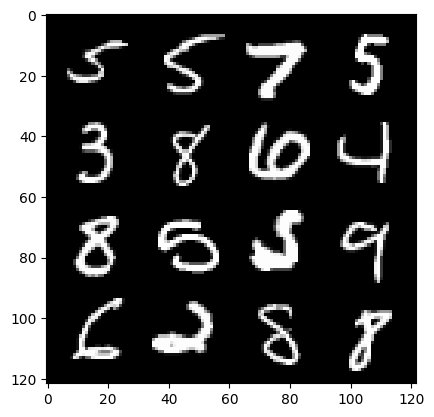

 90%|████████▉ | 421/469 [00:07<00:01, 43.33it/s]

381: step 179100 / Gen loss: 1.6387754178047187 / disc_loss: 0.3678495250145595


 51%|█████     | 239/469 [00:03<00:03, 63.65it/s]

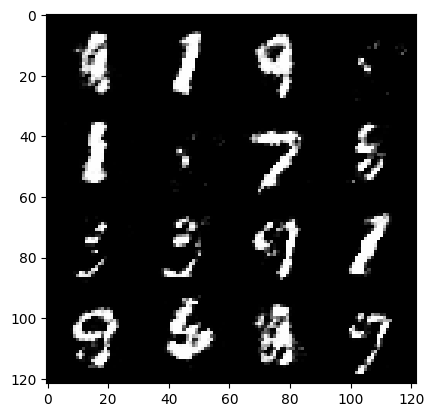

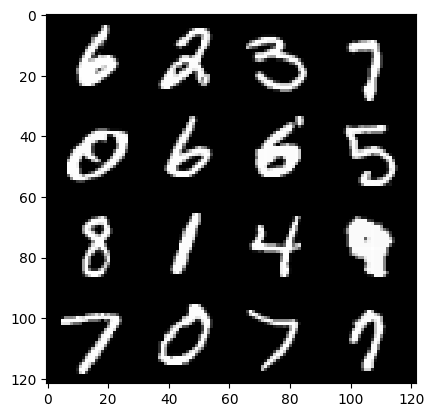

 52%|█████▏    | 246/469 [00:04<00:05, 42.20it/s]

382: step 179400 / Gen loss: 1.768752394517264 / disc_loss: 0.35528373907009775


 15%|█▍        | 70/469 [00:01<00:06, 59.51it/s]

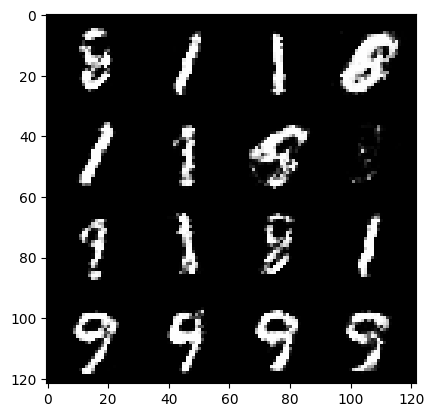

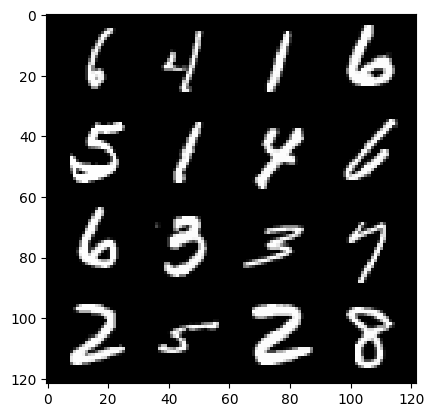

 17%|█▋        | 81/469 [00:01<00:11, 35.05it/s]

383: step 179700 / Gen loss: 1.7668389765421568 / disc_loss: 0.32795098756750457


 79%|███████▉  | 371/469 [00:06<00:01, 69.08it/s]

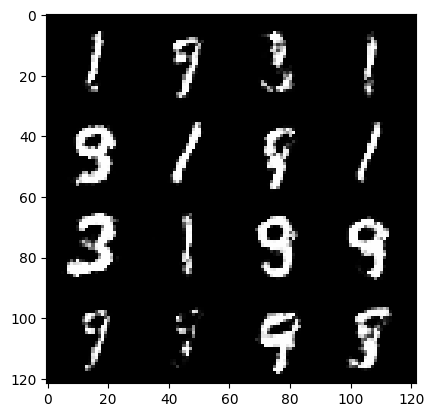

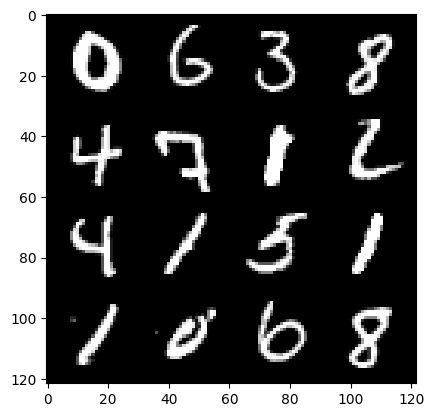

 81%|████████  | 378/469 [00:06<00:01, 45.65it/s]

383: step 180000 / Gen loss: 1.626316102345785 / disc_loss: 0.3524985850850743


 42%|████▏     | 198/469 [00:03<00:03, 70.48it/s]

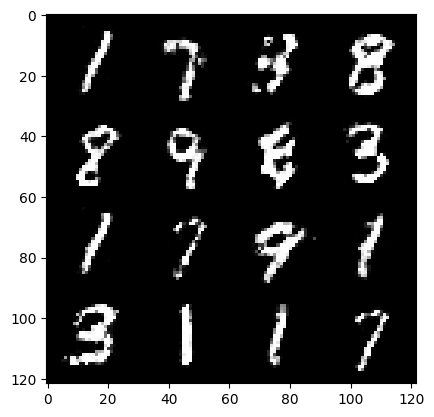

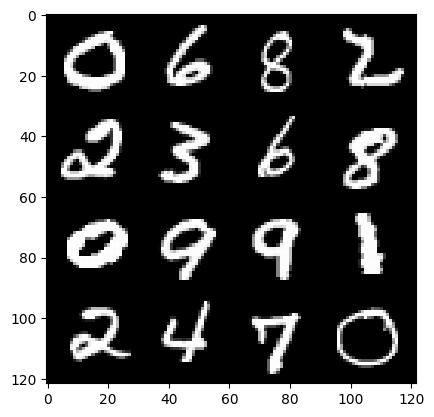

 45%|████▌     | 212/469 [00:03<00:05, 43.83it/s]

384: step 180300 / Gen loss: 1.6880932374795277 / disc_loss: 0.3392860572536786


  7%|▋         | 32/469 [00:00<00:07, 60.42it/s]

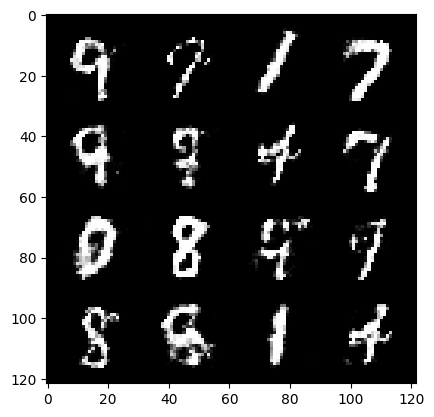

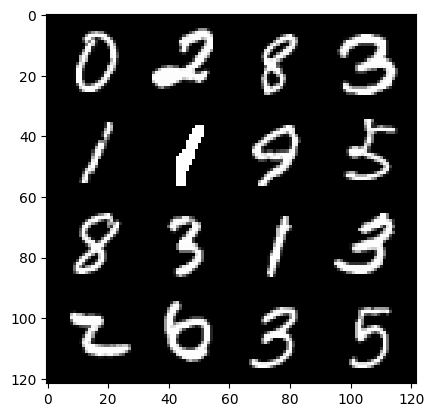

  9%|▉         | 44/469 [00:00<00:10, 41.35it/s]

385: step 180600 / Gen loss: 1.6387516442934686 / disc_loss: 0.35820123602946613


 71%|███████   | 331/469 [00:05<00:02, 65.89it/s]

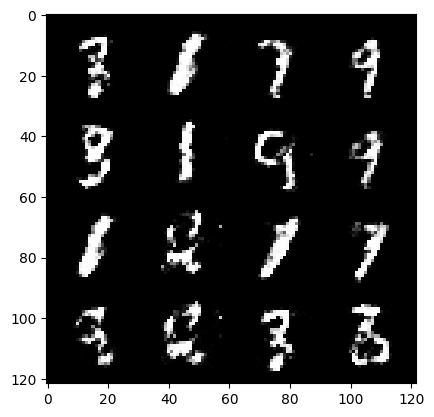

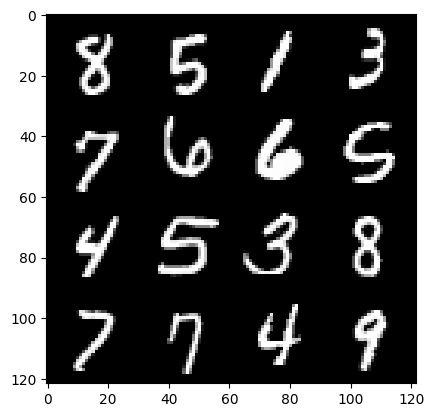

 73%|███████▎  | 344/469 [00:05<00:02, 47.72it/s]

385: step 180900 / Gen loss: 1.72581858197848 / disc_loss: 0.34563207358121883


 34%|███▍      | 161/469 [00:02<00:04, 74.11it/s]

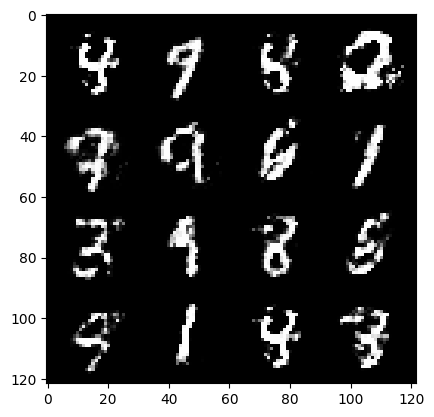

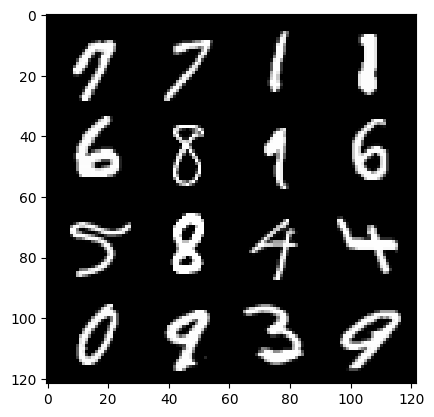

 37%|███▋      | 175/469 [00:02<00:06, 43.25it/s]

386: step 181200 / Gen loss: 1.8314879389603937 / disc_loss: 0.32961366921663277


 98%|█████████▊| 459/469 [00:07<00:00, 70.11it/s]

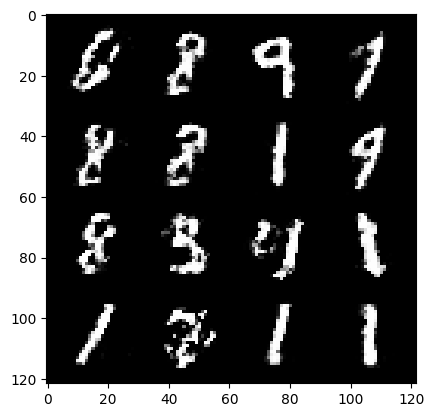

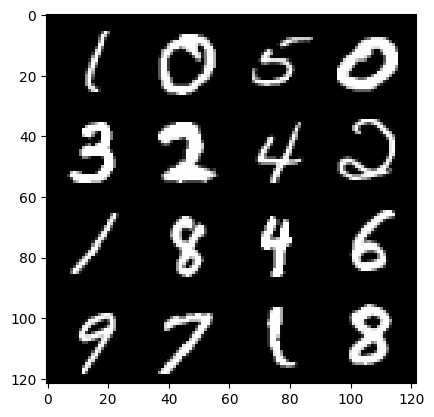

100%|██████████| 469/469 [00:07<00:00, 60.96it/s]


386: step 181500 / Gen loss: 1.730216713349024 / disc_loss: 0.37096137185891476


 63%|██████▎   | 296/469 [00:05<00:02, 67.96it/s]

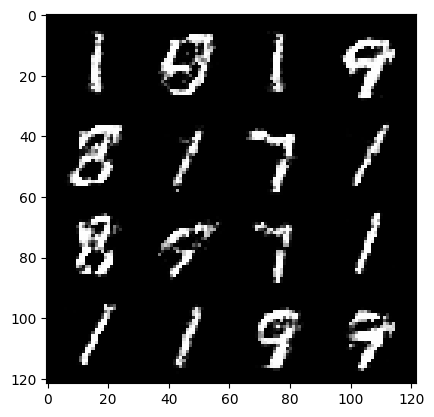

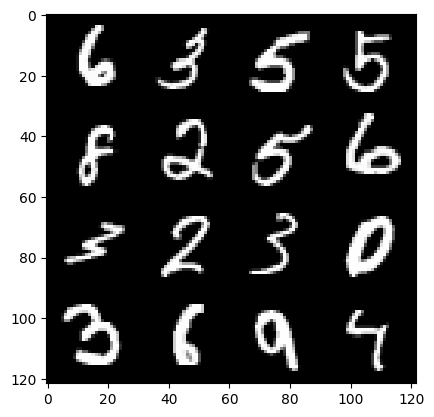

 65%|██████▍   | 303/469 [00:05<00:03, 43.63it/s]

387: step 181800 / Gen loss: 1.6648056081930802 / disc_loss: 0.37157364288965866


 27%|██▋       | 126/469 [00:01<00:05, 64.51it/s]

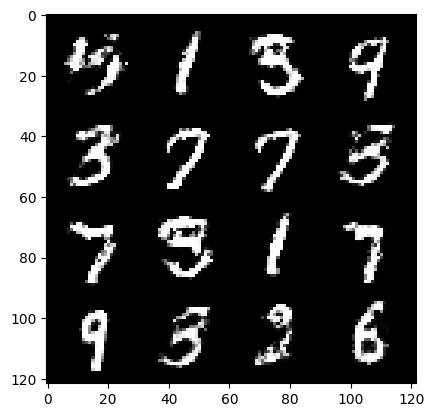

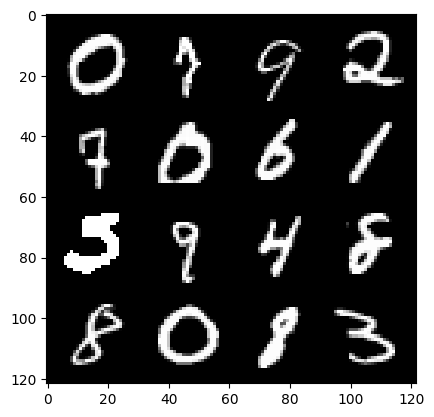

 28%|██▊       | 133/469 [00:02<00:07, 42.10it/s]

388: step 182100 / Gen loss: 1.729571288824082 / disc_loss: 0.35773738215366996


 91%|█████████ | 427/469 [00:07<00:00, 61.74it/s]

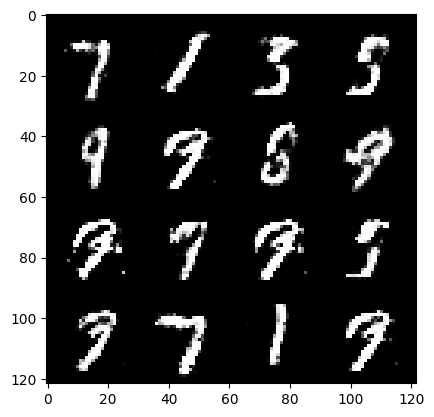

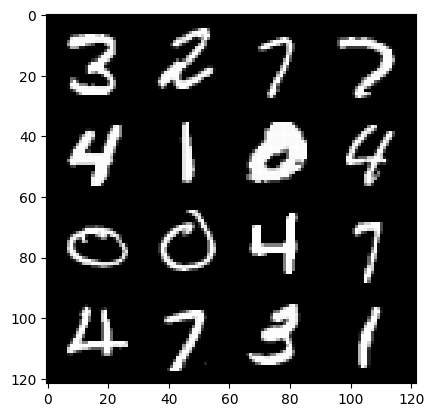

 93%|█████████▎| 434/469 [00:07<00:00, 40.34it/s]

388: step 182400 / Gen loss: 1.7166717084248873 / disc_loss: 0.3537659363945326


 55%|█████▌    | 259/469 [00:03<00:02, 70.81it/s]

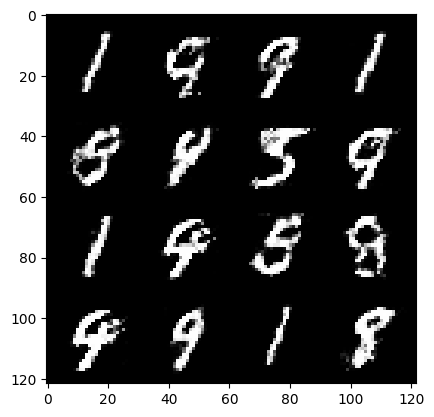

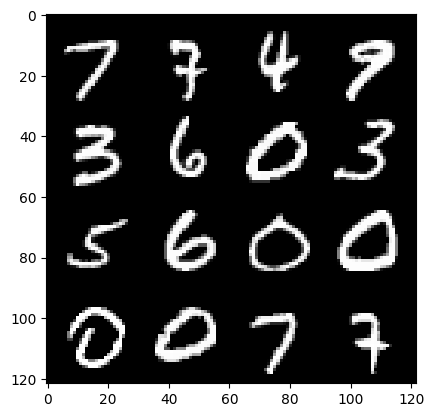

 57%|█████▋    | 267/469 [00:04<00:04, 42.94it/s]

389: step 182700 / Gen loss: 1.6730074902375538 / disc_loss: 0.3622196558117866


 18%|█▊        | 85/469 [00:01<00:05, 64.93it/s]

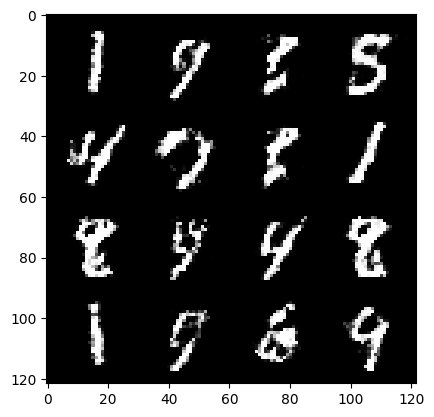

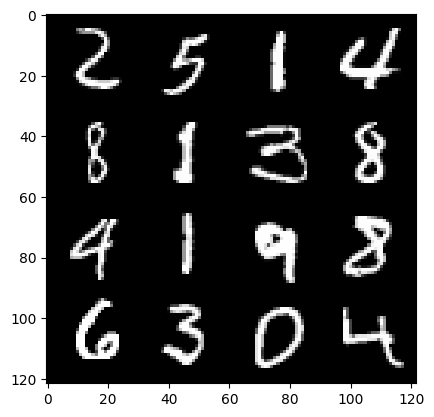

 21%|██        | 98/469 [00:01<00:08, 42.50it/s]

390: step 183000 / Gen loss: 1.6641671367486317 / disc_loss: 0.3543855965137479


 83%|████████▎ | 388/469 [00:06<00:01, 67.71it/s]

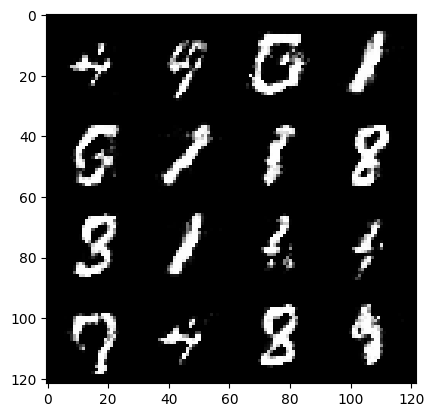

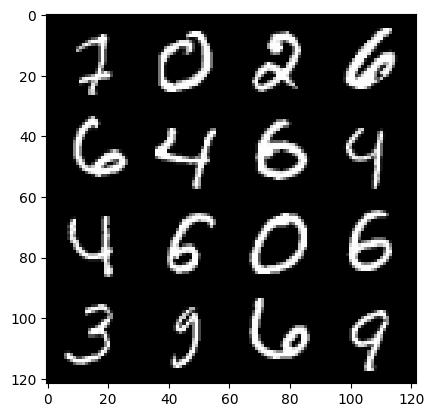

 84%|████████▍ | 395/469 [00:06<00:01, 43.22it/s]

390: step 183300 / Gen loss: 1.6345246048768358 / disc_loss: 0.35537701080242795


 47%|████▋     | 219/469 [00:03<00:03, 67.70it/s]

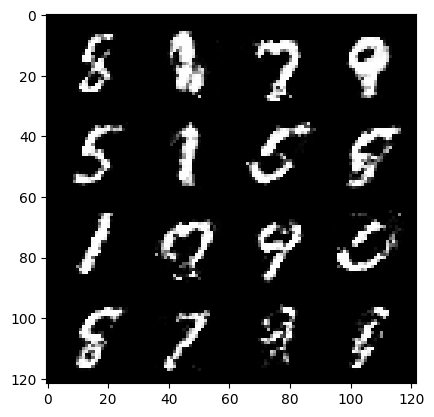

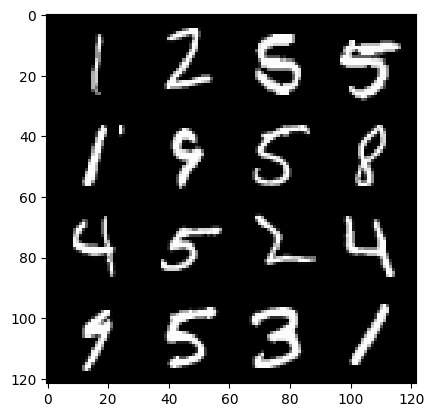

 48%|████▊     | 226/469 [00:03<00:05, 45.17it/s]

391: step 183600 / Gen loss: 1.7618518074353537 / disc_loss: 0.3366397971908248


 10%|▉         | 45/469 [00:00<00:06, 67.57it/s]

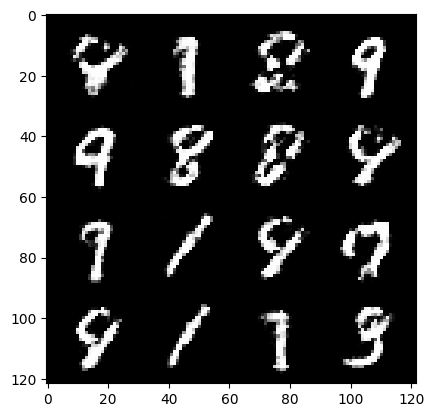

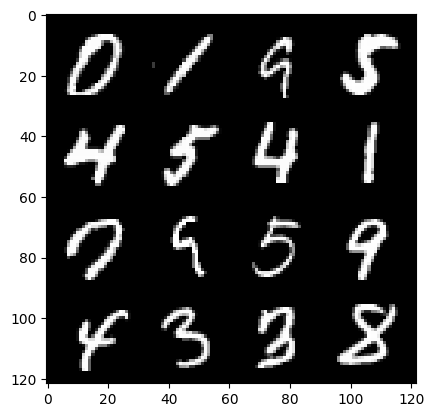

 13%|█▎        | 59/469 [00:01<00:09, 41.08it/s]

392: step 183900 / Gen loss: 1.6853727491696673 / disc_loss: 0.36630008320013696


 74%|███████▍  | 346/469 [00:05<00:01, 66.42it/s]

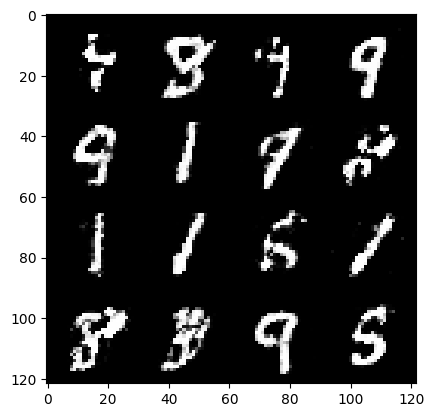

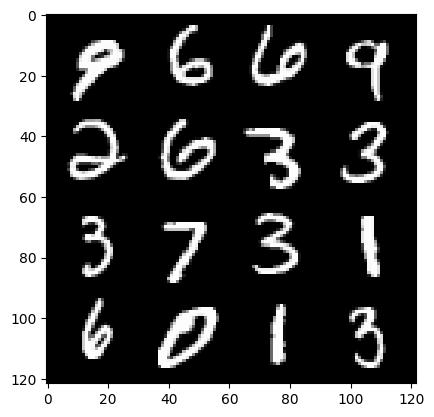

 77%|███████▋  | 359/469 [00:06<00:02, 42.04it/s]

392: step 184200 / Gen loss: 1.7248115086555484 / disc_loss: 0.36853307346502956


 38%|███▊      | 178/469 [00:02<00:04, 71.09it/s]

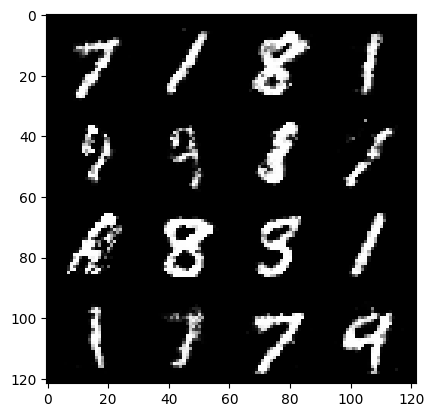

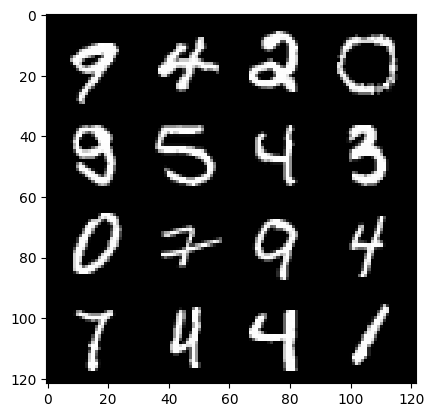

 41%|████      | 192/469 [00:03<00:06, 45.15it/s]

393: step 184500 / Gen loss: 1.6826213061809536 / disc_loss: 0.36587192147970193


  3%|▎         | 14/469 [00:00<00:07, 62.83it/s]

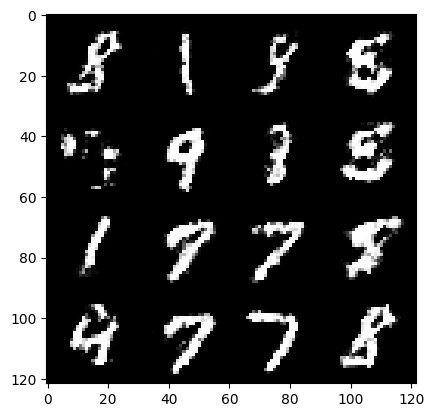

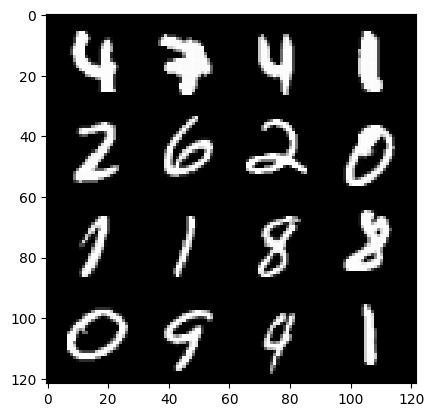

  4%|▍         | 21/469 [00:00<00:17, 25.72it/s]

394: step 184800 / Gen loss: 1.6378063432375598 / disc_loss: 0.3627487255136171


 66%|██████▌   | 308/469 [00:05<00:02, 65.11it/s]

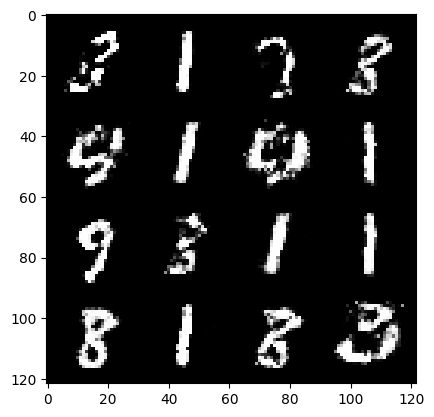

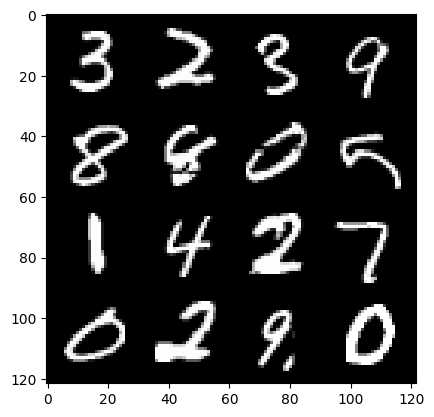

 68%|██████▊   | 321/469 [00:05<00:03, 43.07it/s]

394: step 185100 / Gen loss: 1.683765255610148 / disc_loss: 0.35315356661876046


 30%|██▉       | 139/469 [00:02<00:04, 70.42it/s]

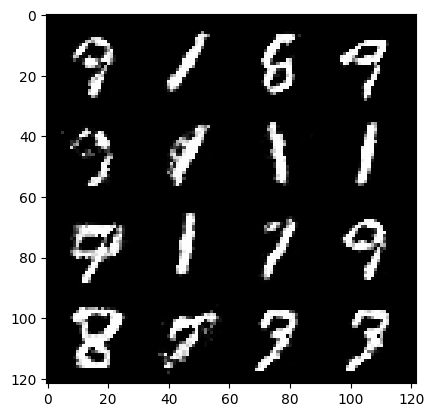

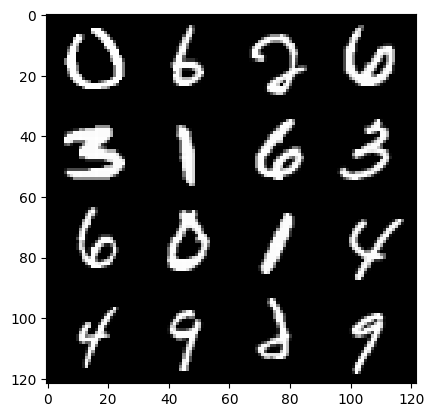

 33%|███▎      | 153/469 [00:02<00:07, 44.81it/s]

395: step 185400 / Gen loss: 1.72790068268776 / disc_loss: 0.3450261711577575


 94%|█████████▎| 439/469 [00:06<00:00, 72.17it/s]

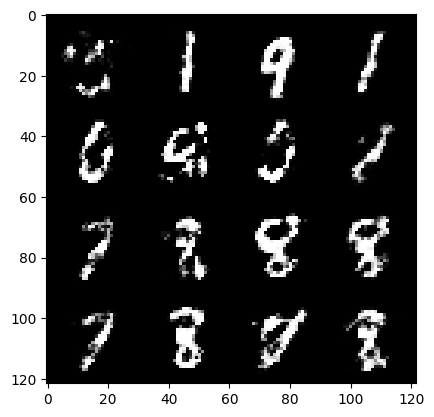

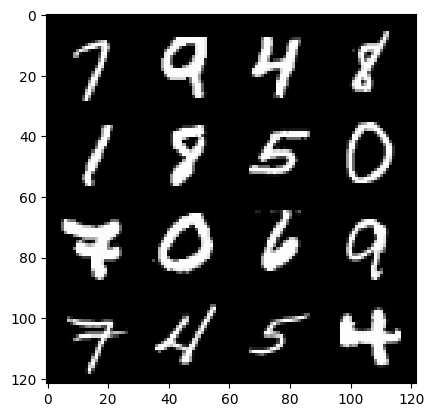

 97%|█████████▋| 453/469 [00:07<00:00, 48.04it/s]

395: step 185700 / Gen loss: 1.7441736817359919 / disc_loss: 0.3469695740938187


 57%|█████▋    | 269/469 [00:04<00:02, 72.21it/s]

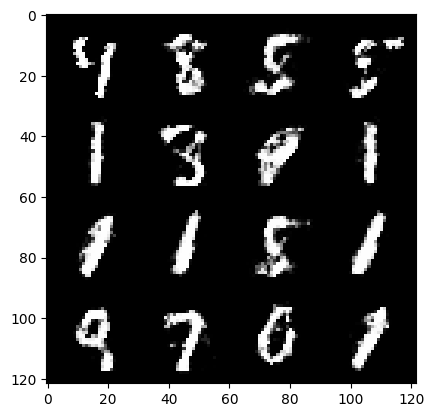

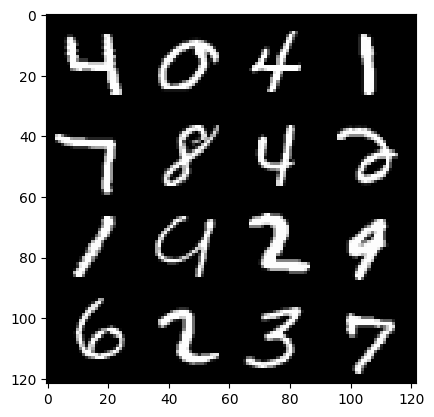

 60%|██████    | 283/469 [00:04<00:04, 46.09it/s]

396: step 186000 / Gen loss: 1.7101624087492624 / disc_loss: 0.3478947080175078


 23%|██▎       | 107/469 [00:01<00:05, 65.55it/s]

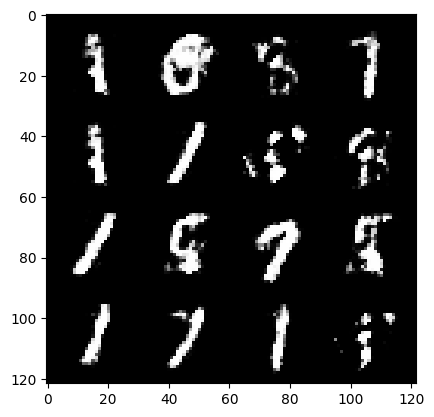

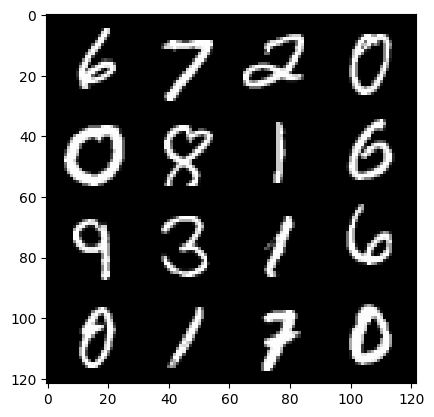

 24%|██▍       | 114/469 [00:01<00:08, 41.86it/s]

397: step 186300 / Gen loss: 1.7401647694905582 / disc_loss: 0.3428774814804395


 86%|████████▋ | 405/469 [00:06<00:00, 67.02it/s]

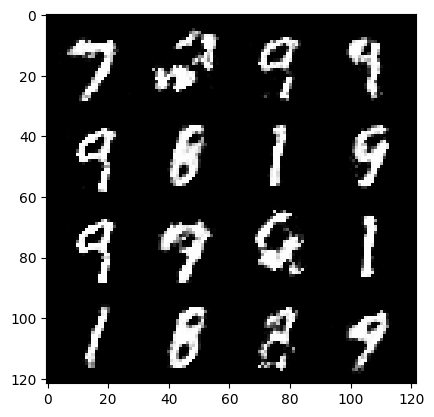

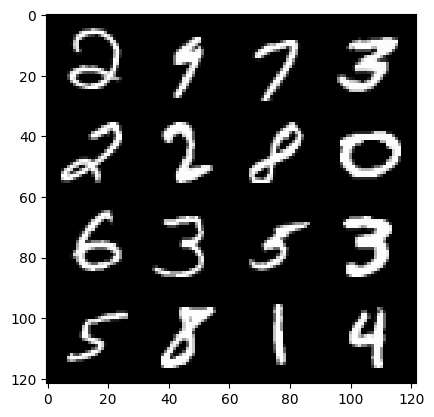

 88%|████████▊ | 412/469 [00:06<00:01, 43.87it/s]

397: step 186600 / Gen loss: 1.700644467274348 / disc_loss: 0.34696046372254696


 50%|█████     | 236/469 [00:03<00:03, 73.77it/s]

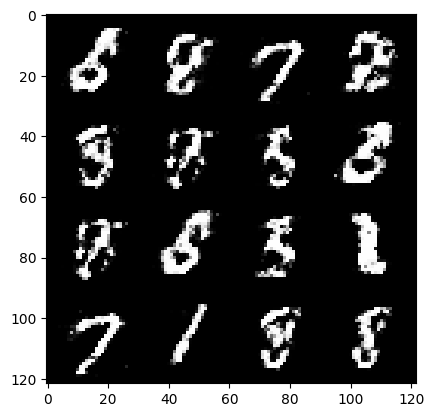

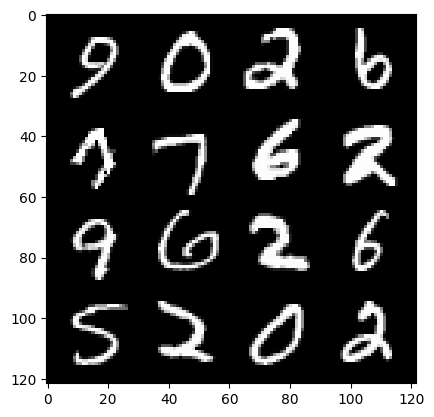

 52%|█████▏    | 244/469 [00:03<00:04, 46.09it/s]

398: step 186900 / Gen loss: 1.7486358968416849 / disc_loss: 0.34966819415489797


 14%|█▍        | 67/469 [00:01<00:06, 59.48it/s]

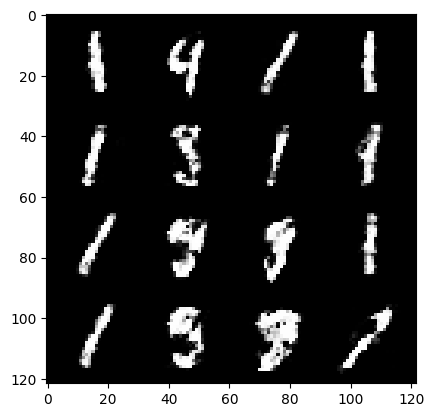

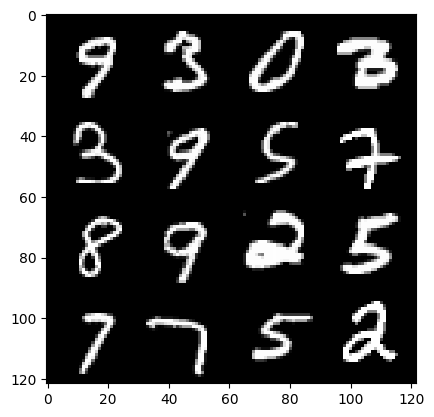

 17%|█▋        | 79/469 [00:01<00:09, 39.18it/s]

399: step 187200 / Gen loss: 1.6626167746384937 / disc_loss: 0.3571988683938979


 78%|███████▊  | 367/469 [00:05<00:01, 67.89it/s]

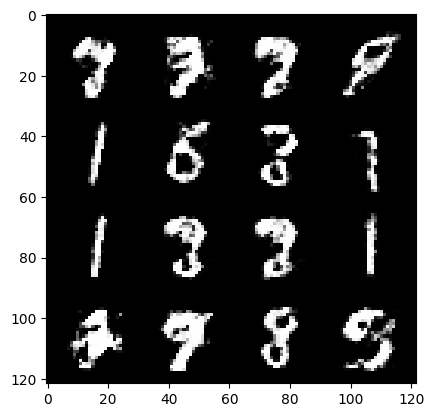

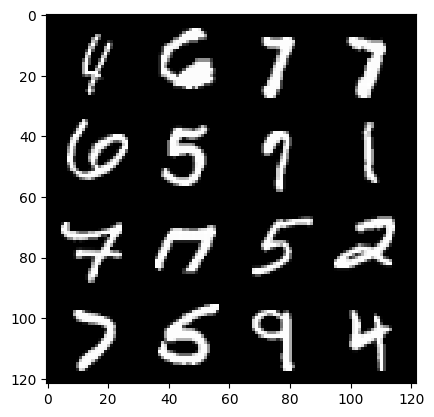

 80%|███████▉  | 374/469 [00:06<00:02, 42.59it/s]

399: step 187500 / Gen loss: 1.639562813440958 / disc_loss: 0.3549764188130698


 42%|████▏     | 195/469 [00:02<00:03, 74.25it/s]

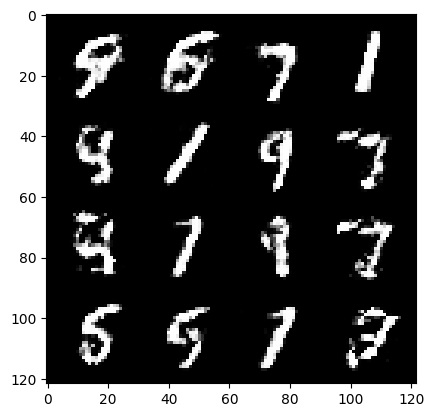

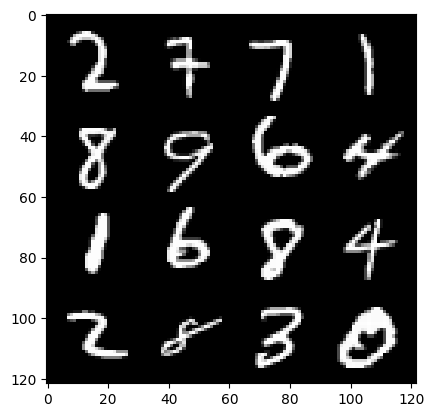

 45%|████▍     | 210/469 [00:03<00:05, 48.78it/s]

400: step 187800 / Gen loss: 1.653369125127792 / disc_loss: 0.3690222970644633


  7%|▋         | 31/469 [00:00<00:06, 72.76it/s]

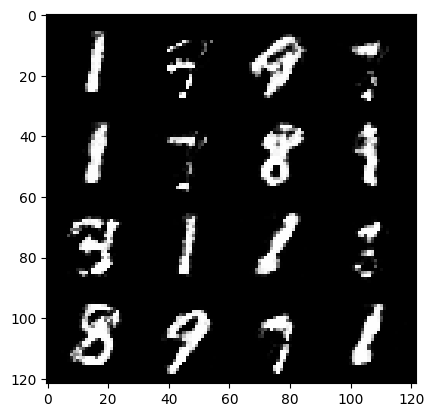

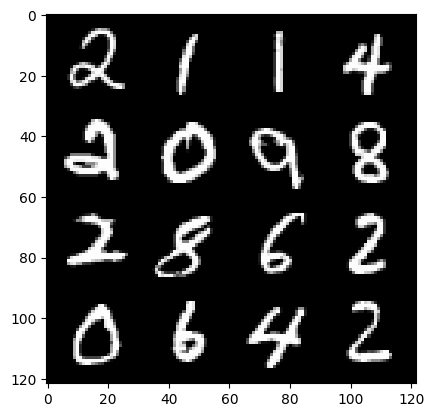

  8%|▊         | 39/469 [00:00<00:10, 41.79it/s]

401: step 188100 / Gen loss: 1.8113074962298081 / disc_loss: 0.3448303005099297


 69%|██████▉   | 324/469 [00:05<00:02, 72.32it/s]

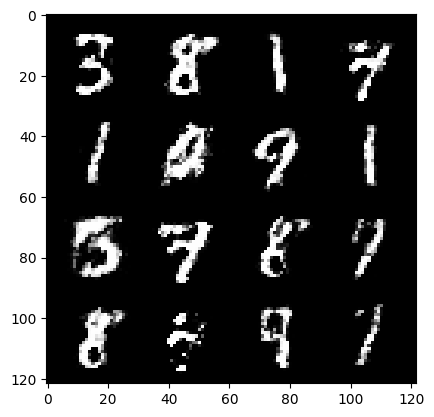

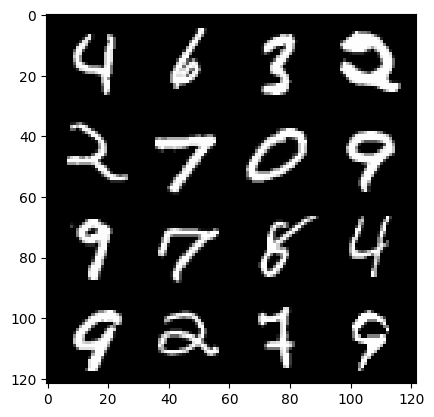

 72%|███████▏  | 338/469 [00:05<00:02, 45.26it/s]

401: step 188400 / Gen loss: 1.6799774865309398 / disc_loss: 0.3469635581970218


 34%|███▍      | 161/469 [00:02<00:04, 66.52it/s]

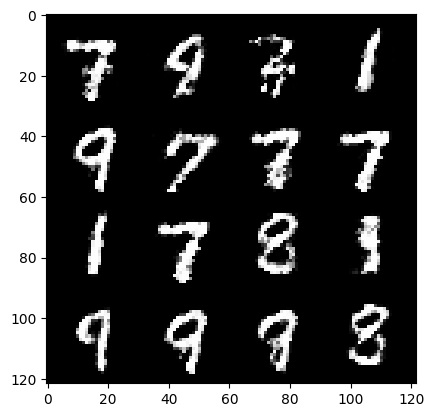

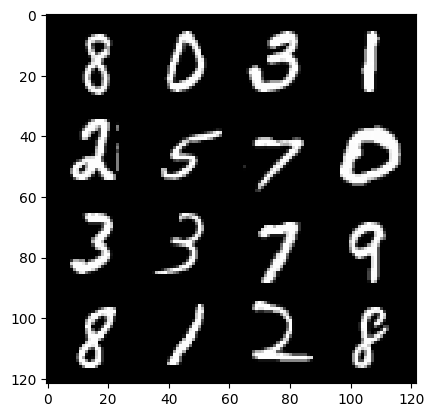

 36%|███▌      | 168/469 [00:02<00:06, 43.05it/s]

402: step 188700 / Gen loss: 1.7092625765005747 / disc_loss: 0.3456710356473921


 97%|█████████▋| 456/469 [00:07<00:00, 67.85it/s]

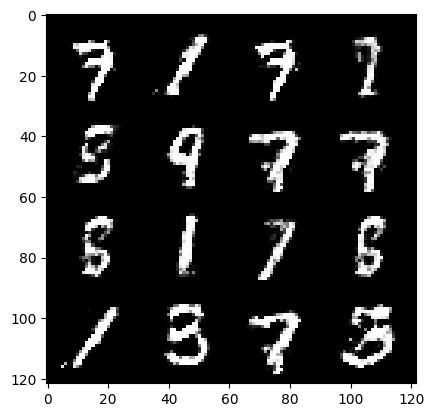

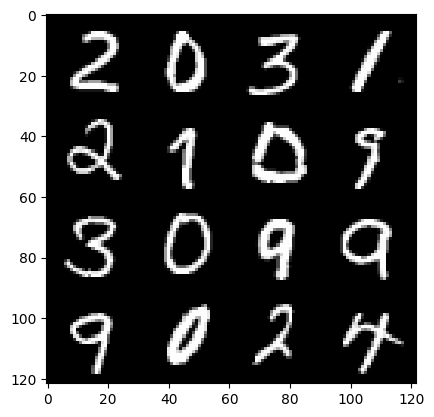

100%|██████████| 469/469 [00:07<00:00, 62.61it/s]


402: step 189000 / Gen loss: 1.75575461745262 / disc_loss: 0.3368400418758392


 61%|██████▏   | 288/469 [00:04<00:02, 68.98it/s]

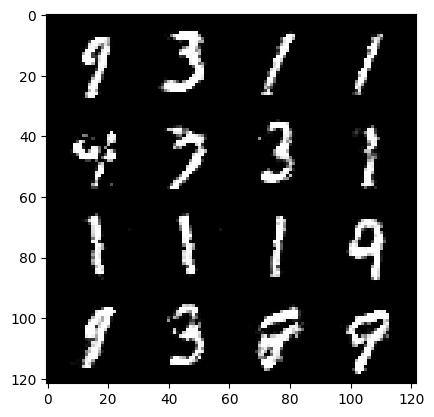

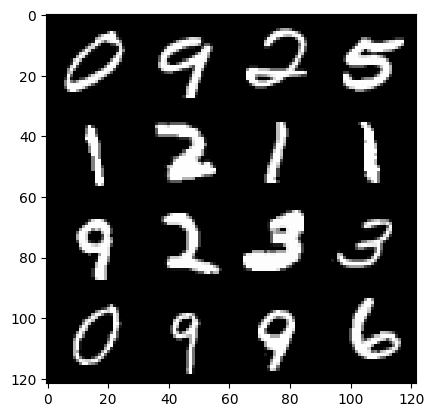

 64%|██████▍   | 301/469 [00:04<00:03, 43.95it/s]

403: step 189300 / Gen loss: 1.7409042274951931 / disc_loss: 0.3508272123336793


 25%|██▍       | 117/469 [00:01<00:05, 67.83it/s]

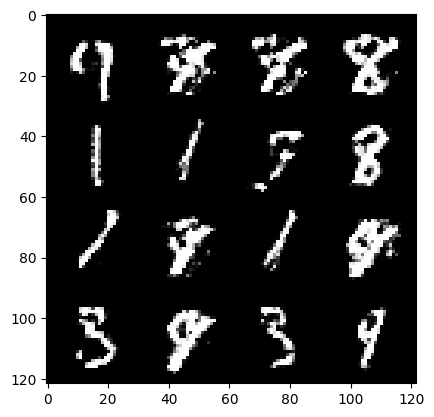

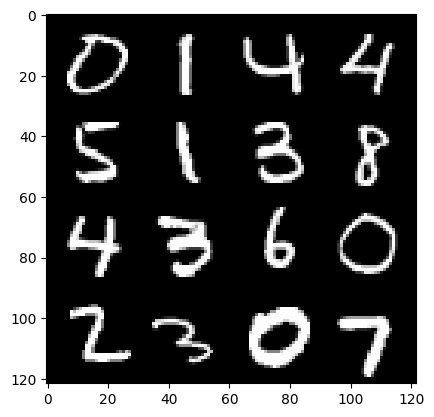

 28%|██▊       | 131/469 [00:02<00:07, 43.73it/s]

404: step 189600 / Gen loss: 1.716314343214036 / disc_loss: 0.3556222314635911


 90%|█████████ | 423/469 [00:06<00:00, 62.48it/s]

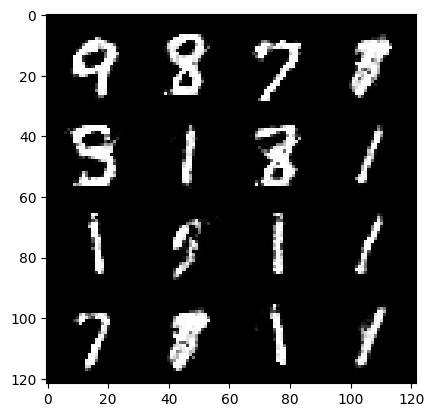

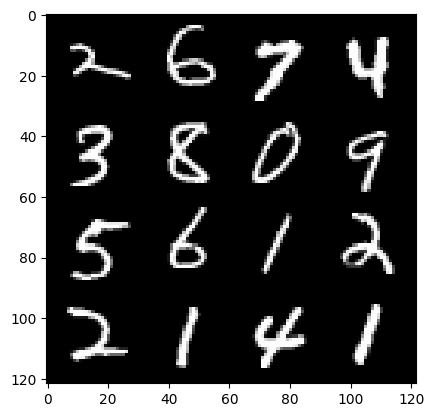

 92%|█████████▏| 430/469 [00:07<00:01, 38.48it/s]

404: step 189900 / Gen loss: 1.7642497372627262 / disc_loss: 0.35451437513033507


 53%|█████▎    | 248/469 [00:03<00:03, 71.28it/s]

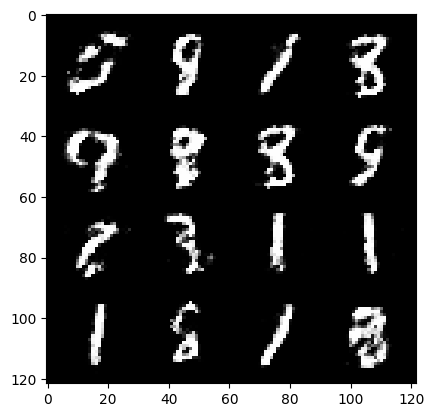

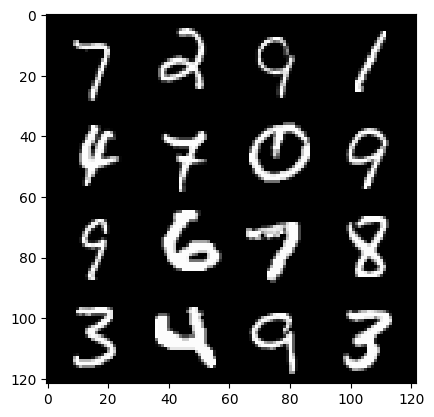

 56%|█████▌    | 262/469 [00:03<00:04, 48.72it/s]

405: step 190200 / Gen loss: 1.7063834484418223 / disc_loss: 0.34950969576835655


 17%|█▋        | 79/469 [00:01<00:05, 73.66it/s]

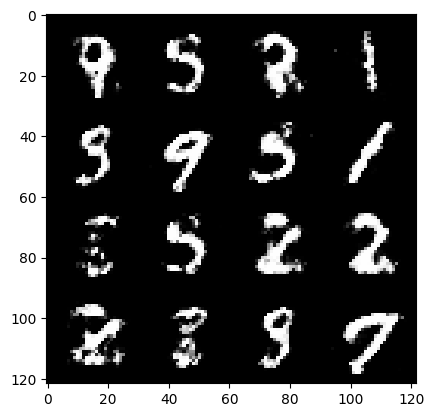

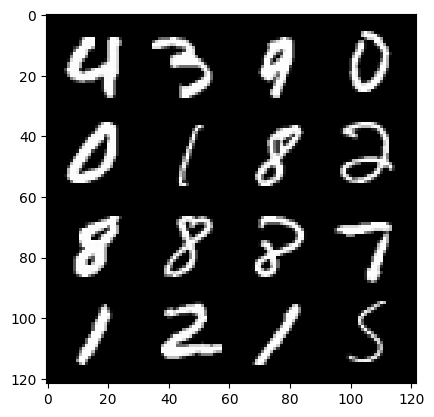

 20%|█▉        | 93/469 [00:01<00:09, 40.19it/s]

406: step 190500 / Gen loss: 1.6963879394531258 / disc_loss: 0.35280323624610893


 81%|████████  | 379/469 [00:05<00:01, 74.33it/s]

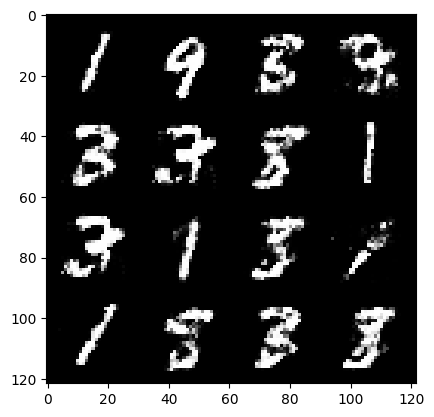

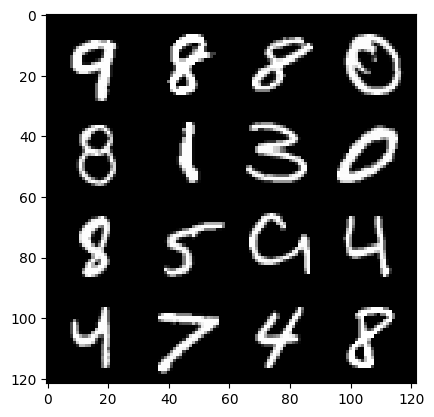

 84%|████████▍ | 393/469 [00:06<00:01, 44.77it/s]

406: step 190800 / Gen loss: 1.6588067483901974 / disc_loss: 0.37594012558460244


 46%|████▌     | 214/469 [00:03<00:03, 65.45it/s]

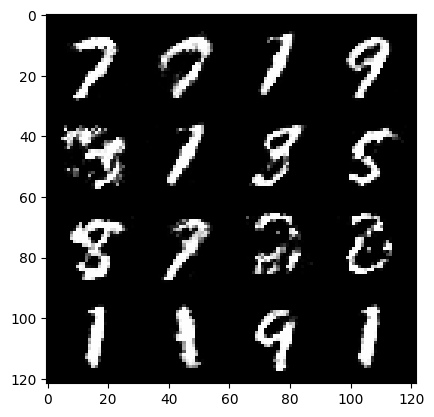

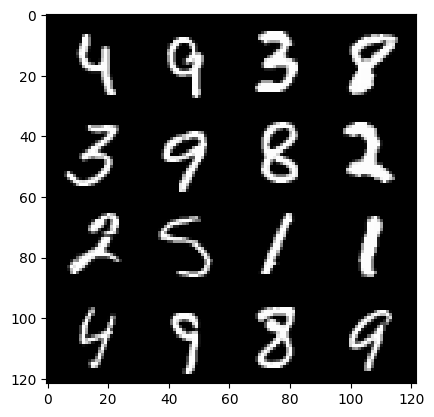

 47%|████▋     | 221/469 [00:03<00:05, 44.77it/s]

407: step 191100 / Gen loss: 1.7229861561457323 / disc_loss: 0.3548644561568899


 10%|▉         | 45/469 [00:00<00:06, 65.72it/s]

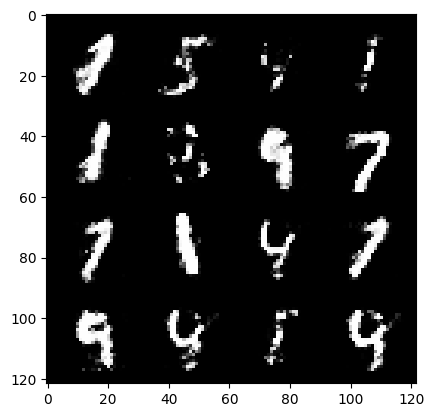

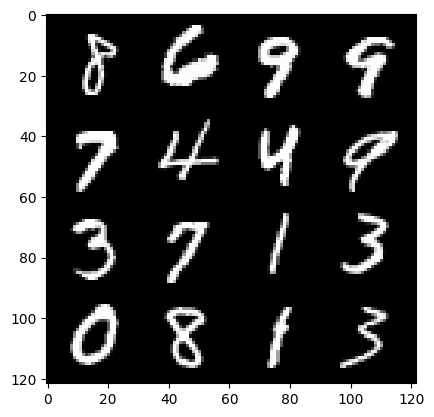

 12%|█▏        | 58/469 [00:01<00:09, 44.62it/s]

408: step 191400 / Gen loss: 1.6244245366255454 / disc_loss: 0.37815516233444246


 73%|███████▎  | 344/469 [00:05<00:01, 70.44it/s]

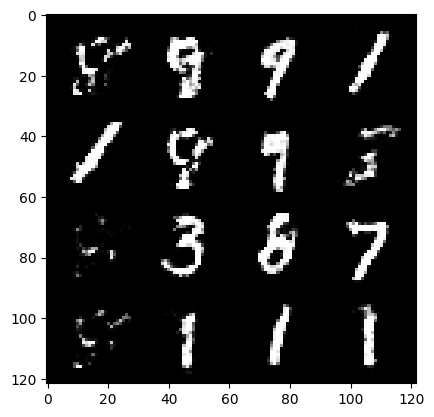

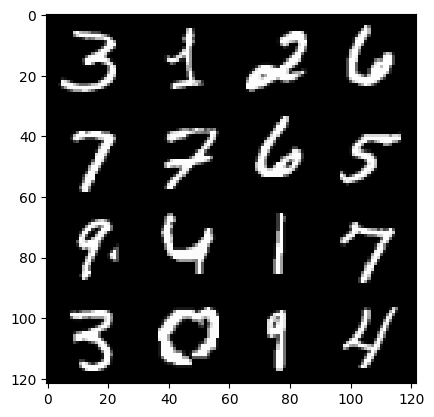

 75%|███████▌  | 352/469 [00:05<00:02, 44.98it/s]

408: step 191700 / Gen loss: 1.7006168321768447 / disc_loss: 0.3382252653936546


 37%|███▋      | 175/469 [00:02<00:04, 66.66it/s]

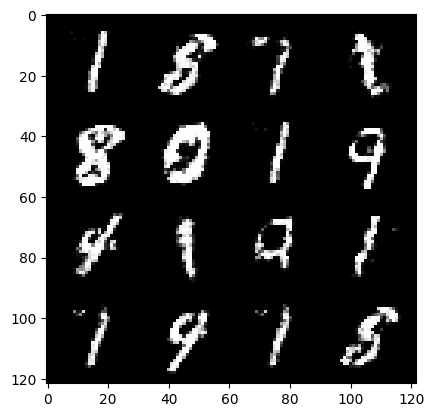

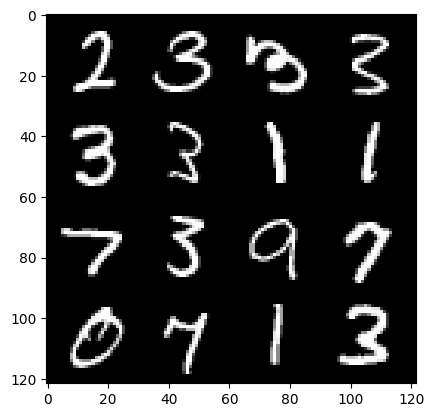

 40%|████      | 188/469 [00:03<00:06, 40.98it/s]

409: step 192000 / Gen loss: 1.67833976785342 / disc_loss: 0.351139002939065


  2%|▏         | 8/469 [00:00<00:06, 72.19it/s]

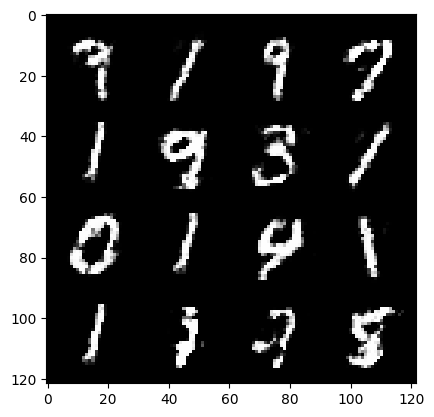

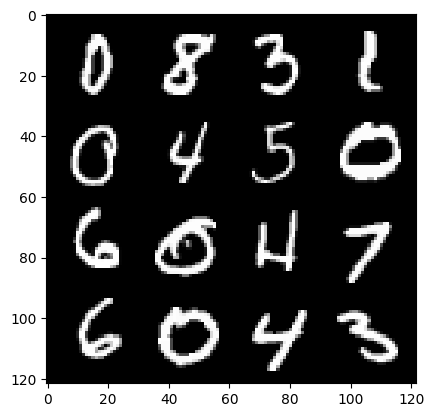

  3%|▎         | 16/469 [00:00<00:14, 30.44it/s]

410: step 192300 / Gen loss: 1.6004869409402216 / disc_loss: 0.3651659589012463


 66%|██████▌   | 308/469 [00:04<00:02, 63.49it/s]

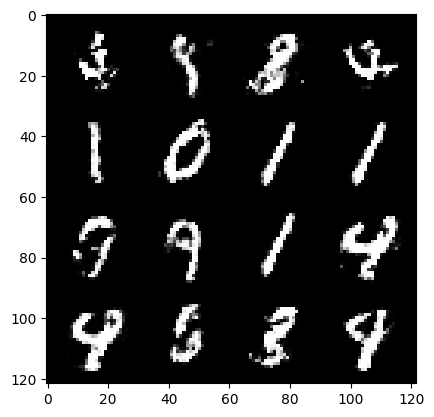

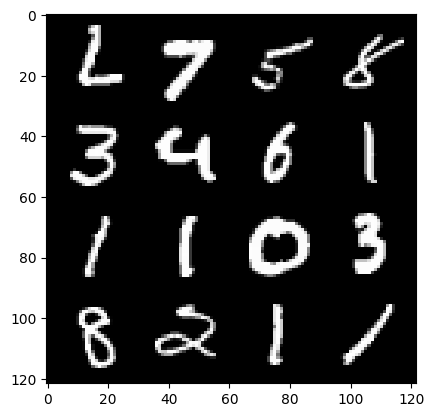

 68%|██████▊   | 321/469 [00:05<00:03, 42.30it/s]

410: step 192600 / Gen loss: 1.6194752069314313 / disc_loss: 0.3793504836161929


 30%|███       | 141/469 [00:02<00:04, 69.85it/s]

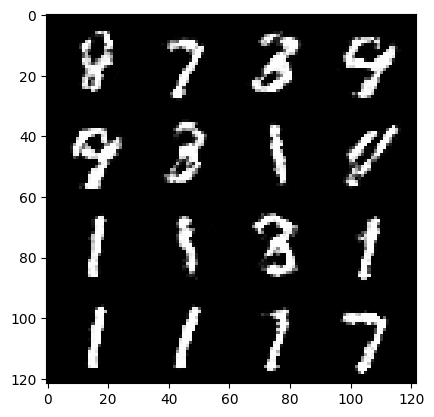

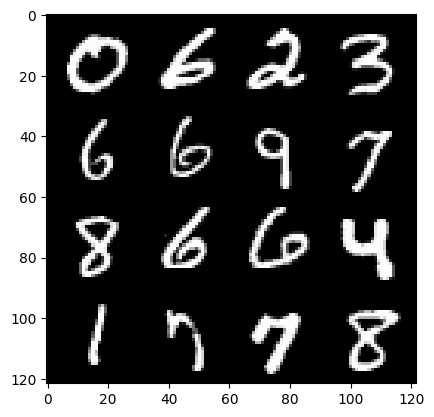

 32%|███▏      | 148/469 [00:02<00:06, 46.47it/s]

411: step 192900 / Gen loss: 1.5527819744745899 / disc_loss: 0.3967997860908505


 94%|█████████▍| 441/469 [00:06<00:00, 68.30it/s]

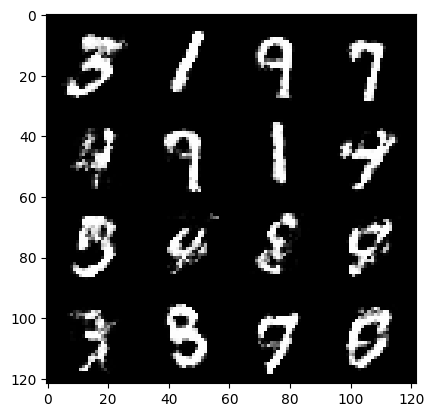

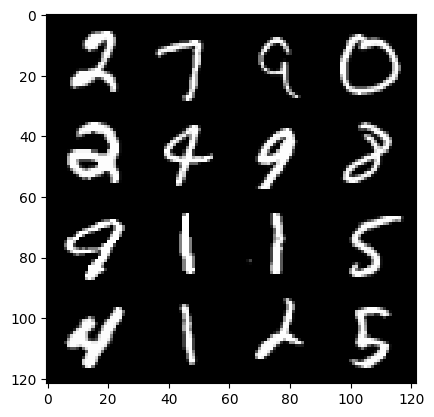

 96%|█████████▌| 448/469 [00:07<00:00, 45.22it/s]

411: step 193200 / Gen loss: 1.5968629403909038 / disc_loss: 0.3807241855065027


 58%|█████▊    | 271/469 [00:04<00:02, 72.82it/s]

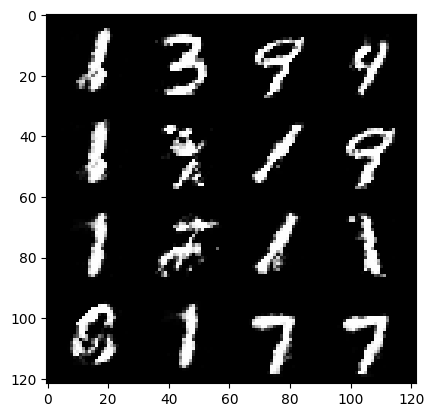

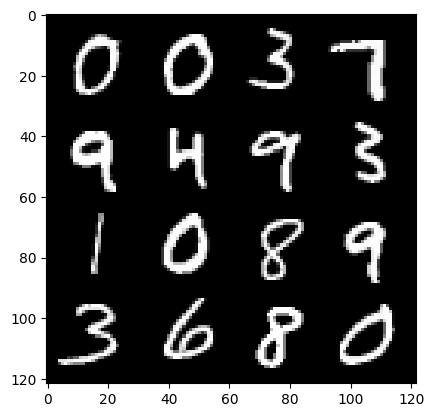

 59%|█████▉    | 279/469 [00:04<00:03, 47.77it/s]

412: step 193500 / Gen loss: 1.6909129269917804 / disc_loss: 0.3586029765009879


 21%|██▏       | 100/469 [00:01<00:05, 69.20it/s]

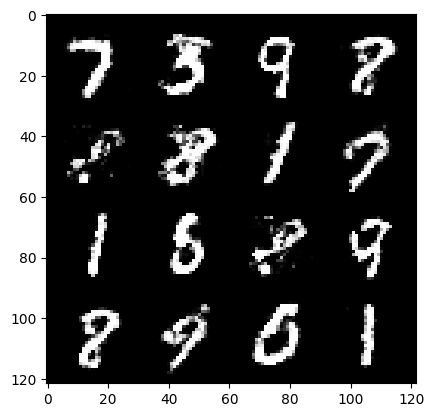

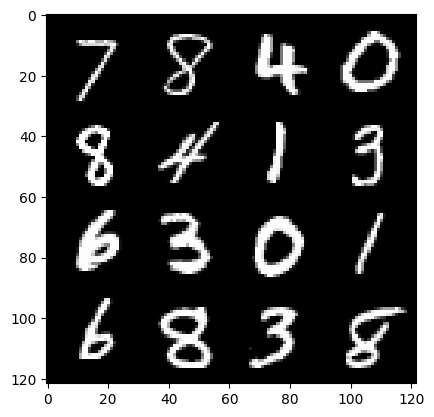

 23%|██▎       | 107/469 [00:01<00:08, 44.63it/s]

413: step 193800 / Gen loss: 1.74958096464475 / disc_loss: 0.33658036912480976


 86%|████████▌ | 403/469 [00:06<00:00, 67.37it/s]

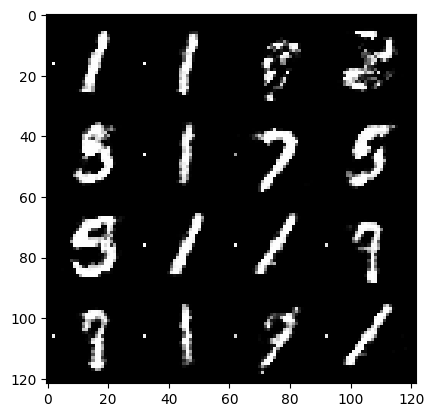

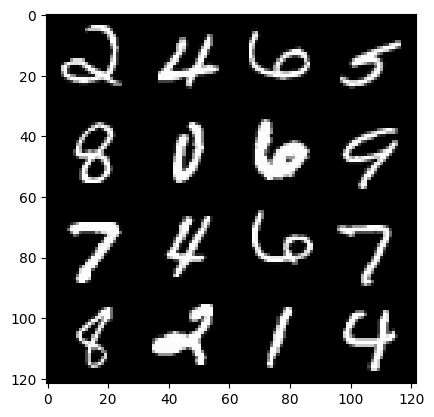

 87%|████████▋ | 410/469 [00:06<00:01, 38.72it/s]

413: step 194100 / Gen loss: 1.605958345333735 / disc_loss: 0.38941601693630257


 49%|████▉     | 231/469 [00:03<00:03, 67.05it/s]

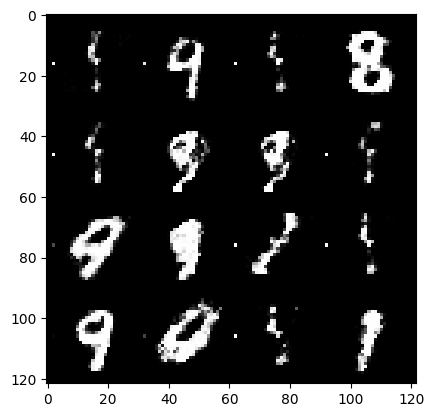

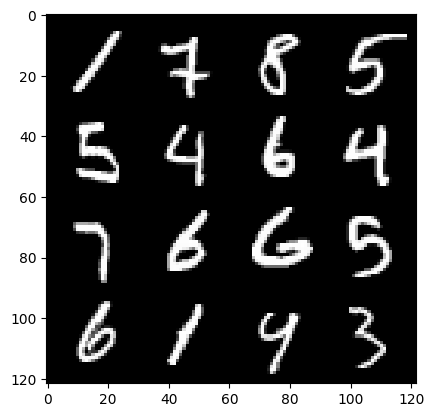

 52%|█████▏    | 244/469 [00:04<00:05, 44.92it/s]

414: step 194400 / Gen loss: 1.4027542583147674 / disc_loss: 0.4081459350387253


 13%|█▎        | 62/469 [00:00<00:06, 66.95it/s]

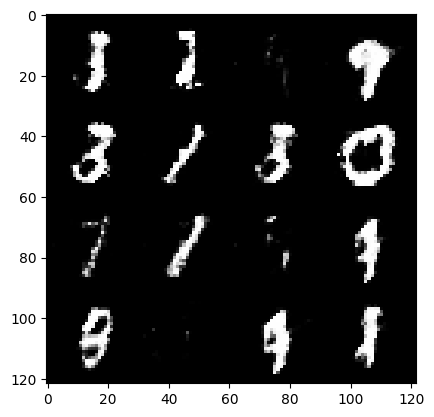

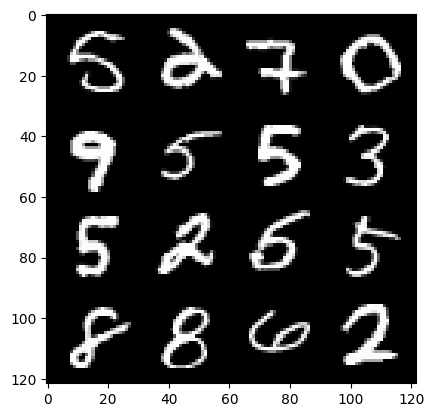

 16%|█▌        | 75/469 [00:01<00:09, 41.23it/s]

415: step 194700 / Gen loss: 1.4855606452624013 / disc_loss: 0.37949385364850374


 77%|███████▋  | 362/469 [00:05<00:01, 64.28it/s]

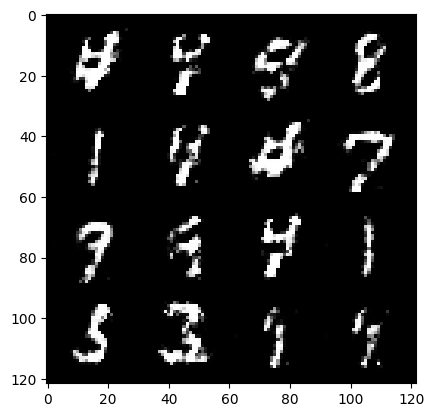

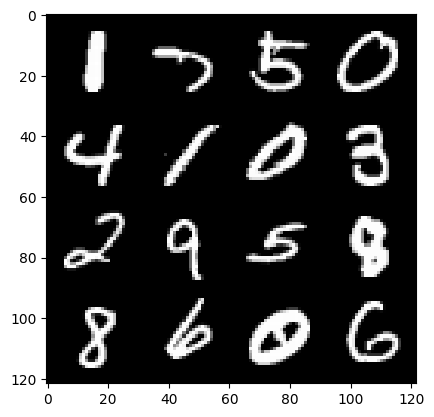

 79%|███████▊  | 369/469 [00:06<00:02, 43.59it/s]

415: step 195000 / Gen loss: 1.5730066788196562 / disc_loss: 0.3585221787293755


 42%|████▏     | 195/469 [00:03<00:04, 61.53it/s]

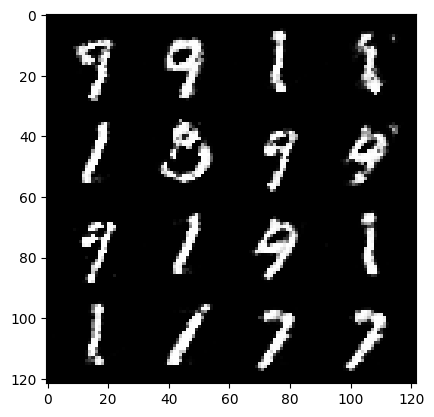

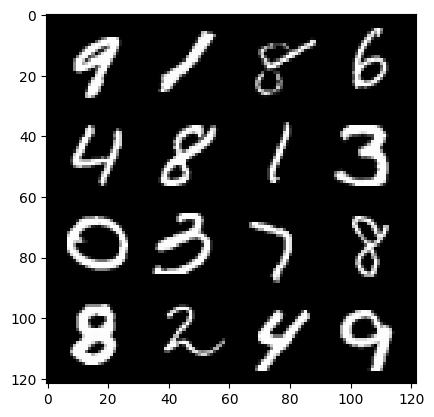

 43%|████▎     | 202/469 [00:03<00:06, 40.90it/s]

416: step 195300 / Gen loss: 1.7202327509721123 / disc_loss: 0.3702584343155224


  4%|▍         | 21/469 [00:00<00:06, 64.26it/s]

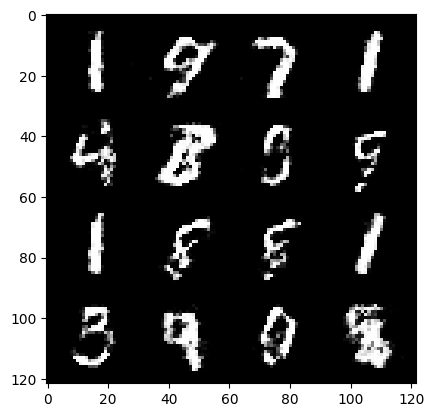

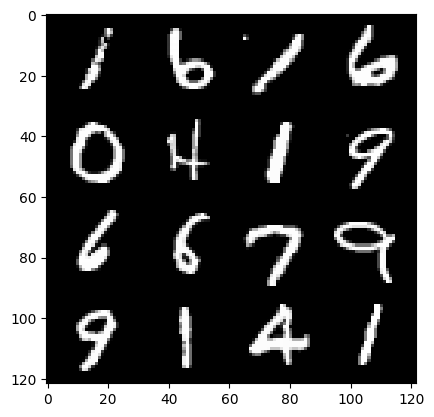

  7%|▋         | 34/469 [00:00<00:09, 44.08it/s]

417: step 195600 / Gen loss: 1.7814314603805546 / disc_loss: 0.36053202847639737


 68%|██████▊   | 321/469 [00:05<00:02, 65.37it/s]

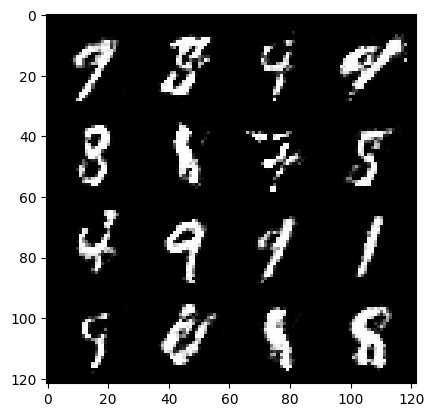

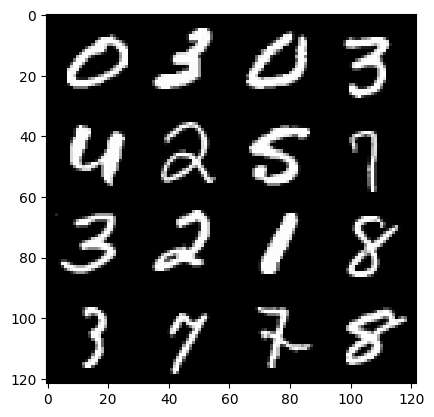

 71%|███████   | 334/469 [00:05<00:03, 38.94it/s]

417: step 195900 / Gen loss: 1.775569266875585 / disc_loss: 0.3498981595039364


 33%|███▎      | 155/469 [00:02<00:04, 68.80it/s]

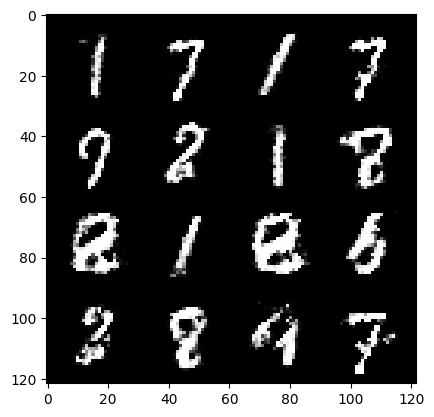

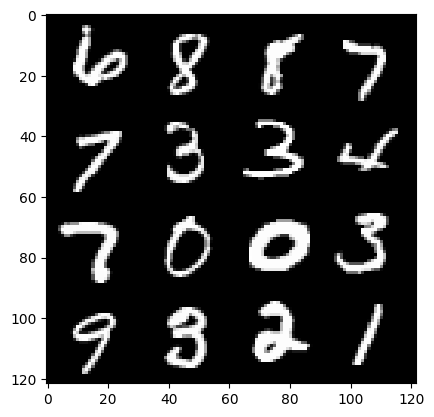

 35%|███▍      | 162/469 [00:02<00:06, 44.20it/s]

418: step 196200 / Gen loss: 1.7682344754536936 / disc_loss: 0.3693612446387608


 96%|█████████▋| 452/469 [00:07<00:00, 67.83it/s]

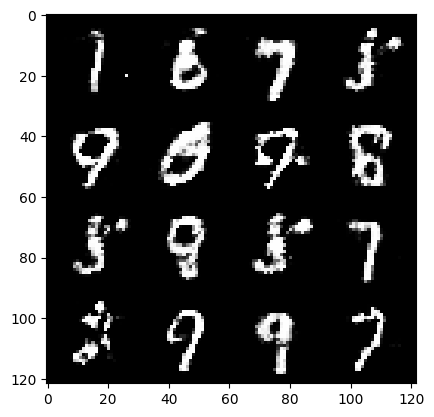

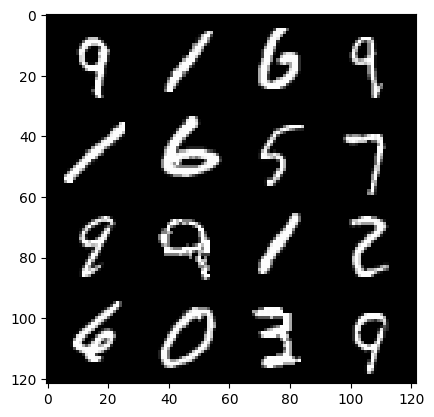

 99%|█████████▉| 465/469 [00:07<00:00, 41.32it/s]

418: step 196500 / Gen loss: 1.6953251175085704 / disc_loss: 0.3608240169286728


 62%|██████▏   | 289/469 [00:04<00:02, 65.50it/s]

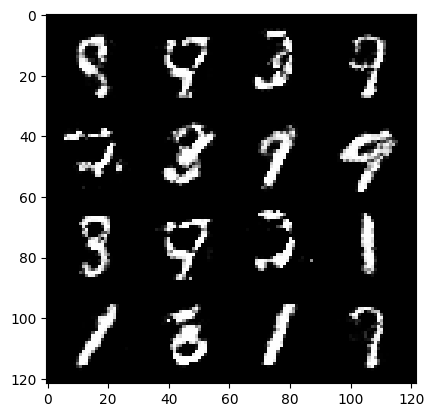

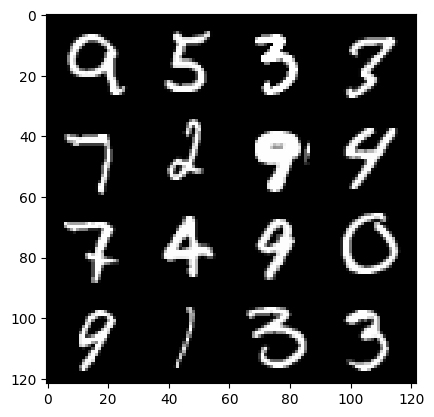

 63%|██████▎   | 296/469 [00:04<00:04, 39.90it/s]

419: step 196800 / Gen loss: 1.7014653225739804 / disc_loss: 0.3727302511036399


 24%|██▍       | 114/469 [00:01<00:05, 69.83it/s]

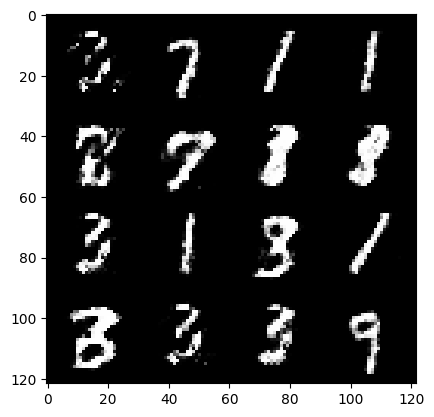

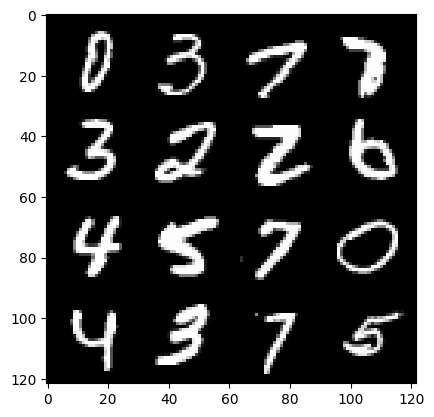

 27%|██▋       | 127/469 [00:02<00:06, 51.43it/s]

420: step 197100 / Gen loss: 1.5810355575879416 / disc_loss: 0.3882482915123303


 89%|████████▉ | 419/469 [00:06<00:00, 67.95it/s]

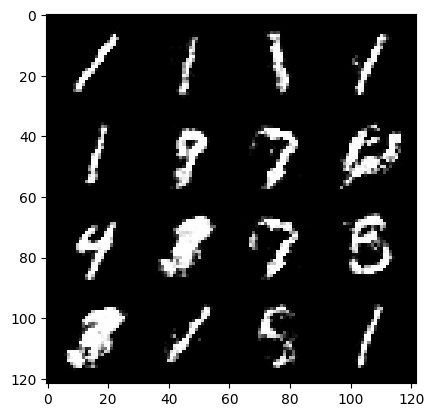

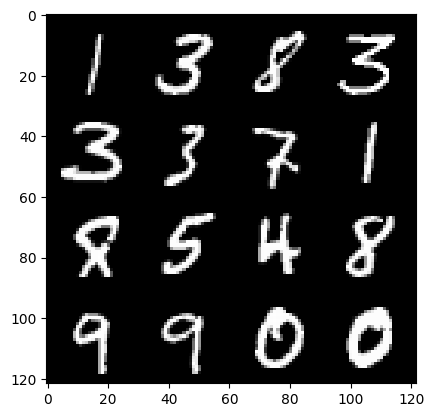

 91%|█████████ | 426/469 [00:06<00:01, 40.77it/s]

420: step 197400 / Gen loss: 1.5840410371621443 / disc_loss: 0.37553574264049505


 52%|█████▏    | 245/469 [00:03<00:03, 70.77it/s]

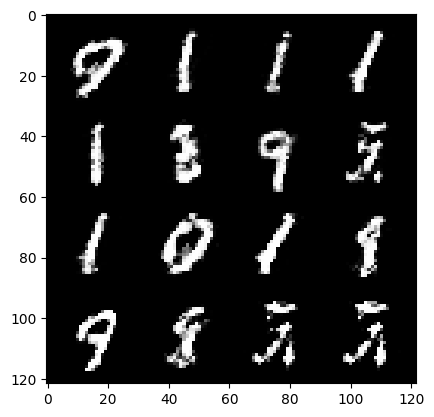

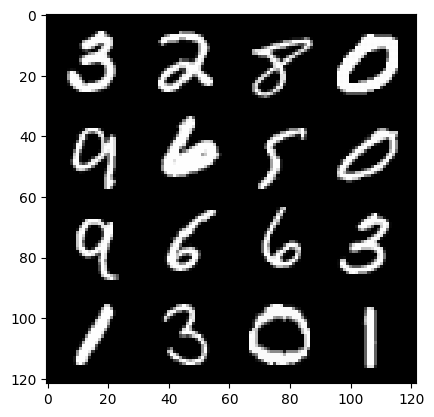

 55%|█████▌    | 259/469 [00:04<00:05, 40.63it/s]

421: step 197700 / Gen loss: 1.7262110714117693 / disc_loss: 0.37488658775885914


 16%|█▌        | 76/469 [00:01<00:05, 72.33it/s]

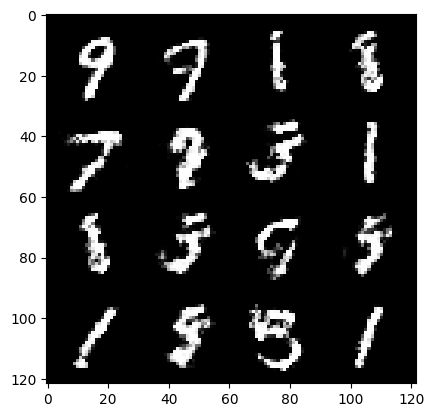

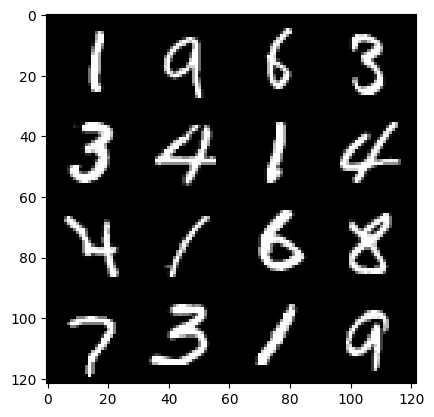

 19%|█▉        | 90/469 [00:01<00:08, 43.80it/s]

422: step 198000 / Gen loss: 1.655240337053935 / disc_loss: 0.3701269935568174


 81%|████████  | 379/469 [00:06<00:01, 67.47it/s]

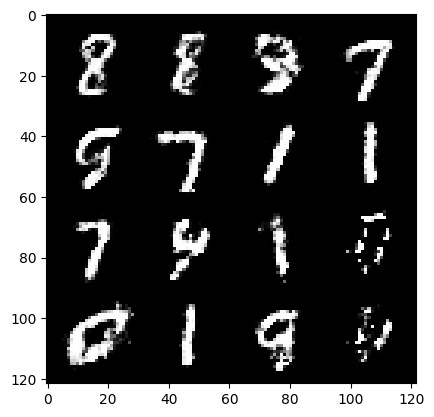

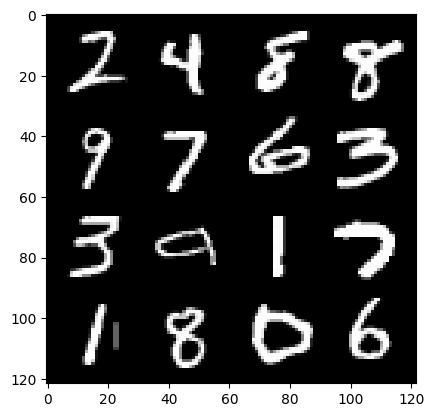

 84%|████████▎ | 392/469 [00:06<00:01, 46.22it/s]

422: step 198300 / Gen loss: 1.672897715965907 / disc_loss: 0.3585792361696561


 44%|████▍     | 207/469 [00:03<00:03, 67.38it/s]

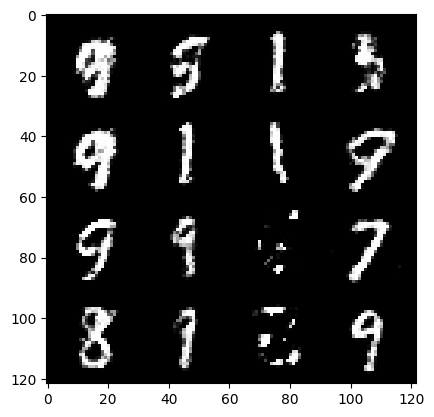

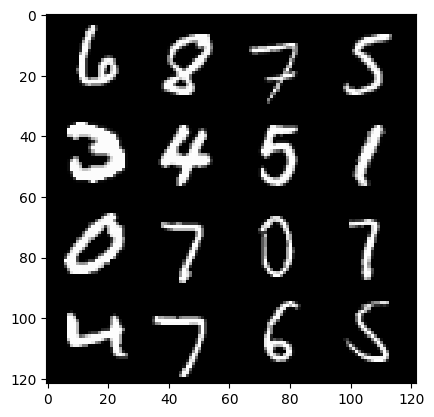

 47%|████▋     | 220/469 [00:03<00:05, 45.85it/s]

423: step 198600 / Gen loss: 1.6217170031865442 / disc_loss: 0.3865747210383416


  9%|▉         | 42/469 [00:00<00:07, 60.17it/s]

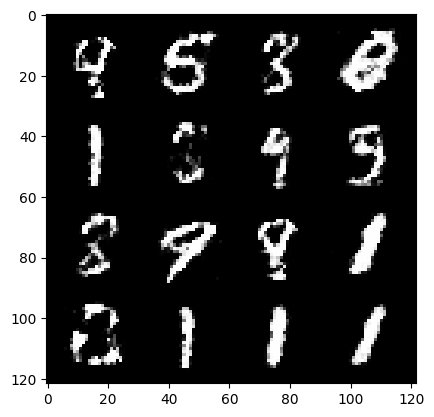

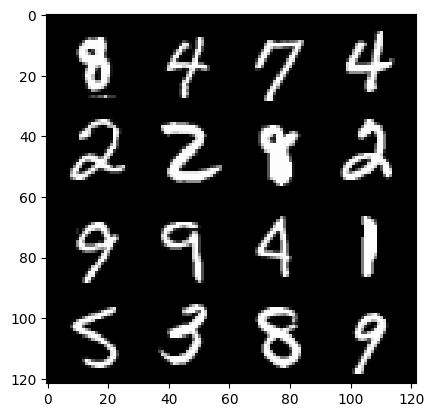

 10%|█         | 49/469 [00:01<00:11, 37.57it/s]

424: step 198900 / Gen loss: 1.7026375460624696 / disc_loss: 0.37264512240886694


 72%|███████▏  | 337/469 [00:05<00:01, 69.23it/s]

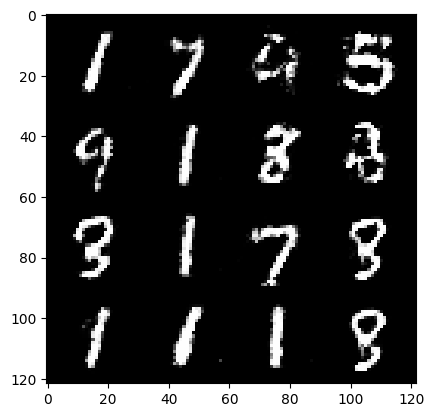

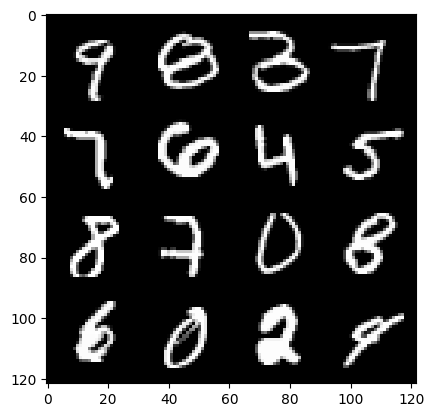

 75%|███████▍  | 351/469 [00:05<00:02, 49.77it/s]

424: step 199200 / Gen loss: 1.6439686954021464 / disc_loss: 0.363849821786086


 36%|███▌      | 168/469 [00:02<00:04, 73.23it/s]

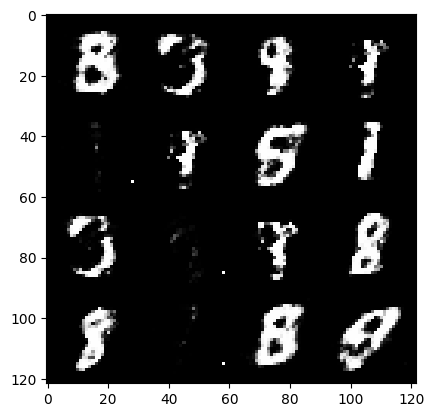

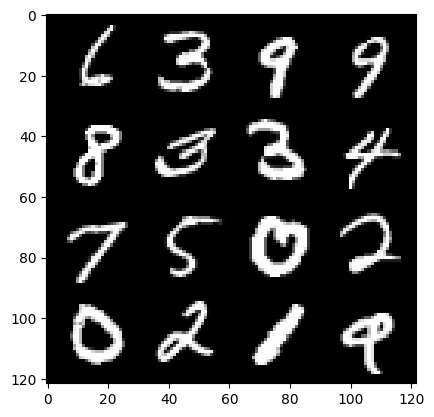

 39%|███▉      | 182/469 [00:02<00:05, 49.18it/s]

425: step 199500 / Gen loss: 1.2308236644665391 / disc_loss: 0.8571008711059888


  1%|▏         | 6/469 [00:00<00:07, 58.02it/s]

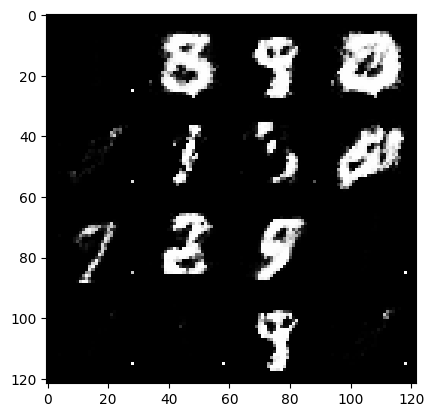

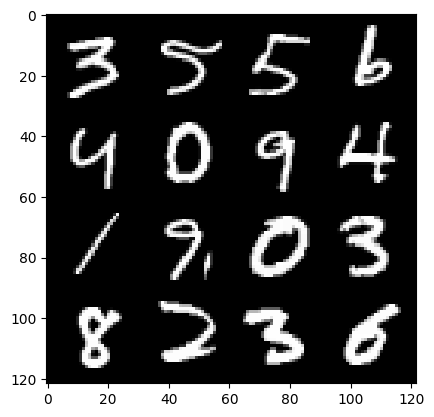

  3%|▎         | 12/469 [00:00<00:20, 22.54it/s]

426: step 199800 / Gen loss: 0.79950079202652 / disc_loss: 1.0759943834940584


 65%|██████▍   | 304/469 [00:05<00:02, 69.48it/s]

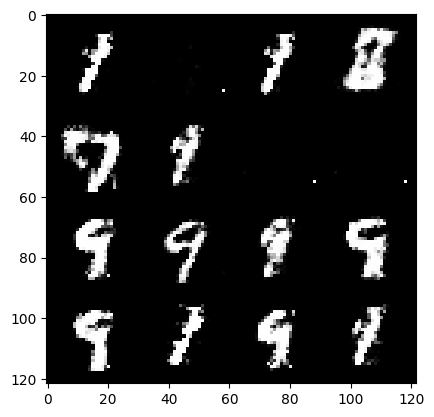

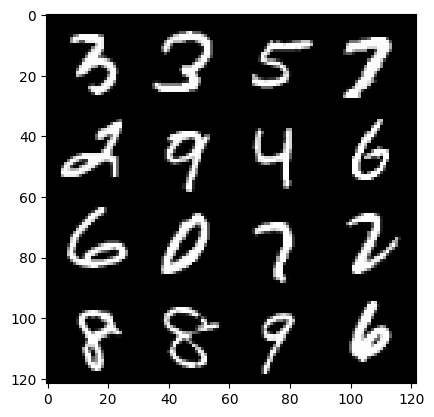

 67%|██████▋   | 312/469 [00:05<00:03, 47.15it/s]

426: step 200100 / Gen loss: 1.093222492337227 / disc_loss: 0.5504797331492113


 29%|██▊       | 134/469 [00:01<00:04, 67.23it/s]

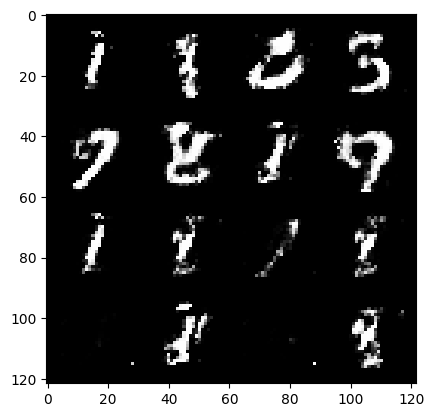

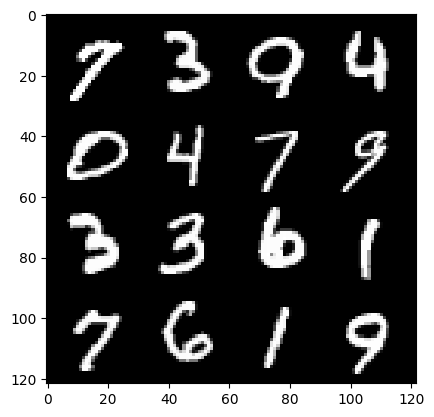

 30%|███       | 141/469 [00:02<00:07, 41.81it/s]

427: step 200400 / Gen loss: 1.2317159736156467 / disc_loss: 0.45962459127108224


 93%|█████████▎| 434/469 [00:06<00:00, 72.48it/s]

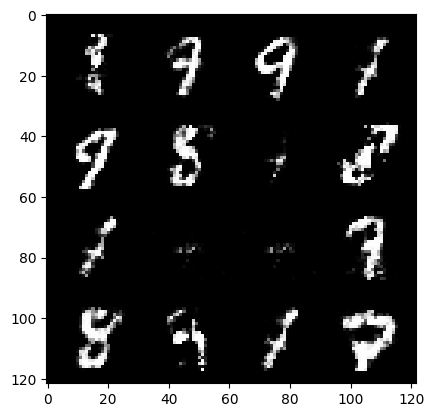

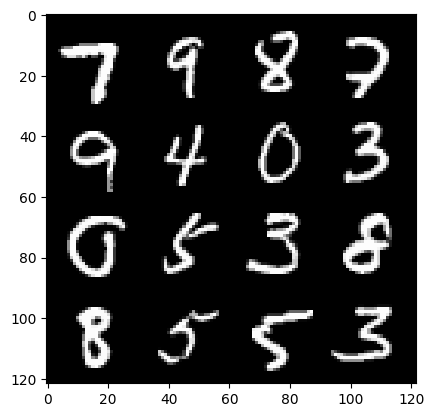

 94%|█████████▍| 442/469 [00:07<00:00, 42.73it/s]

427: step 200700 / Gen loss: 1.1507342727979024 / disc_loss: 0.4555190515518188


 56%|█████▋    | 264/469 [00:03<00:03, 67.74it/s]

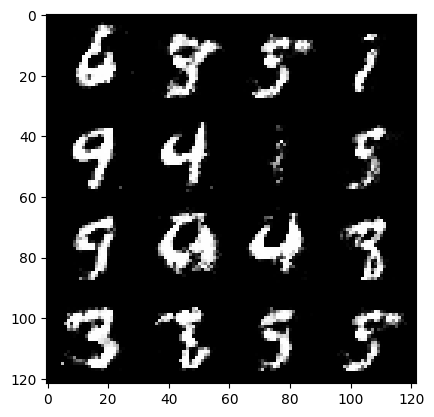

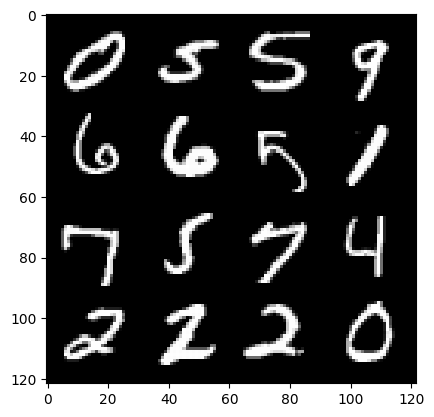

 59%|█████▉    | 277/469 [00:04<00:04, 42.61it/s]

428: step 201000 / Gen loss: 1.2063067603111273 / disc_loss: 0.42230228940645853


 21%|██        | 98/469 [00:01<00:05, 70.72it/s]

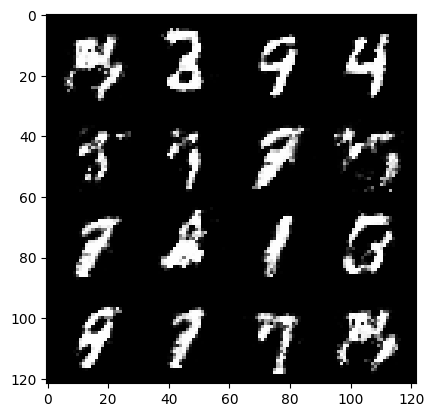

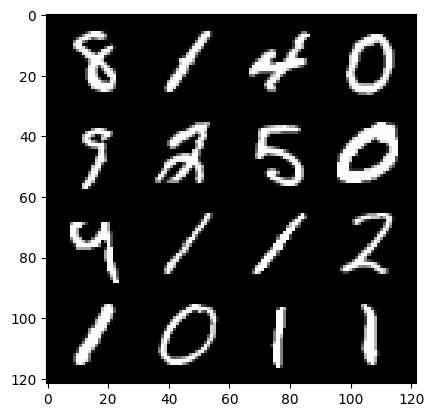

 23%|██▎       | 106/469 [00:01<00:08, 43.63it/s]

429: step 201300 / Gen loss: 1.2593389225006104 / disc_loss: 0.4466748400529226


 85%|████████▍ | 398/469 [00:06<00:01, 70.98it/s]

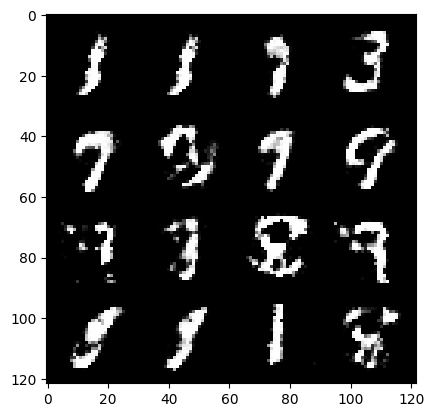

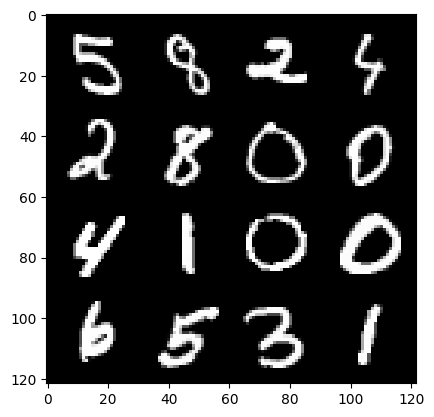

 87%|████████▋ | 406/469 [00:06<00:01, 37.58it/s]

429: step 201600 / Gen loss: 1.296213395992915 / disc_loss: 0.4660302284359931


 48%|████▊     | 224/469 [00:03<00:03, 66.74it/s]

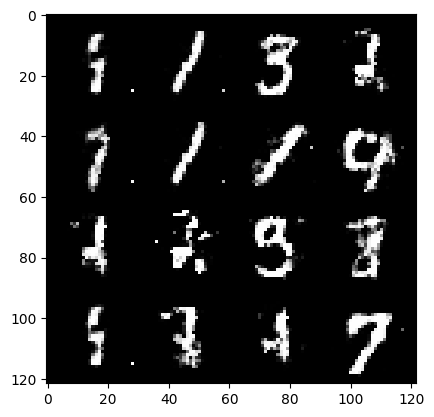

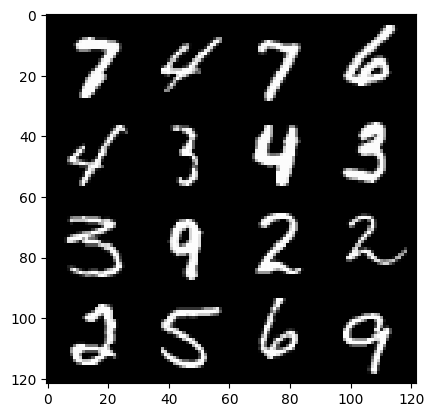

 51%|█████     | 237/469 [00:03<00:05, 42.93it/s]

430: step 201900 / Gen loss: 1.3305175900459283 / disc_loss: 0.4404164361953736


 13%|█▎        | 61/469 [00:00<00:06, 66.51it/s]

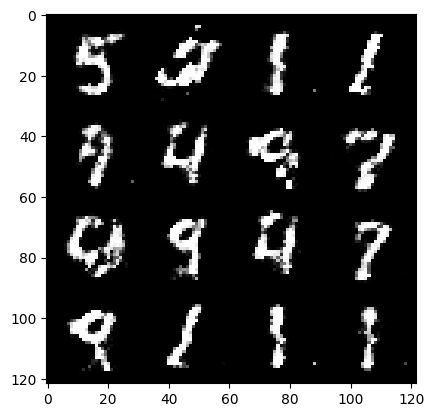

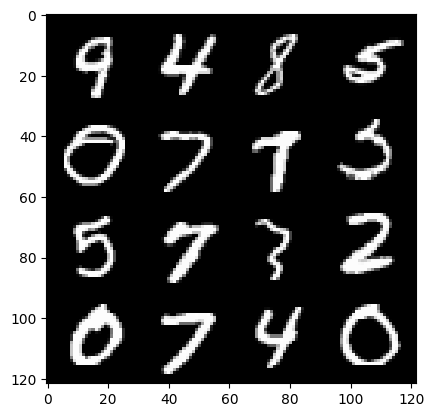

 14%|█▍        | 68/469 [00:01<00:10, 39.18it/s]

431: step 202200 / Gen loss: 1.3302371807893119 / disc_loss: 0.4196049050490065


 77%|███████▋  | 361/469 [00:05<00:01, 71.75it/s]

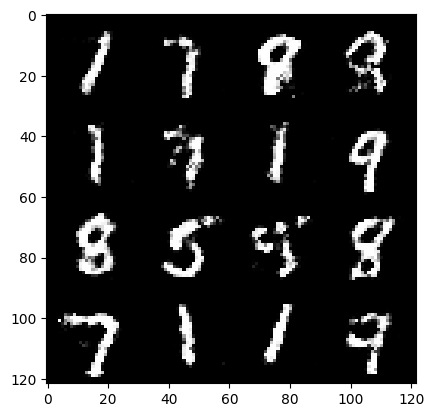

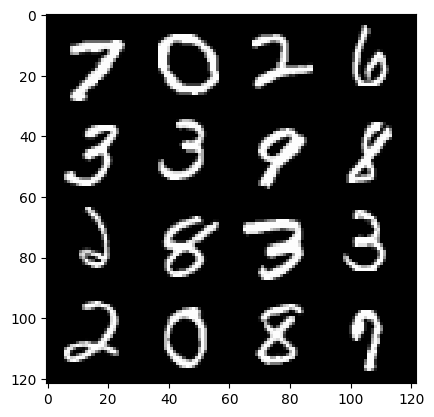

 79%|███████▊  | 369/469 [00:06<00:02, 44.95it/s]

431: step 202500 / Gen loss: 1.3442443958918258 / disc_loss: 0.42596685518821104


 41%|████      | 191/469 [00:02<00:04, 68.09it/s]

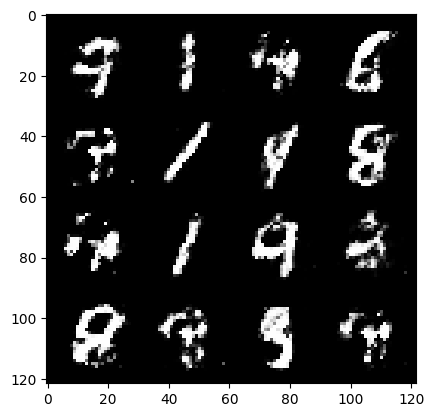

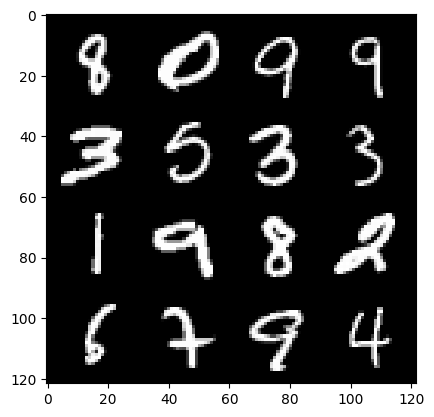

 43%|████▎     | 204/469 [00:03<00:06, 44.03it/s]

432: step 202800 / Gen loss: 1.3960467759768171 / disc_loss: 0.4215008496244748


  3%|▎         | 16/469 [00:00<00:06, 70.64it/s]

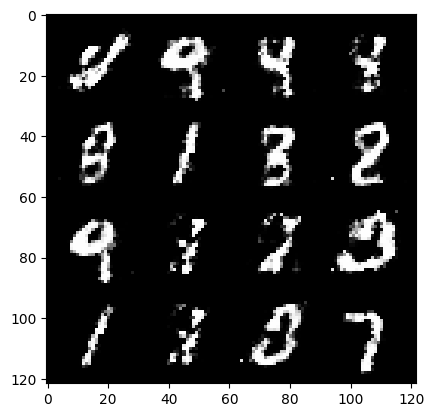

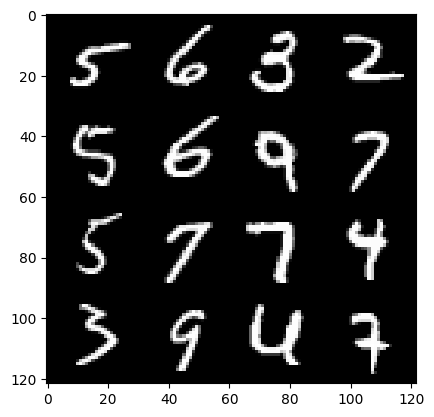

  7%|▋         | 31/469 [00:00<00:09, 48.09it/s]

433: step 203100 / Gen loss: 1.3810124051570893 / disc_loss: 0.40980907529592536


 68%|██████▊   | 317/469 [00:04<00:02, 67.95it/s]

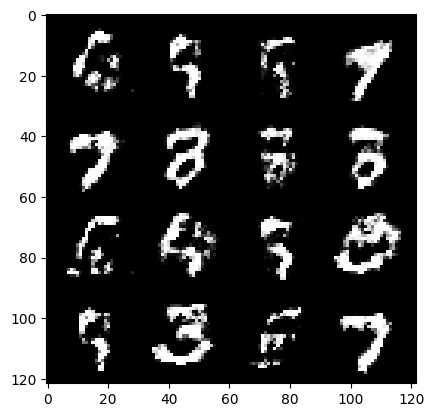

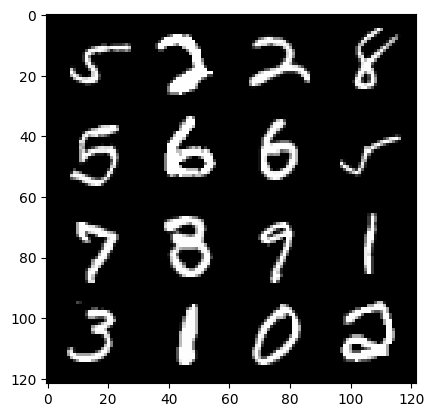

 70%|███████   | 330/469 [00:05<00:03, 45.98it/s]

433: step 203400 / Gen loss: 1.3410151370366405 / disc_loss: 0.4221113330125808


 32%|███▏      | 152/469 [00:02<00:04, 70.83it/s]

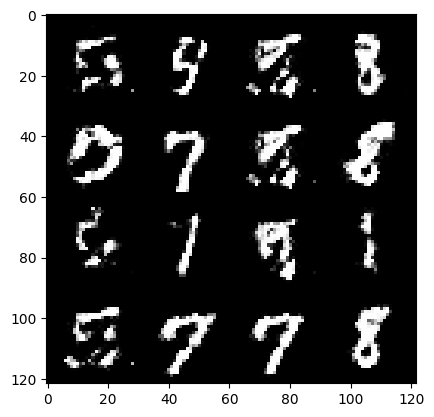

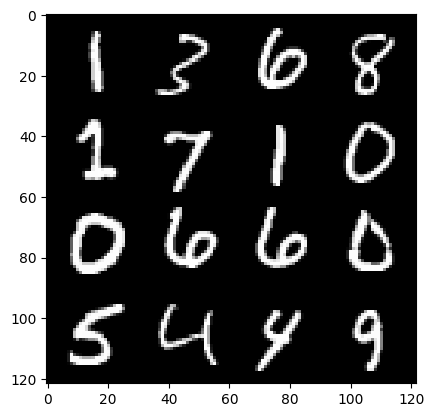

 34%|███▍      | 160/469 [00:02<00:06, 46.29it/s]

434: step 203700 / Gen loss: 1.44666959921519 / disc_loss: 0.39251720219850494


 95%|█████████▌| 447/469 [00:07<00:00, 68.30it/s]

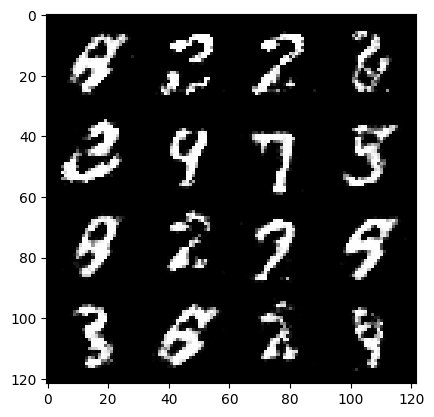

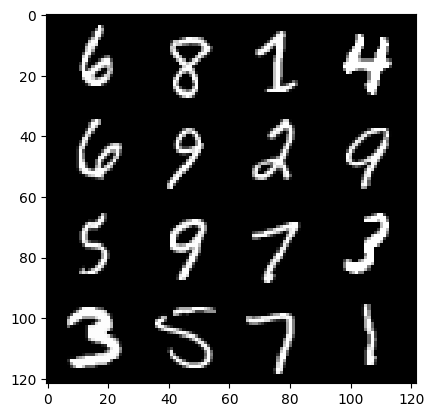

 98%|█████████▊| 461/469 [00:07<00:00, 45.82it/s]

434: step 204000 / Gen loss: 1.4177470831076309 / disc_loss: 0.41328526308139196


 61%|██████    | 284/469 [00:04<00:02, 69.28it/s]

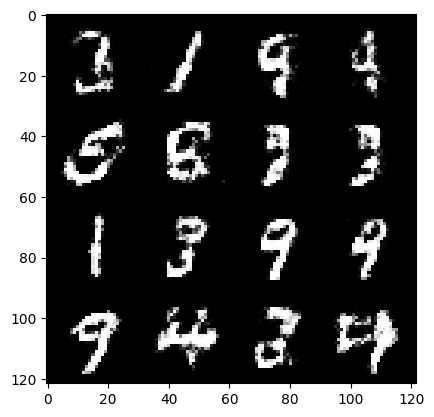

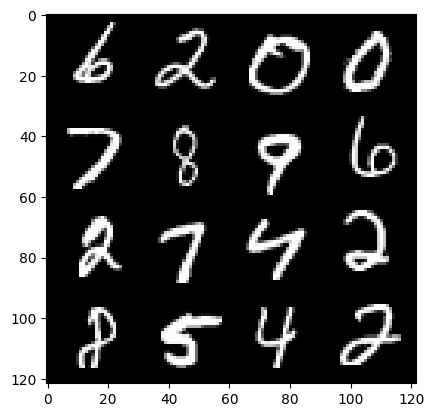

 62%|██████▏   | 292/469 [00:04<00:04, 42.32it/s]

435: step 204300 / Gen loss: 1.5265090223153428 / disc_loss: 0.3550884246826172


 24%|██▍       | 114/469 [00:01<00:05, 69.28it/s]

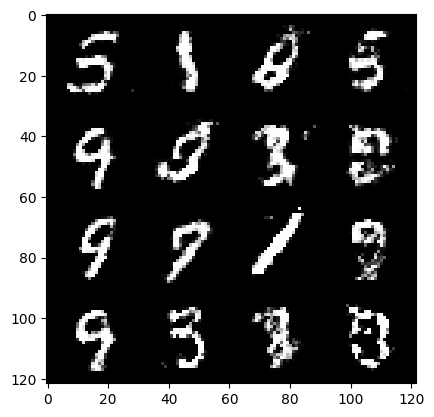

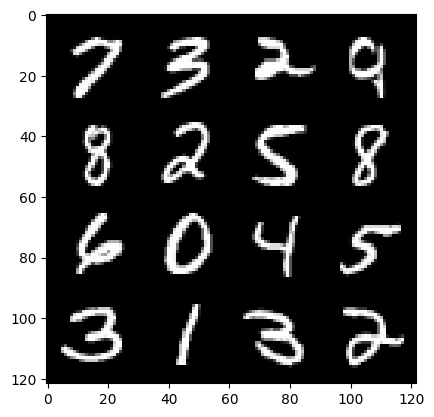

 26%|██▌       | 122/469 [00:02<00:07, 47.47it/s]

436: step 204600 / Gen loss: 1.4702939927577972 / disc_loss: 0.4081882513562836


 88%|████████▊ | 411/469 [00:06<00:00, 71.91it/s]

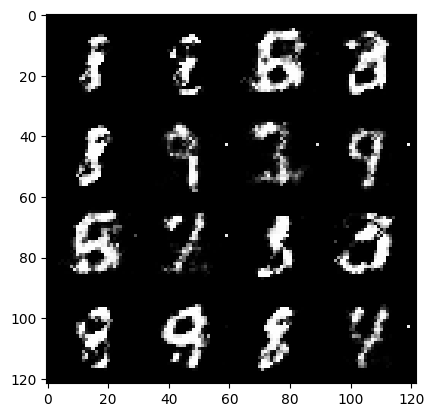

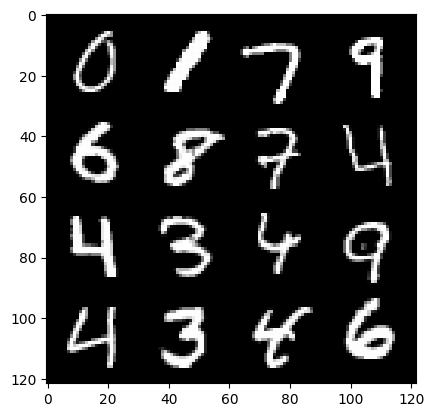

 91%|█████████ | 425/469 [00:06<00:00, 47.43it/s]

436: step 204900 / Gen loss: 1.3457053951422373 / disc_loss: 0.46870071152846005


 52%|█████▏    | 246/469 [00:03<00:03, 69.59it/s]

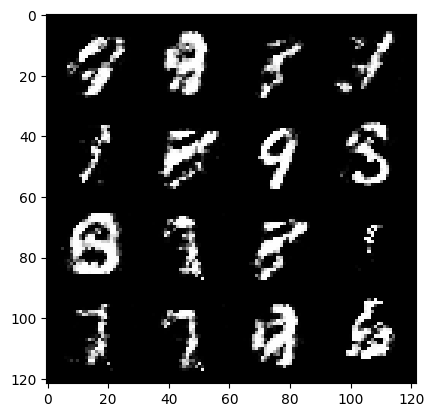

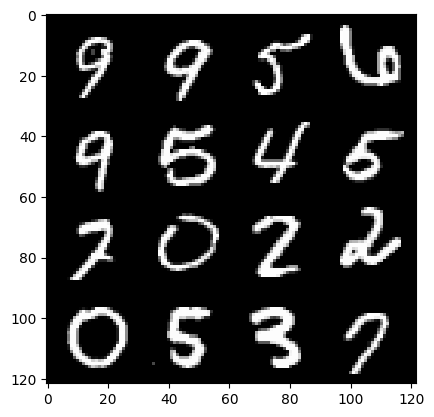

 54%|█████▍    | 253/469 [00:03<00:04, 45.26it/s]

437: step 205200 / Gen loss: 1.3901470867792753 / disc_loss: 0.3909671710928282


 16%|█▌        | 76/469 [00:01<00:05, 68.48it/s]

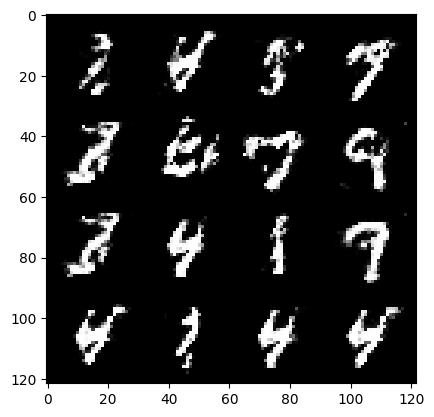

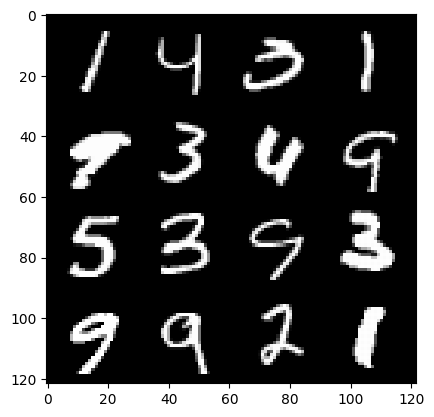

 18%|█▊        | 83/469 [00:01<00:08, 45.97it/s]

438: step 205500 / Gen loss: 1.4685153468449912 / disc_loss: 0.36331634213527025


 80%|███████▉  | 375/469 [00:05<00:01, 71.60it/s]

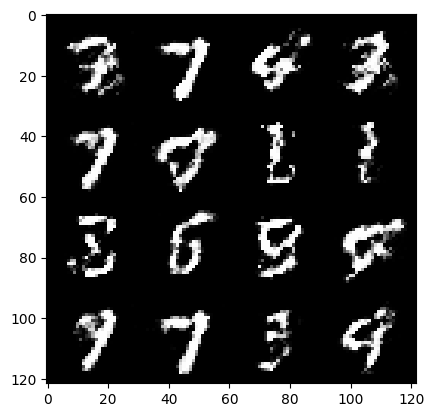

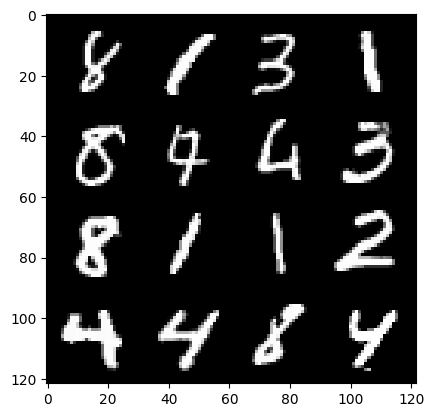

 82%|████████▏ | 383/469 [00:06<00:01, 45.22it/s]

438: step 205800 / Gen loss: 1.5645055147012068 / disc_loss: 0.3490310083826384


 44%|████▍     | 208/469 [00:02<00:03, 71.11it/s]

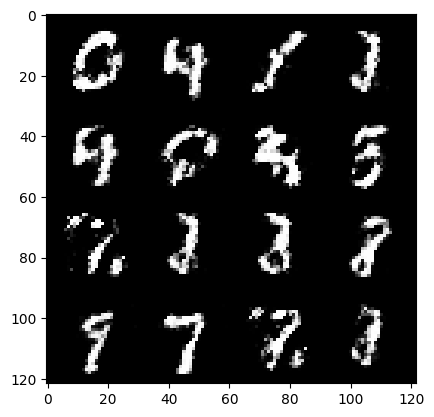

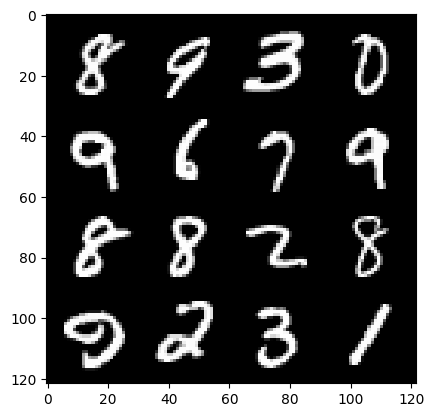

 46%|████▌     | 216/469 [00:03<00:05, 45.38it/s]

439: step 206100 / Gen loss: 1.5902114915847776 / disc_loss: 0.35032678852478666


  9%|▊         | 40/469 [00:00<00:06, 67.72it/s]

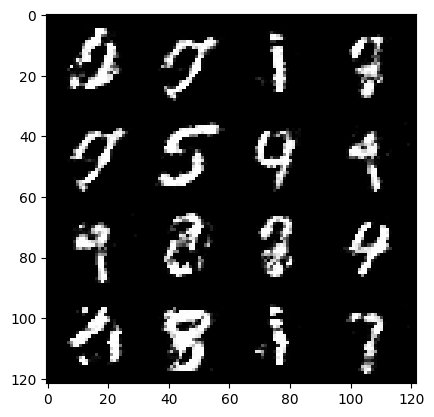

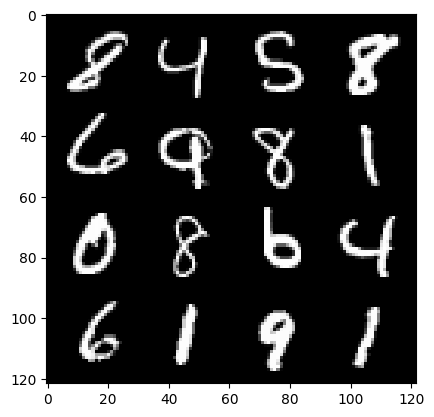

 10%|█         | 47/469 [00:00<00:10, 38.65it/s]

440: step 206400 / Gen loss: 1.5480886459350587 / disc_loss: 0.3720188663403189


 72%|███████▏  | 338/469 [00:05<00:01, 67.52it/s]

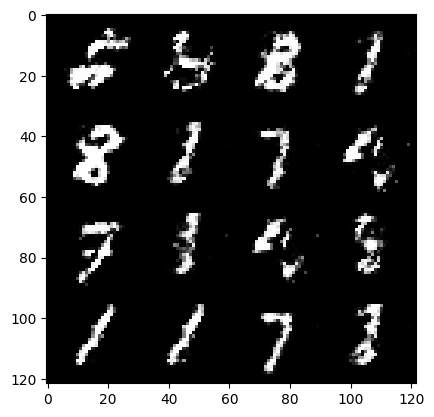

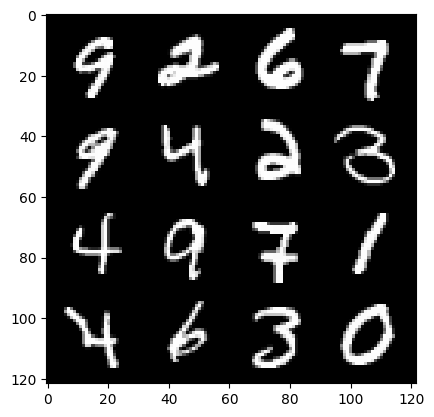

 74%|███████▎  | 345/469 [00:05<00:02, 44.39it/s]

440: step 206700 / Gen loss: 1.54109102010727 / disc_loss: 0.37706632892290803


 35%|███▌      | 165/469 [00:02<00:04, 72.04it/s]

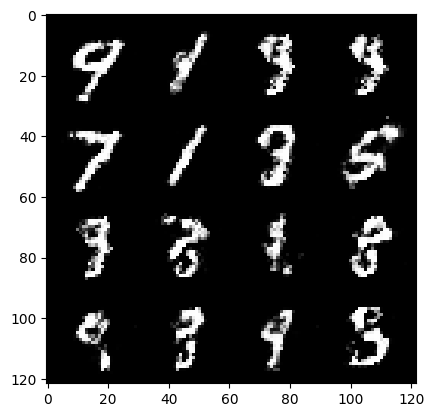

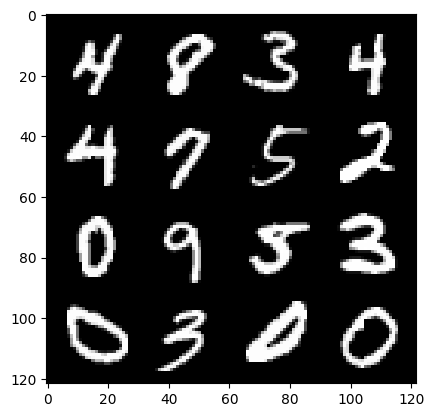

 38%|███▊      | 179/469 [00:02<00:06, 46.43it/s]

441: step 207000 / Gen loss: 1.6033234973748531 / disc_loss: 0.3418476333220798


  0%|          | 0/469 [00:00<?, ?it/s]

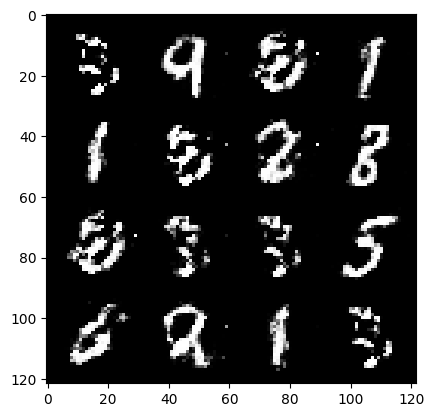

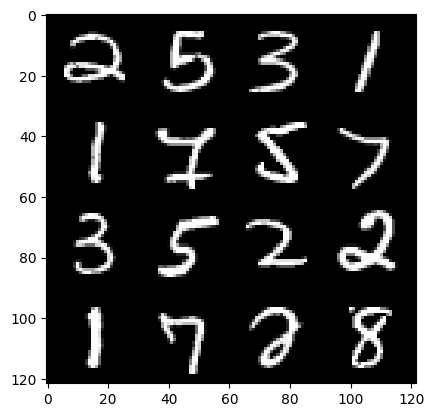

  1%|▏         | 7/469 [00:00<00:17, 25.75it/s]

442: step 207300 / Gen loss: 1.532348478237787 / disc_loss: 0.38803169786930103


 64%|██████▍   | 299/469 [00:04<00:02, 69.07it/s]

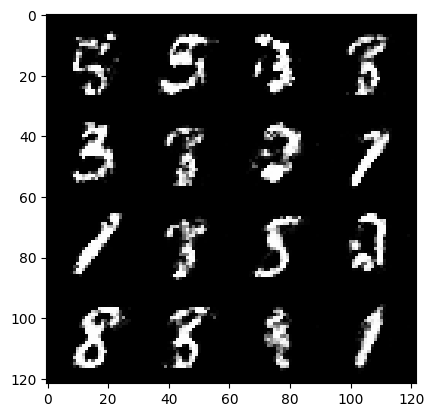

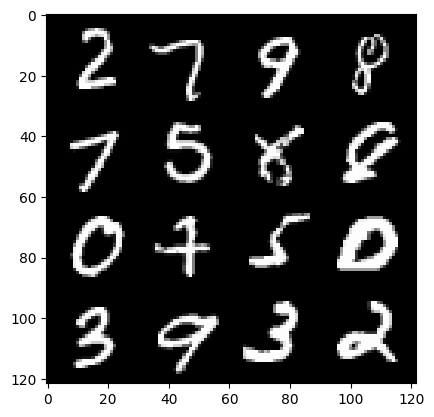

 67%|██████▋   | 312/469 [00:05<00:03, 40.52it/s]

442: step 207600 / Gen loss: 1.5787305541833243 / disc_loss: 0.3710039790471396


 28%|██▊       | 132/469 [00:01<00:04, 68.87it/s]

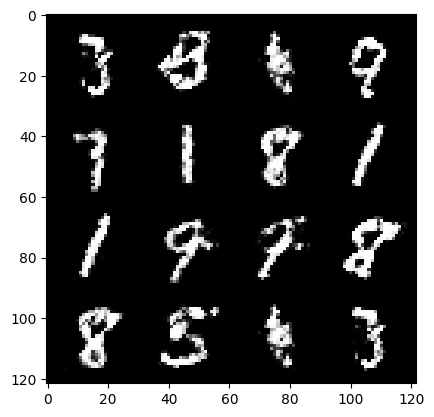

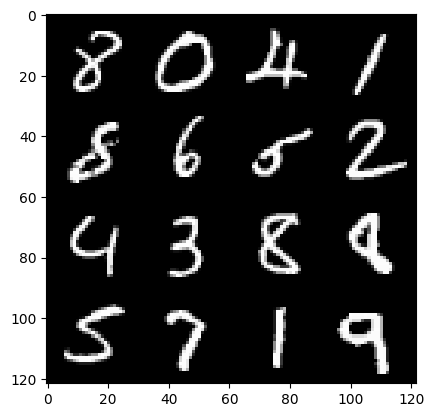

 30%|██▉       | 139/469 [00:02<00:06, 47.97it/s]

443: step 207900 / Gen loss: 1.5255311675866439 / disc_loss: 0.4027782744169236


 92%|█████████▏| 431/469 [00:06<00:00, 69.99it/s]

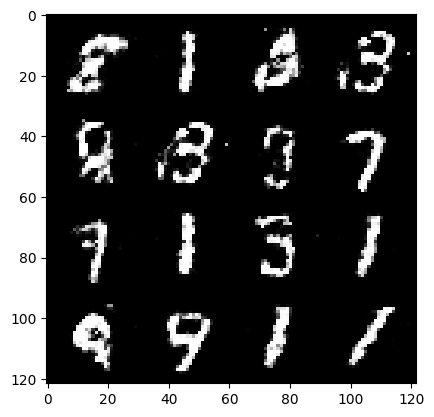

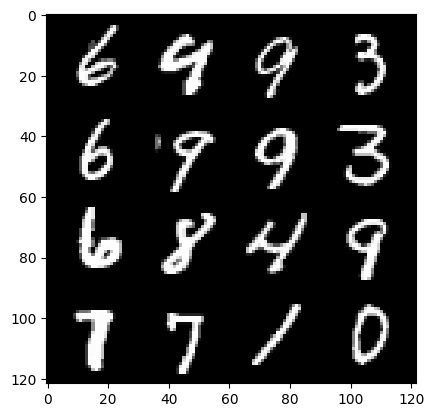

 94%|█████████▎| 439/469 [00:06<00:00, 44.82it/s]

443: step 208200 / Gen loss: 1.5610104501247397 / disc_loss: 0.3862304342786469


 55%|█████▍    | 257/469 [00:03<00:02, 71.09it/s]

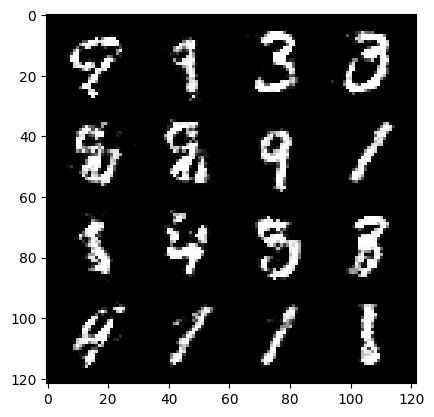

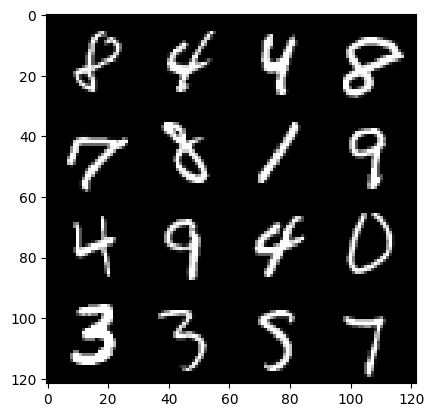

 58%|█████▊    | 271/469 [00:04<00:03, 51.59it/s]

444: step 208500 / Gen loss: 1.5789771207173657 / disc_loss: 0.3754929586251578


 19%|█▉        | 89/469 [00:01<00:05, 64.18it/s]

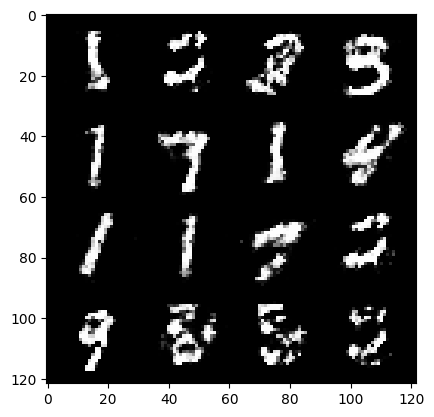

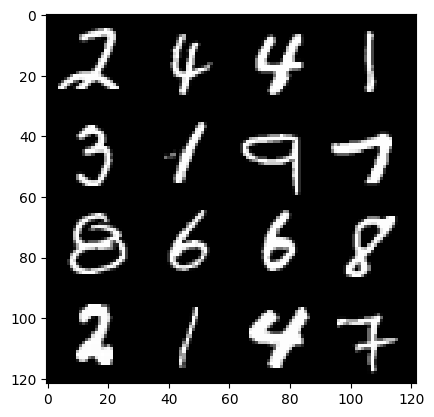

 22%|██▏       | 102/469 [00:01<00:08, 44.42it/s]

445: step 208800 / Gen loss: 1.5565303293863937 / disc_loss: 0.39416476309299464


 83%|████████▎ | 390/469 [00:06<00:01, 64.25it/s]

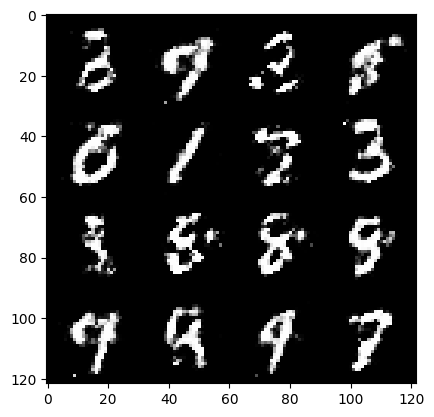

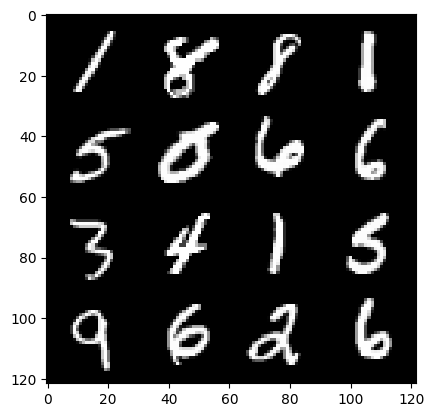

 86%|████████▌ | 403/469 [00:06<00:01, 43.03it/s]

445: step 209100 / Gen loss: 1.6351527138551079 / disc_loss: 0.38612049092849093


 47%|████▋     | 219/469 [00:03<00:03, 64.89it/s]

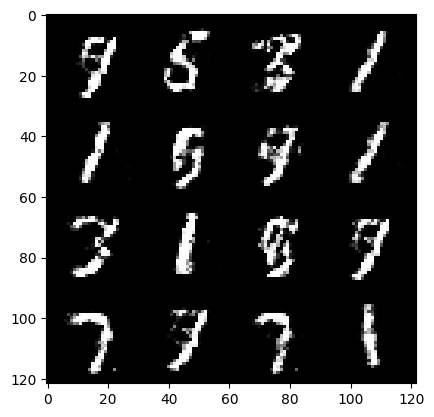

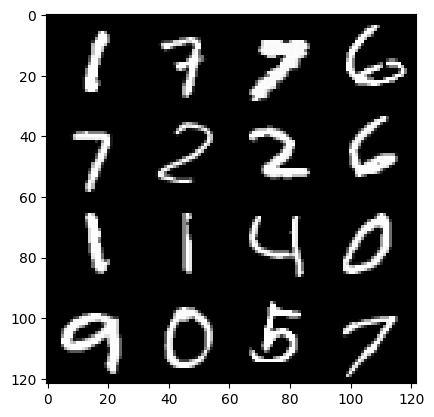

 50%|████▉     | 233/469 [00:03<00:05, 45.45it/s]

446: step 209400 / Gen loss: 1.6942374551296242 / disc_loss: 0.3653693410754205


 12%|█▏        | 57/469 [00:00<00:06, 68.37it/s]

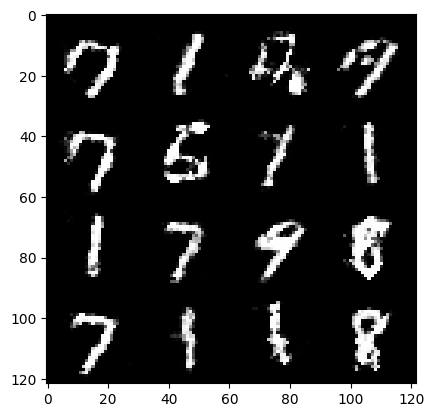

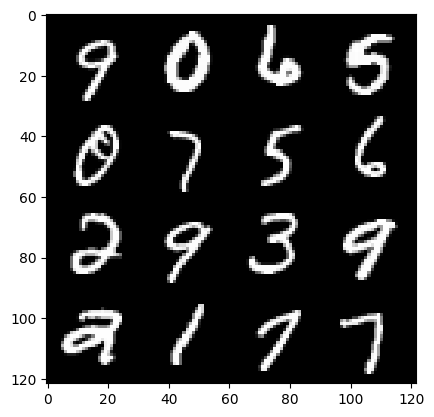

 14%|█▎        | 64/469 [00:01<00:09, 41.74it/s]

447: step 209700 / Gen loss: 1.642452623049418 / disc_loss: 0.3762951861818631


 75%|███████▌  | 353/469 [00:05<00:01, 68.13it/s]

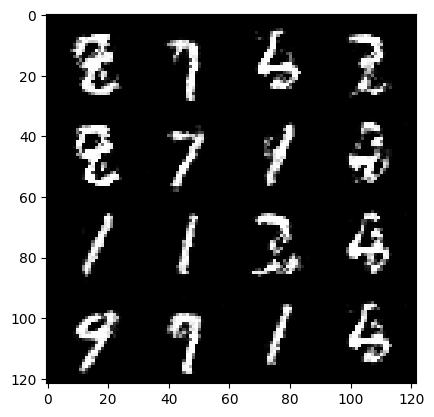

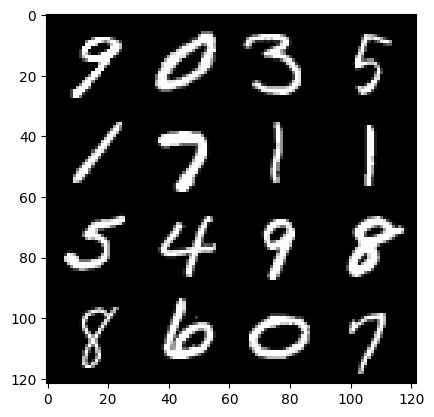

 78%|███████▊  | 366/469 [00:06<00:02, 43.46it/s]

447: step 210000 / Gen loss: 1.6136405607064574 / disc_loss: 0.3890159406264622


 39%|███▉      | 182/469 [00:02<00:04, 70.10it/s]

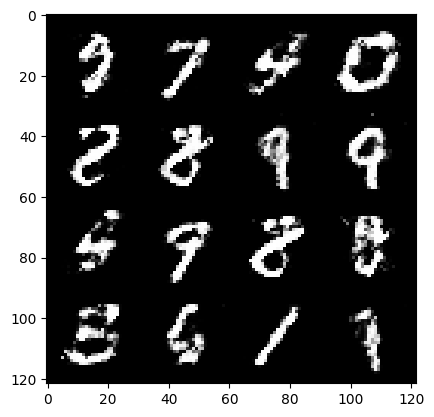

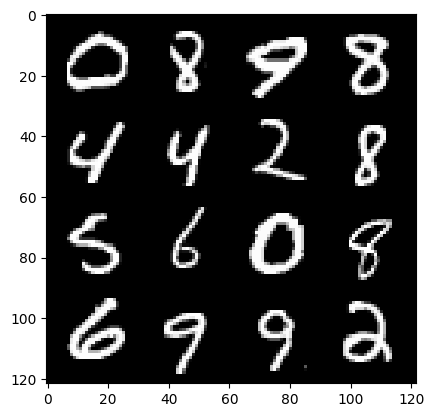

 42%|████▏     | 196/469 [00:03<00:05, 48.78it/s]

448: step 210300 / Gen loss: 1.5971133418877925 / disc_loss: 0.4032881210247677


  3%|▎         | 16/469 [00:00<00:06, 70.87it/s]

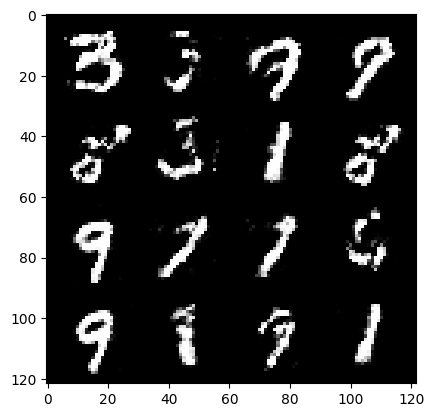

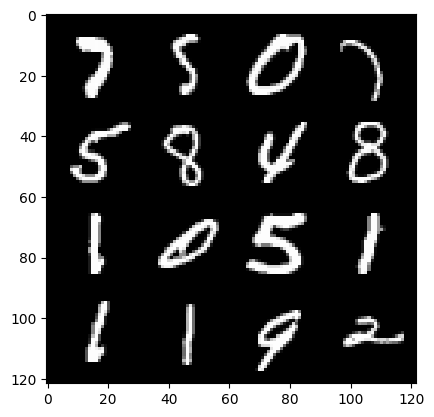

  6%|▋         | 30/469 [00:00<00:10, 40.27it/s]

449: step 210600 / Gen loss: 1.637044715881348 / disc_loss: 0.3737256891528767


 67%|██████▋   | 314/469 [00:05<00:02, 59.53it/s]

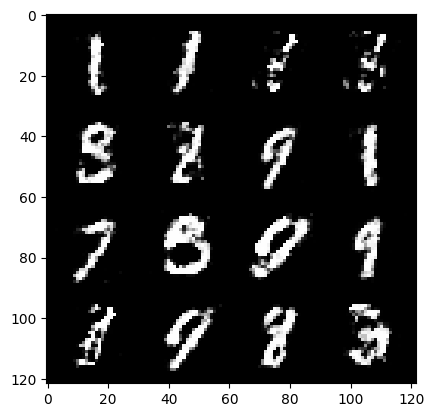

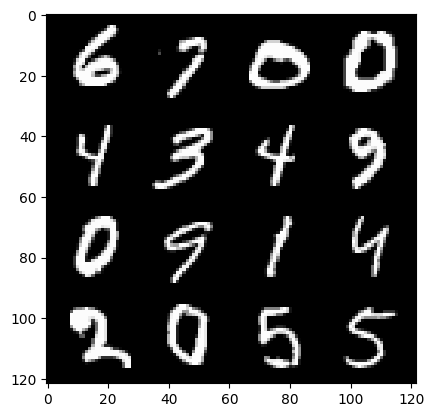

 70%|██████▉   | 327/469 [00:05<00:03, 46.32it/s]

449: step 210900 / Gen loss: 1.6550949891408282 / disc_loss: 0.36530403504769005


 32%|███▏      | 150/469 [00:02<00:04, 66.08it/s]

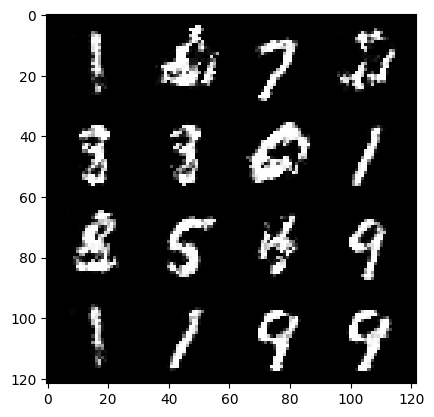

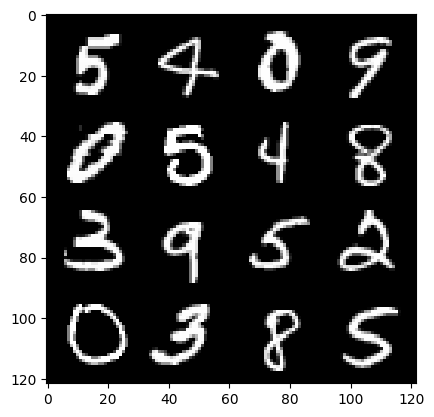

 33%|███▎      | 157/469 [00:02<00:07, 41.68it/s]

450: step 211200 / Gen loss: 1.6372956951459243 / disc_loss: 0.37404086371262874


 95%|█████████▌| 447/469 [00:07<00:00, 61.63it/s]

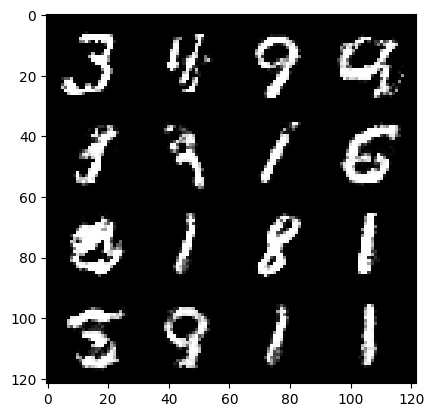

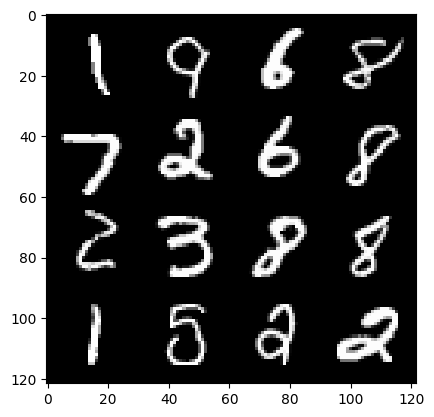

 97%|█████████▋| 454/469 [00:07<00:00, 43.51it/s]

450: step 211500 / Gen loss: 1.5867902831236518 / disc_loss: 0.39952471017837526


 59%|█████▉    | 278/469 [00:04<00:03, 61.22it/s]

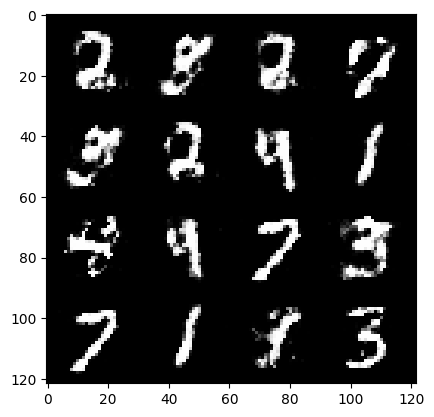

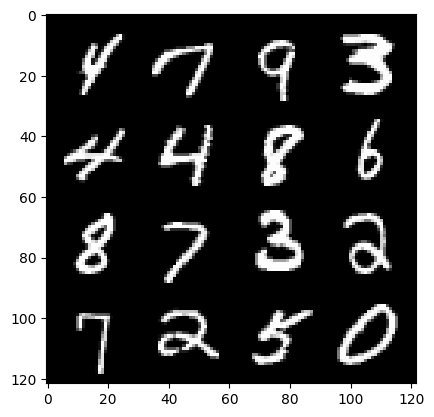

 61%|██████    | 285/469 [00:04<00:04, 39.42it/s]

451: step 211800 / Gen loss: 1.6424313151836396 / disc_loss: 0.37307329664627703


 23%|██▎       | 107/469 [00:01<00:05, 68.23it/s]

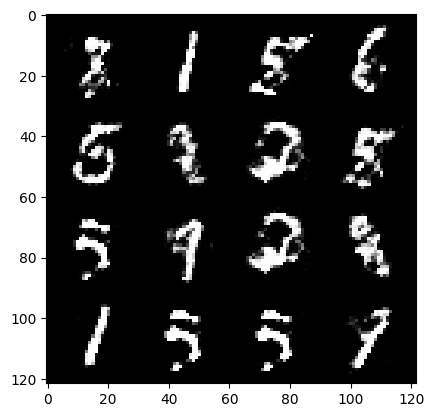

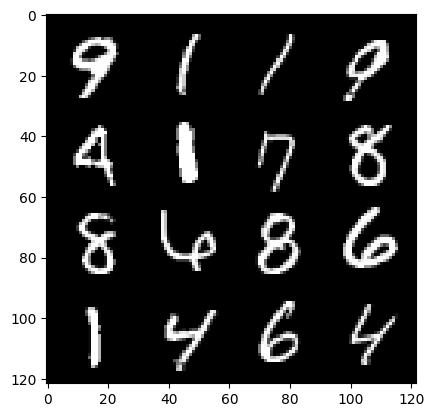

 26%|██▌       | 120/469 [00:02<00:07, 46.38it/s]

452: step 212100 / Gen loss: 1.6406137724717442 / disc_loss: 0.4109316124518714


 87%|████████▋ | 407/469 [00:06<00:00, 68.86it/s]

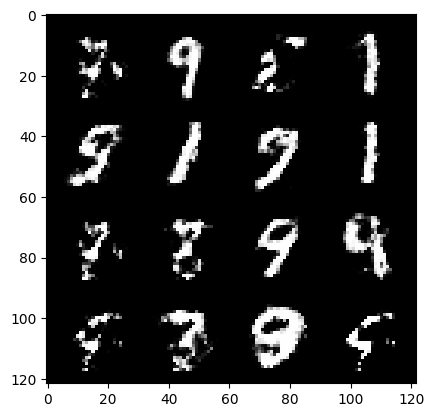

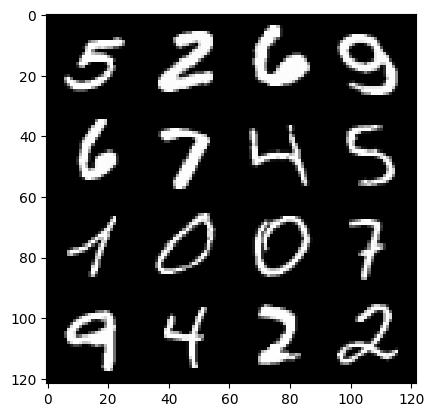

 90%|████████▉ | 420/469 [00:06<00:01, 44.74it/s]

452: step 212400 / Gen loss: 1.6391104455788938 / disc_loss: 0.3817678795258203


 52%|█████▏    | 242/469 [00:03<00:03, 64.50it/s]

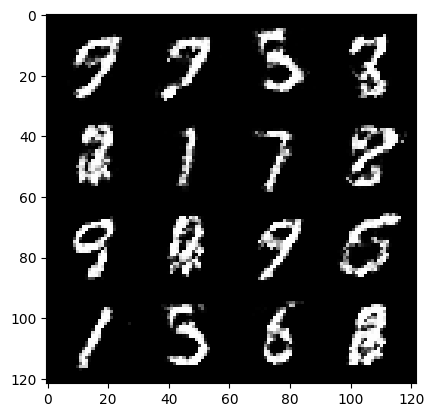

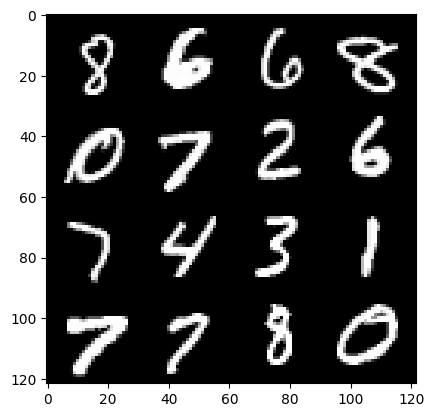

 53%|█████▎    | 249/469 [00:04<00:06, 34.18it/s]

453: step 212700 / Gen loss: 1.6407335305213928 / disc_loss: 0.392108276387056


 15%|█▍        | 69/469 [00:01<00:05, 67.34it/s]

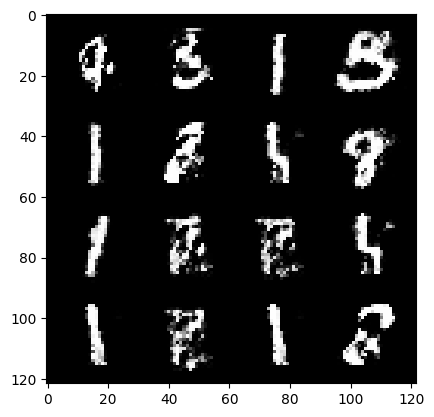

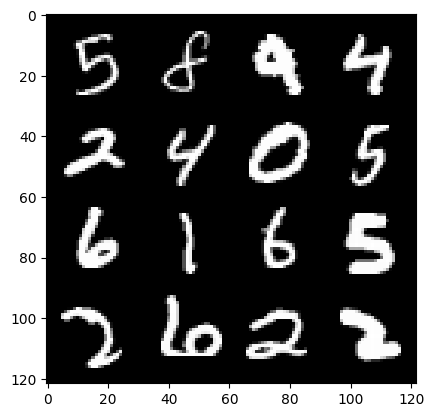

 17%|█▋        | 82/469 [00:01<00:08, 45.47it/s]

454: step 213000 / Gen loss: 1.6510255046685545 / disc_loss: 0.3937427549560864


 79%|███████▉  | 371/469 [00:05<00:01, 66.13it/s]

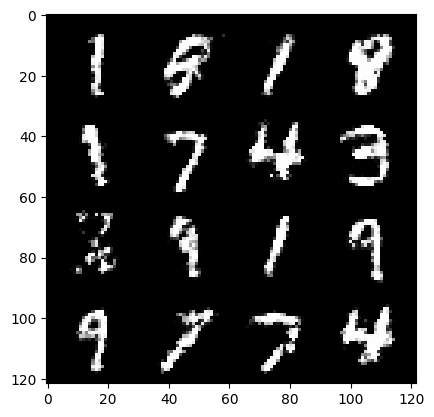

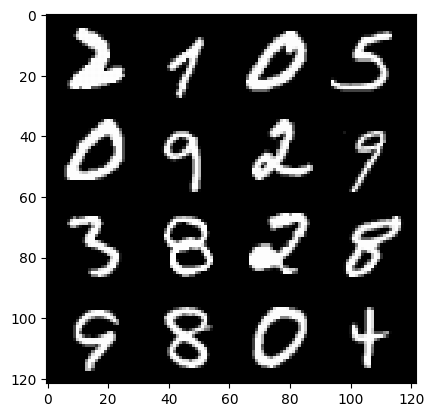

 81%|████████  | 378/469 [00:06<00:02, 41.70it/s]

454: step 213300 / Gen loss: 1.7269973440964999 / disc_loss: 0.369518898427486


 43%|████▎     | 203/469 [00:03<00:03, 70.96it/s]

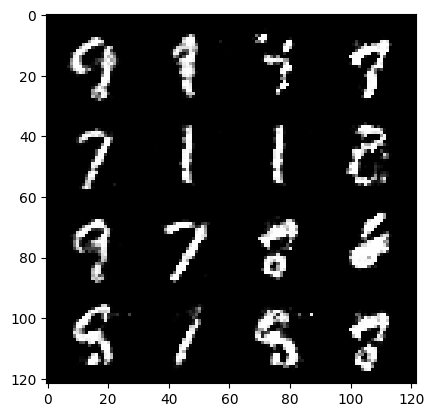

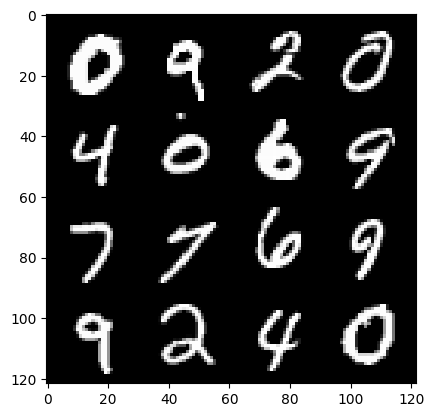

 45%|████▍     | 211/469 [00:03<00:05, 44.03it/s]

455: step 213600 / Gen loss: 1.7480437827110287 / disc_loss: 0.3723131711284321


  6%|▋         | 30/469 [00:00<00:05, 73.48it/s]

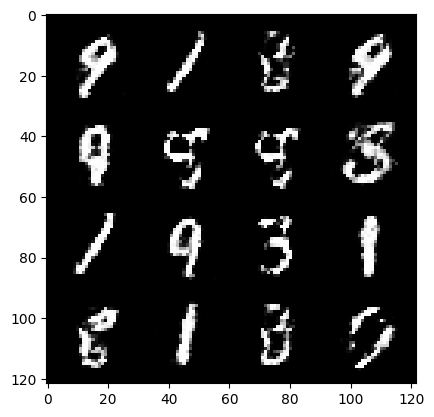

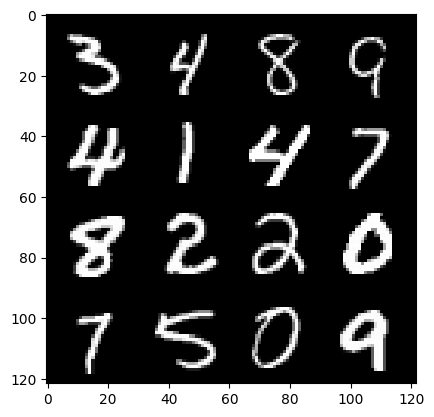

  9%|▉         | 44/469 [00:00<00:09, 46.37it/s]

456: step 213900 / Gen loss: 1.7101455163955706 / disc_loss: 0.36532949596643466


 70%|███████   | 329/469 [00:05<00:02, 67.77it/s]

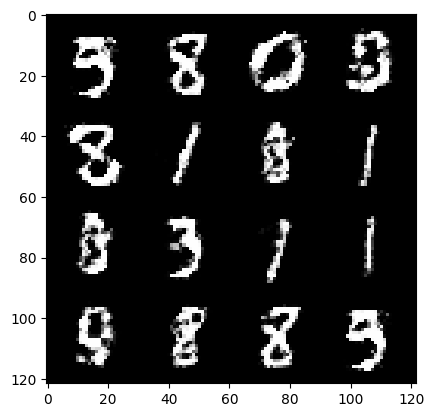

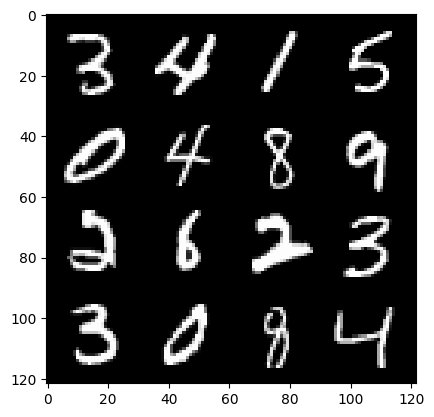

 73%|███████▎  | 343/469 [00:05<00:02, 47.75it/s]

456: step 214200 / Gen loss: 1.7966850288709015 / disc_loss: 0.35816709041595474


 34%|███▍      | 161/469 [00:02<00:04, 71.82it/s]

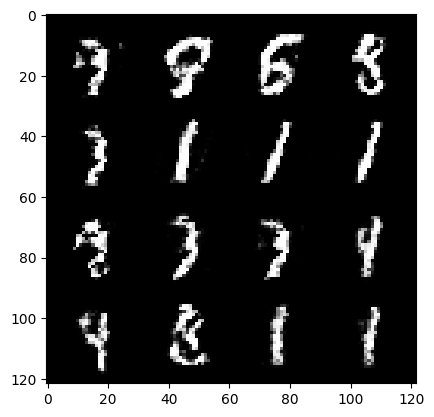

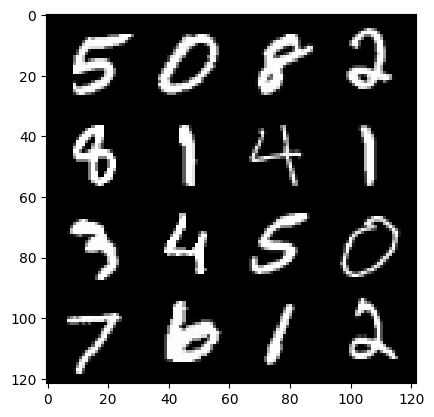

 37%|███▋      | 175/469 [00:03<00:06, 43.61it/s]

457: step 214500 / Gen loss: 1.7044314821561177 / disc_loss: 0.38139594544967065


 99%|█████████▉| 465/469 [00:07<00:00, 67.19it/s]

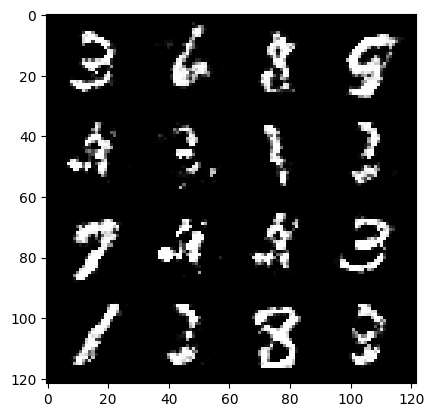

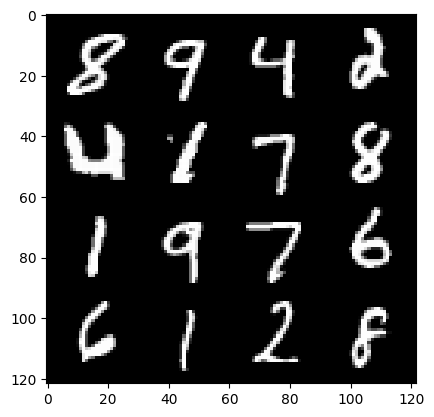

100%|██████████| 469/469 [00:07<00:00, 60.56it/s]


457: step 214800 / Gen loss: 1.8005153195063264 / disc_loss: 0.3683510063091914


 62%|██████▏   | 293/469 [00:04<00:02, 69.81it/s]

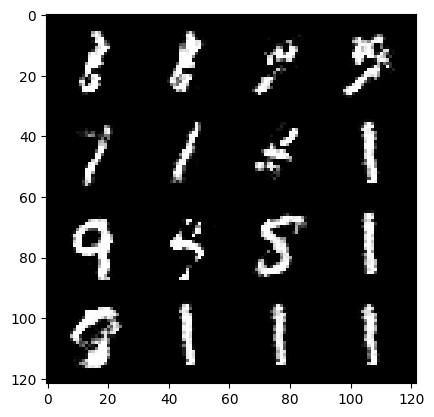

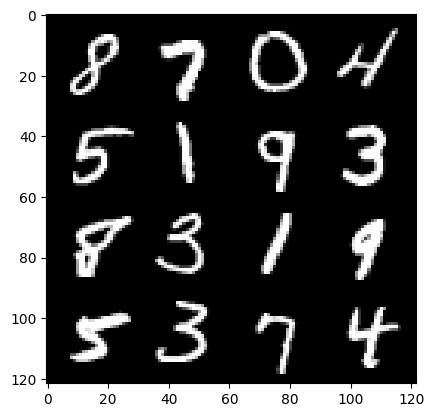

 65%|██████▌   | 307/469 [00:04<00:03, 47.82it/s]

458: step 215100 / Gen loss: 1.7727753329277036 / disc_loss: 0.35225061128536883


 26%|██▌       | 123/469 [00:01<00:05, 64.81it/s]

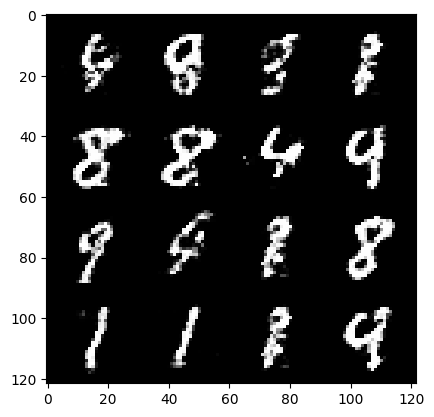

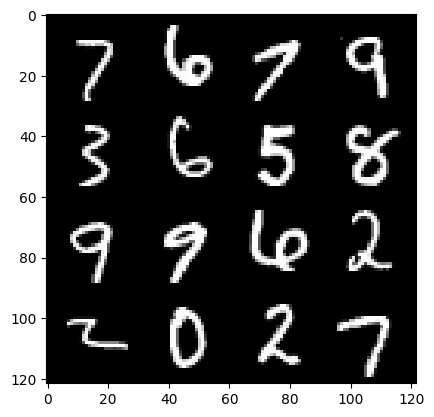

 29%|██▉       | 136/469 [00:02<00:07, 44.76it/s]

459: step 215400 / Gen loss: 1.7245354068279268 / disc_loss: 0.3660513457655904


 91%|█████████ | 427/469 [00:06<00:00, 75.35it/s]

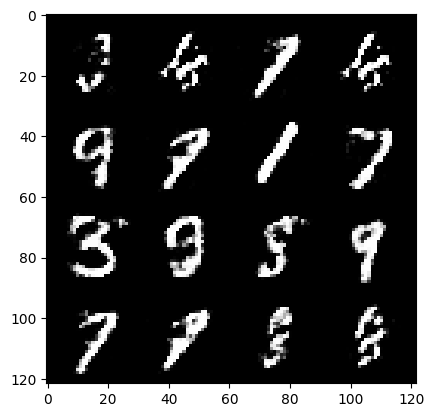

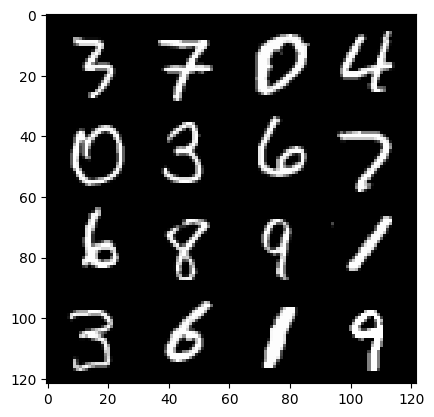

 93%|█████████▎| 435/469 [00:06<00:00, 51.65it/s]

459: step 215700 / Gen loss: 1.7440746855735774 / disc_loss: 0.3713350250323614


 55%|█████▌    | 258/469 [00:03<00:03, 66.36it/s]

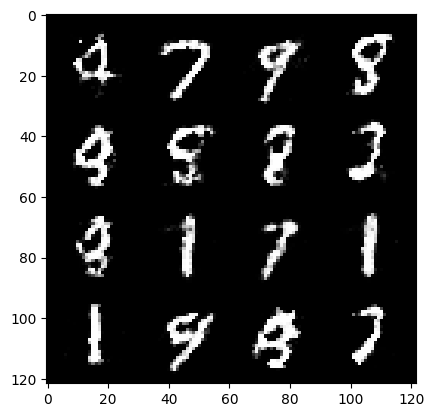

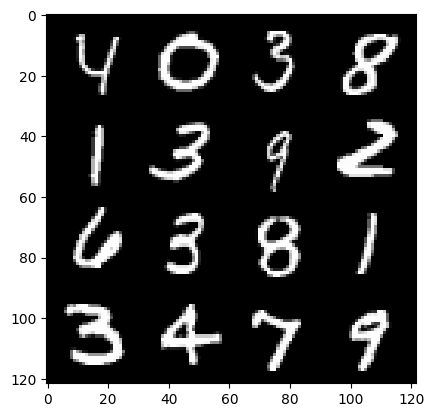

 57%|█████▋    | 265/469 [00:03<00:04, 44.08it/s]

460: step 216000 / Gen loss: 1.843181051810582 / disc_loss: 0.34978416353464153


 18%|█▊        | 85/469 [00:01<00:05, 65.88it/s]

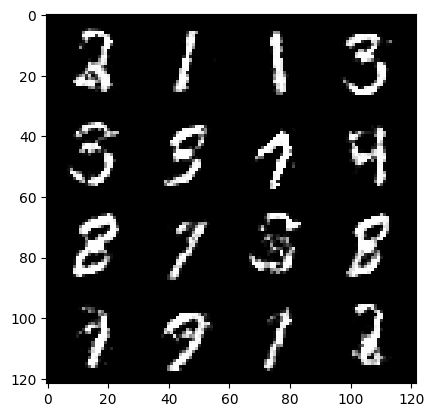

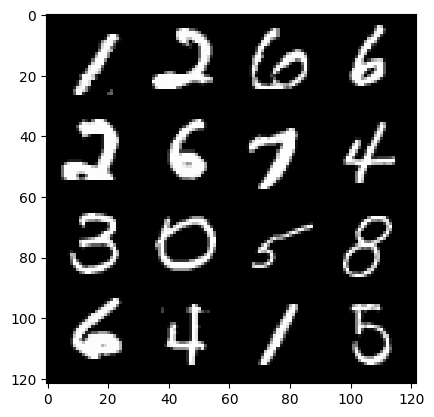

 21%|██        | 98/469 [00:01<00:07, 46.83it/s]

461: step 216300 / Gen loss: 1.7022465415795647 / disc_loss: 0.38934565067291255


 83%|████████▎ | 390/469 [00:06<00:01, 72.02it/s]

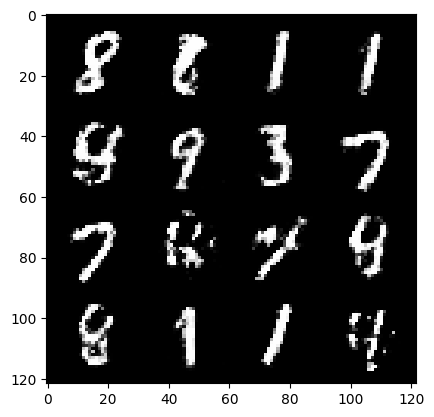

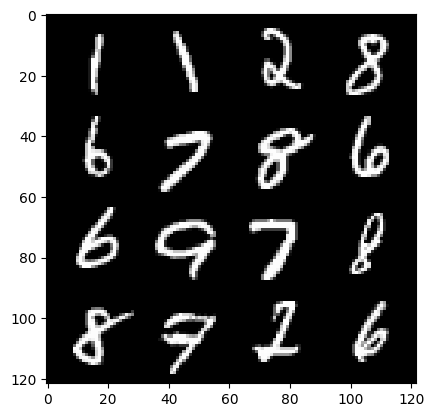

 85%|████████▍ | 398/469 [00:06<00:01, 43.59it/s]

461: step 216600 / Gen loss: 1.7651380980014786 / disc_loss: 0.3607825984060767


 47%|████▋     | 221/469 [00:03<00:03, 71.28it/s]

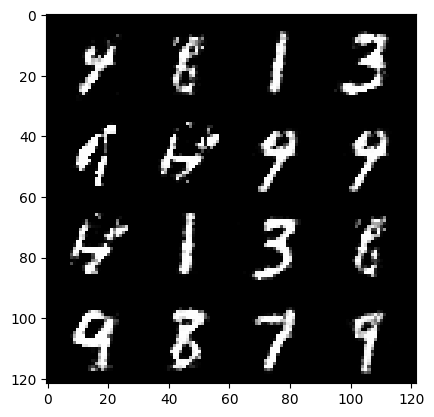

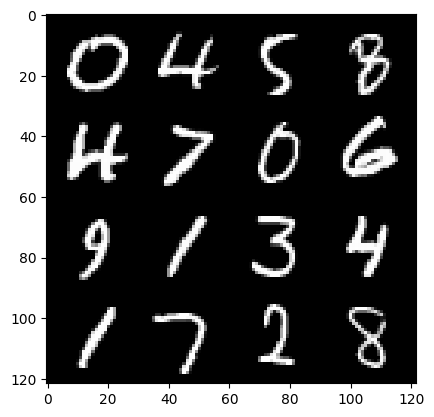

 49%|████▉     | 229/469 [00:03<00:05, 44.94it/s]

462: step 216900 / Gen loss: 1.849375097354252 / disc_loss: 0.35238052864869435


 10%|█         | 47/469 [00:00<00:06, 67.98it/s]

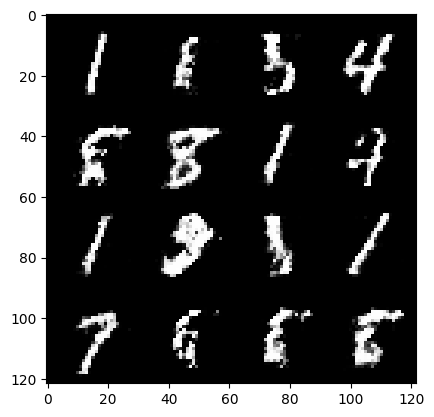

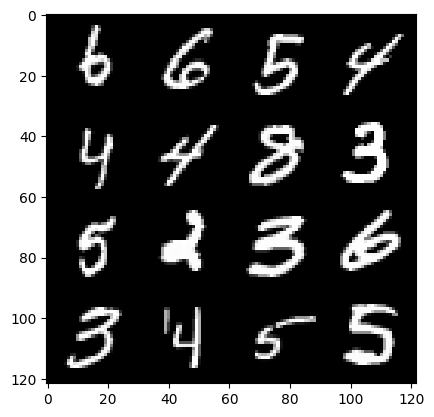

 13%|█▎        | 60/469 [00:01<00:09, 43.69it/s]

463: step 217200 / Gen loss: 1.7664153770605735 / disc_loss: 0.3578625511129699


 75%|███████▍  | 350/469 [00:05<00:01, 66.27it/s]

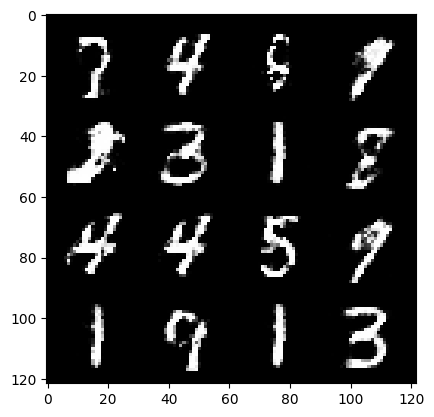

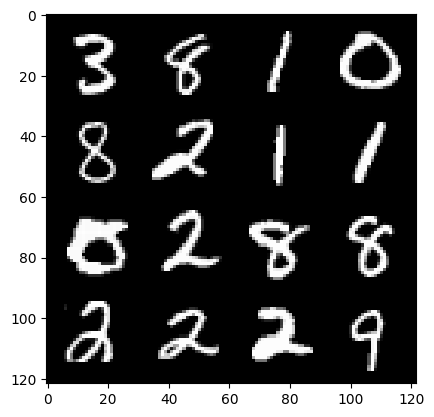

 76%|███████▌  | 357/469 [00:05<00:02, 43.40it/s]

463: step 217500 / Gen loss: 1.747576595942179 / disc_loss: 0.3647498746713004


 38%|███▊      | 180/469 [00:02<00:04, 67.15it/s]

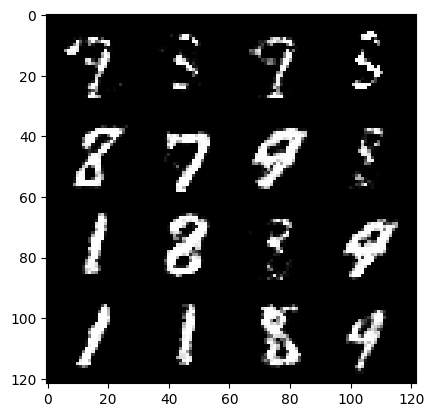

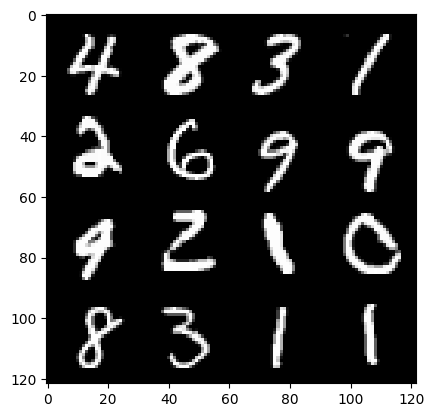

 41%|████      | 193/469 [00:03<00:05, 46.54it/s]

464: step 217800 / Gen loss: 1.7044460968176516 / disc_loss: 0.3940653947989149


  3%|▎         | 14/469 [00:00<00:06, 68.33it/s]

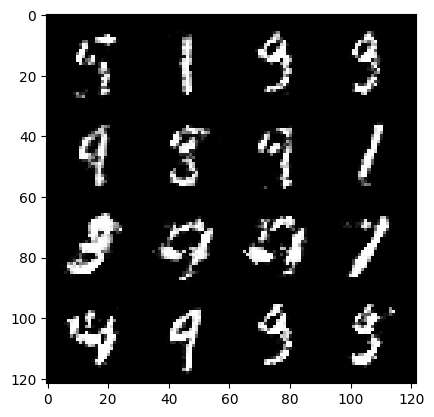

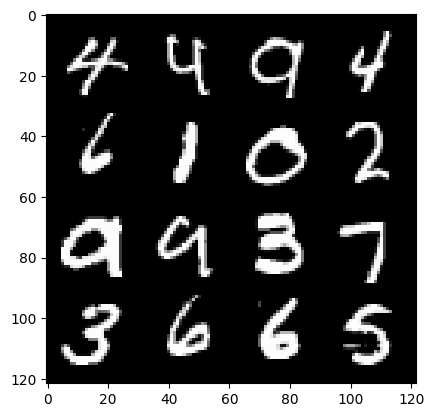

  6%|▌         | 28/469 [00:00<00:11, 39.83it/s]

465: step 218100 / Gen loss: 1.669029038747152 / disc_loss: 0.39093097935120247


 67%|██████▋   | 315/469 [00:04<00:02, 72.45it/s]

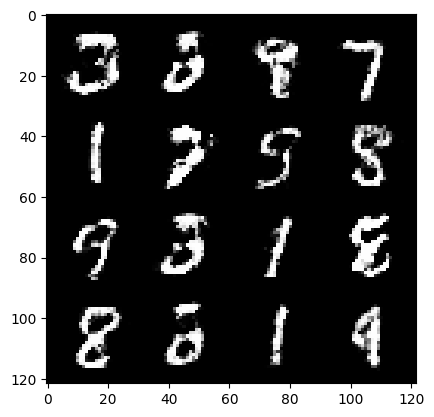

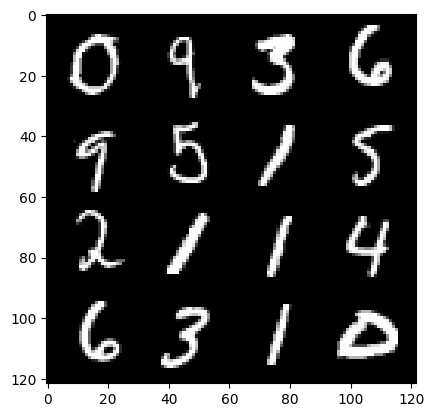

 69%|██████▉   | 323/469 [00:05<00:03, 39.36it/s]

465: step 218400 / Gen loss: 1.7487761410077425 / disc_loss: 0.3830024489760397


 30%|██▉       | 139/469 [00:02<00:04, 68.99it/s]

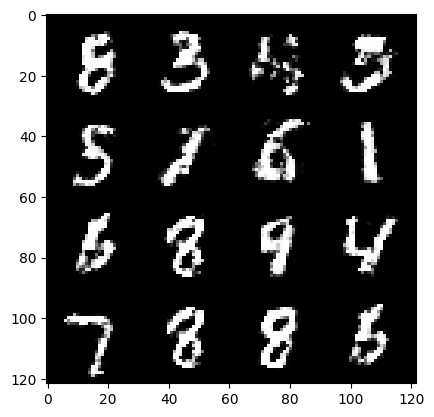

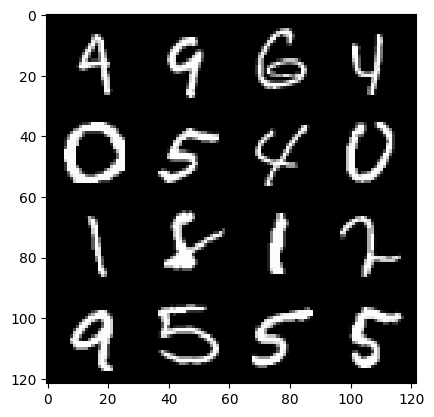

 33%|███▎      | 153/469 [00:02<00:06, 46.07it/s]

466: step 218700 / Gen loss: 1.7727428738276159 / disc_loss: 0.3662022919456163


 94%|█████████▍| 440/469 [00:06<00:00, 68.91it/s]

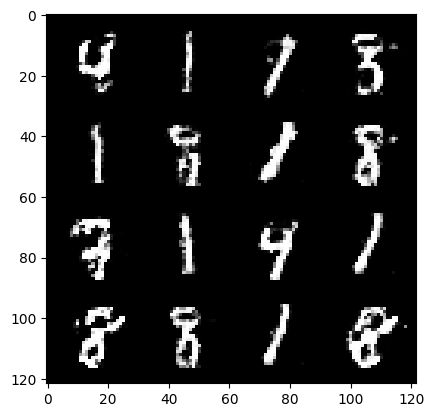

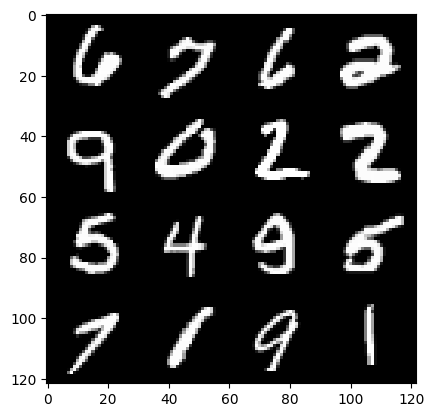

 97%|█████████▋| 453/469 [00:07<00:00, 45.23it/s]

466: step 219000 / Gen loss: 1.8355171887079857 / disc_loss: 0.35529764324426644


 59%|█████▉    | 277/469 [00:04<00:02, 69.75it/s]

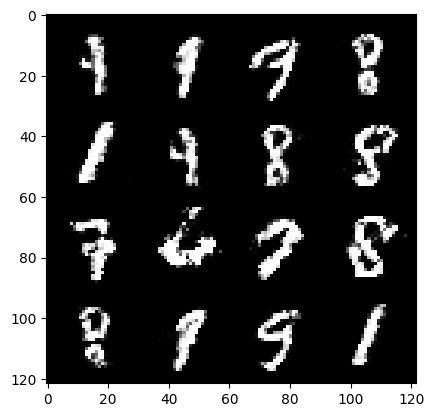

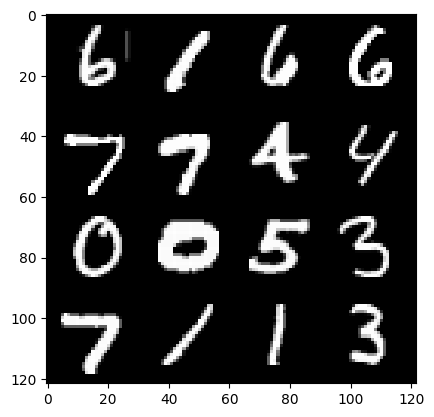

 61%|██████    | 284/469 [00:04<00:04, 42.83it/s]

467: step 219300 / Gen loss: 1.7982647923628485 / disc_loss: 0.35308419207731895


 22%|██▏       | 102/469 [00:01<00:05, 67.80it/s]

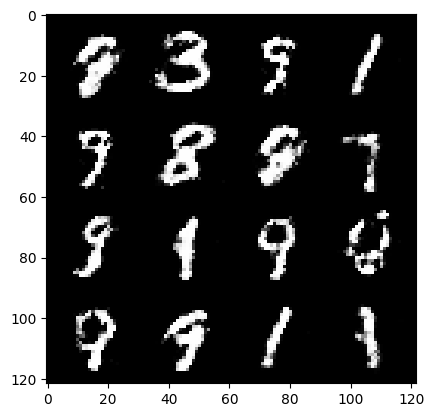

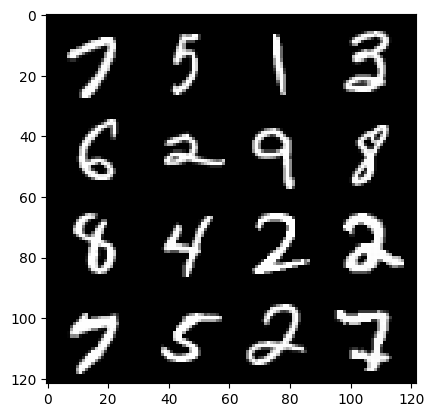

 25%|██▍       | 115/469 [00:01<00:06, 50.95it/s]

468: step 219600 / Gen loss: 1.8245250233014425 / disc_loss: 0.3555842584371565


 87%|████████▋ | 406/469 [00:06<00:00, 69.92it/s]

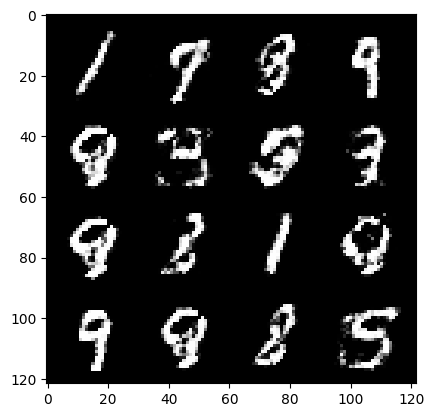

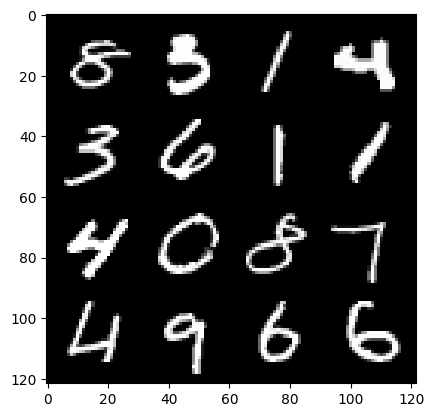

 88%|████████▊ | 414/469 [00:06<00:01, 48.13it/s]

468: step 219900 / Gen loss: 1.7817093865076699 / disc_loss: 0.3592825574676193


 49%|████▉     | 232/469 [00:03<00:03, 71.21it/s]

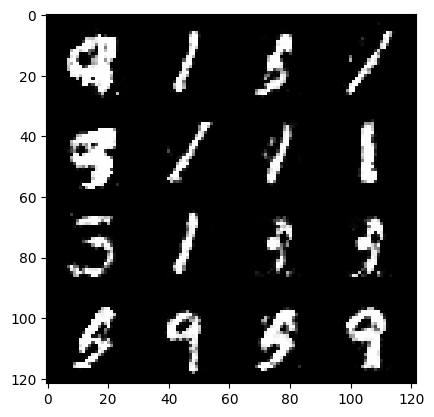

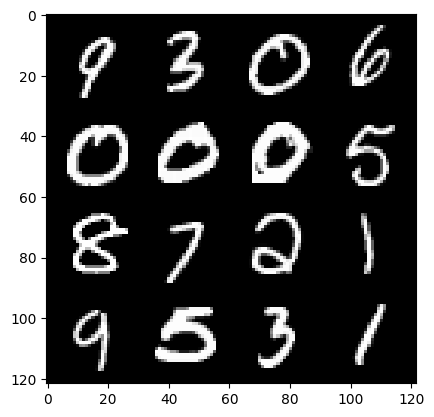

 52%|█████▏    | 246/469 [00:03<00:04, 48.85it/s]

469: step 220200 / Gen loss: 1.7448466149965915 / disc_loss: 0.3588479176660376


 14%|█▎        | 64/469 [00:00<00:06, 67.00it/s]

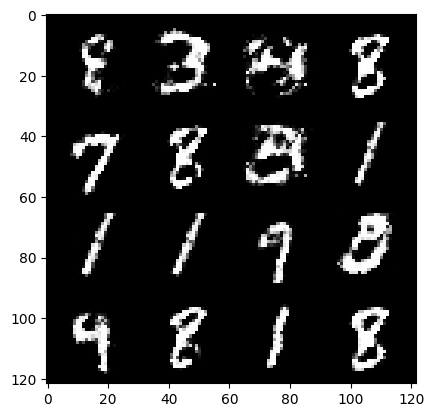

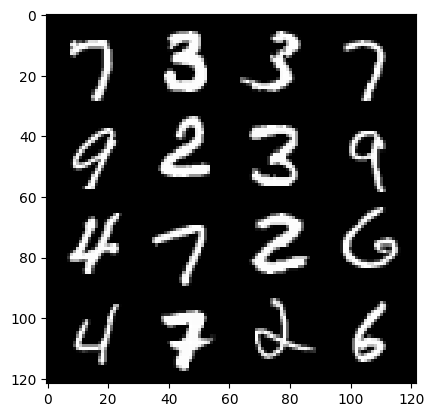

 16%|█▋        | 77/469 [00:01<00:09, 43.16it/s]

470: step 220500 / Gen loss: 1.817191565831503 / disc_loss: 0.349645498295625


 78%|███████▊  | 367/469 [00:05<00:01, 71.11it/s]

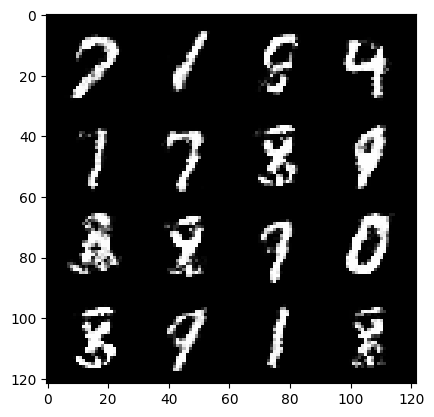

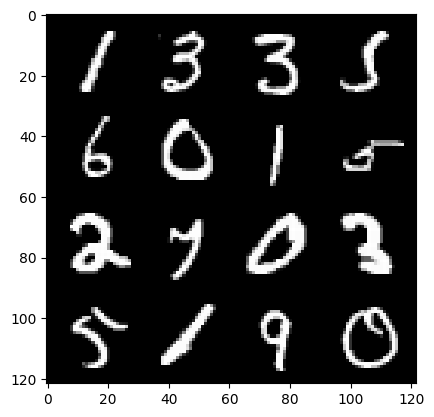

 80%|███████▉  | 375/469 [00:06<00:01, 48.26it/s]

470: step 220800 / Gen loss: 1.8024472375710803 / disc_loss: 0.36042879253625876


 42%|████▏     | 196/469 [00:02<00:03, 72.50it/s]

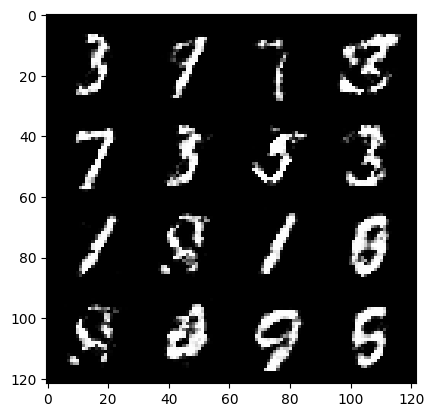

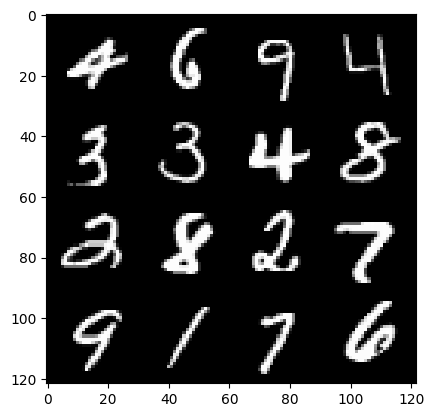

 45%|████▍     | 210/469 [00:03<00:05, 45.65it/s]

471: step 221100 / Gen loss: 1.801388723452886 / disc_loss: 0.3645712819695475


  6%|▌         | 28/469 [00:00<00:07, 58.76it/s]

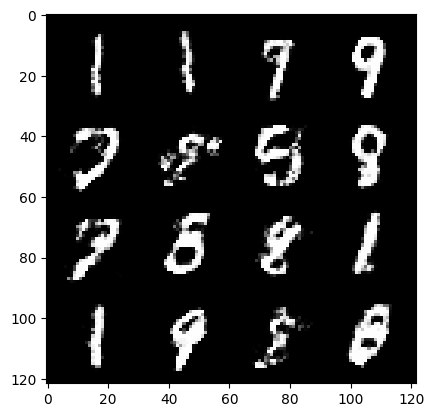

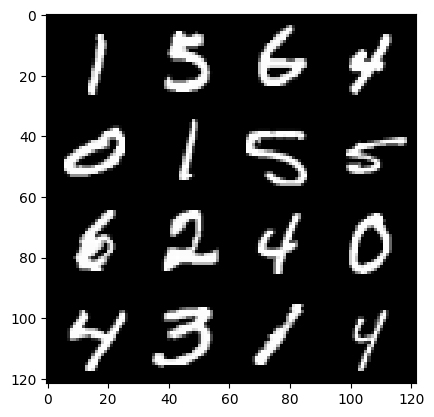

  9%|▊         | 40/469 [00:00<00:10, 39.10it/s]

472: step 221400 / Gen loss: 1.806605322360993 / disc_loss: 0.3542743892470994


 70%|██████▉   | 328/469 [00:05<00:01, 71.03it/s]

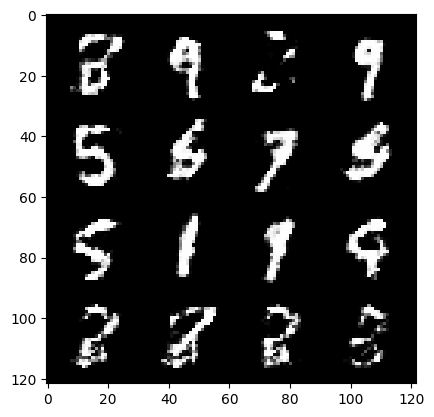

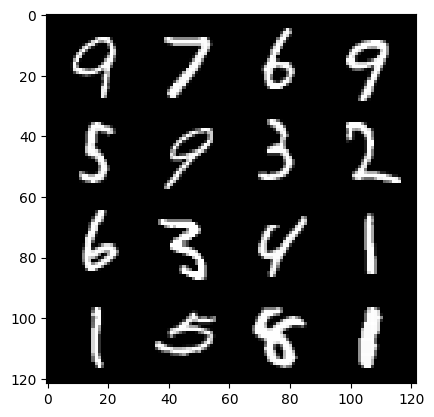

 72%|███████▏  | 336/469 [00:05<00:02, 46.72it/s]

472: step 221700 / Gen loss: 1.782263882557551 / disc_loss: 0.3650646232565248


 35%|███▍      | 163/469 [00:02<00:04, 64.82it/s]

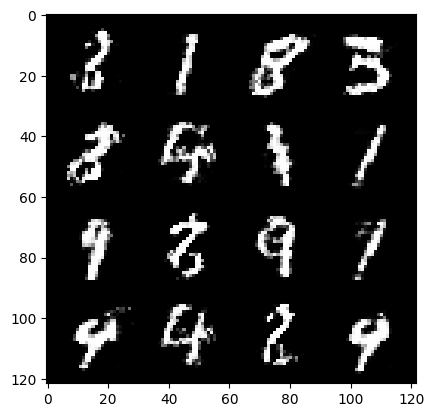

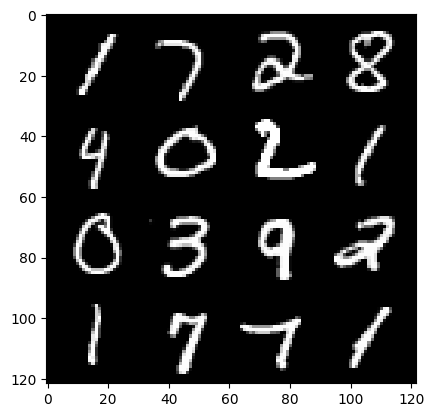

 36%|███▌      | 170/469 [00:02<00:07, 41.34it/s]

473: step 222000 / Gen loss: 1.837848660945891 / disc_loss: 0.3693261663118995


 99%|█████████▊| 463/469 [00:07<00:00, 68.82it/s]

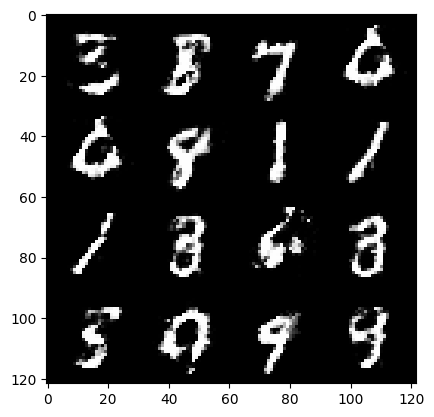

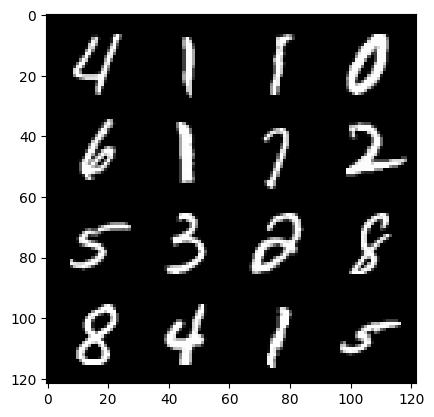

100%|██████████| 469/469 [00:07<00:00, 61.86it/s]


473: step 222300 / Gen loss: 1.833751703103384 / disc_loss: 0.3689680574337639


 62%|██████▏   | 290/469 [00:04<00:02, 71.16it/s]

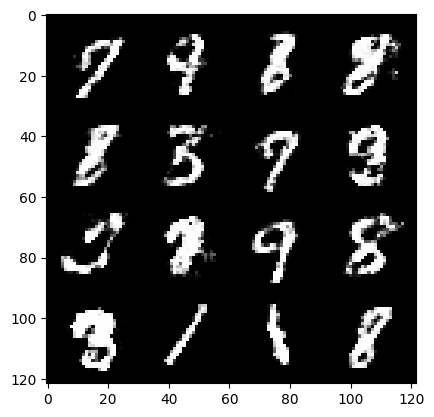

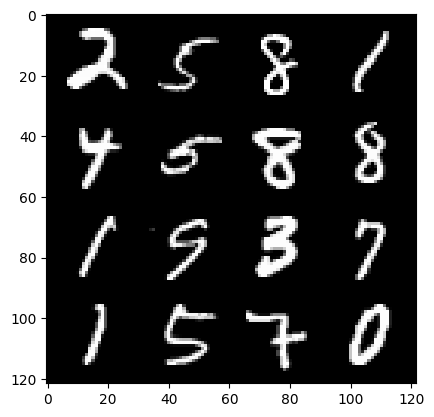

 64%|██████▎   | 298/469 [00:04<00:03, 46.95it/s]

474: step 222600 / Gen loss: 1.7892198654015847 / disc_loss: 0.37910040269295353


 25%|██▌       | 119/469 [00:01<00:05, 69.78it/s]

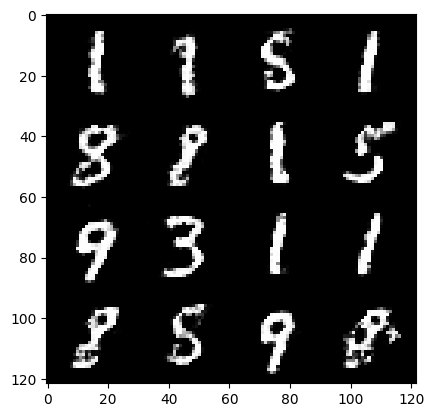

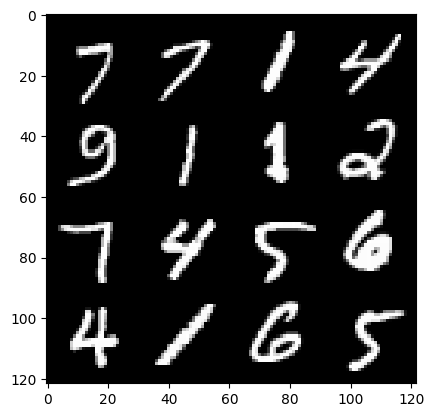

 28%|██▊       | 132/469 [00:02<00:07, 44.16it/s]

475: step 222900 / Gen loss: 1.7530463774998986 / disc_loss: 0.3769843988617263


 90%|█████████ | 423/469 [00:06<00:00, 63.25it/s]

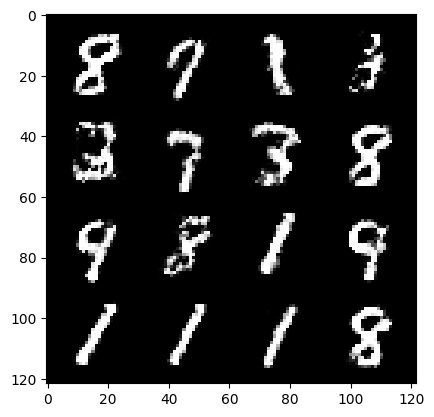

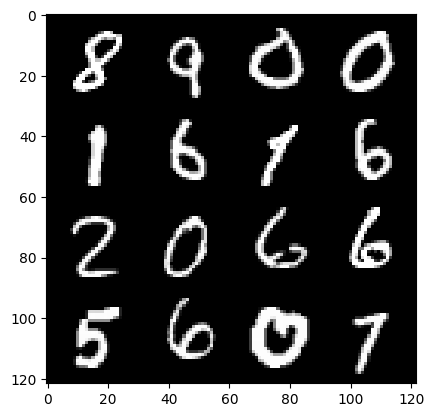

 92%|█████████▏| 430/469 [00:07<00:00, 39.78it/s]

475: step 223200 / Gen loss: 1.7768184022108717 / disc_loss: 0.36868683000405617


 54%|█████▍    | 253/469 [00:04<00:03, 71.36it/s]

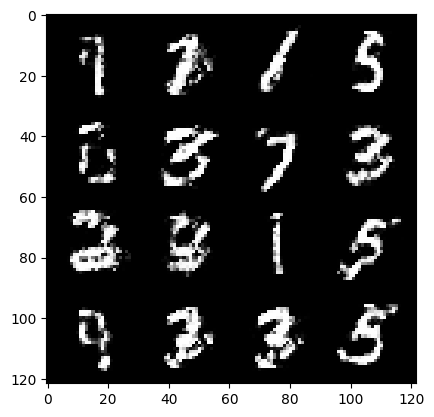

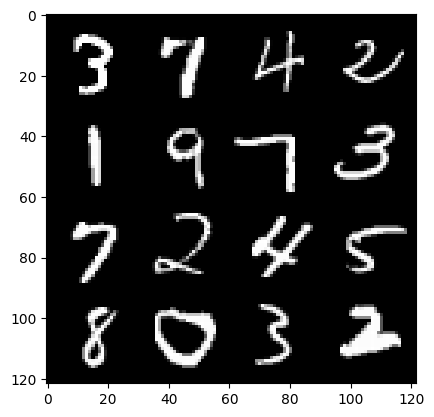

 57%|█████▋    | 267/469 [00:04<00:04, 47.16it/s]

476: step 223500 / Gen loss: 1.7335346019268019 / disc_loss: 0.40404670059680975


 18%|█▊        | 83/469 [00:01<00:05, 70.19it/s]

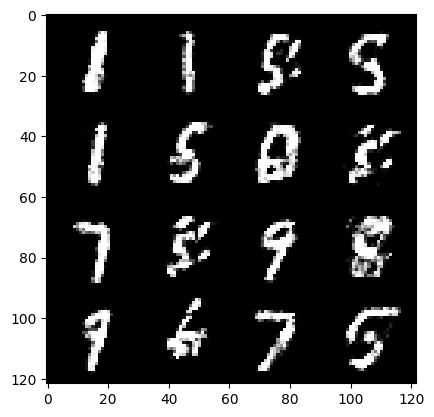

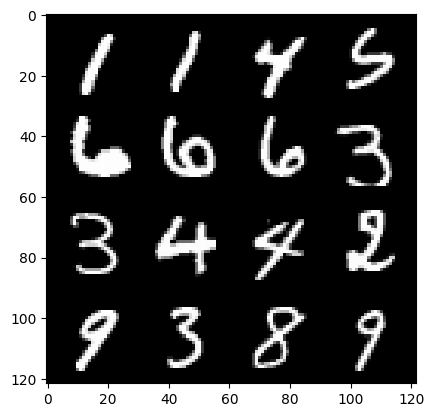

 21%|██        | 97/469 [00:01<00:09, 38.58it/s]

477: step 223800 / Gen loss: 1.775948918660482 / disc_loss: 0.3702943003177644


 81%|████████  | 380/469 [00:06<00:01, 69.77it/s]

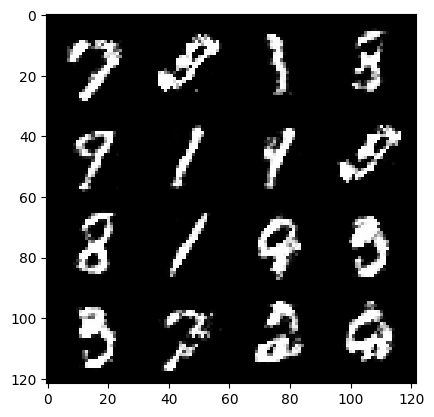

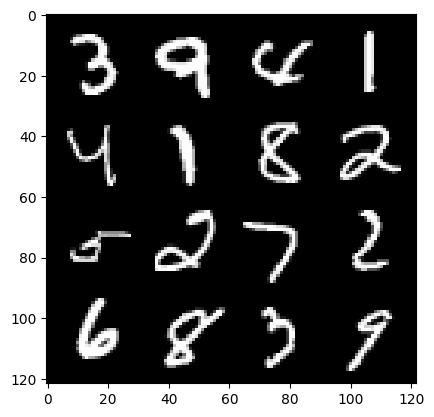

 84%|████████▍ | 394/469 [00:06<00:01, 47.15it/s]

477: step 224100 / Gen loss: 1.9262730646133428 / disc_loss: 0.35114364703496304


 45%|████▍     | 211/469 [00:03<00:03, 70.16it/s]

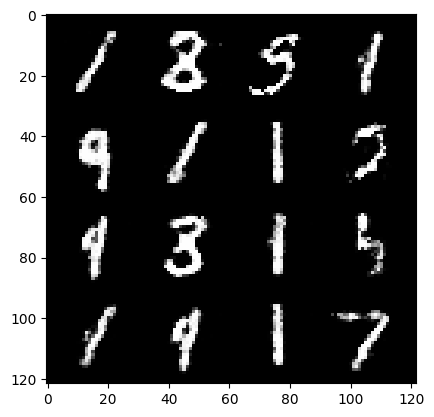

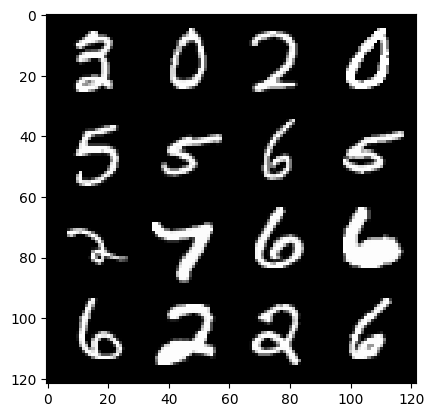

 48%|████▊     | 225/469 [00:03<00:04, 50.85it/s]

478: step 224400 / Gen loss: 1.805481687784194 / disc_loss: 0.3663041527072587


 10%|▉         | 46/469 [00:00<00:06, 66.24it/s]

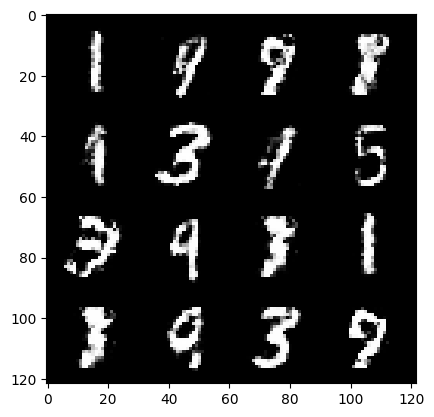

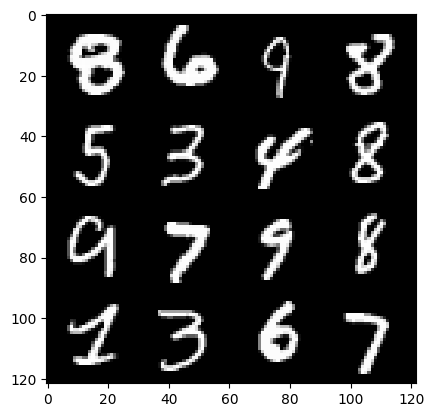

 13%|█▎        | 60/469 [00:01<00:08, 49.64it/s]

479: step 224700 / Gen loss: 1.8491846521695456 / disc_loss: 0.34303044080734246


 73%|███████▎  | 343/469 [00:05<00:01, 64.33it/s]

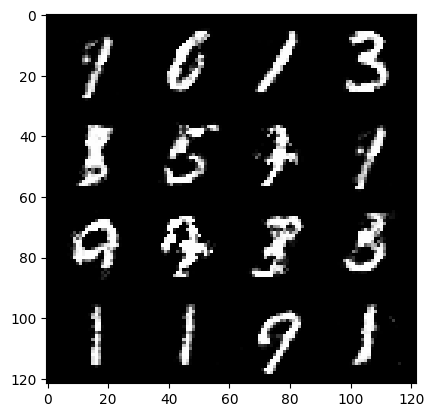

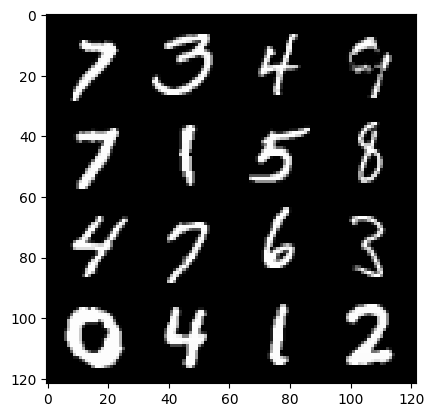

 76%|███████▌  | 356/469 [00:05<00:02, 45.71it/s]

479: step 225000 / Gen loss: 1.8198291281859076 / disc_loss: 0.34533152192831035


 38%|███▊      | 179/469 [00:02<00:04, 66.55it/s]

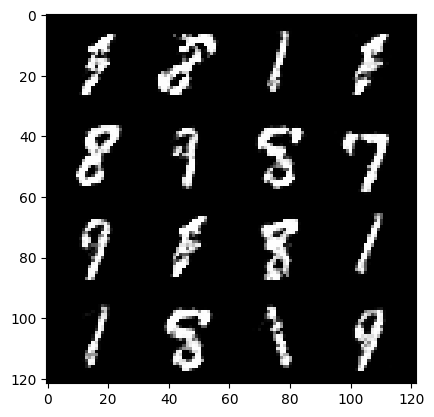

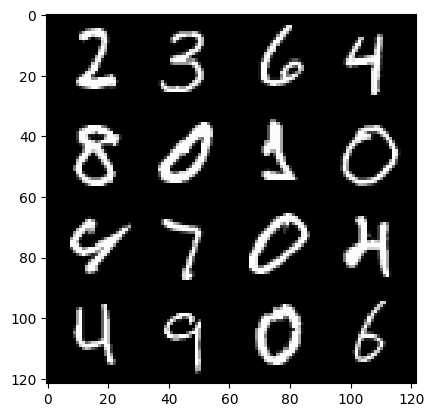

 40%|███▉      | 186/469 [00:02<00:06, 41.63it/s]

480: step 225300 / Gen loss: 1.8148240311940513 / disc_loss: 0.3540691140294077


  1%|▏         | 7/469 [00:00<00:06, 69.12it/s]

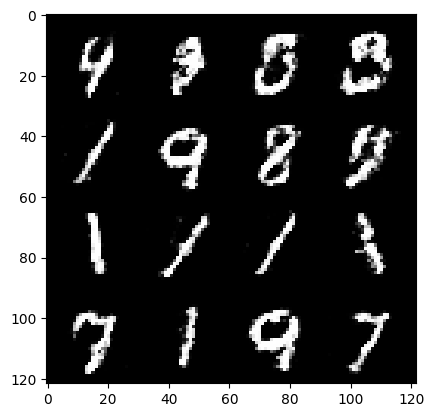

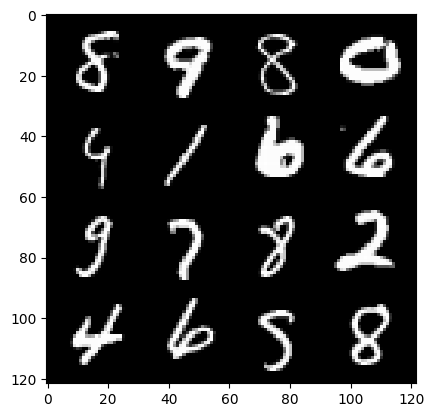

  4%|▍         | 19/469 [00:00<00:12, 36.78it/s]

481: step 225600 / Gen loss: 1.756921211083729 / disc_loss: 0.3782368169228238


 66%|██████▌   | 308/469 [00:04<00:02, 67.03it/s]

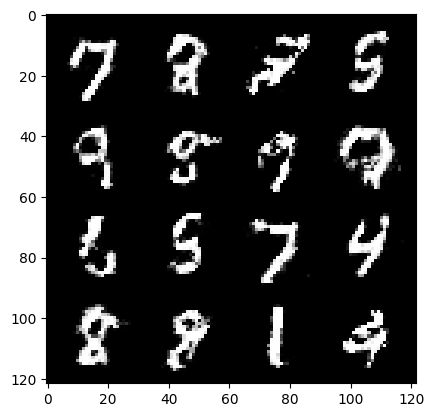

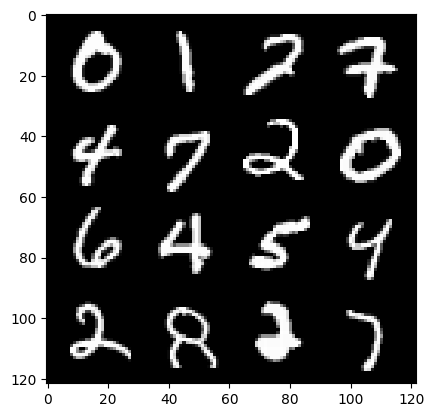

 68%|██████▊   | 321/469 [00:05<00:03, 45.13it/s]

481: step 225900 / Gen loss: 1.759647520780563 / disc_loss: 0.388235405385494


 30%|███       | 142/469 [00:02<00:04, 69.74it/s]

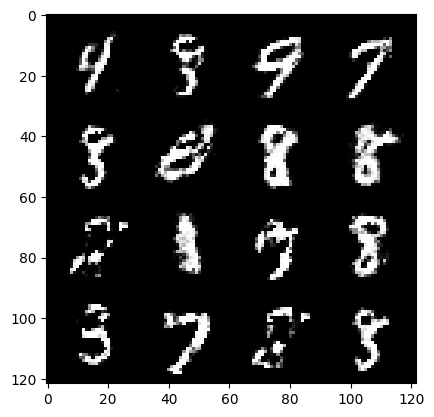

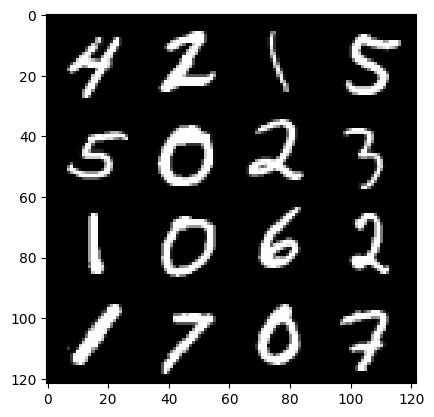

 32%|███▏      | 150/469 [00:02<00:07, 43.16it/s]

482: step 226200 / Gen loss: 1.8270778195063289 / disc_loss: 0.34717839419841784


 94%|█████████▎| 439/469 [00:06<00:00, 68.69it/s]

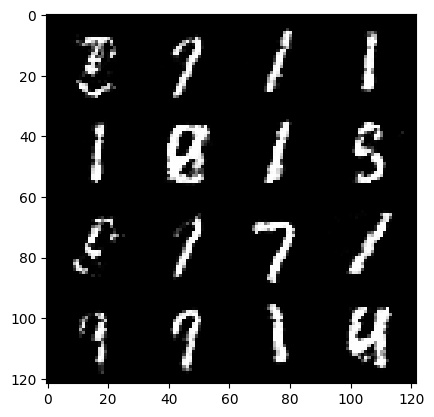

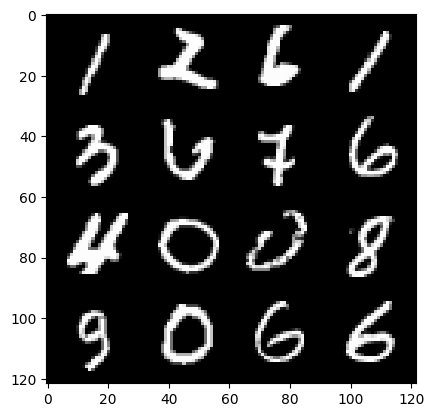

 95%|█████████▌| 446/469 [00:07<00:00, 44.15it/s]

482: step 226500 / Gen loss: 1.8871287540594737 / disc_loss: 0.3447778514027596


 58%|█████▊    | 271/469 [00:04<00:03, 64.26it/s]

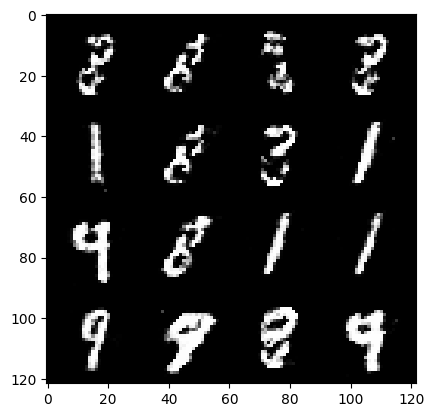

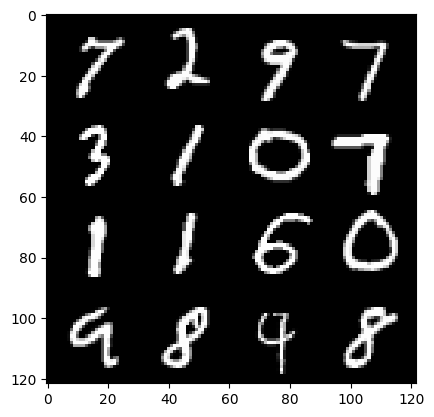

 59%|█████▉    | 278/469 [00:04<00:04, 40.25it/s]

483: step 226800 / Gen loss: 1.839369613726934 / disc_loss: 0.3533675557374956


 22%|██▏       | 104/469 [00:01<00:05, 68.45it/s]

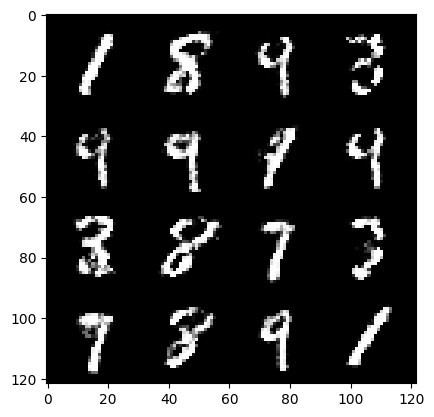

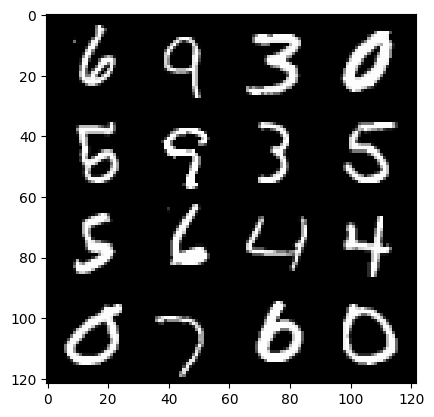

 24%|██▎       | 111/469 [00:01<00:08, 40.70it/s]

484: step 227100 / Gen loss: 1.9139533082644151 / disc_loss: 0.3505267384648325


 86%|████████▌ | 403/469 [00:06<00:00, 68.50it/s]

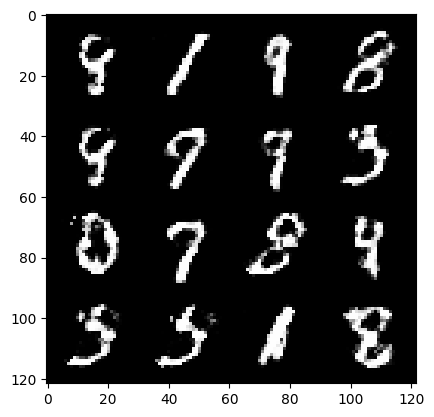

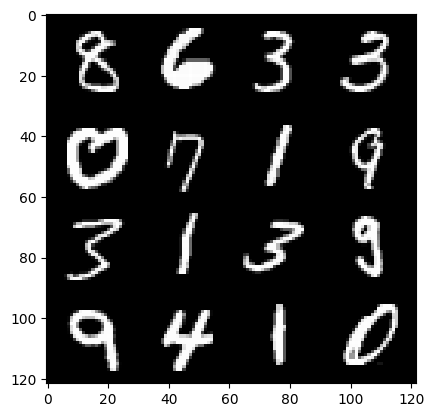

 87%|████████▋ | 410/469 [00:06<00:01, 43.79it/s]

484: step 227400 / Gen loss: 1.9305386948585495 / disc_loss: 0.35541432499885567


 50%|████▉     | 233/469 [00:03<00:03, 66.65it/s]

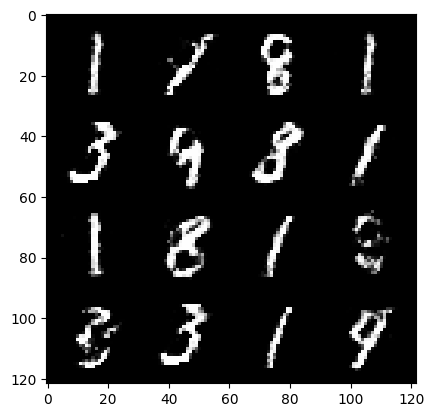

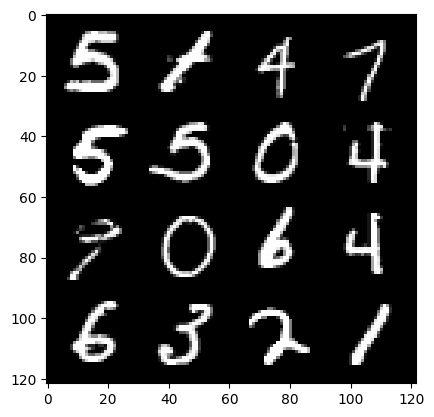

 51%|█████     | 240/469 [00:03<00:05, 38.17it/s]

485: step 227700 / Gen loss: 1.8910370552539832 / disc_loss: 0.3488073685765267


 14%|█▍        | 66/469 [00:01<00:06, 65.94it/s]

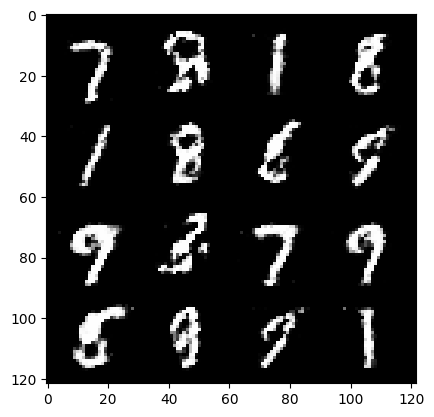

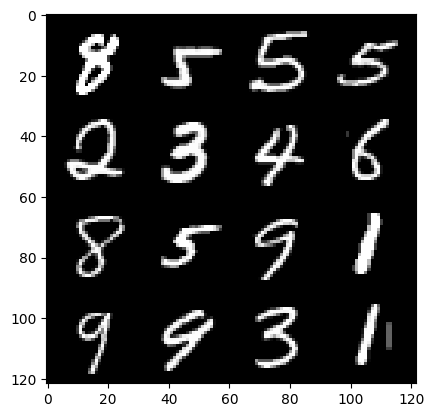

 16%|█▌        | 73/469 [00:01<00:09, 43.21it/s]

486: step 228000 / Gen loss: 1.771172029574712 / disc_loss: 0.3712609587113062


 78%|███████▊  | 366/469 [00:05<00:01, 69.63it/s]

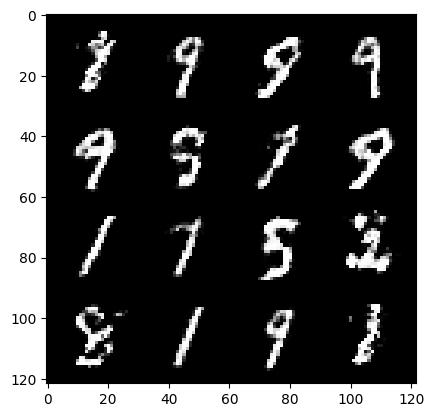

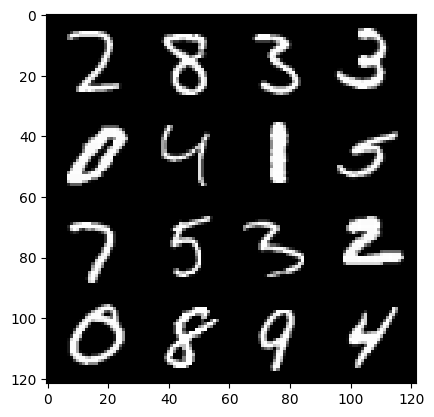

 80%|███████▉  | 373/469 [00:06<00:02, 45.29it/s]

486: step 228300 / Gen loss: 1.9086836779117564 / disc_loss: 0.3188268235822516


 42%|████▏     | 196/469 [00:02<00:03, 72.72it/s]

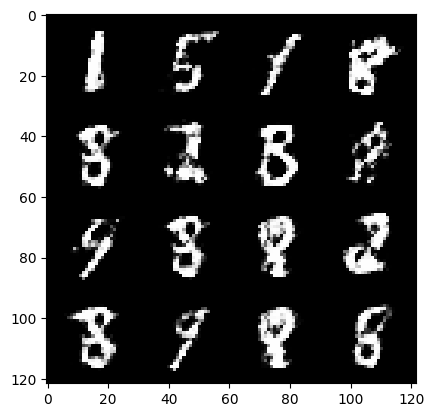

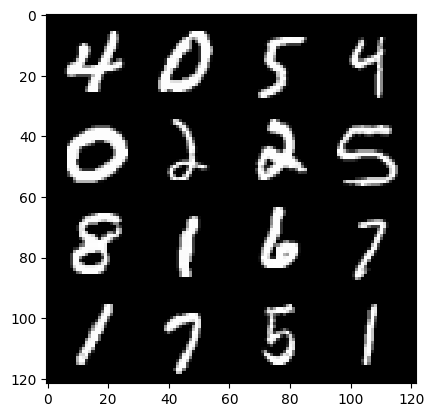

 43%|████▎     | 204/469 [00:03<00:06, 43.93it/s]

487: step 228600 / Gen loss: 1.8756293050448105 / disc_loss: 0.3507295693953829


  5%|▍         | 23/469 [00:00<00:07, 58.70it/s]

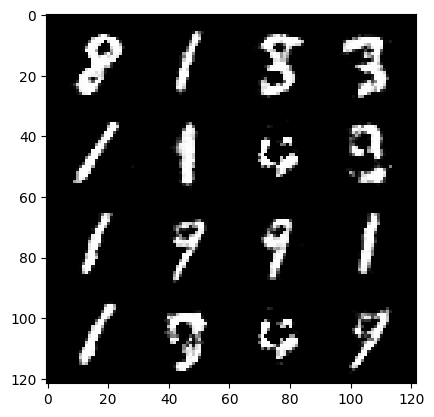

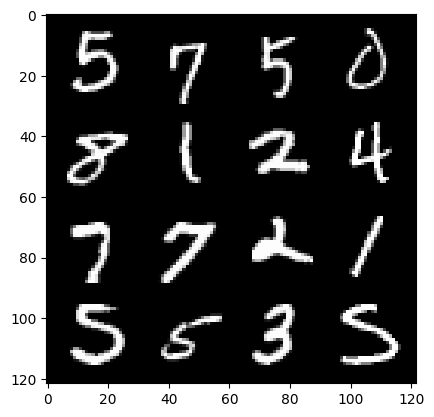

  7%|▋         | 34/469 [00:00<00:11, 38.65it/s]

488: step 228900 / Gen loss: 1.8946528303623202 / disc_loss: 0.35452970320979793


 69%|██████▊   | 322/469 [00:05<00:02, 65.21it/s]

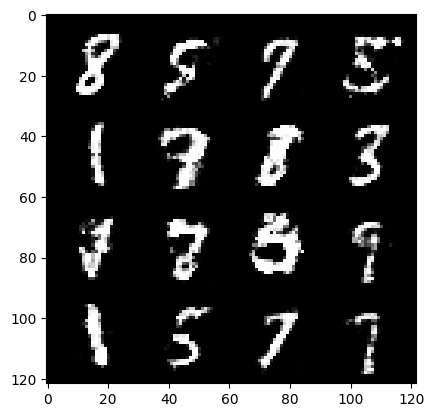

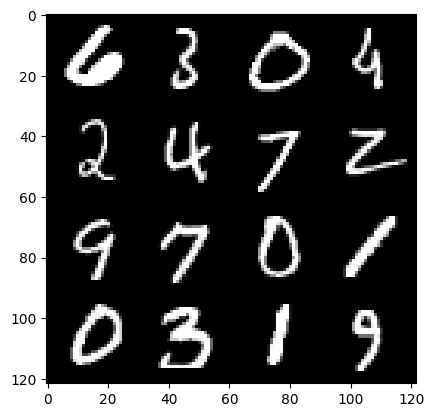

 71%|███████▏  | 335/469 [00:05<00:03, 44.26it/s]

488: step 229200 / Gen loss: 1.7827024137973788 / disc_loss: 0.375910040239493


 33%|███▎      | 153/469 [00:02<00:04, 69.17it/s]

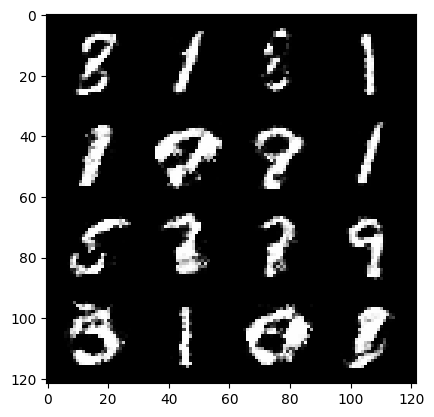

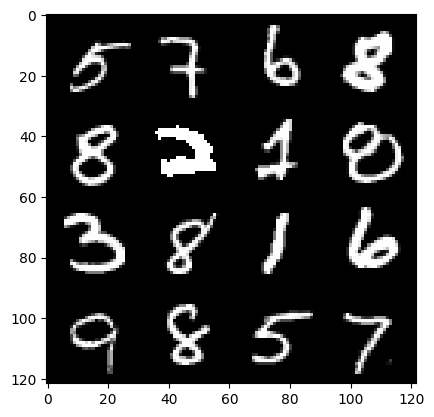

 35%|███▌      | 166/469 [00:02<00:07, 40.98it/s]

489: step 229500 / Gen loss: 1.8221584709485374 / disc_loss: 0.3607927659153939


 97%|█████████▋| 456/469 [00:07<00:00, 72.30it/s]

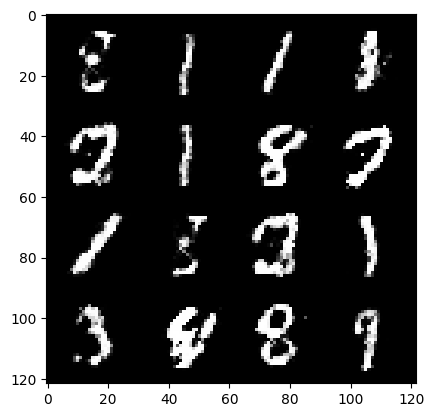

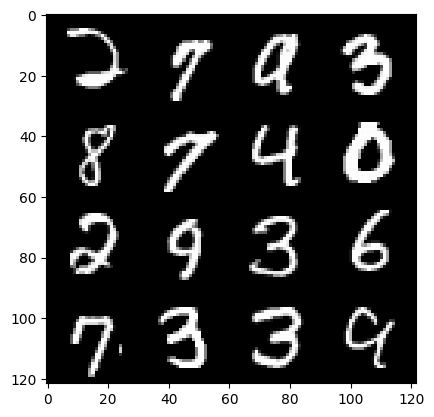

 99%|█████████▉| 464/469 [00:07<00:00, 41.67it/s]

489: step 229800 / Gen loss: 1.875684117476146 / disc_loss: 0.3446298652887343


 61%|██████▏   | 288/469 [00:04<00:02, 70.69it/s]

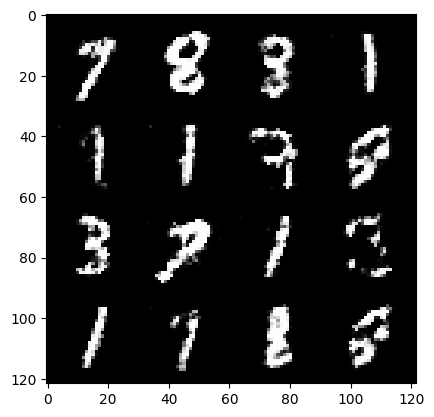

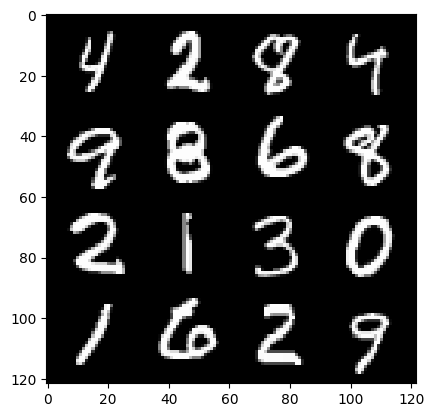

 63%|██████▎   | 296/469 [00:04<00:03, 44.38it/s]

490: step 230100 / Gen loss: 1.820596170028052 / disc_loss: 0.3538050701220828


 25%|██▌       | 119/469 [00:01<00:05, 68.75it/s]

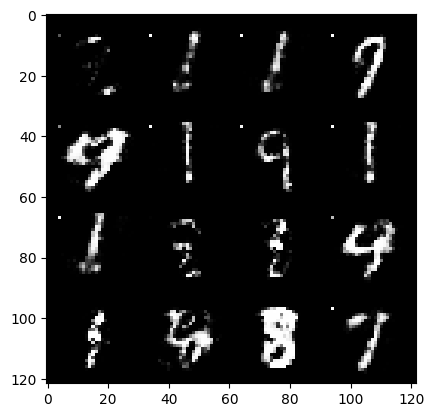

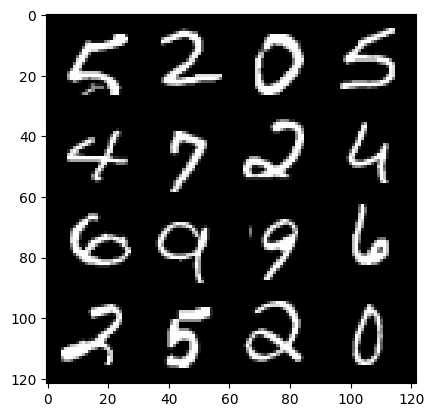

 27%|██▋       | 126/469 [00:02<00:07, 44.83it/s]

491: step 230400 / Gen loss: 1.4004398268461227 / disc_loss: 0.646922548015912


 90%|████████▉ | 420/469 [00:06<00:00, 65.97it/s]

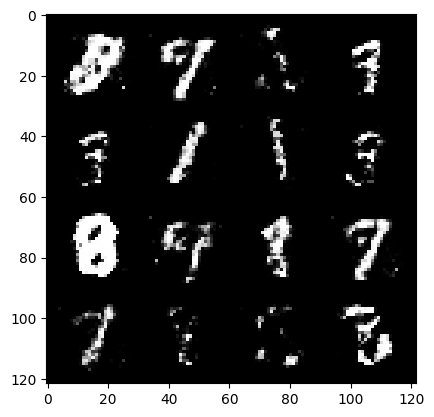

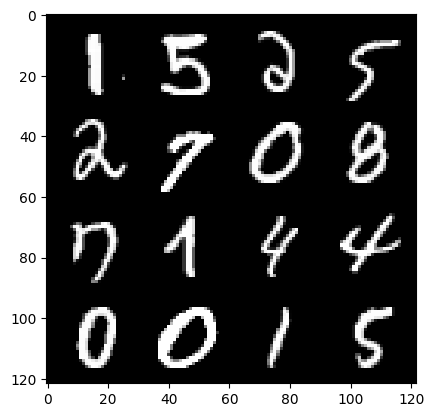

 91%|█████████ | 427/469 [00:07<00:01, 39.15it/s]

491: step 230700 / Gen loss: 1.5747447383403783 / disc_loss: 0.30785640736420966


 54%|█████▎    | 251/469 [00:03<00:03, 56.39it/s]

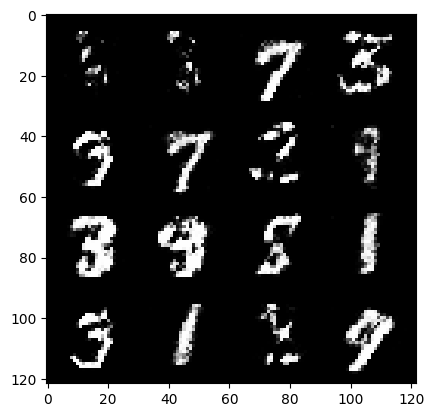

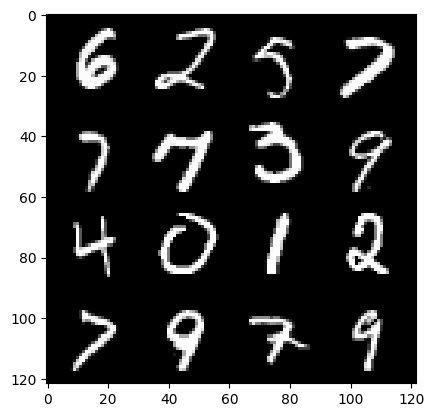

 56%|█████▌    | 263/469 [00:04<00:05, 39.01it/s]

492: step 231000 / Gen loss: 1.4460279341538758 / disc_loss: 0.3659562555948894


 17%|█▋        | 79/469 [00:01<00:05, 66.16it/s]

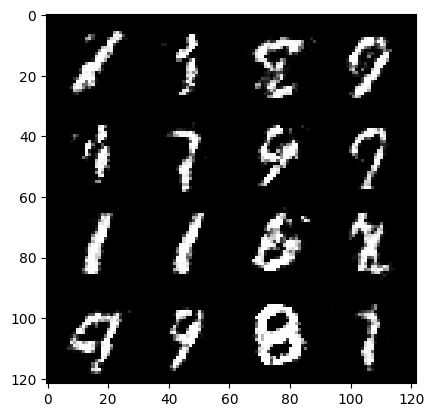

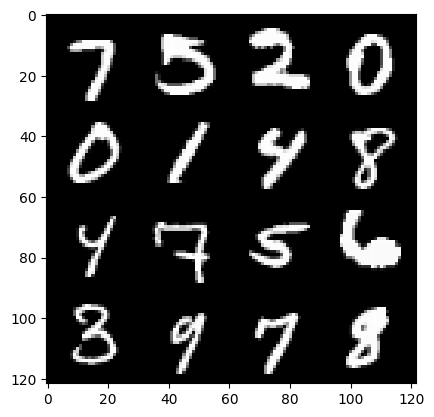

 20%|█▉        | 92/469 [00:01<00:07, 49.45it/s]

493: step 231300 / Gen loss: 1.5342546617984754 / disc_loss: 0.3631117158134779


 81%|████████▏ | 382/469 [00:06<00:01, 69.99it/s]

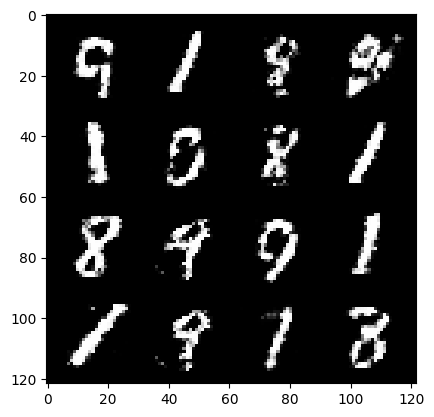

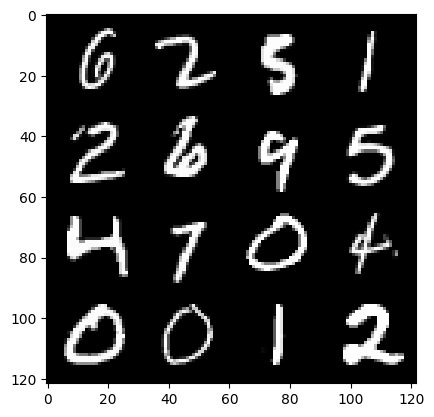

 83%|████████▎ | 390/469 [00:06<00:01, 43.08it/s]

493: step 231600 / Gen loss: 1.6136860545476266 / disc_loss: 0.3696830304463707


 45%|████▌     | 213/469 [00:03<00:04, 55.80it/s]

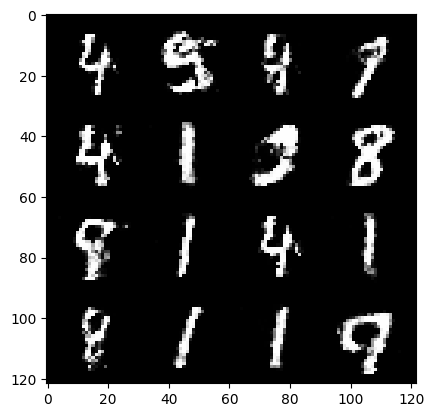

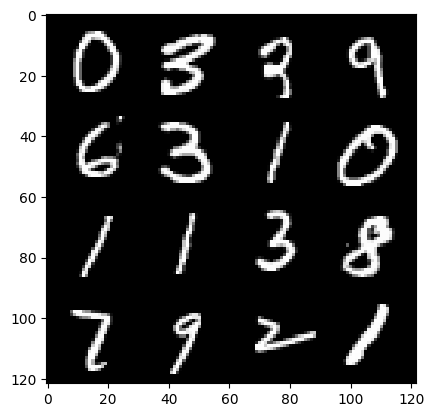

 48%|████▊     | 224/469 [00:03<00:06, 40.60it/s]

494: step 231900 / Gen loss: 1.625753794113795 / disc_loss: 0.3761742358406385


  9%|▉         | 43/469 [00:00<00:05, 71.94it/s]

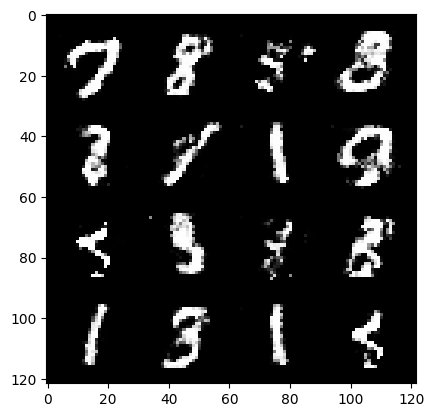

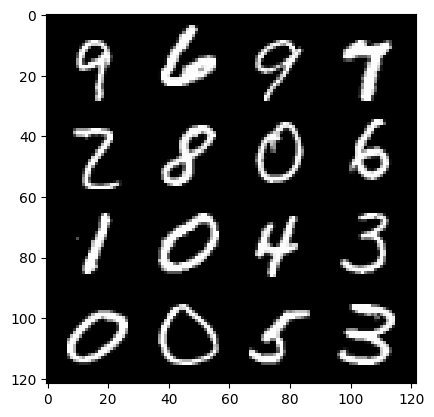

 11%|█         | 51/469 [00:00<00:09, 43.19it/s]

495: step 232200 / Gen loss: 1.597501663764317 / disc_loss: 0.3867051933209101


 74%|███████▎  | 345/469 [00:05<00:01, 66.05it/s]

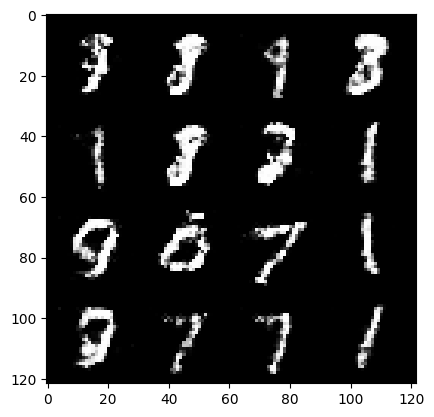

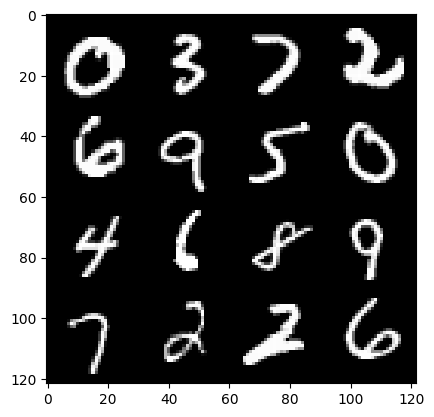

 75%|███████▌  | 352/469 [00:05<00:02, 47.36it/s]

495: step 232500 / Gen loss: 1.56494194706281 / disc_loss: 0.3668335263927778


 37%|███▋      | 175/469 [00:02<00:04, 66.25it/s]

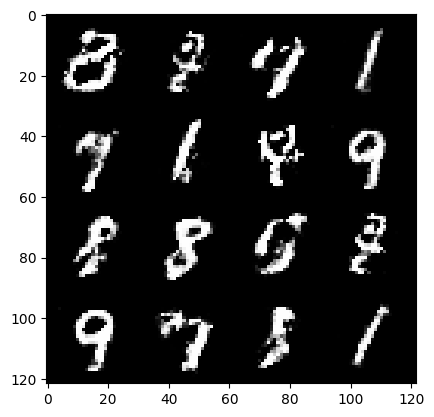

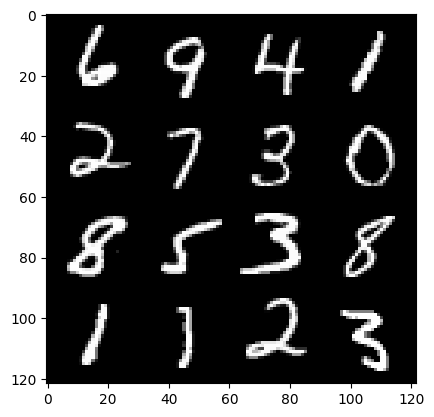

 39%|███▉      | 182/469 [00:03<00:07, 39.80it/s]

496: step 232800 / Gen loss: 1.5806131807963053 / disc_loss: 0.3609412439664205


  0%|          | 0/469 [00:00<?, ?it/s]

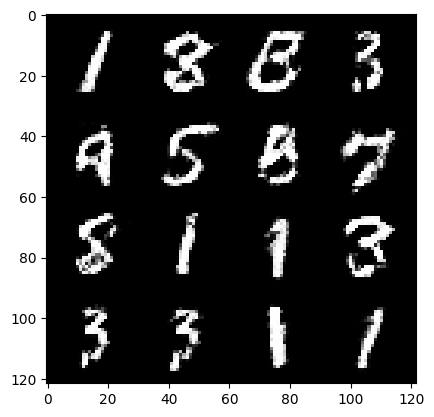

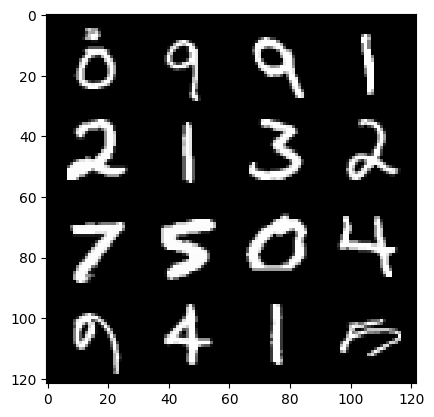

  3%|▎         | 14/469 [00:00<00:12, 37.73it/s]

497: step 233100 / Gen loss: 1.6123666870594031 / disc_loss: 0.38284575601418835


 65%|██████▍   | 304/469 [00:04<00:02, 70.94it/s]

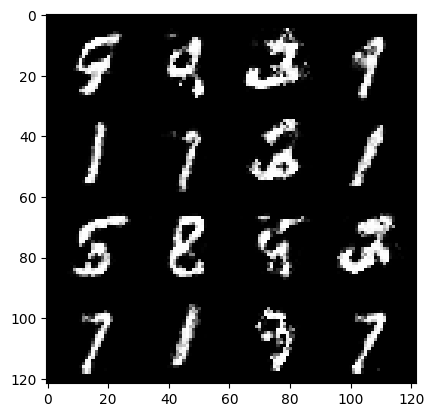

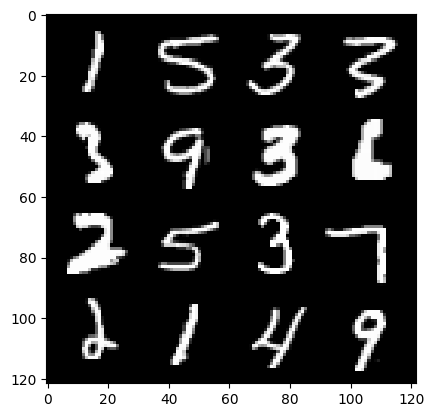

 68%|██████▊   | 318/469 [00:05<00:03, 48.17it/s]

497: step 233400 / Gen loss: 1.7121108818054198 / disc_loss: 0.34795813466111813


 28%|██▊       | 133/469 [00:01<00:04, 70.82it/s]

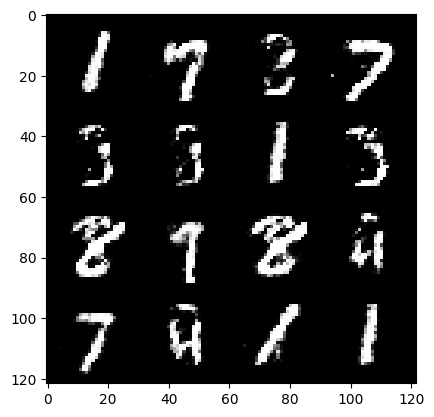

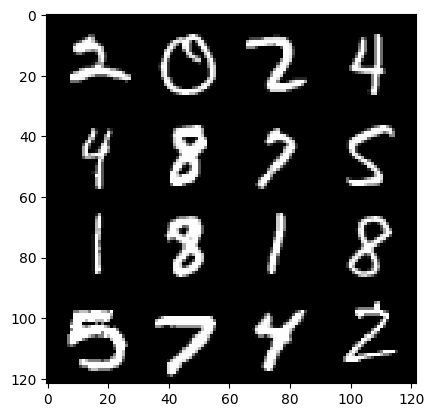

 31%|███▏      | 147/469 [00:02<00:06, 47.12it/s]

498: step 233700 / Gen loss: 1.7354005205631255 / disc_loss: 0.34905060718456915


 93%|█████████▎| 436/469 [00:06<00:00, 67.54it/s]

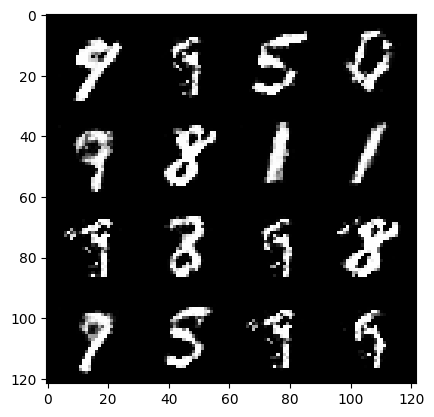

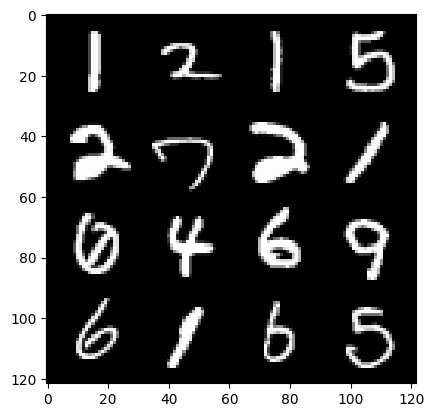

 94%|█████████▍| 443/469 [00:07<00:00, 41.93it/s]

498: step 234000 / Gen loss: 1.7207503688335413 / disc_loss: 0.348053268889586


 57%|█████▋    | 269/469 [00:03<00:02, 70.08it/s]

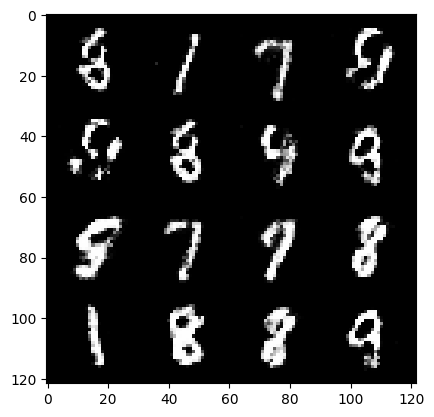

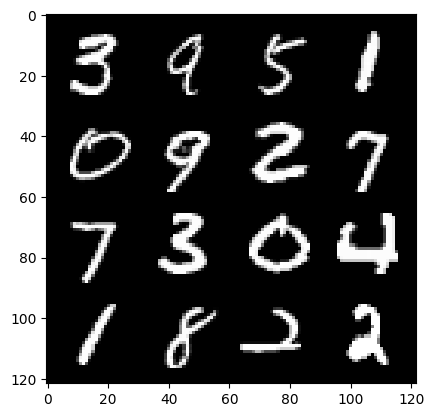

 59%|█████▉    | 277/469 [00:04<00:04, 44.23it/s]

499: step 234300 / Gen loss: 1.7914282421270997 / disc_loss: 0.3375425463914871


100%|██████████| 469/469 [00:07<00:00, 64.52it/s]


In [11]:
for epoch in range(epochs):
    for real, _ in tqdm(dataloader):
        ### discriminator
        disc_opt.zero_grad()

        cur_bs = len(real)  # real: 128 x 1 x 28 x 28
        real = real.view(cur_bs, -1)  # 128 x 784
        real = real.to(device)

        disc_loss = calc_disc_loss(loss_func, gen, disc, cur_bs, real, z_dim)
        disc_loss.backward(retain_graph=True)
        disc_opt.step()

        ### generator
        gen_opt.zero_grad()
        gen_loss = calc_gen_loss(loss_func, gen, disc, cur_bs, z_dim)
        gen_loss.backward(retain_graph=True)
        gen_opt.step()

        ### visualization & stats
        mean_disc_loss += disc_loss.item() / info_step
        mean_gen_loss += gen_loss.item() / info_step

        if cur_step % info_step == 0 and cur_step > 0:
            fake_noise = gen_noise(cur_bs, z_dim)
            fake = gen(fake_noise)
            show(fake)
            show(real)
            print(
                f"{epoch}: step {cur_step} / Gen loss: {mean_gen_loss} / disc_loss: {mean_disc_loss}"
            )
            mean_gen_loss, mean_disc_loss = 0, 0
        cur_step += 1